In this iPython notebook, we will featurize MOR ligand binding simulation by pairwise distances between the ligand and different receptor residues. We will then perform tICA and prospectively build an MSM. 

In [1]:
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt

# changing matplotlib the default style
matplotlib.style.use('ggplot')
#matplotlib.rcParams["figure.facecolor"] = "white"
#matplotlib.rcParams["savefig.transparent"] = "True"


In [2]:
import pandas as pd


from PDB_Order_Fixer import PDB_Order_Fixer
import mdtraj as md
import os
import numpy as np
import h5py

import datetime
import glob
import copy
from functools import partial 
import operator
import time

import random 
import subprocess
from subprocess import Popen
import sys
from custom_clusterer import *
from custom_tica import *
from custom_featurizer import *
from pdb_editing import *
from analysis import *
from io_functions import *
#from topology_fixing import *
from subsampling import *
from conversions import *
from custom_msm import *
from grids import *
from docking_analysis import *

from scipy import stats
import os
from efficacy_scripts import *




/home/enf/anaconda3/lib/python3.5/site-packages/matplotlib/__init__.py:1350: UserWarning:  This call to matplotlib.use() has no effect
because the backend has already been chosen;
matplotlib.use() must be called *before* pylab, matplotlib.pyplot,
or matplotlib.backends is imported for the first time.

  warnings.warn(_use_error_msg)


In [3]:
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

In [4]:
from sklearn.preprocessing import scale

In [5]:
from detect_intermediates import *
from interpret_tICs import *

In [6]:
from msmbuilder.utils import verbosedump, verboseload


In [7]:
from b2ar_feature_types import *
#from b2ar_feature_types import *
from get_variable_names import *
from b2ar_tica_config import *
from residue import Residue, Atom

In [8]:
from sklearn import tree
from sklearn.tree import DecisionTreeClassifier, export_graphviz
from sklearn.preprocessing import scale
from random import shuffle
from sklearn.metrics import accuracy_score
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_curve, auc

In [9]:

ori_feature_name = copy.deepcopy(feature_name)

In [10]:
#schemes = ["closest-heavy", "CA"]
#feature_name = "%s-CA" %ori_feature_name

In [11]:
rho = 0.01
rho_string = "_rho0pt01"
n_clusters = 25
n_samples = 1
lag_time=5
precision = "XP"

In [12]:
(active_ref_dir, inactive_ref_dir, simulation_ref_dir, scripts_dir,
          ligand_dir, agonist_dir, inverse_agonist_dir, biased_agonist_dir, ref_receptors_dir, whole_trajectory_pnas,
          sasa_file) = get_base_files(base)

tica_dir = get_tica_dir(base, is_sparse, lag_time, n_components, feature_name, 
                                 wolf_string, shrinkage_string, rho_string)
ori_tica_dir = copy.deepcopy(tica_dir)
features_dir = get_features_dir(base, feature_name)

landmarks_dir = get_landmarks_dir(tica_dir)
analysis_dir = get_analysis_dir(tica_dir, n_clusters, sampling_method)
gmm_dir = get_gmm_dir(tica_dir)
rf_dirdir = get_rf_dir(tica_dir)


ref_tica_dir, ref_tica_coords = get_ref_tica_dirs(tica_dir)

graph_file = get_graph_file(tica_dir, msm_lag_time, n_clusters)

pnas_titles =  ["tm6_tm3_dist", "rmsd_npxxy_inactive", "rmsd_npxxy_active", "rmsd_connector_inactive", "rmsd_connector_active"]
pnas_features_dir = analysis_dir


(clusterer_dir, msm_model_dir, macrostate_dir, features_known, model_dir, projected_features_dir,
         projection_operator_dir, ktica_fit_model_filename, ktica_projected_data_filename, nystroem_data_filename,
         mutual_information_csv, pearson_csv) = get_tica_files(base, tica_dir, n_clusters, msm_lag_time, n_macrostates)

(standardized_features_dir, feature_residues_csv, feature_residues_pkl,
          contact_csv, ref_features_dir) = get_feature_files(features_dir)

(kmeans_csv, tica_coords_csv, features_csv, active_rmsd_dir, inactive_rmsd_dir, active_pnas_dir, inactive_pnas_joined, active_pnas_joined,
        clusters_map_file, ktica_clusters_map_file, analysis_file, combined_file, docking_summary, docking_joined, docking_z_scores_csv,
        aggregate_docking, aggregate_docking_joined, docking_pnas_joined, aggregate_docking_pnas, aggregate_docking_pnas_joined, docking_multiple_ligands,
        docking_distances_file, docking_pdf, mmgbsa_docking_distances, pnas_coords, mmgbsa_dir, mmgbsa_csv, mmgbsa_pdf, aggregate_mmgbsa,
        aggregate_mmgbsa_joined, aggregate_mmgbsa_pnas_joined, mmgbsa_z_scores_csv, active_clusters_csv, intermediate_clusters_csv,
        inactive_clusters_csv, pnas_clusters_averages, tica_clusters_averages, tica_classes_csv, tica_samples_csv, subgraph_save_base,
        degree_save_base, degree_map_csv, degree_z_map_csv, aggregate_docking_pnas_degree_z_joined, tic_residue_csv, feature_coefs_csv,
        duplicated_feature_coefs_csv) = get_analysis_files(analysis_dir, n_clusters, tica_dir, tica_dir, sampling_method, n_samples, precision,
                                                           msm_lag_time)

(inactive_pnas_distances_dir, active_pnas_distances_dir, active_pnas_all_distances_dir,
          inactive_pnas_distances_new_csv, active_pnas_distances_new_csv, active_pnas_joined, active_pnas_means, pnas_coords_dir,
          pnas_coords_csv, pnas_all_coords_csv, pnas_coords_hexbin_dir, pnas_coords_co_crystallized_docking_dir,
          pnas_coords_active_colors_dir, user_defined_features_file, reaction_coordinates_trajs_file) = get_pnas_files(whole_trajectory_pnas, pnas_features_dir)

features_dir = get_features_dir(base, feature_name)



graph_file = get_graph_file(tica_dir, msm_lag_time, n_clusters)
(scripts_dir, pymol_fixpdb_dir) = get_script_dir(scripts_dir)
(save_dir, reimaged_dir, mae_dir, combined_reimaged_dir, grid_dir, docking_dir) = get_docking_dirs(tica_dir, n_clusters, n_components, n_samples, sampling_method, precision)


/home/enf/b2ar_analysis/featuresall_residues_2rh1_3sn6_under_cutoff6A
/home/enf/b2ar_analysis/featuresall_residues_2rh1_3sn6_under_cutoff6A


In [13]:
print(inactive_ref_dir)
print(inactive_dir)

/home/enf/b2ar_analysis/2RH1_prepped.pdb
/home/enf/b2ar_analysis/2RH1_prepped.pdb


In [14]:
ref_receptors_dir

'/home/enf/b2ar_analysis/reference_receptors'

In [15]:
#contact_residues = find_common_residues(get_trajectory_files(ref_receptors_dir, ".pdb"), "test.pkl")
contact_residues = convert_list_to_resobject_list([("A", r) for r in all_residues if r < 228] + [("C", r) for r in all_residues if r >= 265])

featurize_contacts_custom(ref_receptors_dir, features_dir = ref_features_dir, traj_ext = ".pdb", contact_residue_pairs_file = feature_residues_pkl, structures=[inactive_dir, active_dir], contact_residues=contact_residues,
                          residues_map = None, contact_cutoff = cutoff, parallel = False, exacycle = exacycle, traj_top_structure = None, iterative=False,
                          user_specified_atom_residue_pairs = [], load_from_file=False, worker_pool=None, schemes=["closest"], within_turn=True, binarize=None, redo=True)

structure
/home/enf/b2ar_analysis/2RH1_prepped.pdb
structure
None
mdraj_index_combinations[0:10]
[(1, 2), (1, 3), (1, 4), (1, 5), (1, 6), (1, 7), (1, 8), (1, 9), (1, 10), (1, 11)]
contact_features[0:10]
[[ASP29, GLU30], [ASP29, VAL31], [ASP29, TRP32], [ASP29, VAL33], [ASP29, VAL34], [ASP29, GLY35], [ASP29, MET36], [ASP29, GLY37], [ASP29, ILE38], [ASP29, VAL39]]
About to compute 37401 features


KeyboardInterrupt: 

In [2]:
import os
from ipyparallel import Client
rc = Client()
print(len(rc.ids))
dview = rc[:]
dview.map(os.chdir, ['/home/enf/b2ar_analysis/conformation']*len(rc.ids))

90


<AsyncMapResult: chdir>

In [16]:
tica_object = compat_verboseload(projection_operator_dir)
print(tica_object.timescales_)
print(tica_object.n_features)

[ 729.62933227  289.65120394]
2278


In [ ]:
import custom_tica
reload(custom_tica)
from custom_tica import *
if not os.path.exists(ref_features_dir):
    os.makedirs(ref_features_dir)
#fit_normalizer(features_dir, features=None)
transform(existing_model = projection_operator_dir, features_directory = ref_features_dir, tica_dir = ref_tica_dir, normalizer=verboseload("%s/normalizer.h5" %features_dir))

In [17]:
ref_tica = pd.read_csv("%s/refcoords.csv" %ref_tica_dir, index_col=None, header=None)
ref_tica



,0,1
0,-0.040561,-2.335288
1,-0.056710,-2.397060


In [18]:
tica_object.n_features

2278

In [19]:
tic_components_dir = tica_dir
important_contact_features = interpret_tIC_components(projection_operator_dir, tic_components_dir, feature_residues_pkl, n_tica_components=5, percentile=95)

Interpreting tIC 1
feature_importances_df.shape
(6, 5)
residue_importances_df.shape
(11, 2)
       feature_name   res_i   res_j  importance           feature
3  Cys190 To Phe194  Cys190  Phe194    0.278917  CYS190 to PHE194
5   Val114 To Val86  Val114   Val86   -0.216950   VAL114 to VAL86
0    Ala57 To Glu62   Ala57   Glu62    0.209493    ALA57 to GLU62
4  Ser207 To Tyr209  Ser207  Tyr209    0.195303  SER207 to TYR209
2  Asn183 To His178  Asn183  His178   -0.172376  ASN183 to HIS178
1    Ala57 To Ile55   Ala57   Ile55   -0.163539    ALA57 to ILE55
Using dark_background
       residue  importance
Phe194  Phe194    0.278917
Cys190  Cys190    0.278917
Val86    Val86   -0.216950
Val114  Val114   -0.216950
Glu62    Glu62    0.209493
Tyr209  Tyr209    0.195303
Ser207  Ser207    0.195303
Ala57    Ala57    0.190841
His178  His178   -0.172376
Asn183  Asn183   -0.172376
Ile55    Ile55   -0.163539
Using dark_background
Interpreting tIC 2
feature_importances_df.shape
(7, 5)
residue_importances_df.

In [20]:
feature_names = compat_verboseload(feature_residues_pkl)

In [21]:
len(feature_names)

2278

In [25]:
from plots import *
#plot_histograms(projected_features_dir, analysis_dir, "tICA histogram", titles=["tIC.%d" %i for i in range(1,n_components+1)])

In [26]:
lag_time = 25
msm_model_dir = "%s/msm_lag_time%d.h5" % (tica_dir, lag_time)
#build_msm(clusterer_tICs_1_2_3_filename, lag_time=lag_time, msm_model_dir=msm_model_dir)
msm_object = compat_verboseload(msm_model_dir)
prior_counts = 0.

In [27]:

#compute_aggregate_scores(docking_multiple_ligands, inverse_agonists = inverse_ligands, summary = aggregate_docking, z_scores_csv = docking_z_scores_csv)
#aggregate_docking_joined_map = convert_csv_to_joined_map(aggregate_docking, aggregate_docking_joined)[0]
#aggregate_docking_means = calc_mean(aggregate_docking_joined_map)
#write_map_to_csv(aggregate_docking_joined, aggregate_docking_means, ["cluster", "mean_aggregate_docking_z_score"])
#r['do.analysis'](tica_dir, analysis_dir, pnas_coords_csv, tica_coords_csv, features_dir, docking_multiple_ligands)
#tics_vs_docking_file = "%s/tICA_vs_docking_carazolol.pdf" % analysis_dir
#plot_tICs_vs_docking(docking_multiple_ligands, tica_coords_csv, tics_vs_docking_file, chosen_ligand="s-carazolol")


In [28]:
projection_operator_dir

'/home/enf/b2ar_analysis/sparse-tICA_t5_n_components2all_residues_2rh1_3sn6_under_cutoff6A_regularization_wolf_autoShrinkage_rho0pt01/phi_psi_chi2_allprot_tica_coords.h5'

In [29]:
alt_pp_tica_dir = "/home/enf/b2ar_analysis/sparse-tICA_t5_n_components25all_residues_2rh1_3sn6_under_cutoff6A_regularization_wolf_autoShrinkage_rho0pt01"
alt_projection_operator_dir = "%s/phi_psi_chi2_allprot_tica_coords.h5" %alt_pp_tica_dir
tic_subsampled_features_file = "%s/features_subsampled.pkl" % alt_pp_tica_dir

alt_important_contact_features = interpret_tIC_components(alt_projection_operator_dir, alt_pp_tica_dir, feature_residues_pkl, n_tica_components=10, percentile=95)

subsampled_features_dir = os.path.join(alt_pp_tica_dir, "subsampled_features")
if not os.path.exists(subsampled_features_dir): os.makedirs(subsampled_features_dir)
alt_important_contact_features_pruned, alt_important_contact_features_indices = find_non_zero_features(alt_important_contact_features[0], feature_names)
if not os.path.exists(tic_subsampled_features_file):
    subsample_features(features_dir, alt_important_contact_features_indices, alt_important_contact_features_pruned, tic_subsampled_features_file)

Interpreting tIC 1
feature_importances_df.shape
(5, 5)
residue_importances_df.shape
(10, 2)
       feature_name   res_i   res_j  importance           feature
0  Arg333 To Ser329  Arg333  Ser329   -1.180972  ARG333 to SER329
1  Asn183 To His178  Asn183  His178    1.069516  ASN183 to HIS178
3  Pro330 To Tyr326  Pro330  Tyr326    0.763328  PRO330 to TYR326
4  Thr281 To Thr283  Thr281  Thr283   -0.662528  THR281 to THR283
2  Cys116 To Trp158  Cys116  Trp158    0.654189  CYS116 to TRP158
Using dark_background
       residue  importance
Ser329  Ser329   -1.180972
Arg333  Arg333   -1.180972
His178  His178    1.069516
Asn183  Asn183    1.069516
Tyr326  Tyr326    0.763328
Pro330  Pro330    0.763328
Thr283  Thr283   -0.662528
Thr281  Thr281   -0.662528
Trp158  Trp158    0.654189
Cys116  Cys116    0.654189
Using dark_background
Interpreting tIC 2
feature_importances_df.shape
(10, 5)
residue_importances_df.shape
(16, 2)
       feature_name   res_i   res_j  importance           feature
7  Thr123 To

In [30]:
import custom_clusterer
reload(custom_clusterer)
from custom_clusterer import *
feature_name = "Asn148-Leu266_ca_dist"
find_snapshots_within_feature_range(all_feature_dfs, feature_name, [31., 32.], 
                                    get_trajectory_files(traj_dir, traj_ext), analysis_dir,
                                    "%s_31_32" %feature_name, 5, lig_name="BIA", 
                                    structure=None)

NameError: name 'all_feature_dfs' is not defined

In [32]:
tic_subsampled_features_file = "%s/features_subsampled.pkl" % tica_dir
subsampled_features_dir = os.path.join(tica_dir, "subsampled_features")
if not os.path.exists(subsampled_features_dir): os.makedirs(subsampled_features_dir)
#important_contact_features_pruned, important_contact_features_indices = find_non_zero_features(important_contact_features[0], feature_names)
#subsample_features(features_dir, important_contact_features_indices, important_contact_features_pruned, tic_subsampled_features_file)


tica_coords = compat_verboseload(projected_features_dir)
pnas_coords = compat_verboseload(pnas_coords_dir)
for pnas_coord in pnas_coords: pnas_coord[:,0]*=7.14
tica_names = ["tIC.%d" %i for i in range(1,n_components+1)]
pnas_names = ["tm6_tm3_dist", "rmsd_npxxy_inactive", "rmsd_npxxy_active", "rmsd_connector_inactive", "rmsd_connector_active"]

from imp import reload
import b2ar_feature_types
reload(b2ar_feature_types)
from b2ar_feature_types import *

top_features = load_file(tic_subsampled_features_file)
top_features = [t*10. for t in top_features]

user_defined_coords = compat_verboseload(user_defined_features_file)
user_defined_names = sorted(feature_name_residues_dict.keys())
user_defined_dfs = [pd.DataFrame(t, columns=user_defined_names) for t in user_defined_coords]

tica_dfs = [pd.DataFrame(t, columns=["tIC.%d" %i for i in range(1,n_components+1)]) for t in tica_coords]

all_feature_dfs = [pd.concat([top_features[i], user_defined_dfs[i], tica_dfs[i]], axis=1) for i in range(0, len(top_features))]

loading /home/enf/b2ar_analysis/sparse-tICA_t5_n_components2all_residues_2rh1_3sn6_under_cutoff6A_regularization_wolf_autoShrinkage_rho0pt01/features_subsampled.pkl


In [33]:
from imp import reload
import efficacy_scripts
reload(efficacy_scripts)
from efficacy_scripts import *

clusterer, cluster_averages, active_clusters, inactive_clusters, biased_ligands, agonist_ligands, inverse_ligands, all_ligands, c, feature_residues, tica_coords, user_defined_coords, pp_n_components, apriori_dfs, tica_dfs, cluster_pnas_averages, cluster_tica_averages, cluster_tica_pnas, top_features, clusters_map, tica_resampled_file, projected_features, num_trajs, features_eq, all_traj_features, samples_indices_file, samples_dir, samples_tica_avg_df, samples_pnas_avg_df, samples_features_avg_df, samples_normalized_features_avg_df, feature_names, feature_strings, samples_pnas_tica, reference_docking = initialize_analysis(clusterer_dir, user_defined_coords, user_defined_names, biased_agonist_dir, agonist_dir, inverse_agonist_dir, docking_dir, precision, docking_multiple_ligands, aggregate_docking, feature_residues_pkl, n_components, all_feature_dfs,
                        lag_time, n_clusters, projected_features_dir, traj_dir, traj_ext, tica_dir,
                        prior_counts, msm_object, analysis_dir, n_samples)

60556
18142
29602
11692
9005
39876
6361
47042
42043
15117
42889
14554
7263
45472
23113
25186
24422
14847
41130
11930
8705
10899
21655
16763
11754
Found number to sample per cluster based on equilibrium proporrtions.
Obtained random (trajectory, frame) pairs based on equilibrium populations
Rearranged equilibrium sampled frames based on trajectories
Saving "/home/enf/b2ar_analysis/sparse-tICA_t5_n_components2all_residues_2rh1_3sn6_under_cutoff6A_regularization_wolf_autoShrinkage_rho0pt01/msm_lag-time25_prior-counts0.0_clusters25_resampled_10000.h5"... (<class 'dict'>)
Saving "/home/enf/b2ar_analysis/sparse-tICA_t5_n_components2all_residues_2rh1_3sn6_under_cutoff6A_regularization_wolf_autoShrinkage_rho0pt01/tica_msm_lag-time25_clusters25_resampled.h5"... (<class 'numpy.ndarray'>)
Saving "/home/enf/b2ar_analysis/sparse-tICA_t5_n_components2all_residues_2rh1_3sn6_under_cutoff6A_regularization_wolf_autoShrinkage_rho0pt01/pnas_resampled.h5"... (<class 'numpy.ndarray'>)
Looking at cluster 0
L

In [34]:
samples_indices_file = "%s/clusterer_%dclusters_%dsamples_samples_kdtree_indices-new.h5" %(tica_dir, n_clusters, n_samples)
samples_indices = compat_verboseload(samples_indices_file)

samples_features = pd.concat([all_traj_features[t[0]].iloc[t[1]] for t in samples_indices.tolist()], axis=1)
samples_features.columns = ["State %d" %i for i in range(0, samples_features.shape[1])]
samples_features.loc[[n for n in samples_features.index.values if " to " in n]] *= 0.1
samples_features = samples_features.groupby(samples_features.index).last()
samples_features

,State 0,State 1,State 2,State 3,State 4,State 5,State 6,State 7,State 8,State 9,...,State 15,State 16,State 17,State 18,State 19,State 20,State 21,State 22,State 23,State 24
ASN51 to GLY320,2.861804,6.605668,5.393804,3.551356,5.108548,5.383102,4.656931,5.796944,5.087146,5.280083,...,5.256494,5.087864,5.011742,3.055015,4.106391,3.400357,5.798802,5.131269,2.997400,5.246191
ASN51 to SER319,6.151082,5.614116,3.371869,6.018981,3.082176,3.613082,2.954797,3.665659,3.197393,3.226271,...,3.091118,3.059131,2.849659,5.975806,2.792260,6.567547,5.250162,3.010055,5.622624,3.154946
ASP79 to ASN318,8.974729,7.143680,5.368162,8.709313,7.420382,4.904513,7.682140,5.899562,7.343792,5.195905,...,5.231743,7.595252,4.783180,9.257261,7.450666,9.458011,7.302101,7.479070,8.942813,4.422887
ASP79 to TYR326,13.074594,6.320001,7.597464,11.720380,9.631208,6.860932,8.319836,5.101528,8.967612,7.075945,...,4.765544,9.572402,6.112270,12.772359,8.218507,11.689258,6.254140,9.217377,12.696143,9.183944
Ala59-Leu266_ca_dist,26.669958,22.445801,32.376942,30.566761,35.407879,24.065268,26.029224,24.977819,28.995605,23.588057,...,29.496784,30.914879,22.180950,25.970736,26.178226,23.935165,23.924675,20.168047,30.750801,33.219772
Ala59-Leu266_closest_dist,23.803989,19.610287,29.317381,26.881393,32.718456,21.351068,24.063625,22.421801,25.048164,21.495340,...,25.746441,27.863214,19.936640,23.342293,23.423300,22.002546,21.556286,16.807993,26.558762,29.901381
Asn148-Leu266_ca_dist,28.317188,25.467587,34.561798,32.494930,37.713963,26.691887,24.302719,23.338385,30.938559,25.377464,...,30.718077,32.788795,26.793316,31.274128,24.528502,24.479467,26.667179,20.509209,31.857023,33.943245
Asn148-Leu266_closest_dist,26.198502,23.245171,31.602221,29.498383,35.068470,24.426064,21.778543,18.896257,27.883301,23.019127,...,27.754215,30.427509,24.714108,29.264383,21.908245,21.405922,24.472902,17.532524,28.088161,31.170818
Asn148_Arg333_ca_dist,28.311604,28.829124,26.740934,27.210665,26.882887,27.573025,26.603525,26.253181,26.271282,26.808479,...,26.289391,27.900780,26.341160,28.150570,26.551607,26.301704,26.911579,27.108997,26.211138,27.191751
Asn148_Arg333_closest_dist,25.912493,26.394508,24.073654,24.734116,24.348833,25.017347,24.007082,23.700354,23.984779,24.517145,...,23.685696,25.307083,24.011333,25.946999,24.184654,23.872595,24.479713,24.535009,23.682154,24.937086


In [35]:
import detect_intermediates
reload(detect_intermediates)
from detect_intermediates import *
all_features_onehot, names_onehot, all_features_onehot_dfs = multi_onehot_trajectories([samples_features.transpose().values] + [t[samples_features.index].values for t in all_feature_dfs], samples_features.index, subsample=100, bandwidth=0.08)
all_features_onehot = [pd.DataFrame(t, columns=names_onehot) for t in all_features_onehot]
samples_features_onehot = all_features_onehot_dfs[0]
[n for n in samples_features_onehot.columns if "Asn148-Leu266_ca" in n]

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32


['Asn148-Leu266_ca_dist < 15.502780',
 '15.502780 < Asn148-Leu266_ca_dist < 17.968109',
 '17.968109 < Asn148-Leu266_ca_dist < 19.611662',
 '19.611662 < Asn148-Leu266_ca_dist < 23.035730',
 '23.035730 < Asn148-Leu266_ca_dist < 24.542319',
 '24.542319 < Asn148-Leu266_ca_dist < 31.390455',
 '31.390455 < Asn148-Leu266_ca_dist < 34.814523',
 '34.814523 < Asn148-Leu266_ca_dist < 36.047188',
 'Asn148-Leu266_ca_dist > 36.047188']

In [36]:
import efficacy_scripts
reload(efficacy_scripts)
from efficacy_scripts import *

import detect_intermediates
reload(detect_intermediates)
from detect_intermediates import *
all_features_onehot, names_onehot, all_features_onehot_dfs = multi_onehot_trajectories_gmm([t.values for t in all_feature_dfs], all_feature_dfs[0].columns.values.tolist(), subsample=100)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32


In [37]:
ref_user_defined_features_dir = "%s/ref_user_defined_features" %traj_dir
ref_user_defined_features_file = "%s/user_defined_features.h5" %ref_user_defined_features_dir
if not os.path.exists(ref_user_defined_features_dir):
    os.makedirs(ref_user_defined_features_dir)

#compute_user_defined_features_wrapper(ref_receptors_dir, ".pdb", inactive_dir, active_dir, None,
#                                        feature_name_residues_dict, ref_user_defined_features_file, worker_pool=None, 
#                                        save_dir=ref_user_defined_features_dir, parallel=False, overwrite=True)

In [38]:
ref_predefined_features = pd.DataFrame(np.vstack(load_file(ref_user_defined_features_file).transpose()), columns=sorted(list(feature_name_residues_dict.keys())))

loading /home/enf/b2ar_analysis/subsampled_reimaged_amber/ref_user_defined_features/user_defined_features.h5


In [39]:
ref_features = np.vstack([load_file(f) for f in get_trajectory_files(ref_features_dir, ".dataset")])
print(ref_features.shape)
ref_features = pd.DataFrame(ref_features, columns = feature_names)
ref_features = pd.concat([ref_predefined_features, ref_features], axis=1)
ref_features.index = ["Inactive Crystal", "Active Crystal"]

loading /home/enf/b2ar_analysis/featuresall_residues_2rh1_3sn6_under_cutoff6A/reference_receptors/2RH1_prepped.dataset
loading /home/enf/b2ar_analysis/featuresall_residues_2rh1_3sn6_under_cutoff6A/reference_receptors/3P0G_pymol_prepped_new.dataset
(2, 2278)


In [40]:
from importlib import reload
import efficacy_scripts
reload(efficacy_scripts)
from efficacy_scripts import *

docking_cluster_averages = c
all_ligands_dir = "/home/enf/b2ar_analysis/all_ligands/32-stereoisomers_6-ring-conf"
ligands = get_ligands(all_ligands_dir)
print(ligands)
apo_populations, df_agg, aggregate_docking_msm, docking_normalized, ddg_scaled, deltas_tica, delta_delta_g, lig_features_eq, new_populations, bi_msm, num_trajs, features, null_features, classes, agonists, antagonists, labels, X, N, C, y = compute_docking_dg(docking_cluster_averages, msm_object, samples_tica_avg_df, samples_pnas_avg_df, samples_normalized_features_avg_df, important_contact_features, traj_dir, traj_ext, tica_dir, ligands, reference_docking, clusters_map, all_features_onehot, analysis_dir)

['3p0g_lig', 'CID_10028830', 'CID_10077130', 'CID_10087493', 'CID_10090', 'CID_10096344', 'CID_10100', 'CID_10101', 'CID_10112', 'CID_10113978', 'CID_10133', 'CID_10178705', 'CID_10180', 'CID_10182969', 'CID_10184653', 'CID_10220503', 'CID_10235', 'CID_10240', 'CID_102484', 'CID_10280735', 'CID_10297443', 'CID_10311306', 'CID_10324367', 'CID_10353067', 'CID_10378992', 'CID_10413', 'CID_10429215', 'CID_10443654', 'CID_1046', 'CID_104741', 'CID_104747', 'CID_104758', 'CID_10482134', 'CID_104850', 'CID_104865', 'CID_1050', 'CID_105075', 'CID_10517', 'CID_10518', 'CID_1054', 'CID_10548', 'CID_1060', 'CID_10607', 'CID_10660', 'CID_10734', 'CID_10770', 'CID_107807', 'CID_107970', 'CID_108000', 'CID_108143', 'CID_108150', 'CID_10917', 'CID_1103', 'CID_110634', 'CID_110635', 'CID_1110', 'CID_11154555', 'CID_11167602', 'CID_11219835', 'CID_11238823', 'CID_11243969', 'CID_11250029', 'CID_11273', 'CID_11291', 'CID_11304743', 'CID_11333', 'CID_11354606', 'CID_11367', 'CID_11368', 'CID_11377634', '

In [86]:
lig_continuous_features = msm_reweighted_features_per_ligand(all_feature_dfs, new_populations, bi_msm, 10000, clusters_map, num_trajs, apo_populations, save_dir)

TypeError: msm_reweighted_features_per_ligand() takes from 5 to 6 positional arguments but 8 were given

In [41]:
all_traj_features_np = [f.values for f in all_feature_dfs]
cluster_features_averages = calculate_cluster_averages_per_feature(clusterer, all_traj_features_np)
cluster_features_averages = pd.DataFrame(cluster_features_averages, columns=all_feature_dfs[0].columns, index=["cluster%d" %i for i in range(0,n_clusters)])

In [39]:
import detect_intermediates
reload(detect_intermediates)
from detect_intermediates import *
#all_features_onehot, names_onehot, all_features_onehot_dfs = multi_onehot_trajectories_gmm([t.values for t in all_feature_dfs], all_feature_dfs[0].columns.values.tolist(), subsample=100)
samples_features_onehot, names_onehot, samples_features_onehot_dfs = multi_onehot_trajectories_gmm([t[samples_features.index].values for t in all_feature_dfs] + [samples_features.transpose().values], samples_features.index, subsample=10, n_components=5)
samples_features_gmm = samples_features_onehot_dfs[-1]

0
1
2


KeyboardInterrupt: 

In [367]:
samples_features_gmm = samples_features_gmm.transpose()

In [ ]:
eq_pops_df.loc[["r_isopreterenol", "s-carvedilol", "salbutamol"]]

In [40]:
import detect_intermediates
reload(detect_intermediates)
from detect_intermediates import *

import efficacy_scripts
reload(efficacy_scripts)
from efficacy_scripts import *
#compare_feature_to_apo(lig_continuous_features, ["r_isopreterenol", "nebivolol", "3p0g_lig", "r_epinephrine", "s-carvedilol"], "")
#ligands = ["r_isopreterenol", "3p0g_lig", "r_epinephrine", 'Ici118551', "s-carazolol", "salbutamol"]
#plt.clf()
#observable = "ASP79 to TYR326"
#compare_feature_to_apo(lig_features_eq, ligands, "s-carazolol", observable)
plt.show()

#plt.hist(lig_features_eq["3p0g_lig"][observable], bins=50)
#plt.show()
#plt.hist(lig_features_eq["s-carazolol"][observable], bins=50)
#plt.show()

#deer_continuous_names = [n for n in list(feature_name_residues_dict.keys()) if "ca_dist" in n or "closest_dist" in n]
new_dict = copy.deepcopy(lig_features_eq)
for key in lig_features_eq.keys():
    if key in bret.index.values:
        new_dict[bret.loc[key]["PaperName"]] = new_dict.pop(key)
    else:
        try:
            name = pcp.get_compounds(key.split("_")[1], namespace="cid")[0].synonyms[0]
            new_dict[name] = new_dict.pop(key)
        except:
            pass
            
    

deer_continuous_names = ['Asn148-Leu266_ca_dist', 'Asn148-Leu266_closest_dist', 'Asn148-Leu266_closest_dist', 'Thr66-Leu266_closest_dist', 'Asn148_Arg333_closest_dist']
ligands = list(new_dict.keys())
for deer_name in deer_continuous_names:
    save_file = "%s/%s.pdf" %(analysis_dir, deer_name)
    plot_overall_kde(new_dict, ["Carvedilol"], "Carvedilol", deer_name, save_file)
    compare_feature_to_apo(new_dict, ["msm", "Salmeterol", "Clenbuterol", "Isoproterenol", "Bisoprolol", "Epinephrine", "Albuterol (Salbutamol)", "Carvedilol"], "Carvedilol", deer_name, save_file=save_file)

KeyError: 'Carvedilol'

In [ ]:
plot_overall_kde(new_dict, ["Nebivolol"], "Nebivolol", deer_name, save_file)

In [41]:
state_features_averages = copy.deepcopy(samples_features)
state_features_averages.index = [n.replace("cluster", "State ") for n in state_features_averages.index.values]

In [42]:
state_features_averages

,State 0,State 1,State 2,State 3,State 4,State 5,State 6,State 7,State 8,State 9,...,State 15,State 16,State 17,State 18,State 19,State 20,State 21,State 22,State 23,State 24
ASN51 to GLY320,2.861804,6.605668,5.393804,3.551356,5.108548,5.383102,4.656931,5.796944,5.087146,5.280083,...,5.256494,5.087864,5.011742,3.055015,4.106391,3.400357,5.798802,5.131269,2.997400,5.246191
ASN51 to SER319,6.151082,5.614116,3.371869,6.018981,3.082176,3.613082,2.954797,3.665659,3.197393,3.226271,...,3.091118,3.059131,2.849659,5.975806,2.792260,6.567547,5.250162,3.010055,5.622624,3.154946
ASP79 to ASN318,8.974729,7.143680,5.368162,8.709313,7.420382,4.904513,7.682140,5.899562,7.343792,5.195905,...,5.231743,7.595252,4.783180,9.257261,7.450666,9.458011,7.302101,7.479070,8.942813,4.422887
ASP79 to TYR326,13.074594,6.320001,7.597464,11.720380,9.631208,6.860932,8.319836,5.101528,8.967612,7.075945,...,4.765544,9.572402,6.112270,12.772359,8.218507,11.689258,6.254140,9.217377,12.696143,9.183944
Ala59-Leu266_ca_dist,26.669958,22.445801,32.376942,30.566761,35.407879,24.065268,26.029224,24.977819,28.995605,23.588057,...,29.496784,30.914879,22.180950,25.970736,26.178226,23.935165,23.924675,20.168047,30.750801,33.219772
Ala59-Leu266_closest_dist,23.803989,19.610287,29.317381,26.881393,32.718456,21.351068,24.063625,22.421801,25.048164,21.495340,...,25.746441,27.863214,19.936640,23.342293,23.423300,22.002546,21.556286,16.807993,26.558762,29.901381
Asn148-Leu266_ca_dist,28.317188,25.467587,34.561798,32.494930,37.713963,26.691887,24.302719,23.338385,30.938559,25.377464,...,30.718077,32.788795,26.793316,31.274128,24.528502,24.479467,26.667179,20.509209,31.857023,33.943245
Asn148-Leu266_closest_dist,26.198502,23.245171,31.602221,29.498383,35.068470,24.426064,21.778543,18.896257,27.883301,23.019127,...,27.754215,30.427509,24.714108,29.264383,21.908245,21.405922,24.472902,17.532524,28.088161,31.170818
Asn148_Arg333_ca_dist,28.311604,28.829124,26.740934,27.210665,26.882887,27.573025,26.603525,26.253181,26.271282,26.808479,...,26.289391,27.900780,26.341160,28.150570,26.551607,26.301704,26.911579,27.108997,26.211138,27.191751
Asn148_Arg333_closest_dist,25.912493,26.394508,24.073654,24.734116,24.348833,25.017347,24.007082,23.700354,23.984779,24.517145,...,23.685696,25.307083,24.011333,25.946999,24.184654,23.872595,24.479713,24.535009,23.682154,24.937086


In [43]:
import efficacy_scripts
reload(efficacy_scripts)
from efficacy_scripts import *
plot_observable_ligand(state_features_averages.transpose()[["Ala59-Leu266_ca_dist"]], standardize_df(full_docking_df.transpose()).transpose().loc[["CID_838", "CID_2083", "CID_71301", "CID_2585", "CID_3779", "CID_5152"]])

NameError: name 'full_docking_df' is not defined

In [44]:
X_df.loc[[""]]

NameError: name 'X_df' is not defined

In [45]:
cluster_features_averages["Asn148-Leu266_ca_dist"].sort(inplace=False)

cluster21    25.765971
cluster9     26.547300
cluster5     26.605029
cluster17    26.827663
cluster22    27.219789
cluster1     27.263672
cluster19    27.287607
cluster6     27.607669
cluster13    27.940480
cluster14    28.247078
cluster0     28.382079
cluster10    28.533435
cluster20    28.654218
cluster18    28.685910
cluster11    28.958170
cluster12    30.352379
cluster7     31.570405
cluster24    31.912408
cluster8     32.308344
cluster15    32.680601
cluster23    33.099864
cluster2     33.857723
cluster16    34.518896
cluster3     34.663052
cluster4     35.043366
Name: Asn148-Leu266_ca_dist, dtype: float64

In [302]:
list(lig_features_eq.keys())

['CID_3779',
 'CID_3343',
 'msm',
 'CID_2083',
 'CID_71739',
 'CID_3609',
 'CID_5152']

In [ ]:
lig_features_eq["3p0g_lig"].columns

In [ ]:
import jointplot_d3
reload(jointplot_d3)
from jointplot_d3 import *
f
jointplot((0,1), lig_features_eq["3p0g_lig"][["tIC.1", "tIC.2"]].values, save_dir=analysis_dir, make_animation=False, trajectory=None, video_file=None, titles=["tIC.1", "tIC.2"],
              main="MSM Based Free Energy of B2AR bound to BI-167107", include_1d_kde=False, custom_lims=None, custom_lims_j=None, axes=None, data_j=None, titles_j=None, refcoords=None, 
              refcoords_j=None, max_tIC=5, min_density=None, max_diff=5., tpt_paths=None, tpt_paths_j=None, n_levels=11, n_pts=200j,
              all_apo_data=None, remake=True, min_i=None)

In [ ]:
analysis_dir

In [ ]:
cluster_features_averages[["tIC.1", "tIC.2"]].sort("tIC.1", inplace=False)

In [ ]:
cluster_averages.columns.values.tolist()

In [ ]:
#X_all_features = np.zeros((len(lig_features_eq.keys()), lig_features_eq[lig_features_eq.keys()[0]].shape[1]))
#for i, lig in enumerate(lig_features_eq.keys()):
#    x = lig_features_eq[lig].mean().values
#    X_all_features[i,:] = x
#X_all_features_df = pd.DataFrame(X_all_features, index=lig_features_eq.keys(), columns=lig_features_eq[lig].columns)
#X_all_features_df = standardize_df(X_all_features_df)

In [ ]:
salt_bridge = []
for ligand in common_ligands:
    salt_bridge.append(lig_features_eq[ligand].loc[lig_features_eq[ligand]["Glu268-Arg328_dist"] < 5.].shape[0])
    

In [ ]:
salt_bridge = []
for ligand in common_ligands:
    salt_bridge.append(lig_features_eq[ligand].loc[lig_features_eq[ligand]["Asn148-Leu266_dist"] > 37.5].shape[0])
pd.DataFrame(salt_bridge, index=common_ligands, columns=["dist"]).sort(columns="dist", inplace=False)

In [ ]:
plt.hist(lig_features_eq["r_isopreterenol"]["Asn148-Leu266_ca_dist"].values, bins=50)
plt.show()
plt.hist(lig_features_eq["s-carazolol"]["Asn148-Leu266_ca_dist"].values, bins=50)
plt.show()
plt.hist(lig_features_eq["practolol"]["Asn148-Leu266_ca_dist"].values, bins=50)
plt.show()
plt.hist(lig_features_eq["practolol"]["tm6_tm3_dist"].values, bins=50)
plt.show()
plt.hist(lig_features_eq["r_isopreterenol"]["tm6_tm3_dist"].values, bins=50)
plt.show()
plt.hist(lig_features_eq["s-carvedilol"]["tm6_tm3_dist"].values, bins=50)
plt.show()

In [ ]:
plt.scatter(standardize_df(X_onehot_df.loc[common_ligands][X_onehot_df.columns.values[-13]]).values, bret.loc[common_ligands]["B2AR-Gprotein, Mean"])
plt.show()

In [ ]:
df = pd.DataFrame(compute_pearson_matrix(standardize_df(X_onehot_df.loc[common_ligands].transpose()).values.T,bret["B2AR-Gprotein, Mean"].subtract(bret["B2AR-Arrestin, Mean"]).loc[common_agonists].values.reshape((-1,1))), index=X_onehot_df.columns, columns=["correlation"]).sort("correlation", inplace=False)
print(df)

In [ ]:
list(feature_name_residues_dict.keys())

In [ ]:
cluster_pnas_averages

In [ ]:
samples_features_avg_df

In [42]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('max_colwidth',1000)


In [43]:
#import analysis
#reload(analysis)
from analysis import *

#docking_dir = "/home/enf/htbc/b2ar/docking_xp/1_stereoisomer"
#docking_dir = "/home/enf/htbc/b2ar/docking_xp/32-stereoisomers_6-ring-conf"
docking_dir = "/home/enf/htbc/b2ar/docking_SP_32-stereoisomer_6-ring-conf"
#docking_dir = "/home/enf/htbc/b2ar/docking_SP_1-stereoisomer/bret"

precision = "SP"

docking_df, poses_df = analyze_docking_results_multiple(docking_dir, precision, "%s/summary.csv" %docking_dir, 
ligands=None, poses_summary=None, redo=False, reread=False,
write_to_disk=True, worker_pool=dview, parallel=True)

kept_columns = [n for n in docking_df.columns.values if "grid" not in n.lower()]
docking_df = docking_df[kept_columns]
docking_df = docking_df.apply(pd.to_numeric)
docking_df[docking_df.columns] = np.nan_to_num(docking_df[docking_df.columns].values)

full_docking_df = copy.deepcopy(docking_df)
#full_docking_df = pd.concat([ref_df, docking_df[[c for c in docking_df.columns.values.tolist() if "cluster" in c]]], axis=1)
full_docking_df[full_docking_df.columns] = np.nan_to_num(full_docking_df[full_docking_df.columns].values)
new_names =  [n.replace("cluster", "State ").replace("_sample0", "") for n in full_docking_df.columns.values.tolist()]
full_docking_df.columns = new_names

In [44]:
import efficacy_scripts
reload(efficacy_scripts)
from efficacy_scripts import *
obs_df = reweight_observables_with_ddg(samples_features, full_docking_df[samples_features.columns])

In [45]:
obs_df.iloc[:10][obs_df.columns[:10]]

,ASN51 to GLY320,ASN51 to SER319,ASP79 to ASN318,ASP79 to TYR326,Ala59-Leu266_ca_dist,Ala59-Leu266_closest_dist,Asn148-Leu266_ca_dist,Asn148-Leu266_closest_dist,Asn148_Arg333_ca_dist,Asn148_Arg333_closest_dist
CID_118710935,4.427830,4.420848,7.537277,9.571420,27.699887,24.648789,29.381732,26.687419,27.095844,24.647305
CID_9859211,4.471502,4.235978,7.374624,9.345527,27.248540,24.283909,28.817532,26.121724,27.101062,24.656075
CID_3406,4.446541,4.205749,7.347778,9.292890,26.955983,24.066753,28.615842,25.991579,27.054007,24.602590
CHEMBL361505,4.361988,4.397812,7.685768,9.653394,26.933045,23.975525,28.543645,25.887049,27.101616,24.665157
CID_68911,4.579507,4.252167,7.268114,8.957627,26.730576,23.756954,28.458463,25.748137,26.997429,24.553996
CID_6438378,4.688907,4.358746,7.441271,9.131419,26.934400,24.000710,28.548735,25.857788,27.132986,24.695291
CHEMBL440561,4.333520,4.384432,7.622330,9.668039,26.877927,23.846886,28.326345,25.687129,27.005046,24.574987
CID_151166,4.379580,4.420325,7.667597,9.665529,26.705923,23.738810,28.607125,26.007018,27.258036,24.823597
bisoprolol,4.470035,4.324508,7.384517,9.360608,26.959052,23.996610,28.587506,25.915237,27.060333,24.618729
CID_6126,4.660423,4.257473,7.489326,9.122028,26.771464,23.766061,28.290553,25.596890,27.166271,24.730980


In [46]:
smiles_strings = convert_compounds_in_dir_to_smiles(full_docking_df.index.values, "/home/enf/b2ar_analysis/all_ligands/32-stereoisomers_6-ring-conf", parallel=True, worker_pool=dview)
ligand_id_df = pd.DataFrame(smiles_strings, columns=["SMILES"], index=full_docking_df.index)

In [148]:
import pubchempy as pcp
import efficacy_scripts
reload(efficacy_scripts)
from efficacy_scripts import *

def convert_ligand_to_name_and_smiles(name):
    print(name)
    try:
        if "CID" in name:
            print("CID")
            cid = name.split("_")[1]
            comp = pcp.get_compounds(cid, namespace="cid")[0]
            comp_name = comp.synonyms[0]
            comp_smiles = comp.isomeric_smiles
            return ((comp_name, cid, comp_smiles))
        elif "inactive" in name:
            print("inactive")
            with open("/home/enf/b2ar_analysis/all_ligands/32-stereoisomers_6-ring-conf/%s.smi" %name, 'r') as f:
                smi=f.read().replace('\n', '')[1:]
            print(smi)
            comp = pcp.get_compounds(smi, namespace="smiles")[0]
            comp_name = comp.synonyms[0]
            return ((comp_name, comp.cid, smi))
        else:
            print("HTBC")
            smiles, name, pc_smiles, pc_names, cid = convert_sdf_to_compound("/home/enf/htbc/sdfs/%s.sdf" %name)
            return ((name, cid, smiles))
    except:
        return(("", "", ""))

def convert_ligands_to_names(pd_names, parallel=False, worker_pool=None):
    name_cids = function_mapper(convert_ligand_to_name_and_smiles, worker_pool, parallel, pd_names)
    print(name_cids)
    names = [t[0] for t in name_cids]
    cids = [t[1] for t in name_cids]
    smiles = [t[2] for t in name_cids]
    return((names, cids, smiles))
    
names, cids, smiles = convert_ligands_to_names(full_docking_df.index.values.tolist(), parallel=True)


CID_9859211
CID_2471
CID_6322
CID_10235
CID_441333
CID_6917779
CID_61122
CID
CID
CID
CID
CID_3089
CID_71384
CID_151075
CID_5606
CID
CID
CID
CID
CID
CID
CID
CID_43507
CID
CID_5479529
CID
CID_4828
CID
CID_25295
CID
nebivolol
HTBC
CID_3406
CID
CID_3948
CID
CID_9865442
CID
CID_54680675
CID
CID_3675
CID
CID_5311236
CID
CID_3380
CID
CID_441334
CID
CID_6445540
CID
CID_11794741
CID
b2ar_dude_inactive-9
inactive
c1ccc(cc1)c2c(=O)c3ccc(cc3oc2c4ccccc4)OCC(CNC5CC5)O
CID_54477
CID
CID_4781
CID
CID_68911
CID
CID_51039
CID
CID_3033053
CID
CID_5479537
CID
CID_77999
CID
CID_449193
CID
CID_40839
CID
CID_8982
CID
CID_5482
CID
CID_6438378
CID
CID_4114
CID
CID_9871212
CID
adrenalone
HTBC
b2ar_dude_inactive-106
inactive
COc1cc(ccc1O)CC2(c3cc(c(cc3CCN2)O)O)C(=O)O
CID_9871419
CID
b2ar_dude_inactive-38
inactive
CID_33746
CID
c1ccc(cc1)NS(=O)(=O)c2ccc(cc2)CCNC[C@H](COc3ccccc3)O
CID_5983
CID
CID_68802
CID
CID_9924495
CID
CID_4100
CID
CID_16231
CID
CID_6032
CID
CID_151166
CID
skf42469
HTBC
CID_31072
CID
CID_10311

Exception in thread Thread-218:
Traceback (most recent call last):
  File "/home/enf/anaconda3/lib/python3.5/threading.py", line 914, in _bootstrap_inner
    self.run()
  File "/home/enf/anaconda3/lib/python3.5/threading.py", line 862, in run
    self._target(*self._args, **self._kwargs)
  File "/home/enf/anaconda3/lib/python3.5/multiprocessing/pool.py", line 366, in _handle_workers
    pool._maintain_pool()
  File "/home/enf/anaconda3/lib/python3.5/multiprocessing/pool.py", line 240, in _maintain_pool
    self._repopulate_pool()
  File "/home/enf/anaconda3/lib/python3.5/multiprocessing/pool.py", line 233, in _repopulate_pool
    w.start()
  File "/home/enf/anaconda3/lib/python3.5/multiprocessing/process.py", line 105, in start
    self._popen = self._Popen(self)
  File "/home/enf/anaconda3/lib/python3.5/multiprocessing/context.py", line 267, in _Popen
    return Popen(process_obj)
  File "/home/enf/anaconda3/lib/python3.5/multiprocessing/popen_fork.py", line 20, in __init__
    self._

CID_3278
CID
CID_104865
CID
CID_444412
CID
CID_4992
CID
CID_3062316
CID
CID_5243
CID
b2ar_dude_inactive-61
inactive
c1ccnc(c1)CC(=O)Nc2ccc(cc2)CCNC[C@@H](COc3cccc4c3[nH]c(=O)[nH]4)O
b2ar_dude_inactive-16
inactive
c1ccc(cc1)CCNC(=S)Nc2ccc(cc2)CCNC[C@@H](COc3ccccc3)O
CID_222528
CID
CID_2366
CID
CID_55466
CID
CID_164522
CID


In [53]:
#ligand_id_df = pd.DataFrame(list(zip(names, cids,smiles)), columns=["name", "CID", "SMILES"], index=full_docking_df.index)
#ligand_id_df_file = "%s/ligand_id_df.pkl"
#if not os.path.exists(ligand_id_df_file):
#    with open(ligand_id_df_file, "wb") as f:
#        pickle.dump(ligand_id_df, f, protocol=2)
#else:
#    with open(ligand_id_df_file, "rb") as f:
#        ligand_id_df_file = pickle.load(f)

In [257]:
ligand_id_df = ligand_id_df.loc[ligand_id_df.SMILES == ""]


In [47]:
with open("/home/enf/b2ar_analysis/all_ligands/chembl_df.pkl", "rb") as f:
    chembl_df = pickle.load(f)
chembl_inactives = list(set(chembl_df.loc[chembl_df["ACTIVITY_COMMENT"].fillna('').str.contains("Not Active")].ligand.values.tolist() + chembl_df.loc[chembl_df["PCHEMBL_VALUE"] < 5.].ligand.values.tolist()))
chembl_actives = chembl_df.loc[chembl_df["PCHEMBL_VALUE"] > 6.].ligand.values.tolist()
intersection = set(chembl_inactives).intersection(set(chembl_actives))
chembl_inactives = list(set(chembl_inactives).difference(intersection))
chembl_actives = list(set(chembl_actives).difference(intersection))

In [48]:
bret = pd.read_excel("/home/enf/b2ar_analysis/bret_bias_study2.xlsx", header=0).set_index("EvanName")
bret = bret.iloc[[i for i in range(0,bret.shape[0]) if np.nan_to_num(bret["CID"].values[i]) != 0]]
bret.index = ["CID_%d" %cid for cid in bret["CID"].values]
print(bret.index)
#bret = pd.read_csv("/home/enf/b2ar_analysis/bias_analysis/bret_bias_study.csv", header=0).dropna().set_index("EvanName")
bret["B2AR-Gprotein, Mean"].sort(inplace=False)#.subtract(bret["B2AR-Arrestin, Mean"])
common_ligands = [n for n in bret.index.values if n in full_docking_df.index.values and len(np.where(full_docking_df.loc[n].values == 0)[0]) <= 0]
bret.shape


Index(['CID_7436', 'CID_10443654', 'CID_161394', 'CID_2083', 'CID_2119',
       'CID_2249', 'CID_2405', 'CID_18026', 'CID_5606', 'CID_2585', 'CID_2687',
       'CID_2755', 'CID_2783', 'CID_5806', 'CID_36811', 'CID_681',
       'CID_10353067', 'CID_10087493', 'CID_838', 'CID_3343', 'CID_3609',
       'CID_3682', 'CID_4546390', 'CID_123686', 'CID_23843', 'CID_3779',
       'CID_3869', 'CID_913', 'CID_217246', 'CID_4382', 'CID_951', 'CID_1237',
       'CID_4086', 'CID_4828', 'CID_4883', 'CID_4930', 'CID_4946', 'CID_33572',
       'CID_5241141', 'CID_5253', 'CID_170373', 'CID_5403', 'CID_23844',
       'CID_5478', 'CID_155774'],
      dtype='object')


(45, 16)

In [49]:
drugbank_duds = pd.read_csv("/home/enf/b2ar_analysis/all_ligands/drugbank_non_adrenergic.csv")
drugbank_duds["Target name"] = [str(n) for n in drugbank_duds["Target name"].tolist()]
drugbank_duds = drugbank_duds.loc[(drugbank_duds["Target name"] != "nan") & (~df["Target name"].str.contains("Receptor")) & (~df["Target name"].str.contains("receptor"))]
cids = convert_names_to_cids(drugbank_duds["CAS Number"].values.tolist(), worker_pool=dview, parallel=True)

drugbank_duds = [n for n in cids if n is not None]
drugbank_duds = ["CID_%d" %c for c in drugbank_duds]
#cids = [n for n in cids if n is not None]
#download_sdfs_from_cids(cids, ligands_dir, worker_pool=dview, parallel=False)

NameError: name 'df' is not defined

In [220]:
df = pd.read_csv("/home/enf/b2ar_analysis/all_ligands/drugbank_non_adrenergic.csv")
df["Target name"] = [str(n) for n in df["Target name"].tolist()]


df.loc[df["Target name"].str.contains("Receptor")].shape

(10, 6)

In [50]:
baker_ligands = ["329-63-5", "97879-29-3", "5716-20-1", "86615-41-0", "86615-41-0", "71119-11-4", "5696-15-1", "57775-29-8", "54239-37-1", "21898-19-1", "874882-72-1", "71771-90-9", "49745-95-1", "62-31-7", "1944-12-03", "183814-30-4", "51-30-9", "579-56-6", "244192-94-7", "159182-43-1", "03-10-5588", "5874-97-5", "118457-14-0", "108341-18-0", "770-05-8", "6452-73-9", "13523-86-9", "62929-91-3", "90274-24-1", "23239-51-2", "51022-70-9", "89365-50-4", "39731-05-0", "174689-39-5", "244081-42-3", "23031-32-5", "56776-01-3", "178600-17-4", "129689-30-1", "37000-20-7"]
baker_ligands += ["CGP 20712A", "ICI 89406", "Practolol", "Xamoterol", "Bisoprolol", "Betaxolol", "Atenolol", "ICI 215001", "Acebutolol", "Metoprolol", "CGP 12177", "Labetolol", "Carvedilol", "Pronethalol", "Propranolol", "Sotalol", "CL 316243", "Alprenolol", "Bupranolol", "Nadolol", "Timolol", "ICI 118551", "Salbutamol", "Terbutaline", "Salmeterol"]
wiki_ligands = ["Abediterol", "Amibegron", "Arbutamine", "Arformoterol", "Arotinolol", "Bambuterol", "Befunolol", "Bitolterol", "Bromoacetylalprenololmenthane", "(BAAM)", "Broxaterol", "Buphenine", "Carbuterol", "Cimaterol", "Clenbuterol", "Denopamine", "Deterenol", "Dipivefrine", "Dobutamine", "Dopamine", "Dopexamine", "Ephedrine", "Epinephrine", "(adrenaline)", "Etafedrine", "Etilefrine", "Ethylnorepinephrine", "Fenoterol", "2-Fluoronorepinephrine", "5-Fluoronorepinephrine", "Formoterol", "Hexoprenaline", "Higenamine", "Indacaterol", "Isoetarine", "Isoprenaline", "(isoproterenol)", "N-Isopropyloctopamine", "Isoxsuprine", "Labetalol", "Levonordefrin", "Levosalbutamol", "Mabuterol", "Methoxyphenamine", "Methyldopa", "Norepinephrine", "(noradrenaline)", "Orciprenaline", "Oxyfedrine", "Phenylpropanolamine", "Pirbuterol", "Prenalterol", "Ractopamine", "Procaterol", "Pseudoephedrine", "Quinterenol", "Reproterol", "Rimiterol", "Ritodrine", "Salbutamol", "(albuterol)", "Salmeterol", "Solabegron", "Terbutaline", "Tretoquinol", "Tulobuterol", "Xamoterol", "Zilpaterol", "Zinterol"]
baker_ligands += wiki_ligands
baker_cids = convert_names_to_cids(baker_ligands, None, True)

pubchem_cids = ["76972397", "76972192", "76969093", "76968032", "76966860", "76963246", "76958839", "76956802", "73417104", "73416983", "73416870", "73416846", "73416798", "71587364", "70685132", "56603492", "54545496", "46886609", "43834308", "24906312", "23368803", "16219010", "14010333", "9890216", "9859211", "9841972", "9796663", "6917856", "6603756", "6438331", "5702285", "5702273", "5702098", "5489013", "5489012", "5458580", "5311064", "3035442", "3032600", "657230", "656677", "656634", "441411", "431097", "217067", "166551", "156297", "127126", "122186", "121888", "121877", "114840", "71149", "68603", "65772", "61122", "60789", "56052", "55483", "38286", "37990", "37989", "36283", "29138", "29137", "25654", "13320", "11368", "8239", "5924", "5816", "5807", "5606", "5581", "4567", "4117", "3995", "3783", "3779", "2783", "2755", "2687", "2437", "2309", "838", "91827721", "76969219", "76967915", "76966198", "76965438", "76960798", "73417071", "73416960", "73416949", "73416743", "73416654", "71700183", "53477580", "24866733", "24835641", "16759149", "16654936", "16219912", "16035068", "11954385", "11711522", "11504295", "10378992", "10297443", "9933004", "9887812", "9884233", "9865528", "9861452", "9832292", "9820882", "6917801", "6917710", "6603122", "6440459", "6335907", "5702161", "5486546", "5312115", "3083544", "3040551", "3038500", "3038222", "3034756", "688570", "688563", "688561", "657301", "656601", "441334", "441333", "325003", "189562", "171674", "164652", "155774", "71301", "68658", "65324", "56801", "43590", "43091", "42396", "39859", "36811", "36094", "35330", "35329", "33572", "31728", "31620", "23702", "5403", "5152", "4916", "4845", "4086", "3762", "3609", "3410", "3343", "3306", "2083"]
pubchem_cids = [int(c) for c in pubchem_cids]
active_ids = ["CID_%d" %c for c in pubchem_cids]

In [51]:
all_active_ligands = active_ids + bret.index.values.tolist()
all_active_ligands

['CID_76972397',
 'CID_76972192',
 'CID_76969093',
 'CID_76968032',
 'CID_76966860',
 'CID_76963246',
 'CID_76958839',
 'CID_76956802',
 'CID_73417104',
 'CID_73416983',
 'CID_73416870',
 'CID_73416846',
 'CID_73416798',
 'CID_71587364',
 'CID_70685132',
 'CID_56603492',
 'CID_54545496',
 'CID_46886609',
 'CID_43834308',
 'CID_24906312',
 'CID_23368803',
 'CID_16219010',
 'CID_14010333',
 'CID_9890216',
 'CID_9859211',
 'CID_9841972',
 'CID_9796663',
 'CID_6917856',
 'CID_6603756',
 'CID_6438331',
 'CID_5702285',
 'CID_5702273',
 'CID_5702098',
 'CID_5489013',
 'CID_5489012',
 'CID_5458580',
 'CID_5311064',
 'CID_3035442',
 'CID_3032600',
 'CID_657230',
 'CID_656677',
 'CID_656634',
 'CID_441411',
 'CID_431097',
 'CID_217067',
 'CID_166551',
 'CID_156297',
 'CID_127126',
 'CID_122186',
 'CID_121888',
 'CID_121877',
 'CID_114840',
 'CID_71149',
 'CID_68603',
 'CID_65772',
 'CID_61122',
 'CID_60789',
 'CID_56052',
 'CID_55483',
 'CID_38286',
 'CID_37990',
 'CID_37989',
 'CID_36283',
 'CI

In [52]:
all_inactive_ligands = drugbank_duds + [n for n in full_docking_df.index.values.tolist() if "b2ar_inactive" in n]
all_inactive_ligands

ValueError: Wrong number of items passed 0, placement implies 6

In [226]:
all_inactive_ligands = list(set(all_inactive_ligands).difference(set(all_inactive_ligands).intersection(set(all_active_ligands))))

In [212]:
#bret = pd.read_excel("/home/enf/b2ar_analysis/bouvier_ligands-4.xlsx", header=0).set_index("Ligand")
#bret[[c for c in bret.columns.values if "max" in c.lower()]] = bret[[c for c in bret.columns.values if "max" in c.lower()]].values*0.01
##bret = pd.read_csv("/home/enf/b2ar_analysis/bias_analysis/bret_bias_study.csv", header=0).dropna().set_index("EvanName")
#common_ligands = [n for n in bret.index.values if n in full_docking_df.index.values]


In [227]:
len(all_inactive_ligands)

840

In [130]:
sorted([n for n in full_docking_df.index.values.tolist() if "_" != n[0]])

['3p0g_lig',
 'CID_10028830',
 'CID_10077130',
 'CID_10087493',
 'CID_10090',
 'CID_10096344',
 'CID_10100',
 'CID_10101',
 'CID_10112',
 'CID_10113978',
 'CID_10133',
 'CID_10178705',
 'CID_10180',
 'CID_10182969',
 'CID_10184653',
 'CID_10220503',
 'CID_10235',
 'CID_10240',
 'CID_102484',
 'CID_10280735',
 'CID_10297443',
 'CID_10311306',
 'CID_10324367',
 'CID_10353067',
 'CID_10378992',
 'CID_10413',
 'CID_10429215',
 'CID_10443654',
 'CID_1046',
 'CID_104741',
 'CID_104747',
 'CID_104758',
 'CID_10482134',
 'CID_104850',
 'CID_104865',
 'CID_1050',
 'CID_105075',
 'CID_10517',
 'CID_10518',
 'CID_1054',
 'CID_10548',
 'CID_1060',
 'CID_10607',
 'CID_10660',
 'CID_10734',
 'CID_10770',
 'CID_107807',
 'CID_107970',
 'CID_108000',
 'CID_108143',
 'CID_108150',
 'CID_10917',
 'CID_1103',
 'CID_110634',
 'CID_110635',
 'CID_1110',
 'CID_11154555',
 'CID_11167602',
 'CID_11219835',
 'CID_11238823',
 'CID_11243969',
 'CID_11250029',
 'CID_11273',
 'CID_11291',
 'CID_11304743',
 'CID_11

In [53]:
import numpy as np
def compute_docking_ddg(full_docking_df, md_lig_name, msm_object, scaling=1.):
  docking_df = copy.deepcopy(full_docking_df)
  col_inds = []
  cols = []
  msm_state_ids = []
  for i, cluster in enumerate(docking_df.columns.values.tolist()):
    if "state" in cluster.lower():
      cluster_id = int(cluster[5:])
      try:
        msm_state_ids.append(msm_object.mapping_[cluster_id])
        col_inds.append(i)
        cols.append(cluster)
      except:
        continue
  msm_docking_df = docking_df[cols]
  #x = (msm_docking_df.values + msm_docking_df.values.min()) / (msm_docking_df.values.min() + msm_docking_df.values.max())
  #msm_docking_df[msm_docking_df.columns] = x
  
  eq_pops = msm_object.populations_[msm_state_ids]
  
  dg_md = np.log(eq_pops) / (-0.61)
  #dg_md = (dg_md + dg_md.min()) / (dg_md.min() + dg_md.max())

  Boltzmann_per_state = np.exp(-0.61 * (dg_md + (msm_docking_df.loc[md_lig_name].values)))
  Z_apo = np.sum(Boltzmann_per_state)  
  dg_apo = np.log(Boltzmann_per_state / Z_apo) / (-0.61)

  Boltzmanns_per_ligand = np.exp(-0.61*(dg_apo - msm_docking_df.values))
  Z_per_ligand = np.sum(Boltzmanns_per_ligand, axis=1)
  eq_pops_ligs = Boltzmanns_per_ligand / Z_per_ligand.reshape((-1,1))
  dg = np.log(eq_pops_ligs) / (-0.61)

  dg_dg_apo = np.vstack([dg, dg_apo.reshape((1, -1))])
  all_eq_pops = np.exp(dg_dg_apo * (-0.61))
 
  eq_pops_df = pd.DataFrame(all_eq_pops,
                            index=full_docking_df.index.values.tolist() + ["apo"],
                            columns=msm_state_ids)
  eq_pops_df.loc["msm"] = msm_object.populations_[msm_state_ids]
  ddg = dg - dg_apo 

  docking_df[cols] = dg

  return(docking_df, eq_pops_df)
new_docking_df, eq_pops_df = compute_docking_ddg(full_docking_df, "CID_3343", msm_object)

In [54]:
np.where(full_docking_df.loc[[n for n in full_docking_df.index.values if n in bret.index.values]].values == 0)

(array([], dtype=int64), array([], dtype=int64))

In [60]:
#common_ligands = [n for n in bret.index.values if n in full_docking_df.index.values]

In [ ]:
import efficacy_scripts
reload(efficacy_scripts)
from efficacy_scripts import *

dfs = [df[[n for n in df.columns if "ca_dist" in n or "closest_dist" in n or 1==1]] for df in all_features_onehot_dfs]
dfs = [pd.concat([dfs[i], all_feature_dfs[i]], axis=1) for i in range(0,len(dfs))]

lig_features_eq = msm_reweighted_features_per_ligand(dfs,
                                                       eq_pops_df.loc[[n for n in eq_pops_df.index.values if "_" != n [0]]],
                                                       total_samples=20000,
                                                       clusters_map=clusters_map,
                                                       msm_object=msm_object,
                                                       save_dir=analysis_dir,
                                                       ligand_subset = ["msm", "CID_5152"] + bret.index.values.tolist(),
                                                       redo=True)

Found number to sample per cluster based on equilibrium proporrtions.
Obtained random (trajectory, frame) pairs based on equilibrium populations
Rearranged equilibrium sampled frames based on trajectories
Found number to sample per cluster based on equilibrium proporrtions.
Obtained random (trajectory, frame) pairs based on equilibrium populations
Rearranged equilibrium sampled frames based on trajectories
Found number to sample per cluster based on equilibrium proporrtions.
Obtained random (trajectory, frame) pairs based on equilibrium populations
Rearranged equilibrium sampled frames based on trajectories
Found number to sample per cluster based on equilibrium proporrtions.
Obtained random (trajectory, frame) pairs based on equilibrium populations
Rearranged equilibrium sampled frames based on trajectories
Found number to sample per cluster based on equilibrium proporrtions.
Obtained random (trajectory, frame) pairs based on equilibrium populations
Rearranged equilibrium sampled fram

KeyboardInterrupt: 

Exception in thread Thread-1008:
Traceback (most recent call last):
  File "/home/enf/anaconda3/lib/python3.5/threading.py", line 914, in _bootstrap_inner
    self.run()
  File "/home/enf/anaconda3/lib/python3.5/threading.py", line 862, in run
    self._target(*self._args, **self._kwargs)
  File "/home/enf/anaconda3/lib/python3.5/multiprocessing/pool.py", line 366, in _handle_workers
    pool._maintain_pool()
  File "/home/enf/anaconda3/lib/python3.5/multiprocessing/pool.py", line 240, in _maintain_pool
    self._repopulate_pool()
  File "/home/enf/anaconda3/lib/python3.5/multiprocessing/pool.py", line 233, in _repopulate_pool
    w.start()
  File "/home/enf/anaconda3/lib/python3.5/multiprocessing/process.py", line 105, in start
    self._popen = self._Popen(self)
  File "/home/enf/anaconda3/lib/python3.5/multiprocessing/context.py", line 267, in _Popen
    return Popen(process_obj)
  File "/home/enf/anaconda3/lib/python3.5/multiprocessing/popen_fork.py", line 20, in __init__
    self.

In [ ]:
X_binarized = np.zeros((len(list(lig_features_eq.keys())), lig_features_eq[list(lig_features_eq.keys())[0]].shape[1]))
for i, lig in enumerate(lig_features_eq.keys()):
    print(i)
    x = lig_features_eq[lig]
    X_binarized[i,:] = x.astype(bool).sum(axis=0).values
    
X_onehot_df = pd.DataFrame(X_binarized, index=lig_features_eq.keys(), columns=lig_features_eq[list(lig_features_eq.keys())[0]].columns)

In [ ]:
from sklearn.preprocessing import binarize
import efficacy_scripts
reload(efficacy_scripts)
from efficacy_scripts import *
#arrestin_antagonists = ["s-carvedilol", "nebivolol"]
#non_arrestin_antagonists = [n for n in antagonists if n not in arrestin_antagonists and n not in ["Carvedilol"]]
#y = np.array([1. for i in arrestin_antagonists] + [0. for i in non_arrestin_antagonists]).reshape((-1,1))


total_activity = bret["B2AR-Arrestin, Mean"].loc[common_ligands].add(bret["B2AR-Gprotein, Mean"].loc[common_ligands])
#common_agonists = arrestin_antagonists + non_arrestin_antagonists
#biased_ligands = ["ethylnorepinephrine", "isoetharine", "N-Cyclopentylbutanephrine"]
#non_biased_ligands =  ["r_isopreterenol", "r_epinephrine", "norepinephrine", "zinterol", "orciprenaline", "epinine", "terbutaline", "fenoterol", "procaterol", "formoterol", "salbutamol", "salmeterol"]
#y = np.array([1. for i in biased_ligands] + [0. for i in non_biased_ligands]).reshape((-1,1))
#common_agonists = biased_ligands + non_biased_ligands

common_agonists = total_activity.loc[total_activity > 0.2].index.values
#y_ori = bret["B2AR-Arrestin, Mean"].loc[common_agonists].subtract(bret["B2AR-Gprotein, Mean"].loc[common_agonists]).values.reshape((-1,1))

top_clusters = delta_delta_g.index.values
#top_clusters = list(set(delta_delta_g.sort("nebivolol").index.values[:10].tolist() + delta_delta_g.sort("3p0g_lig").index.values[:10].tolist()))
#top_clusters = list(set(delta_delta_g.sort("N-Cyclopentylbutanephrine", inplace=False).index.values[:4].tolist() + delta_delta_g.sort("procaterol", inplace=False).index.values[:4].tolist()))
#agonists_df = [a for a in agonists if a in delta_delta_g.columns.values]
#common_agonists = agonists_df + antagonists
#y = np.array([1. for i in agonists_df] + [0. for i in antagonists]).reshape((-1,1))
#common_agonists = common_ligands
y_arr = bret["B2AR-Arrestin, Mean"].loc[common_ligands].values.reshape((-1,1))
y_gpr = bret["B2AR-Gprotein, Mean"].loc[common_ligands].values.reshape((-1,1))
y_ori = y_gpr - y_arr
#y_ori = y_arr
#y = y_arr
y = np.zeros(len(common_ligands)).reshape((-1,1))
for idx, lig in enumerate(common_ligands):
    if lig in common_agonists:
        if y_gpr[idx] - y_arr[idx] > 0.3:
            y[idx] = 1.
        else:
            y[idx] = 0.
    else:
        y[idx] = 0.
y_df = pd.DataFrame(y, index=common_ligands, columns=["class"])
print(y_df)
#y = multi_binarizer(y_ori, [-0.3])
#y = multi_binarizer(y_ori, [-0.3])
#print(y)

common_agonists = common_ligands

def replace_columns(X_df):
    old_cols = X_df.columns.values.tolist()
    new_cols = []
    for col in old_cols:
        if "2rh1" in col:
            col = "Inactive Crystal"
        if "3p0g" in col:
            col = "Active Crystal"
        if "null" in col:
            col = "difference"
        if "cluster" in col:
            col = col.replace("cluster", "State ")
        new_cols.append(col)
    X_df.columns = new_cols
    X_df["difference"] = X_df["Active Crystal"].subtract(X_df["Inactive Crystal"])
    return(X_df)

X_df = full_docking_df.loc[common_agonists]
ddg_df = new_docking_df.loc[common_agonists]
ddg_df = replace_columns(ddg_df)
ddg_df[[c for c in ddg_df.columns.values if "state" in c.lower()]] = ddg_df[[c for c in ddg_df.columns.values if "state" in c.lower()]].multiply(-1.0)
#ddg_df[[c for c in ddg_df.columns.values if "state" in c.lower()]] = eq_pops_df.loc[common_agonists]

X_df = replace_columns(X_df)


C_df = X_df[[c for c in X_df.columns.values.tolist() if "State" not in c]]

X = X_df.values
ddg = ddg_df.values

deer_names = [n for n in X_onehot_df.columns.values.tolist() if "_ca_dist" in n or "closest_dist" in n]
all_features_df = pd.concat([ddg_df, X_onehot_df], axis=1).dropna().loc[common_agonists]



#X = delta_delta_g.loc[top_clusters][common_agonists].values.T
#X = np.hstack([delta_delta_g.loc[top_clusters][common_agonists].values.T, C*-1.0])
#X_scaled = ddg_scaled.loc[top_clusters][common_agonists].values.T
#X_scaled = np.hstack([ddg_scaled.loc[top_clusters][common_agonists].values.T, C*-1.0])
#X_df = pd.DataFrame(X_scaled, columns =  top_clusters.tolist() + null_features.columns.values.tolist(), index=common_agonists)

#D_scaled = docking_normalized.loc[top_clusters][common_agonists].values.T
#D_scaled = np.hstack([docking_normalized.loc[top_clusters][common_agonists].values.T, C*-1.0])
#X_diff = np.zeros((X.shape[0], X.shape[1]**2/2))
#k=0
#for i in range(0,X.shape[1]):
#    for j in range(i+1,X.shape[1]):
#        X_diff[:,k] = X[:,i] - X[:,j]
#        k+=1
#X_diff = np.hstack([X_scaled, X_diff, C*-1.0])
all_features = all_features_df.values
features = [C_df, X_df, ddg_df]#, all_features_df]#, all_features]
features_y = [C*-1.0, X_scaled]
feature_names = ["Crystal Structures", "MSM + Crystal Docking", "MSM ddG"]#, "MSM Features Reweighted"]#, "Docking ddG and Observables"]




In [280]:
total_activity = bret["B2AR-Arrestin, Mean"].loc[common_ligands].add(bret["B2AR-Gprotein, Mean"].loc[common_ligands])
common_agonists = total_activity.loc[total_activity > 0.2].index.values
plt.scatter(standardize_df(full_docking_df.transpose()).transpose()["3P"].loc[common_agonists], bret[arr_col].subtract(bret[gprot_col]).loc[common_agonists])

KeyError: 'Active Crystal'

In [393]:
full_docking_df.loc["CID_5152"]

Inactive Crystal     8.79
Active Crystal       8.06
State 0              9.79
State 10             7.45
State 11             7.36
State 12             8.63
State 13             9.00
State 14             8.40
State 15             9.51
State 16             7.88
State 17             9.23
State 18            10.14
State 19             8.26
State 1              9.06
State 20             7.15
State 21             6.91
State 22             8.94
State 23             8.95
State 24             8.00
State 2              9.48
State 3             10.11
State 4              8.55
State 5              7.68
State 6              9.48
State 7              9.07
State 8             10.90
State 9              8.12
difference          -0.73
Name: CID_5152, dtype: float64

In [48]:
#subprocess.call("conda install --channel rdkit package", shell=True)
import rdkit

In [57]:
results_dict = {}

In [58]:
bouvier=False
if bouvier:
    gprot_col = "cAMP EMAX"
    arr_col = "ERK1/2 EMAX"
else:
    gprot_col = "B2AR-Gprotein, Mean"
    arr_col = "B2AR-Arrestin, Mean"

In [137]:
from sklearn import preprocessing

from importlib import reload
import efficacy_scripts
reload(efficacy_scripts)
from efficacy_scripts import *

delta_aucs = []
median_aucs = []

for s in [1.]:
    top_clusters = delta_delta_g.index.values
    y_arr = bret[arr_col].loc[common_ligands].values.reshape((-1,1))
    y_gpr = bret[gprot_col].loc[common_ligands].values.reshape((-1,1))
    y_ori = y_gpr - y_arr
    #y_ori = y_arr
    #y = preprocessing.binarize(bret[gprot_col].loc[common_ligands].values, .2).reshape((-1,1))
    diff_cutoff = 0.3
    abs_cutoff = 0.2
    
    def generate_bias_features(bret, gprot_col, arr_col, common_ligands, diff_cutoff=0.3, abs_cutoff=0.2):
        total_activity = bret[arr_col].loc[common_ligands].add(bret[gprot_col].loc[common_ligands])
        common_agonists = total_activity.loc[total_activity > abs_cutoff].index.values
        y = np.zeros(len(common_ligands)).reshape((-1,1))
        y_arr = bret[arr_col].loc[common_ligands].values.reshape((-1,1))
        y_gpr = bret[gprot_col].loc[common_ligands].values.reshape((-1,1))
        for idx, lig in enumerate(common_ligands):
            if lig in common_agonists:
                if y_gpr[idx] - y_arr[idx] > diff_cutoff:
                    y[idx] = 1.
                else:
                    y[idx] = 0.
            else:
                y[idx] = 2.

        y_df = pd.DataFrame(y, index=common_ligands, columns=["class"])
        return y, y_df
    total_activity = bret[arr_col].loc[common_ligands].add(bret[gprot_col].loc[common_ligands])
    #model_agonists = total_activity.loc[total_activity > abs_cutoff].index.values 
    model_agonists = copy.deepcopy(common_ligands)
    
    y, y_df = generate_bias_features(bret, gprot_col, arr_col, model_agonists,
                                     diff_cutoff=diff_cutoff, abs_cutoff=abs_cutoff)
    
    cutoff = [0.2]
    #y = multi_binarizer(y_gpr, cutoff)
    #y = multi_binarizer(y_arr, cutoff)

    #y_df = pd.DataFrame(y, index=common_ligands, columns=["class"])
    #y_df.loc["CID_5152"] = 1.
    #model_agonists += ["CID_5152"]
    #y = y_df.values
    
    def replace_columns(X_df):
        old_cols = X_df.columns.values.tolist()
        new_cols = []
        for col in old_cols:
            if "2rh1" in col.lower():
                col = "Inactive Crystal"
            if "3p0g" in col.lower():
                col = "Active Crystal"
            if "null" in col:
                col = "difference"
            if "cluster" in col:
                col = col.replace("cluster", "State ")
            new_cols.append(col)
        X_df.columns = new_cols
        X_df["difference"] = X_df["Active Crystal"].subtract(X_df["Inactive Crystal"])
        return(X_df)

    X_df = full_docking_df
    X_df = replace_columns(X_df)


    ddg_df = new_docking_df
    ddg_df = replace_columns(ddg_df)
    ddg_df[[c for c in ddg_df.columns.values if "state" in c.lower()]] = ddg_df[[c for c in ddg_df.columns.values if "state" in c.lower()]].multiply(-1.0)
    #ddg_df[[c for c in ddg_df.columns.values if "state" in c.lower()]] = eq_pops_df.loc[common_agonists]



    C_df = X_df[[c for c in X_df.columns.values.tolist() if "State" not in c]]
    
    X = X_df.values
    ddg = ddg_df.values

    #deer_names = [n for n in X_onehot_df.columns.values.tolist() if "_ca_dist" in n or "closest_dist" in n]
    #all_features_df = pd.concat([ddg_df, X_onehot_df], axis=1).dropna().loc[common_agonists]



    #X = delta_delta_g.loc[top_clusters][common_agonists].values.T
    #X = np.hstack([delta_delta_g.loc[top_clusters][common_agonists].values.T, C*-1.0])
    #X_scaled = ddg_scaled.loc[top_clusters][common_agonists].values.T
    #X_scaled = np.hstack([ddg_scaled.loc[top_clusters][common_agonists].values.T, C*-1.0])
    #X_df = pd.DataFrame(X_scaled, columns =  top_clusters.tolist() + null_features.columns.values.tolist(), index=common_agonists)

    #D_scaled = docking_normalized.loc[top_clusters][common_agonists].values.T
    #D_scaled = np.hstack([docking_normalized.loc[top_clusters][common_agonists].values.T, C*-1.0])
    #X_diff = np.zeros((X.shape[0], X.shape[1]**2/2))
    #k=0
    #for i in range(0,X.shape[1]):
    #    for j in range(i+1,X.shape[1]):
    #        X_diff[:,k] = X[:,i] - X[:,j]
    #        k+=1
    #X_diff = np.hstack([X_scaled, X_diff, C*-1.0])
    #all_features = all_features_df.values
    #features_y = [C*-1.0, X_scaled]
    feature_names = ["Crystal Structures", "(MSM + Crystal) Docking", "MSM ddG + Crystal Docking"]#, "MSM Features Reweighted"]#, "Docking ddG and Observables"]




    n_trials = 1000
    train_test_split_prop = 0.8
    model_type = "rfr"
    def normalize_per_ligand(df):
        new_df = copy.deepcopy(df)
        n_df = new_df.ix[:, [i for i in range(0, new_df.shape[1]) if "difference" not in new_df.columns.values[i].lower()]]
        n_df = pd.DataFrame(preprocessing.scale(n_df.values, axis=1), index=n_df.index, columns=n_df.columns.values.tolist())
        new_df = pd.concat([new_df, n_df], axis=1)
        return(new_df)
    
    normalize = False
    normalize_axis0 = True
    if normalize_axis0:
        double_features = 2
        X_df = normalize_per_ligand(X_df)
        ddg_df = normalize_per_ligand(ddg_df)

    else: 
        double_features = 1
    n_estimators = 1000
    ddg_df = pd.concat([ddg_df, X_df.ix[:, [i for i in range(0, X_df.shape[1]) if "state" in X_df.columns.values[i].lower()]]], axis=1)

    features = [C_df.loc[model_agonists], X_df.loc[model_agonists], ddg_df.loc[model_agonists]]#, all_features_df]#, all_features]
    print([f.shape for f in features])
    #save_name = "arr-cutoff%s_%s_trials%d_split%s" %(str(cutoff), model_type, n_trials, str(train_test_split_prop))
    save_name = "a_vs_g-all-%s_%s_trials%d_split%s_normalize%s_normalize-axis0%s_n-estimators%d_precision%s" %(str(diff_cutoff), model_type, n_trials, str(train_test_split_prop), str(normalize), str(normalize_axis0), n_estimators, precision)
    results_dict[save_name] = generate_or_load_model(features, y, feature_names,
                                                     n_trials, train_test_split_prop, False,
                                                     model_type, "%s/%s.pkl" %(analysis_dir, save_name),
                                                     redo=True, worker_pool=dview, parallel=True, n_estimators=n_estimators, 
                                                     max_depth=None, criterion='gini',
                                                     normalize=normalize, normalize_axis0=False,
                                                     loocv=False)

    delta_auc = np.mean(np.array(results_dict[save_name]["bedrocs"])[:,2] - np.array(results_dict[save_name]["bedrocs"])[:,0])
    delta_aucs.append(delta_auc)
    median_aucs.append(np.mean(np.array(results_dict[save_name]["bedrocs"])[:,2]))
    #importance_dfs = analyze_multiclass_experiment(results_dict[save_name], 
    #                                                            ["Crystal Structures", "MSM Docking"],
    #                                                            [null_features.columns.values.tolist(), top_clusters.tolist() + null_features.columns.values.tolist()], common_agonists, analysis_dir,
    #                                                            ["Arrestin Active", "Arrestin Inactive"], X)



[(45, 3), (45, 55), (45, 105)]
Aobut to fit model(s).
Fitting models over all data...
Fitting models over split train data...
Finished fitting models


analyzing precision at full recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.932232          0.000000   
(MSM + Crystal) Docking      0.957692          0.025460   
MSM ddG + Crystal Docking    0.958427          0.026194   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.165713204682, 0.230294223579)  
MSM ddG + Crystal Docking  (0.214561333629, 0.284760613482)  


ValueError: list.remove(x): x not in list

analyzing threshold at full recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.602227          0.000000   
(MSM + Crystal) Docking      0.596181         -0.006046   
MSM ddG + Crystal Docking    0.576314         -0.025913   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.506275770936, 0.587104659563)  
MSM ddG + Crystal Docking  (0.412895340437, 0.493724229064)  


ValueError: list.remove(x): x not in list

analyzing Accuracy:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.895000          0.000000   
(MSM + Crystal) Docking      0.897778          0.002778   
MSM ddG + Crystal Docking    0.903444          0.008444   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.177852584398, 0.243983473576)  
MSM ddG + Crystal Docking  (0.292929372415, 0.369311623652)  


ValueError: list.remove(x): x not in list

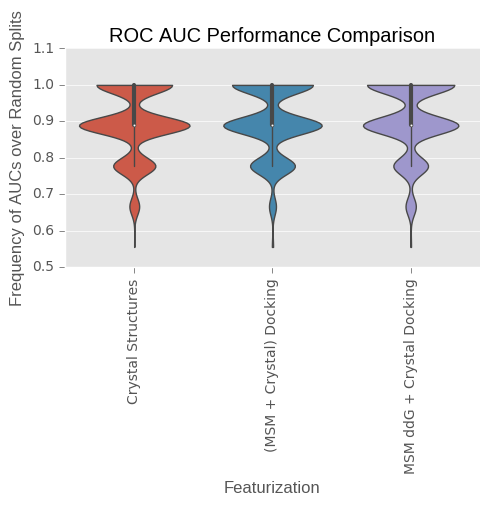

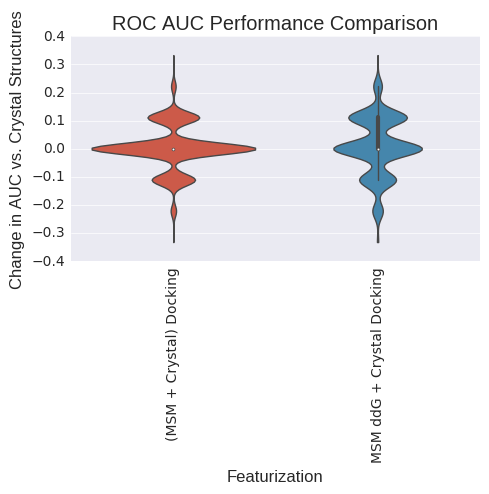

analyzing Recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures             0.9018            0.0000   
(MSM + Crystal) Docking        0.9350            0.0332   
MSM ddG + Crystal Docking      0.9496            0.0478   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.149921093555, 0.212310434313)  
MSM ddG + Crystal Docking  (0.274643867607, 0.349847592727)  


ValueError: list.remove(x): x not in list

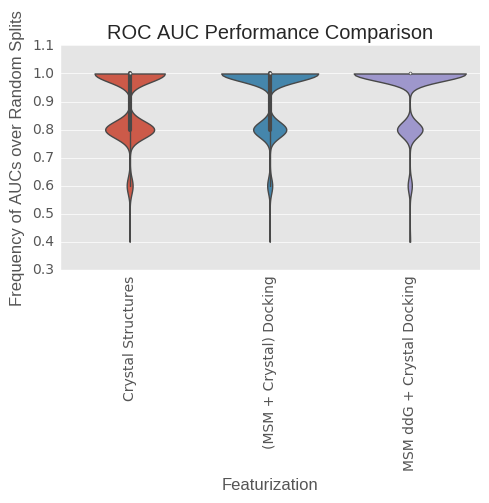

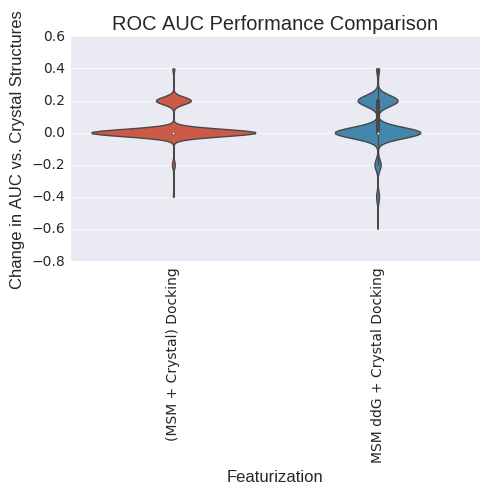

analyzing precision:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.922952          0.000000   
(MSM + Crystal) Docking      0.904489         -0.018463   
MSM ddG + Crystal Docking    0.900564         -0.022388   

                                            Sign Test 99% CI  
Crystal Structures                                  (0, 0.0)  
(MSM + Crystal) Docking    (0.0951044651382, 0.147918002518)  
MSM ddG + Crystal Docking   (0.149921093555, 0.212310434313)  


ValueError: list.remove(x): x not in list

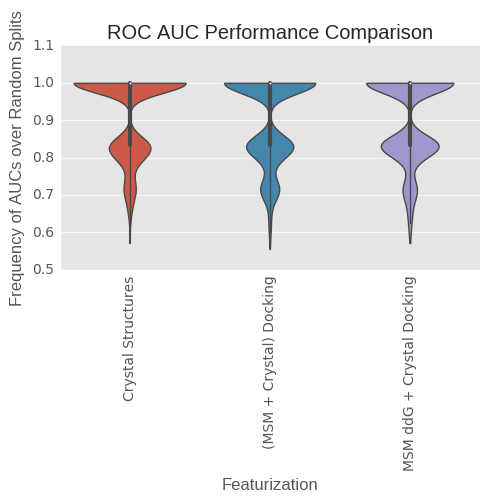

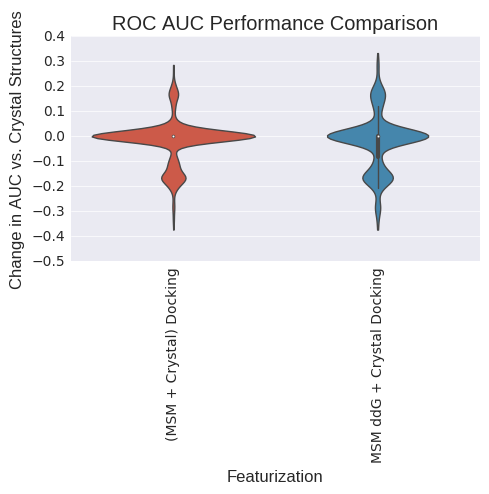

analyzing fdr:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.077048          0.000000   
(MSM + Crystal) Docking      0.095511          0.018463   
MSM ddG + Crystal Docking    0.099436          0.022388   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.165713204682, 0.230294223579)  
MSM ddG + Crystal Docking  (0.237344598779, 0.309660972417)  


ValueError: list.remove(x): x not in list

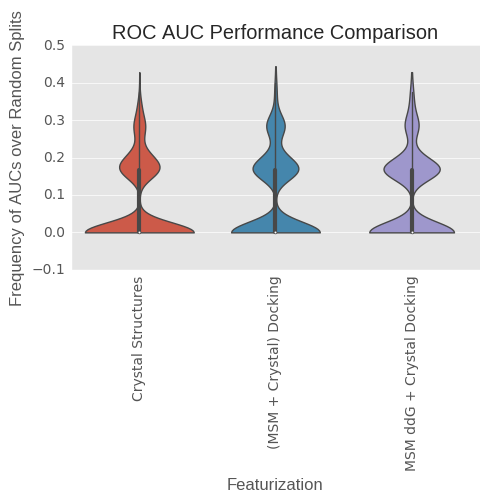

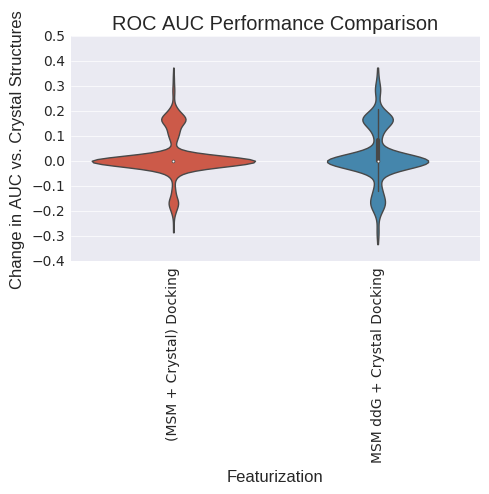

analyzing Recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures             0.9018            0.0000   
(MSM + Crystal) Docking        0.9350            0.0332   
MSM ddG + Crystal Docking      0.9496            0.0478   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.149921093555, 0.212310434313)  
MSM ddG + Crystal Docking  (0.274643867607, 0.349847592727)  


ValueError: list.remove(x): x not in list

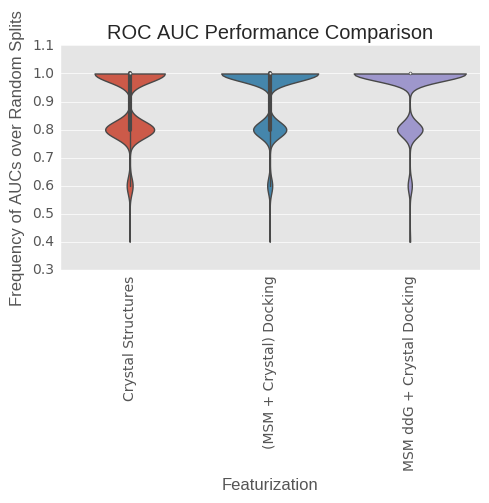

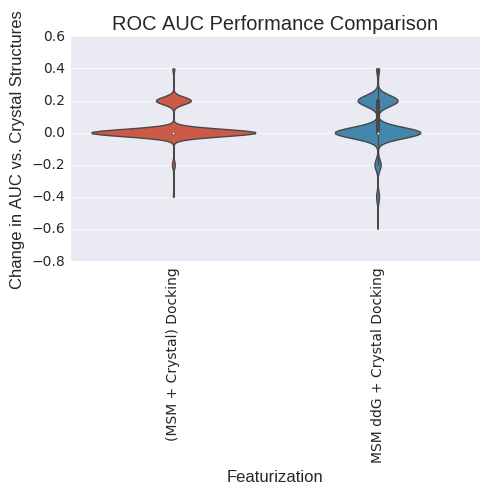

analyzing precision:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.922952          0.000000   
(MSM + Crystal) Docking      0.904489         -0.018463   
MSM ddG + Crystal Docking    0.900564         -0.022388   

                                            Sign Test 99% CI  
Crystal Structures                                  (0, 0.0)  
(MSM + Crystal) Docking    (0.0951044651382, 0.147918002518)  
MSM ddG + Crystal Docking   (0.149921093555, 0.212310434313)  


ValueError: list.remove(x): x not in list

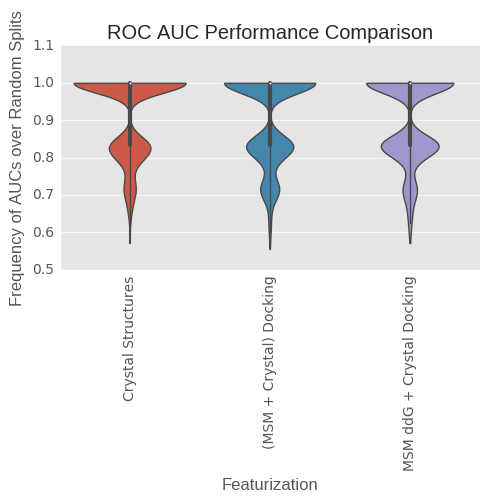

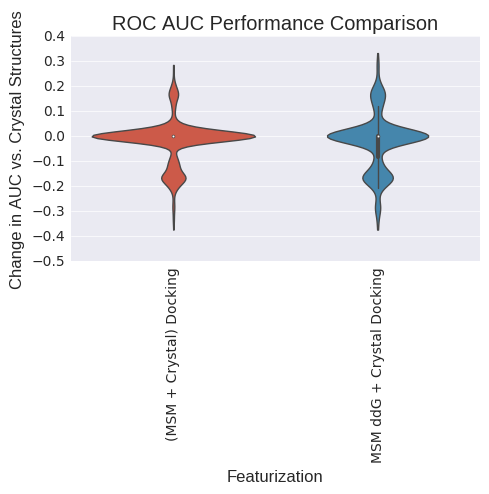

analyzing fdr:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.077048          0.000000   
(MSM + Crystal) Docking      0.095511          0.018463   
MSM ddG + Crystal Docking    0.099436          0.022388   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.165713204682, 0.230294223579)  
MSM ddG + Crystal Docking  (0.237344598779, 0.309660972417)  


ValueError: list.remove(x): x not in list

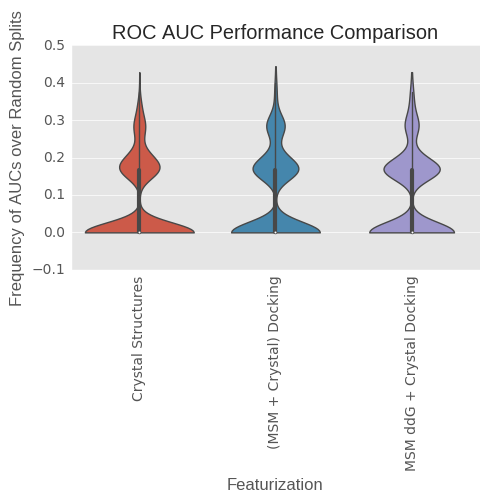

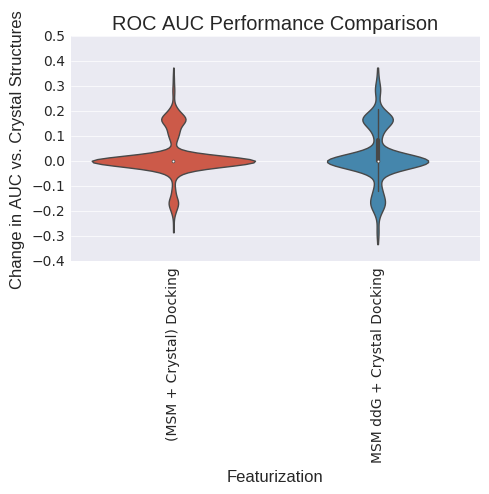

analyzing class B ROC AUC:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.974275          0.000000   
(MSM + Crystal) Docking      0.983250          0.008975   
MSM ddG + Crystal Docking    0.982925          0.008650   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.178788517479, 0.245034358165)  
MSM ddG + Crystal Docking  (0.219296427221, 0.289959608242)  


ValueError: list.remove(x): x not in list

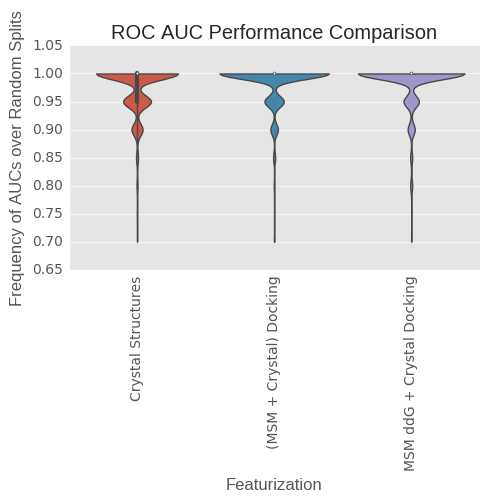

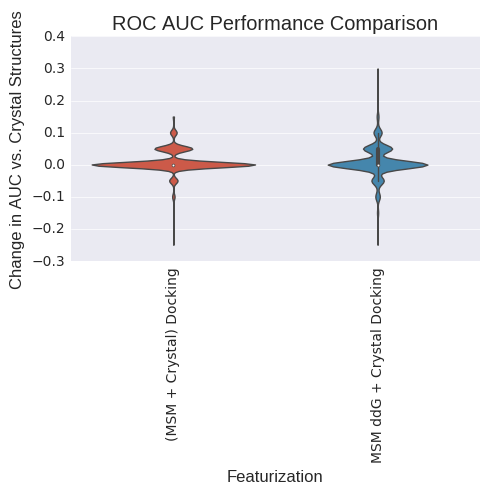

analyzing ROC AUC:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.974275          0.000000   
(MSM + Crystal) Docking      0.983250          0.008975   
MSM ddG + Crystal Docking    0.982925          0.008650   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.178788517479, 0.245034358165)  
MSM ddG + Crystal Docking  (0.219296427221, 0.289959608242)  


ValueError: list.remove(x): x not in list

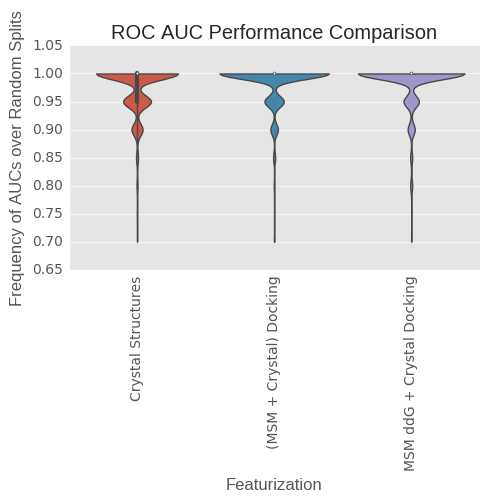

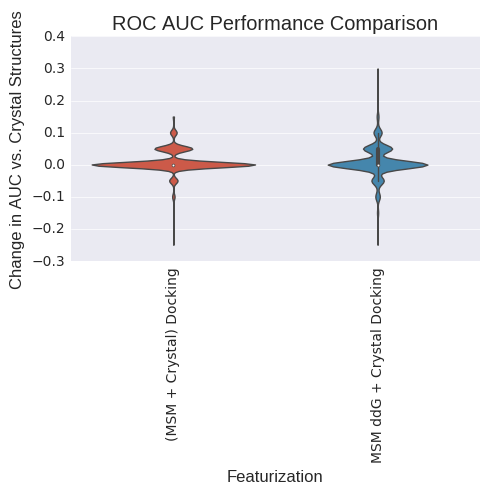

analyzing BedROC
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.999752          0.000000   
(MSM + Crystal) Docking      0.999877          0.000124   
MSM ddG + Crystal Docking    0.999762          0.000010   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.178788517479, 0.245034358165)  
MSM ddG + Crystal Docking  (0.220244183674, 0.290998669459)  


ValueError: list.remove(x): x not in list

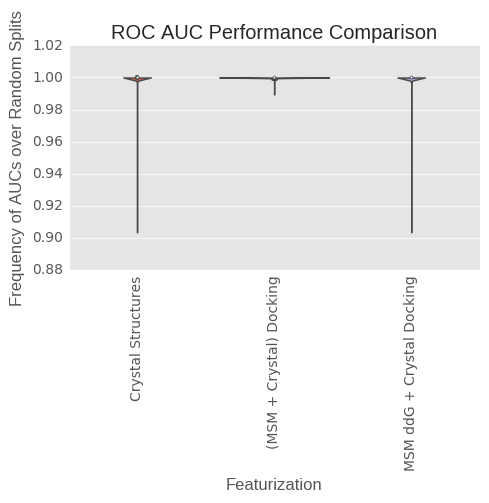

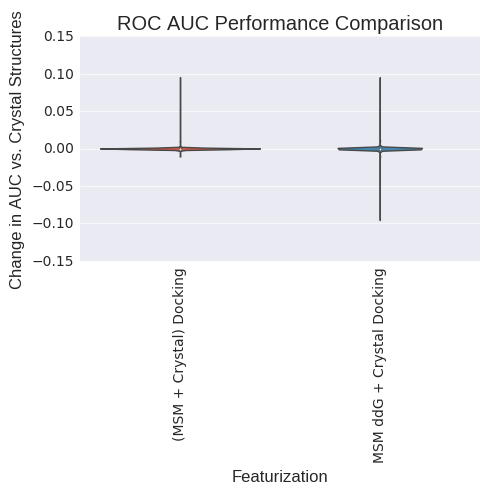

analyzing LogAUC
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.064301          0.000000   
(MSM + Crystal) Docking      0.041513         -0.022787   
MSM ddG + Crystal Docking    0.039867         -0.024433   

                                            Sign Test 99% CI  
Crystal Structures                                  (0, 0.0)  
(MSM + Crystal) Docking    (0.0623107948782, 0.107199418981)  
MSM ddG + Crystal Docking    (0.10231419961, 0.156602809408)  


ValueError: list.remove(x): x not in list

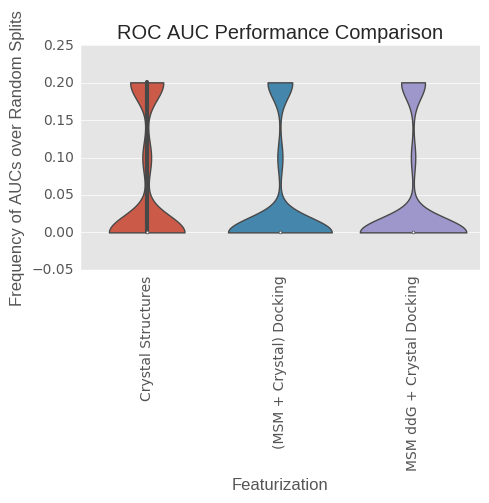

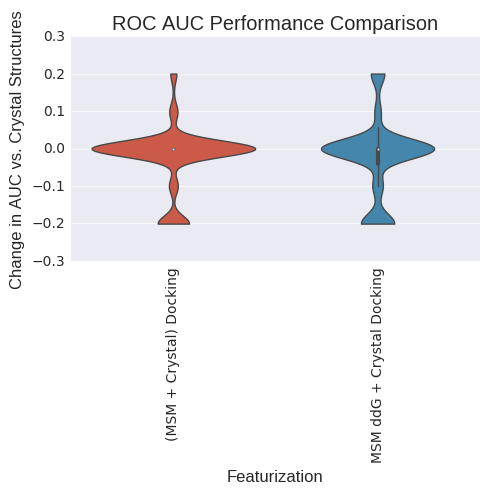

(3,)
(1, 3)


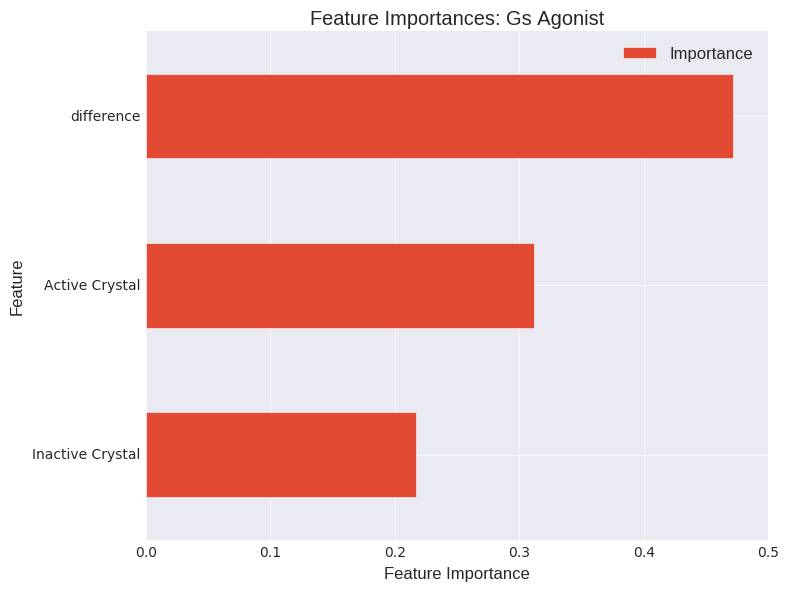

(55,)
(1, 55)


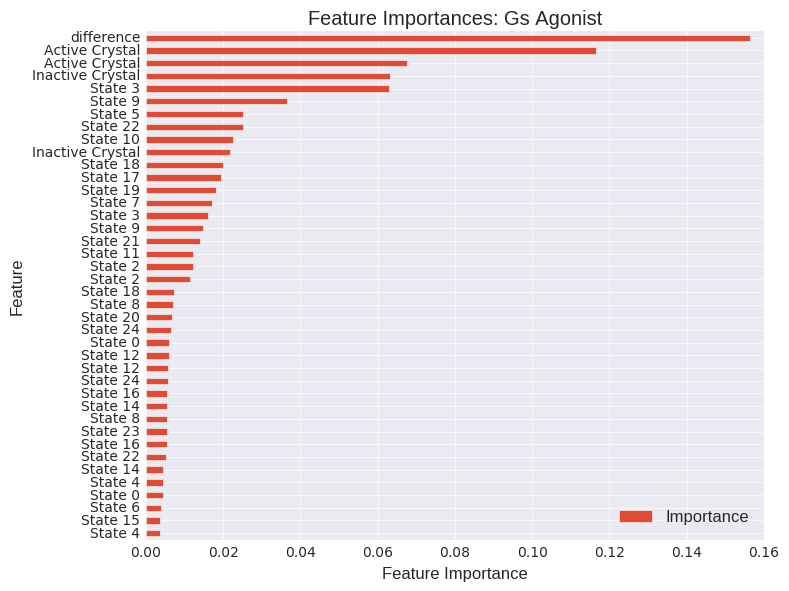

(105,)
(1, 105)


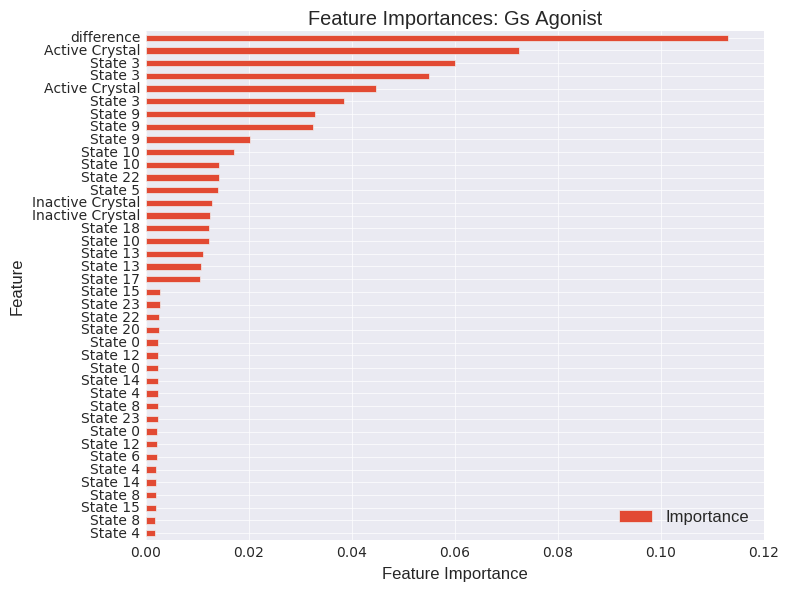

In [136]:
#SP, All ligands, RFR three class, 32 stereoisomers; new crystal grids; 25 clusters; Arrestin
import efficacy_scripts
reload(efficacy_scripts)
from efficacy_scripts import *


importance_dfs = analyze_multiclass_experiment(results_dict[save_name], 
                                                                feature_names,
                                                                [f.columns.values.tolist() for f in features], bret.loc[model_agonists]["Abbreviation"], analysis_dir,
                                                                ["Gs Antagonist", "Gs Agonist"], 
                                                                #["Gs Inactive", "Gs Active"], 
                                                               #["Arr Inactive", "Arr Active"],
                                               np.hstack([X_df.loc[model_agonists].values]),
                                                               #["Gs Inactive", "Gs Partial Active", "Gs Full Active"], 
                                              remake=False, fxn=np.mean, exp_title="gs_twoclss")


#TRY LOOCV
#crystal structures might just have bigger boxes





analyzing precision at full recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.660386          0.000000   
(MSM + Crystal) Docking      0.769271          0.108886   
MSM ddG + Crystal Docking    0.758730          0.098344   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.475322198452, 0.556466884271)  
MSM ddG + Crystal Docking   (0.46437606571, 0.545558022641)  


ValueError: list.remove(x): x not in list

analyzing threshold at full recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.444998          0.000000   
(MSM + Crystal) Docking      0.487348          0.042350   
MSM ddG + Crystal Docking    0.451139          0.006141   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.597047080293, 0.675146940523)  
MSM ddG + Crystal Docking  (0.495274381732, 0.576251054395)  


ValueError: list.remove(x): x not in list

analyzing Accuracy:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.646778          0.000000   
(MSM + Crystal) Docking      0.708444          0.061667   
MSM ddG + Crystal Docking    0.720111          0.073333   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.432643803796, 0.513712119109)  
MSM ddG + Crystal Docking  (0.508278144981, 0.589075920858)  


ValueError: list.remove(x): x not in list

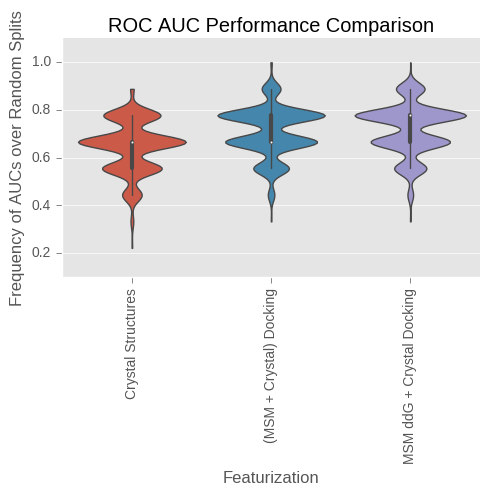

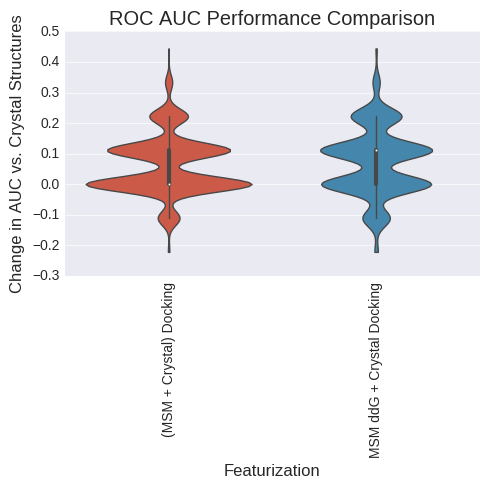

analyzing Recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.784333             0.000   
(MSM + Crystal) Docking      0.904333             0.120   
MSM ddG + Crystal Docking    0.877333             0.093   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking     (0.299683933798, 0.37646478596)  
MSM ddG + Crystal Docking  (0.258345185918, 0.332370374022)  


ValueError: list.remove(x): x not in list

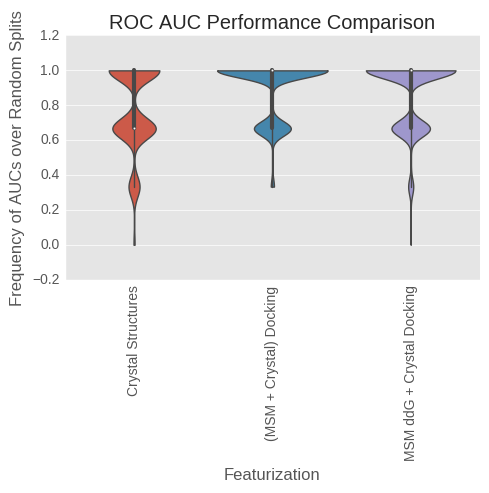

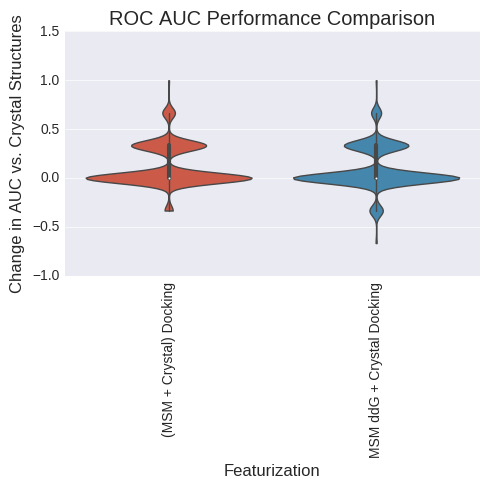

analyzing precision:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.581450          0.000000   
(MSM + Crystal) Docking      0.649693          0.068243   
MSM ddG + Crystal Docking    0.681912          0.100462   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.407968414735, 0.488717066415)  
MSM ddG + Crystal Docking  (0.512284857525, 0.593016478995)  


ValueError: list.remove(x): x not in list

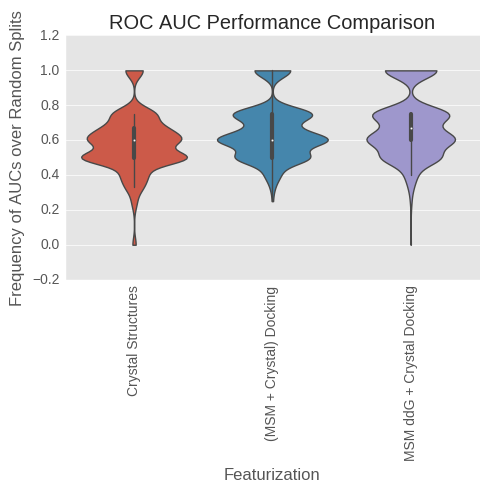

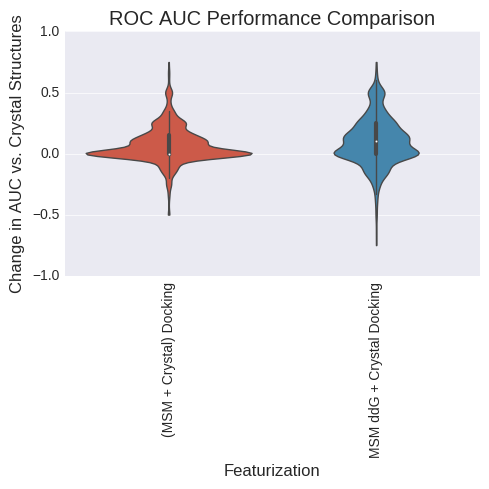

analyzing fdr:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.418550          0.000000   
(MSM + Crystal) Docking      0.350307         -0.068243   
MSM ddG + Crystal Docking    0.318088         -0.100462   

                                            Sign Test 99% CI  
Crystal Structures                                  (0, 0.0)  
(MSM + Crystal) Docking    (0.0745983688175, 0.122727292425)  
MSM ddG + Crystal Docking     (0.134231925074, 0.1942237024)  


ValueError: list.remove(x): x not in list

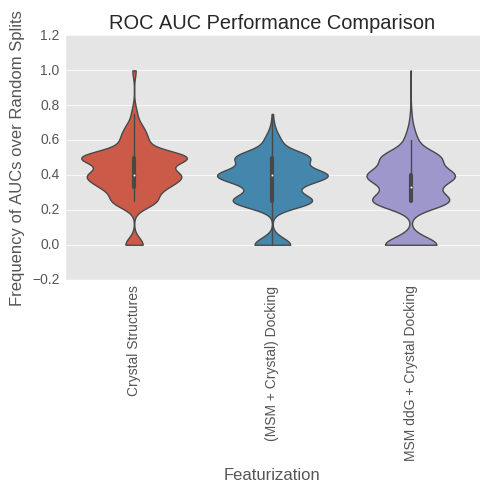

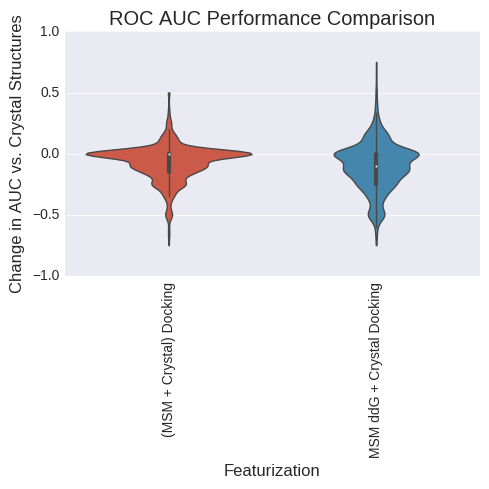

analyzing Recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.646778          0.000000   
(MSM + Crystal) Docking      0.708444          0.061667   
MSM ddG + Crystal Docking    0.720111          0.073333   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.432643803796, 0.513712119109)  
MSM ddG + Crystal Docking  (0.508278144981, 0.589075920858)  


ValueError: list.remove(x): x not in list

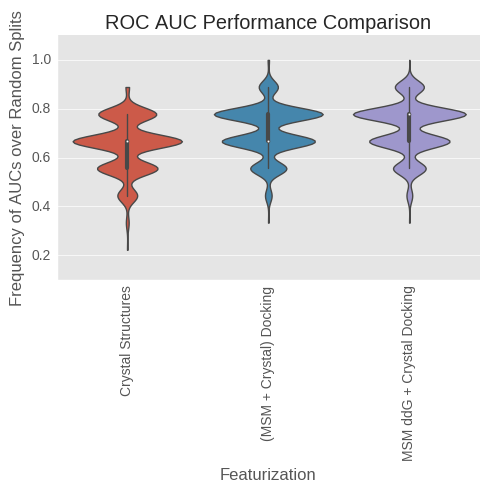

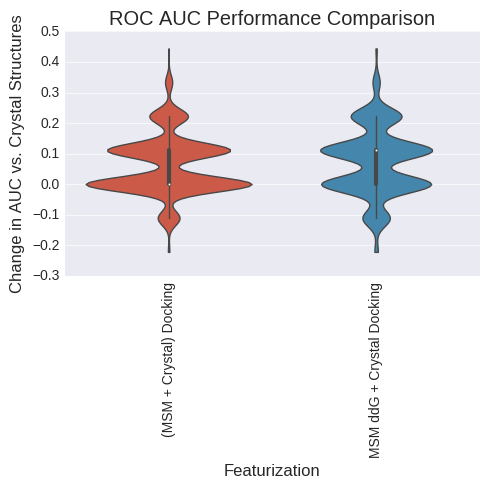

analyzing precision:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.579762          0.000000   
(MSM + Crystal) Docking      0.638969          0.059207   
MSM ddG + Crystal Docking    0.648753          0.068991   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.437591064652, 0.518698946604)  
MSM ddG + Crystal Docking   (0.548464334717, 0.62836243793)  


ValueError: list.remove(x): x not in list

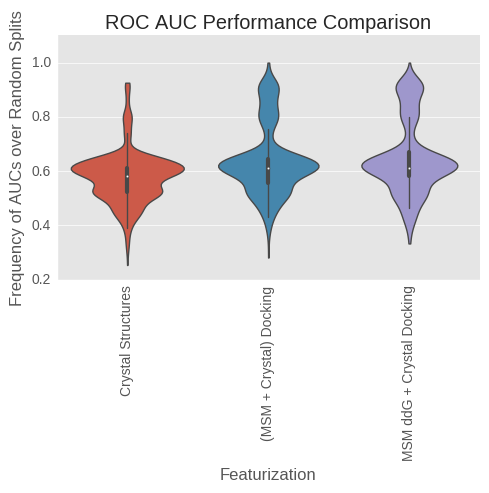

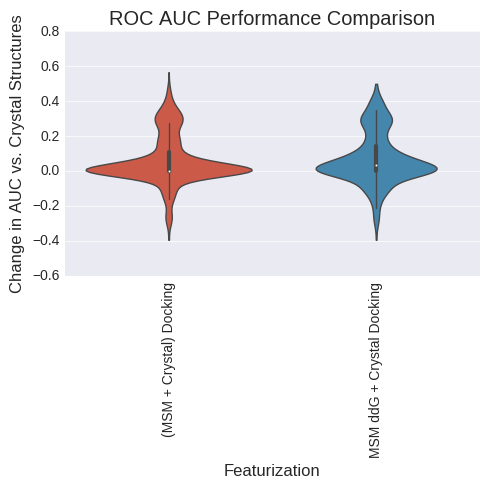

analyzing fdr:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.420238          0.000000   
(MSM + Crystal) Docking      0.361031         -0.059207   
MSM ddG + Crystal Docking    0.351247         -0.068991   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.115923585022, 0.172795689049)  
MSM ddG + Crystal Docking  (0.195684665826, 0.263900927881)  


ValueError: list.remove(x): x not in list

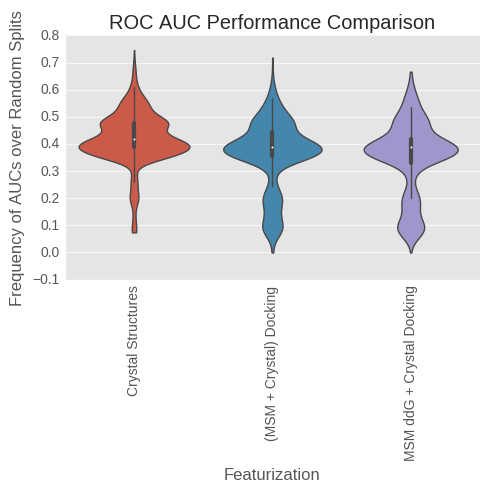

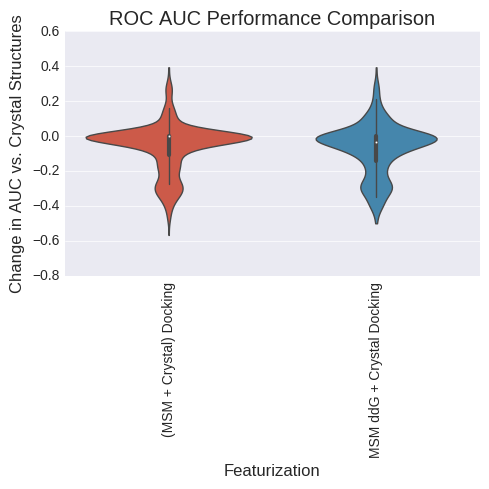

analyzing class B ROC AUC:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.810028          0.000000   
(MSM + Crystal) Docking      0.891250          0.081222   
MSM ddG + Crystal Docking    0.885278          0.075250   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.635803580215, 0.711889512068)  
MSM ddG + Crystal Docking   (0.60823829954, 0.685810715649)  


ValueError: list.remove(x): x not in list

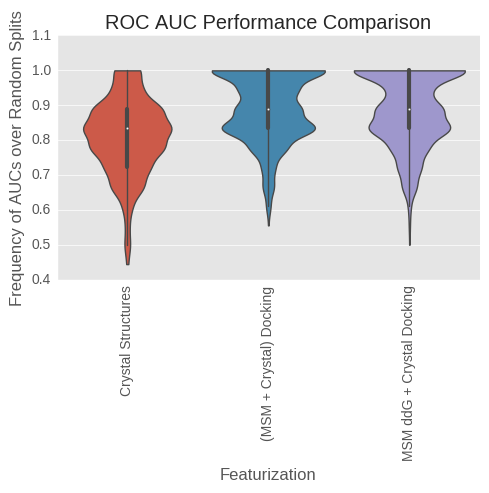

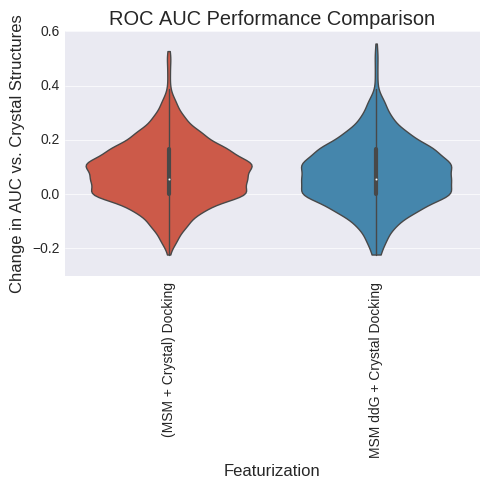

analyzing ROC AUC:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.777814          0.000000   
(MSM + Crystal) Docking      0.862643          0.084829   
MSM ddG + Crystal Docking    0.867635          0.089821   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.789811852284, 0.851930255188)  
MSM ddG + Crystal Docking  (0.790873534559, 0.852855390584)  


ValueError: list.remove(x): x not in list

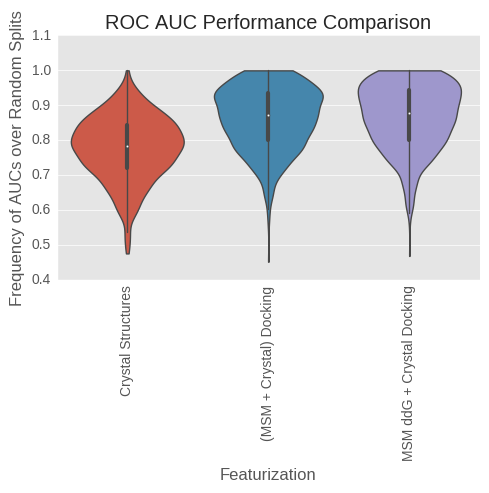

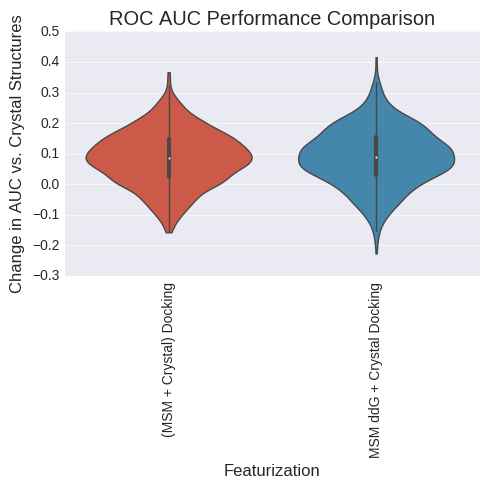

analyzing BedROC
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.565763          0.000000   
(MSM + Crystal) Docking      0.704393          0.138630   
MSM ddG + Crystal Docking    0.721639          0.155877   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.568658365939, 0.647904760112)  
MSM ddG + Crystal Docking     (0.558552789, 0.638142160349)  


ValueError: list.remove(x): x not in list

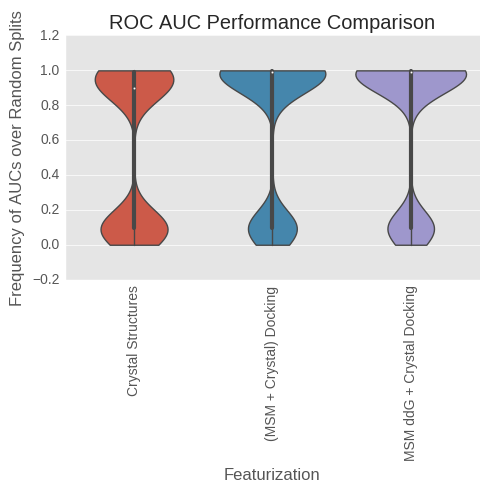

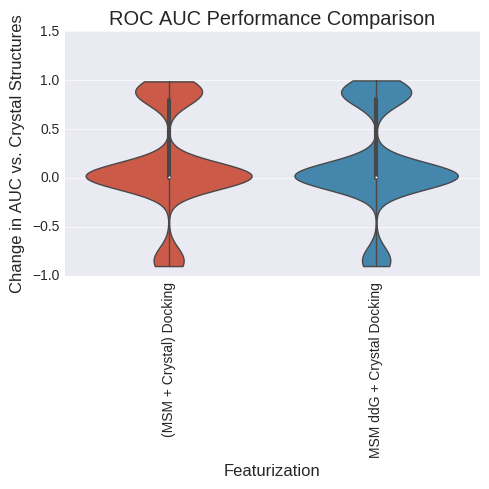

analyzing LogAUC
(1000, 0)
/n
(3,)
(1, 3)


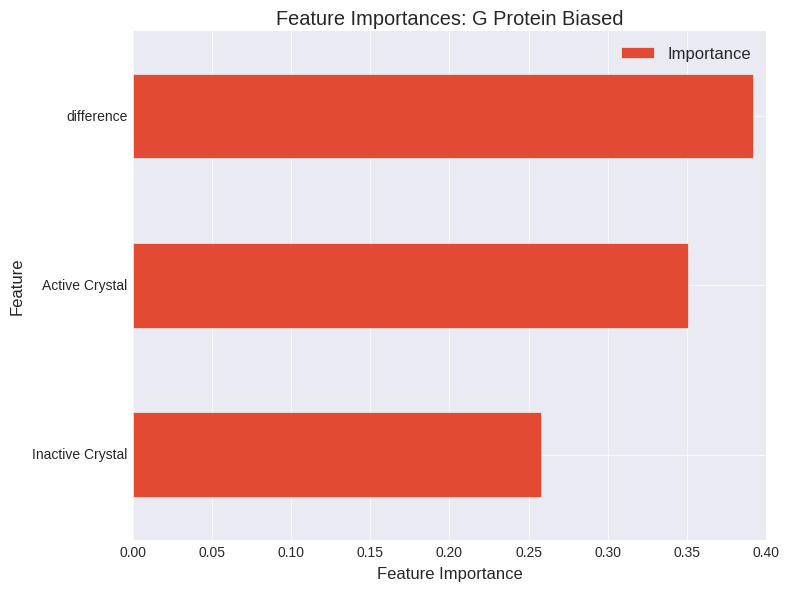

(55,)
(1, 55)


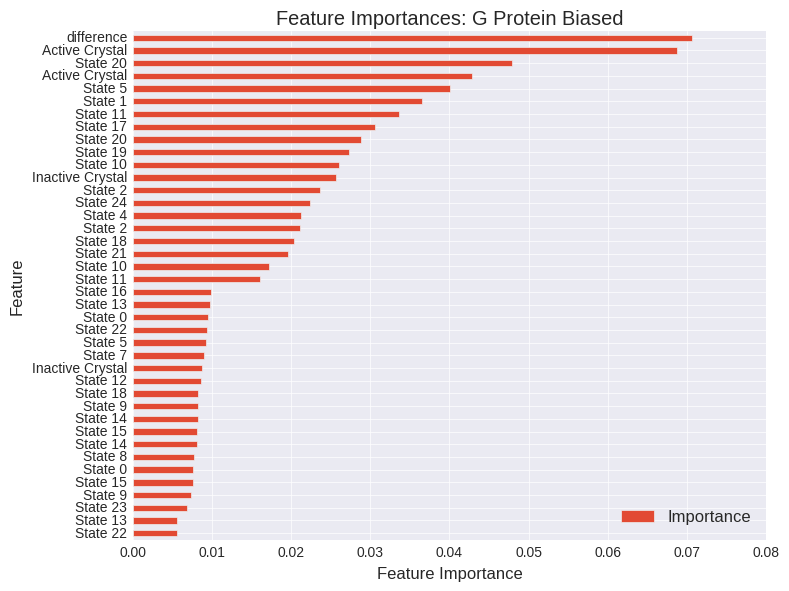

(105,)
(1, 105)


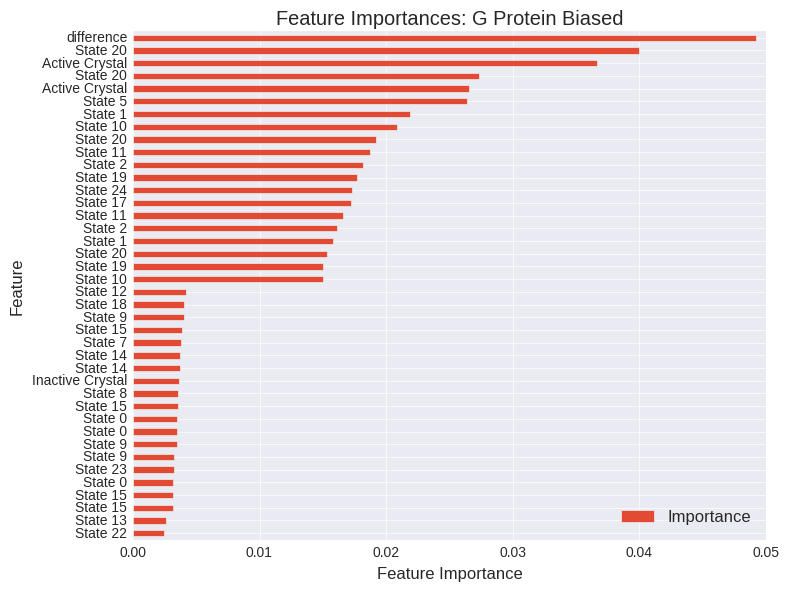

In [138]:
#XP, All ligands, RFR three class, 32 stereoisomers; new crystal grids; 25 clusters
import efficacy_scripts
reload(efficacy_scripts)
from efficacy_scripts import *


importance_dfs = analyze_multiclass_experiment(results_dict[save_name], 
                                                                feature_names,
                                                                [f.columns.values.tolist() for f in features], bret.loc[model_agonists]["Abbreviation"], analysis_dir,
                                                                ["Balanced Agonist", "G Protein Biased", "Antagonist"], 
                                                                #["Gs Inactive", "Gs Active"], 
                                                               #["Arr Inactive", "Arr Active"],
                                               np.hstack([X_df.loc[model_agonists].values]),
                                                               #["Gs Inactive", "Gs Partial Active", "Gs Full Active"], 
                                              remake=False, fxn=np.mean, exp_title="0pt4_gap_three_class")


#TRY LOOCV
#crystal structures might just have bigger boxes




In [443]:
y_df["paper_name"] = bret.loc[y_df.index]["PaperName"]
class_titles = []
for i in y_df["class"].values.tolist():
    if i == 0.:
        class_titles.append("Balanced Agonist")
    if i == 1.:
        class_titles.append("G Protein Biased Agonist")
    if i == 2.:
        class_titles.append("Antagonist")
y_df["class"] = class_titles
y_df.sort("class", inplace=False)

/home/enf/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:11: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)


,class,paper_name
CID_4546390,Antagonist,ICI 215001
CID_123686,Antagonist,ICI 89406
CID_155774,Antagonist,Xamoterol (ICI 118587)
CID_3682,Antagonist,ICI 118551
CID_4828,Antagonist,Pindolol
CID_4883,Antagonist,Practolol
CID_4930,Antagonist,Pronethalol
CID_4946,Antagonist,Propranolol
CID_5806,Antagonist,Dichloroisoproterenol
CID_5253,Antagonist,Sotalol (betapace)


In [446]:
from importlib import reload
import grids
reload(grids)
from grids import *

grid_center = "64.4, 16.9, 11.99"


#reimaged_dir = samples_dir
#mae_dir = reimaged_dir
#remove_ter(reimaged_dir)
#reorder(reimaged_dir)


#agonist_ligands = [a for a in agonist_ligands if "TA" not in a]

#pprep(mae_dir, ref = active_ref_dir, chosen_receptors = chosen_receptors, worker_pool=None, parallel=True)
#generate_grids(mae_dir, grid_center, grid_dir, remove_lig = "BIA", chosen_receptors = chosen_receptors, worker_pool=None, outer_box=25.)

precision = "SP"
htbc_dir = "/home/enf/htbc/sdfs"
docking_dir = "/home/enf/htbc/b2ar/docking_SP_1-stereoisomer"
#docking_dir = "/home/enf/htbc/b2ar/docking_xp/1_stereoisomer"
grid_dir = "/home/enf/htbc/b2ar/grids"

#lig_dir = "/home/enf/b2ar_analysis/all_ligands/1_stereoisomer"
#df = prepare_ligands(htbc_dir, exts = [".sdf"],
#                     n_ring_conf=1, n_stereoisomers=1,
#                     force_field=16, worker_pool=None,
#                     parallel=True, redo=False,
#                     smiles_df=None, cid_df=None,
#                     binding_db=None,
#                     return_df=True)

if not os.path.exists(docking_dir):
    os.makedirs(docking_dir)
if not os.path.exists(grid_dir):
    os.makedirs(grid_dir)

#chosen_ligands = df.index.values.tolist()[:2000]
chosen_ligands = [n for n in get_ligands(htbc_dir, ".mae")]
#lig_dir = all_ligands_dir
dock_ligands_and_receptors(grid_dir, docking_dir, htbc_dir,
                           precision = precision, ext = "-out.maegz",
                           chosen_ligands=chosen_ligands, chosen_receptors =["3P0G_pymol_prepped_new", "2RH1_prepped"],
                           parallel = False, grid_ext = ".zip", worker_pool=dview,
                           retry_after_failed=True, timeout=60*1200*1000)
#dock_ligands_and_receptors(grid_dir, docking_dir, lig_dir, precision = precision, ext = "-out.maegz", chosen_ligands=chosen_ligands, chosen_receptors = None, parallel = False, grid_ext = ".zip", worker_pool=dview, retry_after_failed=True, timeout=60*1200)


#dock_ligands_and_receptors(grid_dir, docking_dir,  biased_agonist_dir, precision = precision, ext = "-out.maegz", chosen_ligands = biased_ligands, chosen_receptors = chosen_receptors, parallel = None, grid_ext = ".grd", worker_pool=dview)
#dock_ligands_and_receptors(grid_dir, docking_dir, agonist_dir, precision = precision, ext = "-out.maegz", chosen_ligands = agonist_ligands, chosen_receptors = chosen_receptors, parallel = None, grid_ext = ".grd", worker_pool=dview)


Creating new directories for each ligand.
Done creating directories. Determining which docking jobs to conduct.
About to do 89028 Docking computations.
Completed docking.


analyzing precision at full recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.662149          0.000000   
(MSM + Crystal) Docking      0.644254         -0.017895   
MSM ddG + Crystal Docking    0.660146         -0.002003   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.155483598105, 0.218668835784)  
MSM ddG + Crystal Docking  (0.205109989984, 0.274343780426)  


ValueError: list.remove(x): x not in list

analyzing threshold at full recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.407382          0.000000   
(MSM + Crystal) Docking      0.334177         -0.073206   
MSM ddG + Crystal Docking    0.341025         -0.066358   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.349169831579, 0.428306589359)  
MSM ddG + Crystal Docking   (0.363812421011, 0.44346626498)  


ValueError: list.remove(x): x not in list

analyzing Accuracy:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures             0.7039            0.0000   
(MSM + Crystal) Docking        0.6595           -0.0444   
MSM ddG + Crystal Docking      0.6755           -0.0284   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.104122139752, 0.158768504606)  
MSM ddG + Crystal Docking   (0.143447717067, 0.20487608711)  


ValueError: list.remove(x): x not in list

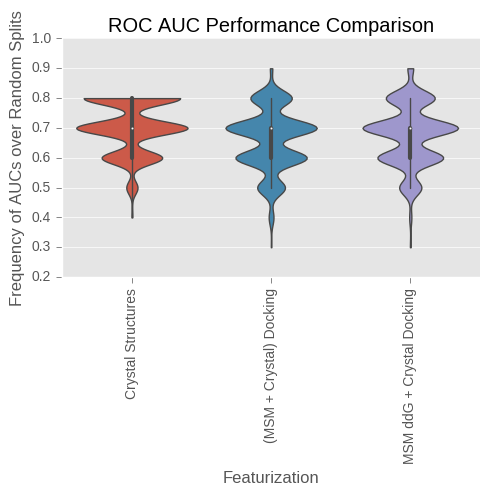

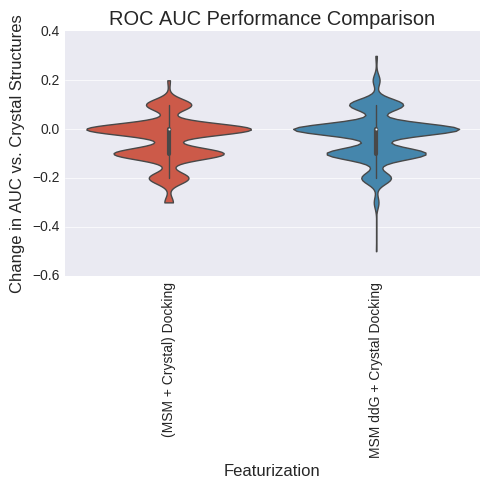

analyzing Recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures            0.88775            0.0000   
(MSM + Crystal) Docking       0.78225           -0.1055   
MSM ddG + Crystal Docking     0.79475           -0.0930   

                                             Sign Test 99% CI  
Crystal Structures                                   (0, 0.0)  
(MSM + Crystal) Docking    (0.0485015723544, 0.0892195587818)  
MSM ddG + Crystal Docking  (0.0536466609731, 0.0959953761842)  


ValueError: list.remove(x): x not in list

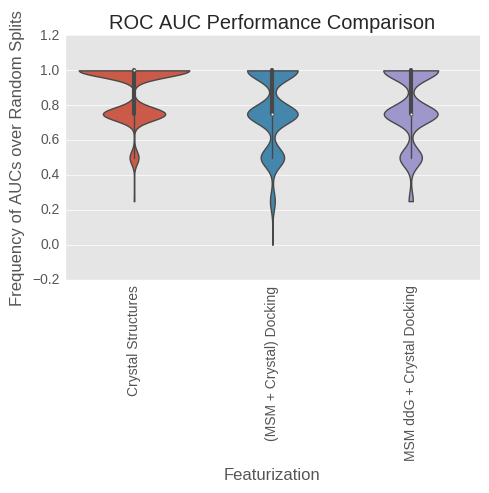

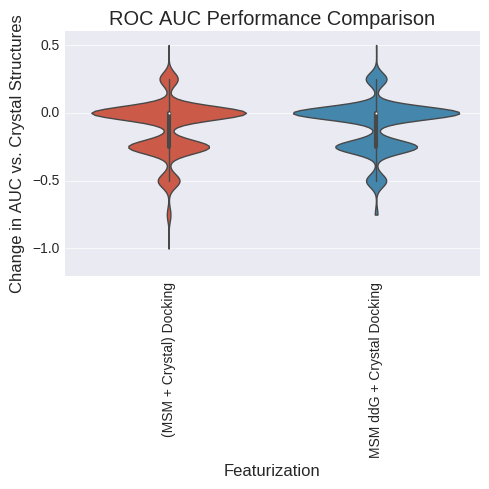

analyzing precision:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.636683          0.000000   
(MSM + Crystal) Docking      0.610362         -0.026321   
MSM ddG + Crystal Docking    0.630698         -0.005985   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.206998212731, 0.276429193019)  
MSM ddG + Crystal Docking  (0.261217039722, 0.335458973228)  


ValueError: list.remove(x): x not in list

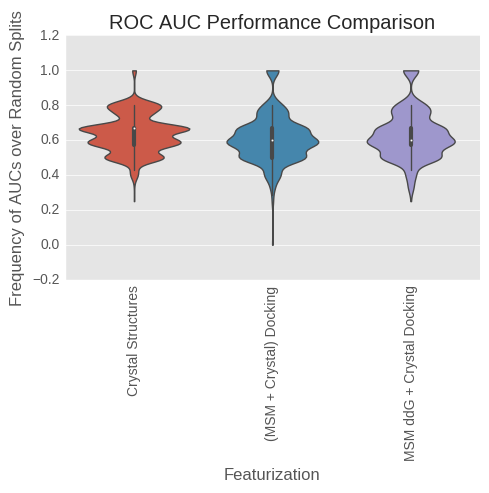

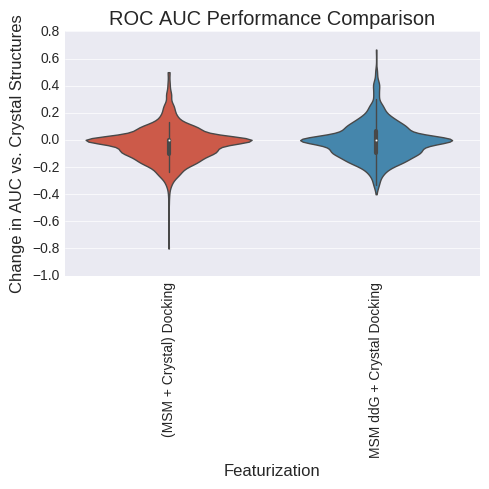

analyzing fdr:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.363317          0.000000   
(MSM + Crystal) Docking      0.389638          0.026321   
MSM ddG + Crystal Docking    0.369302          0.005985   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.393212284114, 0.473670931984)  
MSM ddG + Crystal Docking  (0.350144793846, 0.429318444763)  


ValueError: list.remove(x): x not in list

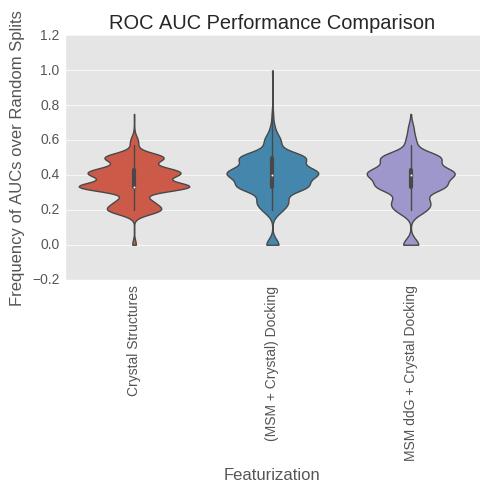

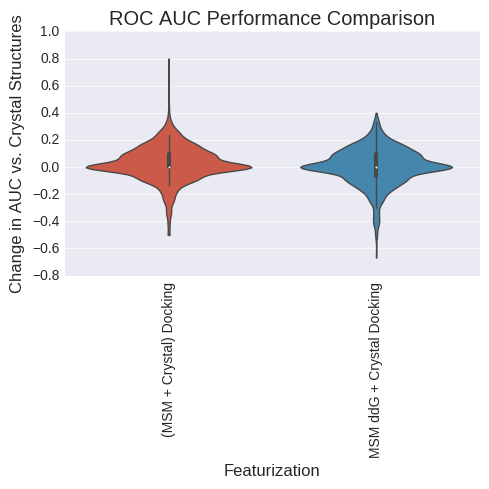

analyzing Recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures             0.7039            0.0000   
(MSM + Crystal) Docking        0.6595           -0.0444   
MSM ddG + Crystal Docking      0.6755           -0.0284   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.104122139752, 0.158768504606)  
MSM ddG + Crystal Docking   (0.143447717067, 0.20487608711)  


ValueError: list.remove(x): x not in list

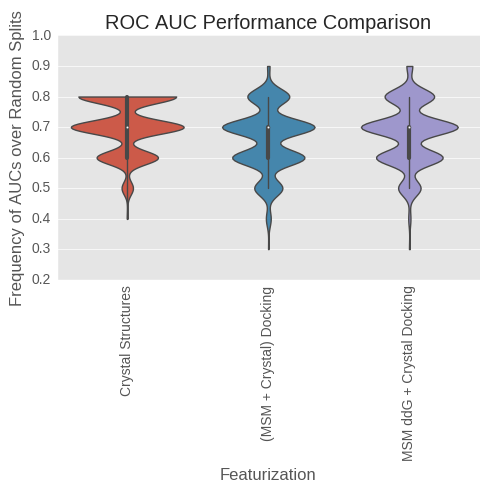

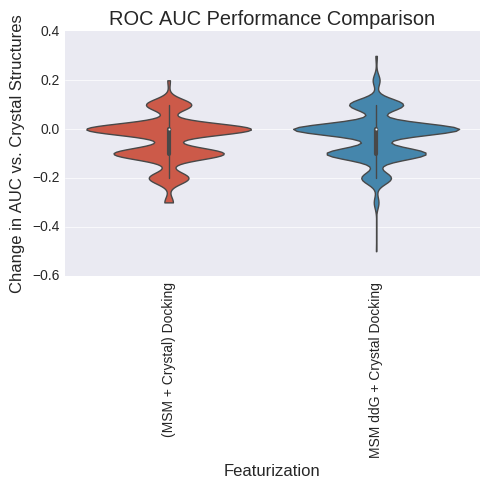

analyzing precision:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.585861          0.000000   
(MSM + Crystal) Docking      0.588427          0.002566   
MSM ddG + Crystal Docking    0.600539          0.014678   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.298718421021, 0.375443481067)  
MSM ddG + Crystal Docking  (0.332622328983, 0.411078191562)  


ValueError: list.remove(x): x not in list

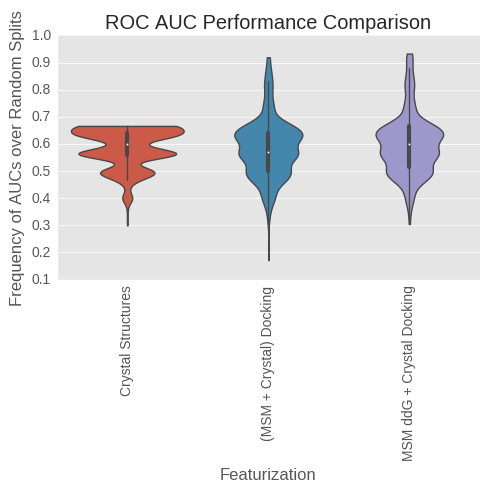

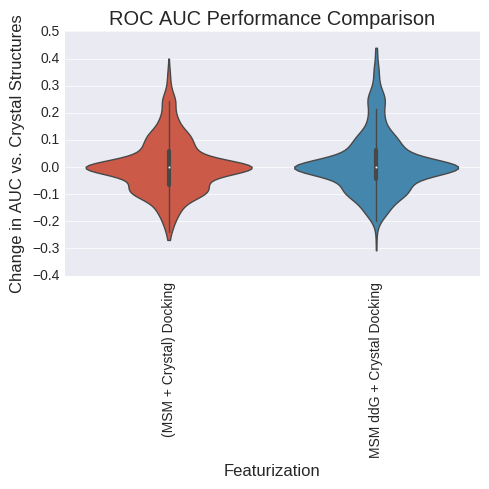

analyzing fdr:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.414139          0.000000   
(MSM + Crystal) Docking      0.411573         -0.002566   
MSM ddG + Crystal Docking    0.399461         -0.014678   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.355998211368, 0.435385933262)  
MSM ddG + Crystal Docking  (0.331650541571, 0.410063161304)  


ValueError: list.remove(x): x not in list

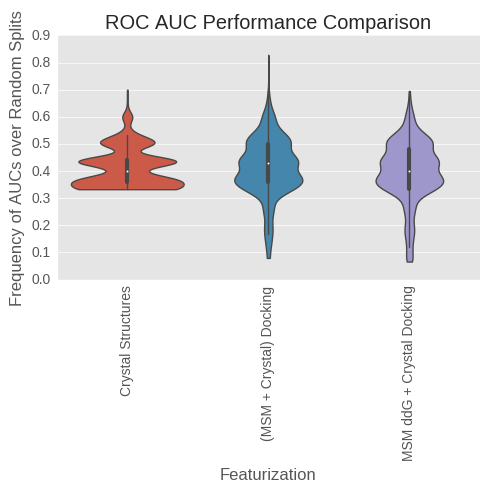

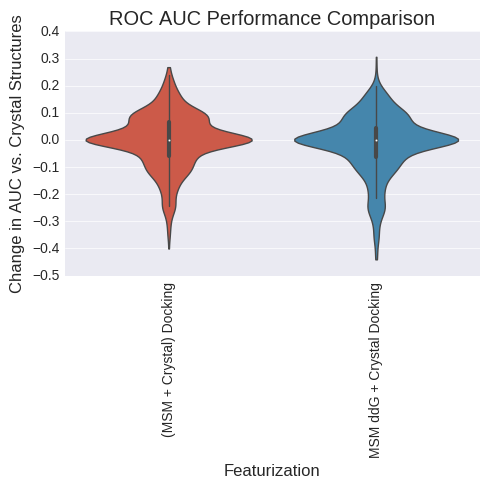

analyzing class B ROC AUC:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.757750          0.000000   
(MSM + Crystal) Docking      0.786271          0.028521   
MSM ddG + Crystal Docking    0.810521          0.052771   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.488283745581, 0.569333966854)  
MSM ddG + Crystal Docking  (0.540405765851, 0.620526465434)  


ValueError: list.remove(x): x not in list

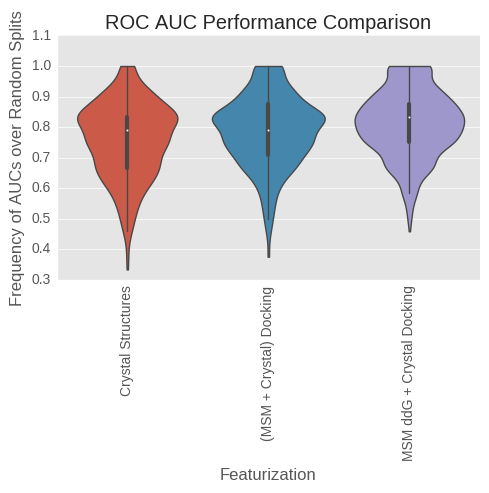

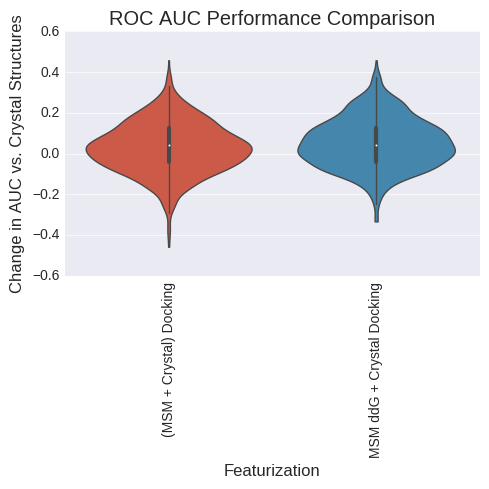

analyzing ROC AUC:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.716146          0.000000   
(MSM + Crystal) Docking      0.792333          0.076188   
MSM ddG + Crystal Docking    0.809472          0.093326   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.688270090371, 0.760750703093)  
MSM ddG + Crystal Docking     (0.749715642005, 0.816527394)  


ValueError: list.remove(x): x not in list

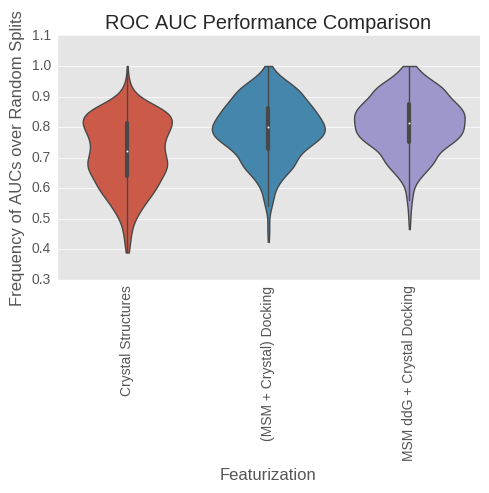

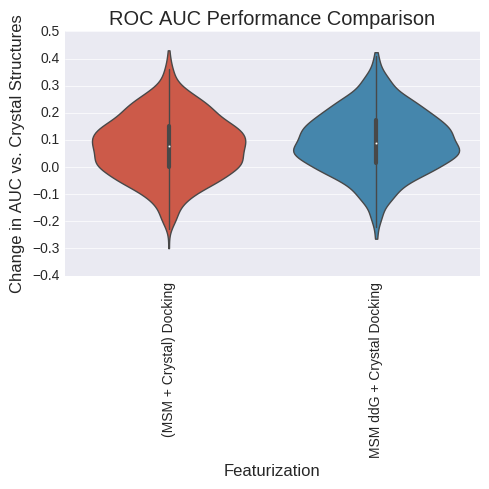

analyzing BedROC
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.691081          0.000000   
(MSM + Crystal) Docking      0.661785         -0.029296   
MSM ddG + Crystal Docking    0.699804          0.008723   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.442542369815, 0.523681729792)  
MSM ddG + Crystal Docking   (0.484292664225, 0.56537777753)  


ValueError: list.remove(x): x not in list

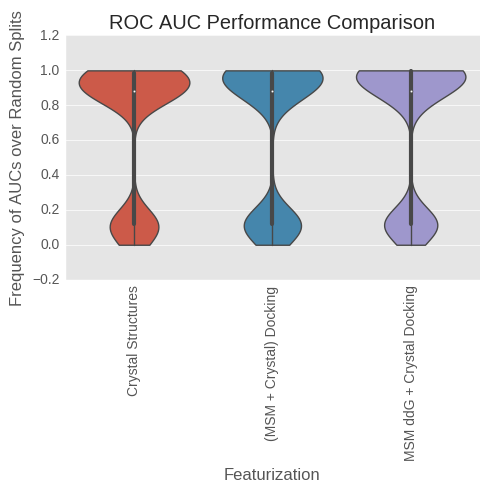

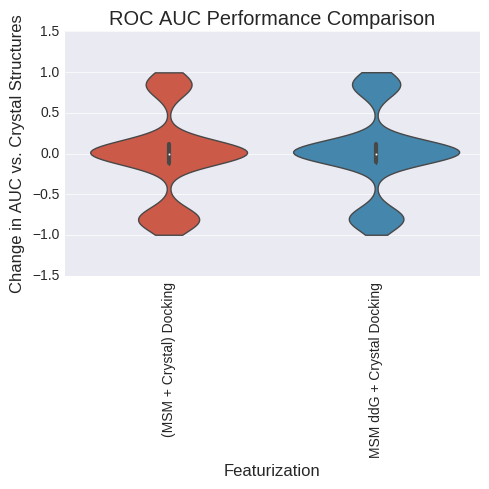

analyzing LogAUC
(1000, 0)
/n
(3, 3)
(3, 3)


/vspdata/vspcompute/home/enf/b2ar_analysis/conformation/efficacy_scripts.py:1631: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  inplace=False)


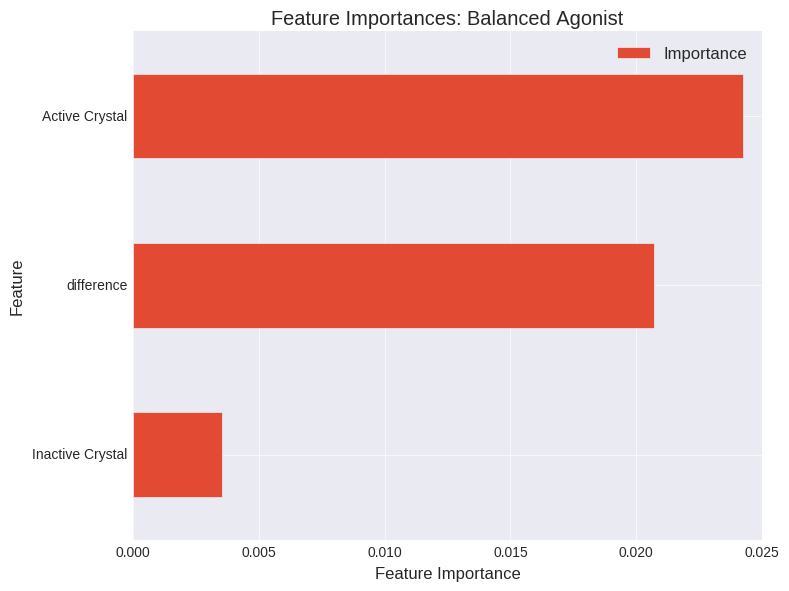

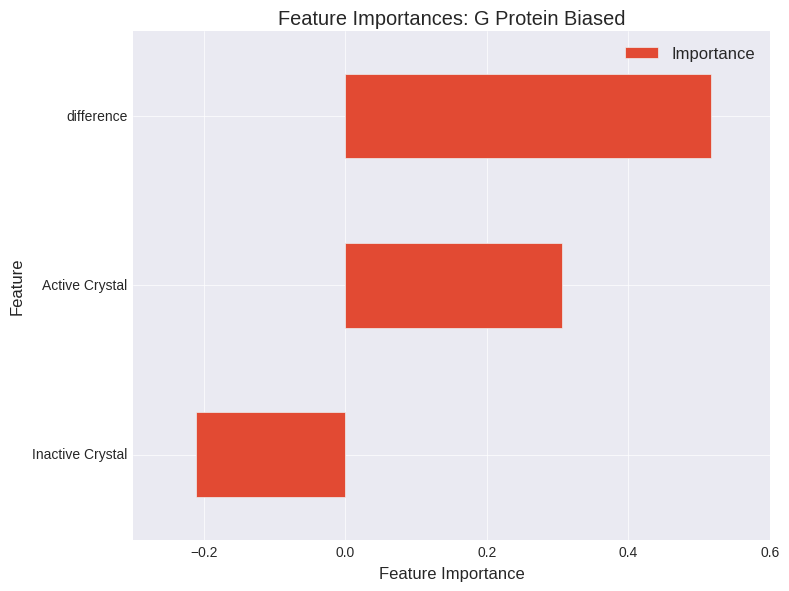

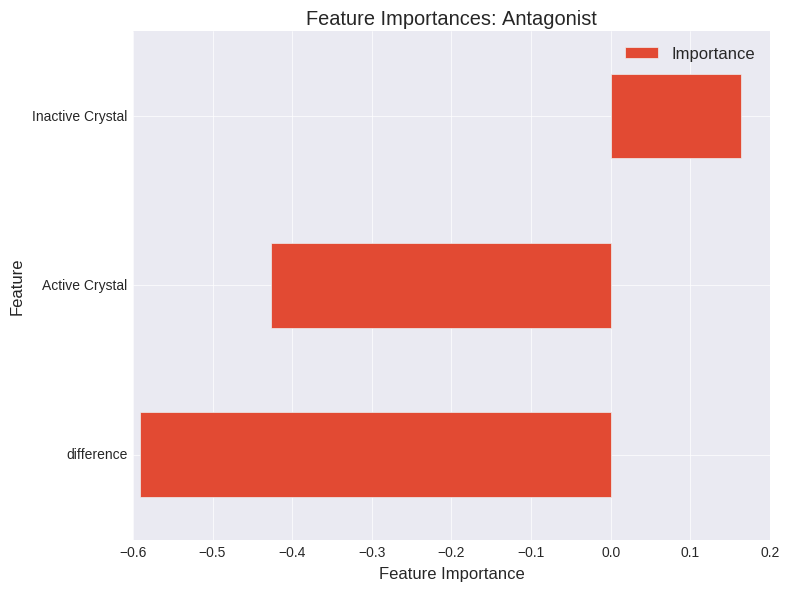

(3, 55)
(3, 55)


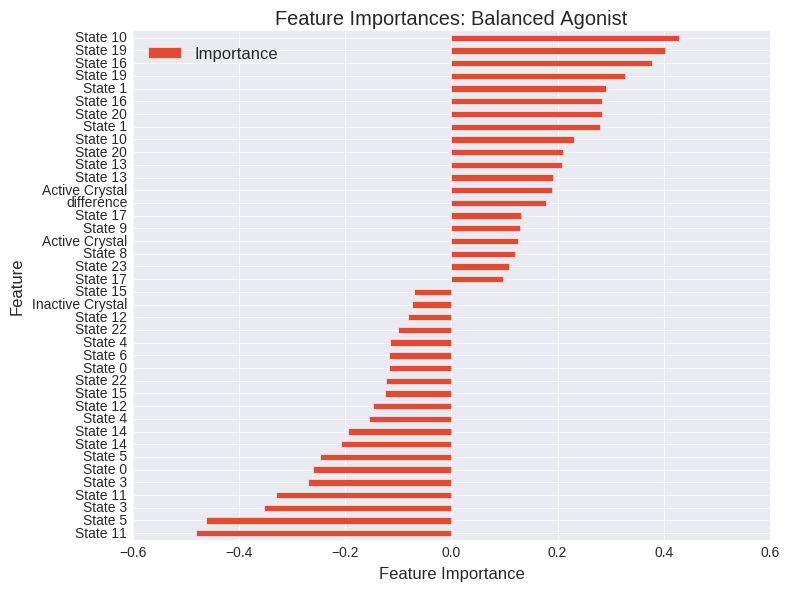

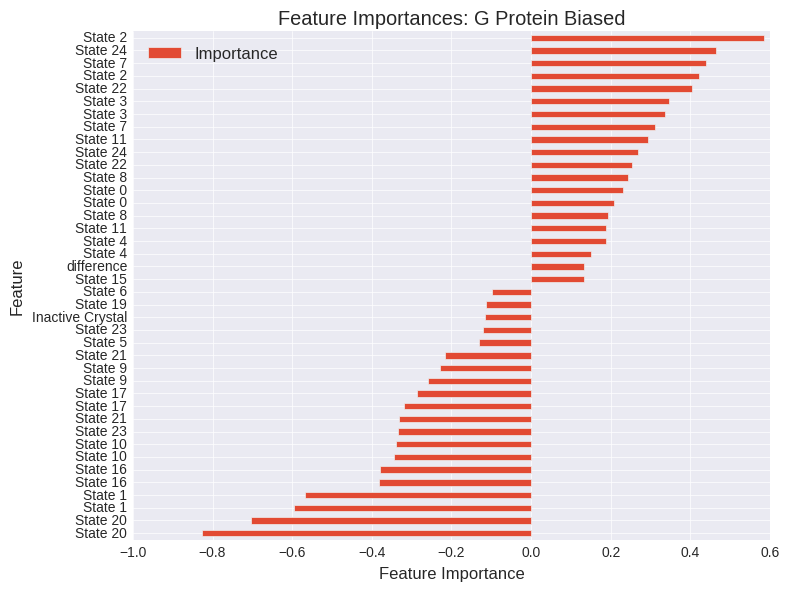

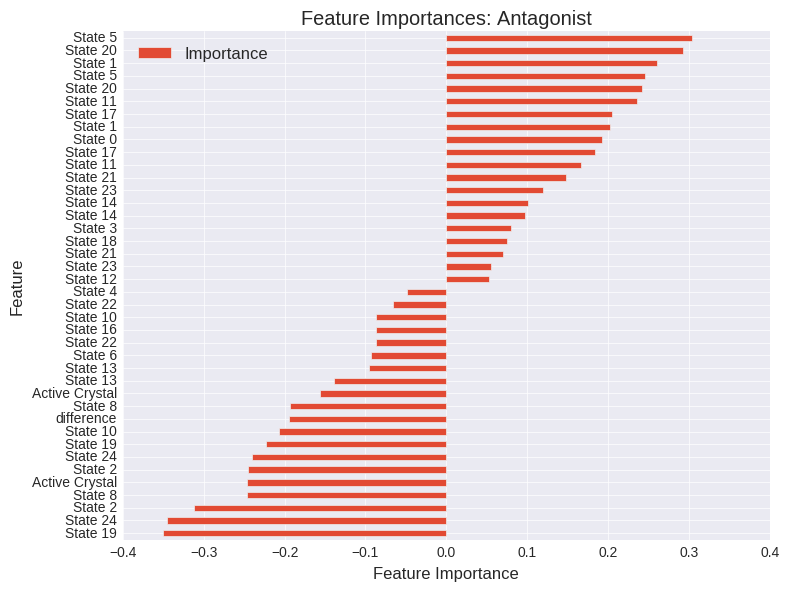

(3, 105)
(3, 105)


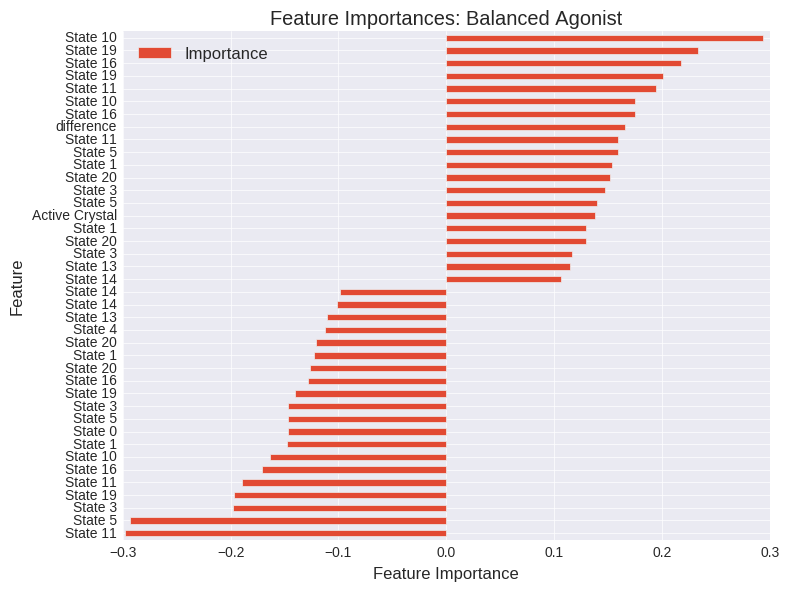

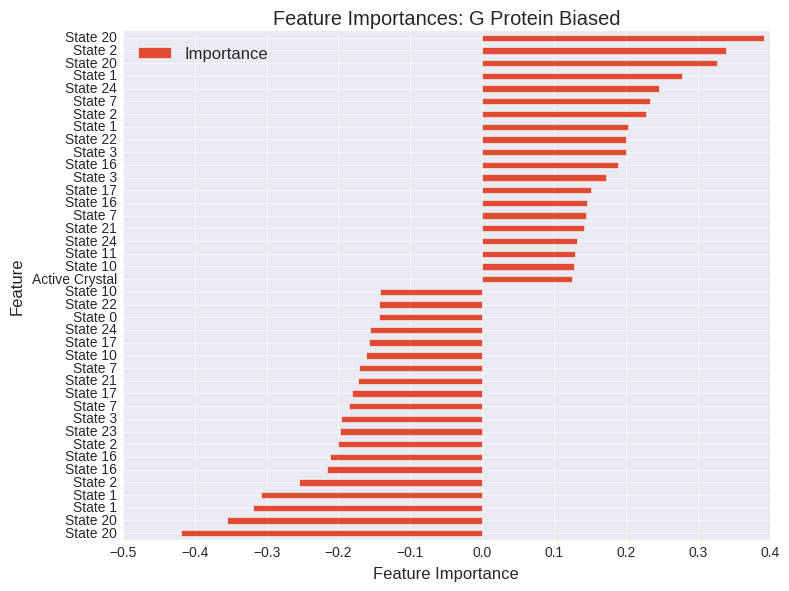

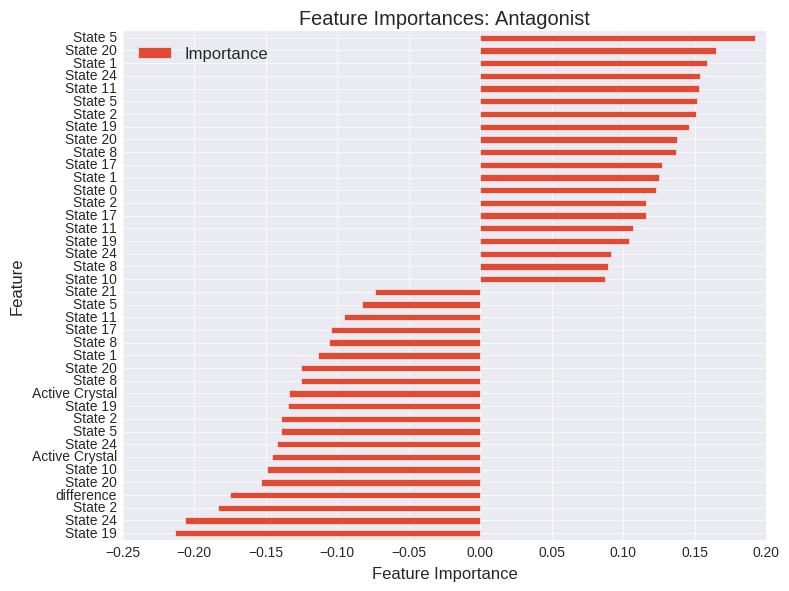

In [425]:
#XP, All ligands, LR three class, 32 stereoisomers; new crystal grids; 25 clusters
import efficacy_scripts
reload(efficacy_scripts)
from efficacy_scripts import *


importance_dfs = analyze_multiclass_experiment(results_dict[save_name], 
                                                                feature_names,
                                                                [f.columns.values.tolist() for f in features], bret.loc[model_agonists]["Abbreviation"], analysis_dir,
                                                                ["Balanced Agonist", "G Protein Biased", "Antagonist"], 
                                                                #["Gs Inactive", "Gs Active"], 
                                                               #["Arr Inactive", "Arr Active"],
                                               np.hstack([X_df.loc[model_agonists].values]),
                                                               #["Gs Inactive", "Gs Partial Active", "Gs Full Active"], 
                                              remake=False, fxn=np.mean, exp_title=save_name)


#TRY LOOCV
#crystal structures might just have bigger boxes


In [422]:
df = importance_dfs['MSM ddG + Crystal Docking'].reset_index().drop_duplicates('index', keep='first').set_index('index').sort("Importance", inplace=False, ascending=False)
df

#df.drop_duplicates(keep='first').sort(["Importance"],inplace=False, ascending=False)

/home/enf/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:1: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  if __name__ == '__main__':


,Importance
index,
difference,0.049572
Active Crystal,0.026974
State 20,0.015245
State 2,0.011647
State 10,0.009451
State 19,0.007757
State 11,0.007621
State 17,0.007324
State 24,0.006861


In [415]:
df.index.drop_duplicates(keep='first')

Index(['State 22', 'State 13', 'State 15', 'State 0', 'State 23', 'State 9',
       'Inactive Crystal', 'State 8', 'State 14', 'State 7', 'State 18',
       'State 12', 'State 16', 'State 5', 'State 21', 'State 4', 'State 6',
       'State 3', 'State 1', 'State 24', 'State 17', 'State 11', 'State 19',
       'State 10', 'State 2', 'State 20', 'Active Crystal', 'difference'],
      dtype='object')

analyzing precision at full recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.653510          0.000000   
(MSM + Crystal) Docking      0.737178          0.083668   
MSM ddG + Crystal Docking    0.724932          0.071422   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.443533115729, 0.524677801548)  
MSM ddG + Crystal Docking   (0.396160540998, 0.47668312811)  


ValueError: list.remove(x): x not in list

analyzing threshold at full recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.311577          0.000000   
(MSM + Crystal) Docking      0.387888          0.076311   
MSM ddG + Crystal Docking    0.383335          0.071758   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.709001330541, 0.779755816326)  
MSM ddG + Crystal Docking  (0.709001330541, 0.779755816326)  


ValueError: list.remove(x): x not in list

analyzing Accuracy:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures             0.6363            0.0000   
(MSM + Crystal) Docking        0.7077            0.0714   
MSM ddG + Crystal Docking      0.7140            0.0777   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking     (0.520306163672, 0.60088971421)  
MSM ddG + Crystal Docking  (0.553506434472, 0.633254426526)  


ValueError: list.remove(x): x not in list

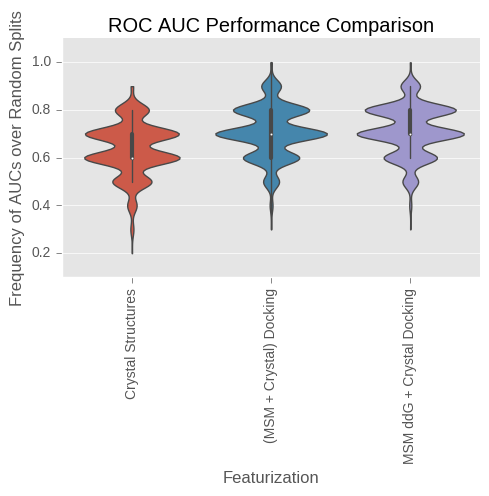

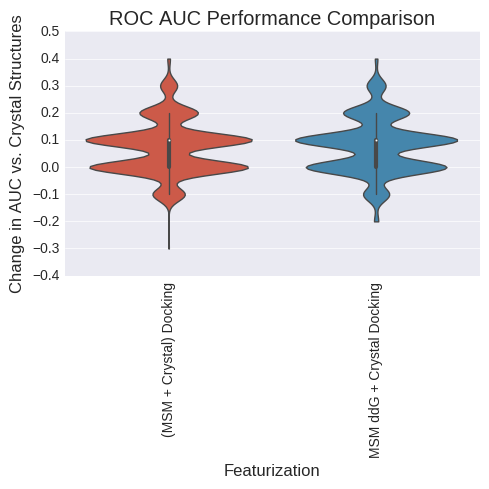

analyzing Recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures            0.72100           0.00000   
(MSM + Crystal) Docking       0.84325           0.12225   
MSM ddG + Crystal Docking     0.83625           0.11525   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking      (0.3677236316, 0.447502325072)  
MSM ddG + Crystal Docking  (0.357950733106, 0.437407046864)  


ValueError: list.remove(x): x not in list

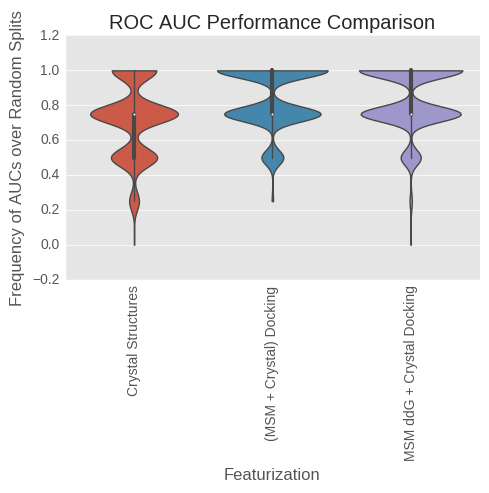

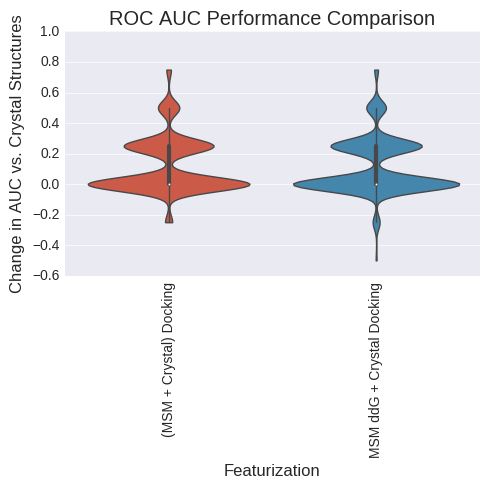

analyzing precision:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.620443          0.000000   
(MSM + Crystal) Docking      0.706513          0.086071   
MSM ddG + Crystal Docking    0.697742          0.077299   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.521309567967, 0.601873127585)  
MSM ddG + Crystal Docking  (0.513286945506, 0.594001208684)  


ValueError: list.remove(x): x not in list

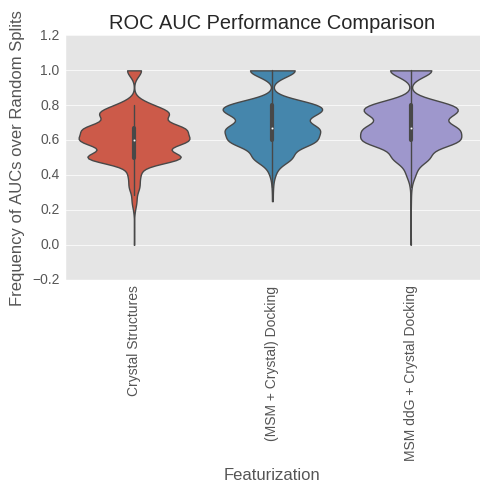

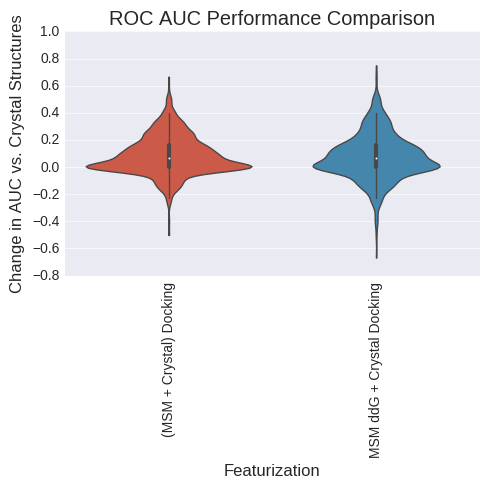

analyzing fdr:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.379557          0.000000   
(MSM + Crystal) Docking      0.293487         -0.086071   
MSM ddG + Crystal Docking    0.302258         -0.077299   

                                            Sign Test 99% CI  
Crystal Structures                                  (0, 0.0)  
(MSM + Crystal) Docking    (0.0888266306778, 0.140288113287)  
MSM ddG + Crystal Docking   (0.153628038128, 0.216550760421)  


ValueError: list.remove(x): x not in list

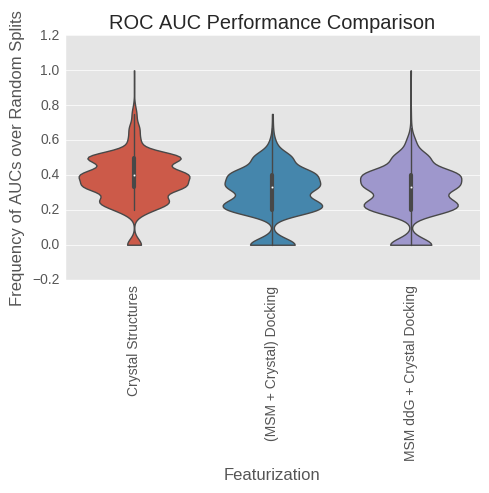

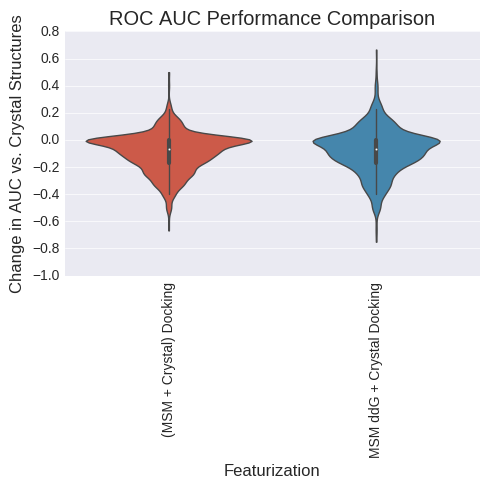

analyzing Recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures             0.6363            0.0000   
(MSM + Crystal) Docking        0.7077            0.0714   
MSM ddG + Crystal Docking      0.7140            0.0777   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking     (0.520306163672, 0.60088971421)  
MSM ddG + Crystal Docking  (0.553506434472, 0.633254426526)  


ValueError: list.remove(x): x not in list

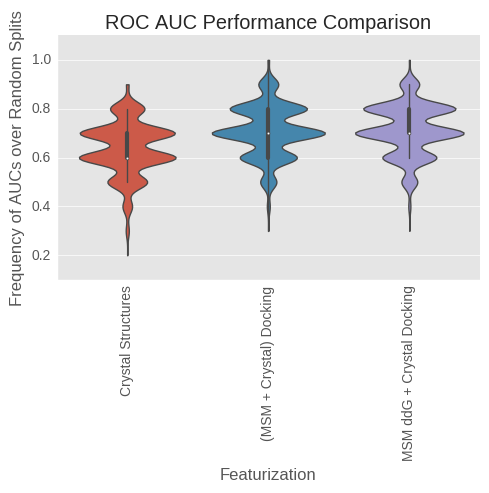

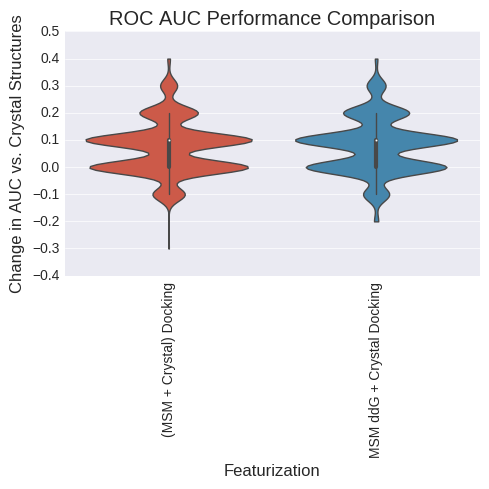

analyzing precision:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.592611          0.000000   
(MSM + Crystal) Docking      0.646036          0.053425   
MSM ddG + Crystal Docking    0.649330          0.056719   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.485290191581, 0.566367067844)  
MSM ddG + Crystal Docking  (0.527333464647, 0.607770136927)  


ValueError: list.remove(x): x not in list

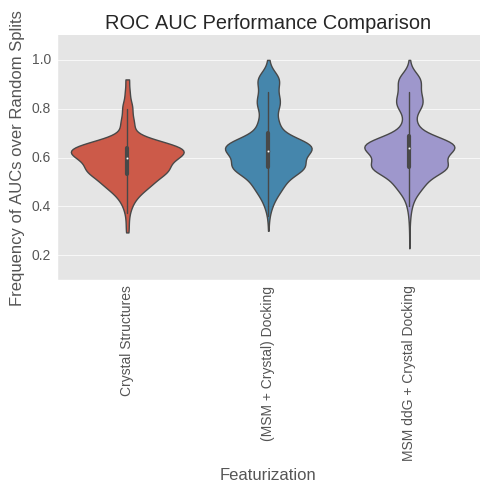

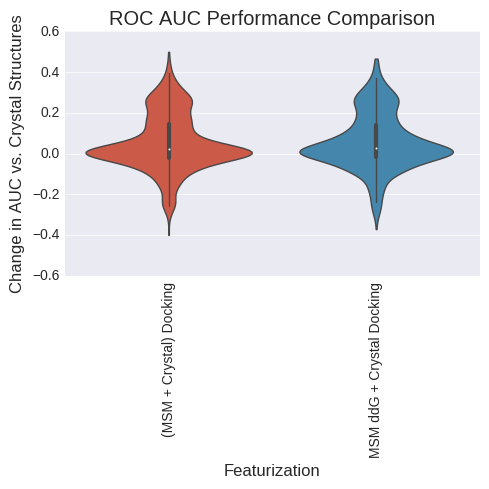

analyzing fdr:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.407389          0.000000   
(MSM + Crystal) Docking      0.353964         -0.053425   
MSM ddG + Crystal Docking    0.350670         -0.056719   

                                          Sign Test 99% CI  
Crystal Structures                                (0, 0.0)  
(MSM + Crystal) Docking    (0.22688525018, 0.298265326644)  
MSM ddG + Crystal Docking  (0.23544081358, 0.307591122276)  


ValueError: list.remove(x): x not in list

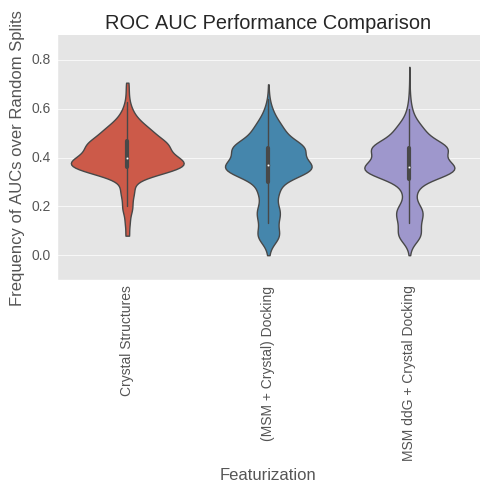

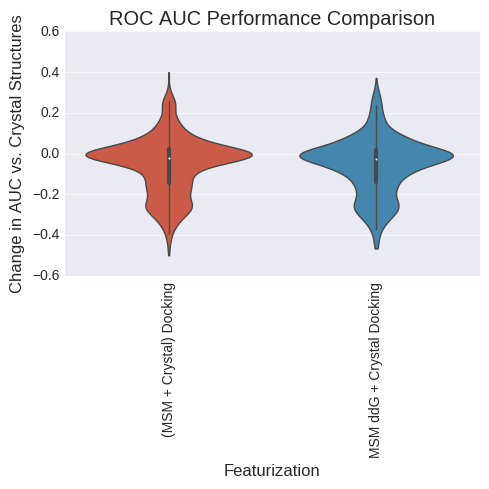

analyzing class B ROC AUC:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.781729          0.000000   
(MSM + Crystal) Docking      0.869812          0.088083   
MSM ddG + Crystal Docking    0.868354          0.086625   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking     (0.694479647115, 0.76646205237)  
MSM ddG + Crystal Docking  (0.667629625978, 0.741654814082)  


ValueError: list.remove(x): x not in list

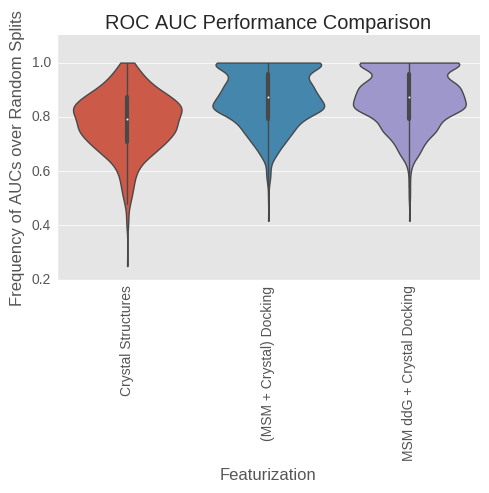

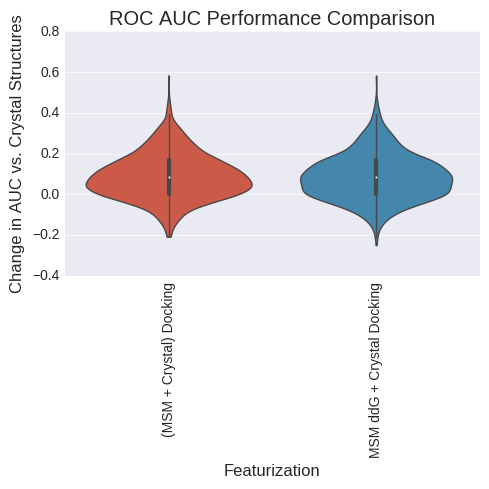

analyzing ROC AUC:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.761910          0.000000   
(MSM + Crystal) Docking      0.849045          0.087135   
MSM ddG + Crystal Docking    0.858424          0.096514   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking      (0.800445284674, 0.8611649995)  
MSM ddG + Crystal Docking  (0.831511478554, 0.887716518056)  


ValueError: list.remove(x): x not in list

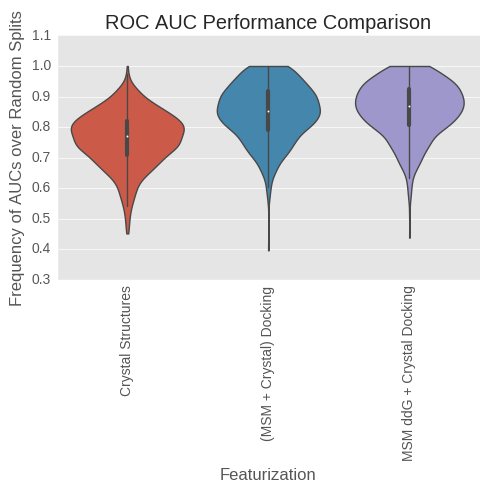

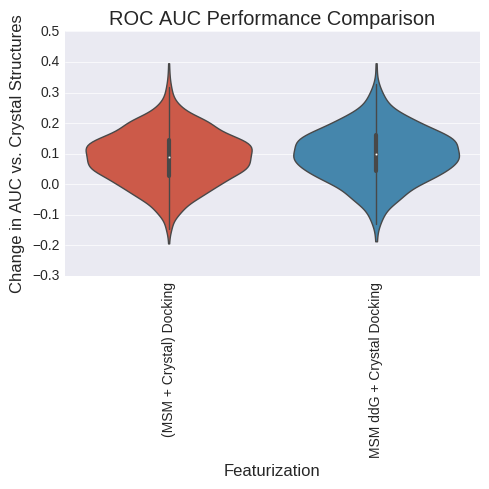

analyzing BedROC
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.656712          0.000000   
(MSM + Crystal) Docking      0.752374          0.095662   
MSM ddG + Crystal Docking    0.791527          0.134816   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.639899267953, 0.715741095012)  
MSM ddG + Crystal Docking  (0.625578014931, 0.702246900651)  


ValueError: list.remove(x): x not in list

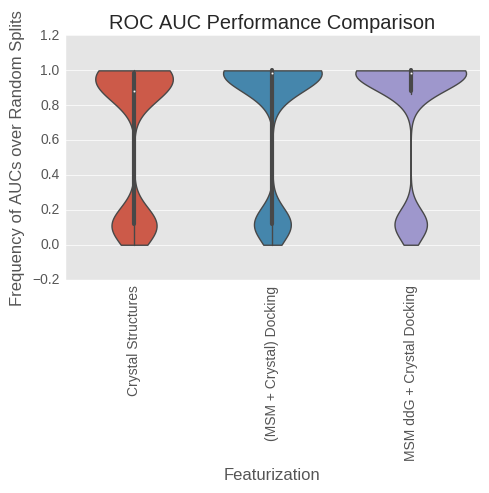

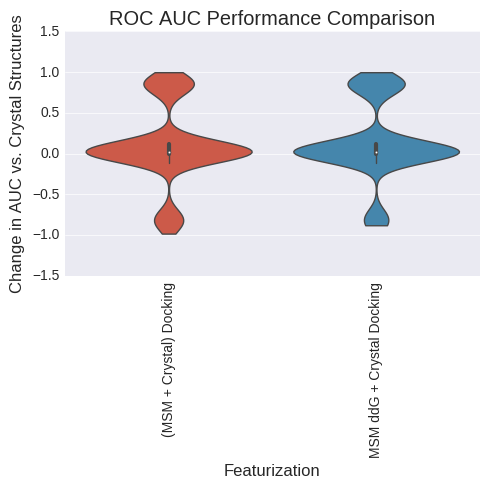

analyzing LogAUC
(1000, 0)
/n
(3,)
(1, 3)


/vspdata/vspcompute/home/enf/b2ar_analysis/conformation/efficacy_scripts.py:1631: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  inplace=False)


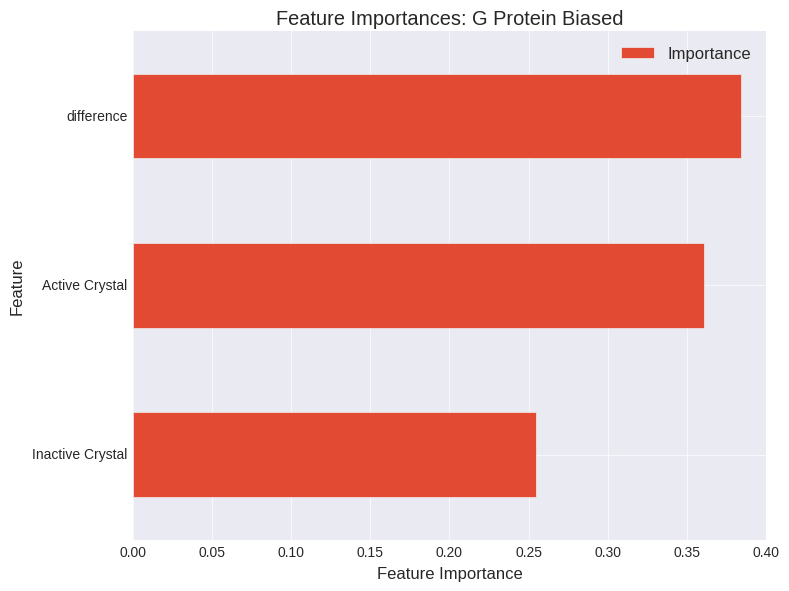

(55,)
(1, 55)


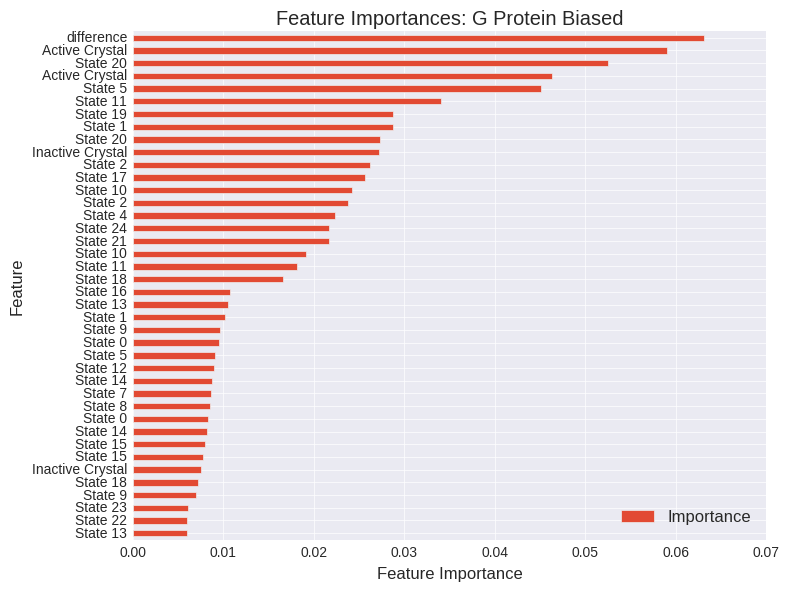

(105,)
(1, 105)


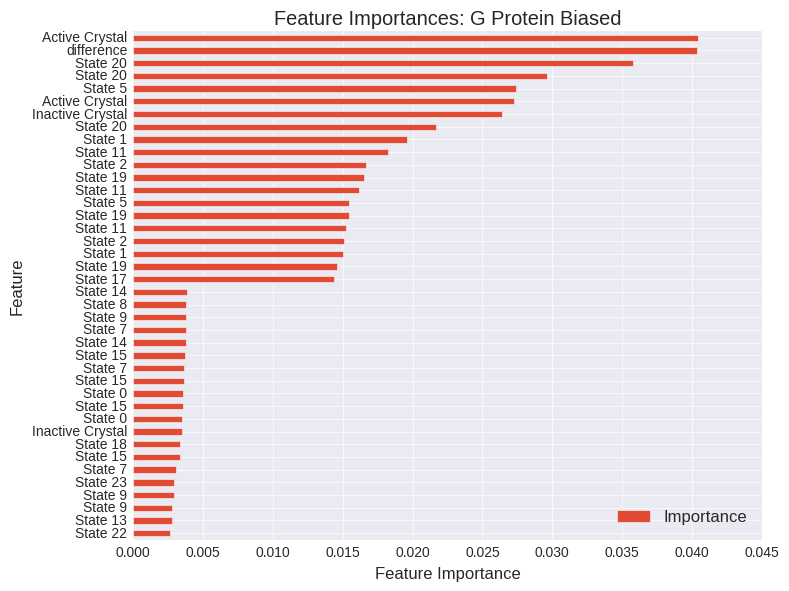

In [343]:
#SP, All ligands, RFR three class, 32 stereoisomers; new crystal grids; 25 clusters; with salmeterol
import efficacy_scripts
reload(efficacy_scripts)
from efficacy_scripts import *


importance_dfs = analyze_multiclass_experiment(results_dict[save_name], 
                                                                feature_names,
                                                                [f.columns.values.tolist() for f in features], bret.loc[model_agonists]["Abbreviation"], analysis_dir,
                                                                ["Balanced Agonist", "G Protein Biased", "Antagonist"], 
                                                                #["Gs Inactive", "Gs Active"], 
                                                               #["Arr Inactive", "Arr Active"],
                                               np.hstack([X_df.loc[model_agonists].values]),
                                                               #["Gs Inactive", "Gs Partial Active", "Gs Full Active"], 
                                              remake=False, fxn=np.mean)


#TRY LOOCV
#crystal structures might just have bigger boxes



analyzing precision at full recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.658018          0.000000   
(MSM + Crystal) Docking      0.775429          0.117411   
MSM ddG + Crystal Docking    0.770764          0.112746   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.490280258729, 0.571311089047)  
MSM ddG + Crystal Docking  (0.486287880891, 0.567356196204)  


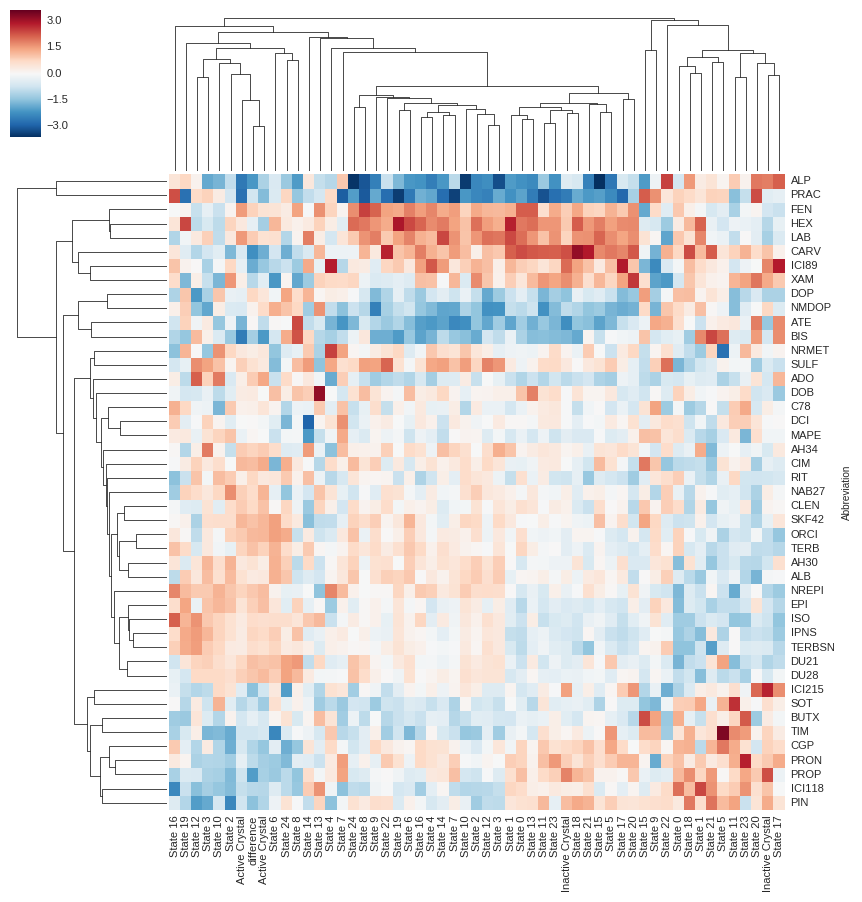

ValueError: list.remove(x): x not in list

analyzing threshold at full recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.444531          0.000000   
(MSM + Crystal) Docking      0.490582          0.046051   
MSM ddG + Crystal Docking    0.471548          0.027017   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.606201881764, 0.683873498084)  
MSM ddG + Crystal Docking   (0.57979454465, 0.658623575774)  


ValueError: list.remove(x): x not in list

analyzing Accuracy:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.649444          0.000000   
(MSM + Crystal) Docking      0.703778          0.054333   
MSM ddG + Crystal Docking    0.721556          0.072111   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking     (0.39419487087, 0.474675162898)  
MSM ddG + Crystal Docking  (0.498272805682, 0.579213083456)  


ValueError: list.remove(x): x not in list

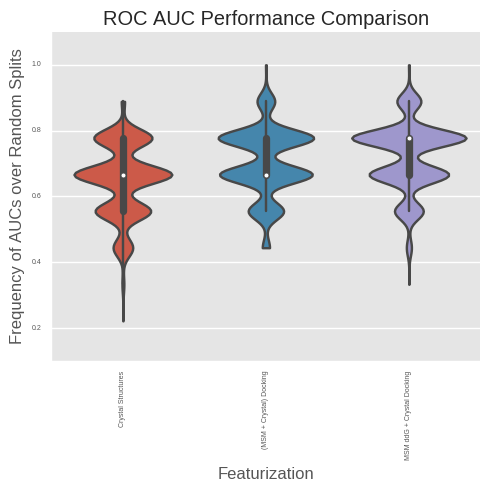

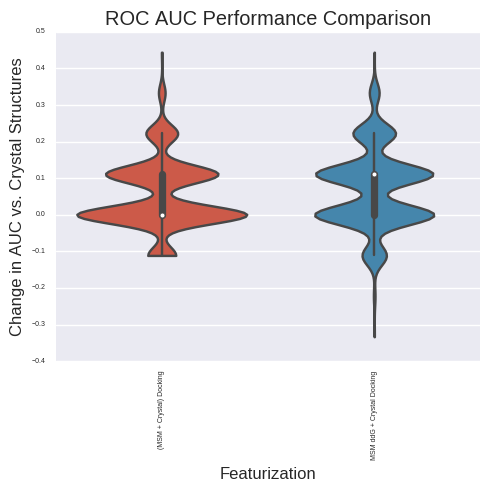

analyzing Recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.783333          0.000000   
(MSM + Crystal) Docking      0.899667          0.116333   
MSM ddG + Crystal Docking    0.901667          0.118333   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.285221505133, 0.361124949573)  
MSM ddG + Crystal Docking  (0.294858285184, 0.371356346223)  


ValueError: list.remove(x): x not in list

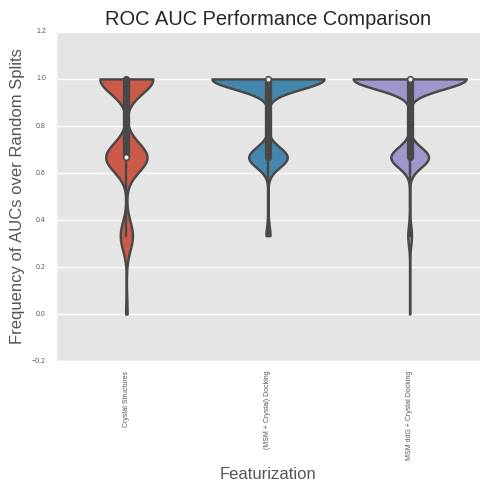

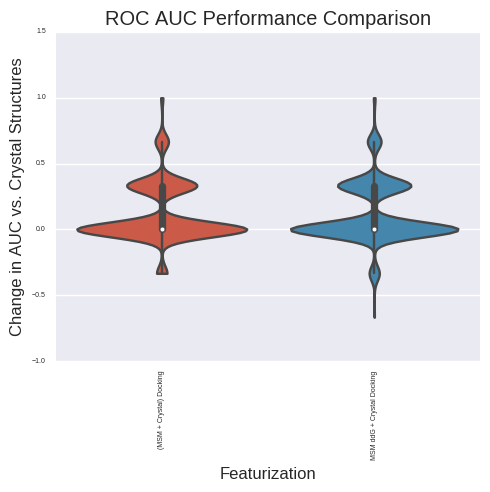

analyzing precision:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.579252           0.00000   
(MSM + Crystal) Docking      0.653843           0.07459   
MSM ddG + Crystal Docking    0.663862           0.08461   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.404029824485, 0.484708385984)  
MSM ddG + Crystal Docking   (0.50227298352, 0.583160176298)  


ValueError: list.remove(x): x not in list

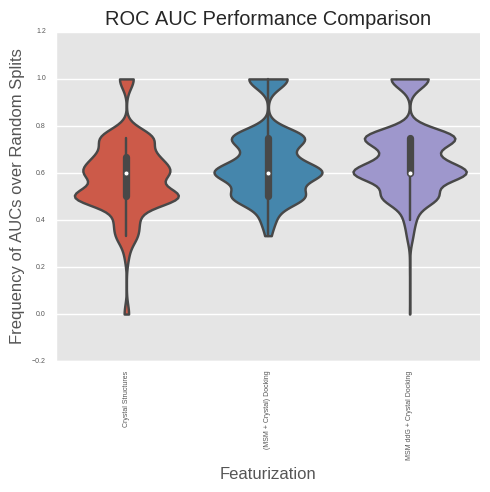

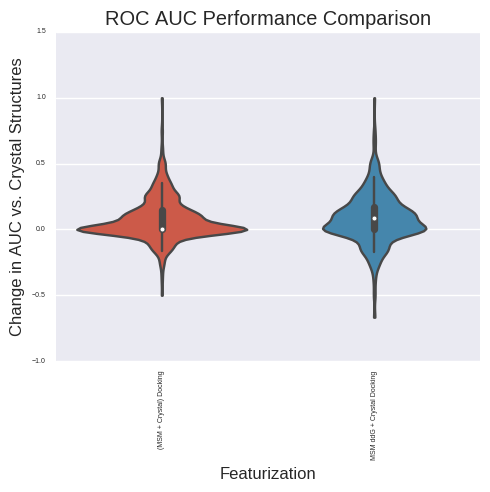

analyzing fdr:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.420748           0.00000   
(MSM + Crystal) Docking      0.346157          -0.07459   
MSM ddG + Crystal Docking    0.336138          -0.08461   

                                            Sign Test 99% CI  
Crystal Structures                                  (0, 0.0)  
(MSM + Crystal) Docking    (0.0897216203161, 0.141379941319)  
MSM ddG + Crystal Docking   (0.137913603134, 0.198489295022)  


ValueError: list.remove(x): x not in list

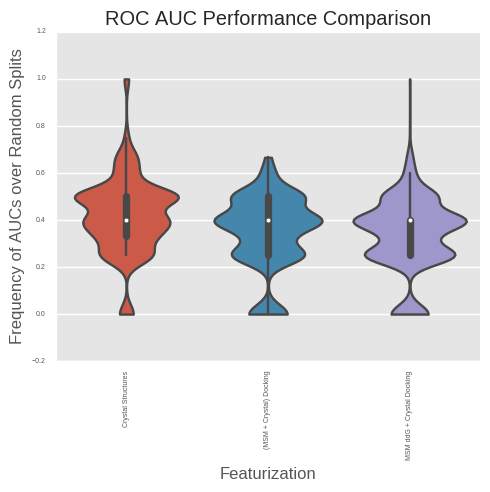

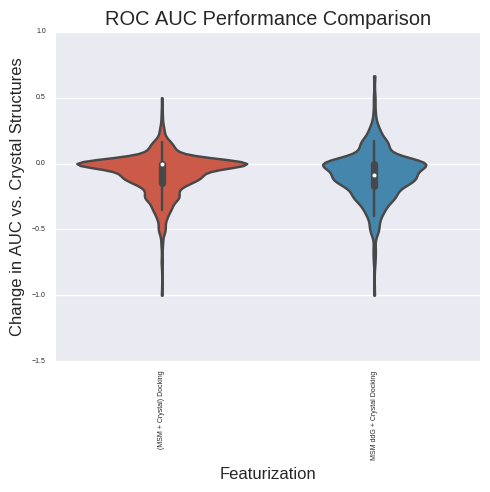

analyzing Recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.649444          0.000000   
(MSM + Crystal) Docking      0.703778          0.054333   
MSM ddG + Crystal Docking    0.721556          0.072111   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking     (0.39419487087, 0.474675162898)  
MSM ddG + Crystal Docking  (0.498272805682, 0.579213083456)  


ValueError: list.remove(x): x not in list

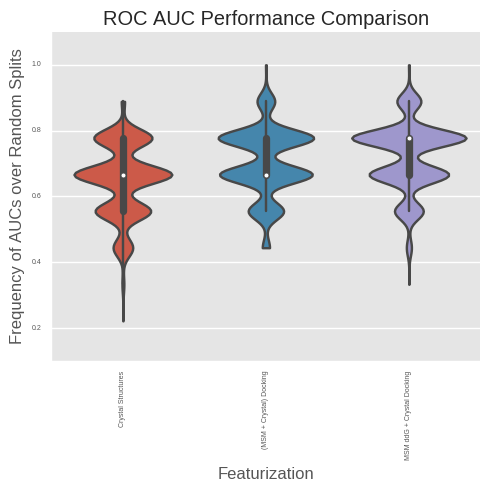

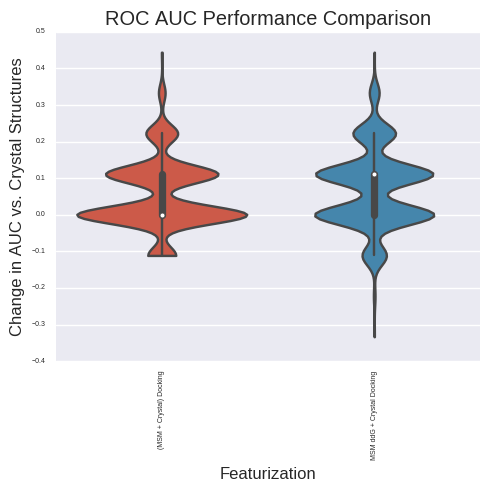

analyzing precision:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.585406          0.000000   
(MSM + Crystal) Docking      0.635163          0.049757   
MSM ddG + Crystal Docking    0.646546          0.061139   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.405998791316, 0.486713054494)  
MSM ddG + Crystal Docking  (0.543426465795, 0.623466218501)  


ValueError: list.remove(x): x not in list

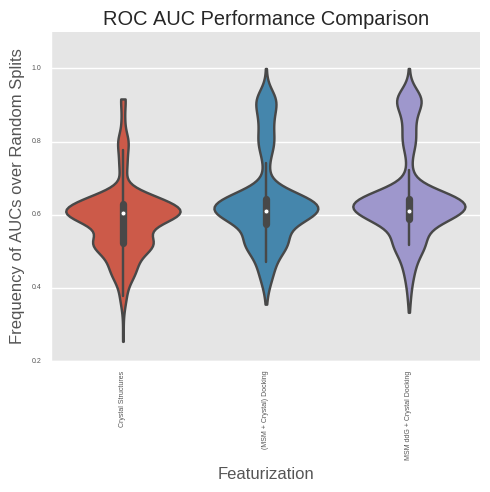

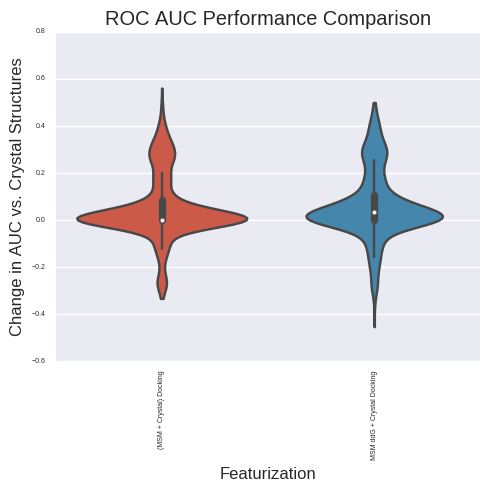

analyzing fdr:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.414594          0.000000   
(MSM + Crystal) Docking      0.364837         -0.049757   
MSM ddG + Crystal Docking    0.353454         -0.061139   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.127804498547, 0.186743405236)  
MSM ddG + Crystal Docking  (0.154555645965, 0.217609970254)  


ValueError: list.remove(x): x not in list

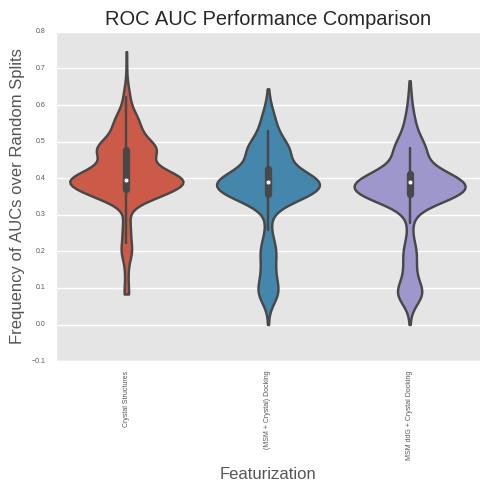

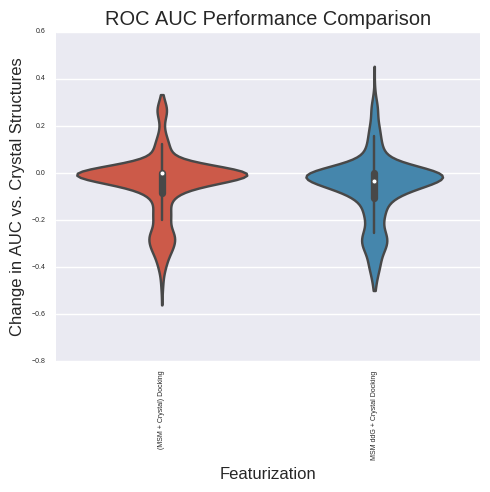

analyzing class B ROC AUC:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.810972          0.000000   
(MSM + Crystal) Docking      0.891722          0.080750   
MSM ddG + Crystal Docking    0.894028          0.083056   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.629665918438, 0.706106267824)  
MSM ddG + Crystal Docking  (0.640923683338, 0.716703497297)  


ValueError: list.remove(x): x not in list

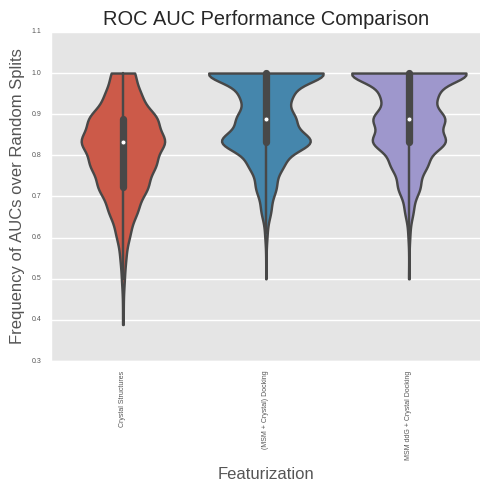

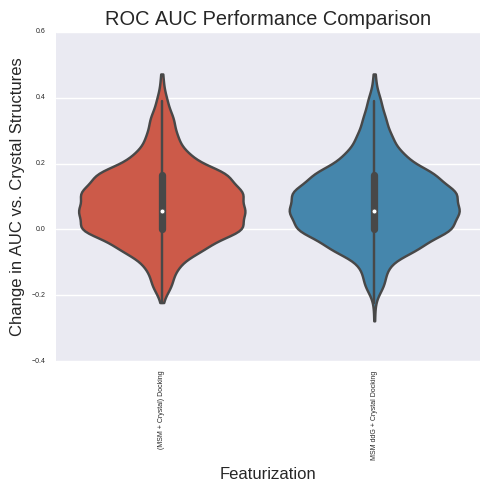

analyzing ROC AUC:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.778938          0.000000   
(MSM + Crystal) Docking      0.860942          0.082004   
MSM ddG + Crystal Docking    0.870058          0.091120   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.769705776421, 0.834286795318)  
MSM ddG + Crystal Docking  (0.803642713348, 0.863928023837)  


ValueError: list.remove(x): x not in list

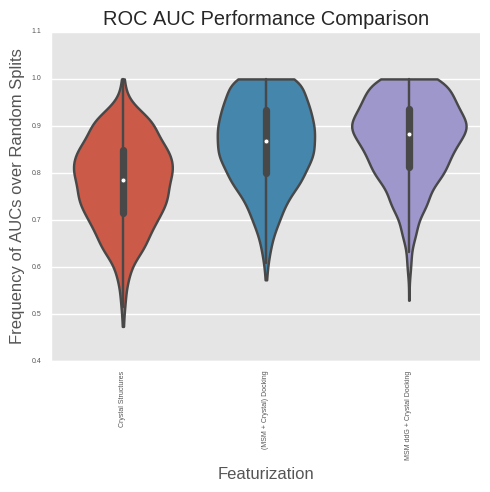

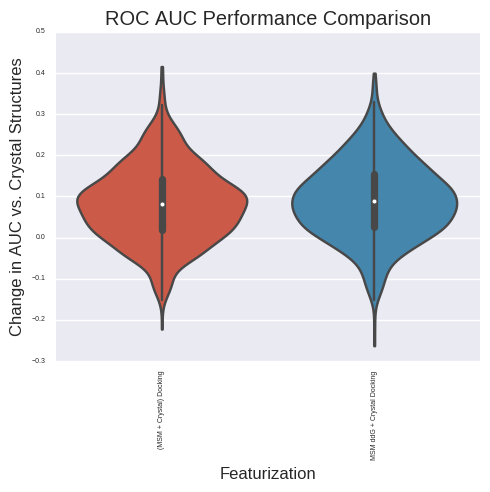

analyzing BedROC
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.573796          0.000000   
(MSM + Crystal) Docking      0.707247          0.133451   
MSM ddG + Crystal Docking    0.755230          0.181434   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking     (0.57979454465, 0.658623575774)  
MSM ddG + Crystal Docking  (0.591967436599, 0.670292495867)  


ValueError: list.remove(x): x not in list

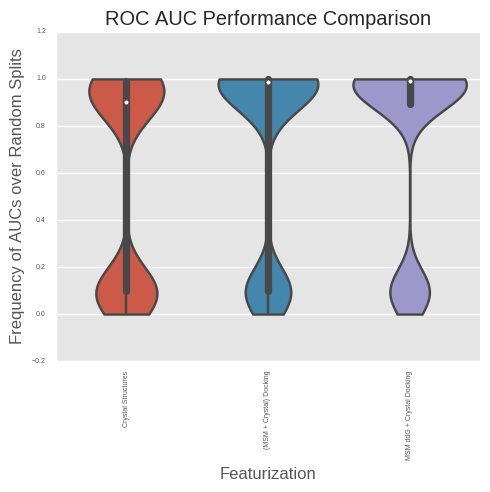

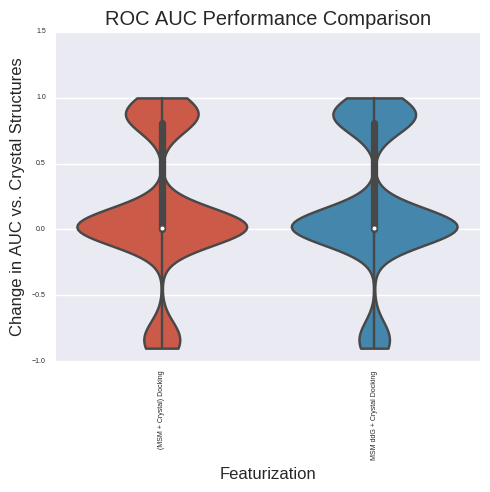

analyzing LogAUC
(1000, 0)
/n
(3,)
(1, 3)


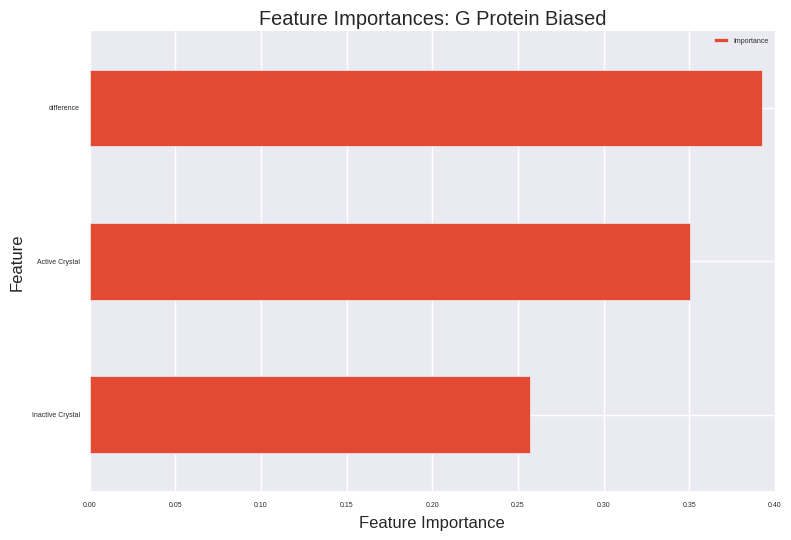

(55,)
(1, 55)


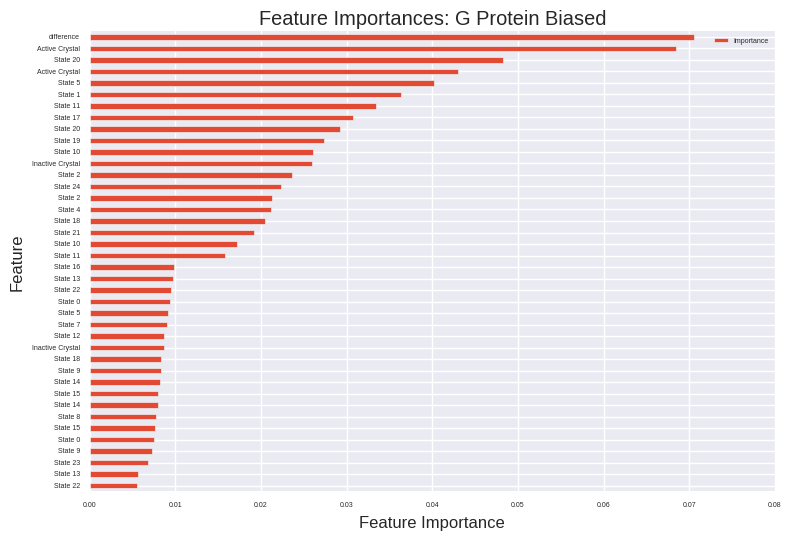

(105,)
(1, 105)


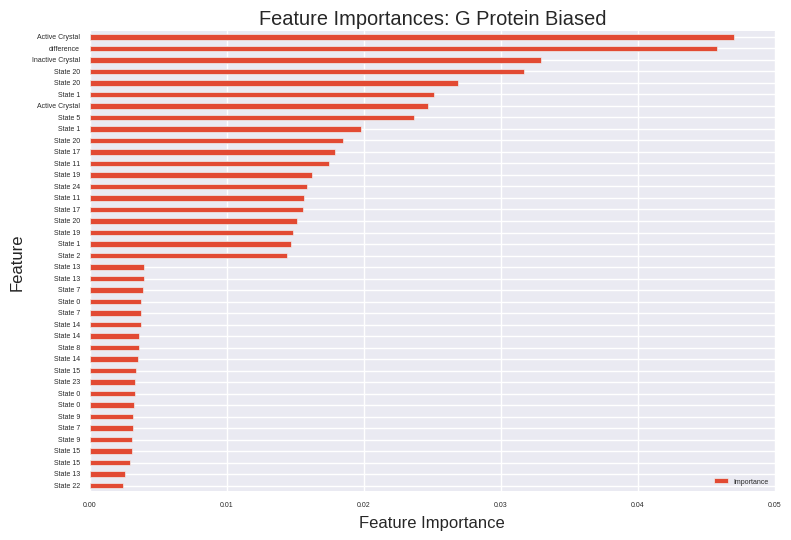

In [294]:
#XP, All ligands, RFR three class, 32 stereoisomers; new crystal grids; 25 clusters
import efficacy_scripts
reload(efficacy_scripts)
from efficacy_scripts import *


importance_dfs = analyze_multiclass_experiment(results_dict[save_name], 
                                                                feature_names,
                                                                [f.columns.values.tolist() for f in features], bret.loc[model_agonists]["Abbreviation"], analysis_dir,
                                                                ["Balanced Agonist", "G Protein Biased", "Antagonist"], 
                                                                #["Gs Inactive", "Gs Active"], 
                                                               #["Arr Inactive", "Arr Active"],
                                               np.hstack([X_df.loc[model_agonists].values]),
                                                               #["Gs Inactive", "Gs Partial Active", "Gs Full Active"], 
                                              remake=True, fxn=np.mean)


#TRY LOOCV
#crystal structures might just have bigger boxes


analyzing precision at full recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.665821          0.000000   
(MSM + Crystal) Docking      0.734712          0.068890   
MSM ddG + Crystal Docking    0.752515          0.086694   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.357950733106, 0.437407046864)  
MSM ddG + Crystal Docking  (0.422761439934, 0.503726306269)  


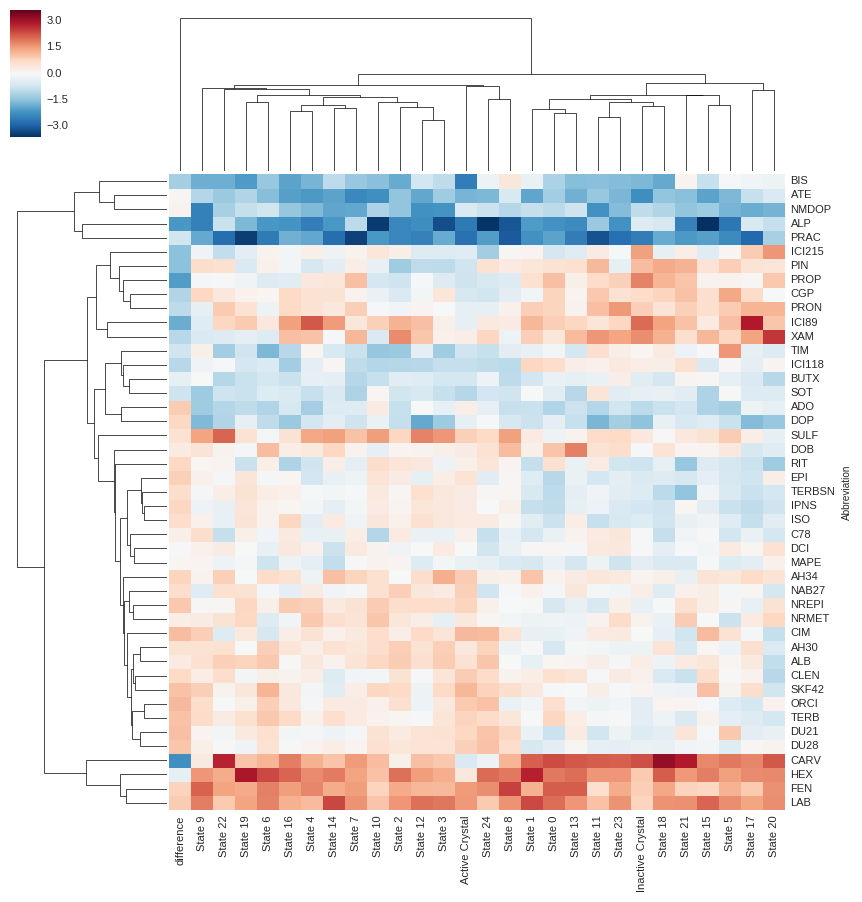

ValueError: list.remove(x): x not in list

analyzing threshold at full recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.446967          0.000000   
(MSM + Crystal) Docking      0.450629          0.003662   
MSM ddG + Crystal Docking    0.449769          0.002802   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.514289197634, 0.594985774227)  
MSM ddG + Crystal Docking  (0.466364819143, 0.547542904548)  


ValueError: list.remove(x): x not in list

analyzing Accuracy:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.653778          0.000000   
(MSM + Crystal) Docking      0.674444          0.020667   
MSM ddG + Crystal Docking    0.715222          0.061444   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.269843926991, 0.344713444992)  
MSM ddG + Crystal Docking  (0.450472858943, 0.531645782025)  


ValueError: list.remove(x): x not in list

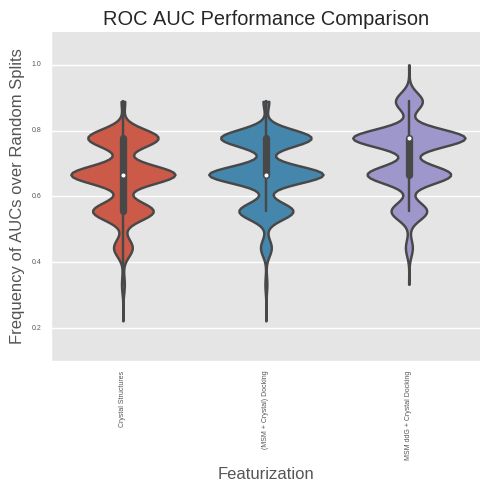

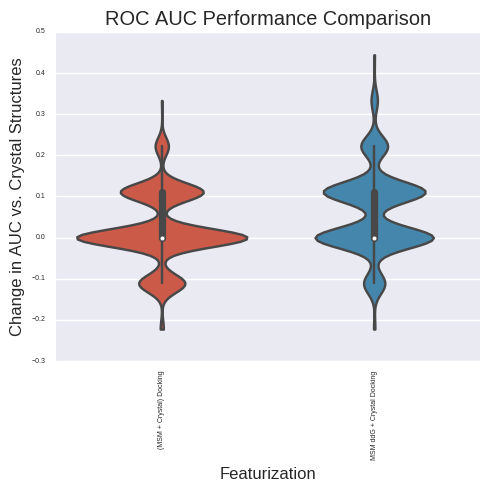

analyzing Recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.797000          0.000000   
(MSM + Crystal) Docking      0.850333          0.053333   
MSM ddG + Crystal Docking    0.876667          0.079667   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.216454629457, 0.286840952995)  
MSM ddG + Crystal Docking  (0.225935807277, 0.297227951877)  


ValueError: list.remove(x): x not in list

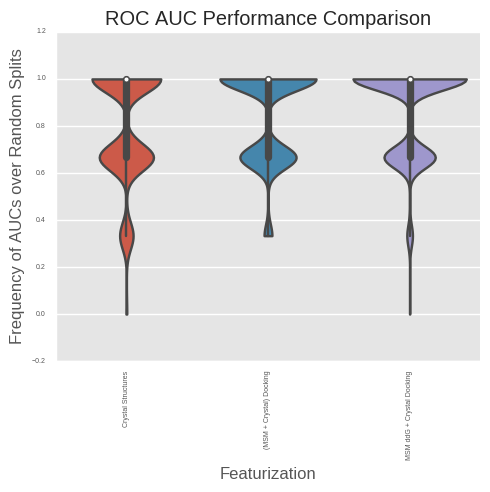

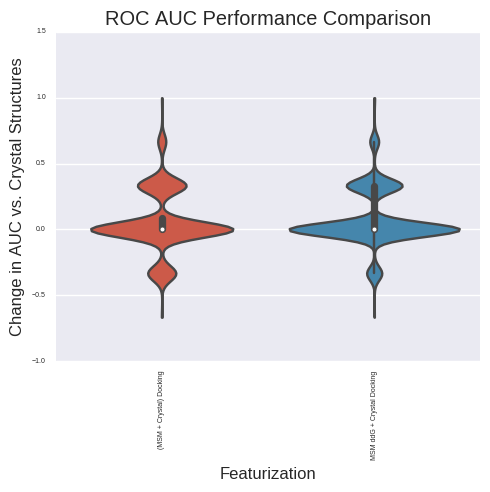

analyzing precision:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.594267          0.000000   
(MSM + Crystal) Docking      0.633576          0.039310   
MSM ddG + Crystal Docking    0.677277          0.083011   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.318064456295, 0.395833799198)  
MSM ddG + Crystal Docking  (0.456427504571, 0.537612042418)  


ValueError: list.remove(x): x not in list

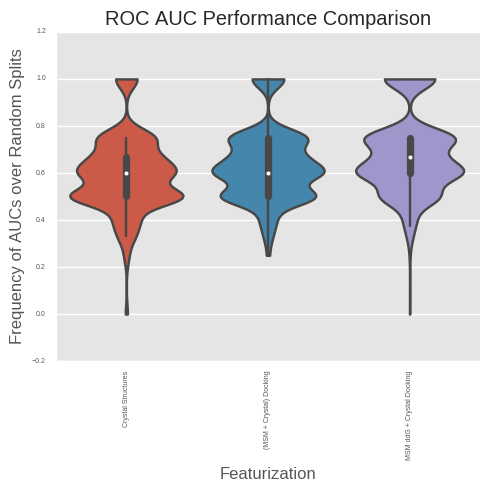

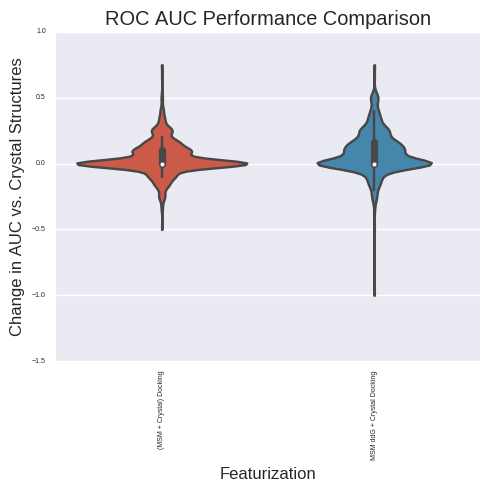

analyzing fdr:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.405733          0.000000   
(MSM + Crystal) Docking      0.366424         -0.039310   
MSM ddG + Crystal Docking    0.322723         -0.083011   

                                            Sign Test 99% CI  
Crystal Structures                                  (0, 0.0)  
(MSM + Crystal) Docking      (0.12048424366, 0.178169118762)  
MSM ddG + Crystal Docking  (0.0790252528016, 0.128234496791)  


ValueError: list.remove(x): x not in list

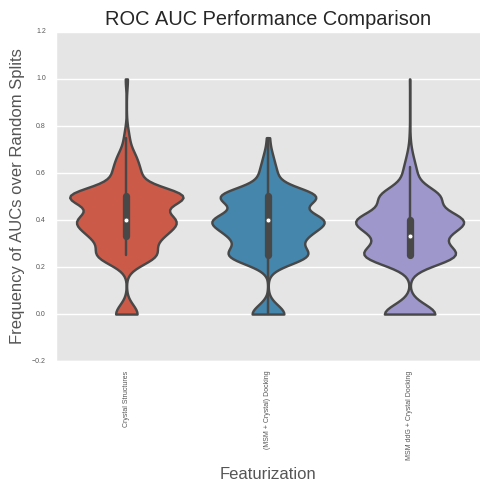

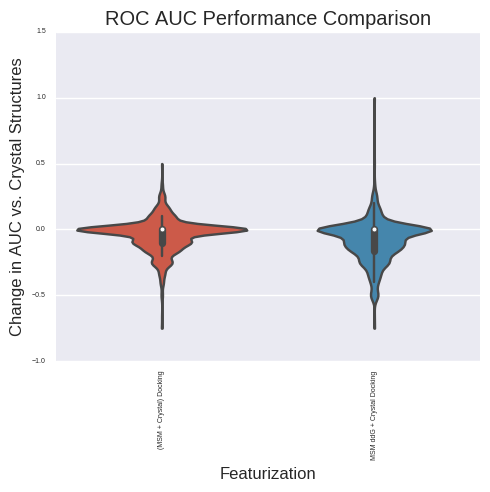

analyzing Recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.653778          0.000000   
(MSM + Crystal) Docking      0.674444          0.020667   
MSM ddG + Crystal Docking    0.715222          0.061444   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.269843926991, 0.344713444992)  
MSM ddG + Crystal Docking  (0.450472858943, 0.531645782025)  


ValueError: list.remove(x): x not in list

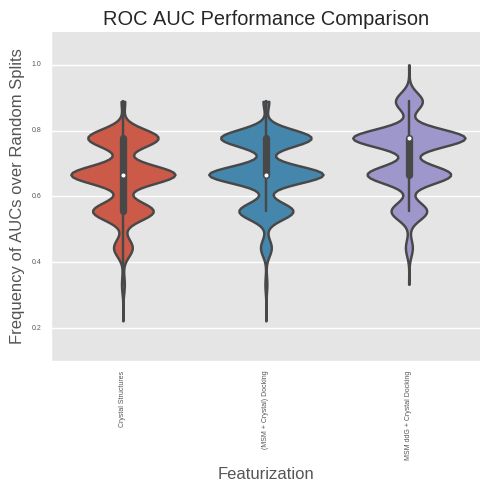

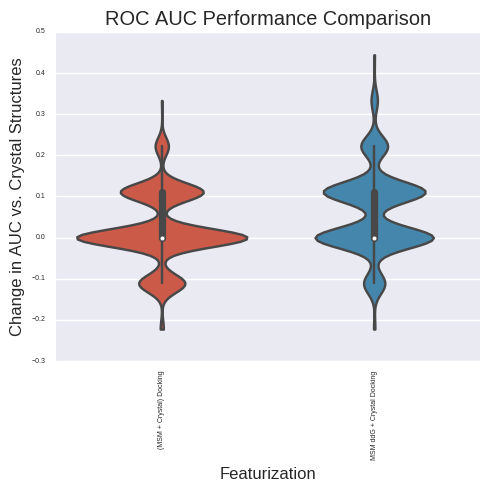

analyzing precision:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.590450          0.000000   
(MSM + Crystal) Docking      0.597782          0.007332   
MSM ddG + Crystal Docking    0.644451          0.054001   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.282334298764, 0.358051702931)  
MSM ddG + Crystal Docking  (0.452457095452, 0.533635180857)  


ValueError: list.remove(x): x not in list

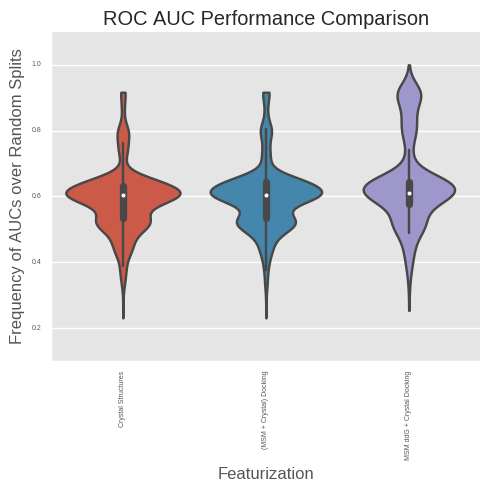

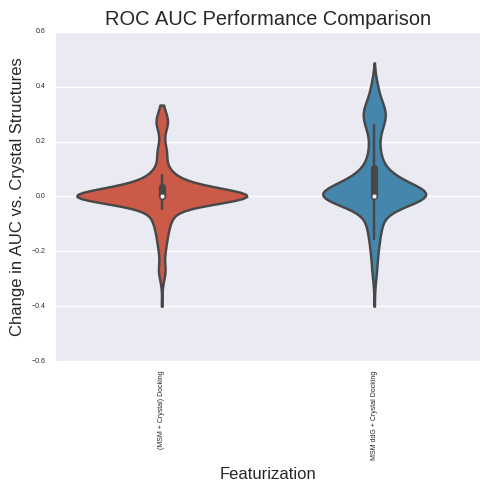

analyzing fdr:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.409550          0.000000   
(MSM + Crystal) Docking      0.402218         -0.007332   
MSM ddG + Crystal Docking    0.355549         -0.054001   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking     (0.19850946321, 0.267036583508)  
MSM ddG + Crystal Docking  (0.170375998288, 0.235565518324)  


ValueError: list.remove(x): x not in list

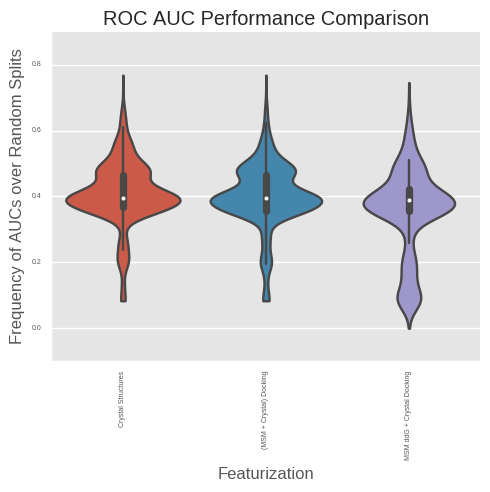

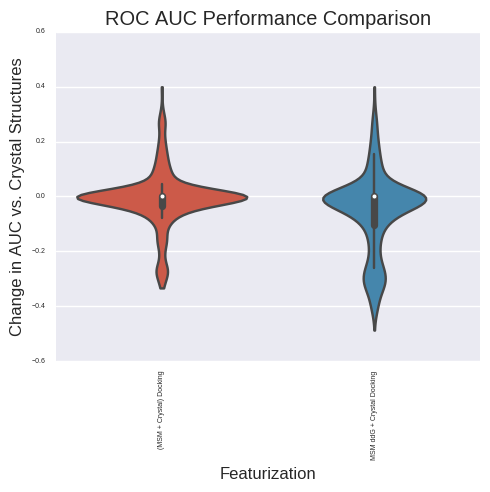

analyzing class B ROC AUC:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.811139          0.000000   
(MSM + Crystal) Docking      0.867750          0.056611   
MSM ddG + Crystal Docking    0.878417          0.067278   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking     (0.55653373502, 0.636187578989)  
MSM ddG + Crystal Docking  (0.588921808438, 0.667377671017)  


ValueError: list.remove(x): x not in list

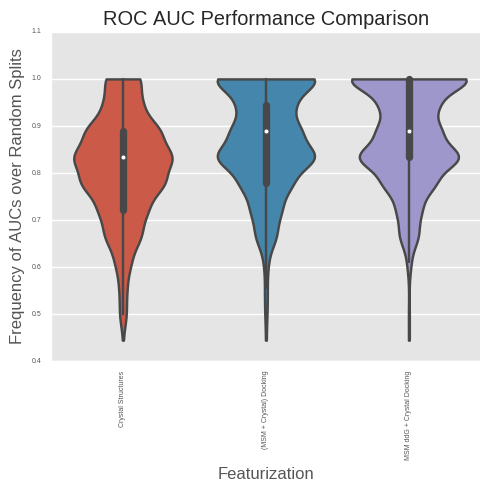

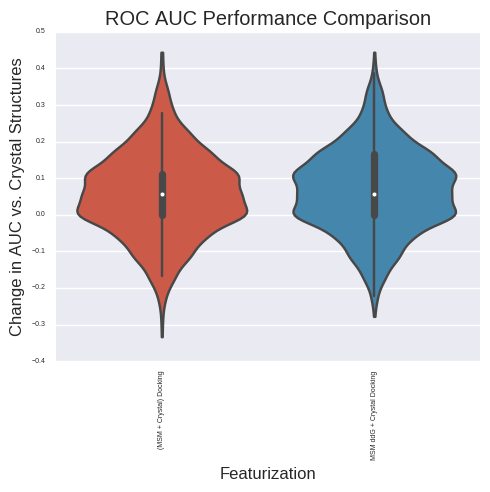

analyzing ROC AUC:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.776032          0.000000   
(MSM + Crystal) Docking      0.811714          0.035682   
MSM ddG + Crystal Docking    0.852906          0.076874   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.604166200802, 0.681935543705)  
MSM ddG + Crystal Docking  (0.754965641835, 0.821211482521)  


ValueError: list.remove(x): x not in list

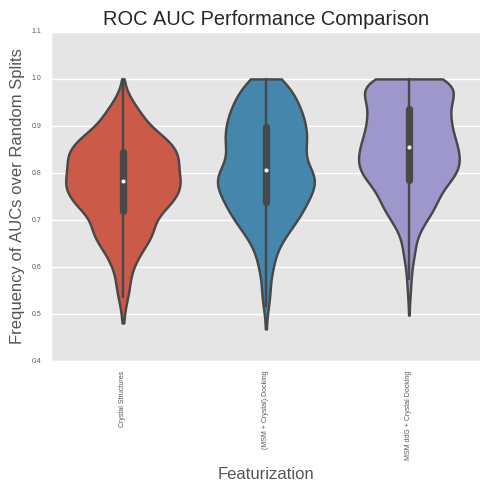

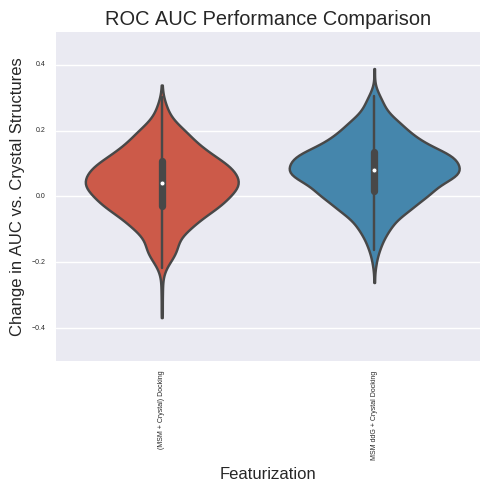

analyzing BedROC
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.560119          0.000000   
(MSM + Crystal) Docking      0.654667          0.094549   
MSM ddG + Crystal Docking    0.669717          0.109598   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.627621581926, 0.704176968996)  
MSM ddG + Crystal Docking   (0.548464334717, 0.62836243793)  


ValueError: list.remove(x): x not in list

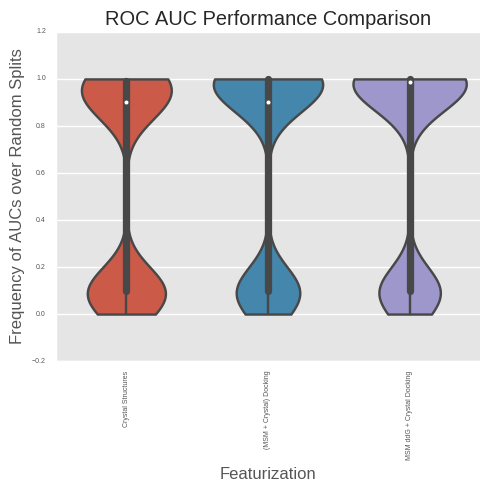

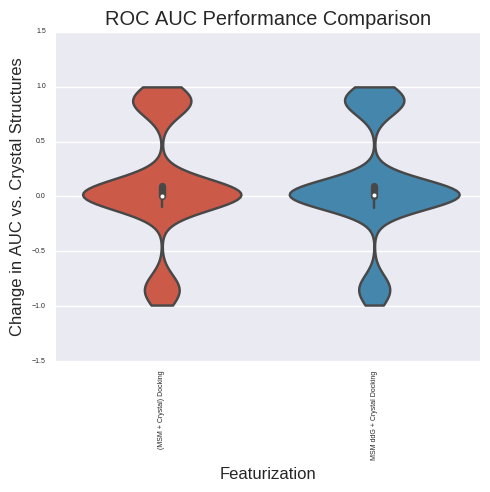

analyzing LogAUC
(1000, 0)
/n
(3,)
(1, 3)


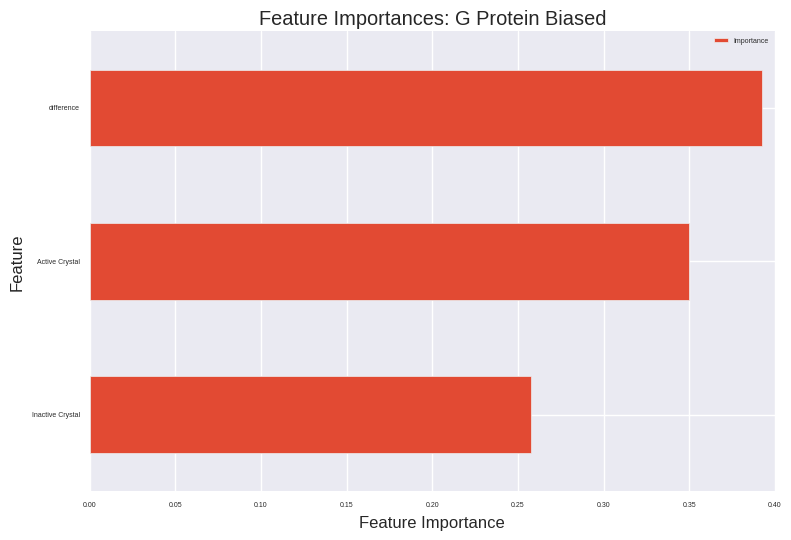

(28,)
(1, 28)


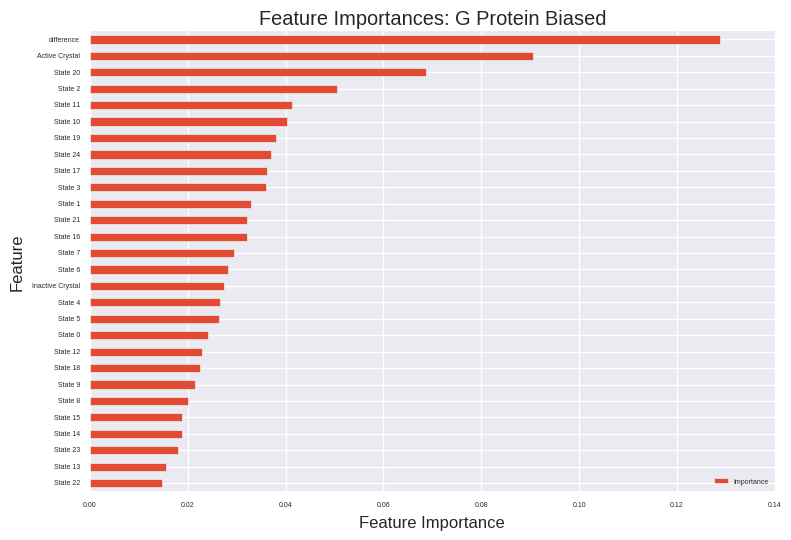

(53,)
(1, 53)


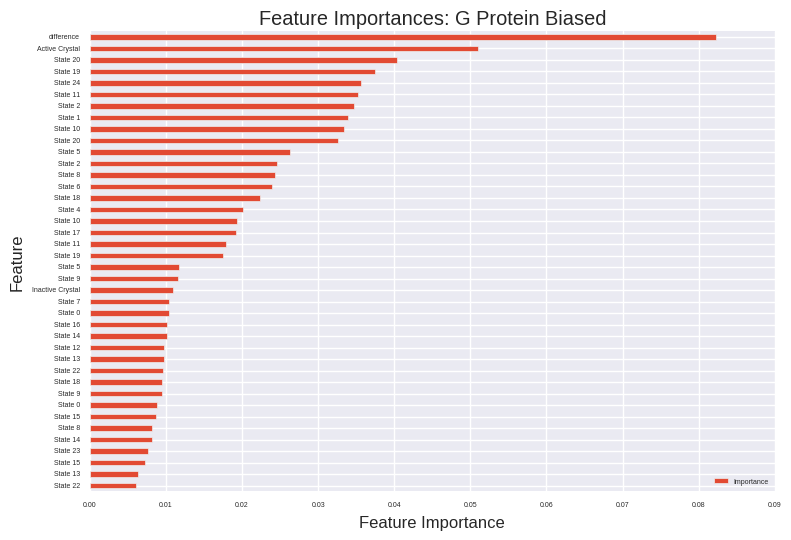

In [316]:
#XP, All ligands, RFR three class, 32 stereoisomers; new crystal grids; 25 clusters; no norm
import efficacy_scripts
reload(efficacy_scripts)
from efficacy_scripts import *


importance_dfs = analyze_multiclass_experiment(results_dict[save_name], 
                                                                feature_names,
                                                                [f.columns.values.tolist() for f in features], bret.loc[model_agonists]["Abbreviation"], analysis_dir,
                                                                ["Balanced Agonist", "G Protein Biased", "Antagonist"], 
                                                                #["Gs Inactive", "Gs Active"], 
                                                               #["Arr Inactive", "Arr Active"],
                                               np.hstack([X_df.loc[model_agonists].values]),
                                                               #["Gs Inactive", "Gs Partial Active", "Gs Full Active"], 
                                              remake=True, fxn=np.mean)


#TRY LOOCV
#crystal structures might just have bigger boxes



In [908]:
def custom_lim_finder(values, n_stds=1.):
    mins = np.min(values, axis=0)
    maxs = np.max(values, axis=0)
    stds = np.std(values, axis=0)
    custom_lims = [[mins[i] - n_stds*stds[i], maxs[i] + n_stds*stds[i]] for i in range(0,len(mins))]
    return custom_lims

rf_model = results_dict[save_name]
#features_eq_conc = pd.concat(all_feature_dfs, axis=0)[["tIC.1", "tIC.2"]]
cid = "msm"
lig_name = "msm"
#features_eq_conc = lig_features_eq[cid][["tIC.1", "tIC.2"]]
"""
Glu268-Arg328_ca_dist         20.045839
Glu268-Arg328_closest_dist    16.640025
Leu266_Arg333_ca_dist         23.169827
Leu266_Arg333_closest_dist    18.168955
Phe282-Ile325_ca_dist         12.452868
Phe282-Ile325_closest_dist     7.874690
Thr66-Leu266_ca_dist          25.469441
Thr66-Leu266_closest_dist     21.248171
"""
#obs = ["Ala59-Leu266_closest_dist", "Asn148-Leu266_closest_dist"]
obs = ["Thr66-Leu266_closest_dist", "Asn148-Leu266_closest_dist"]
#obs = ["tm6_tm3_dist", "rmsd_npxxy_inactive"]
features_eq_conc = lig_features_eq[cid][obs]



custom_lims = custom_lim_finder([features_eq_conc[obs].values])

In [909]:
refcoords_py3 = '/home/enf/b2ar_analysis/sparse-tICA_t5_n_components2all_residues_2rh1_3sn6_under_cutoff6A_py3_regularization_wolf_autoShrinkage_rho0pt01/reference_receptors/refcoords.csv'
ref_tica = np.array(pd.read_csv(refcoords_py3, index_col=None, header=None))

cols = obs
custom_lims = custom_lim_finder(features_eq_conc[cols].values, n_stds=1.5)



hi
(2, 20001)
Computed 2D KDE
min_density=0.0
Computed Density. Now plotting.
(0.0, 10.0)


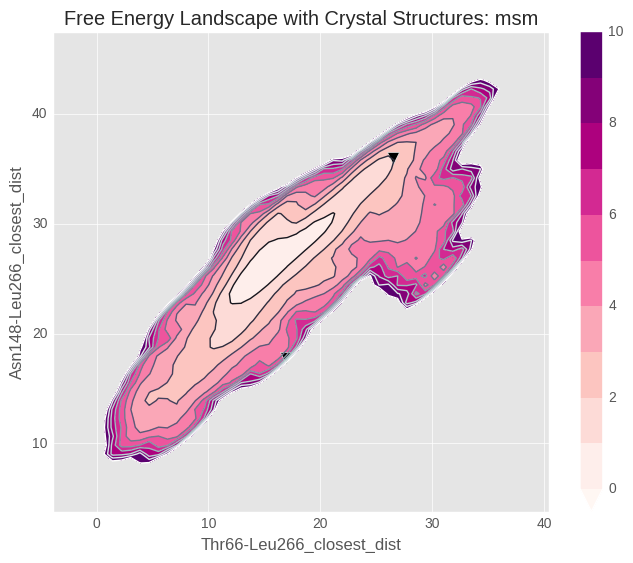

In [910]:
from jointplot_d3 import *
jointplot((0,1), features_eq_conc[cols].values, save_dir=analysis_dir, titles=cols,
              main="Free Energy Landscape with Crystal Structures: %s" %lig_name, custom_lims=custom_lims,
              max_tIC=5, min_density=None, max_diff=10., n_levels=11, n_pts=50j,
              remake=True, refcoords=ref_features[cols].values,
              cmap=plt.cm.get_cmap("RdPu"))

In [733]:
ref_predefined_features

,Leu266_Arg333_ca_dist,Leu266_Arg333_closest_dist,rmsd_connector_inactive,Asn148_Arg333_closest_dist,Phe282-Ile325_ca_dist,tm6_tm3_dist,rmsd_npxxy_inactive,rmsd_npxxy_active,Asn148_Arg333_ca_dist,Asn148-Leu266_ca_dist,Ala59-Leu266_closest_dist,rmsd_connector_active,Glu268-Arg328_ca_dist,Phe282-Ile325_closest_dist,Thr66-Leu266_closest_dist,Glu268-Arg328_closest_dist,Ala59-Leu266_ca_dist,Thr66-Leu266_ca_dist,Asn148-Leu266_closest_dist
0,26.014338,23.108404,18.778284,17.801294,17.952965,9.684233,12.169415,9.495378,17.602959,12.820497,11.544586,6.582942,18.618309,16.896046,1.448919,0.001993,0.491031,0.000000,8.395176
1,35.804707,32.222694,38.844658,35.958107,27.066776,24.393936,17.913361,15.553065,23.893888,17.872038,10.099874,5.871264,28.515127,26.512211,0.000000,1.448921,0.000000,0.491032,14.130492


hi
(2, 20001)
Computed 2D KDE
min_density=0.0
Computed Density. Now plotting.
(0.0, 10.0)


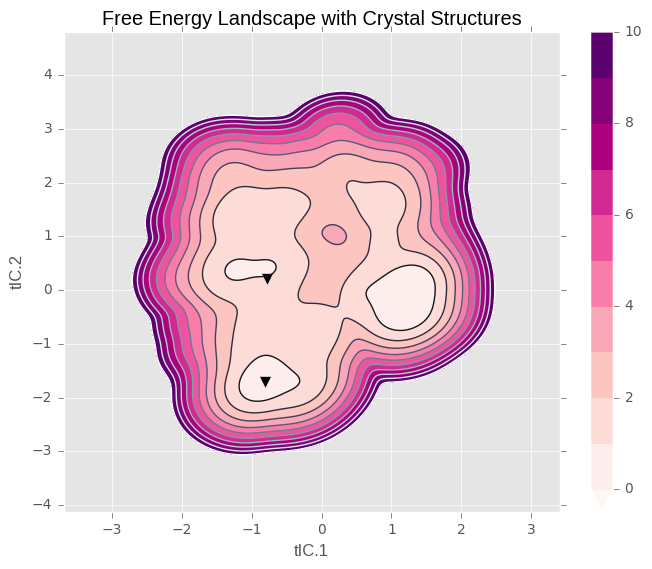

In [75]:
from jointplot_d3 import *
jointplot((0,1), features_eq_conc[cols].values, save_dir=analysis_dir, titles=cols,
              main="Free Energy Landscape with Crystal Structures: %s" %lig_name, custom_lims=custom_lims,
              max_tIC=5, min_density=None, max_diff=10., n_levels=11, n_pts=20j,
              remake=True, refcoords=ref_tica,
              cmap=plt.cm.get_cmap("RdPu"))

hi
(2, 20001)
Computed 2D KDE
min_density=0.0
Computed Density. Now plotting.
(0.0, 10.0)


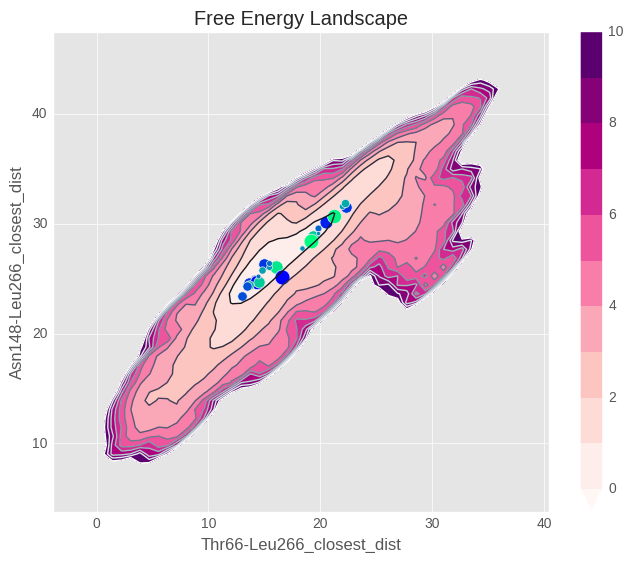

In [911]:
import jointplot_d3
reload(jointplot_d3)
from jointplot_d3 import *

new_cols = [n for n in full_docking_df.columns.values if "state" in n.lower()]
importance_df = pd.DataFrame(rf_model['(MSM + Crystal) Docking'][1][1].reshape((-1,1)), index=X_df.columns, columns=["feature_importance"])
importance_df["abs"] = importance_df["feature_importance"].abs() 
importance_df.sort("abs", inplace=True, ascending=False)
importance_df = importance_df.groupby(importance_df.index).first()

importance_df = importance_df.loc[new_cols]
coords_df = pd.DataFrame(np.hstack([clusterer.cluster_centers_, cluster_features_averages.values]), index=["State %d" %i for i in range(0, n_clusters)], columns=["tIC.%d" %j for j in range(1,3)] + cluster_features_averages.columns.values.tolist())
coords_df = coords_df.loc[importance_df.index]

df = pd.concat([coords_df, importance_df], axis=1).sort("feature_importance", ascending=False, inplace=False)
df["feature_importance"]


jointplot((0,1), features_eq_conc[cols].values, save_dir=analysis_dir, titles=cols,
              main="Free Energy Landscape", custom_lims=custom_lims,
              max_tIC=5, min_density=None, max_diff=10., n_levels=11, n_pts=50j,
              remake=True, superpose_circles={"radii": importance_df.values[:,0], "coords": coords_df[cols].values},
              cmap=plt.cm.get_cmap("RdPu"))

#jointplot((0,1), lig_features_eq["3p0g_lig"][["tIC.1", "tIC.2"]].values, save_dir=analysis_dir, make_animation=False, trajectory=None, video_file=None, titles=["tIC.1", "tIC.2"],
#              main="MSM Based Free Energy of B2AR bound to BI-167107", include_1d_kde=False, custom_lims=None, custom_lims_j=None, axes=None, data_j=None, titles_j=None, refcoords=None, 
#              refcoords_j=None, max_tIC=5, min_density=None, max_diff=5., tpt_paths=None, tpt_paths_j=None, n_levels=11, n_pts=200j,
#              all_apo_data=None, remake=True, min_i=None)



In [892]:
importance_df.sort(["feature_importance"], inplace=False)

,feature_importance,abs
State 20,-1.158128,1.158128
State 1,-1.065503,1.065503
State 23,-0.866646,0.866646
State 10,-0.668296,0.668296
State 16,-0.667797,0.667797
State 17,-0.655162,0.655162
State 21,-0.460990,0.460990
State 9,-0.444604,0.444604
State 15,-0.245209,0.245209
State 19,-0.226623,0.226623


In [888]:
coords_df

,tIC.1,tIC.2
State 0,1.213054,-0.020365
State 10,1.292163,-0.285284
State 11,-0.804990,-0.283653
State 12,0.698319,0.474323
State 13,1.124896,-0.468081
State 14,0.673543,-0.091663
State 15,-0.741449,0.238665
State 16,-0.490231,1.480292
State 17,-0.324014,-1.783042
State 18,1.294396,0.190954


In [336]:
analysis_dir

'/home/enf/b2ar_analysis/sparse-tICA_t5_n_components2all_residues_2rh1_3sn6_under_cutoff6A_regularization_wolf_autoShrinkage_rho0pt01/analysis_n_clusters25_random'

In [329]:
rf_model['(MSM + Crystal) Docking'][1]

array([[  9.49593723e-02,  -2.88568490e-01,   1.65028697e-01,
         -3.31584834e-01,   6.32731242e-02,   1.24555155e-01,
         -7.76475640e-01,   3.22316447e-01,   3.22446139e-01,
         -3.77794922e-01,   7.78438942e-01,   2.23894163e-01,
         -8.08541392e-01,   7.21995759e-01,   8.81292531e-01,
          3.87986019e-01,   8.14075638e-02,   4.08228696e-01,
         -8.79275690e-01,  -7.01562956e-01,   5.87026017e-01,
         -2.14424399e-01,   8.01955910e-01,  -2.53954794e-01,
         -3.00755820e-01,  -5.88972883e-01,  -8.79481272e-02,
         -3.83527863e-01,   3.85882334e-02,  -6.36063816e-01,
          7.42566404e-01,  -8.53595682e-01,   2.94271762e-01,
          8.67834962e-02,  -6.11079870e-01,   2.16925875e-01,
          4.94844729e-01,  -6.79609078e-01,   7.58505433e-01,
          3.35153519e-01,  -1.29579224e+00,   8.62370832e-01,
          5.65356132e-01,   5.81632235e-02,   2.99205209e-02,
          7.15143299e-01,  -1.32787928e+00,  -9.56635315e-01,
        

In [356]:
cluster_features_averages[["tIC.1", "tIC.2"]].sort("tIC.1", ascending=False, inplace=False)

/home/enf/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:1: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  if __name__ == '__main__':


,tIC.1,tIC.2
cluster18,1.291122,0.203839
cluster10,1.283093,-0.295647
cluster0,1.214025,-0.027302
cluster13,1.117396,-0.470313
cluster20,0.925695,0.995703
cluster23,0.901806,1.660999
cluster12,0.720541,0.437515
cluster14,0.675180,-0.096553
cluster3,0.293050,1.977974
cluster6,-0.069492,-0.466138


analyzing precision at full recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.630307          0.000000   
(MSM + Crystal) Docking      0.677025          0.046718   
MSM ddG + Crystal Docking    0.699171          0.068864   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.342349986166, 0.421218711081)  
MSM ddG + Crystal Docking  (0.404029824485, 0.484708385984)  


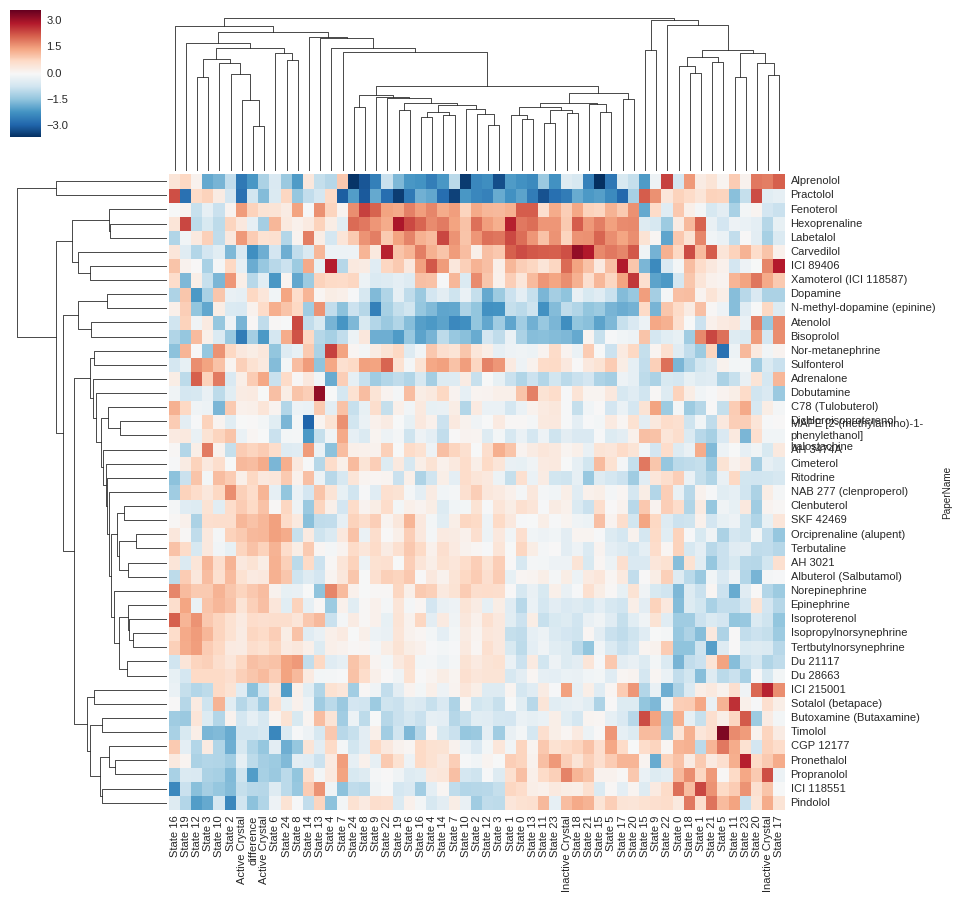

ValueError: list.remove(x): x not in list

analyzing threshold at full recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.475993          0.000000   
(MSM + Crystal) Docking      0.457103         -0.018890   
MSM ddG + Crystal Docking    0.476040          0.000048   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.472334952356, 0.553493677357)  
MSM ddG + Crystal Docking  (0.510281173582, 0.591046527598)  


ValueError: list.remove(x): x not in list

analyzing Accuracy:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.692222          0.000000   
(MSM + Crystal) Docking      0.673889         -0.018333   
MSM ddG + Crystal Docking    0.692333          0.000111   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.168509933878, 0.233457947393)  
MSM ddG + Crystal Docking  (0.227834930413, 0.299302464081)  


ValueError: list.remove(x): x not in list

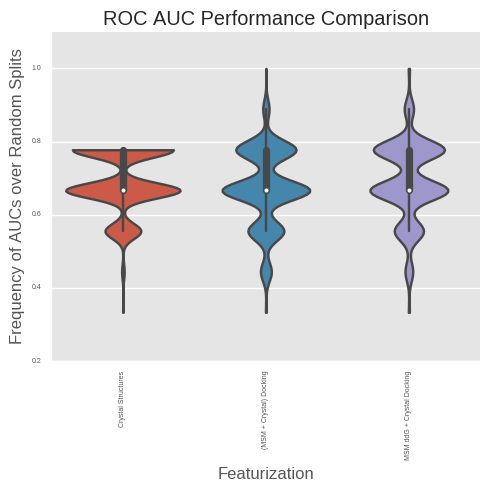

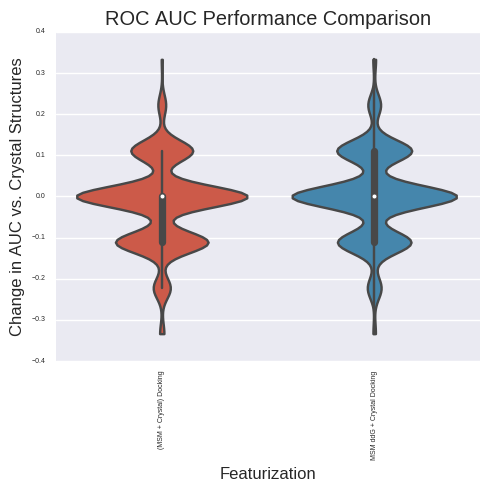

analyzing Recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.920000          0.000000   
(MSM + Crystal) Docking      0.831000         -0.089000   
MSM ddG + Crystal Docking    0.844333         -0.075667   

                                            Sign Test 99% CI  
Crystal Structures                                  (0, 0.0)  
(MSM + Crystal) Docking    (0.0719514491584, 0.119413759073)  
MSM ddG + Crystal Docking  (0.0763668714963, 0.124932425086)  


ValueError: list.remove(x): x not in list

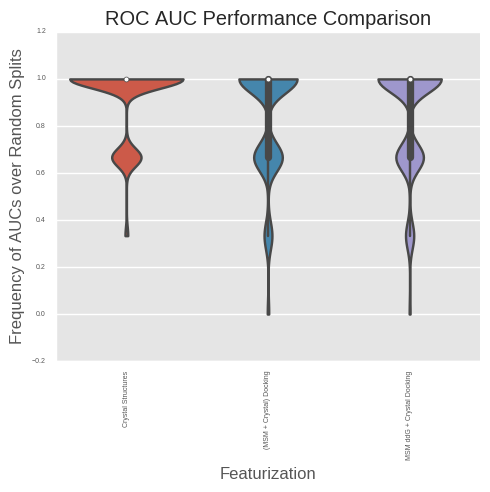

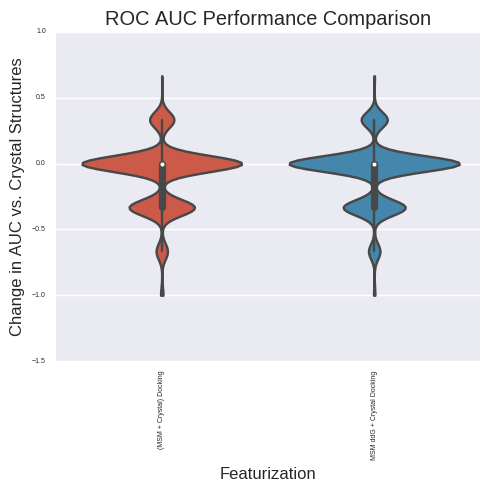

analyzing precision:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.580327          0.000000   
(MSM + Crystal) Docking      0.579515         -0.000812   
MSM ddG + Crystal Docking    0.602995          0.022668   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.292929372415, 0.369311623652)  
MSM ddG + Crystal Docking   (0.341376424226, 0.42020545535)  


ValueError: list.remove(x): x not in list

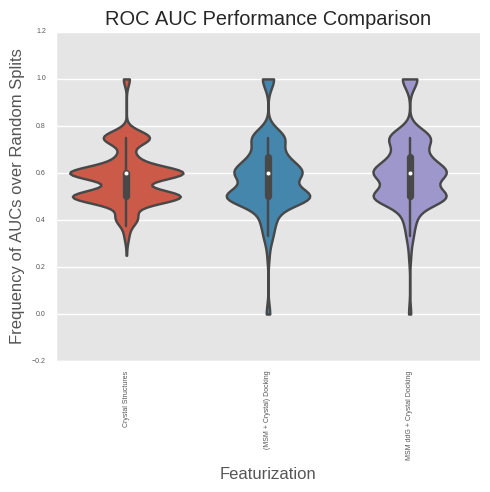

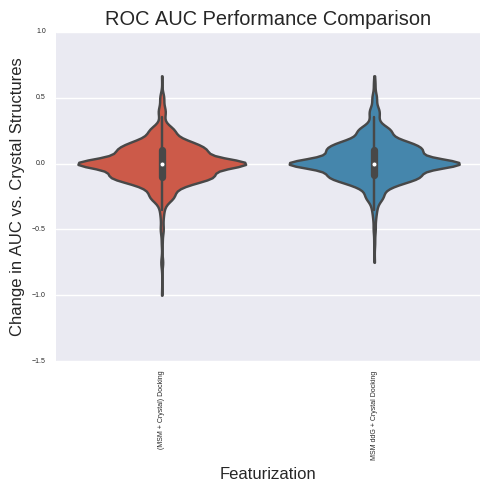

analyzing fdr:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.419673          0.000000   
(MSM + Crystal) Docking      0.420485          0.000812   
MSM ddG + Crystal Docking    0.397005         -0.022668   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.298718421021, 0.375443481067)  
MSM ddG + Crystal Docking  (0.251651671235, 0.325156165014)  


ValueError: list.remove(x): x not in list

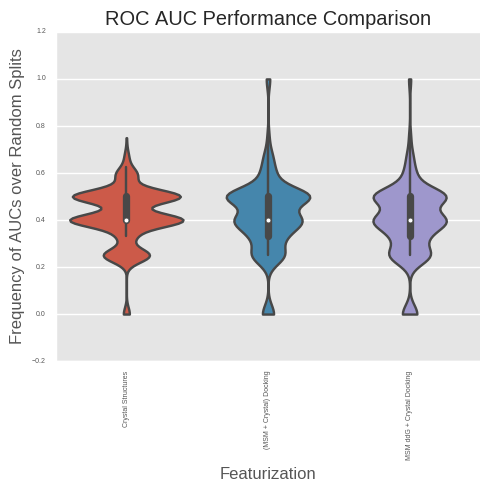

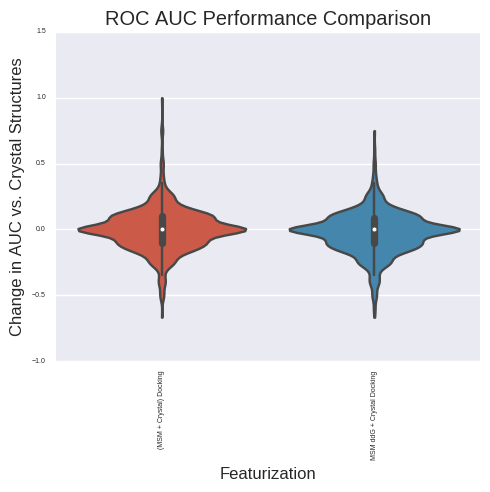

analyzing Recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.692222          0.000000   
(MSM + Crystal) Docking      0.673889         -0.018333   
MSM ddG + Crystal Docking    0.692333          0.000111   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.168509933878, 0.233457947393)  
MSM ddG + Crystal Docking  (0.227834930413, 0.299302464081)  


ValueError: list.remove(x): x not in list

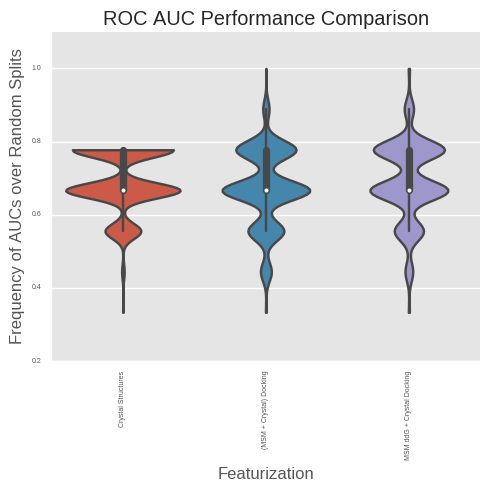

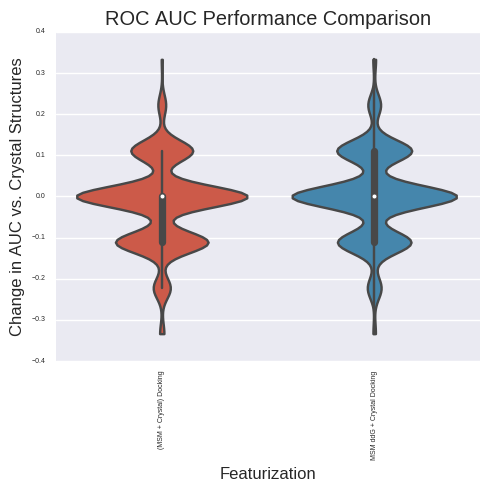

analyzing precision:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.577652          0.000000   
(MSM + Crystal) Docking      0.604476          0.026824   
MSM ddG + Crystal Docking    0.619861          0.042209   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.375554200244, 0.455566297789)  
MSM ddG + Crystal Docking  (0.417826352474, 0.498727305378)  


ValueError: list.remove(x): x not in list

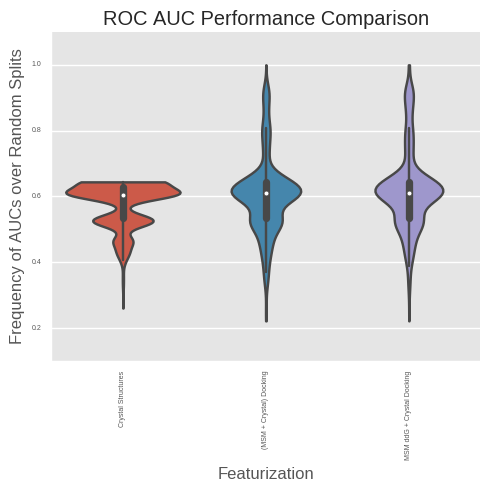

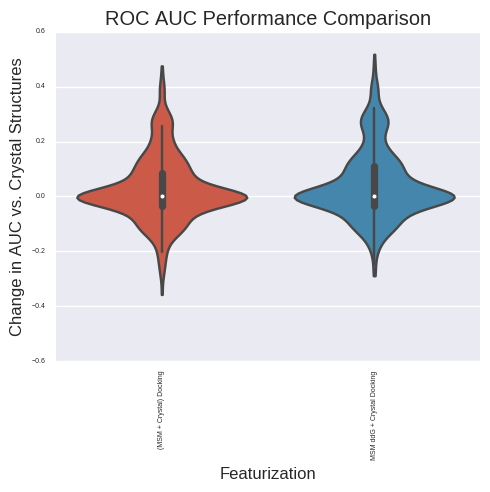

analyzing fdr:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.422348          0.000000   
(MSM + Crystal) Docking      0.395524         -0.026824   
MSM ddG + Crystal Docking    0.380139         -0.042209   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.291965206344, 0.368288972053)  
MSM ddG + Crystal Docking  (0.269843926991, 0.344713444992)  


ValueError: list.remove(x): x not in list

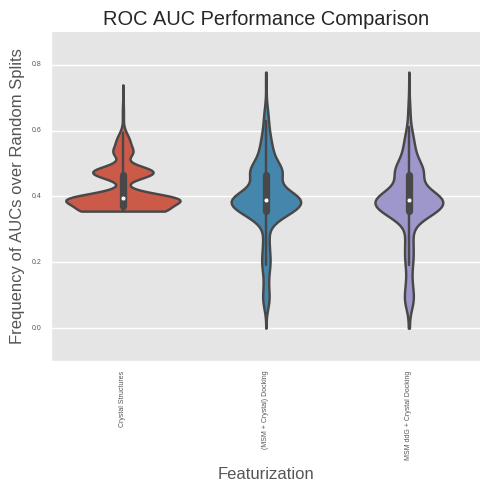

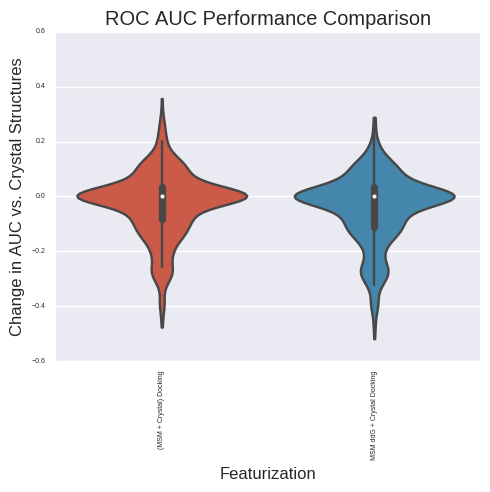

analyzing class B ROC AUC:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.774833          0.000000   
(MSM + Crystal) Docking      0.836944          0.062111   
MSM ddG + Crystal Docking    0.855611          0.080778   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.565624882197, 0.644977790843)  
MSM ddG + Crystal Docking   (0.598063551337, 0.67611728715)  


ValueError: list.remove(x): x not in list

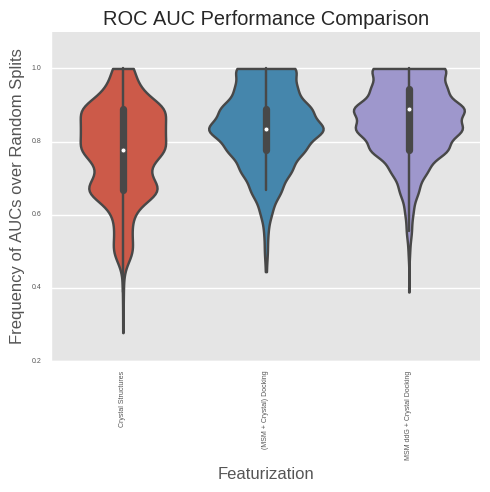

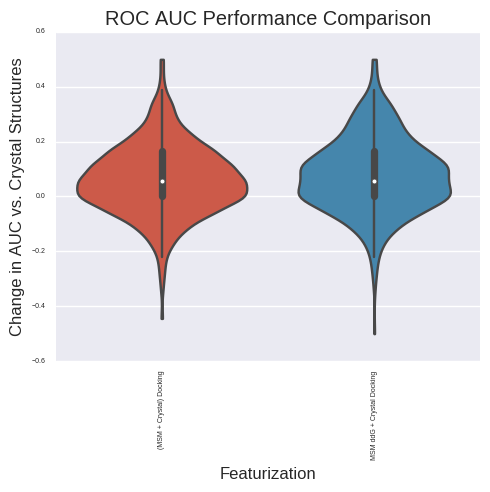

analyzing ROC AUC:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.723668          0.000000   
(MSM + Crystal) Docking      0.819884          0.096216   
MSM ddG + Crystal Docking    0.837551          0.113883   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.751814763352, 0.818401907993)  
MSM ddG + Crystal Docking    (0.8057762976, 0.865768074926)  


ValueError: list.remove(x): x not in list

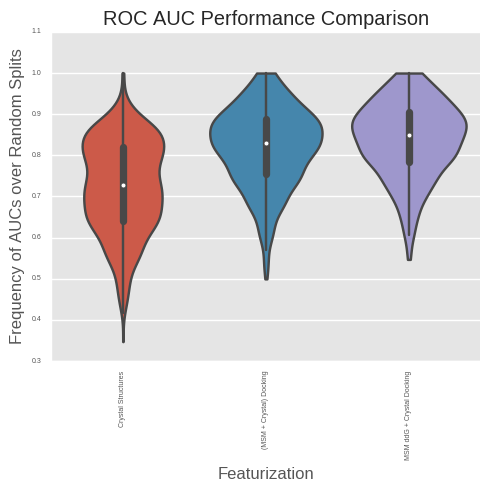

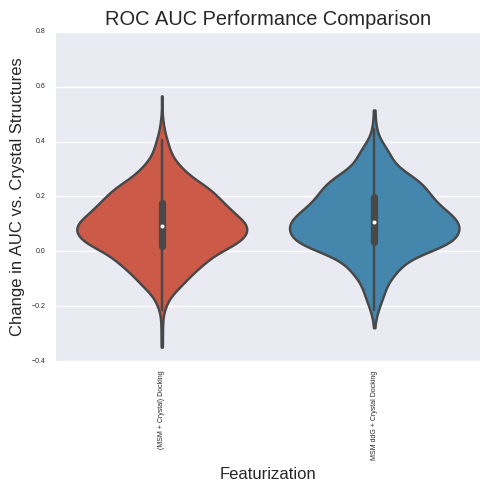

analyzing BedROC
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.674152          0.000000   
(MSM + Crystal) Docking      0.661668         -0.012483   
MSM ddG + Crystal Docking    0.708477          0.034325   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.452457095452, 0.533635180857)  
MSM ddG + Crystal Docking  (0.488283745581, 0.569333966854)  


ValueError: list.remove(x): x not in list

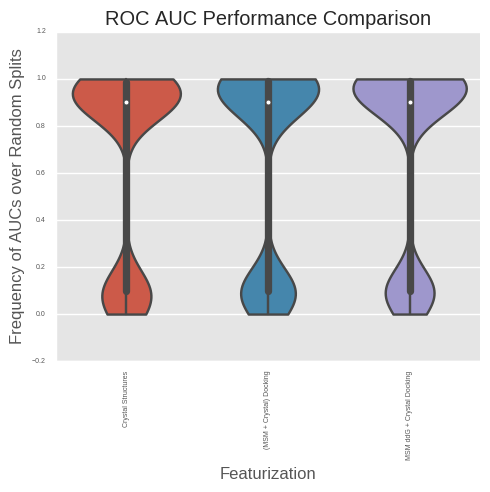

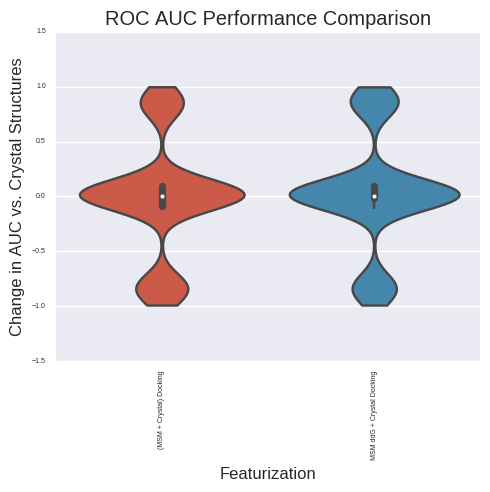

analyzing LogAUC
(1000, 0)
/n
(3, 3)
(3, 3)


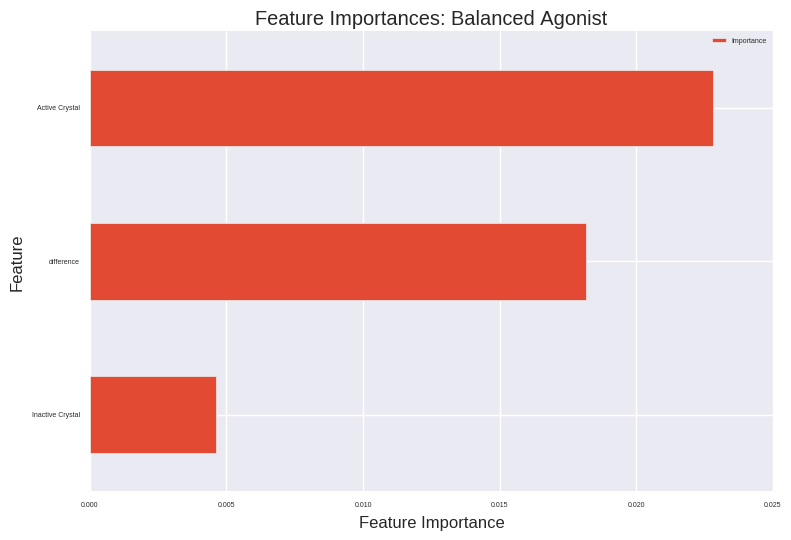

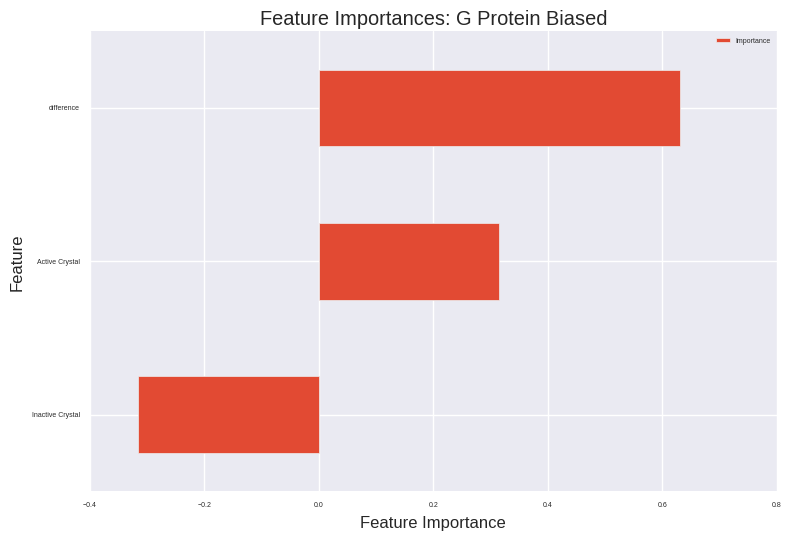

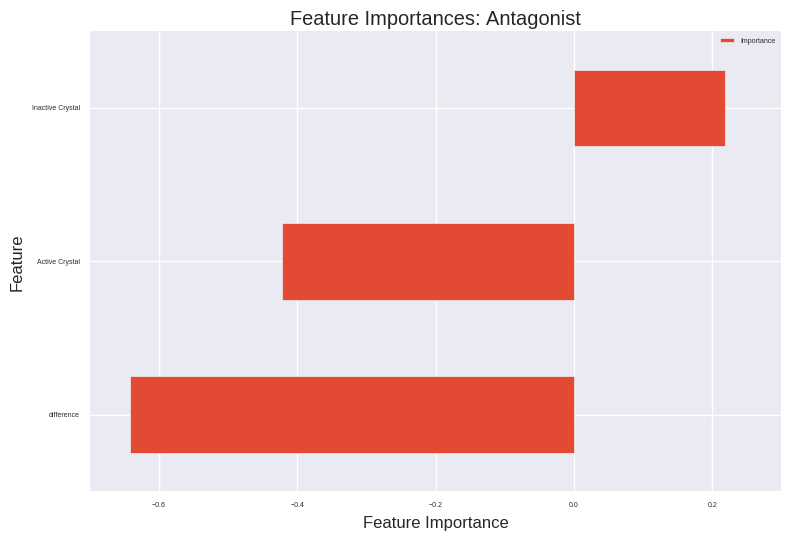

(3, 55)
(3, 55)


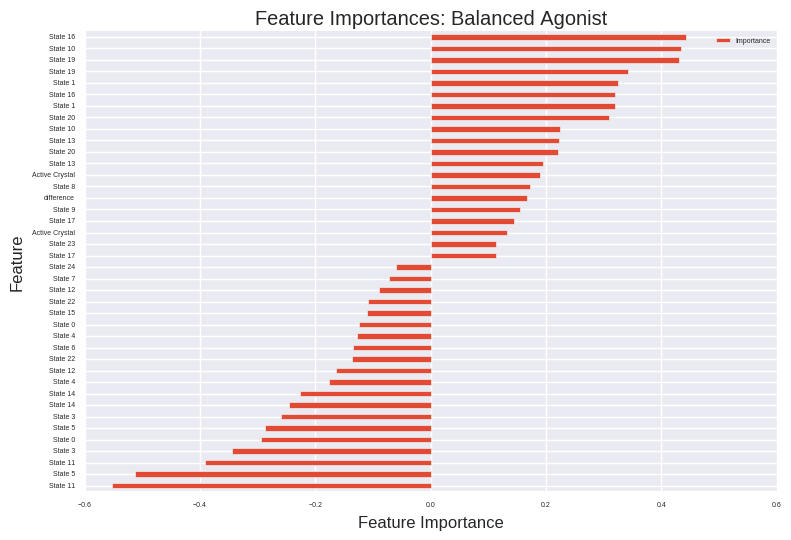

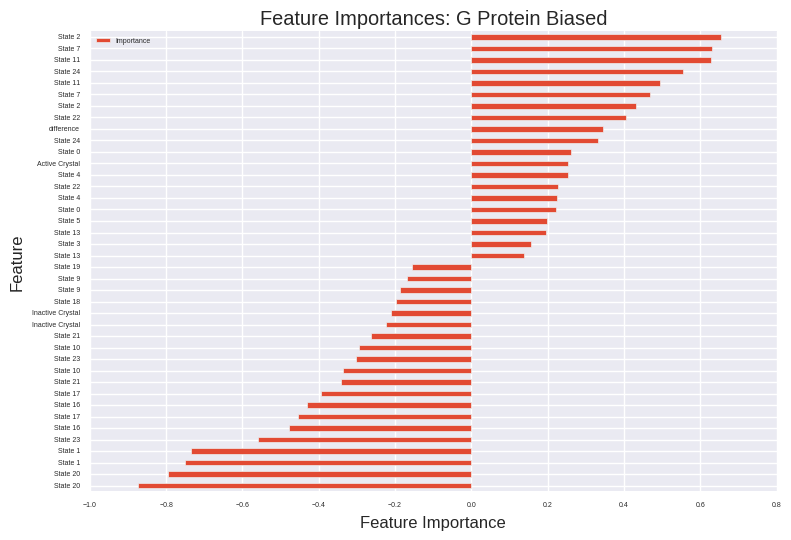

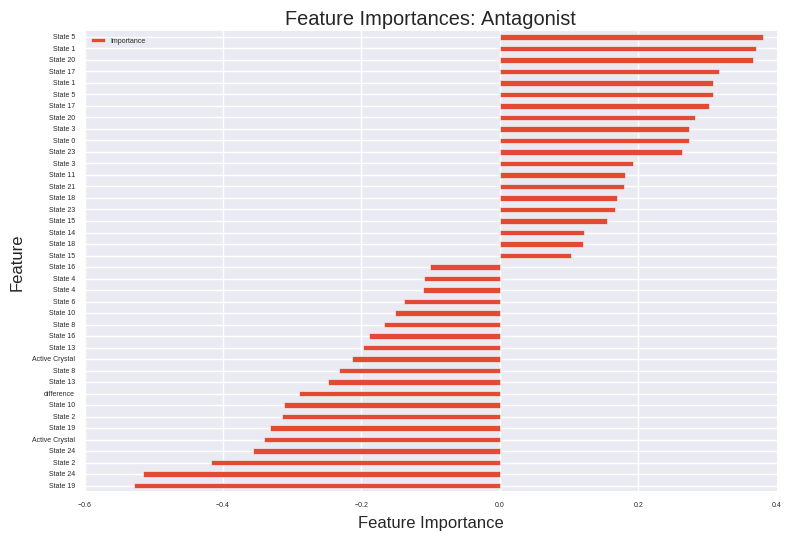

(3, 105)
(3, 105)


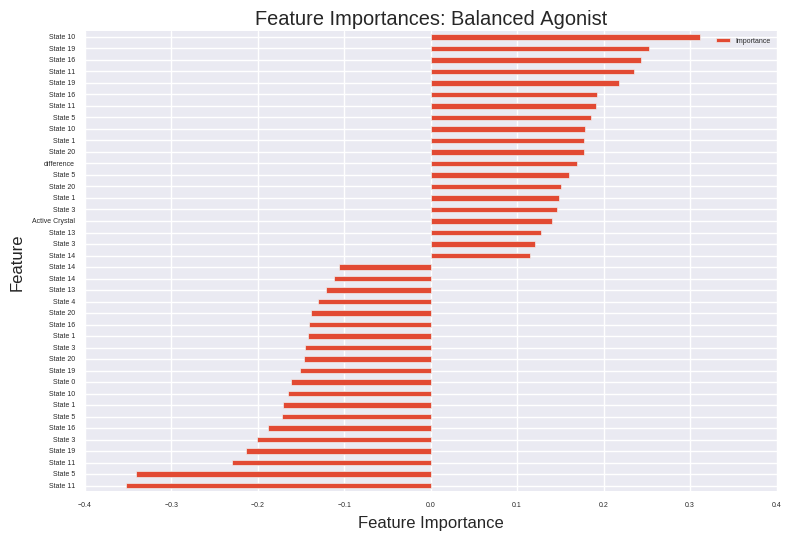

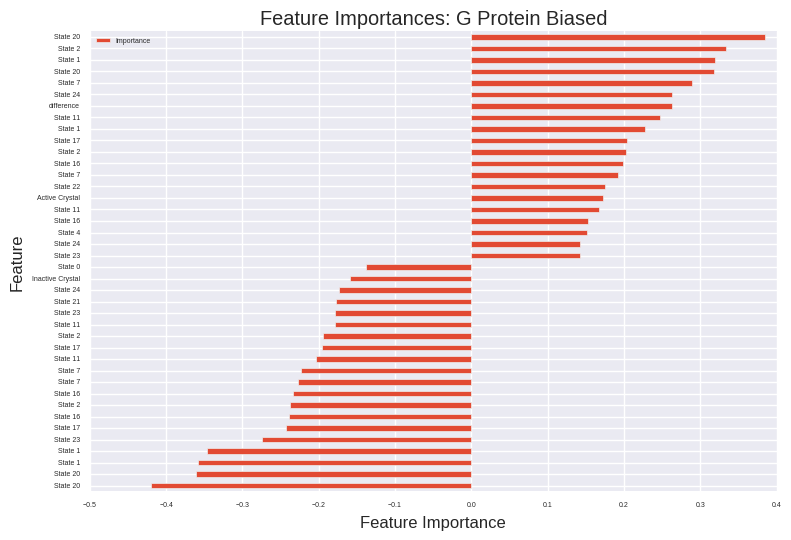

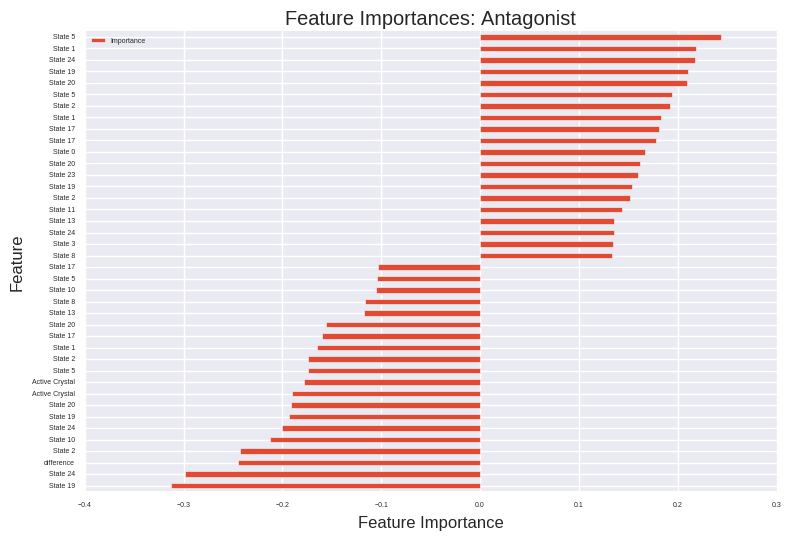

In [296]:
#XP, All ligands, LR three class, 32 stereoisomers; new crystal grids; 25 clusters

importance_dfs = analyze_multiclass_experiment(results_dict[save_name], 
                                                                feature_names,
                                                                [f.columns.values.tolist() for f in features], bret.loc[model_agonists]["PaperName"], analysis_dir,
                                                                ["Balanced Agonist", "G Protein Biased", "Antagonist"], 
                                                                #["Gs Inactive", "Gs Active"], 
                                                               #["Arr Inactive", "Arr Active"],
                                               np.hstack([X_df.loc[model_agonists].values]),
                                                               #["Gs Inactive", "Gs Partial Active", "Gs Full Active"], 
                                              remake=True, fxn=np.mean)


#TRY LOOCV
#crystal structures might just have bigger boxes



In [366]:
sub_docking_df = full_docking_df.loc[ligand_id_df.loc[ligand_id_df.SMILES != ""].index]
sub_docking_df = sub_docking_df.loc[[n for n in sub_docking_df.index.values if n in chembl_inactives+chembl_actives]]

mol_names = sub_docking_df.index.values
mols = [pybel.readstring("smi", x) for x in ligand_id_df.loc[sub_docking_df.index].SMILES]
fps = [x.calcfp(fptype='FP4') for x in mols] # Calculate their fingerprints

similarity_matrix = np.zeros((len(mols), len(mols)))
remove_ligands = []

for i in range(0, len(mols)):
    for j in range(i, len(mols)):
        if i == j:
            continue            
        similarity_matrix[i][j] = fps[i] | fps[j]
        if similarity_matrix[i][j] > 0.95:
            remove_ligands.append(mol_names[i])

train_ligands = []
test_ligands = []
for i, mol_name in enumerate(mol_names):
    if np.max(similarity_matrix[i,:]) < 0.95:
        test_ligands.append(mol_name)
    else:
        train_ligands.append(mol_name)


#full_docking_df = full_docking_df.loc[[n for n in full_docking_df.index.values.tolist() if n not in remove_ligands]]

In [367]:
model_agonists = [n for n in sub_docking_df.index.values if n not in remove_ligands]
#model_agonists = train_ligands
model_inactives = [n for n in model_agonists if n in chembl_inactives]
model_actives = [n for n in model_agonists if n in chembl_actives]
print(len(model_inactives))
print(len(model_actives))

761
156


In [368]:
len(remove_ligands)

876

In [371]:
from sklearn import preprocessing

from importlib import reload
#import efficacy_scripts
#reload(efficacy_scripts)
#from efficacy_scripts import *


#model_inactives = [n for n in model_agonists if "inactive" in n]
#model_actives = [n for n in model_agonists if n in all_active_ligands]
                 
y = np.array([0. for i in model_inactives] + [1. for j in model_actives]).reshape((-1,1))
y_df = pd.DataFrame(y, index=model_inactives+model_actives)
model_agonists = y_df.index.values

def replace_columns(X_df):
    old_cols = X_df.columns.values.tolist()
    new_cols = []
    for col in old_cols:
        if "2rh1" in col.lower():
            col = "Inactive Crystal"
        if "3p0g" in col.lower():
            col = "Active Crystal"
        if "null" in col:
            col = "difference"
        if "cluster" in col:
            col = col.replace("cluster", "State ")
        new_cols.append(col)
    X_df.columns = new_cols
    #X_df["difference"] = X_df["Active Crystal"].subtract(X_df["Inactive Crystal"])
    return(X_df)

X_df = full_docking_df
X_df = replace_columns(X_df)

ddg_df = new_docking_df
ddg_df = replace_columns(ddg_df)
ddg_df[[c for c in ddg_df.columns.values if "state" in c.lower()]] = ddg_df[[c for c in ddg_df.columns.values if "state" in c.lower()]].multiply(-1.0)
#ddg_df[[c for c in ddg_df.columns.values if "state" in c.lower()]] = eq_pops_df.loc[common_agonists]

C_df = X_df[[c for c in X_df.columns.values.tolist() if "State" not in c]]

X = X_df.values
ddg = ddg_df.values

feature_names = ["Crystal Structures", "(MSM + Crystal) Docking", "MSM ddG + Crystal Docking"]#, "MSM Features Reweighted"]#, "Docking ddG and Observables"]

n_trials = 1000
train_test_split_prop = 0.9
model_type = "rfr"
def normalize_per_ligand(df):
    new_df = copy.deepcopy(df)
    n_df = new_df.ix[:, [i for i in range(0, new_df.shape[1]) if "difference" not in new_df.columns.values[i].lower()]]
    n_df = pd.DataFrame(preprocessing.scale(n_df.values, axis=1), index=n_df.index, columns=n_df.columns.values.tolist())
    new_df = pd.concat([new_df, n_df], axis=1)
    return(new_df)

normalize = False
normalize_axis0 = False
if normalize_axis0:
    double_features = 2
    X_df = normalize_per_ligand(X_df)
    ddg_df = normalize_per_ligand(ddg_df)

else: 
    double_features = 1
n_estimators = 1000
ddg_df = pd.concat([ddg_df, X_df.ix[:, [i for i in range(0, X_df.shape[1]) if "state" in X_df.columns.values[i].lower()]]], axis=1)

features = [C_df.loc[model_agonists], X_df.loc[model_agonists], ddg_df.loc[model_agonists]]#, all_features_df]#, all_features]
print([f.shape for f in features])
#save_name = "arr-cutoff%s_%s_trials%d_split%s" %(str(cutoff), model_type, n_trials, str(train_test_split_prop))
save_name = "binder_vs_dud-%s_%s_trials%d_split%s_normalize%s_normalize-axis0%s_n-estimators%d_precision%s" %(str(diff_cutoff), model_type, n_trials, str(train_test_split_prop), str(normalize), str(normalize_axis0), n_estimators, precision)
#save_name = "a_vs_g_vs_inactive-%s_%s_trials%d_split%s_normalize%s_normalize-axis0%s_n-estimators%d_precision%s" %(str(diff_cutoff), model_type, n_trials, str(train_test_split_prop), str(normalize), str(normalize_axis0), n_estimators, precision)
results_dict[save_name] = generate_or_load_model(features, y, feature_names,
                                                 n_trials, train_test_split_prop, False,
                                                 model_type, "%s/%s.pkl" %(analysis_dir, save_name),
                                                 redo=True, worker_pool=dview, parallel=False, n_estimators=n_estimators, 
                                                 max_depth=None, criterion='gini',
                                                 normalize=normalize, normalize_axis0=False,
                                                 loocv=False)
"%s/%s.pkl" %(analysis_dir, save_name)


[(917, 2), (917, 27), (917, 52)]
Aobut to fit model(s).
Fitting models over all data...
Fitting models over split train data...
Finished fitting models


'/home/enf/b2ar_analysis/sparse-tICA_t5_n_components2all_residues_2rh1_3sn6_under_cutoff6A_regularization_wolf_autoShrinkage_rho0pt01/analysis_n_clusters25_random/binder_vs_dud-0.3_rfr_trials1000_split0.9_normalizeFalse_normalize-axis0False_n-estimators1000_precisionSP.pkl'

Exception in thread Thread-3186:
Traceback (most recent call last):
  File "/home/enf/anaconda3/lib/python3.5/threading.py", line 914, in _bootstrap_inner
    self.run()
  File "/home/enf/anaconda3/lib/python3.5/threading.py", line 862, in run
    self._target(*self._args, **self._kwargs)
  File "/home/enf/anaconda3/lib/python3.5/multiprocessing/pool.py", line 366, in _handle_workers
    pool._maintain_pool()
  File "/home/enf/anaconda3/lib/python3.5/multiprocessing/pool.py", line 240, in _maintain_pool
    self._repopulate_pool()
  File "/home/enf/anaconda3/lib/python3.5/multiprocessing/pool.py", line 233, in _repopulate_pool
    w.start()
  File "/home/enf/anaconda3/lib/python3.5/multiprocessing/process.py", line 105, in start
    self._popen = self._Popen(self)
  File "/home/enf/anaconda3/lib/python3.5/multiprocessing/context.py", line 267, in _Popen
    return Popen(process_obj)
  File "/home/enf/anaconda3/lib/python3.5/multiprocessing/popen_fork.py", line 20, in __init__
    self.

In [117]:
C_df.loc[model_agonists].iloc[:10]

,Inactive Crystal,Active Crystal
CID_3406,5.22,6.11
CID_68911,4.97,3.75
CID_657255,7.08,3.50
CID_1775,6.41,5.58
CID_448537,4.51,5.08
CID_2753,7.11,5.24
CID_564,4.28,4.50
CID_9917490,-0.00,-0.00
CID_9651,5.43,4.64
CID_5070,6.94,6.21


analyzing precision at full recall:
(100, 3)
                           Median AUC  Median delta AUC       Sign Test 99% CI
Crystal Structures           0.230910          0.000000               (0, 0.0)
(MSM + Crystal) Docking      0.466530          0.235620  (0.937779312284, 1.0)
MSM ddG + Crystal Docking    0.452312          0.221402  (0.937779312284, 1.0)


ValueError: list.remove(x): x not in list

analyzing threshold at full recall:
(100, 3)
                           Median AUC  Median delta AUC       Sign Test 99% CI
Crystal Structures            0.02435           0.00000               (0, 0.0)
(MSM + Crystal) Docking       0.13650           0.11215  (0.937779312284, 1.0)
MSM ddG + Crystal Docking     0.14158           0.11723  (0.937779312284, 1.0)


ValueError: list.remove(x): x not in list

analyzing Accuracy:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.915231          0.000000   
(MSM + Crystal) Docking      0.914615         -0.000615   
MSM ddG + Crystal Docking    0.919846          0.004615   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.248662880204, 0.488758912356)  
MSM ddG + Crystal Docking  (0.248662880204, 0.488758912356)  


ValueError: list.remove(x): x not in list

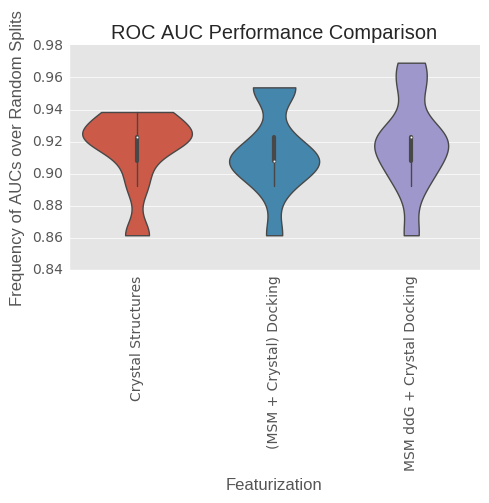

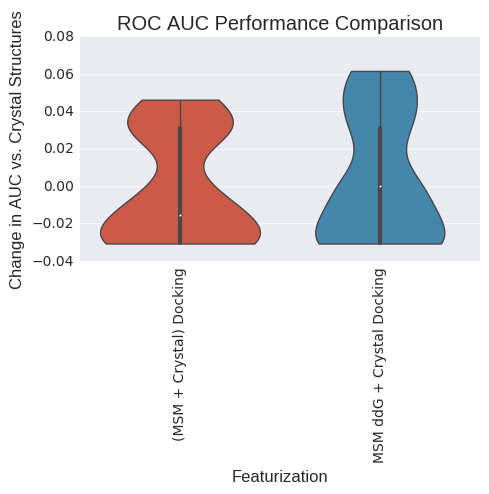

analyzing Recall:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.323333             0.000   
(MSM + Crystal) Docking      0.338333             0.015   
MSM ddG + Crystal Docking    0.373333             0.050   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.222811316676, 0.458343717148)  
MSM ddG + Crystal Docking  (0.413165633404, 0.661856711579)  


ValueError: list.remove(x): x not in list

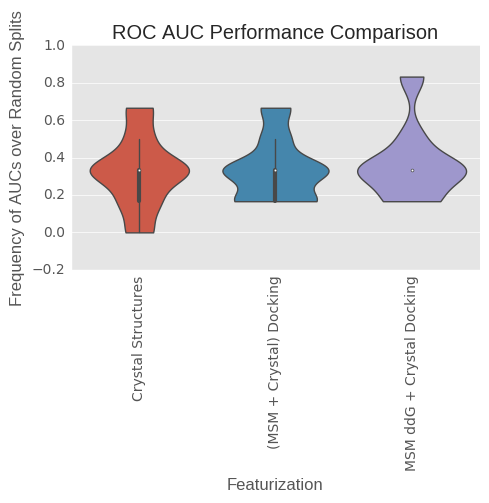

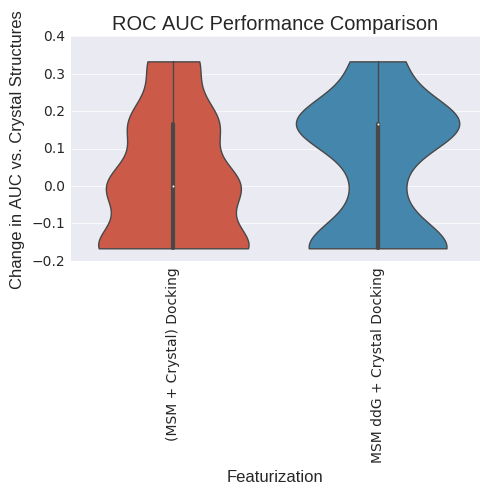

analyzing precision:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.580238          0.000000   
(MSM + Crystal) Docking      0.616714          0.036476   
MSM ddG + Crystal Docking    0.657381          0.077143   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.248662880204, 0.488758912356)  
MSM ddG + Crystal Docking  (0.248662880204, 0.488758912356)  


ValueError: list.remove(x): x not in list

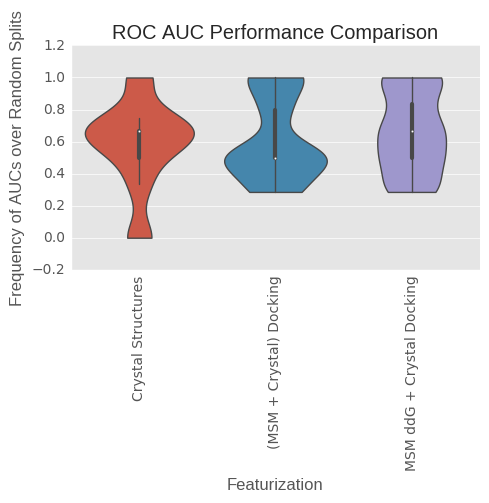

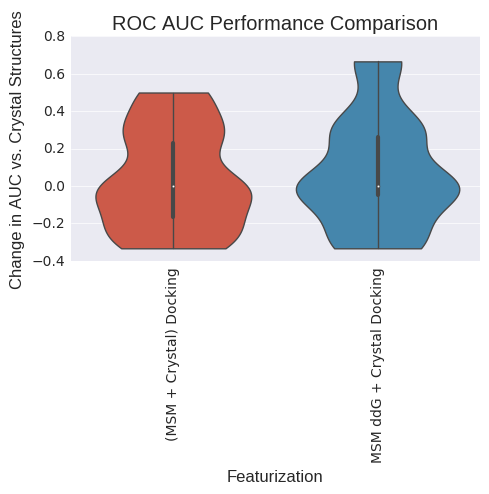

analyzing fdr:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.419762          0.000000   
(MSM + Crystal) Docking      0.383286         -0.036476   
MSM ddG + Crystal Docking    0.342619         -0.077143   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking      (0.31078659896, 0.55792429732)  
MSM ddG + Crystal Docking  (0.222811316676, 0.458343717148)  


ValueError: list.remove(x): x not in list

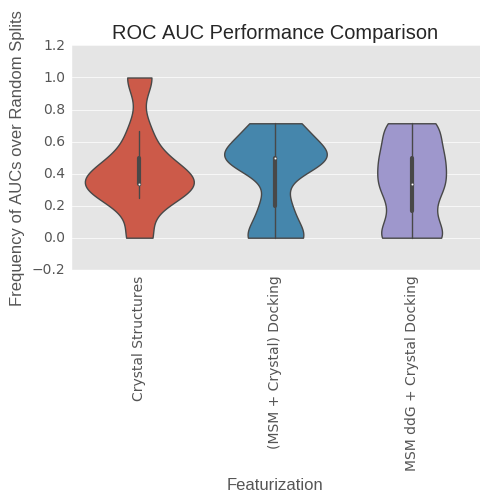

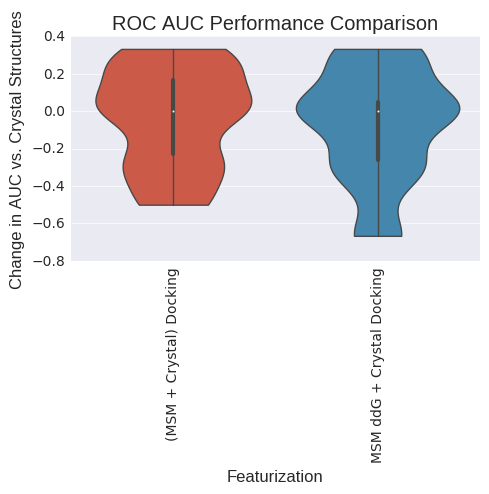

analyzing Recall:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.323333             0.000   
(MSM + Crystal) Docking      0.338333             0.015   
MSM ddG + Crystal Docking    0.373333             0.050   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.222811316676, 0.458343717148)  
MSM ddG + Crystal Docking  (0.413165633404, 0.661856711579)  


ValueError: list.remove(x): x not in list

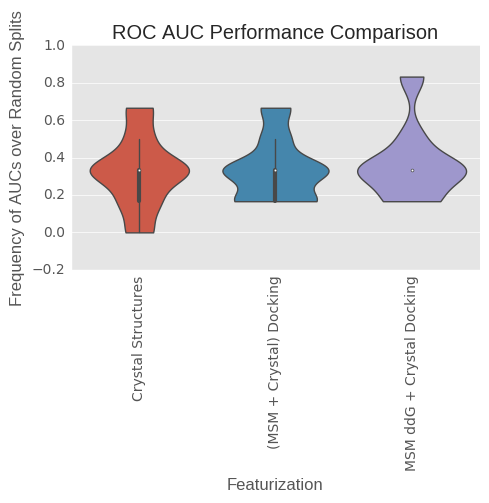

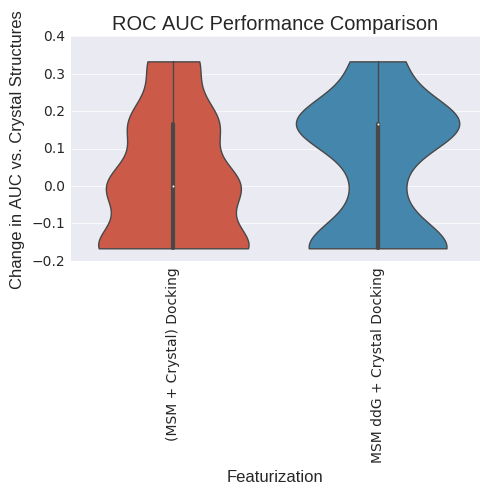

analyzing precision:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.580238          0.000000   
(MSM + Crystal) Docking      0.616714          0.036476   
MSM ddG + Crystal Docking    0.657381          0.077143   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.248662880204, 0.488758912356)  
MSM ddG + Crystal Docking  (0.248662880204, 0.488758912356)  


ValueError: list.remove(x): x not in list

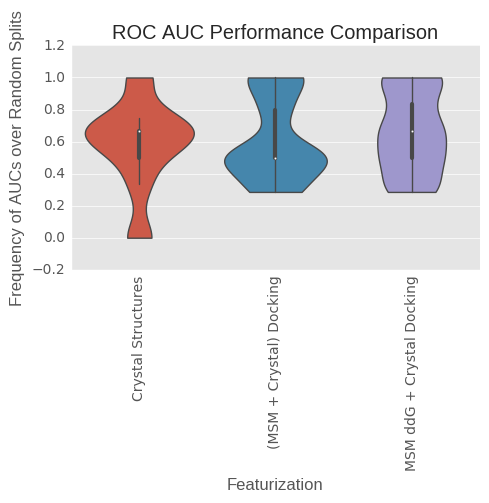

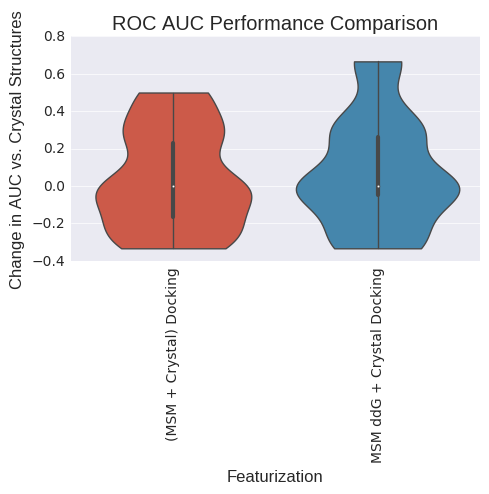

analyzing fdr:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.419762          0.000000   
(MSM + Crystal) Docking      0.383286         -0.036476   
MSM ddG + Crystal Docking    0.342619         -0.077143   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking      (0.31078659896, 0.55792429732)  
MSM ddG + Crystal Docking  (0.222811316676, 0.458343717148)  


ValueError: list.remove(x): x not in list

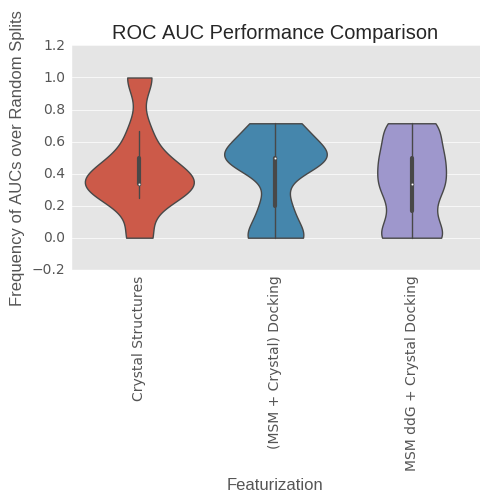

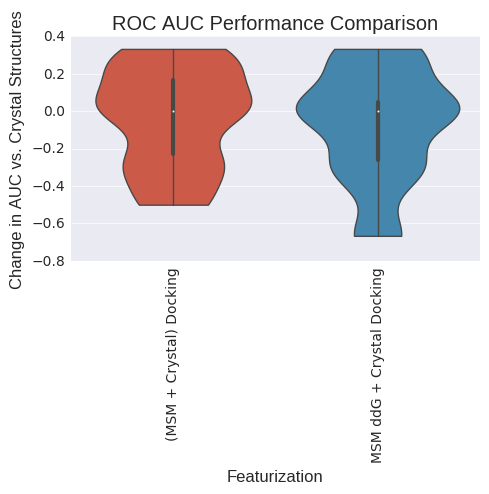

analyzing class B ROC AUC:
(100, 3)
                           Median AUC  Median delta AUC       Sign Test 99% CI
Crystal Structures           0.860127          0.000000               (0, 0.0)
(MSM + Crystal) Docking      0.946836          0.086709  (0.937779312284, 1.0)
MSM ddG + Crystal Docking    0.945565          0.085438  (0.937779312284, 1.0)


ValueError: list.remove(x): x not in list

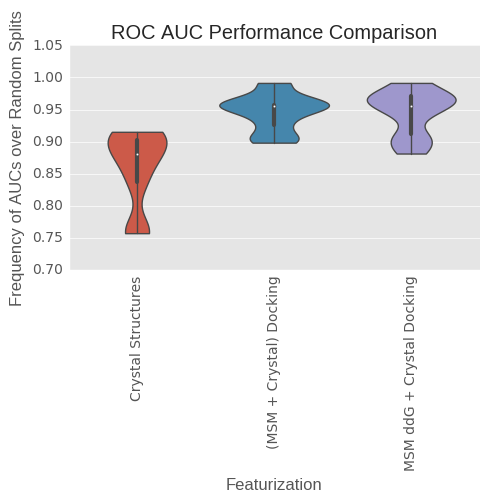

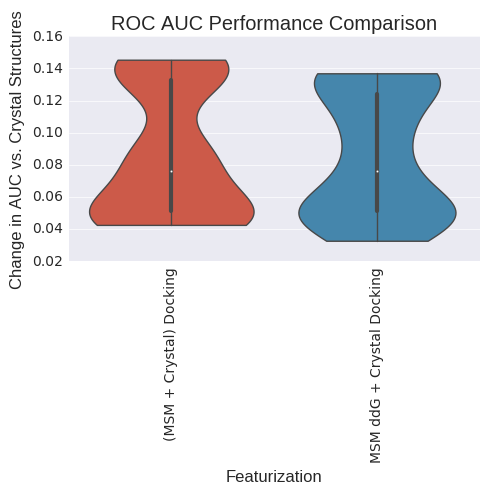

analyzing ROC AUC:
(100, 3)
                           Median AUC  Median delta AUC       Sign Test 99% CI
Crystal Structures           0.860127          0.000000               (0, 0.0)
(MSM + Crystal) Docking      0.946836          0.086709  (0.937779312284, 1.0)
MSM ddG + Crystal Docking    0.945565          0.085438  (0.937779312284, 1.0)


ValueError: list.remove(x): x not in list

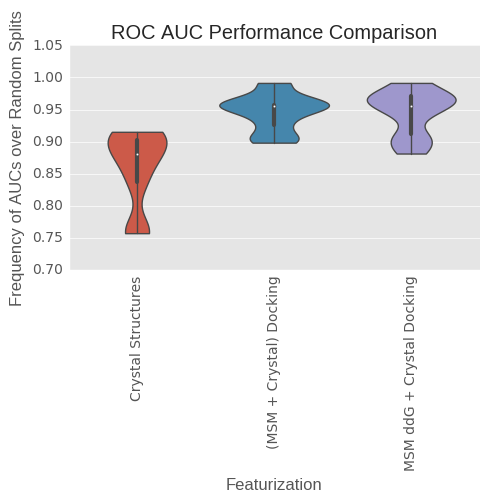

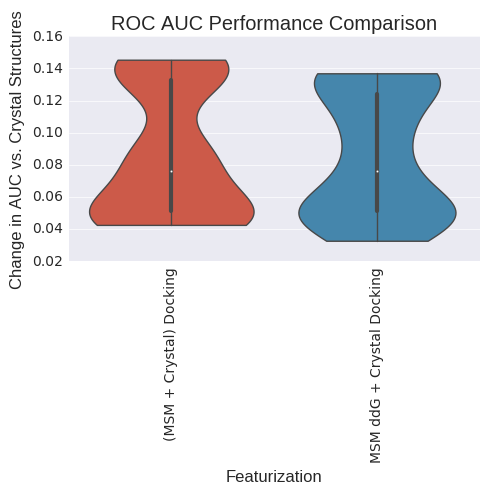

analyzing BedROC
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.556326          0.000000   
(MSM + Crystal) Docking      0.708820          0.152495   
MSM ddG + Crystal Docking    0.725178          0.168852   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.771919554171, 0.940792723165)  
MSM ddG + Crystal Docking  (0.771919554171, 0.940792723165)  


ValueError: list.remove(x): x not in list

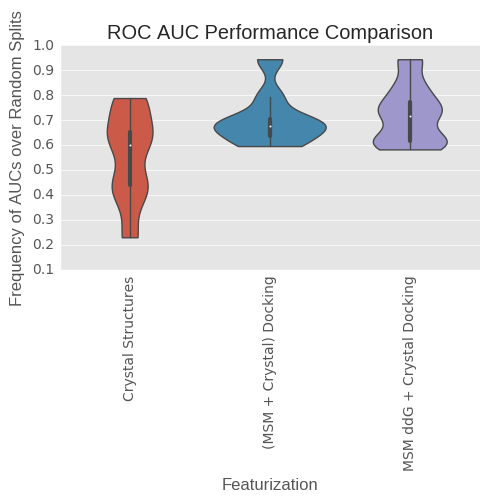

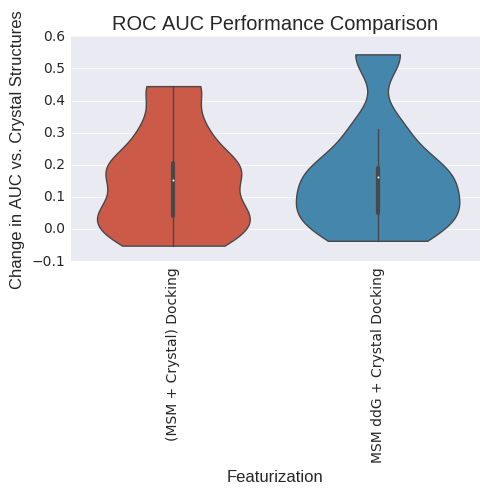

analyzing LogAUC
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.349399          0.000000   
(MSM + Crystal) Docking      0.461427          0.112028   
MSM ddG + Crystal Docking    0.463053          0.113654   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.808682796607, 0.960296239466)  
MSM ddG + Crystal Docking  (0.808682796607, 0.960296239466)  


ValueError: list.remove(x): x not in list

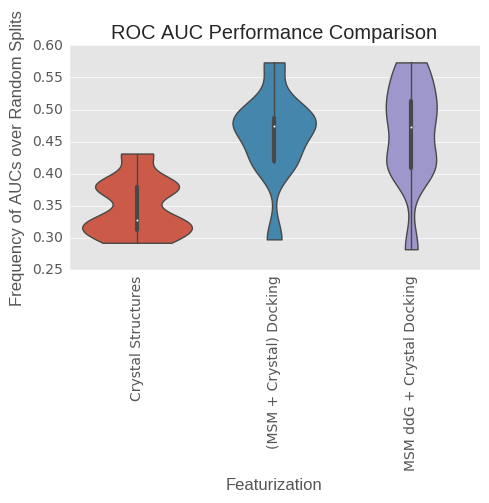

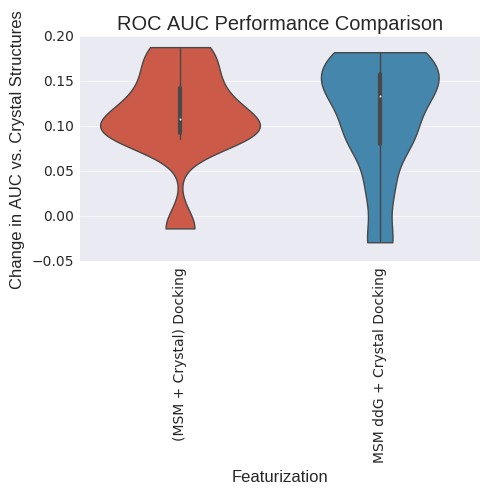

(2,)
(1, 2)


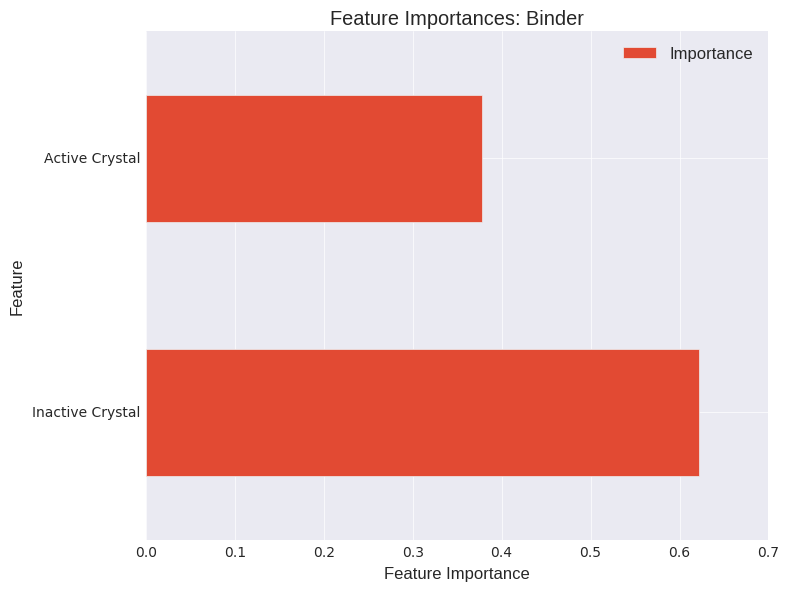

(27,)
(1, 27)


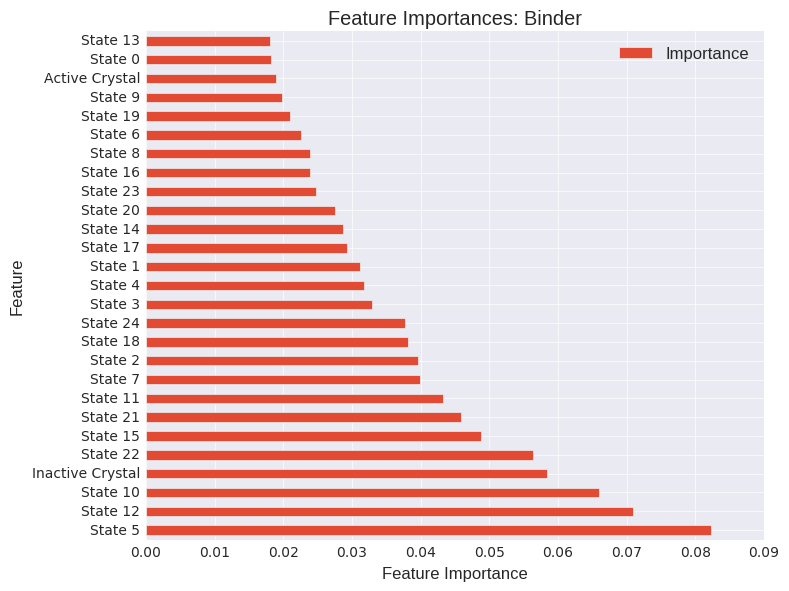

(52,)
(1, 52)


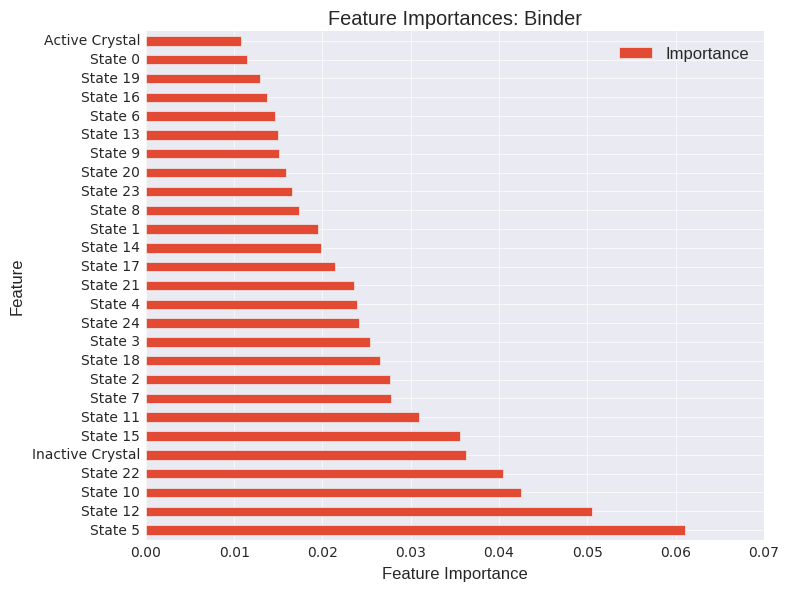

In [147]:
#XP, All ligands, LR three class, 32 stereoisomers; new crystal grids; 25 clusters

importance_dfs = analyze_multiclass_experiment(results_dict[save_name], 
                                                                feature_names,
                                                                [f.columns.values.tolist() for f in features], model_agonists, analysis_dir,
                                                                ["Non-binder", "Binder"], 
                                                                #["Gs Inactive", "Gs Active"], 
                                                               #["Arr Inactive", "Arr Active"],
                                               np.hstack([X_df.loc[model_agonists].values]),
                                                               #["Gs Inactive", "Gs Partial Active", "Gs Full Active"], 
                                              remake=False, fxn=np.mean)


#TRY LOOCV
#crystal structures might just have bigger boxes

analyzing precision at full recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.349915          0.000000   
(MSM + Crystal) Docking      0.502567          0.152653   
MSM ddG + Crystal Docking    0.500107          0.150192   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.798315598043, 0.859321050791)  
MSM ddG + Crystal Docking  (0.779214457552, 0.842659473219)  


ValueError: list.remove(x): x not in list

analyzing threshold at full recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.041106          0.000000   
(MSM + Crystal) Docking      0.116319          0.075213   
MSM ddG + Crystal Docking    0.117101          0.075995   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.862991200564, 0.913854508481)  
MSM ddG + Crystal Docking   (0.854258938094, 0.90669222959)  


ValueError: list.remove(x): x not in list

analyzing Accuracy:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.856696          0.000000   
(MSM + Crystal) Docking      0.911967          0.055272   
MSM ddG + Crystal Docking    0.914348          0.057652   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.941953258967, 0.973969686992)  
MSM ddG + Crystal Docking  (0.945511437373, 0.976371961597)  


ValueError: list.remove(x): x not in list

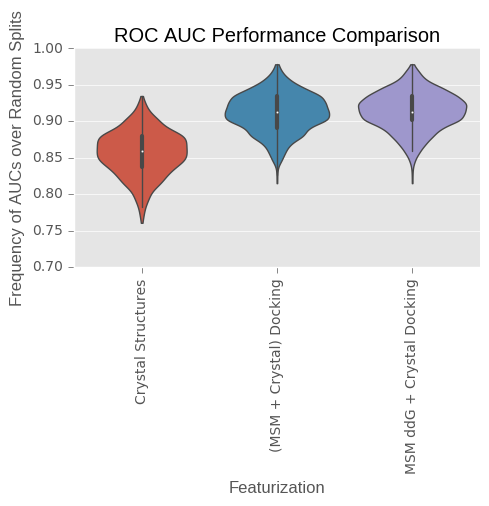

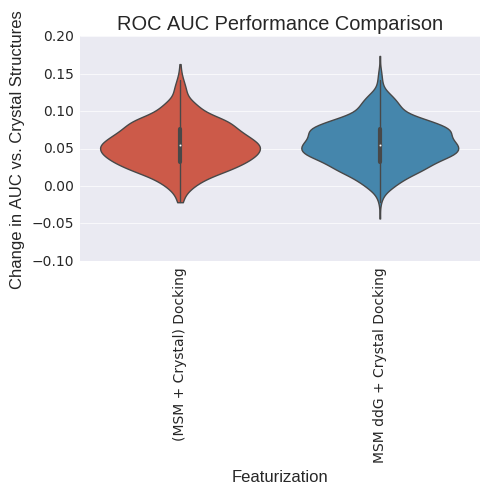

analyzing Recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.513125          0.000000   
(MSM + Crystal) Docking      0.680562          0.167437   
MSM ddG + Crystal Docking    0.698313          0.185188   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking     (0.83798690709, 0.893161995541)  
MSM ddG + Crystal Docking  (0.875067574914, 0.923633128504)  


ValueError: list.remove(x): x not in list

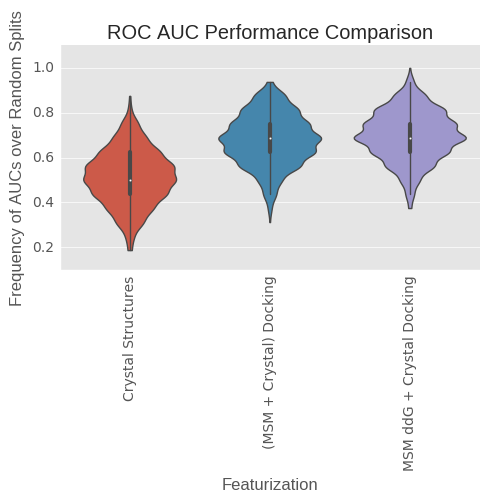

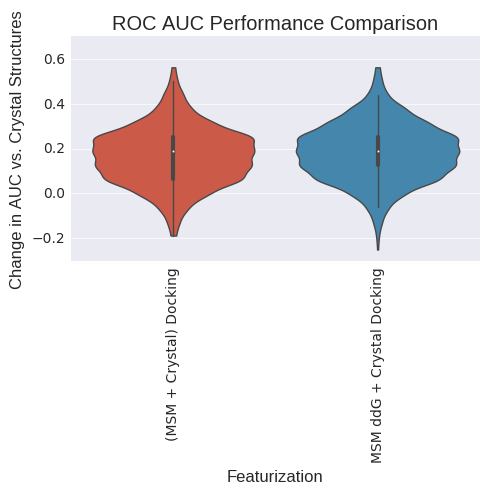

analyzing precision:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.613365          0.000000   
(MSM + Crystal) Docking      0.794387          0.181022   
MSM ddG + Crystal Docking    0.794988          0.181623   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking     (0.924476889047, 0.96164379186)  
MSM ddG + Crystal Docking  (0.923327169453, 0.960806693783)  


ValueError: list.remove(x): x not in list

Exception ignored in: <Finalize object, dead>
Traceback (most recent call last):
  File "/home/enf/anaconda3/lib/python3.5/multiprocessing/util.py", line 186, in __call__
    res = self._callback(*self._args, **self._kwargs)
  File "/home/enf/anaconda3/lib/python3.5/multiprocessing/pool.py", line 553, in _terminate_pool
    p.terminate()
  File "/home/enf/anaconda3/lib/python3.5/multiprocessing/process.py", line 113, in terminate
    self._popen.terminate()
AttributeError: 'NoneType' object has no attribute 'terminate'


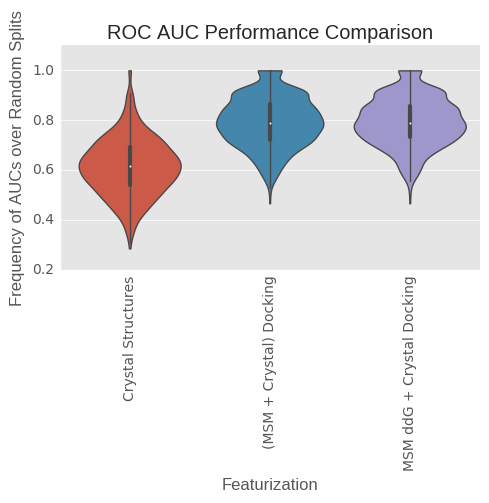

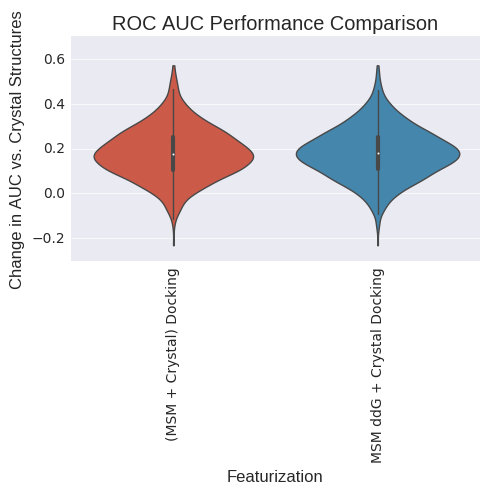

analyzing fdr:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.386635          0.000000   
(MSM + Crystal) Docking      0.205613         -0.181022   
MSM ddG + Crystal Docking    0.205012         -0.181623   

                                             Sign Test 99% CI  
Crystal Structures                                   (0, 0.0)  
(MSM + Crystal) Docking    (0.0292698163774, 0.0627545083443)  
MSM ddG + Crystal Docking  (0.0309036826382, 0.0650942774239)  


ValueError: list.remove(x): x not in list

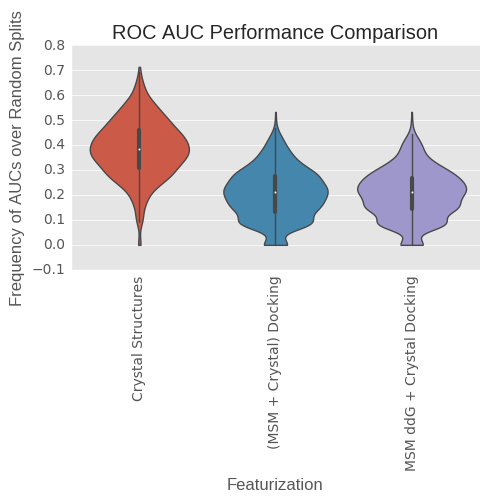

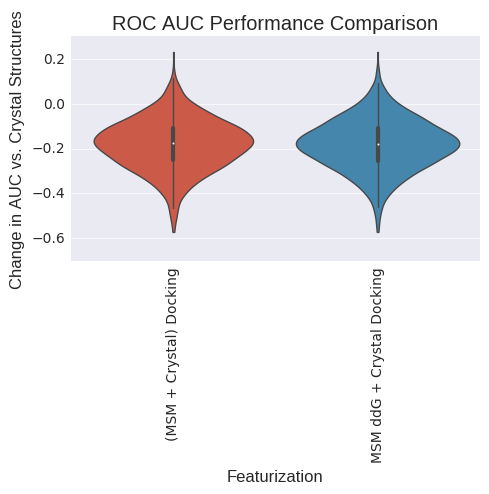

analyzing Recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.513125          0.000000   
(MSM + Crystal) Docking      0.680562          0.167437   
MSM ddG + Crystal Docking    0.698313          0.185188   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking     (0.83798690709, 0.893161995541)  
MSM ddG + Crystal Docking  (0.875067574914, 0.923633128504)  


ValueError: list.remove(x): x not in list

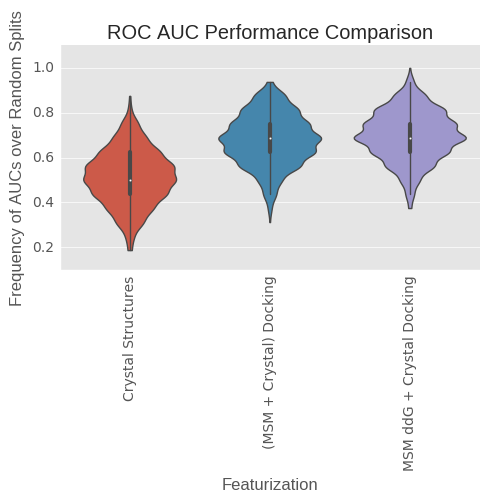

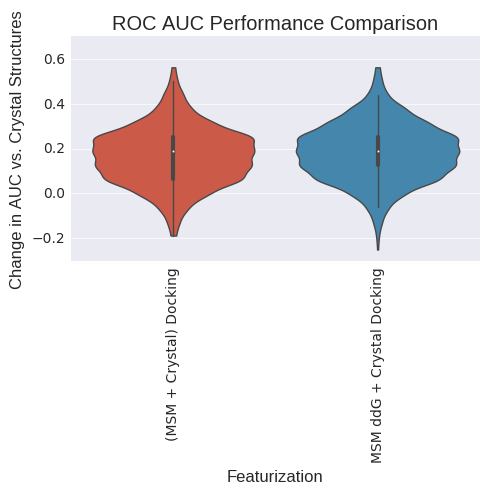

analyzing precision:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.613365          0.000000   
(MSM + Crystal) Docking      0.794387          0.181022   
MSM ddG + Crystal Docking    0.794988          0.181623   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking     (0.924476889047, 0.96164379186)  
MSM ddG + Crystal Docking  (0.923327169453, 0.960806693783)  


ValueError: list.remove(x): x not in list

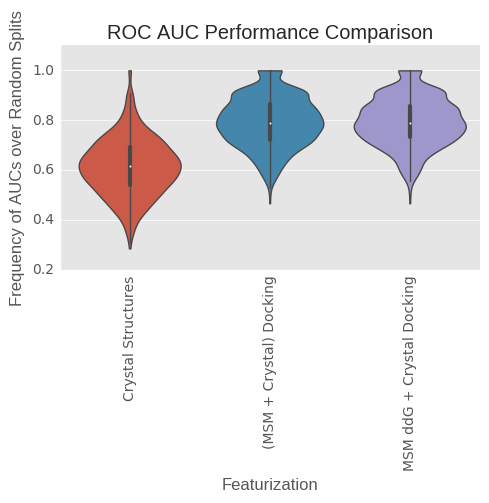

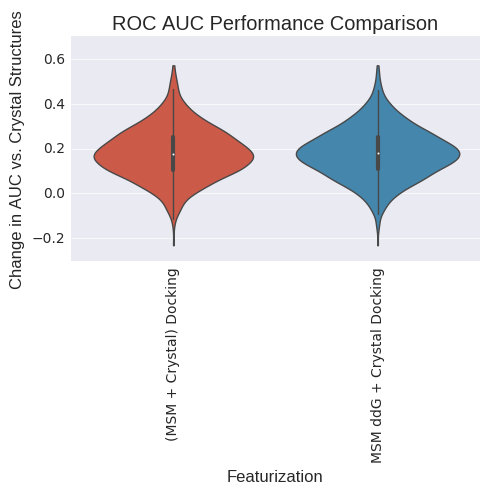

analyzing fdr:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.386635          0.000000   
(MSM + Crystal) Docking      0.205613         -0.181022   
MSM ddG + Crystal Docking    0.205012         -0.181623   

                                             Sign Test 99% CI  
Crystal Structures                                   (0, 0.0)  
(MSM + Crystal) Docking    (0.0292698163774, 0.0627545083443)  
MSM ddG + Crystal Docking  (0.0309036826382, 0.0650942774239)  


ValueError: list.remove(x): x not in list

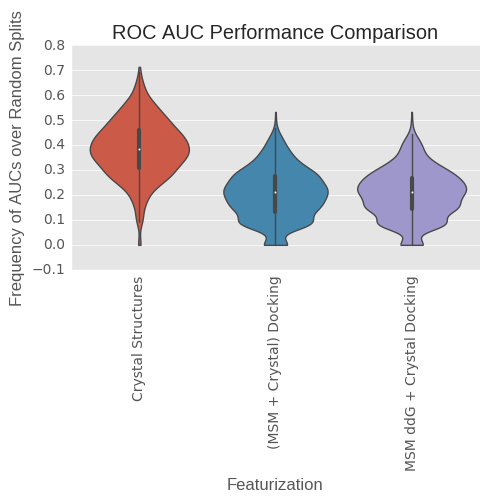

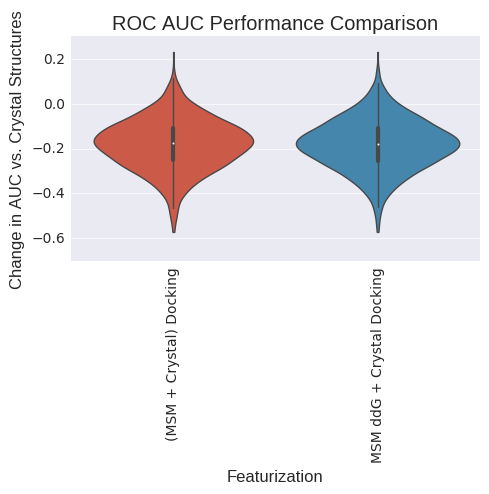

analyzing class B ROC AUC:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.894528          0.000000   
(MSM + Crystal) Docking      0.954152          0.059624   
MSM ddG + Crystal Docking    0.954993          0.060464   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking     (0.98224228856, 0.997258822845)  
MSM ddG + Crystal Docking  (0.979441479247, 0.996085996818)  


ValueError: list.remove(x): x not in list

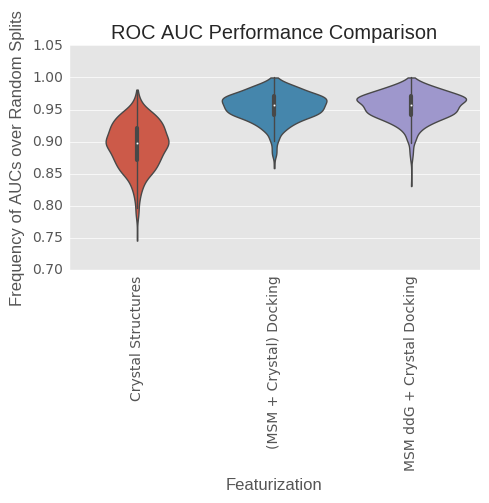

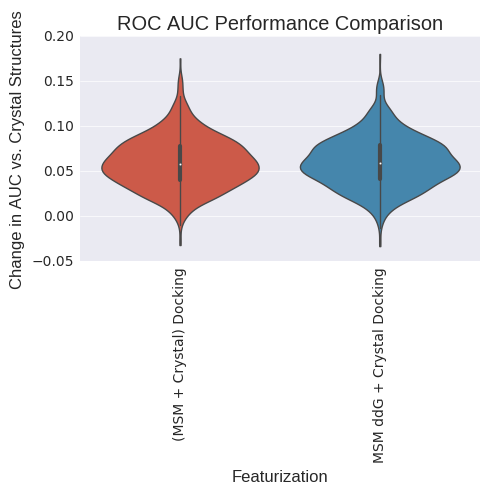

analyzing ROC AUC:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.894528          0.000000   
(MSM + Crystal) Docking      0.954152          0.059624   
MSM ddG + Crystal Docking    0.954993          0.060464   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking     (0.98224228856, 0.997258822845)  
MSM ddG + Crystal Docking  (0.979441479247, 0.996085996818)  


ValueError: list.remove(x): x not in list

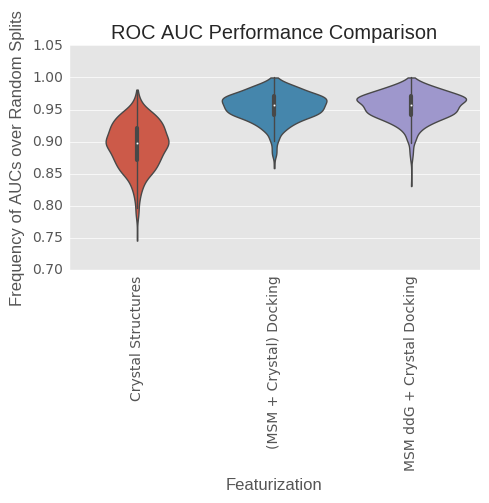

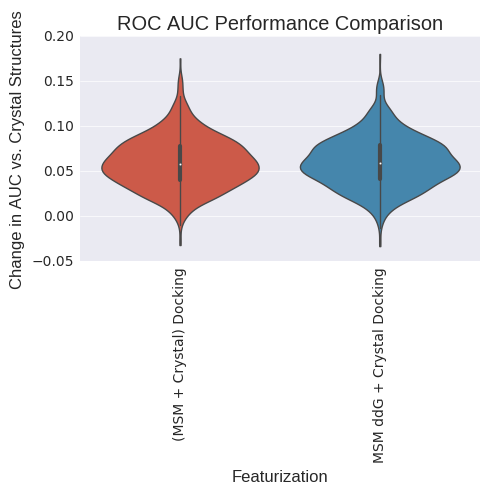

analyzing BedROC
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.703075          0.000000   
(MSM + Crystal) Docking      0.880994          0.177919   
MSM ddG + Crystal Docking    0.886461          0.183386   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.930251610792, 0.965803158465)  
MSM ddG + Crystal Docking  (0.926781415866, 0.963312900381)  


ValueError: list.remove(x): x not in list

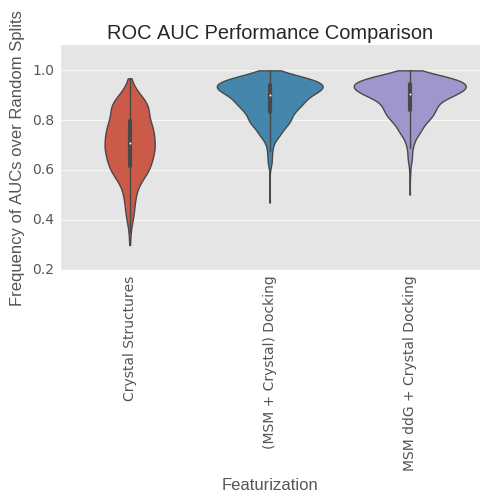

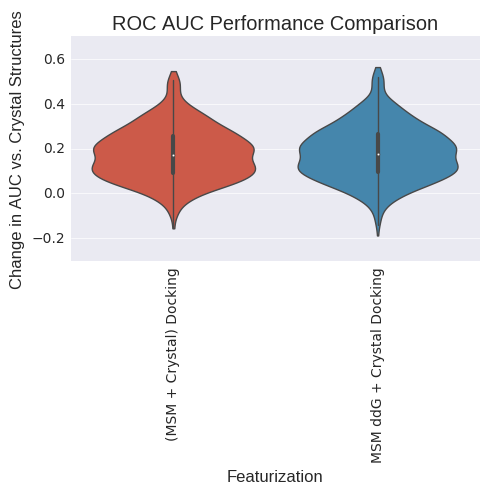

analyzing LogAUC
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.408985          0.000000   
(MSM + Crystal) Docking      0.503703          0.094717   
MSM ddG + Crystal Docking    0.504194          0.095209   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.919887690222, 0.958285720003)  
MSM ddG + Crystal Docking  (0.919887690222, 0.958285720003)  


ValueError: list.remove(x): x not in list

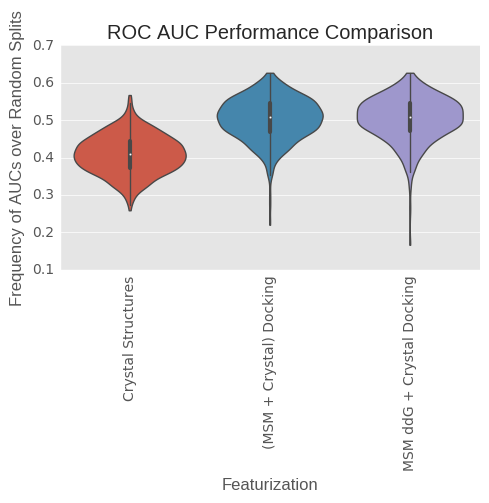

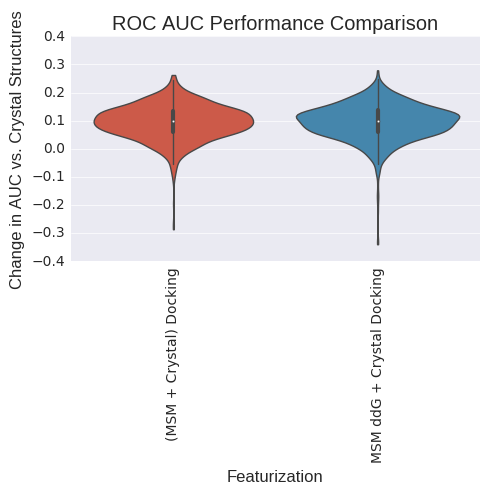

(2,)
(1, 2)


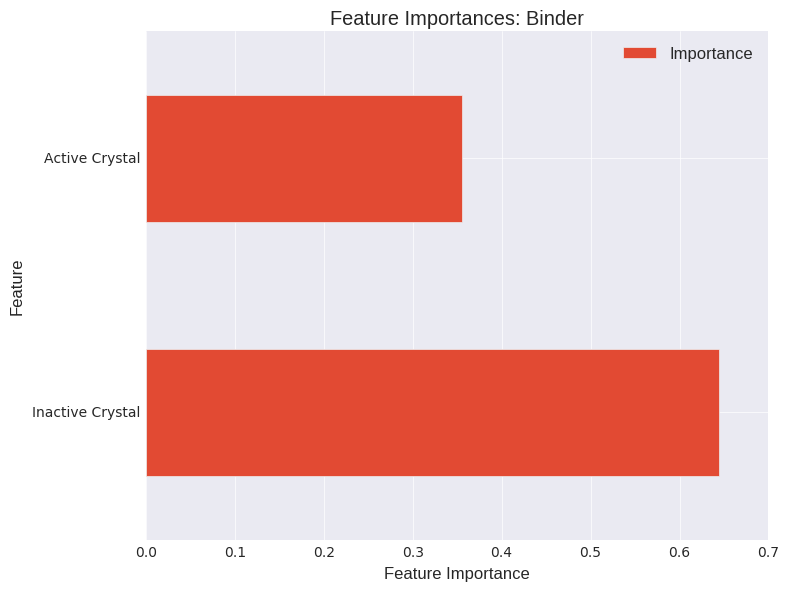

(27,)
(1, 27)


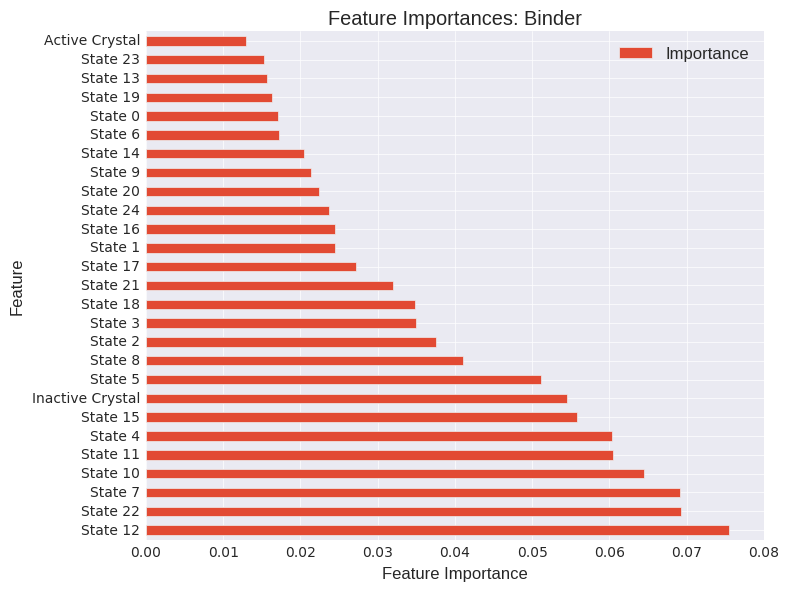

(52,)
(1, 52)


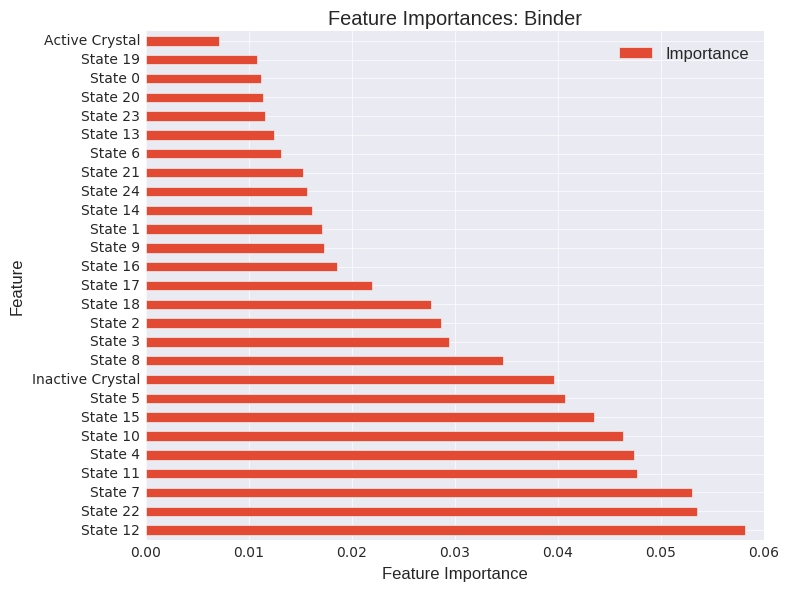

In [372]:
#SP, All ligands, RF three class, 32 stereoisomers; new crystal grids; 25 clusters

importance_dfs = analyze_multiclass_experiment(results_dict[save_name], 
                                                                feature_names,
                                                                [f.columns.values.tolist() for f in features], model_agonists, analysis_dir,
                                                                ["Non-binder", "Binder"], 
                                                                #["Gs Inactive", "Gs Active"], 
                                                               #["Arr Inactive", "Arr Active"],
                                               np.hstack([X_df.loc[model_agonists].values]),
                                                               #["Gs Inactive", "Gs Partial Active", "Gs Full Active"], 
                                              remake=False, fxn=np.mean)


#TRY LOOCV
#crystal structures might just have bigger boxes

In [375]:
X_df.sort("State 12", inplace=False, ascending=False).iloc[:10]

,Inactive Crystal,Active Crystal,State 0,State 10,State 11,State 12,State 13,State 14,State 15,State 16,State 17,State 18,State 19,State 1,State 20,State 21,State 22,State 23,State 24,State 2,State 3,State 4,State 5,State 6,State 7,State 8,State 9
CHEMBL3298324,10.68,-0.00,8.10,11.28,8.92,13.64,9.07,8.93,8.24,11.30,12.12,11.40,9.17,11.18,9.14,10.18,11.94,6.48,7.32,10.07,8.64,11.53,10.86,6.60,9.46,8.79,9.20
CID_6918554,9.10,8.83,11.18,9.74,9.93,12.30,11.19,10.28,10.28,10.22,8.26,10.77,10.07,10.54,9.41,7.19,11.55,9.64,10.06,9.42,10.66,12.47,10.11,9.51,10.91,11.05,9.57
CHEMBL2088199,8.88,9.45,11.48,9.61,10.56,12.03,10.10,10.14,9.45,9.88,8.49,9.90,9.48,10.42,10.05,7.07,9.44,9.81,8.89,8.90,9.22,12.30,9.33,12.34,11.28,13.10,11.09
CID_46221603,8.78,9.65,10.78,9.97,10.19,11.99,10.48,10.16,9.69,10.50,8.48,10.16,9.42,9.68,9.65,6.84,9.57,9.50,10.09,9.25,10.11,12.12,9.83,12.48,10.85,11.40,10.93
CID_46221396,8.47,8.61,10.77,9.81,10.16,11.85,10.76,9.62,9.06,9.30,8.24,9.02,9.73,10.16,8.70,8.62,9.10,9.77,9.19,8.18,11.33,12.35,9.78,10.63,10.59,11.08,9.82
CID_11962616,9.01,10.45,9.52,10.29,7.83,11.76,9.33,9.38,7.94,9.72,9.76,9.88,8.37,10.31,7.70,8.42,9.42,9.82,10.12,8.64,10.70,12.59,8.05,10.75,9.73,11.38,8.23
CID_46221395,8.82,10.65,10.86,9.42,9.85,11.67,10.63,10.95,8.90,10.86,8.55,9.43,9.38,9.86,7.75,7.51,10.20,9.34,9.48,9.15,10.72,11.34,9.85,10.99,11.00,12.58,11.14
CID_9829836,10.11,-0.00,-0.00,6.24,-0.00,11.59,-0.00,5.52,10.18,-0.00,8.23,4.06,6.69,7.78,6.73,8.18,5.84,-0.00,8.36,8.77,7.02,-0.00,9.71,4.76,-0.00,10.66,5.91
CID_10231679,9.05,-0.00,9.62,9.44,8.41,11.56,10.44,7.35,8.47,9.10,10.14,11.00,7.58,10.37,8.47,8.34,10.16,8.96,8.59,6.95,7.15,8.69,11.15,8.31,7.90,10.63,8.64
CHEMBL3298326,11.20,-0.00,8.67,8.60,9.46,11.38,10.06,8.57,8.21,9.53,9.53,11.58,9.93,10.85,8.25,10.42,9.27,4.81,10.89,10.38,10.74,11.16,9.51,10.79,11.93,11.47,8.79


In [163]:
#model = results_dict[save_name]['Crystal Structures'][0]
#model = results_dict[save_name]['(MSM + Crystal) Docking'][0]
model = results_dict[save_name]['MSM ddG + Crystal Docking'][0]


y_proba =model.predict_proba(ddg_df.values)
#bias_test_df = pd.DataFrame(y_proba, index=X_df.index, columns=["class A", "class B", "class C"]).sort("class B", ascending=False, inplace=False)
aff_test_df = pd.DataFrame(y_proba, index=ddg_df.index, columns=["P(Non-binder)", "P(Binder)"]).sort("P(Binder)", ascending=False, inplace=False)
#eff_test_df = pd.DataFrame(y_proba, index=X_df.index, columns=["P(Antagonist)", "P(Gs Biased Agonist)", "P(Balanced Agonist)"]).sort("P(Gs Biased Agonist)", ascending=False, inplace=False)
#eff_test_df = pd.DataFrame(y_proba, index=X_df.index, columns=["P(Antagonist)", "P(Gs Agonist)"]).sort("P(Gs Agonist)", ascending=False, inplace=False)


test_inactives = ["std101d1", "std101d4"] #+ [n for n in remove_ligands if n in chembl_inactives]
test_actives = ["ks01506", "ks01505", "std101c4", "ksn010118", "ksn010115"]# + [n for n in remove_ligands if n in chembl_actives]

#test_inactives = ["std101d1", "std101d4"] #+ [n for n in full_docking_df.index if n in remove_ligands and n in chembl_inactives]
#test_actives = ["ks01506", "ks01505", "std101c4", "ksn010118", "ksn010115"] #+ [n for n in full_docking_df.index if n in remove_ligands and n in chembl_actives]
test_df = pd.DataFrame([0. for i in test_inactives] + [1. for j in test_actives], index=test_inactives+test_actives, columns=["action"])
roc_auc_score(test_df.values.reshape((-1,1)), aff_test_df.loc[test_df.index].values[:,1])


#y_proba =model.predict_proba(C_df.values)
#bias_test_df = pd.DataFrame(y_proba, index=C_df.index, columns=["class A", "class B"]).sort("class B", ascending=False, inplace=False)

0.90000000000000002

In [127]:
set(chembl_inactives).intersection(set(chembl_actives))

set()

In [155]:
aff_test_df.loc[list(set([n for n in aff_test_df.index.values if "ks" in n or "std" in n or (n in bret.index and n not in model_agonists)]))].sort("P(Non-binder)", inplace=False)

,P(Non-binder),P(Binder)
CID_2585,0.160,0.840
CID_3609,0.341,0.659
ks01506,0.405,0.595
CID_5478,0.425,0.575
CID_170373,0.426,0.574
CID_123686,0.440,0.560
CID_23844,0.456,0.544
CID_3343,0.459,0.541
CID_2755,0.463,0.537
ks01505,0.493,0.507


In [633]:
set(train_ligands).intersection(set(test_ligands))

set()

In [178]:
from sklearn import preprocessing

from importlib import reload
import efficacy_scripts
reload(efficacy_scripts)
from efficacy_scripts import *


top_clusters = delta_delta_g.index.values
y_arr = bret[arr_col].loc[common_ligands].values.reshape((-1,1))
y_gpr = bret[gprot_col].loc[common_ligands].values.reshape((-1,1))
y_ori = y_gpr - y_arr
#y_ori = y_arr
#y = preprocessing.binarize(bret[gprot_col].loc[common_ligands].values, .2).reshape((-1,1))
diff_cutoff = 0.5
abs_cutoff = 0.2

inactive_ligands = [n for n in full_docking_df.index.values.tolist() if "inactive" in n]

def generate_bias_features_new(bret, gprot_col, arr_col, common_ligands, diff_cutoff, abs_cutoff, buffer=0.05):
    agonists = bret.loc[bret[gprot_col] > (abs_cutoff+buffer)].index.values.tolist()
    gs_biased_agonists = bret.loc[(bret[gprot_col] > (abs_cutoff+buffer)) & (bret[arr_col].divide(bret[gprot_col]) < (diff_cutoff-buffer))].index.values.tolist()
    neutral_agonists = bret.loc[(bret[gprot_col] > (abs_cutoff+buffer)) & (bret[arr_col].divide(bret[gprot_col]) > (diff_cutoff+buffer))].index.values.tolist()
    antagonists = bret.loc[bret[gprot_col] < (abs_cutoff-buffer)].index.values.tolist()
    y = np.array([1. for a in gs_biased_agonists] + [0. for b in antagonists] + [2. for c in neutral_agonists]).reshape((-1,1))
    y_df = pd.DataFrame(y, index = gs_biased_agonists + antagonists + neutral_agonists, columns=["class"])
    return y, y_df

def generate_three_class_agonist(bret, gprot_col, common_ligands, cutoff_a, cutoff_b, buffer=0.05):
    full_agonists = bret.loc[bret[gprot_col] > (cutoff_b+buffer)].index
    antagonists = bret.loc[bret[gprot_col] < (cutoff_a-buffer)].index
    partial_agonists = bret.loc[(bret[gprot_col] > (cutoff_a+buffer)) & (bret[gprot_col] < (cutoff_b-buffer))].index
    
    y = np.array([1. for a in partial_agonists] + [0. for b in antagonists] + [2. for c in full_agonists]).reshape((-1,1))
    y_df = pd.DataFrame(y, index = partial_agonists + antagonists + full_agonists, columns=["class"])
    return y, y_df

def generate_biased_agonist_features(bret, gprot_col, arr_col, common_ligands, diff_cutoff, abs_cutoff, buffer=0.05):
    #gs_biased_agonists = bret.loc[(bret[gprot_col] > (abs_cutoff+buffer)) & (bret[gprot_col].subtract(bret[arr_col]) > (diff_cutoff-buffer))].index
    #neutral_agonists = bret.loc[(bret[gprot_col] > (abs_cutoff+buffer)) & (bret[gprot_col].subtract(bret[arr_col]) < (diff_cutoff+buffer))].index
 
    gs_biased_agonists = bret.loc[(bret[gprot_col] > (abs_cutoff+buffer)) & (bret[arr_col].divide(bret[gprot_col]) < (diff_cutoff-buffer))].index.values.tolist()
    neutral_agonists = bret.loc[(bret[gprot_col] > (abs_cutoff+buffer)) & (bret[arr_col].divide(bret[gprot_col]) > (diff_cutoff+buffer))].index.values.tolist()
    y = np.array([1. for a in gs_biased_agonists] + [0. for c in neutral_agonists]).reshape((-1,1))
    y_df = pd.DataFrame(y, index = gs_biased_agonists + neutral_agonists, columns=["class"])
    return y, y_df

def generate_agonist_features(bret, col, common_ligands, abs_cutoff, buffer=0.05):
    agonists = bret.loc[bret[col] > (abs_cutoff+buffer)].index.values.tolist()
    antagonists = bret.loc[bret[col] < (abs_cutoff-buffer)].index.values.tolist()
    y = np.array([1. for a in agonists] + [0. for c in antagonists]).reshape((-1,1))
    y_df = pd.DataFrame(y, index = agonists+antagonists, columns=["class"])
    return y, y_df
    
def generate_bias_features(bret, gprot_col, arr_col, common_ligands, diff_cutoff=0.3, abs_cutoff=0.2):
    total_activity = bret[arr_col].loc[common_ligands].add(bret[gprot_col].loc[common_ligands])
    #common_agonists = set(bret.loc[bret[arr_col] > abs_cutoff].index.values.tolist()).union(set(bret.loc[bret[gprot_col] > abs_cutoff].index.values.tolist()))
    common_agonists = bret.loc[bret[gprot_col] > abs_cutoff].index.values.tolist()# total_activity.loc[total_activity > abs_cutoff].index.values
    y = np.zeros(len(common_ligands)).reshape((-1,1))
    y_arr = bret[arr_col].loc[common_ligands].values.reshape((-1,1))
    y_gpr = bret[gprot_col].loc[common_ligands].values.reshape((-1,1))
    for idx, lig in enumerate(common_ligands):
        if lig in common_agonists:
            if y_gpr[idx] - y_arr[idx] > diff_cutoff:
            #if (1. / y_gpr[idx]) * (y_arr[idx]) < diff_cutoff:
                y[idx] = 1.
            else:
                y[idx] = 0.
        else:
            y[idx] = 2.

    y_df = pd.DataFrame(y, index=common_ligands, columns=["class"])
    y = y_df.values.reshape((-1,1))
    return y, y_df
total_activity = bret[arr_col].loc[common_ligands].add(bret[gprot_col].loc[common_ligands])
model_agonists = bret.loc[bret[gprot_col] > 0.4].index.values.tolist()
#model_agonists = copy.deepcopy(common_ligands)

#y, y_df = generate_bias_features(bret, gprot_col, arr_col, model_agonists, diff_cutoff=0.3, abs_cutoff=0.4)

y, y_df = generate_bias_features_new(bret, gprot_col, arr_col, model_agonists,
                                 diff_cutoff=0.75, abs_cutoff=0.2, buffer=0.05)
#y, y_df = generate_biased_agonist_features(bret, gprot_col, arr_col, model_agonists,
#                                           diff_cutoff=0.75, abs_cutoff=0.2, buffer=0.05)
#y, y_df = generate_agonist_features(bret, gprot_col, common_ligands, abs_cutoff=0.2, buffer=0.05)

#y, y_df = generate_three_class_agonist(bret, gprot_col, common_ligands, cutoff_a=0.2, cutoff_b=0.8, buffer=0.05)

model_agonists = y_df.index.values.tolist()
#y_df = y_df.loc[[n for n in y_df.index if n != "CID_5152" and n != "CID_2083" and n != "CID_2585" and n != "CID_3779"]]
#y_df.loc["CID_5152"] = 1.
#y = y_df.values.reshape((-1,1))
#model_agonists = y_df.index.values.tolist()

cutoff = [0.2]
#y = multi_binarizer(y_gpr, cutoff)
#y = multi_binarizer(y_arr, cutoff)

#y_df = pd.DataFrame(y, index=common_ligands, columns=["class"])

#inactive_df = pd.DataFrame(np.array([0. for i in range(0, len(inactive_ligands))]).reshape((-1,1)), columns=["class"], index=inactive_ligands)
#y_df = pd.concat([y_df, inactive_df], axis=0)
#y = y_df.values
#model_agonists += inactive_ligands

def replace_columns(X_df):
    old_cols = X_df.columns.values.tolist()
    new_cols = []
    for col in old_cols:
        if "2rh1" in col.lower():
            col = "Inactive Crystal"
        if "3p0g" in col.lower():
            col = "Active Crystal"
        if "null" in col:
            col = "difference"
        if "cluster" in col:
            col = col.replace("cluster", "State ")
        new_cols.append(col)
    X_df.columns = new_cols
    #X_df["difference"] = X_df["Active Crystal"].subtract(X_df["Inactive Crystal"])
    return(X_df)

X_df = copy.deepcopy(full_docking_df)
X_df = X_df[[n for n in X_df.columns if "-" not in n]]
X_df = replace_columns(X_df)

chembl

new_df = add_difference_columns(X_df)
ddg_df = new_df#standardize_df(obs_df)#[[n for n in obs_df.columns.values if "c" in n and ("Asn148" in n or "Leu266" in n)]]# pd.concat([X_df, X_onehot_df], axis=1)
#ddg_df = new_docking_df
#ddg_df = replace_columns(ddg_df)
#ddg_df[[c for c in ddg_df.columns.values if "state" in c.lower()]] = ddg_df[[c for c in ddg_df.columns.values if "state" in c.lower()]].multiply(-1.0)
#ddg_df[[c for c in ddg_df.columns.values if "state" in c.lower()]] = eq_pops_df.loc[common_agonists]

C_df = new_df[[c for c in new_df.columns.values.tolist() if "State" not in c]]
X_df["Active Crystal-Inactive Crystal"] = C_df["Active Crystal-Inactive Crystal"]

C_df = C_df[[n for n in C_df.columns if "-" in n]]
ddg_df = ddg_df[[n for n in ddg_df.columns if "-" in n]]


X = X_df.values
ddg = ddg_df.values

feature_names = ["Crystal Structures", "(MSM + Crystal) Docking", "MSM ddG + Crystal Docking"]#, "MSM Features Reweighted"]#, "Docking ddG and Observables"]


n_trials = 1000
train_test_split_prop = 0.8
model_type = "rfr"
def normalize_per_ligand(df):
    new_df = copy.deepcopy(df)
    n_df = new_df.ix[:, [i for i in range(0, new_df.shape[1]) if "difference" not in new_df.columns.values[i].lower()]]
    n_df = pd.DataFrame(preprocessing.scale(n_df.values, axis=1), index=n_df.index, columns=n_df.columns.values.tolist())
    new_df = pd.concat([new_df, n_df], axis=1)
    return(new_df)

normalize = False
normalize_axis0 = True
if normalize_axis0:
    double_features = 2
    X_df = normalize_per_ligand(X_df)
    #ddg_df = normalize_per_ligand(ddg_df)
else: 
    double_features = 1
n_estimators = 1000
#ddg_df = pd.concat([ddg_df, X_df.ix[:, [i for i in range(0, X_df.shape[1]) if "state" in X_df.columns.values[i].lower()]]], axis=1)

features = [C_df.loc[model_agonists], X_df.loc[model_agonists], ddg_df.loc[model_agonists]]#, all_features_df]#, all_features]
print([f.shape for f in features])
#save_name = "arr-cutoff%s_%s_trials%d_split%s" %(str(cutoff), model_type, n_trials, str(train_test_split_prop))
save_name = "antagonist_vs_agonist_vs_dud-%s_%s_trials%d_split%s_normalize%s_normalize-axis0%s_n-estimators%d_precision%s" %(str(diff_cutoff), model_type, n_trials, str(train_test_split_prop), str(normalize), str(normalize_axis0), n_estimators, precision)
#save_name = "a_vs_g_vs_inactive-%s_%s_trials%d_split%s_normalize%s_normalize-axis0%s_n-estimators%d_precision%s" %(str(diff_cutoff), model_type, n_trials, str(train_test_split_prop), str(normalize), str(normalize_axis0), n_estimators, precision)
results_dict[save_name] = generate_or_load_model(features, y, feature_names,
                                                 n_trials, train_test_split_prop, False,
                                                 model_type, "%s/%s.pkl" %(analysis_dir, save_name),
                                                 redo=True, worker_pool=dview, parallel=False, n_estimators=n_estimators, 
                                                 max_depth=None, criterion='gini',
                                                 normalize=normalize, normalize_axis0=False,
                                                 loocv=False, penalty='12')


0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
[(43, 1), (43, 56), (43, 351)]
Aobut to fit model(s).
Fitting models over all data...
Fitting models over split train data...
Finished fitting models


In [61]:
bret.loc[y_df.index]

,Number,PaperName,Abbreviation,"B2AR-Gprotein, Mean","B2AR-Gprotein, IA(from CR curves) Mean","B2AR-Gprotein, Log(EC50), Mean","B2AR-Arrestin, Mean","B2AR-Arrestin, IA(from CR curves) Mean","B2AR-Arrestin, Log(EC50), Mean","B1AR-Gprotein, Mean","B1AR-Gprotein, IA(from CR curves) Mean","B1AR-Gprotein, Log(EC50), Mean","B1AR-Arrestin, Mean","B1AR-Arrestin, IA(from CR curves) Mean","B1AR-Arrestin Log(EC50), Mean",CID
CID_7436,1,Adrenalone,ADO,1.01,1,-6.52,0.95,0.94,-5.4,0.62,0.99,-4.8,0.66,0.87,-4.52,7436
CID_10443654,2,AH 3021,AH30,0.89,0.74,-6.93,0.31,0.3,-6.36,0.42,0.47,-5.81,0.53,0.52,-5.99,10443654
CID_161394,3,AH 3474A,AH34,-0.02,-,-,0.00,-,-,-0.01,-,-,0.02,-,-,161394
CID_2083,4,Albuterol (Salbutamol),ALB,0.81,0.64,-7.17,0.29,0.31,-6.69,0.35,0.4,-5.47,0.37,0.36,-5.86,2083
CID_2119,5,Alprenolol,ALP,0.05,-,-,0.00,-,-,0.09,-,-,0.05,-,-,2119
CID_2249,6,Atenolol,ATE,0.03,-,-,0.00,-,-,-0.01,-,-,-0.01,-,-,2249
CID_2405,7,Bisoprolol,BIS,-0.03,-,-,0.00,-,-,-0.01,-,-,-0.02,-,-,2405
CID_18026,8,Butoxamine (Butaxamine),BUTX,-0.02,-,-,0.00,-,-,0.02,-,-,0.02,-,-,18026
CID_5606,9,C78 (Tulobuterol),C78,0.47,0.36,-7.29,0.03,-,-,0.17,0.21,-5.42,0.24,0.33,-5.59,5606
CID_2585,10,Carvedilol,CARV,-0.01,-,-,0.00,-,-,0.10,-,-,0.04,-,-,2585


In [181]:
#model = results_dict[save_name]['Crystal Structures'][0]
model = results_dict[save_name]['(MSM + Crystal) Docking'][0]
#model = results_dict[save_name]['MSM ddG + Crystal Docking'][0]


y_proba =model.predict_proba(X_df.values)
#bias_test_df = pd.DataFrame(y_proba, index=X_df.index, columns=["class A", "class B", "class C"]).sort("class B", ascending=False, inplace=False)
eff_test_df = pd.DataFrame(y_proba, index=X_df.index, columns=["P(Balanced Agonist)", "P(Gs Biased Agonist)", "P(Antagonist)"]).sort("P(Gs Biased Agonist)", ascending=False, inplace=False)
#eff_test_df = pd.DataFrame(y_proba, index=X_df.index, columns=["P(Antagonist)", "P(Gs Biased Agonist)", "P(Balanced Agonist)"]).sort("P(Gs Biased Agonist)", ascending=False, inplace=False)
#eff_test_df = pd.DataFrame(y_proba, index=X_df.index, columns=["P(Antagonist)", "P(Gs Agonist)"]).sort("P(Gs Agonist)", ascending=False, inplace=False)


test_inactives = ["std101d1", "std101d4"] + chembl_inactives
test_actives = ["ks01506", "ks01505", "std101c4", "ksn010118", "ksn010115"] + chembl_actives


In [182]:
#print(smiles_strings[:2])
df = copy.deepcopy(eff_test_df)
smiles_strings = convert_compounds_in_dir_to_smiles(df.index.values.tolist(), "/home/enf/b2ar_analysis/all_ligands/32-stereoisomers_6-ring-conf", parallel=False, worker_pool=dview)
results = convert_smiles_to_compounds(smiles_strings, parallel=False, worker_pool=dview)
names = [c[0] for c in results]
df["names"] = names
df["smiles"] = smiles_strings



In [183]:
mols = []
for x in df["smiles"].values.tolist():
    try:
        mols.append(pybel.readstring("smi", x))
    except:
        mols.append("")
df["mols"] = mols

In [188]:
sub_docking_df = df.loc[df["mols"] != ""]

fps = [x.calcfp(fptype='FP4') for x in sub_docking_df["mols"].values.tolist()] # Calculate their fingerprints

similarity_matrix = np.zeros((len(fps), len(bret.index.values)))
remove_ligands = []
ligs = sub_docking_df.index.values
bret_ligs = bret.index.values

for i in range(0, len(fps)):
    print(i)
    for j in range(0, len(bret_ligs)):
        if i == j:
            continue
        if ligs[j] not in bret_ligs:
            continue
        similarity_matrix[i][j] = fps[i] | fps[j]
        if similarity_matrix[i][j] > 0.9:
            remove_ligands.append(ligs[i])
similarity_df = pd.DataFrame(similarity_matrix, index=ligs, columns=bret_ligs)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

In [185]:
similarity_df.loc[["CHEMBL1221540", "CHEMBL250352", "CID_4845"]].max(axis=1)

CHEMBL1221540    0.545455
CHEMBL250352     0.555556
CID_4845         0.785714
dtype: float64

In [186]:
df.iloc[:10]

,P(Balanced Agonist),P(Gs Biased Agonist),P(Antagonist),names,smiles,mols
CID_2083,0.017,0.934,0.049,Salbutamol,OCc1cc(ccc1O)C(CNC(C)(C)C)O\t2083\n,OCc1cc(ccc1O)C(CNC(C)(C)C)O\t2083\n
CID_171674,0.018,0.912,0.070,,CC(=O)O.OCc1nc(ccc1O)C(CNC(C)(C)C)O\t171674\n,CC(=O)O.OCc1nc(ccc1O)C(CNC(C)(C)C)O\t171674\n
CID_23844,0.002,0.911,0.087,,OC(c1ccc(cc1)O)CNC(C)(C)C\t23844\n,OC(c1ccc(cc1)O)CNC(C)(C)C\t23844\n
CID_5403,0.022,0.894,0.084,,OC(c1cc(O)cc(c1)O)CNC(C)(C)C\t5403\n,OC(c1cc(O)cc(c1)O)CNC(C)(C)C\t5403\n
CID_2783,0.051,0.893,0.056,,OC(c1cc(Cl)c(c(c1)Cl)N)CNC(C)(C)C\t2783\n,OC(c1cc(Cl)c(c(c1)Cl)N)CNC(C)(C)C\t2783\n
CID_5702273,0.051,0.893,0.056,,OC(c1cc(Cl)c(c(c1)Cl)N)CNC(C)(C)C.Cl\t5702273\n,OC(c1cc(Cl)c(c(c1)Cl)N)CNC(C)(C)C.Cl\t5702273\n
CID_2755,0.040,0.888,0.072,,N#Cc1cc(ccc1N)C(CNC(C)C)O\t2755\n,N#Cc1cc(ccc1N)C(CNC(C)C)O\t2755\n
CID_23843,0.020,0.887,0.093,,OC(c1ccc(cc1)O)CNC(C)C\t23843\n,OC(c1ccc(cc1)O)CNC(C)C\t23843\n
CID_217246,0.042,0.884,0.074,,OC(c1cc(Cl)c(c(c1)Cl)N)CNC(C)C\t217246\n,OC(c1cc(Cl)c(c(c1)Cl)N)CNC(C)C\t217246\n
CID_10087493,0.010,0.882,0.108,,OC(c1ccc(c(c1)N)O)CNC(C)(C)C\t10087493\n,OC(c1ccc(c(c1)N)O)CNC(C)(C)C\t10087493\n


In [192]:
remove_ligands

['CID_2083',
 'CID_2083',
 'CID_2083',
 'CID_2083',
 'CID_2083',
 'CID_23844',
 'CID_23844',
 'CID_23844',
 'CID_23844',
 'CID_23844',
 'CID_23844',
 'CID_23844',
 'CID_5403',
 'CID_5403',
 'CID_5403',
 'CID_5403',
 'CID_5403',
 'CID_5403',
 'CID_5403',
 'CID_2783',
 'CID_2783',
 'CID_5702273',
 'CID_5702273',
 'CID_5702273',
 'CID_23843',
 'CID_23843',
 'CID_23843',
 'CID_23843',
 'CID_23843',
 'CID_23843',
 'CID_23843',
 'CID_217246',
 'CID_217246',
 'CID_10087493',
 'CID_10087493',
 'CID_10087493',
 'CID_10087493',
 'CID_10087493',
 'CID_65324',
 'CID_10443654',
 'CID_10443654',
 'CID_10443654',
 'CID_10443654',
 'CID_10443654',
 'CID_31728',
 'CID_4086',
 'CID_4086',
 'CID_4086',
 'CID_4086',
 'CID_4086',
 'CID_4086',
 'CID_4086',
 'CID_10353067',
 'CID_10353067',
 'CID_10353067',
 'CID_10353067',
 'CID_10353067',
 'CID_5606',
 'CID_5606',
 'CID_5702285',
 'CID_5702285',
 'CID_5702285',
 'CID_6603122',
 'CID_6603122',
 'CID_6603122',
 'CID_6603122',
 'CID_6603122',
 'CID_73416949',

In [196]:
df.loc[[n for n in df.index if n not in bret.index]]

,P(Balanced Agonist),P(Gs Biased Agonist),P(Antagonist),names,smiles,mols
CID_171674,0.018,0.912,0.070,,CC(=O)O.OCc1nc(ccc1O)C(CNC(C)(C)C)O\t171674\n,CC(=O)O.OCc1nc(ccc1O)C(CNC(C)(C)C)O\t171674\n
CID_5702273,0.051,0.893,0.056,,OC(c1cc(Cl)c(c(c1)Cl)N)CNC(C)(C)C.Cl\t5702273\n,OC(c1cc(Cl)c(c(c1)Cl)N)CNC(C)(C)C.Cl\t5702273\n
CID_65324,0.065,0.879,0.056,,CC(CCc1ccc(cc1)O)NCCc1ccc(c(c1)O)O.Cl\t65324\n,CC(CCc1ccc(cc1)O)NCCc1ccc(c(c1)O)O.Cl\t65324\n
CID_31728,0.019,0.865,0.116,Ritodrine hydrochloride,Oc1ccc(cc1)CCN[C@H]([C@@H](c1ccc(cc1)O)O)C.Cl\t31728\n,Oc1ccc(cc1)CCN[C@H]([C@@H](c1ccc(cc1)O)O)C.Cl\t31728\n
CID_73416654,0.022,0.861,0.117,,OCc1nc(ccc1O)[C@@H](CNC(C)(C)C)O.OCc1nc(ccc1O)[C@H](CNC(C)(C)C)O\t73416654\n,OCc1nc(ccc1O)[C@@H](CNC(C)(C)C)O.OCc1nc(ccc1O)[C@H](CNC(C)(C)C)O\t73416654\n
CID_39859,0.048,0.854,0.098,,OS(=O)(=O)O.OCc1cc(ccc1O)C(CNC(C)(C)C)O.OCc1cc(ccc1O)C(CNC(C)(C)C)O\t39859\n,OS(=O)(=O)O.OCc1cc(ccc1O)C(CNC(C)(C)C)O.OCc1cc(ccc1O)C(CNC(C)(C)C)O\t39859\n
CID_9884233,0.048,0.854,0.098,,OS(=O)(=O)O.OCc1cc(ccc1O)C(CNC(C)(C)C)O\t9884233\n,OS(=O)(=O)O.OCc1cc(ccc1O)C(CNC(C)(C)C)O\t9884233\n
CID_657301,0.031,0.842,0.127,,OS(=O)(=O)O.OC(c1cc(O)cc(c1)O)CNC(C)(C)C\t657301\n,OS(=O)(=O)O.OC(c1cc(O)cc(c1)O)CNC(C)(C)C\t657301\n
CID_68658,0.082,0.827,0.091,,OCc1nc(ccc1O)C(CNC(C)(C)C)O.Cl.Cl\t68658\n,OCc1nc(ccc1O)C(CNC(C)(C)C)O.Cl.Cl\t68658\n
CID_4845,0.099,0.826,0.075,,OCc1nc(ccc1O)C(CNC(C)(C)C)O\t4845\n,OCc1nc(ccc1O)C(CNC(C)(C)C)O\t4845\n


In [194]:
bret["PaperName"]

CID_7436                                                    Adrenalone
CID_10443654                                                   AH 3021
CID_161394                                                    AH 3474A
CID_2083                                        Albuterol (Salbutamol)
CID_2119                                                    Alprenolol
CID_2249                                                      Atenolol
CID_2405                                                    Bisoprolol
CID_18026                                      Butoxamine (Butaxamine)
CID_5606                                             C78 (Tulobuterol)
CID_2585                                                    Carvedilol
CID_2687                                                     CGP 12177
CID_2755                                                     Cimeterol
CID_2783                                                   Clenbuterol
CID_5806                                         Dichloroisoproterenol
CID_36

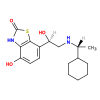

In [501]:
df.loc[[n for n in df.index if n in chembl_actives and n not in bret.index]]["mols"].loc["CHEMBL1221541"]

(array([ 1.,  5.,  2.,  1.,  0.,  0.,  0.,  1.,  0.,  0.,  0.,  0.,  1.,
         0.,  0.,  0.,  2.,  0.,  0.,  0.,  0.,  0.,  0.,  1.,  0.,  0.,
         0.,  2.,  0.,  1.,  0.,  0.,  1.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  1.,  1.,  0.,  1.,  2.,  0.,  2.,  0.,  1.]),
 array([ 0.        ,  0.0210989 ,  0.0421978 ,  0.0632967 ,  0.0843956 ,
         0.10549451,  0.12659341,  0.14769231,  0.16879121,  0.18989011,
         0.21098901,  0.23208791,  0.25318681,  0.27428571,  0.29538462,
         0.31648352,  0.33758242,  0.35868132,  0.37978022,  0.40087912,
         0.42197802,  0.44307692,  0.46417582,  0.48527473,  0.50637363,
         0.52747253,  0.54857143,  0.56967033,  0.59076923,  0.61186813,
         0.63296703,  0.65406593,  0.67516484,  0.69626374,  0.71736264,
         0.73846154,  0.75956044,  0.78065934,  0.80175824,  0.82285714,
         0.84395604,  0.86505495,  0.88615385,  0.90725275,  0.92835165,
         0.94945055,  0.97054945,  0.99164835,  1.01274725,

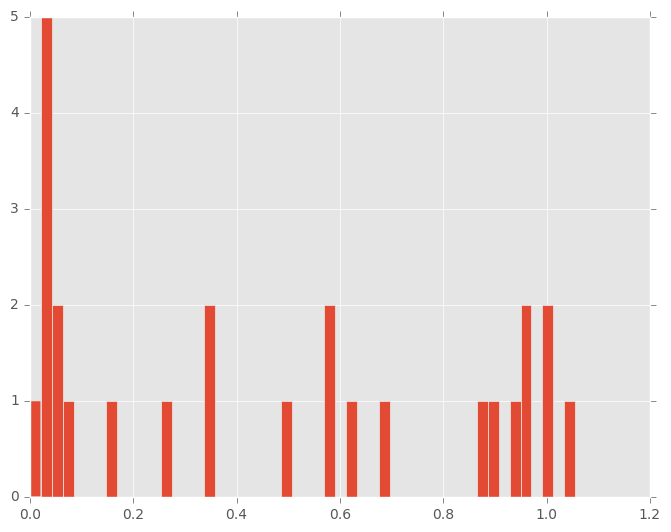

In [400]:
plt.hist(bret[arr_col].divide(bret[gprot_col]).loc[bret[gprot_col] > 0.2], bins=50)

In [399]:
bret[arr_col].divide(bret[gprot_col]).loc[bret[gprot_col] > 0.2].sort(inplace=False)

CID_1237        0.000000
CID_170373      0.025000
CID_36811       0.031746
CID_23844       0.034483
CID_23843       0.035088
CID_913         0.035714
CID_33572       0.051948
CID_681         0.060606
CID_5606        0.063830
CID_217246      0.156250
CID_2783        0.254902
CID_10443654    0.348315
CID_2083        0.358025
CID_4086        0.488095
CID_10087493    0.577982
CID_5403        0.587500
CID_10353067    0.617647
CID_2755        0.677419
CID_951         0.878788
CID_5241141     0.907216
CID_7436        0.940594
CID_3609        0.950820
CID_4382        0.967391
CID_3779        1.000000
CID_838         1.000000
CID_3343        1.054945
dtype: float64

In [180]:
#gs biased? rfr, XP, 0.3
print(results_dict[save_name]["Crystal Structures"][0].predict_proba(C_df.loc[["CID_5152", "CID_2083", "CID_2585", "CID_3779"]]))
print("\n")
print(results_dict[save_name]["(MSM + Crystal) Docking"][0].predict_proba(X_df.loc[["CID_5152", "CID_2083", "CID_2585", "CID_3779"]]))
print("\n")
print(results_dict[save_name]["MSM ddG + Crystal Docking"][0].predict_proba(ddg_df.loc[["CID_5152", "CID_2083", "CID_2585", "CID_3779"]]))

[[ 0.374  0.001  0.625]
 [ 0.     0.974  0.026]
 [ 1.     0.     0.   ]
 [ 0.     0.371  0.629]]


[[ 0.489  0.239  0.272]
 [ 0.017  0.934  0.049]
 [ 0.929  0.007  0.064]
 [ 0.009  0.276  0.715]]


[[ 0.589  0.189  0.222]
 [ 0.015  0.967  0.018]
 [ 0.968  0.011  0.021]
 [ 0.01   0.259  0.731]]


analyzing precision at full recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.792005          0.000000   
(MSM + Crystal) Docking      0.809700          0.017695   
MSM ddG + Crystal Docking    0.740405         -0.051600   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.268884553664, 0.343686000649)  
MSM ddG + Crystal Docking   (0.175046582153, 0.24082902281)  


ValueError: list.remove(x): x not in list

analyzing threshold at full recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.409888          0.000000   
(MSM + Crystal) Docking      0.479053          0.069165   
MSM ddG + Crystal Docking    0.433397          0.023509   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.642973109636, 0.718627706339)  
MSM ddG + Crystal Docking  (0.613332586258, 0.690650517282)  


ValueError: list.remove(x): x not in list

analyzing Accuracy:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures             0.6560            0.0000   
(MSM + Crystal) Docking        0.7454            0.0894   
MSM ddG + Crystal Docking      0.7191            0.0631   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.540405765851, 0.620526465434)  
MSM ddG + Crystal Docking  (0.479307455095, 0.560428898309)  


ValueError: list.remove(x): x not in list

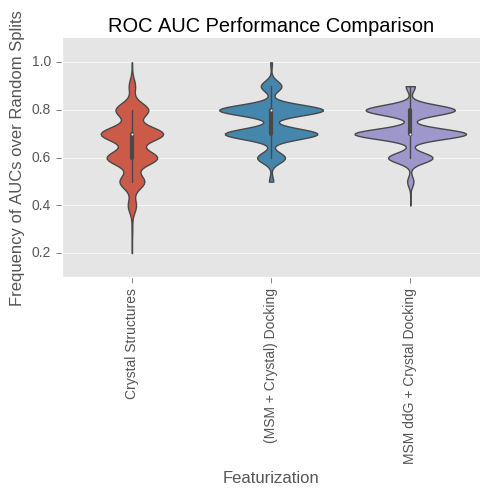

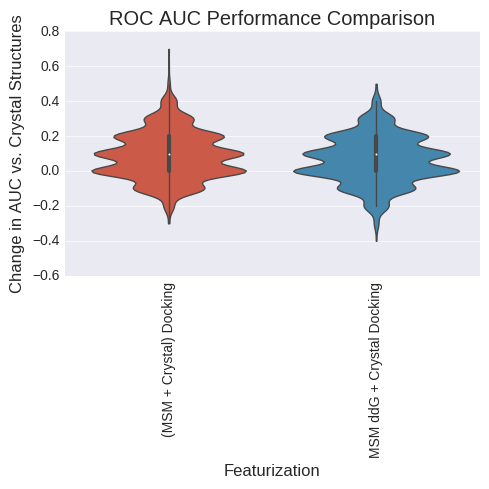

analyzing Recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures            0.72850           0.00000   
(MSM + Crystal) Docking       0.92575           0.19725   
MSM ddG + Crystal Docking     0.88525           0.15675   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.560572527805, 0.640096056885)  
MSM ddG + Crystal Docking  (0.515291614016, 0.595970175515)  


ValueError: list.remove(x): x not in list

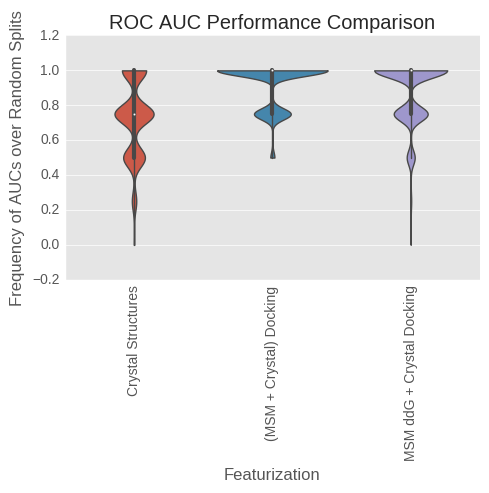

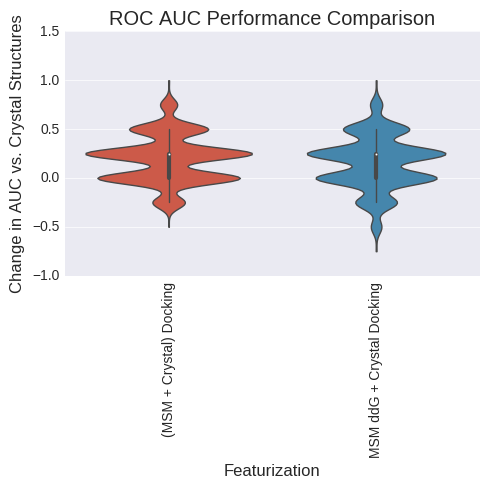

analyzing precision:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.757314          0.000000   
(MSM + Crystal) Docking      0.721786         -0.035529   
MSM ddG + Crystal Docking    0.658581         -0.098733   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.293893732176, 0.370334081562)  
MSM ddG + Crystal Docking  (0.191922082041, 0.259716240986)  


ValueError: list.remove(x): x not in list

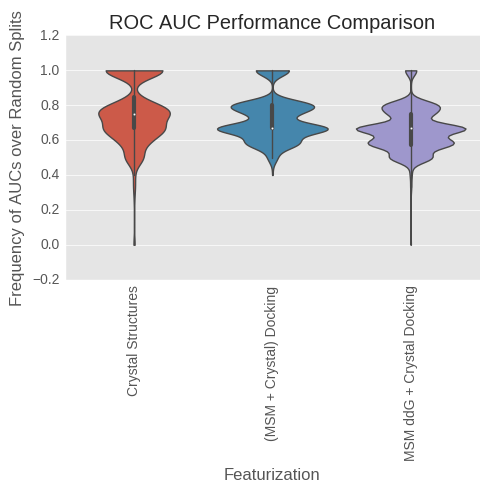

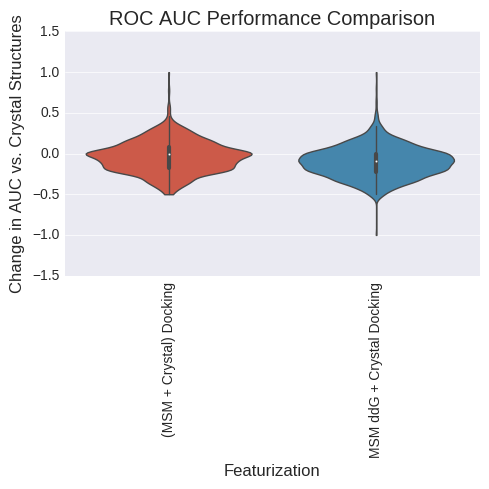

analyzing fdr:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.242686          0.000000   
(MSM + Crystal) Docking      0.278214          0.035529   
MSM ddG + Crystal Docking    0.341419          0.098733   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.451464896516, 0.532640562123)  
MSM ddG + Crystal Docking  (0.602131253881, 0.679996855286)  


ValueError: list.remove(x): x not in list

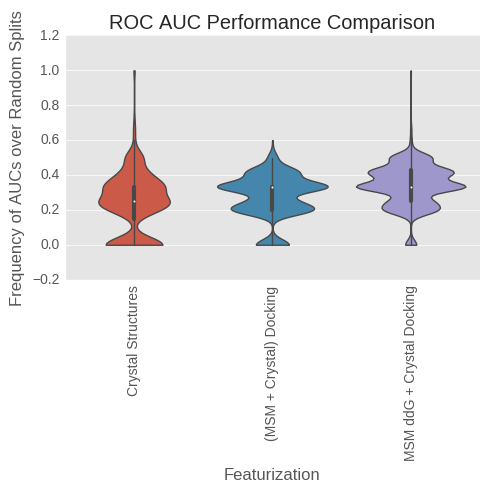

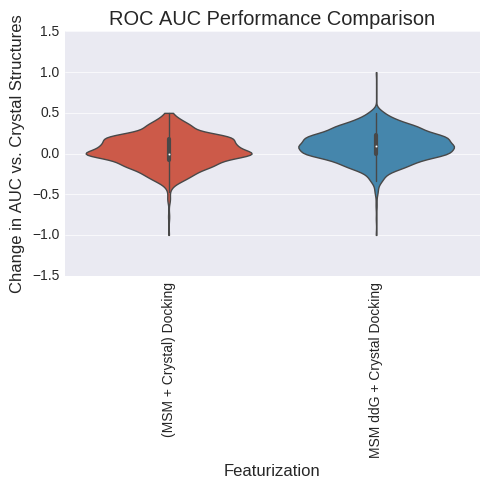

analyzing Recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures             0.6560            0.0000   
(MSM + Crystal) Docking        0.7454            0.0894   
MSM ddG + Crystal Docking      0.7191            0.0631   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.540405765851, 0.620526465434)  
MSM ddG + Crystal Docking  (0.479307455095, 0.560428898309)  


ValueError: list.remove(x): x not in list

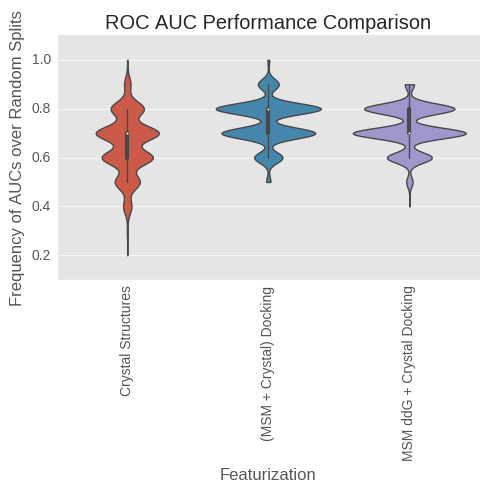

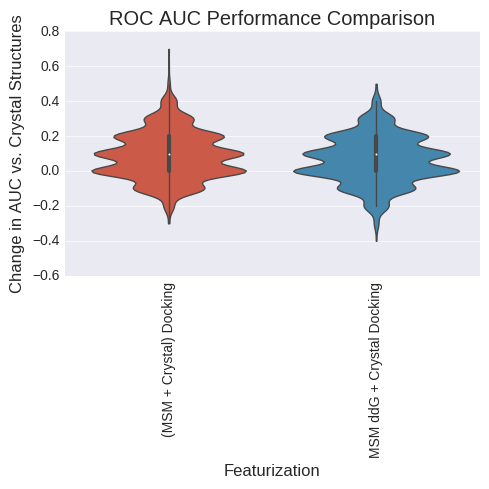

analyzing precision:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.671115          0.000000   
(MSM + Crystal) Docking      0.668069         -0.003047   
MSM ddG + Crystal Docking    0.631621         -0.039494   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking     (0.39911028579, 0.479693836328)  
MSM ddG + Crystal Docking  (0.330678933188, 0.409047952017)  


ValueError: list.remove(x): x not in list

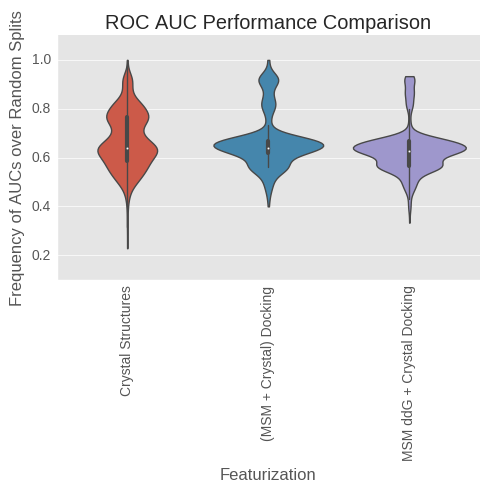

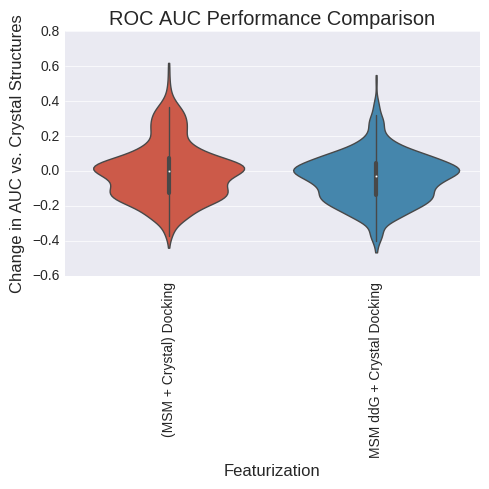

analyzing fdr:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.328885          0.000000   
(MSM + Crystal) Docking      0.331931          0.003047   
MSM ddG + Crystal Docking    0.368379          0.039494   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.446506322643, 0.527665047644)  
MSM ddG + Crystal Docking  (0.526329068016, 0.606787715886)  


ValueError: list.remove(x): x not in list

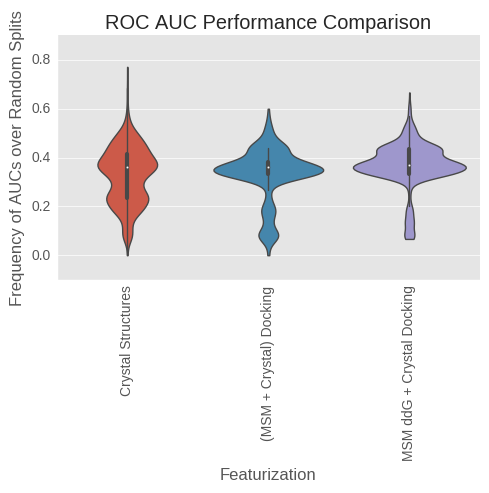

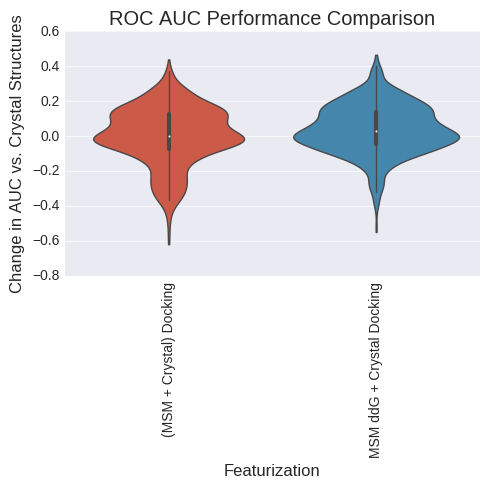

analyzing class B ROC AUC:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.884375          0.000000   
(MSM + Crystal) Docking      0.895417          0.011042   
MSM ddG + Crystal Docking    0.867896         -0.016479   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.335538762457, 0.414122211099)  
MSM ddG + Crystal Docking  (0.284258904988, 0.360100732047)  


ValueError: list.remove(x): x not in list

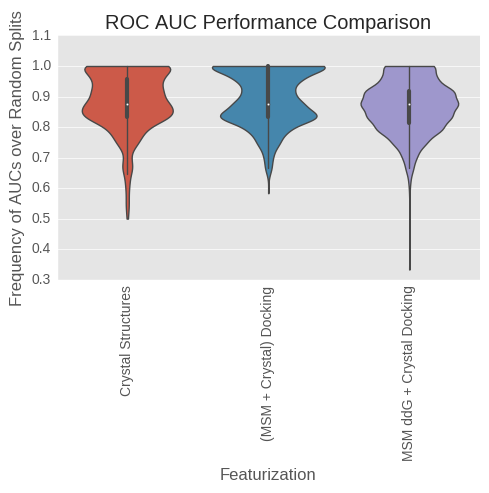

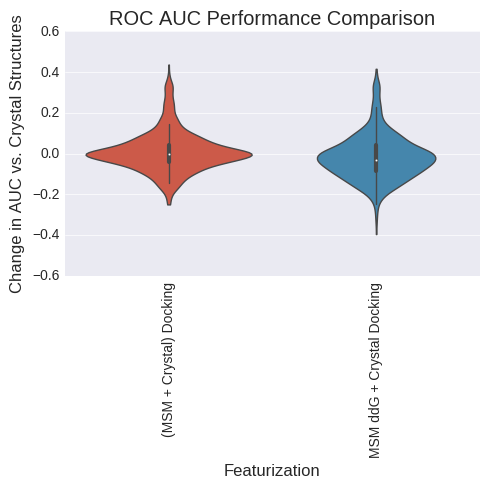

analyzing ROC AUC:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.805156          0.000000   
(MSM + Crystal) Docking      0.869628          0.064472   
MSM ddG + Crystal Docking    0.863149          0.057993   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.717320724077, 0.787330964152)  
MSM ddG + Crystal Docking   (0.67381258697, 0.747392759111)  


ValueError: list.remove(x): x not in list

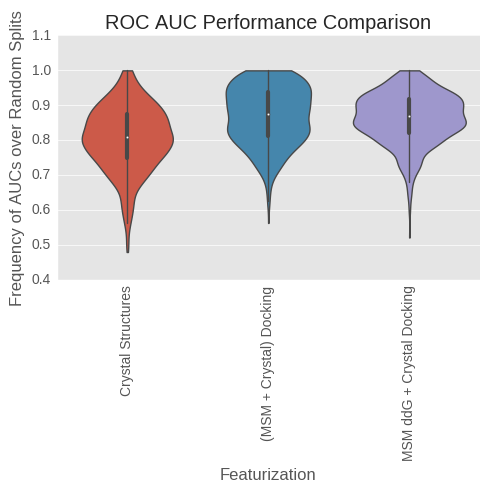

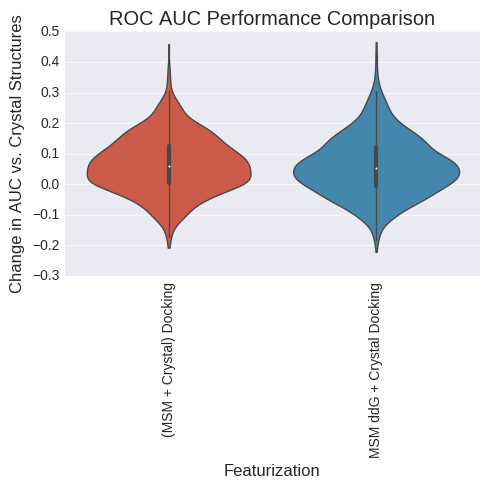

analyzing BedROC
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.991925          0.000000   
(MSM + Crystal) Docking      0.999855          0.007930   
MSM ddG + Crystal Docking    0.999426          0.007501   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.320972763336, 0.398885945167)  
MSM ddG + Crystal Docking  (0.303547887689, 0.380548102751)  


ValueError: list.remove(x): x not in list

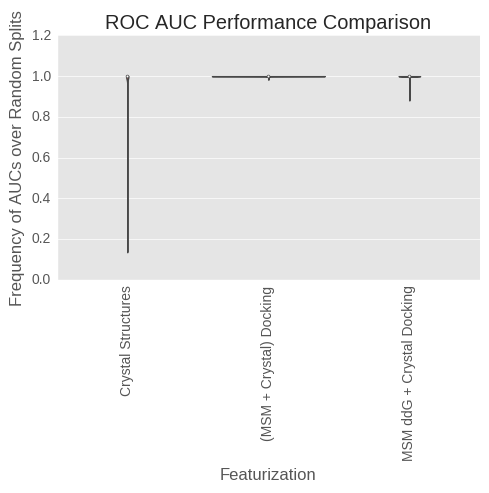

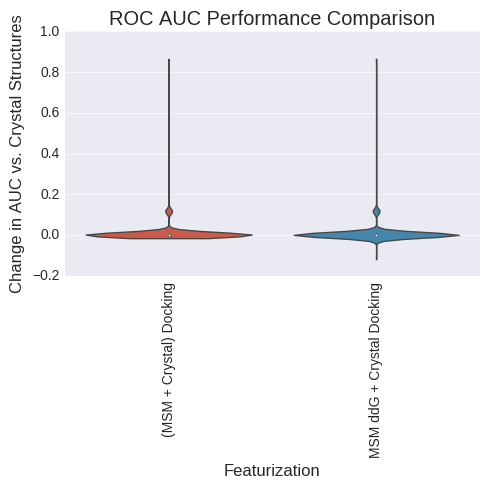

analyzing LogAUC
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures                0.0               0.0   
(MSM + Crystal) Docking           0.0               0.0   
MSM ddG + Crystal Docking         0.0               0.0   

                                                 Sign Test 99% CI  
Crystal Structures                                       (0, 0.0)  
(MSM + Crystal) Docking    (-4.33680868994e-19, 0.00659116490341)  
MSM ddG + Crystal Docking  (-4.33680868994e-19, 0.00659116490341)  


ValueError: list.remove(x): x not in list

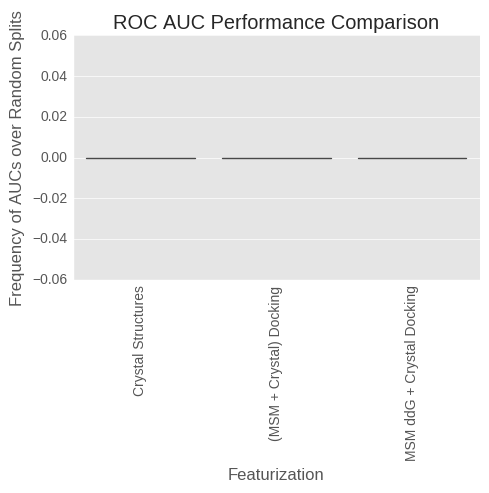

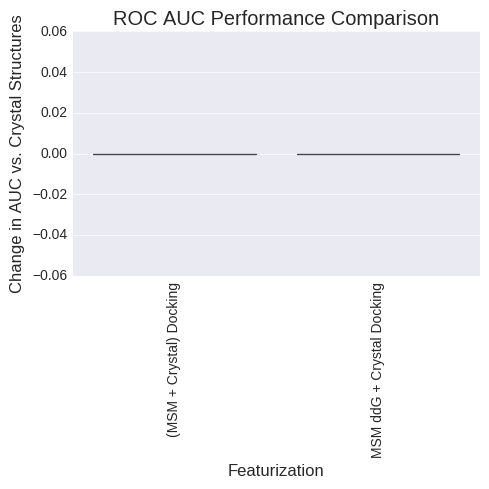

(1,)
(1, 1)


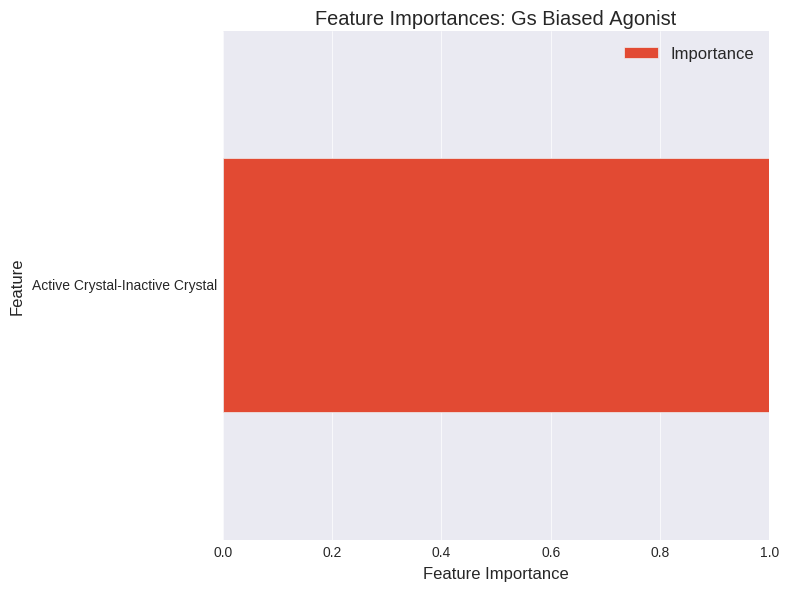

(56,)
(1, 56)


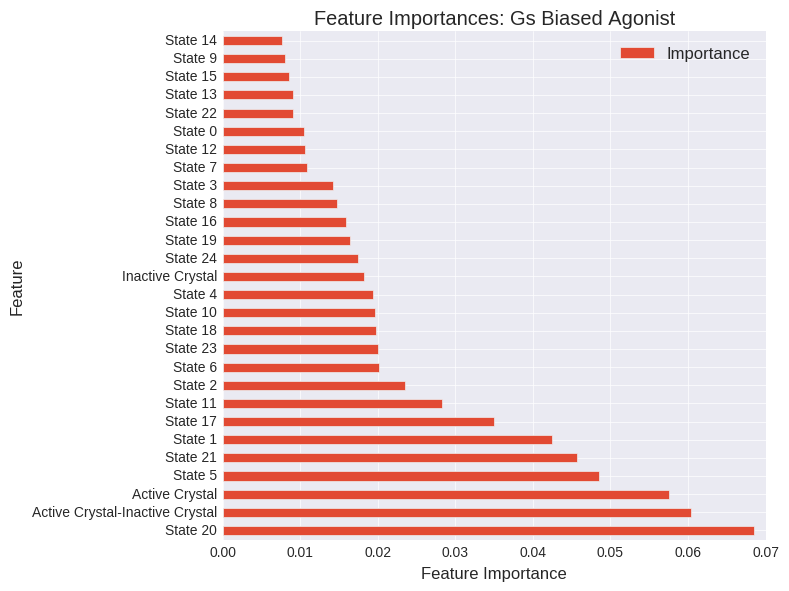

(351,)
(1, 351)


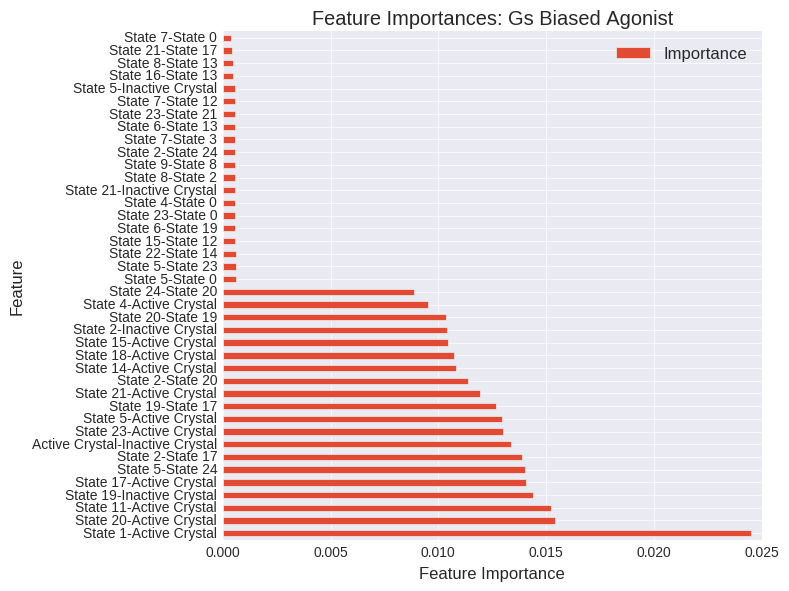

In [179]:
#SP, All ligands, Four class, 32 stereoisomers; new crystal grids; 25 clusters
#RFR
importance_dfs = analyze_multiclass_experiment(results_dict[save_name], 
                                                                feature_names,
                                                                [f.columns.values.tolist() for f in features], model_agonists, analysis_dir,
                                                                ["Antagonist", "Gs Biased Agonist", "Balanced Agonist"], 
                                                                #["Gs Inactive", "Gs Active"], 
                                                               #["Arr Inactive", "Arr Active"],
                                               np.hstack([X_df.loc[model_agonists].values]),
                                                               #["Gs Inactive", "Gs Partial Active", "Gs Full Active"], 
                                              remake=False, fxn=np.mean)


#TRY LOOCV
#crystal structures might just have bigger boxes







analyzing precision at full recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures            0.64195            0.0000   
(MSM + Crystal) Docking       0.71875            0.0768   
MSM ddG + Crystal Docking     0.72925            0.0873   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.398126872415, 0.478690432033)  
MSM ddG + Crystal Docking  (0.436601288764, 0.517701904821)  


ValueError: list.remove(x): x not in list

analyzing threshold at full recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.556301          0.000000   
(MSM + Crystal) Docking      0.495936         -0.060364   
MSM ddG + Crystal Docking    0.547152         -0.009148   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.467359437877, 0.548535103484)  
MSM ddG + Crystal Docking  (0.528338027129, 0.608752392115)  


ValueError: list.remove(x): x not in list

analyzing Accuracy:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures             0.6114            0.0000   
(MSM + Crystal) Docking        0.6268            0.0154   
MSM ddG + Crystal Docking      0.6080           -0.0034   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.230685386436, 0.302412461069)  
MSM ddG + Crystal Docking  (0.163850317838, 0.228183475083)  


ValueError: list.remove(x): x not in list

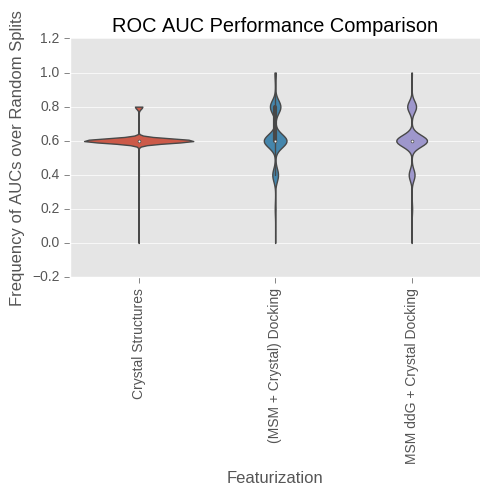

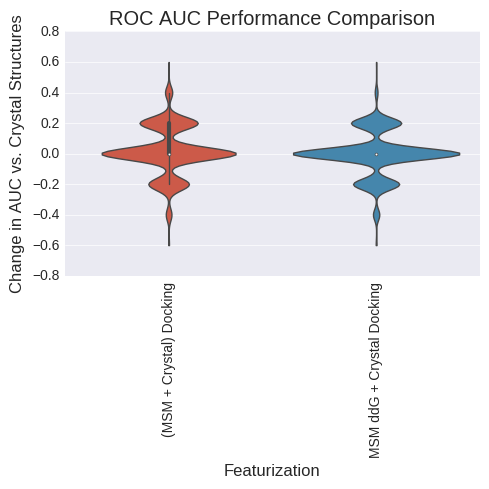

analyzing Recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.998000          0.000000   
(MSM + Crystal) Docking      0.830000         -0.168000   
MSM ddG + Crystal Docking    0.880333         -0.117667   

                                                Sign Test 99% CI  
Crystal Structures                                      (0, 0.0)  
(MSM + Crystal) Docking    (0.000117416353618, 0.00846056621998)  
MSM ddG + Crystal Docking     (0.00119081455215, 0.013347621032)  


ValueError: list.remove(x): x not in list

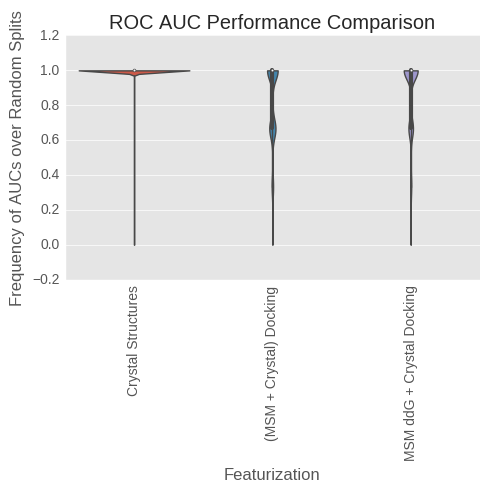

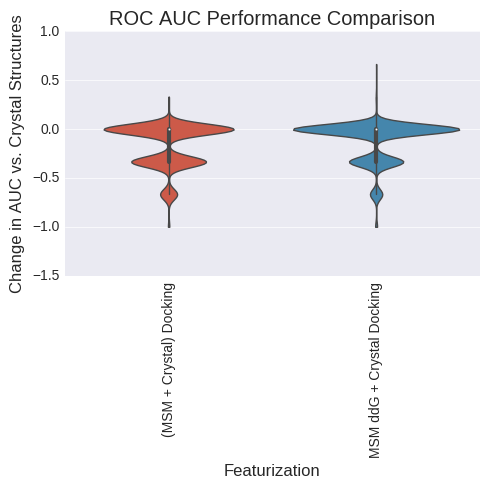

analyzing precision:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.608550          0.000000   
(MSM + Crystal) Docking      0.672433          0.063883   
MSM ddG + Crystal Docking    0.629117          0.020567   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.406983521005, 0.487715142475)  
MSM ddG + Crystal Docking  (0.270803505987, 0.345740683666)  


ValueError: list.remove(x): x not in list

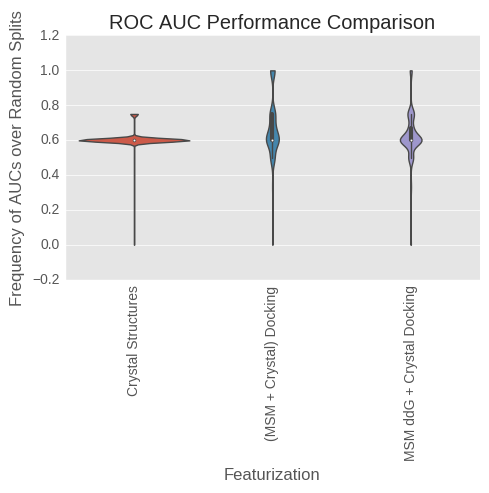

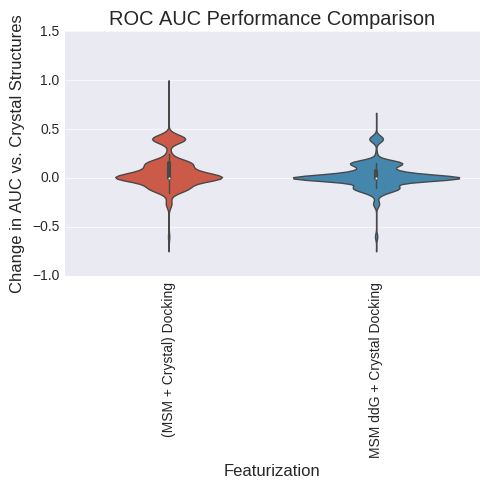

analyzing fdr:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.391450          0.000000   
(MSM + Crystal) Docking      0.327567         -0.063883   
MSM ddG + Crystal Docking    0.370883         -0.020567   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.158269499131, 0.221843387769)  
MSM ddG + Crystal Docking  (0.162919359744, 0.227127615507)  


ValueError: list.remove(x): x not in list

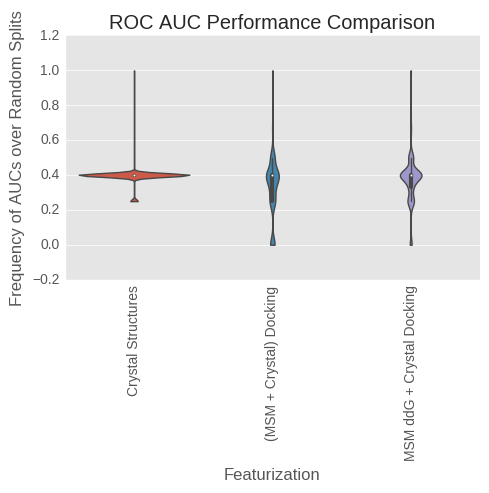

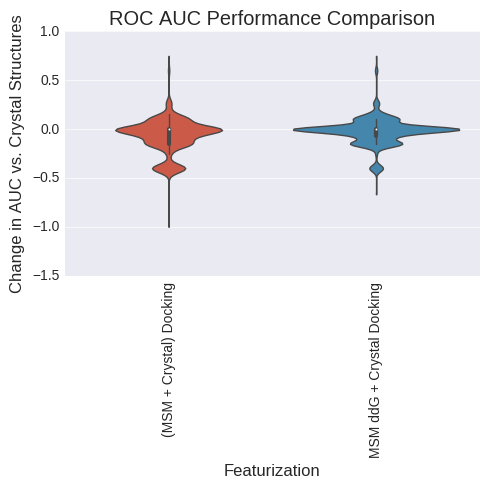

analyzing Recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.998000          0.000000   
(MSM + Crystal) Docking      0.830000         -0.168000   
MSM ddG + Crystal Docking    0.880333         -0.117667   

                                                Sign Test 99% CI  
Crystal Structures                                      (0, 0.0)  
(MSM + Crystal) Docking    (0.000117416353618, 0.00846056621998)  
MSM ddG + Crystal Docking     (0.00119081455215, 0.013347621032)  


ValueError: list.remove(x): x not in list

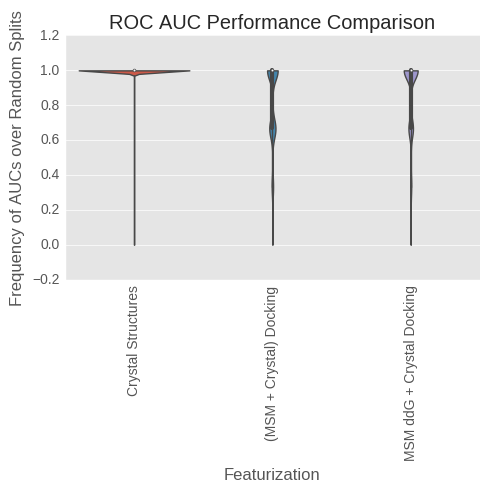

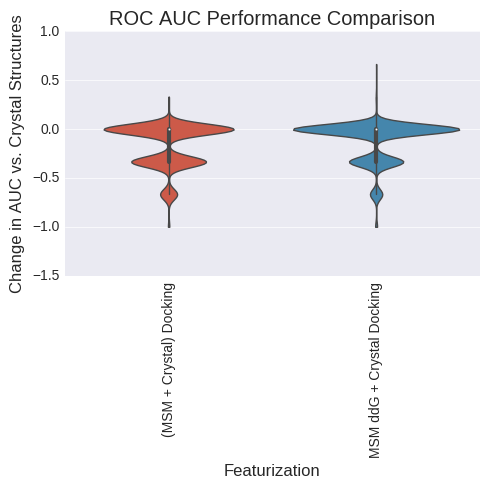

analyzing precision:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.608550          0.000000   
(MSM + Crystal) Docking      0.672433          0.063883   
MSM ddG + Crystal Docking    0.629117          0.020567   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.406983521005, 0.487715142475)  
MSM ddG + Crystal Docking  (0.270803505987, 0.345740683666)  


ValueError: list.remove(x): x not in list

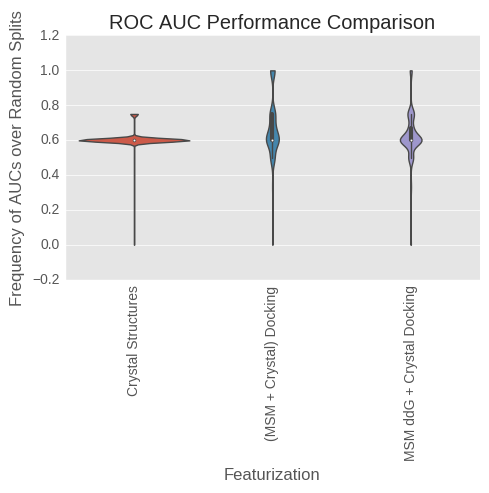

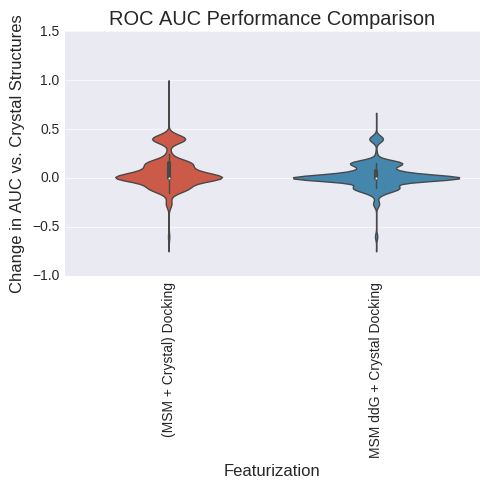

analyzing fdr:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.391450          0.000000   
(MSM + Crystal) Docking      0.327567         -0.063883   
MSM ddG + Crystal Docking    0.370883         -0.020567   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.158269499131, 0.221843387769)  
MSM ddG + Crystal Docking  (0.162919359744, 0.227127615507)  


ValueError: list.remove(x): x not in list

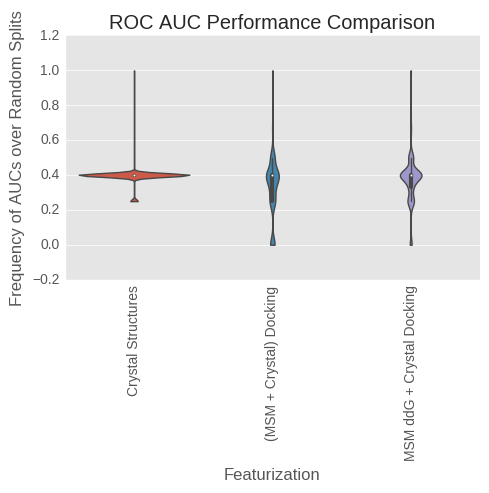

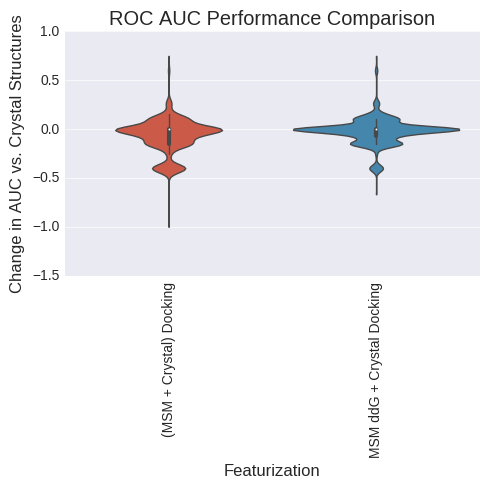

analyzing class B ROC AUC:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.428333          0.000000   
(MSM + Crystal) Docking      0.608000          0.179667   
MSM ddG + Crystal Docking    0.635250          0.206917   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.595014681455, 0.673205704021)  
MSM ddG + Crystal Docking  (0.627621581926, 0.704176968996)  


ValueError: list.remove(x): x not in list

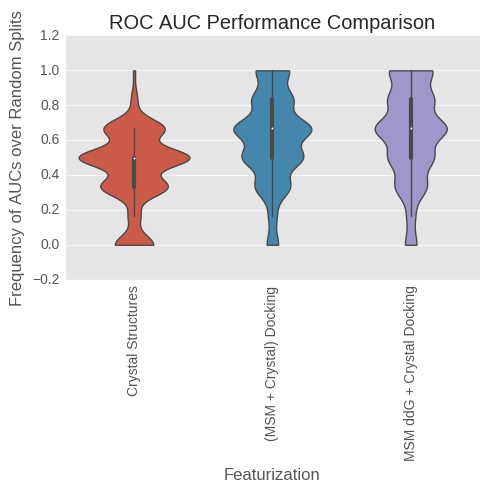

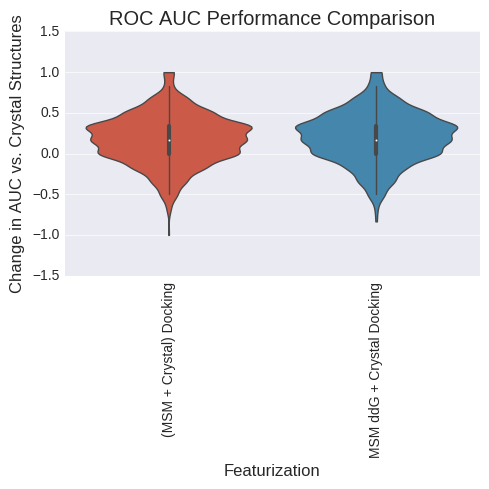

analyzing ROC AUC:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.428333          0.000000   
(MSM + Crystal) Docking      0.608000          0.179667   
MSM ddG + Crystal Docking    0.635250          0.206917   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.595014681455, 0.673205704021)  
MSM ddG + Crystal Docking  (0.627621581926, 0.704176968996)  


ValueError: list.remove(x): x not in list

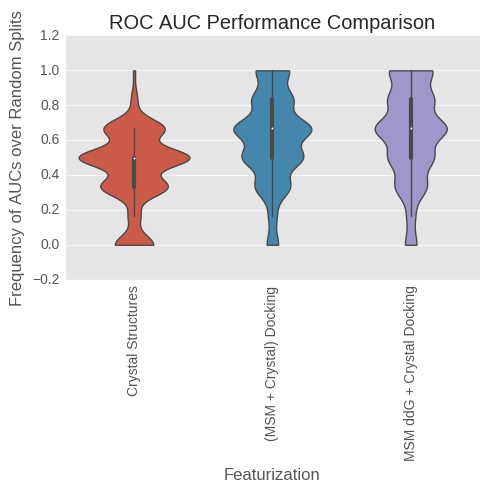

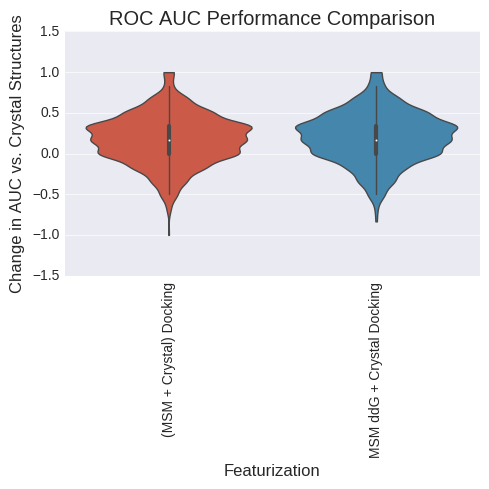

analyzing BedROC
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.595540          0.000000   
(MSM + Crystal) Docking      0.719458          0.123919   
MSM ddG + Crystal Docking    0.784137          0.188598   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.586892283832, 0.665433560282)  
MSM ddG + Crystal Docking  (0.630688376348, 0.707070627585)  


ValueError: list.remove(x): x not in list

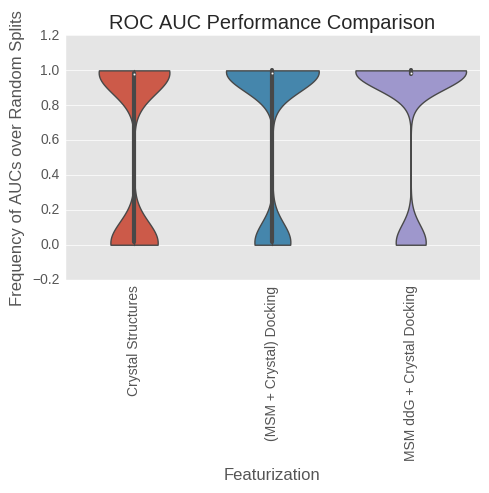

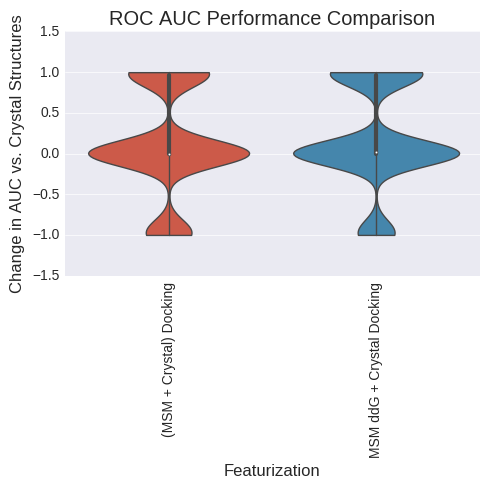

analyzing LogAUC
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.034184          0.000000   
(MSM + Crystal) Docking      0.057848          0.023664   
MSM ddG + Crystal Docking    0.053149          0.018965   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.407968414735, 0.488717066415)  
MSM ddG + Crystal Docking  (0.387320248446, 0.467642061629)  


ValueError: list.remove(x): x not in list

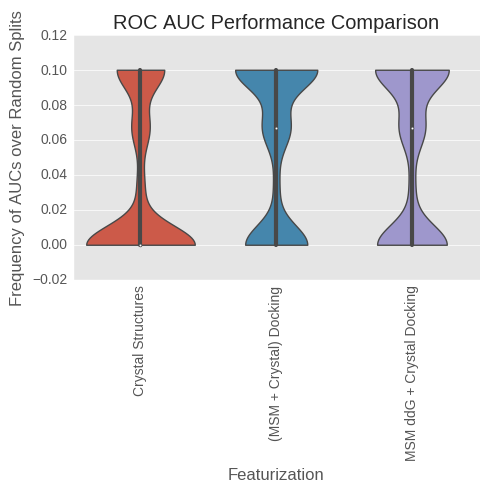

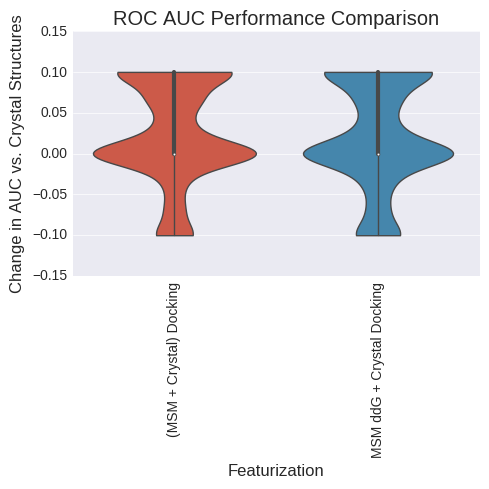

(1, 1)
(1, 1)


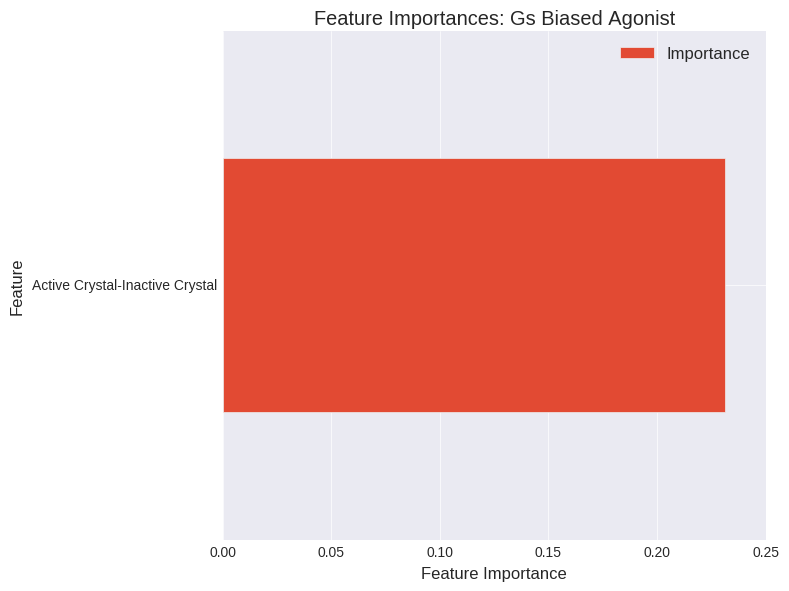

(1, 56)
(1, 56)


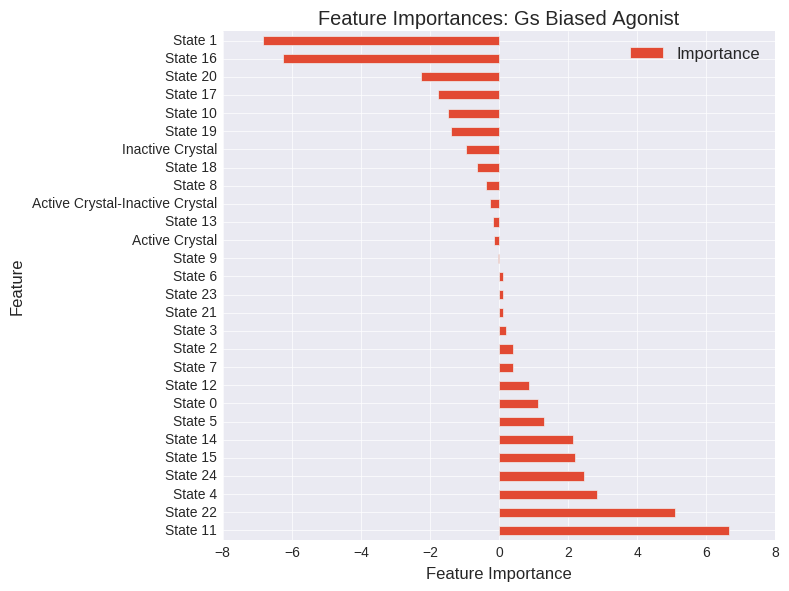

(1, 351)
(1, 351)


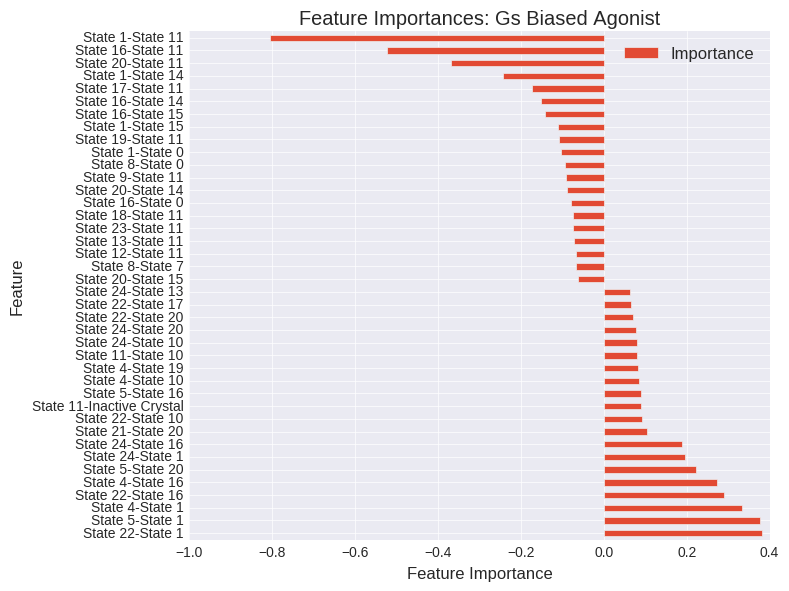

In [98]:
#SP, All ligands, Four class, 32 stereoisomers; new crystal grids; 25 clusters
#RFR
importance_dfs = analyze_multiclass_experiment(results_dict[save_name], 
                                                                feature_names,
                                                                [f.columns.values.tolist() for f in features], model_agonists, analysis_dir,
                                                                ["Antagonist", "Gs Biased Agonist", "Agonist"], 
                                                                #["Gs Inactive", "Gs Active"], 
                                                               #["Arr Inactive", "Arr Active"],
                                               np.hstack([X_df.loc[model_agonists].values]),
                                                               #["Gs Inactive", "Gs Partial Active", "Gs Full Active"], 
                                              remake=False, fxn=np.mean)


#TRY LOOCV
#crystal structures might just have bigger boxes








analyzing precision at full recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.569277          0.000000   
(MSM + Crystal) Docking      0.741655          0.172377   
MSM ddG + Crystal Docking    0.791568          0.222290   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.595014681455, 0.673205704021)  
MSM ddG + Crystal Docking  (0.704847513173, 0.775962363013)  


ValueError: list.remove(x): x not in list

analyzing threshold at full recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.168694          0.000000   
(MSM + Crystal) Docking      0.392409          0.223715   
MSM ddG + Crystal Docking    0.439049          0.270355   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.811117307051, 0.870361153825)  
MSM ddG + Crystal Docking  (0.817540256059, 0.875859110838)  


ValueError: list.remove(x): x not in list

analyzing Accuracy:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.696111          0.000000   
(MSM + Crystal) Docking      0.812444          0.116333   
MSM ddG + Crystal Docking    0.794000          0.097889   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.614352002344, 0.691617918866)  
MSM ddG + Crystal Docking  (0.559562572694, 0.639119194326)  


ValueError: list.remove(x): x not in list

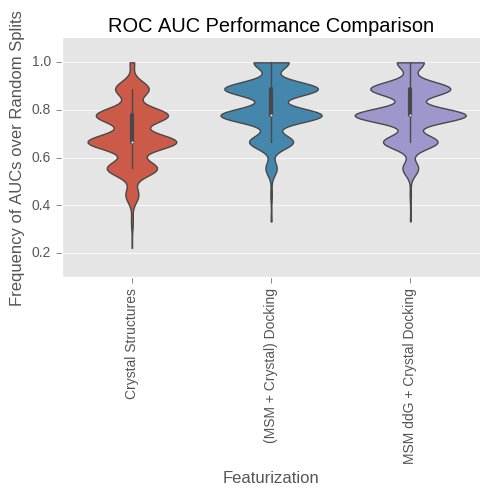

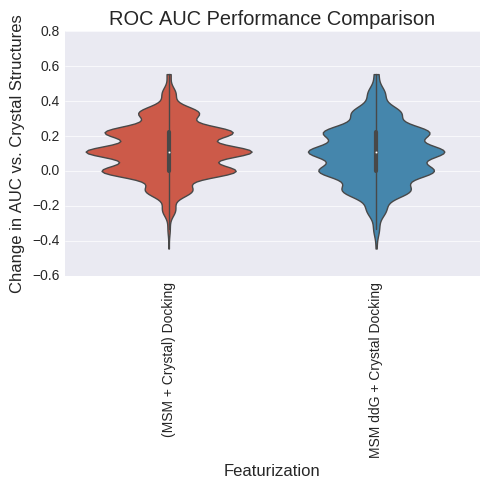

analyzing Recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.547667          0.000000   
(MSM + Crystal) Docking      0.606000          0.058333   
MSM ddG + Crystal Docking    0.614333          0.066667   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.292929372415, 0.369311623652)  
MSM ddG + Crystal Docking    (0.30741486667, 0.38462839445)  


ValueError: list.remove(x): x not in list

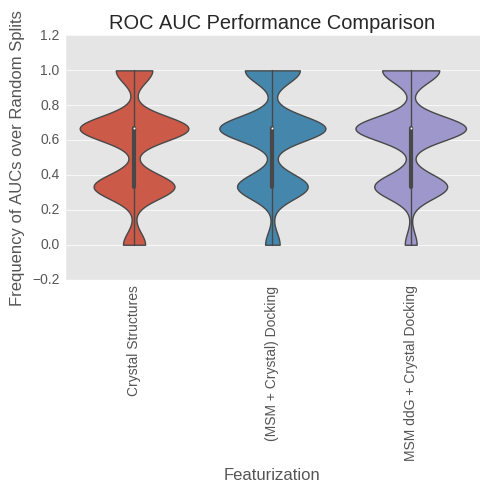

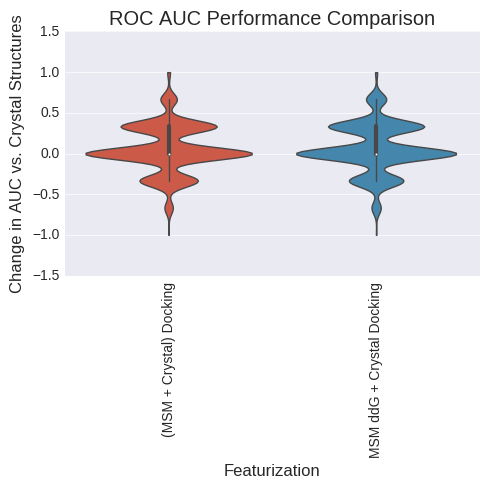

analyzing precision:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.553862          0.000000   
(MSM + Crystal) Docking      0.797214          0.243352   
MSM ddG + Crystal Docking    0.754069          0.200207   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.609256785616, 0.686779047243)  
MSM ddG + Crystal Docking   (0.56966987375, 0.648880069971)  


ValueError: list.remove(x): x not in list

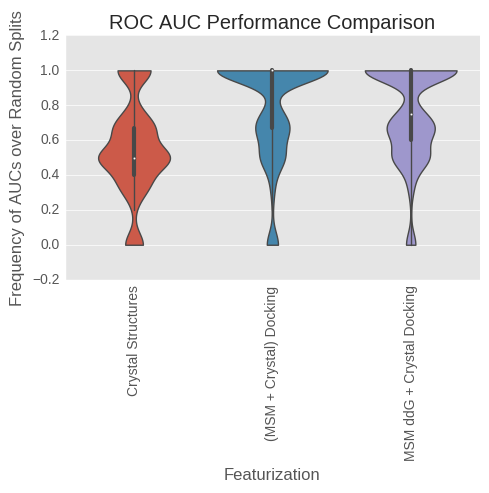

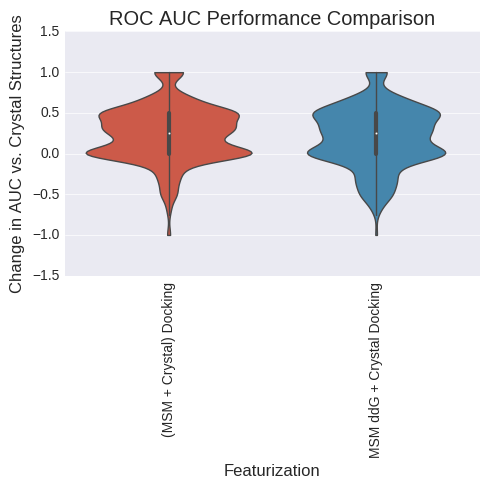

analyzing fdr:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.446138          0.000000   
(MSM + Crystal) Docking      0.202786         -0.243352   
MSM ddG + Crystal Docking    0.245931         -0.200207   

                                            Sign Test 99% CI  
Crystal Structures                                  (0, 0.0)  
(MSM + Crystal) Docking    (0.0951044651382, 0.147918002518)  
MSM ddG + Crystal Docking   (0.167577373379, 0.232403690222)  


ValueError: list.remove(x): x not in list

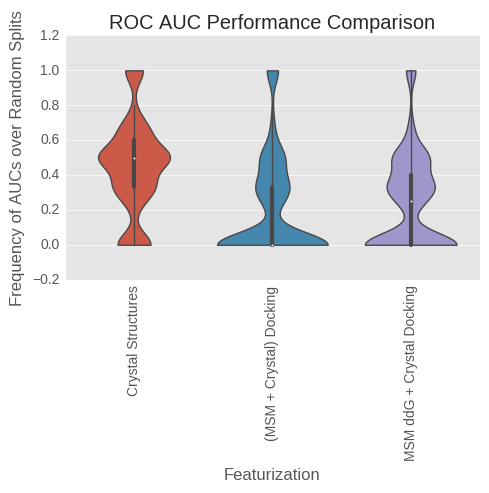

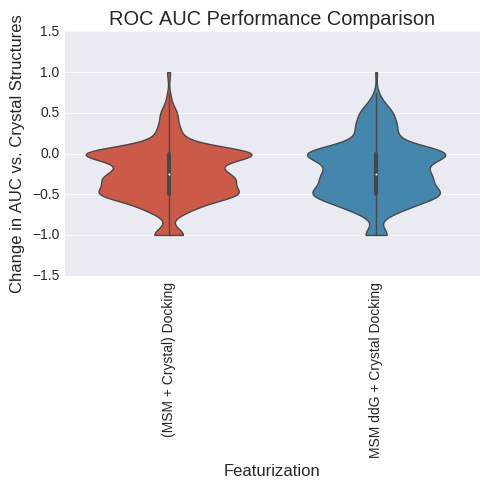

analyzing Recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.547667          0.000000   
(MSM + Crystal) Docking      0.606000          0.058333   
MSM ddG + Crystal Docking    0.614333          0.066667   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.292929372415, 0.369311623652)  
MSM ddG + Crystal Docking    (0.30741486667, 0.38462839445)  


ValueError: list.remove(x): x not in list

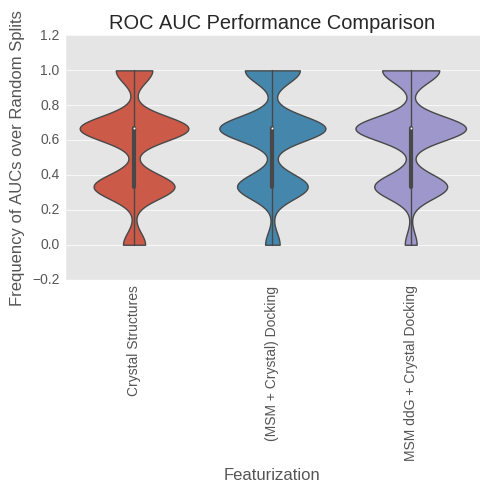

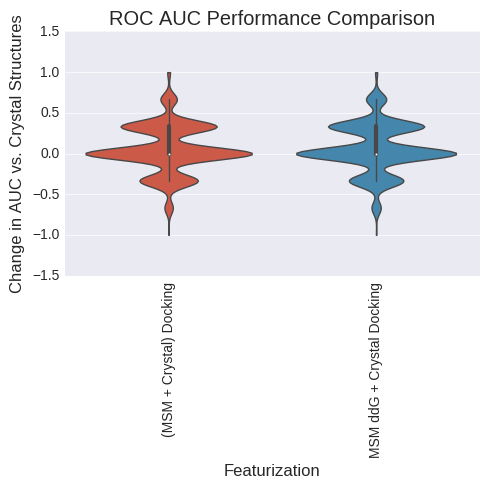

analyzing precision:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.553862          0.000000   
(MSM + Crystal) Docking      0.797214          0.243352   
MSM ddG + Crystal Docking    0.754069          0.200207   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.609256785616, 0.686779047243)  
MSM ddG + Crystal Docking   (0.56966987375, 0.648880069971)  


ValueError: list.remove(x): x not in list

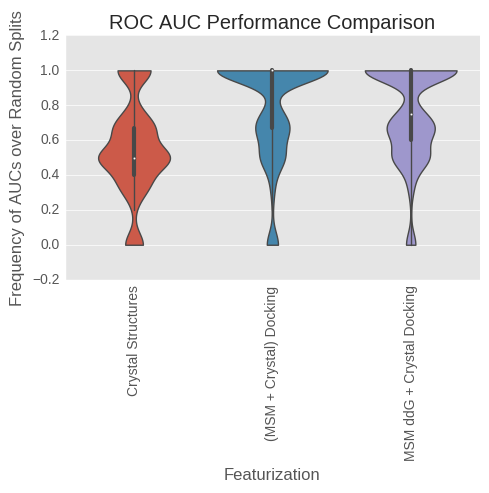

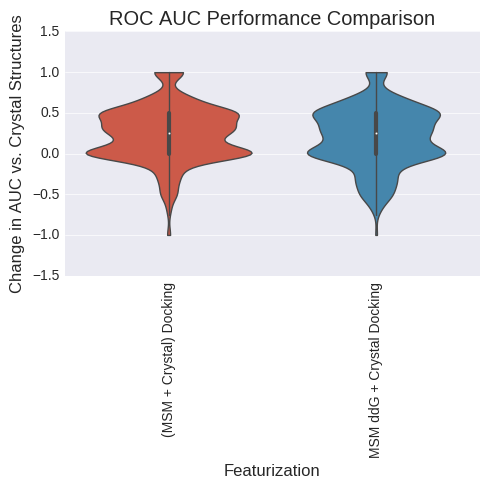

analyzing fdr:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.446138          0.000000   
(MSM + Crystal) Docking      0.202786         -0.243352   
MSM ddG + Crystal Docking    0.245931         -0.200207   

                                            Sign Test 99% CI  
Crystal Structures                                  (0, 0.0)  
(MSM + Crystal) Docking    (0.0951044651382, 0.147918002518)  
MSM ddG + Crystal Docking   (0.167577373379, 0.232403690222)  


ValueError: list.remove(x): x not in list

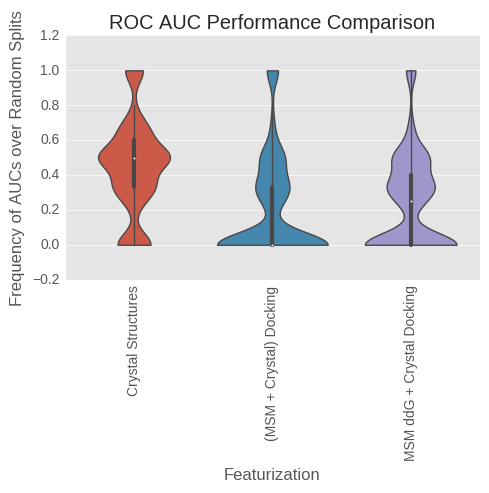

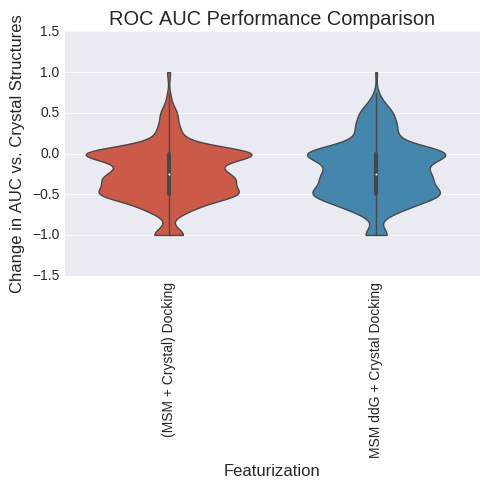

analyzing class B ROC AUC:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.802889          0.000000   
(MSM + Crystal) Docking      0.895361          0.092472   
MSM ddG + Crystal Docking    0.919250          0.116361   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.640923683338, 0.716703497297)  
MSM ddG + Crystal Docking  (0.699660634942, 0.771215152893)  


ValueError: list.remove(x): x not in list

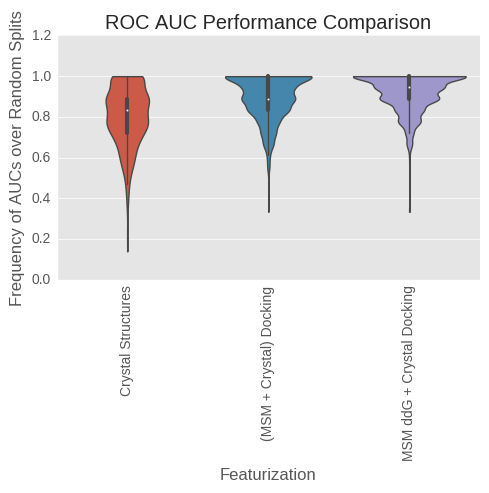

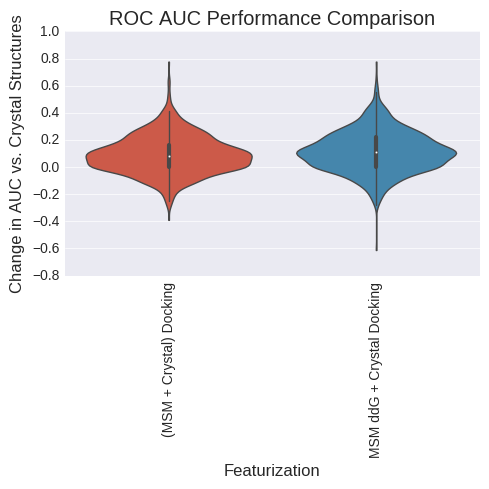

analyzing ROC AUC:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.802889          0.000000   
(MSM + Crystal) Docking      0.895361          0.092472   
MSM ddG + Crystal Docking    0.919250          0.116361   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.641948297069, 0.717665701236)  
MSM ddG + Crystal Docking  (0.697587538931, 0.769314613564)  


ValueError: list.remove(x): x not in list

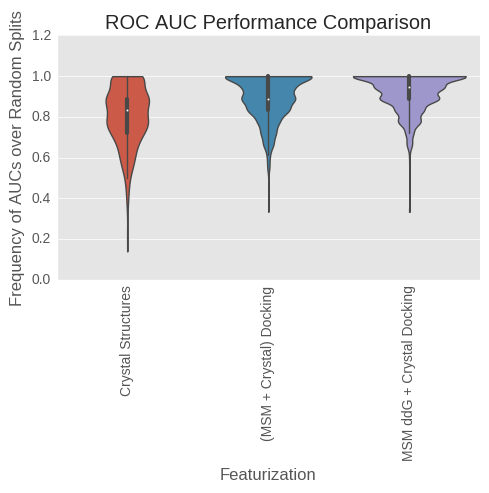

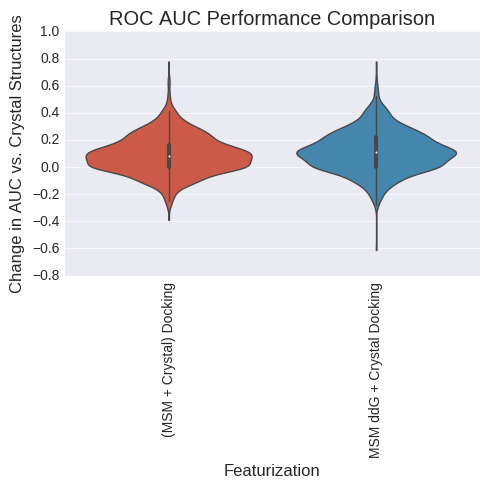

analyzing BedROC
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.881209          0.000000   
(MSM + Crystal) Docking      0.910291          0.029081   
MSM ddG + Crystal Docking    0.924764          0.043554   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking     (0.584863471834, 0.66348873694)  
MSM ddG + Crystal Docking  (0.635803580215, 0.711889512068)  


ValueError: list.remove(x): x not in list

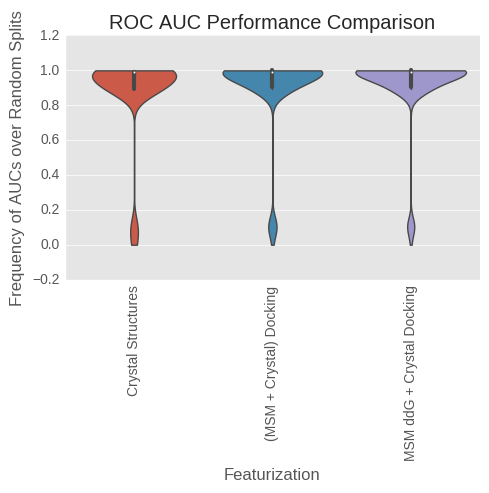

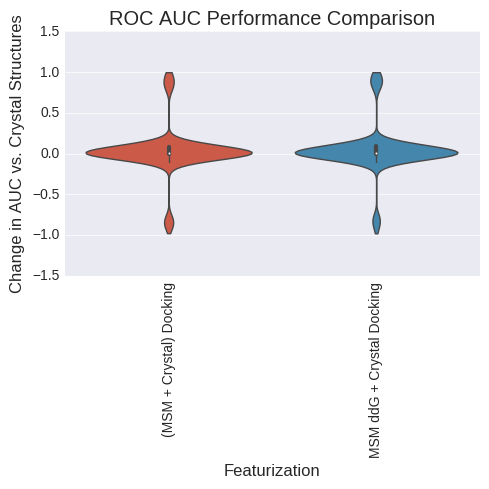

analyzing LogAUC
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.149900          0.000000   
(MSM + Crystal) Docking      0.131962         -0.017938   
MSM ddG + Crystal Docking    0.135560         -0.014340   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.391247607885, 0.471661972871)  
MSM ddG + Crystal Docking  (0.426712437683, 0.507722579201)  


ValueError: list.remove(x): x not in list

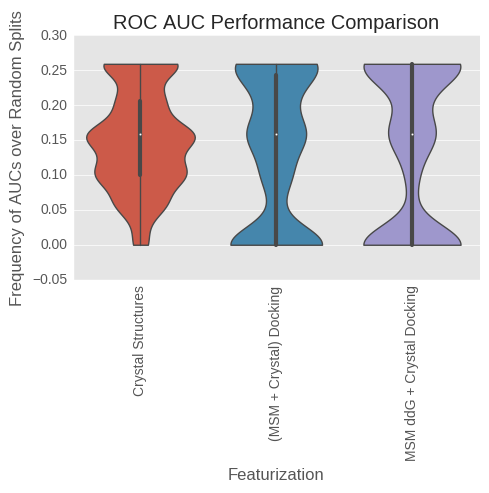

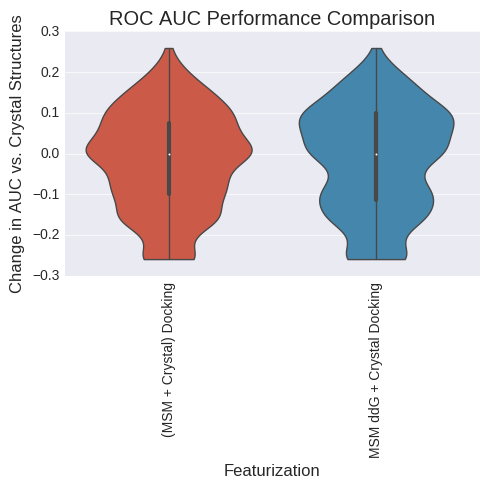

(1,)
(1, 1)


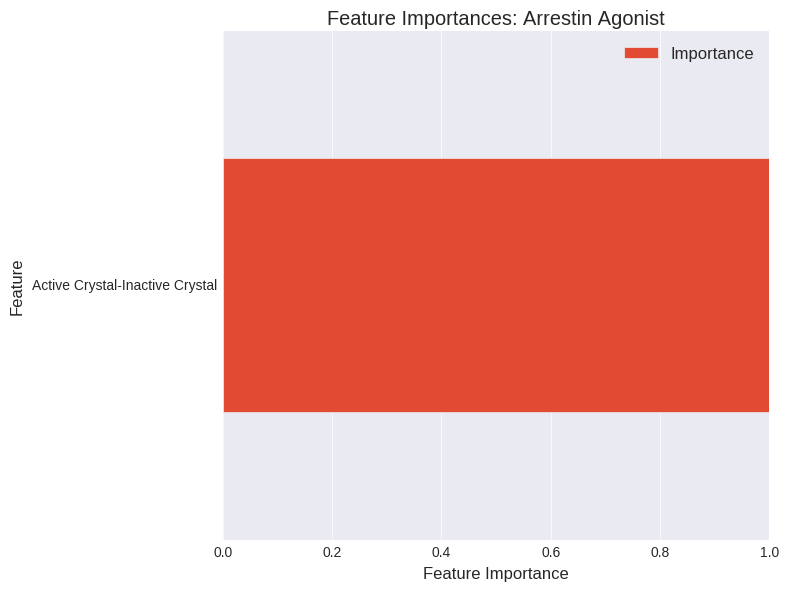

(56,)
(1, 56)


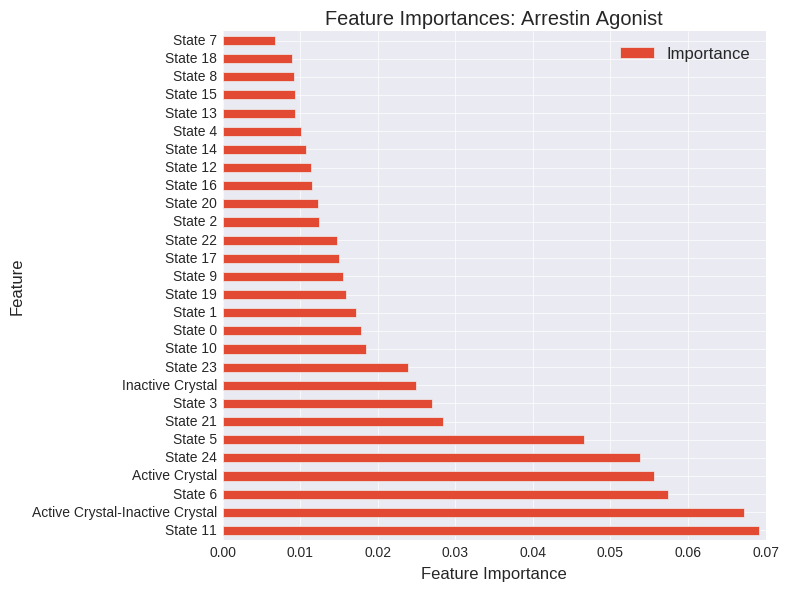

(351,)
(1, 351)


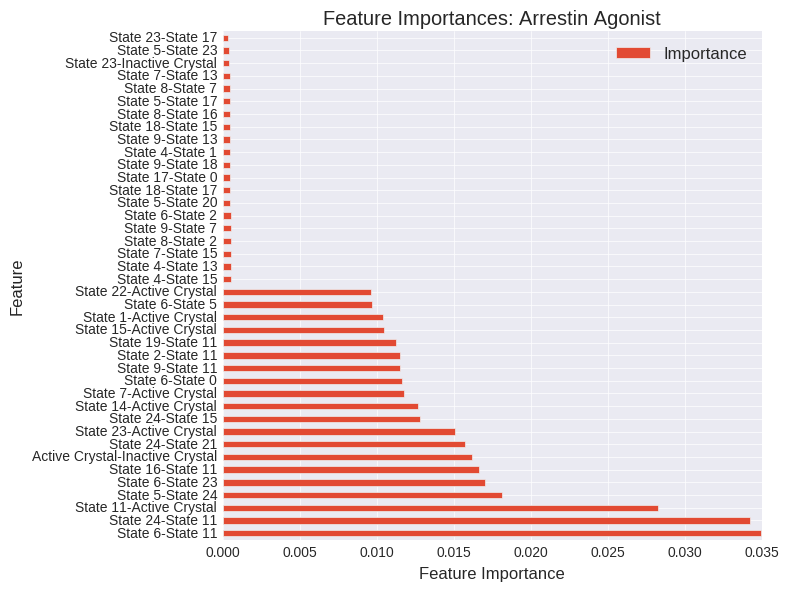

In [146]:
#SP, All ligands, Four class, 32 stereoisomers; new crystal grids; 25 clusters
#RFR
importance_dfs = analyze_multiclass_experiment(results_dict[save_name], 
                                                                feature_names,
                                                                [f.columns.values.tolist() for f in features], model_agonists, analysis_dir,
                                                                ["Arrestin Antagonist", "Arrestin Agonist"], 
                                                                #["Gs Inactive", "Gs Active"], 
                                                               #["Arr Inactive", "Arr Active"],
                                               np.hstack([X_df.loc[model_agonists].values]),
                                                               #["Gs Inactive", "Gs Partial Active", "Gs Full Active"], 
                                              remake=False, fxn=np.mean)


#TRY LOOCV
#crystal structures might just have bigger boxes








In [212]:
C_df.loc[["CID_5152", "CID_2083"]]

,Inactive Crystal,Active Crystal,Active Crystal-Inactive Crystal
CID_5152,8.79,8.06,-0.73
CID_2083,8.02,8.57,0.55


analyzing precision at full recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures            0.75855           0.00000   
(MSM + Crystal) Docking       0.81950           0.06095   
MSM ddG + Crystal Docking     0.77735           0.01880   

                                          Sign Test 99% CI  
Crystal Structures                                (0, 0.0)  
(MSM + Crystal) Docking    (0.37163756207, 0.451535665283)  
MSM ddG + Crystal Docking  (0.31903370892, 0.396851364242)  


ValueError: list.remove(x): x not in list

analyzing threshold at full recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.549884          0.000000   
(MSM + Crystal) Docking      0.651389          0.101505   
MSM ddG + Crystal Docking    0.628729          0.078845   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.531352711078, 0.611698161176)  
MSM ddG + Crystal Docking  (0.532357938371, 0.612679751554)  


ValueError: list.remove(x): x not in list

analyzing Accuracy:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures             0.6570            0.0000   
(MSM + Crystal) Docking        0.6702            0.0132   
MSM ddG + Crystal Docking      0.6064           -0.0506   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.288110487932, 0.364196419785)  
MSM ddG + Crystal Docking  (0.174111852368, 0.239776934925)  


ValueError: list.remove(x): x not in list

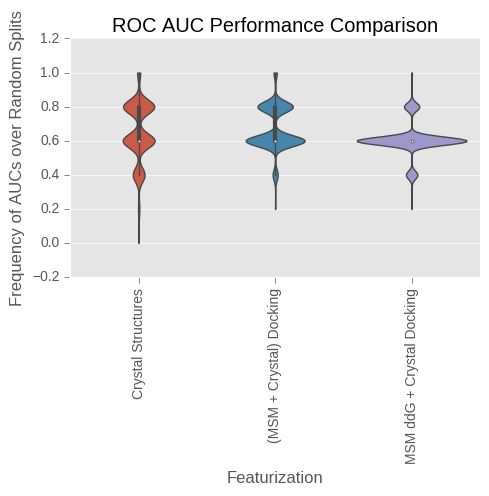

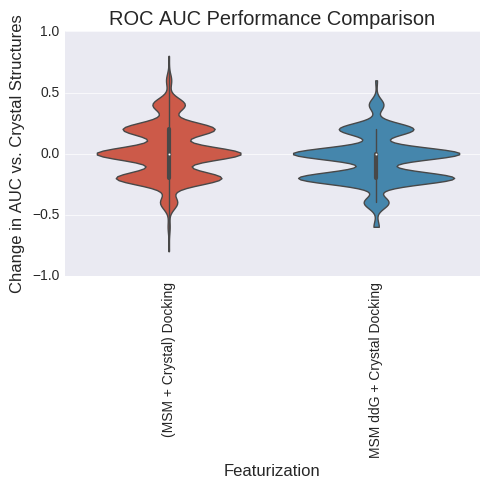

analyzing Recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.762667          0.000000   
(MSM + Crystal) Docking      0.965333          0.202667   
MSM ddG + Crystal Docking    0.964667          0.202000   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.478310898495, 0.559438637239)  
MSM ddG + Crystal Docking  (0.477314503545, 0.558448214519)  


ValueError: list.remove(x): x not in list

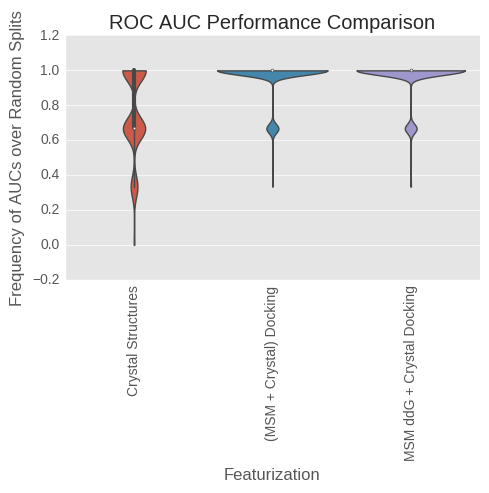

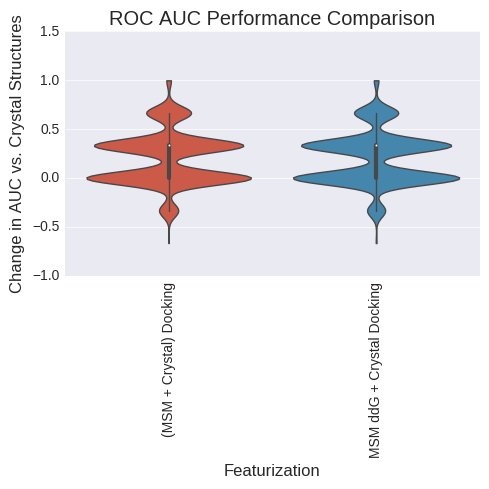

analyzing precision:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.707517            0.0000   
(MSM + Crystal) Docking      0.663217           -0.0443   
MSM ddG + Crystal Docking    0.610617           -0.0969   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.268884553664, 0.343686000649)  
MSM ddG + Crystal Docking  (0.175981615155, 0.241880807478)  


ValueError: list.remove(x): x not in list

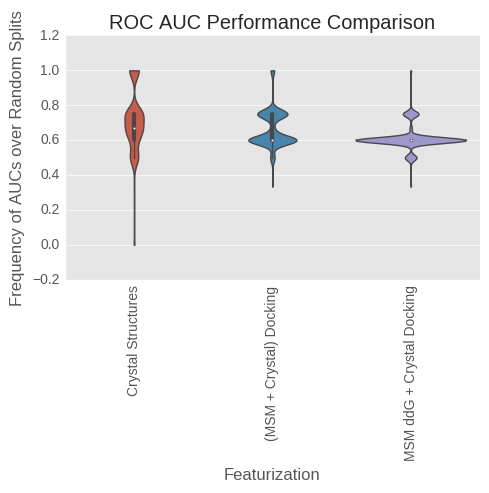

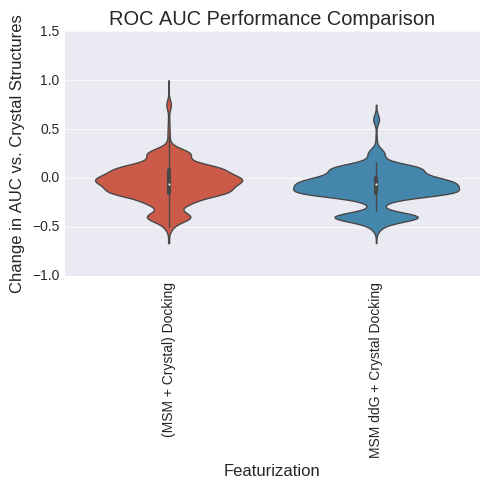

analyzing fdr:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.292483            0.0000   
(MSM + Crystal) Docking      0.336783            0.0443   
MSM ddG + Crystal Docking    0.389383            0.0969   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.465370361758, 0.546550544263)  
MSM ddG + Crystal Docking   (0.60823829954, 0.685810715649)  


ValueError: list.remove(x): x not in list

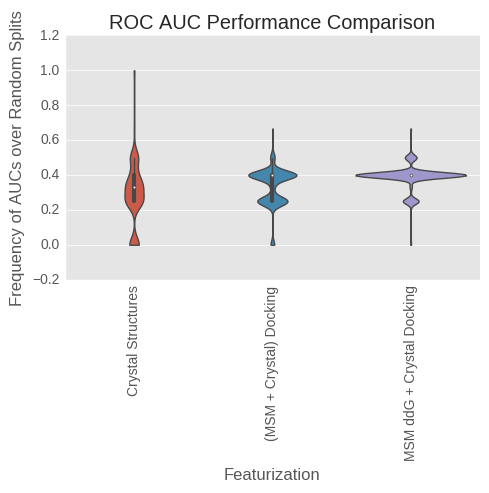

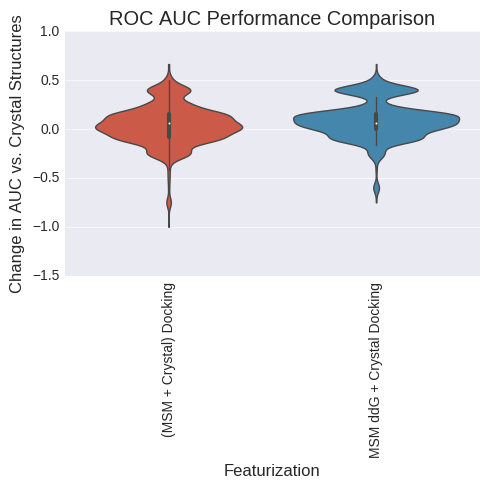

analyzing Recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.762667          0.000000   
(MSM + Crystal) Docking      0.965333          0.202667   
MSM ddG + Crystal Docking    0.964667          0.202000   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.478310898495, 0.559438637239)  
MSM ddG + Crystal Docking  (0.477314503545, 0.558448214519)  


ValueError: list.remove(x): x not in list

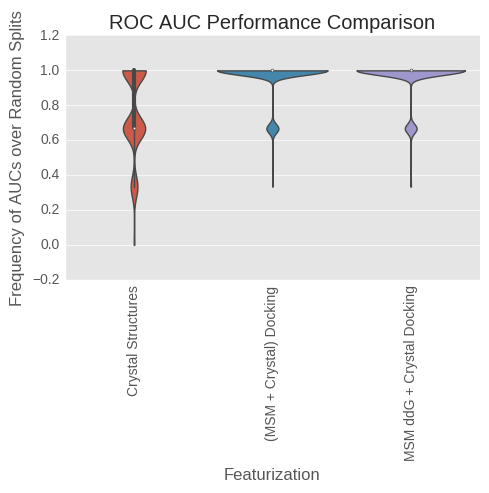

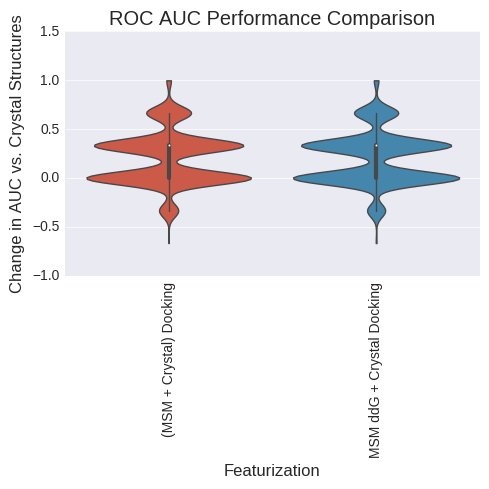

analyzing precision:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.707517            0.0000   
(MSM + Crystal) Docking      0.663217           -0.0443   
MSM ddG + Crystal Docking    0.610617           -0.0969   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.268884553664, 0.343686000649)  
MSM ddG + Crystal Docking  (0.175981615155, 0.241880807478)  


ValueError: list.remove(x): x not in list

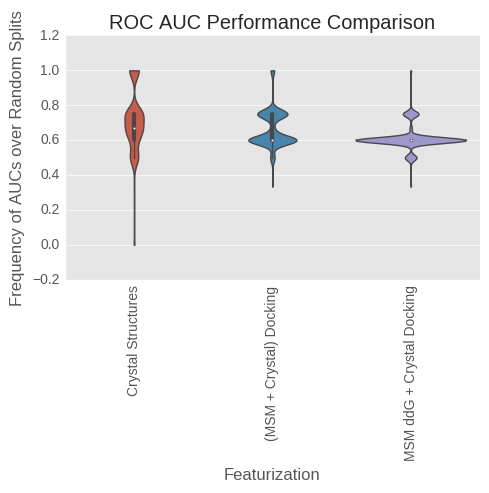

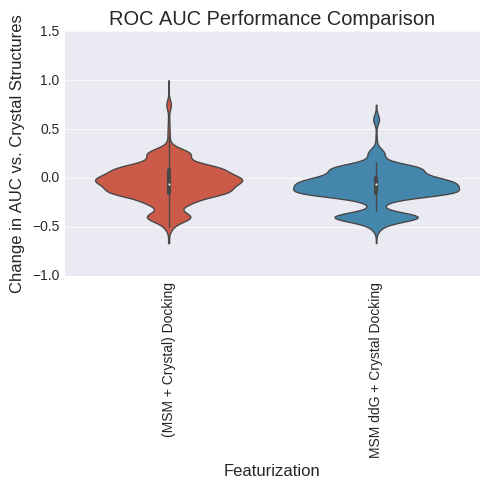

analyzing fdr:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.292483            0.0000   
(MSM + Crystal) Docking      0.336783            0.0443   
MSM ddG + Crystal Docking    0.389383            0.0969   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.465370361758, 0.546550544263)  
MSM ddG + Crystal Docking   (0.60823829954, 0.685810715649)  


ValueError: list.remove(x): x not in list

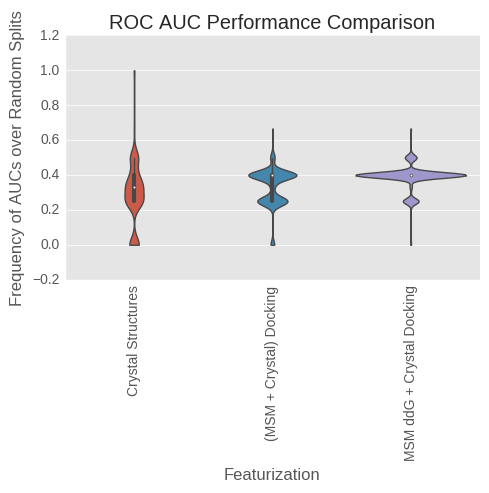

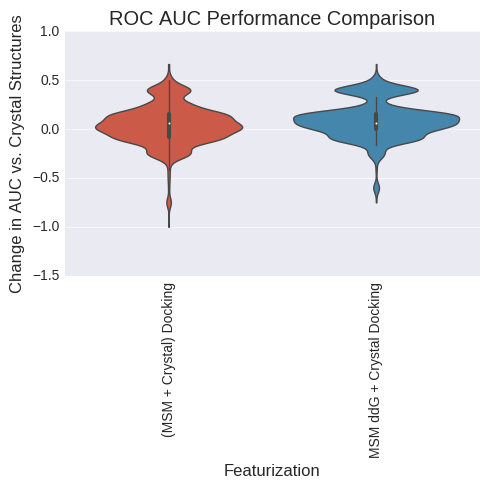

analyzing class B ROC AUC:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.641917           0.00000   
(MSM + Crystal) Docking      0.756417           0.11450   
MSM ddG + Crystal Docking    0.718167           0.07625   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.499272605783, 0.580200101025)  
MSM ddG + Crystal Docking  (0.482298095179, 0.563398711236)  


ValueError: list.remove(x): x not in list

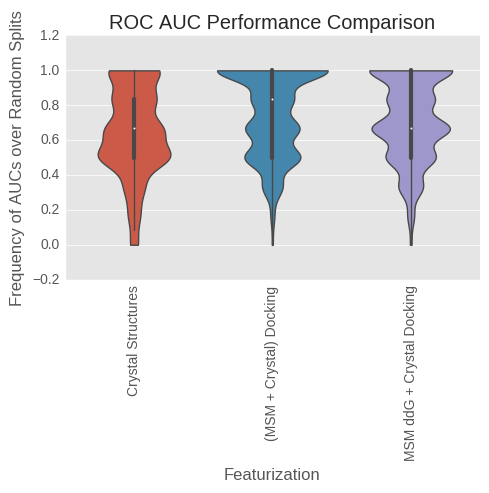

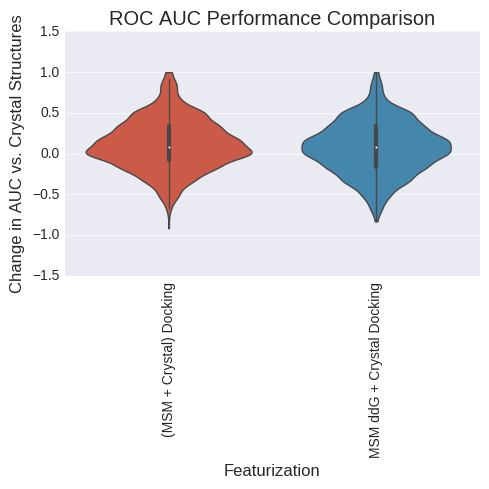

analyzing ROC AUC:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.641917           0.00000   
(MSM + Crystal) Docking      0.756417           0.11450   
MSM ddG + Crystal Docking    0.718167           0.07625   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.507276876187, 0.588090371982)  
MSM ddG + Crystal Docking  (0.489281921069, 0.570322609036)  


ValueError: list.remove(x): x not in list

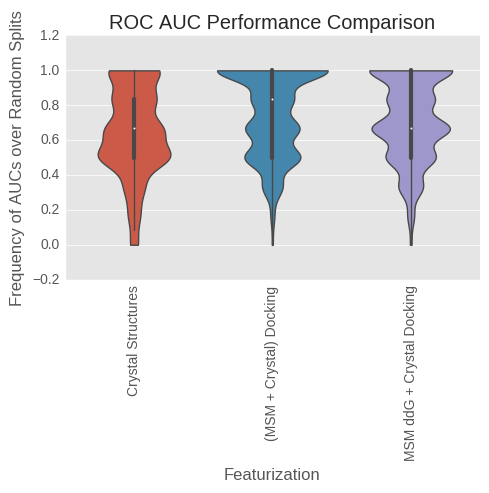

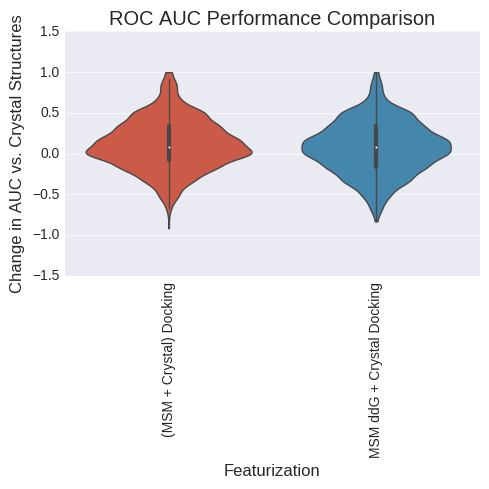

analyzing BedROC
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.647676          0.000000   
(MSM + Crystal) Docking      0.779465          0.131788   
MSM ddG + Crystal Docking    0.832700          0.185024   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.488283745581, 0.569333966854)  
MSM ddG + Crystal Docking  (0.492277420799, 0.573287562317)  


ValueError: list.remove(x): x not in list

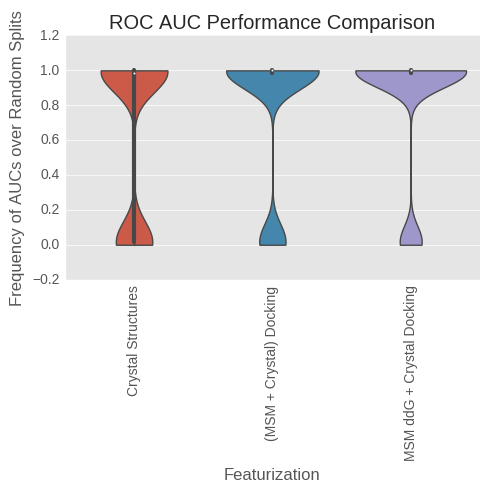

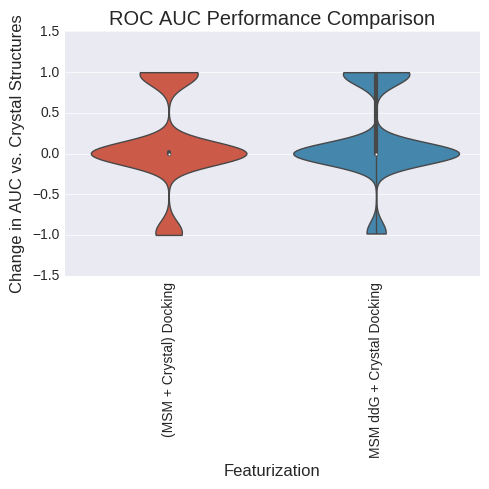

analyzing LogAUC
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.069304          0.000000   
(MSM + Crystal) Docking      0.049536         -0.019768   
MSM ddG + Crystal Docking    0.051209         -0.018095   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.149921093555, 0.212310434313)  
MSM ddG + Crystal Docking  (0.181598092007, 0.248185236648)  


ValueError: list.remove(x): x not in list

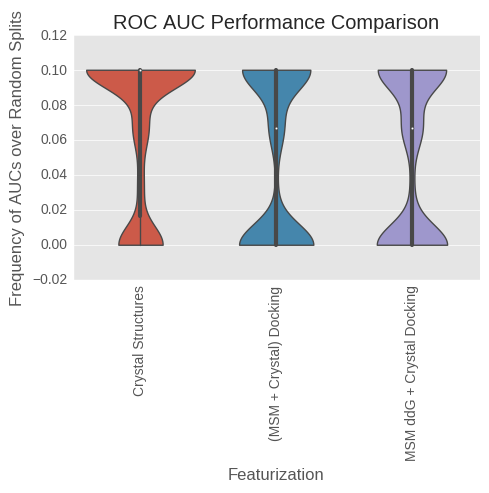

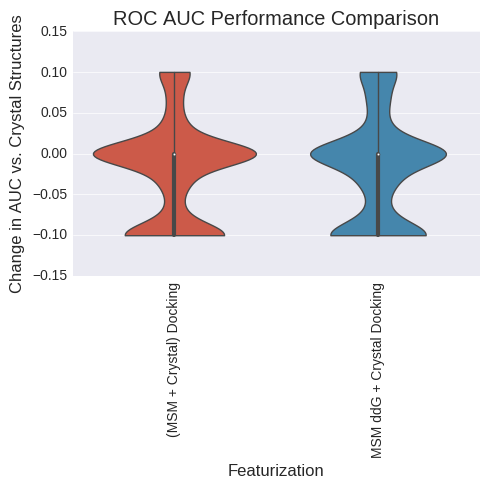

(1,)
(1, 1)


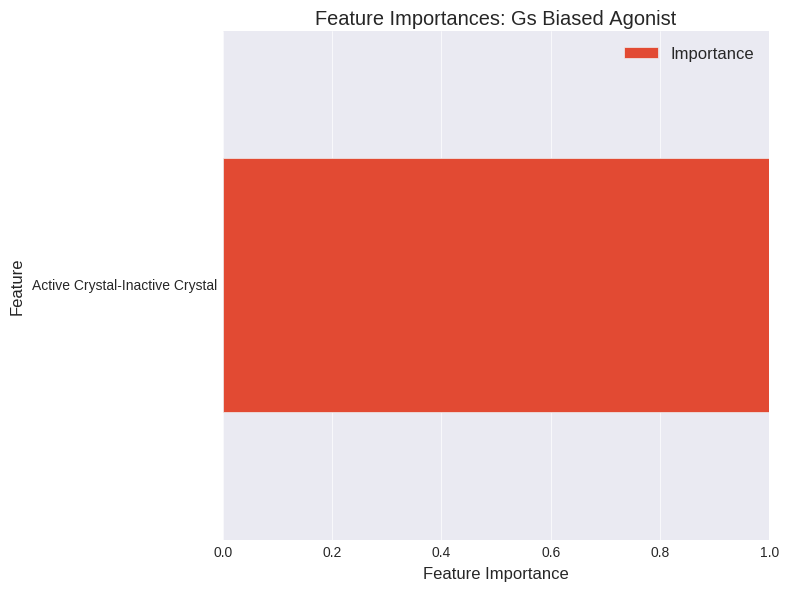

(56,)
(1, 56)


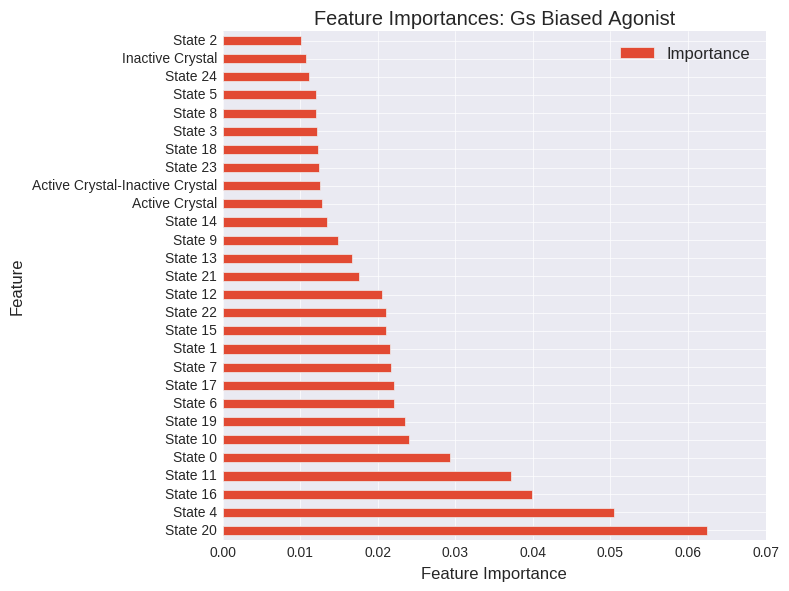

(351,)
(1, 351)


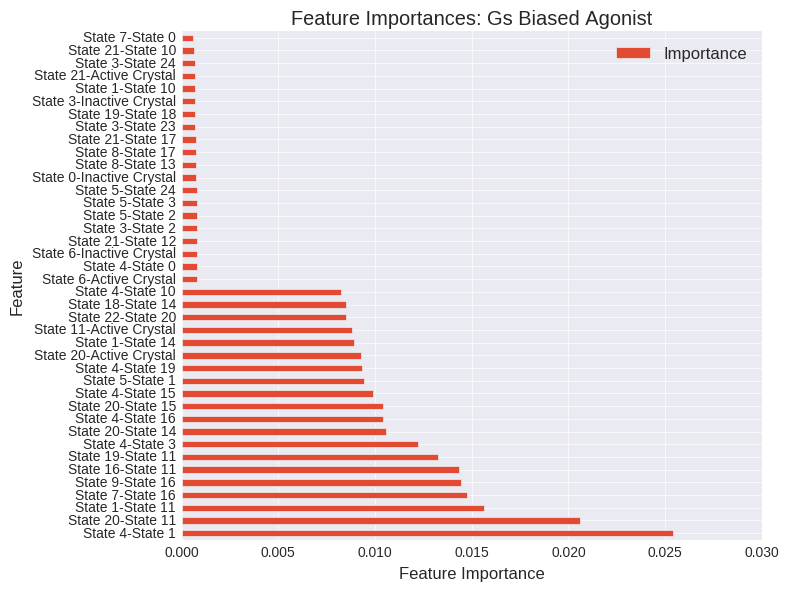

In [155]:
#SP, All ligands, Four class, 32 stereoisomers; new crystal grids; 25 clusters
#RFR. SUBTRACT not divide
importance_dfs = analyze_multiclass_experiment(results_dict[save_name], 
                                                                feature_names,
                                                                [f.columns.values.tolist() for f in features], model_agonists, analysis_dir,
                                                                ["Balanced Agonist", "Gs Biased Agonist"], 
                                                                #["Gs Inactive", "Gs Active"], 
                                                               #["Arr Inactive", "Arr Active"],
                                               np.hstack([X_df.loc[model_agonists].values]),
                                                               #["Gs Inactive", "Gs Partial Active", "Gs Full Active"], 
                                              remake=False, fxn=np.mean)


#TRY LOOCV
#crystal structures might just have bigger boxes






analyzing precision at full recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures            0.64315            0.0000   
(MSM + Crystal) Docking       0.71935            0.0762   
MSM ddG + Crystal Docking     0.73095            0.0878   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.400093864112, 0.480697075677)  
MSM ddG + Crystal Docking   (0.43462222247, 0.515707335775)  


ValueError: list.remove(x): x not in list

analyzing threshold at full recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.559258          0.000000   
(MSM + Crystal) Docking      0.513131         -0.046126   
MSM ddG + Crystal Docking    0.546369         -0.012889   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.471339526622, 0.552502285421)  
MSM ddG + Crystal Docking  (0.538392805281, 0.618565790664)  


ValueError: list.remove(x): x not in list

analyzing Accuracy:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures             0.6086            0.0000   
(MSM + Crystal) Docking        0.6256            0.0170   
MSM ddG + Crystal Docking      0.6048           -0.0038   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.247831572826, 0.321028992742)  
MSM ddG + Crystal Docking  (0.149921093555, 0.212310434313)  


ValueError: list.remove(x): x not in list

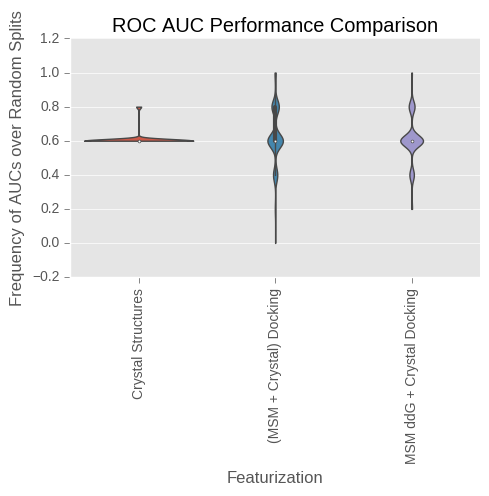

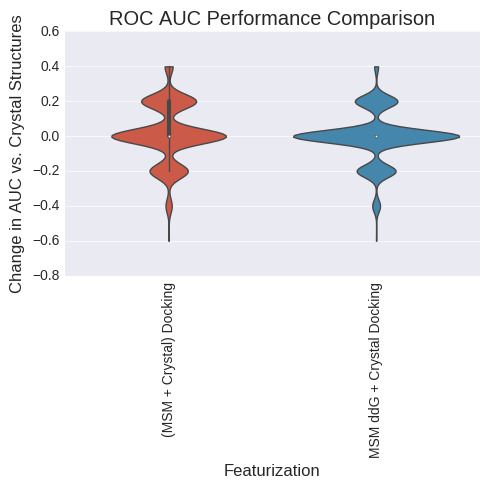

analyzing Recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           1.000000          0.000000   
(MSM + Crystal) Docking      0.836000         -0.164000   
MSM ddG + Crystal Docking    0.884333         -0.115667   

                                                 Sign Test 99% CI  
Crystal Structures                                       (0, 0.0)  
(MSM + Crystal) Docking    (-4.33680868994e-19, 0.00659116490341)  
MSM ddG + Crystal Docking  (-4.33680868994e-19, 0.00659116490341)  


ValueError: list.remove(x): x not in list

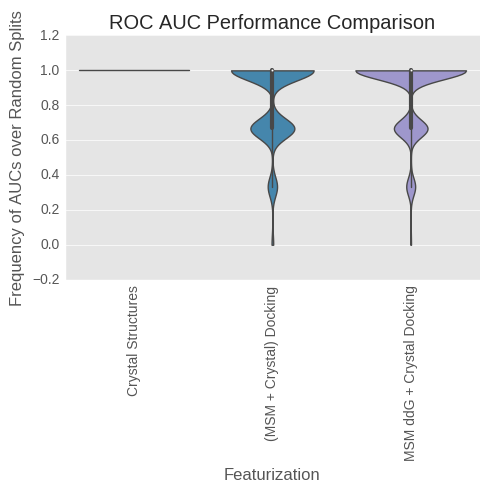

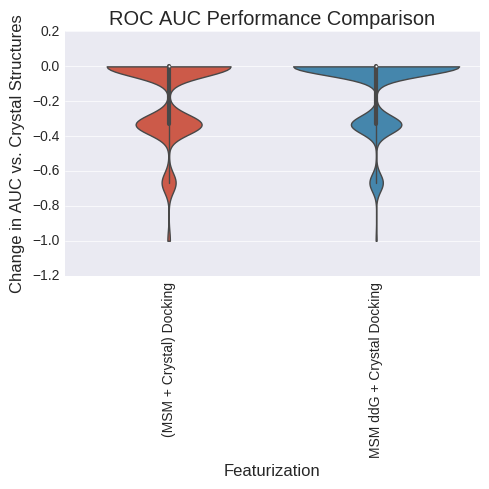

analyzing precision:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.606450          0.000000   
(MSM + Crystal) Docking      0.664317          0.057867   
MSM ddG + Crystal Docking    0.628267          0.021817   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.386338824633, 0.466636667772)  
MSM ddG + Crystal Docking  (0.250696318921, 0.324124699658)  


ValueError: list.remove(x): x not in list

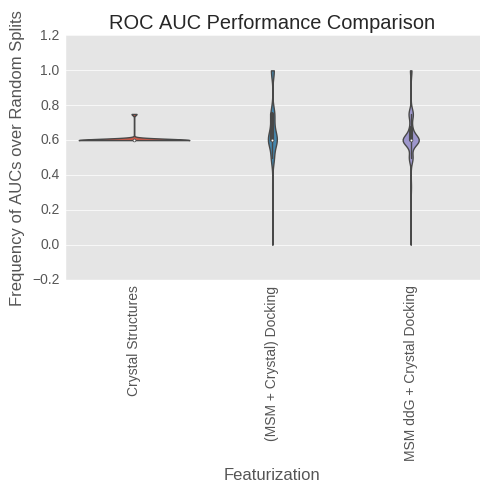

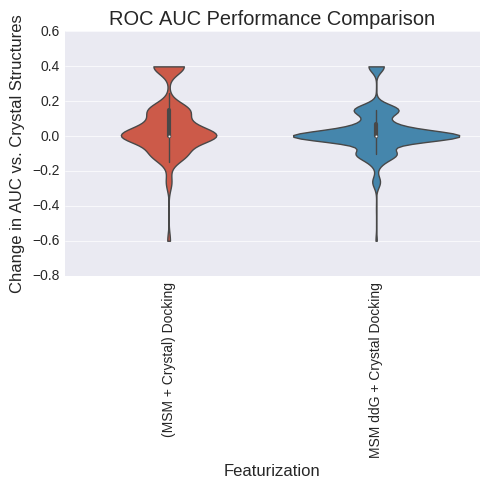

analyzing fdr:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.393550          0.000000   
(MSM + Crystal) Docking      0.335683         -0.057867   
MSM ddG + Crystal Docking    0.371733         -0.021817   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.168509933878, 0.233457947393)  
MSM ddG + Crystal Docking  (0.151773864051, 0.214431299157)  


ValueError: list.remove(x): x not in list

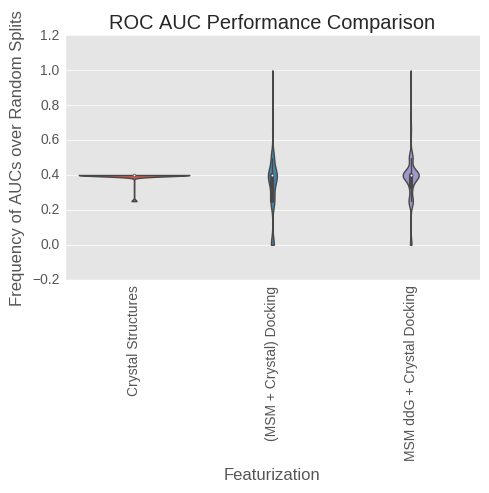

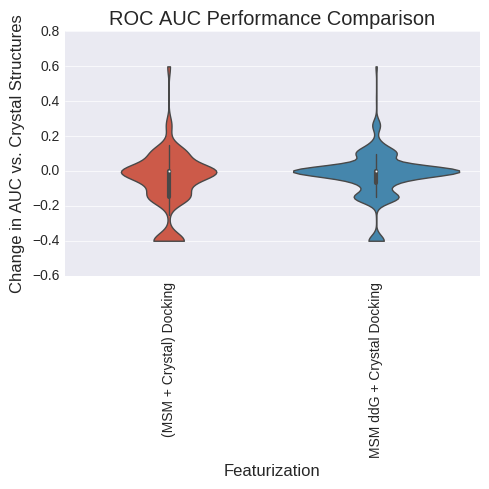

analyzing Recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           1.000000          0.000000   
(MSM + Crystal) Docking      0.836000         -0.164000   
MSM ddG + Crystal Docking    0.884333         -0.115667   

                                                 Sign Test 99% CI  
Crystal Structures                                       (0, 0.0)  
(MSM + Crystal) Docking    (-4.33680868994e-19, 0.00659116490341)  
MSM ddG + Crystal Docking  (-4.33680868994e-19, 0.00659116490341)  


ValueError: list.remove(x): x not in list

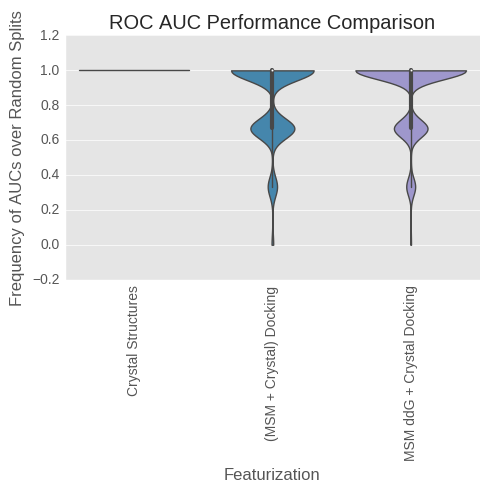

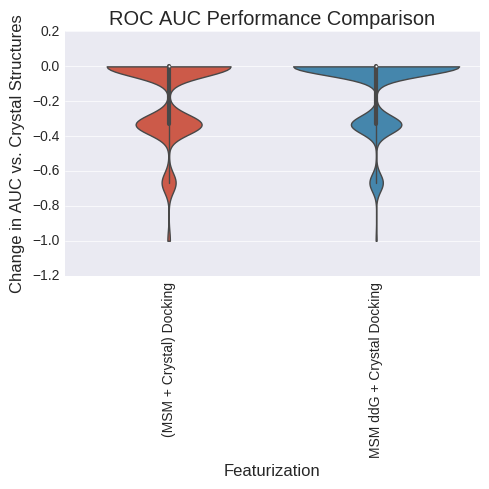

analyzing precision:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.606450          0.000000   
(MSM + Crystal) Docking      0.664317          0.057867   
MSM ddG + Crystal Docking    0.628267          0.021817   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.386338824633, 0.466636667772)  
MSM ddG + Crystal Docking  (0.250696318921, 0.324124699658)  


ValueError: list.remove(x): x not in list

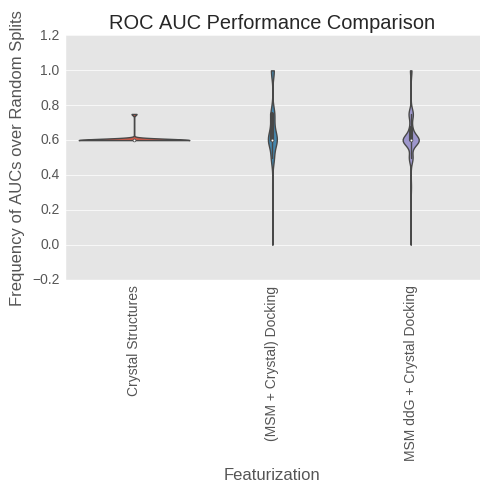

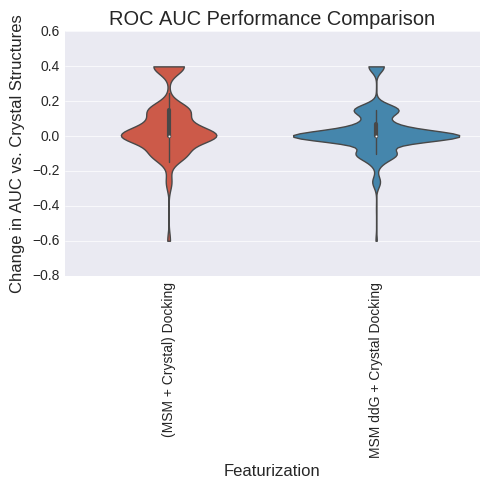

analyzing fdr:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.393550          0.000000   
(MSM + Crystal) Docking      0.335683         -0.057867   
MSM ddG + Crystal Docking    0.371733         -0.021817   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.168509933878, 0.233457947393)  
MSM ddG + Crystal Docking  (0.151773864051, 0.214431299157)  


ValueError: list.remove(x): x not in list

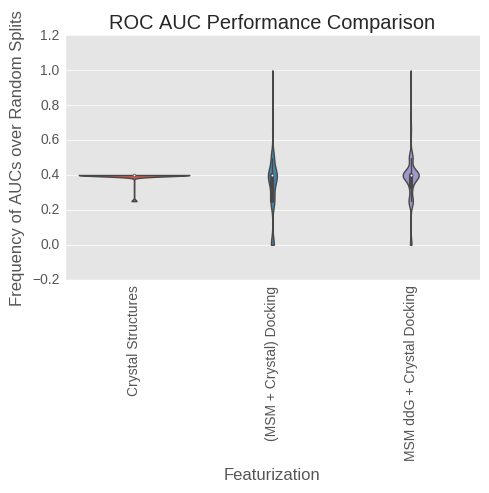

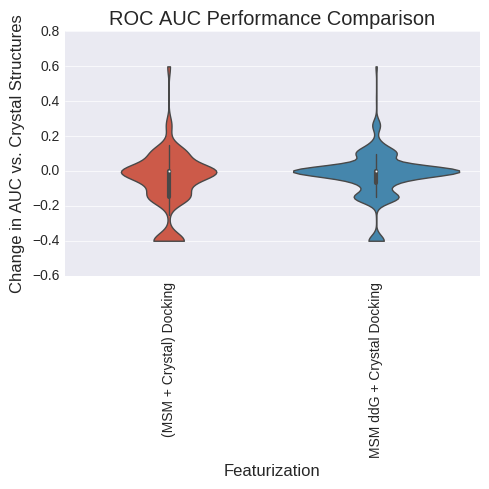

analyzing class B ROC AUC:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.431500          0.000000   
(MSM + Crystal) Docking      0.598833          0.167333   
MSM ddG + Crystal Docking    0.632333          0.200833   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.564614066738, 0.644001788632)  
MSM ddG + Crystal Docking   (0.603148635758, 0.68096629108)  


ValueError: list.remove(x): x not in list

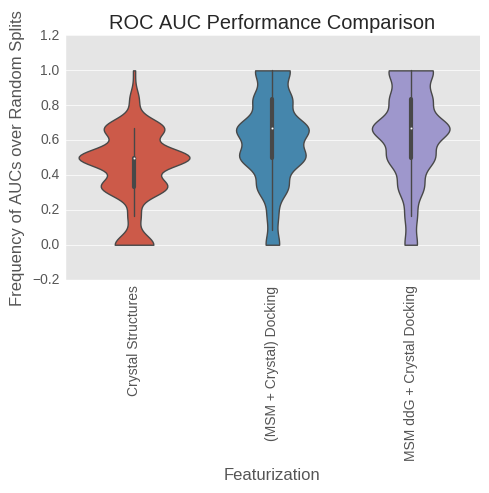

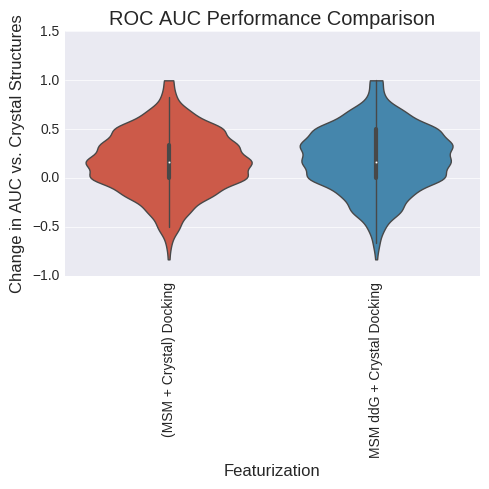

analyzing ROC AUC:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.431500          0.000000   
(MSM + Crystal) Docking      0.598833          0.167333   
MSM ddG + Crystal Docking    0.632333          0.200833   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.564614066738, 0.644001788632)  
MSM ddG + Crystal Docking   (0.603148635758, 0.68096629108)  


ValueError: list.remove(x): x not in list

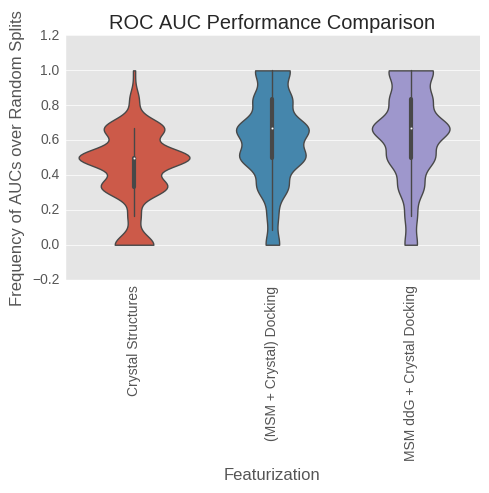

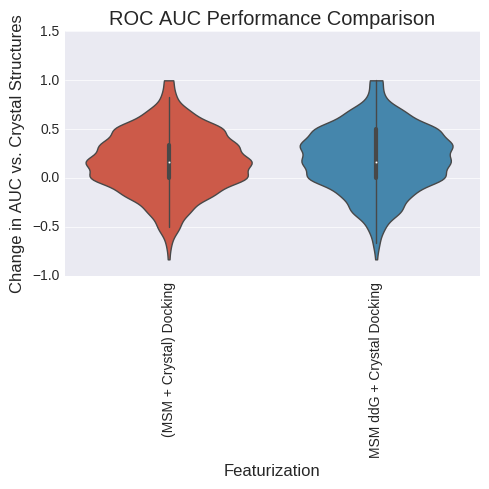

analyzing BedROC
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.615014          0.000000   
(MSM + Crystal) Docking      0.683630          0.068616   
MSM ddG + Crystal Docking    0.761054          0.146040   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.559562572694, 0.639119194326)  
MSM ddG + Crystal Docking   (0.603148635758, 0.68096629108)  


ValueError: list.remove(x): x not in list

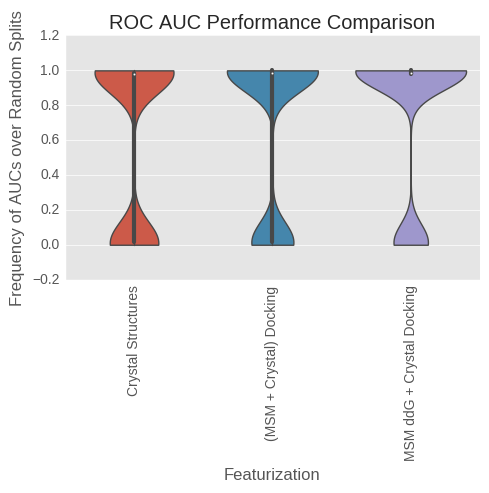

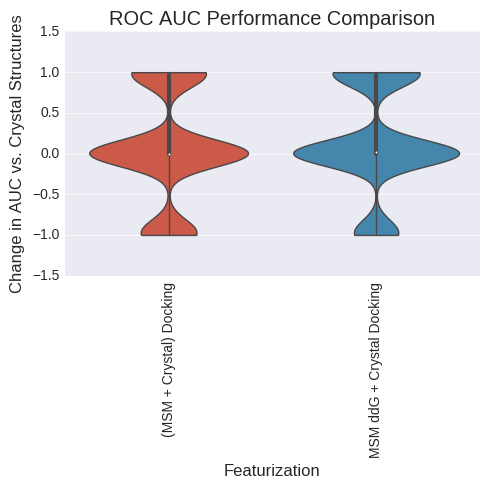

analyzing LogAUC
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.034552          0.000000   
(MSM + Crystal) Docking      0.056761          0.022209   
MSM ddG + Crystal Docking    0.052881          0.018329   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.409938693904, 0.490720422586)  
MSM ddG + Crystal Docking  (0.380453788122, 0.460600798262)  


ValueError: list.remove(x): x not in list

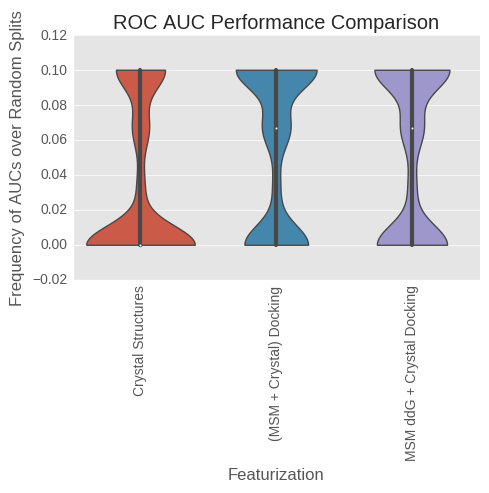

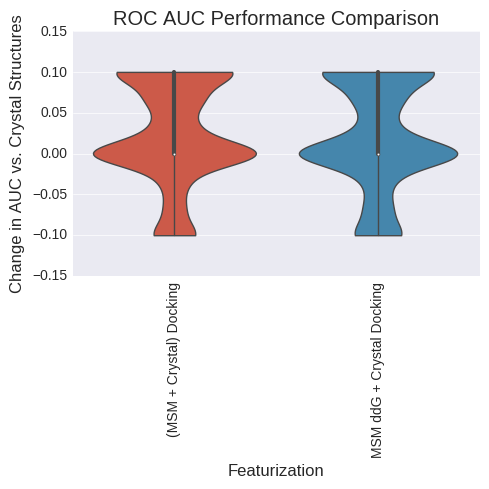

(1, 1)
(1, 1)


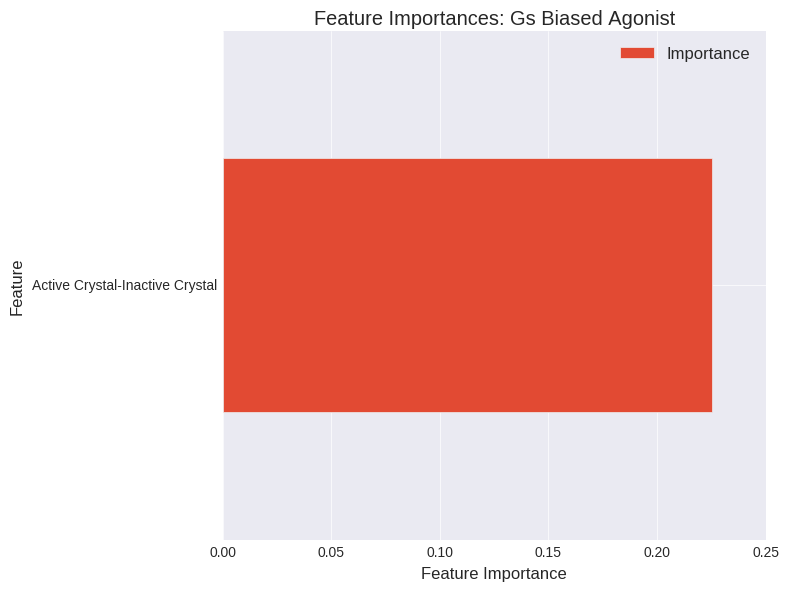

(1, 56)
(1, 56)


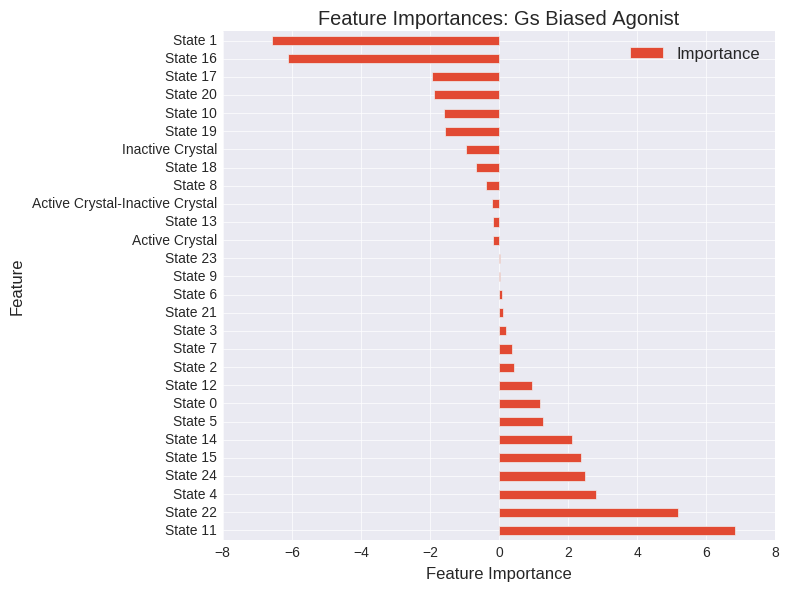

(1, 351)
(1, 351)


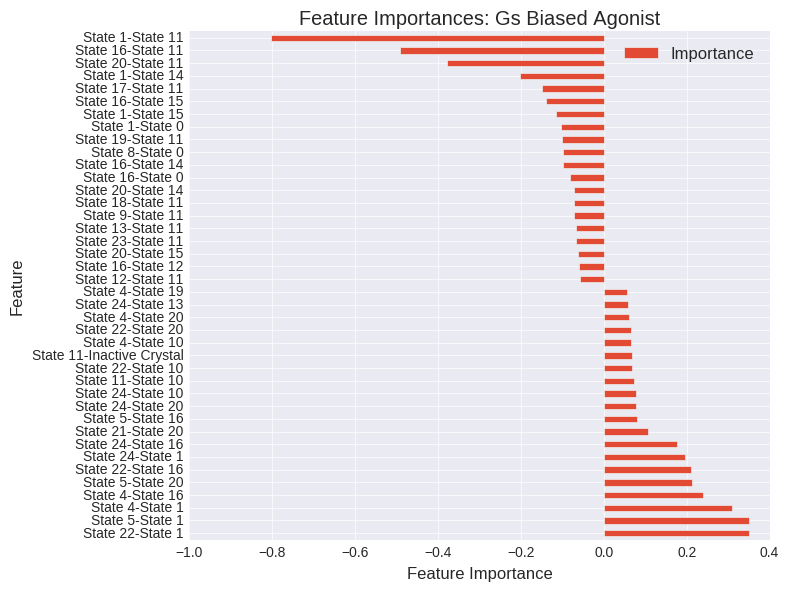

In [158]:
#SP, All ligands, Four class, 32 stereoisomers; new crystal grids; 25 clusters
#RFR
importance_dfs = analyze_multiclass_experiment(results_dict[save_name], 
                                                                feature_names,
                                                                [f.columns.values.tolist() for f in features], model_agonists, analysis_dir,
                                                                ["Balanced Agonist", "Gs Biased Agonist"], 
                                                                #["Gs Inactive", "Gs Active"], 
                                                               #["Arr Inactive", "Arr Active"],
                                               np.hstack([X_df.loc[model_agonists].values]),
                                                               #["Gs Inactive", "Gs Partial Active", "Gs Full Active"], 
                                              remake=False, fxn=np.mean)


#TRY LOOCV
#crystal structures might just have bigger boxes







analyzing precision at full recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.861321          0.000000   
(MSM + Crystal) Docking      0.923944          0.062623   
MSM ddG + Crystal Docking    0.937383          0.076062   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.285221505133, 0.361124949573)  
MSM ddG + Crystal Docking  (0.326794295979, 0.404985318545)  


ValueError: list.remove(x): x not in list

analyzing threshold at full recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.503057          0.000000   
(MSM + Crystal) Docking      0.608531          0.105474   
MSM ddG + Crystal Docking    0.615285          0.112228   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.586892283832, 0.665433560282)  
MSM ddG + Crystal Docking   (0.57979454465, 0.658623575774)  


ValueError: list.remove(x): x not in list

analyzing Accuracy:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.823222          0.000000   
(MSM + Crystal) Docking      0.908000          0.084778   
MSM ddG + Crystal Docking    0.915889          0.092667   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.532357938371, 0.612679751554)  
MSM ddG + Crystal Docking  (0.565624882197, 0.644977790843)  


ValueError: list.remove(x): x not in list

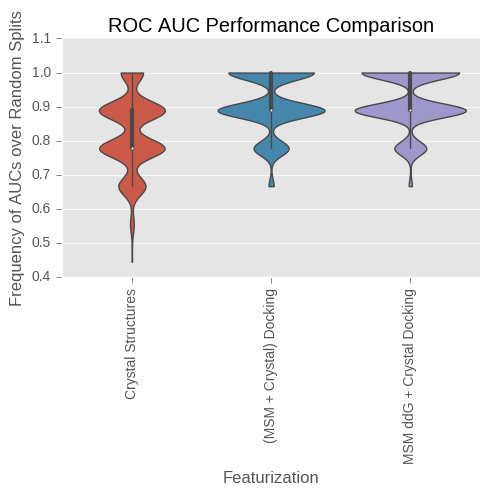

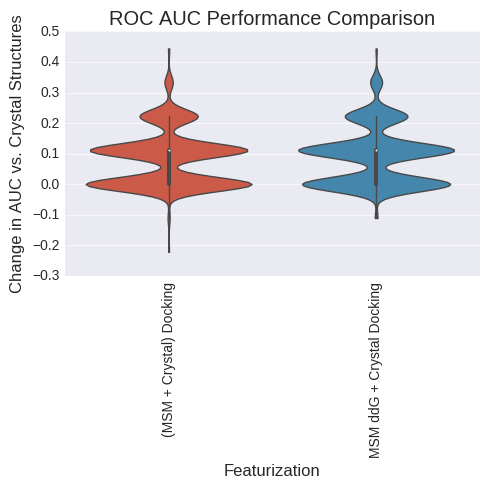

analyzing Recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures             0.8594            0.0000   
(MSM + Crystal) Docking        0.9502            0.0908   
MSM ddG + Crystal Docking      0.9508            0.0914   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.355998211368, 0.435385933262)  
MSM ddG + Crystal Docking  (0.348195043472, 0.427294559796)  


ValueError: list.remove(x): x not in list

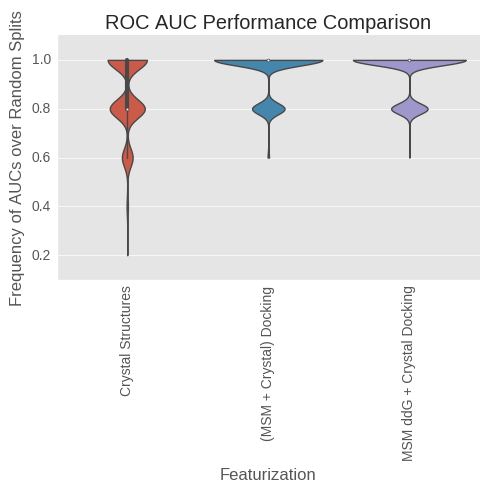

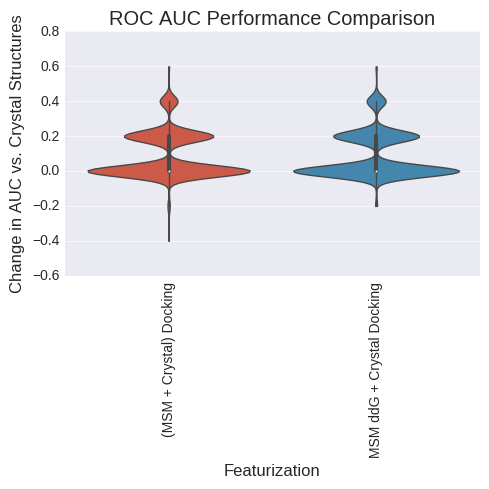

analyzing precision:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.846469          0.000000   
(MSM + Crystal) Docking      0.903527          0.057058   
MSM ddG + Crystal Docking    0.914349          0.067879   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.384376477299, 0.464625379766)  
MSM ddG + Crystal Docking  (0.410924079142, 0.491721855019)  


ValueError: list.remove(x): x not in list

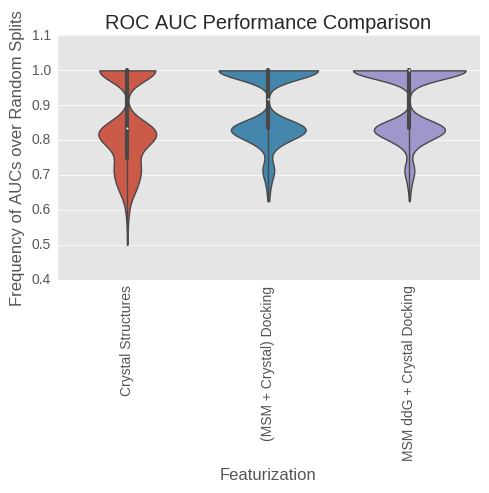

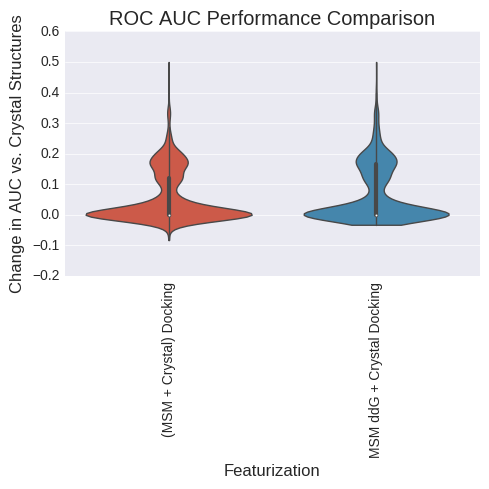

analyzing fdr:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.153531          0.000000   
(MSM + Crystal) Docking      0.096473         -0.057058   
MSM ddG + Crystal Docking    0.085651         -0.067879   

                                                Sign Test 99% CI  
Crystal Structures                                      (0, 0.0)  
(MSM + Crystal) Docking      (0.00167204411098, 0.0148532091434)  
MSM ddG + Crystal Docking  (0.000117416353618, 0.00846056621998)  


ValueError: list.remove(x): x not in list

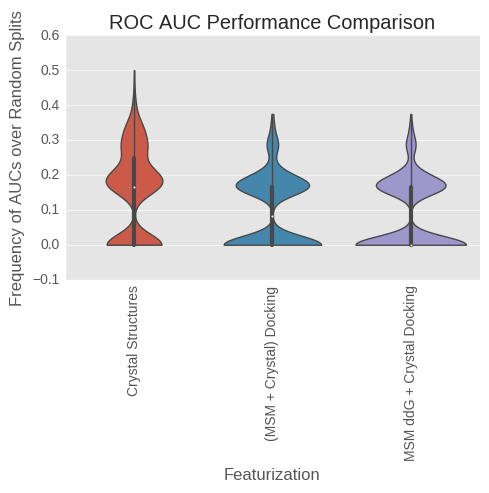

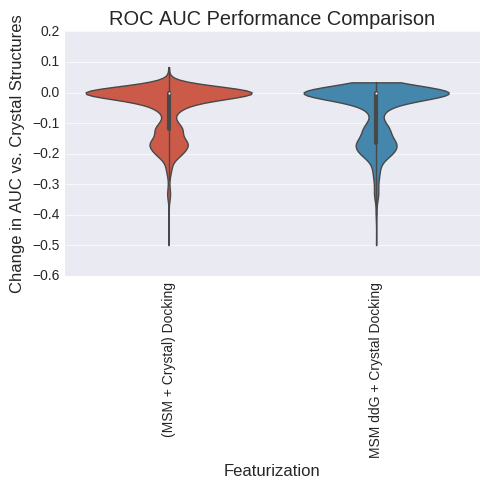

analyzing Recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures             0.8594            0.0000   
(MSM + Crystal) Docking        0.9502            0.0908   
MSM ddG + Crystal Docking      0.9508            0.0914   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.355998211368, 0.435385933262)  
MSM ddG + Crystal Docking  (0.348195043472, 0.427294559796)  


ValueError: list.remove(x): x not in list

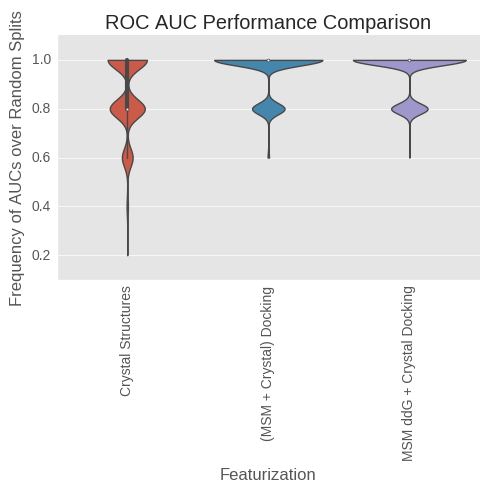

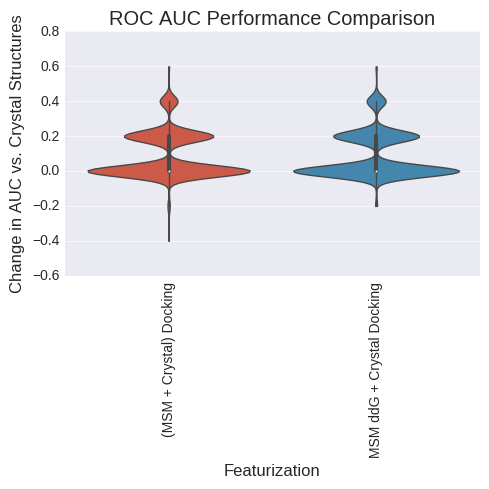

analyzing precision:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.846469          0.000000   
(MSM + Crystal) Docking      0.903527          0.057058   
MSM ddG + Crystal Docking    0.914349          0.067879   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.384376477299, 0.464625379766)  
MSM ddG + Crystal Docking  (0.410924079142, 0.491721855019)  


ValueError: list.remove(x): x not in list

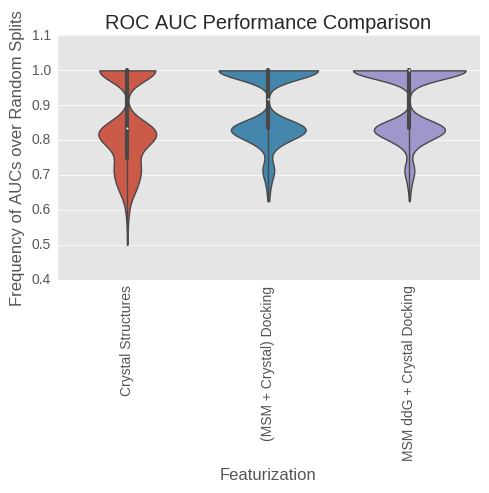

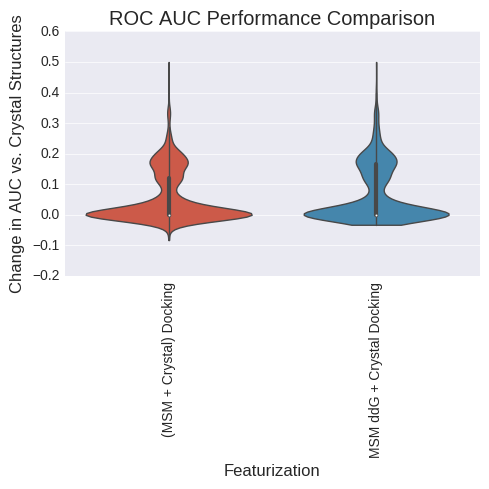

analyzing fdr:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.153531          0.000000   
(MSM + Crystal) Docking      0.096473         -0.057058   
MSM ddG + Crystal Docking    0.085651         -0.067879   

                                                Sign Test 99% CI  
Crystal Structures                                      (0, 0.0)  
(MSM + Crystal) Docking      (0.00167204411098, 0.0148532091434)  
MSM ddG + Crystal Docking  (0.000117416353618, 0.00846056621998)  


ValueError: list.remove(x): x not in list

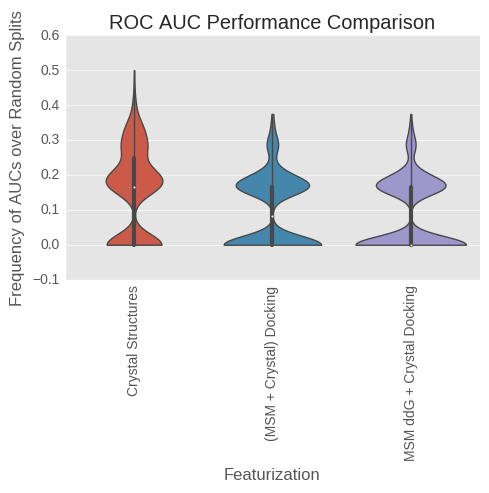

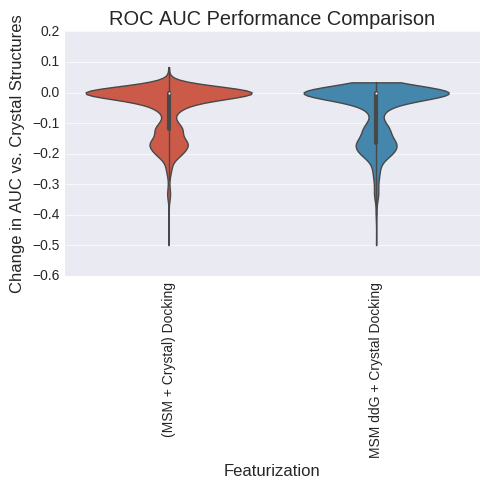

analyzing class B ROC AUC:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.912475          0.000000   
(MSM + Crystal) Docking      0.961900          0.049425   
MSM ddG + Crystal Docking    0.972550          0.060075   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.462387957582, 0.543572495429)  
MSM ddG + Crystal Docking  (0.512284857525, 0.593016478995)  


ValueError: list.remove(x): x not in list

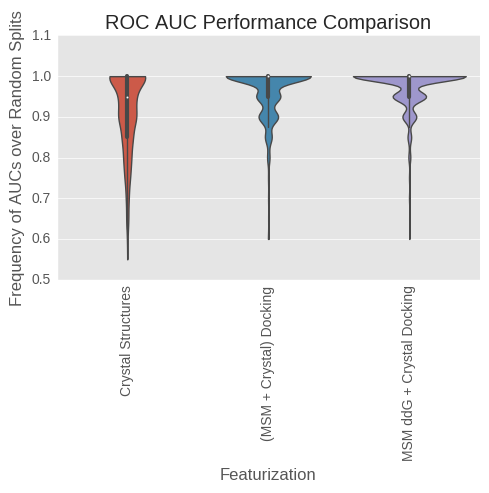

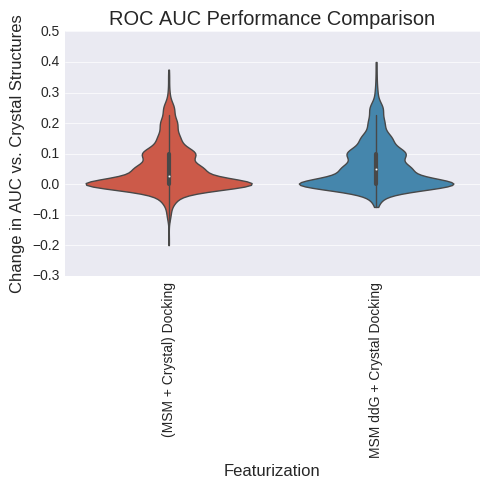

analyzing ROC AUC:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.912475          0.000000   
(MSM + Crystal) Docking      0.961900          0.049425   
MSM ddG + Crystal Docking    0.972550          0.060075   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.462387957582, 0.543572495429)  
MSM ddG + Crystal Docking  (0.512284857525, 0.593016478995)  


ValueError: list.remove(x): x not in list

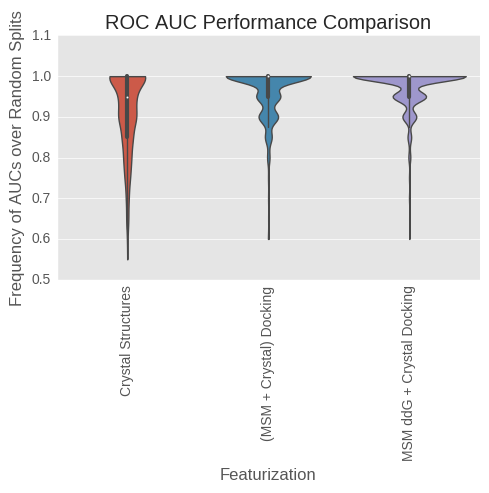

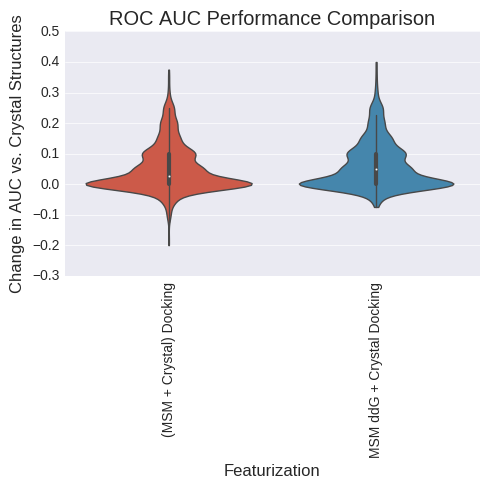

analyzing BedROC
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.945900          0.000000   
(MSM + Crystal) Docking      0.998246          0.052346   
MSM ddG + Crystal Docking    0.999283          0.053383   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.438581002308, 0.519695826618)  
MSM ddG + Crystal Docking  (0.490280258729, 0.571311089047)  


ValueError: list.remove(x): x not in list

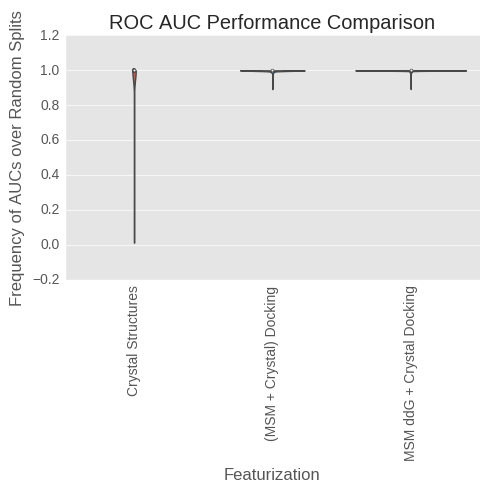

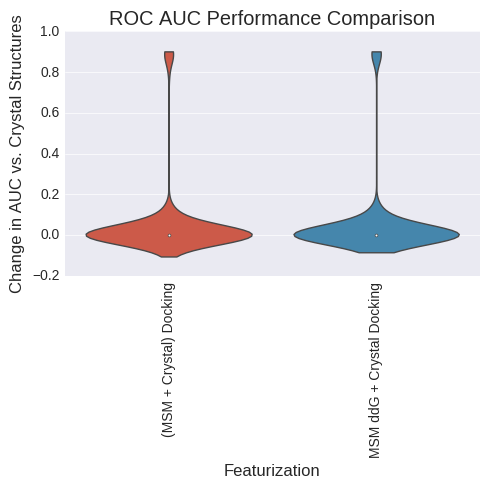

analyzing LogAUC
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.148515          0.000000   
(MSM + Crystal) Docking      0.072630         -0.075885   
MSM ddG + Crystal Docking    0.063000         -0.085515   

                                             Sign Test 99% CI  
Crystal Structures                                   (0, 0.0)  
(MSM + Crystal) Docking      (0.0631827343497, 0.10831429718)  
MSM ddG + Crystal Docking  (0.0510686968051, 0.0926128873416)  


ValueError: list.remove(x): x not in list

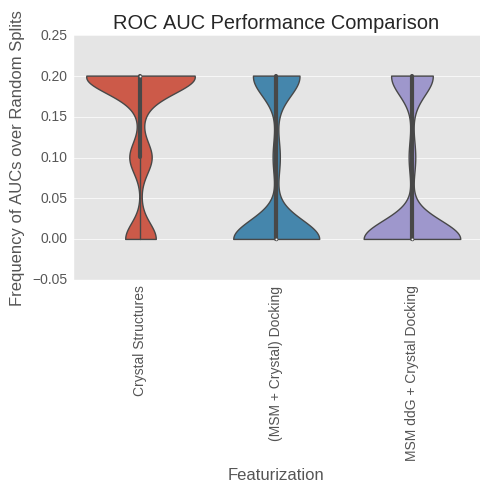

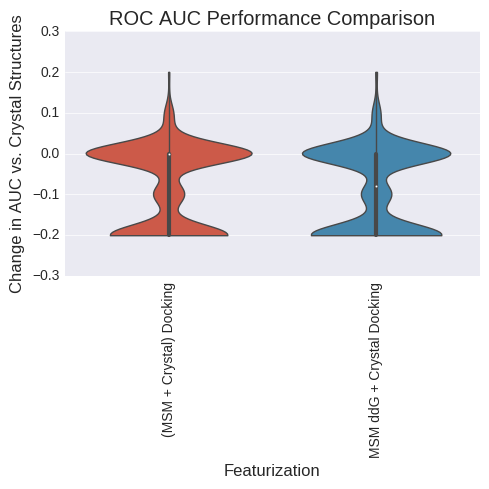

(1,)
(1, 1)


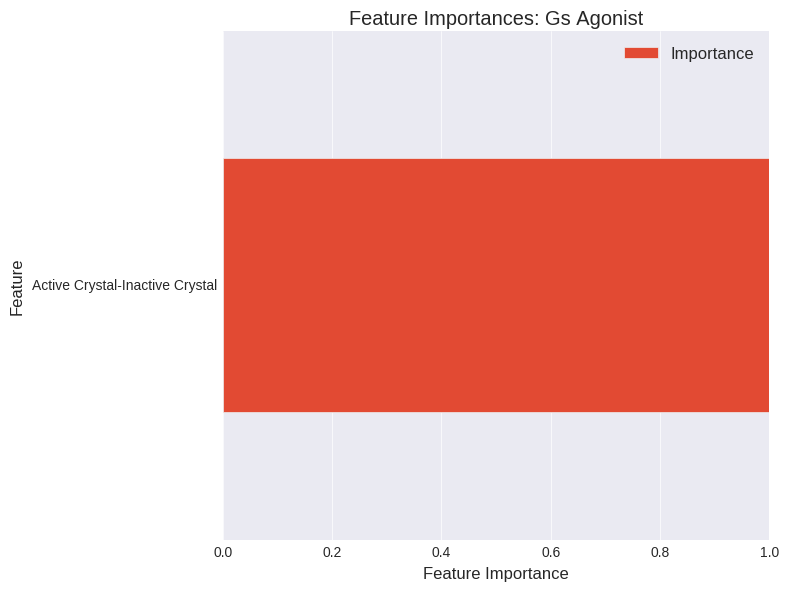

(56,)
(1, 56)


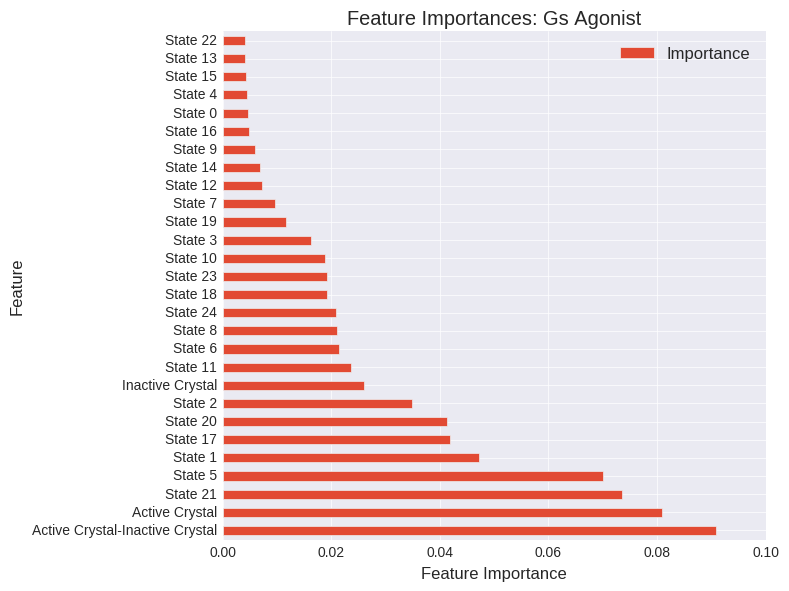

(351,)
(1, 351)


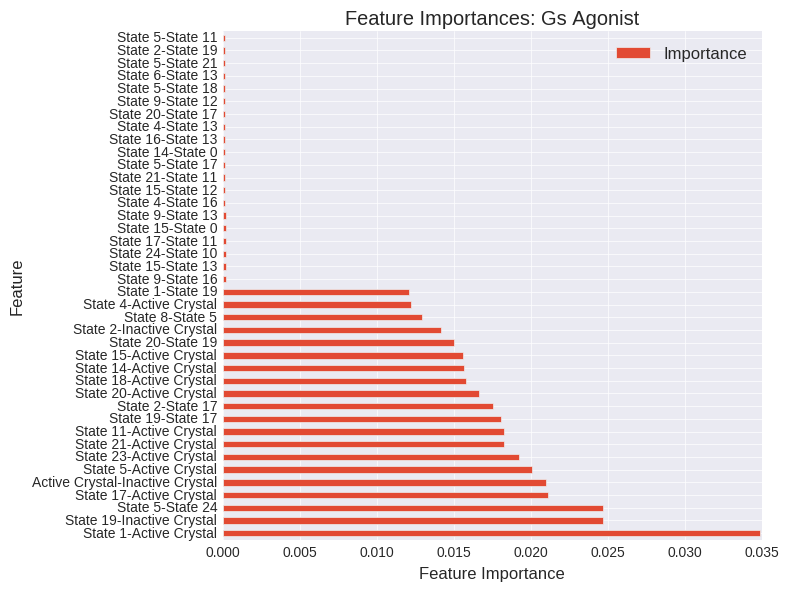

In [148]:
#SP, All ligands, Four class, 32 stereoisomers; new crystal grids; 25 clusters
#RFR
importance_dfs = analyze_multiclass_experiment(results_dict[save_name], 
                                                                feature_names,
                                                                [f.columns.values.tolist() for f in features], model_agonists, analysis_dir,
                                                                ["Gs Antagonist", "Gs Agonist"], 
                                                                #["Gs Inactive", "Gs Active"], 
                                                               #["Arr Inactive", "Arr Active"],
                                               np.hstack([X_df.loc[model_agonists].values]),
                                                               #["Gs Inactive", "Gs Partial Active", "Gs Full Active"], 
                                              remake=False, fxn=np.mean)


#TRY LOOCV
#crystal structures might just have bigger boxes

In [159]:
df = pd.DataFrame(compute_pearson_matrix(ddg_df.loc[bret.loc[bret[gprot_col] > 0.25].index].values, bret[gprot_col].pow(-1).multiply(bret[arr_col]).loc[bret.loc[bret[gprot_col] > 0.25].index].values.reshape((-1,1))), index=ddg_df.columns, columns=["val"]).sort("val", inplace=False)
df

,val
State 22-State 1,-0.511923
State 22-State 20,-0.491272
State 7-State 16,-0.489855
State 22-State 16,-0.477284
State 11-Inactive Crystal,-0.475383
State 11-Active Crystal,-0.447462
State 7-State 20,-0.434385
State 4-State 1,-0.418681
State 4-State 16,-0.407884
State 22-State 19,-0.407750


In [260]:
samples_features[["State 20", "State 7", "State 2", "State 11", "State 24", "State 0"]]

,State 20,State 7,State 2,State 11,State 24,State 0
ASN51 to GLY320,3.400357,5.796944,5.393804,4.980194,5.246191,2.861804
ASN51 to SER319,6.567547,3.665659,3.371869,2.846085,3.154946,6.151082
ASP79 to ASN318,9.458011,5.899562,5.368162,7.018192,4.422887,8.974729
ASP79 to TYR326,11.689258,5.101528,7.597464,8.755164,9.183944,13.074594
Ala59-Leu266_ca_dist,23.935165,24.977819,32.376942,26.200296,33.219772,26.669958
Ala59-Leu266_closest_dist,22.002546,22.421801,29.317381,22.828314,29.901381,23.803989
Asn148-Leu266_ca_dist,24.479467,23.338385,34.561798,29.733822,33.943245,28.317188
Asn148-Leu266_closest_dist,21.405922,18.896257,31.602221,26.784969,31.170818,26.198502
Asn148_Arg333_ca_dist,26.301704,26.253181,26.740934,28.295858,27.191751,28.311604
Asn148_Arg333_closest_dist,23.872595,23.700354,24.073654,26.034153,24.937086,25.912493


In [167]:
ddg_df.columns.values.tolist()

['Ala59-Leu266_ca_dist',
 'Ala59-Leu266_closest_dist',
 'Asn148-Leu266_ca_dist',
 'Asn148-Leu266_closest_dist',
 'Asn148_Arg333_ca_dist',
 'Asn148_Arg333_closest_dist',
 'Leu266_Arg333_ca_dist',
 'Leu266_Arg333_closest_dist',
 'Thr66-Leu266_ca_dist',
 'Thr66-Leu266_closest_dist']

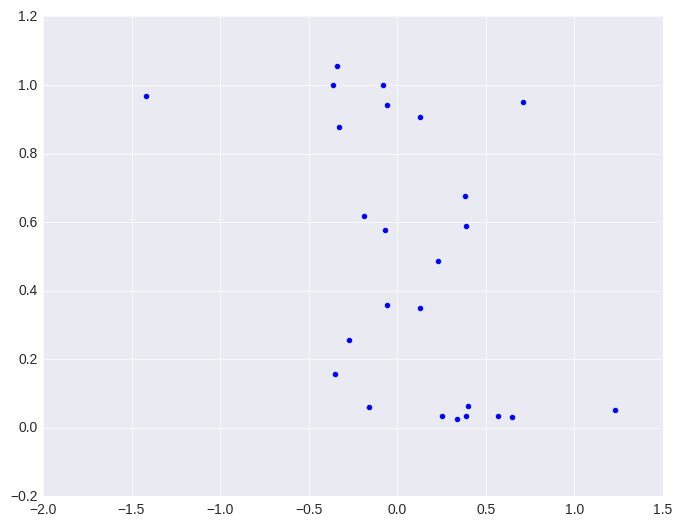

In [176]:
#plt.scatter(ddg_df["Ala59-Leu266_ca_dist_mean33.51"].loc[bret.index], bret[gprot_col])
#plt.scatter(obs_df["Thr66-Leu266_closest_dist"].loc[y_df.loc[y_df["class"]>-1.].index], y_df.loc[y_df["class"] > -1.])
plt.scatter(ddg_df["State 11-Inactive Crystal"].loc[bret.loc[bret[gprot_col] > 0.25].index].values, bret[gprot_col].pow(-1).multiply(bret[arr_col]).loc[bret.loc[bret[gprot_col] > 0.25].index])

(array([ 9.,  1.,  1.,  2.,  1.,  3.,  1.,  0.,  3.,  5.]),
 array([ 0.        ,  0.10549451,  0.21098901,  0.31648352,  0.42197802,
         0.52747253,  0.63296703,  0.73846154,  0.84395604,  0.94945055,
         1.05494505]),
 <a list of 10 Patch objects>)

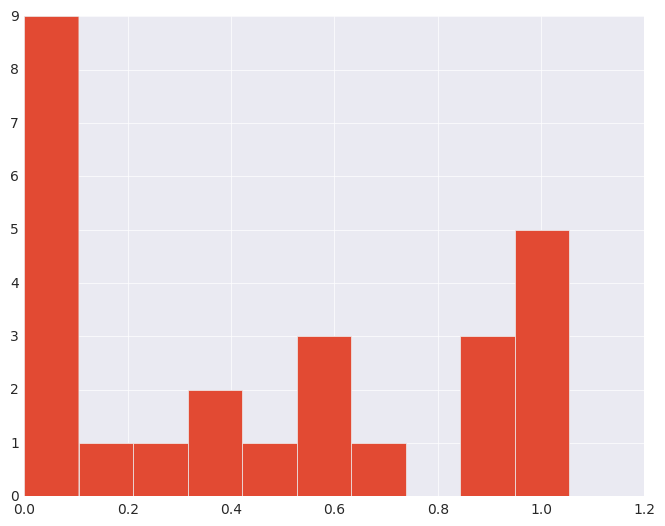

In [148]:
plt.hist(bret[gprot_col].pow(-1).multiply(bret[arr_col]).loc[bret.loc[bret[gprot_col] > 0.2].index])

In [128]:
X_df["State 4"].loc[["CID_5152", "CID_2083", "CID_913", "CID_3609"]]

,State 4,State 4
CID_5152,8.55,0.093939
CID_2083,8.17,0.260148
CID_913,7.27,0.180358
CID_3609,9.85,0.306672


(array([  4.00000000e+00,   2.30000000e+01,   4.10000000e+01,
          8.50000000e+01,   1.51000000e+02,   1.28000000e+02,
          1.07000000e+02,   1.02000000e+02,   9.80000000e+01,
          1.44000000e+02,   2.44000000e+02,   3.96000000e+02,
          6.04000000e+02,   1.05700000e+03,   1.35500000e+03,
          1.64500000e+03,   1.78600000e+03,   1.77600000e+03,
          1.50500000e+03,   1.39000000e+03,   1.18200000e+03,
          1.02500000e+03,   8.70000000e+02,   7.43000000e+02,
          6.47000000e+02,   5.34000000e+02,   4.19000000e+02,
          3.85000000e+02,   3.23000000e+02,   2.94000000e+02,
          1.95000000e+02,   1.77000000e+02,   1.51000000e+02,
          1.20000000e+02,   8.00000000e+01,   7.70000000e+01,
          3.40000000e+01,   2.70000000e+01,   2.30000000e+01,
          1.80000000e+01,   1.20000000e+01,   9.00000000e+00,
          5.00000000e+00,   3.00000000e+00,   4.00000000e+00,
          1.00000000e+00,   0.00000000e+00,   1.00000000e+00,
        

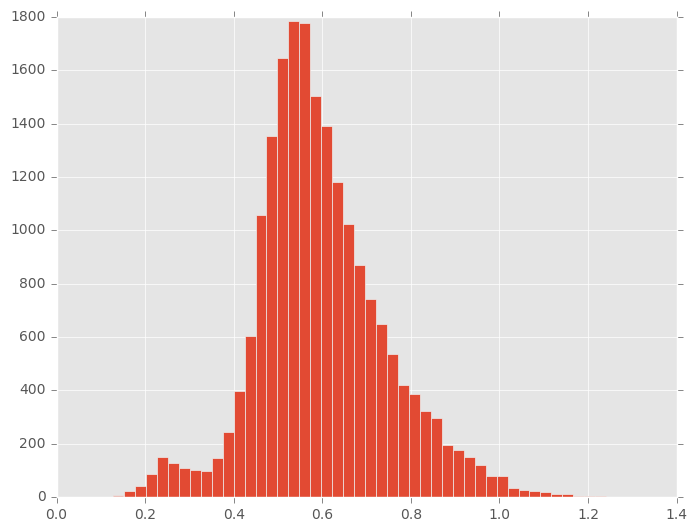

In [371]:
plt.hist(lig_features_eq["msm"]["rmsd_npxxy_active"], bins=50)

# plt.hist(lig_features_eq["msm"]["Asn148-Leu266_ca_dist"], bins=50)

(array([    4.,     9.,    15.,    22.,    16.,    16.,    27.,    37.,
           55.,    62.,    73.,    94.,   107.,   179.,   328.,   663.,
         1025.,  1392.,  1727.,  1847.,  1763.,  1505.,  1072.,   820.,
          663.,   503.,   468.,   466.,   493.,   462.,   503.,   484.,
          497.,   405.,   363.,   303.,   268.,   248.,   230.,   201.,
          171.,   153.,    91.,    66.,    38.,    34.,    17.,     7.,
            3.,     6.]),
 array([ 14.71045876,  15.25179203,  15.79312531,  16.33445858,
         16.87579185,  17.41712513,  17.9584584 ,  18.49979168,
         19.04112495,  19.58245823,  20.1237915 ,  20.66512478,
         21.20645805,  21.74779133,  22.2891246 ,  22.83045788,
         23.37179115,  23.91312443,  24.4544577 ,  24.99579098,
         25.53712425,  26.07845753,  26.6197908 ,  27.16112408,
         27.70245735,  28.24379063,  28.7851239 ,  29.32645718,
         29.86779045,  30.40912373,  30.950457  ,  31.49179028,
         32.03312355,  32.5744

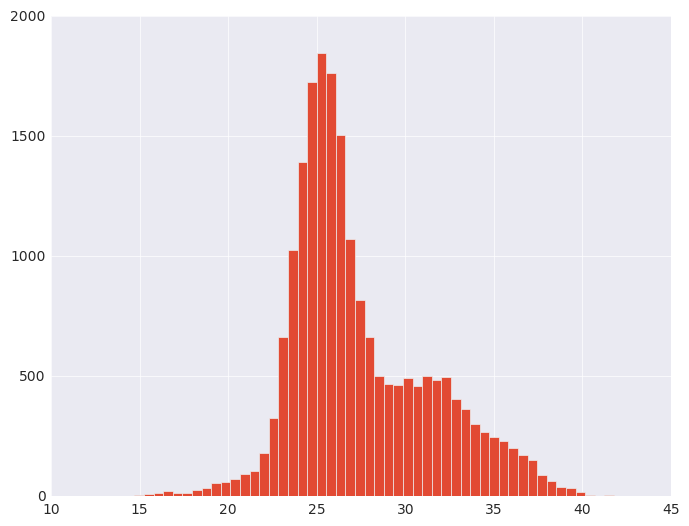

In [208]:
plt.hist(lig_features_eq["msm"]["Ala59-Leu266_ca_dist"], bins=50)

analyzing precision at full recall:
(10000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.757630          0.000000   
(MSM + Crystal) Docking      0.815445          0.057815   
MSM ddG + Crystal Docking    0.768145          0.010515   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.400080641259, 0.425435127225)  
MSM ddG + Crystal Docking  (0.312758025231, 0.336874440006)  


ValueError: list.remove(x): x not in list

analyzing threshold at full recall:
(10000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.549661          0.000000   
(MSM + Crystal) Docking      0.649757          0.100097   
MSM ddG + Crystal Docking    0.624488          0.074827   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.569746773153, 0.595143823641)  
MSM ddG + Crystal Docking  (0.567639243549, 0.593054138054)  


ValueError: list.remove(x): x not in list

analyzing Accuracy:
(10000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures            0.64548           0.00000   
(MSM + Crystal) Docking       0.66776           0.02228   
MSM ddG + Crystal Docking     0.60424          -0.04124   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.339205006356, 0.363792052025)  
MSM ddG + Crystal Docking  (0.225436397764, 0.247313427275)  


ValueError: list.remove(x): x not in list

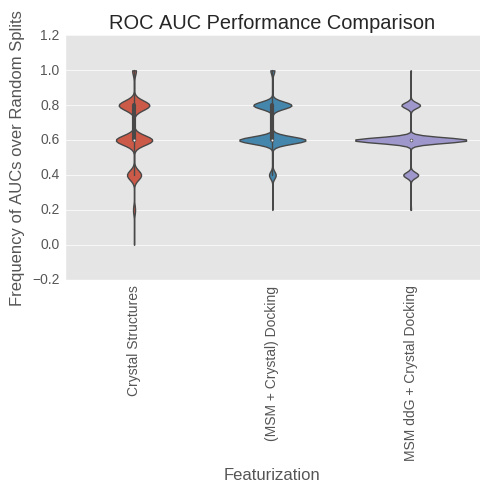

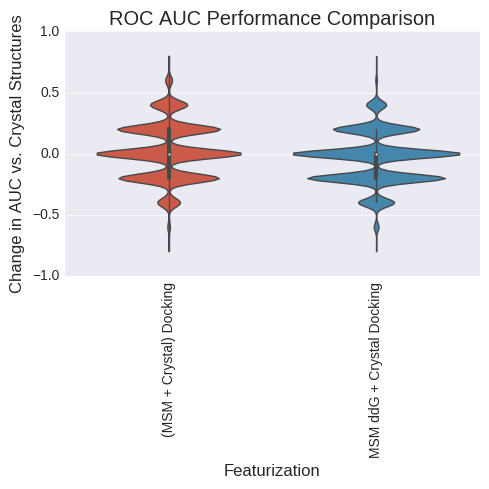

analyzing Recall:
(10000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.753467          0.000000   
(MSM + Crystal) Docking      0.962700          0.209233   
MSM ddG + Crystal Docking    0.957833          0.204367   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.515326905889, 0.541035698106)  
MSM ddG + Crystal Docking  (0.507122160142, 0.532851317868)  


ValueError: list.remove(x): x not in list

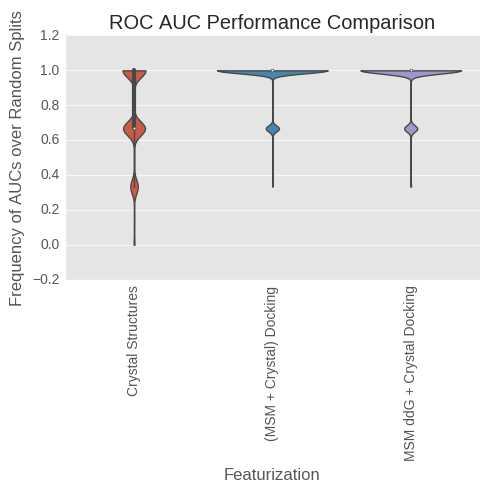

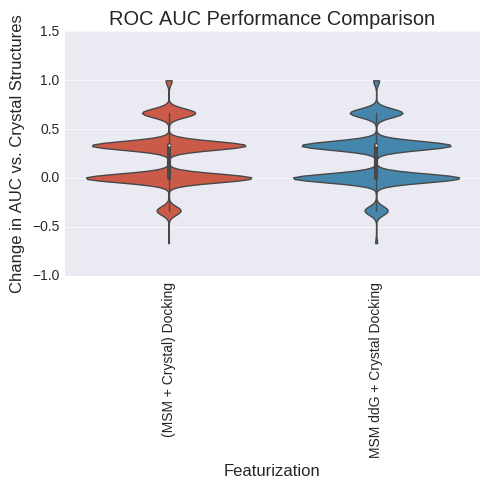

analyzing precision:
(10000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.695118          0.000000   
(MSM + Crystal) Docking      0.662110         -0.033008   
MSM ddG + Crystal Docking    0.609745         -0.085373   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.321271781105, 0.345549279676)  
MSM ddG + Crystal Docking  (0.226321453038, 0.248227178511)  


ValueError: list.remove(x): x not in list

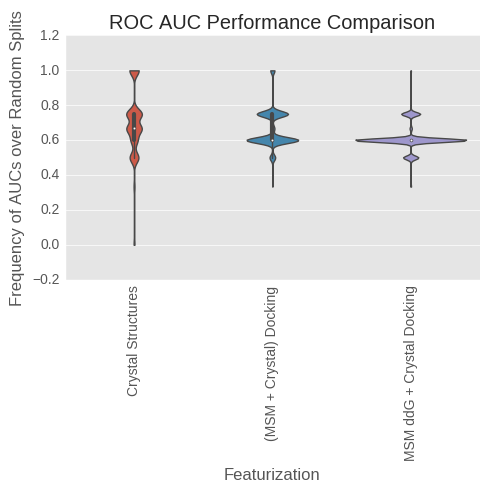

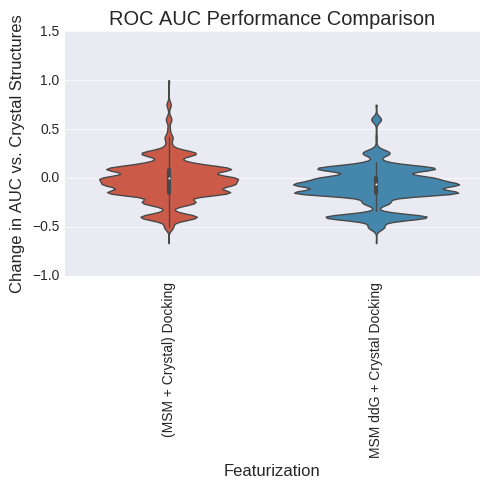

analyzing fdr:
(10000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.304882          0.000000   
(MSM + Crystal) Docking      0.337890          0.033008   
MSM ddG + Crystal Docking    0.390255          0.085373   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.486425600691, 0.512175327578)  
MSM ddG + Crystal Docking  (0.612450798132, 0.637383439434)  


ValueError: list.remove(x): x not in list

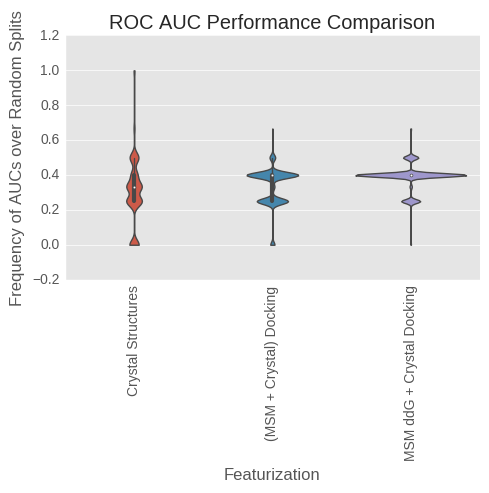

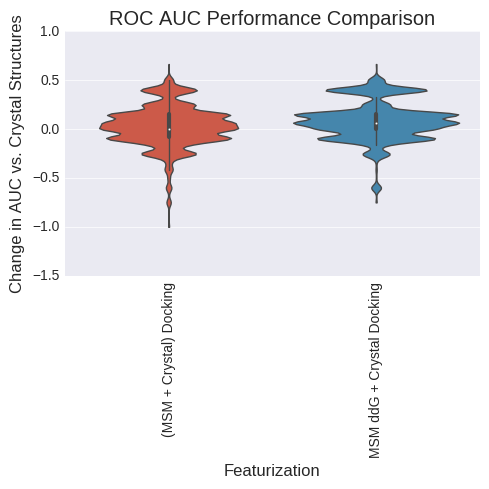

analyzing Recall:
(10000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.753467          0.000000   
(MSM + Crystal) Docking      0.962700          0.209233   
MSM ddG + Crystal Docking    0.957833          0.204367   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.515326905889, 0.541035698106)  
MSM ddG + Crystal Docking  (0.507122160142, 0.532851317868)  


ValueError: list.remove(x): x not in list

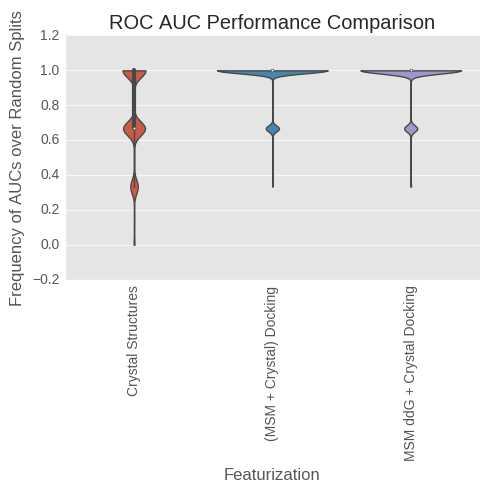

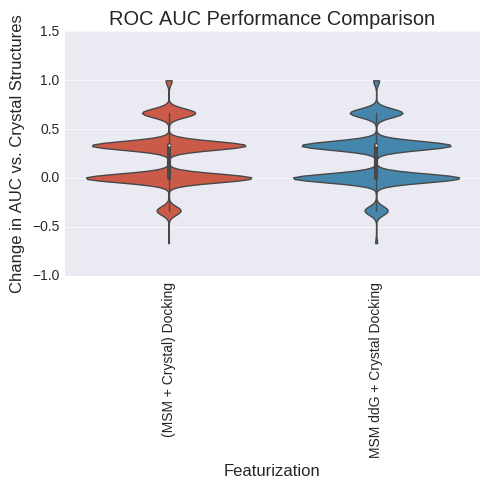

analyzing precision:
(10000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.695118          0.000000   
(MSM + Crystal) Docking      0.662110         -0.033008   
MSM ddG + Crystal Docking    0.609745         -0.085373   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.321271781105, 0.345549279676)  
MSM ddG + Crystal Docking  (0.226321453038, 0.248227178511)  


ValueError: list.remove(x): x not in list

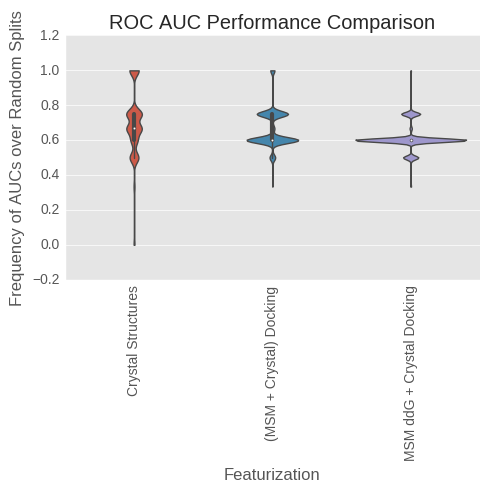

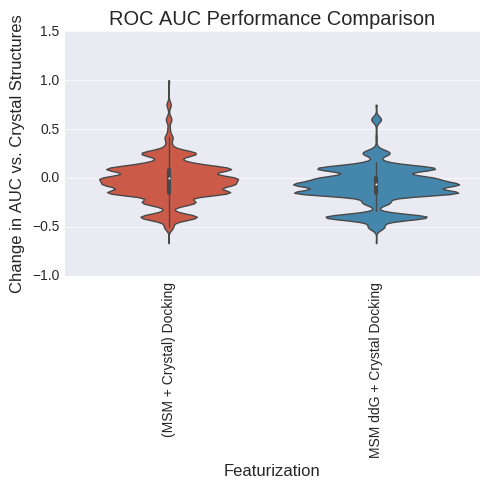

analyzing fdr:
(10000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.304882          0.000000   
(MSM + Crystal) Docking      0.337890          0.033008   
MSM ddG + Crystal Docking    0.390255          0.085373   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.486425600691, 0.512175327578)  
MSM ddG + Crystal Docking  (0.612450798132, 0.637383439434)  


ValueError: list.remove(x): x not in list

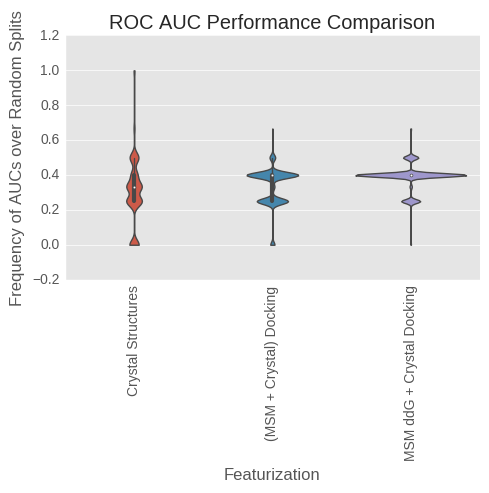

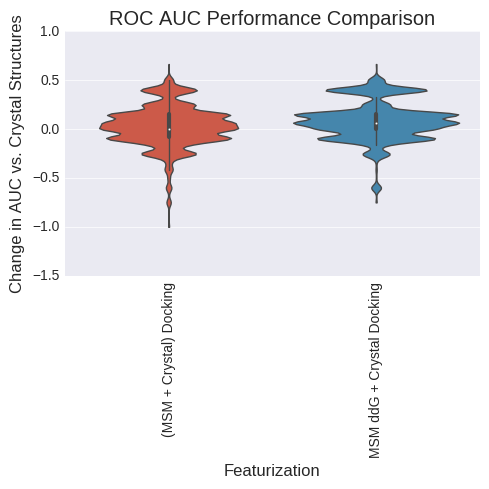

analyzing class B ROC AUC:
(10000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.629967          0.000000   
(MSM + Crystal) Docking      0.751800          0.121833   
MSM ddG + Crystal Docking    0.711583          0.081617   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.531847004911, 0.557493718443)  
MSM ddG + Crystal Docking  (0.495821303269, 0.521567159666)  


ValueError: list.remove(x): x not in list

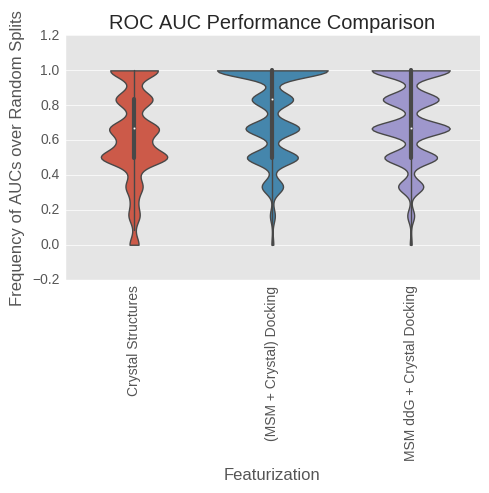

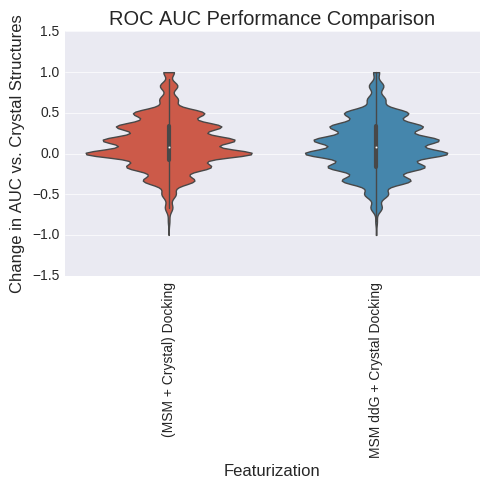

analyzing ROC AUC:
(10000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.629967          0.000000   
(MSM + Crystal) Docking      0.751800          0.121833   
MSM ddG + Crystal Docking    0.711583          0.081617   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.535252904929, 0.560883309687)  
MSM ddG + Crystal Docking  (0.499320865363, 0.525062956224)  


ValueError: list.remove(x): x not in list

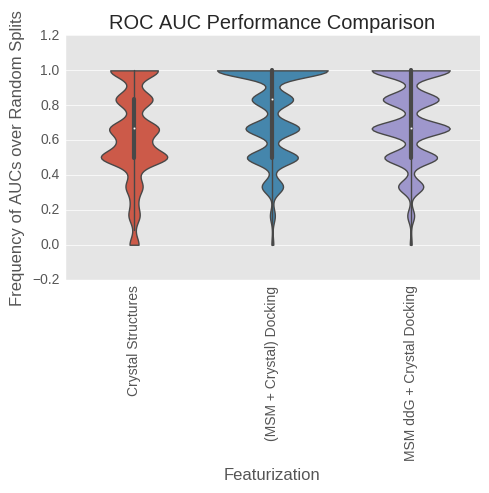

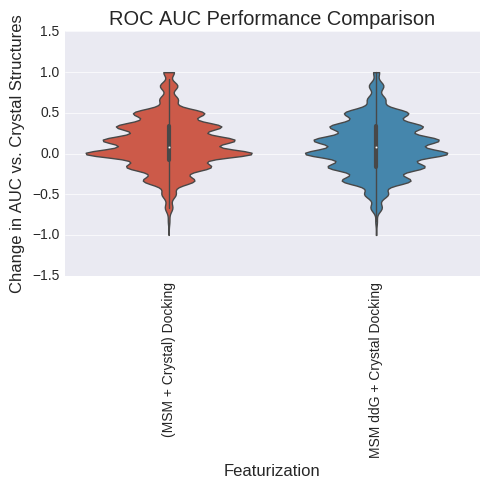

analyzing BedROC
(10000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.623161          0.000000   
(MSM + Crystal) Docking      0.780339          0.157178   
MSM ddG + Crystal Docking    0.827485          0.204324   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.528942448416, 0.554602120627)  
MSM ddG + Crystal Docking  (0.515627145392, 0.541335060773)  


ValueError: list.remove(x): x not in list

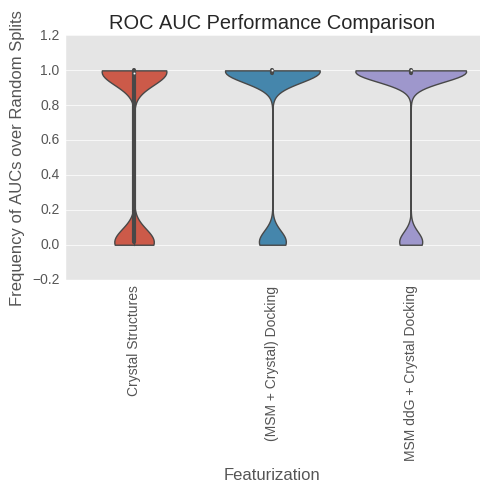

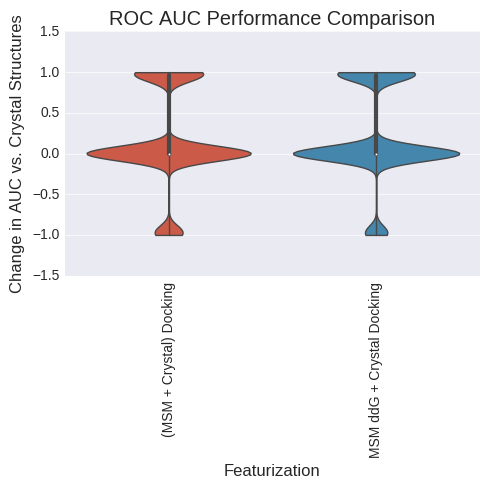

analyzing LogAUC
(10000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.068182          0.000000   
(MSM + Crystal) Docking      0.048648         -0.019534   
MSM ddG + Crystal Docking    0.053182         -0.015000   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.179024960321, 0.199187589223)  
MSM ddG + Crystal Docking  (0.199898641421, 0.220885662205)  


ValueError: list.remove(x): x not in list

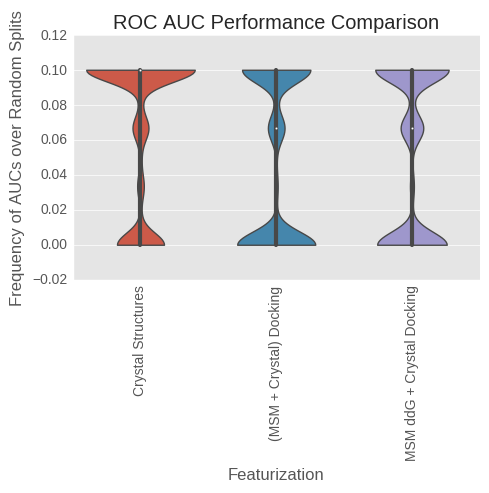

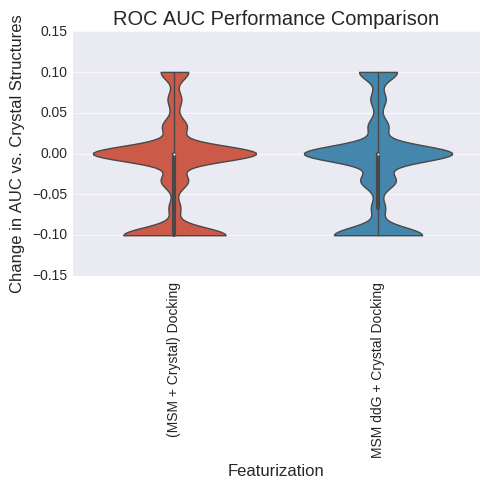

(1,)
(1, 1)


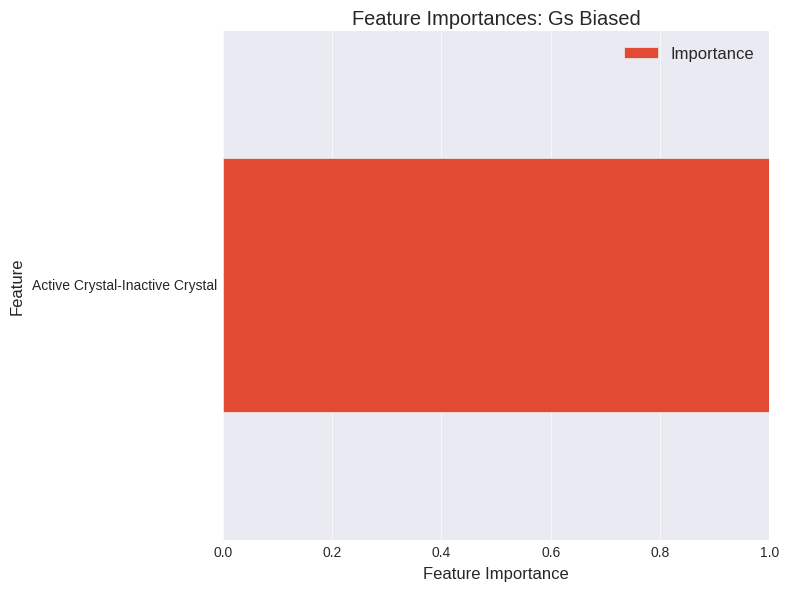

(56,)
(1, 56)


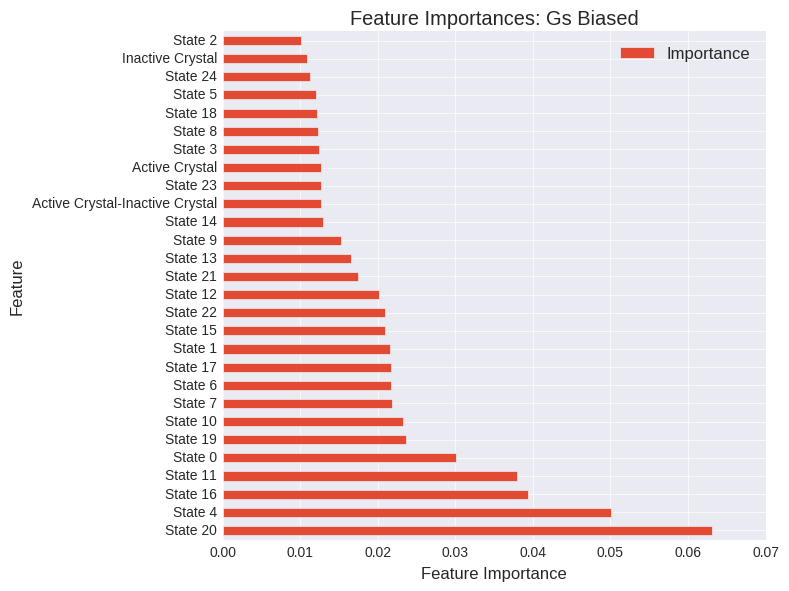

(351,)
(1, 351)


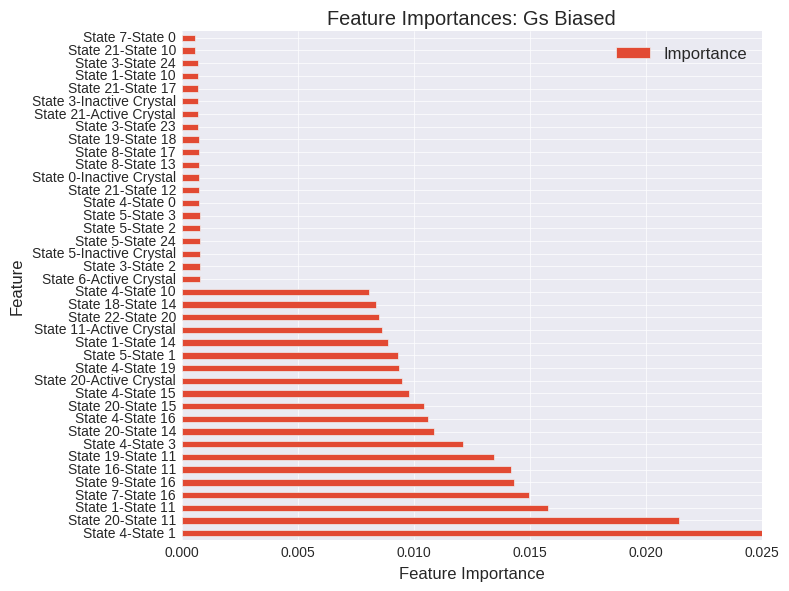

In [84]:
#SP, All ligands, Four class, 32 stereoisomers; new crystal grids; 25 clusters
#LR L1
importance_dfs = analyze_multiclass_experiment(results_dict[save_name], 
                                                                feature_names,
                                                                [f.columns.values.tolist() for f in features], model_agonists, analysis_dir,
                                                                #["Arrestin Antagonist", "Arrestin Agonist"], 
                                                                ["Gs Balanced", "Gs Biased"], 
                                                               #["Arr Inactive", "Arr Active"],
                                               np.hstack([X_df.loc[model_agonists].values]),
                                                               #["Gs Inactive", "Gs Partial Active", "Gs Full Active"], 
                                              remake=False, fxn=np.mean)


#TRY LOOCV
#crystal structures might just have bigger boxes





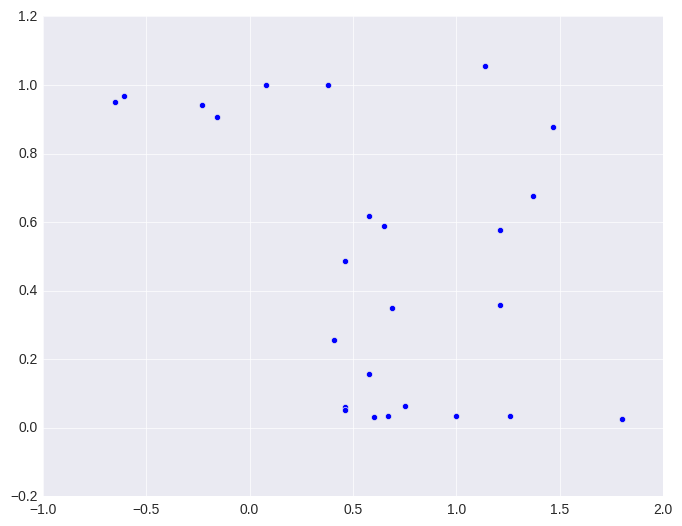

In [177]:
plt.scatter(ddg_df["State 4-State 1"].loc[bret.loc[bret[gprot_col] > 0.25].index], bret[gprot_col].pow(-1).multiply(bret[arr_col]).loc[bret.loc[bret[gprot_col] > 0.25].index])

In [622]:
ddg_df["State 3-State 16"].loc["CID_5152"]

2.2299999999999995

analyzing precision at full recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.683338          0.000000   
(MSM + Crystal) Docking      0.713978          0.030640   
MSM ddG + Crystal Docking    0.661022         -0.022316   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.317095387178, 0.394816050644)  
MSM ddG + Crystal Docking   (0.19850946321, 0.267036583508)  


ValueError: list.remove(x): x not in list

analyzing threshold at full recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.356750          0.000000   
(MSM + Crystal) Docking      0.348162         -0.008588   
MSM ddG + Crystal Docking    0.337666         -0.019084   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.467359437877, 0.548535103484)  
MSM ddG + Crystal Docking  (0.501272694622, 0.582173647526)  


ValueError: list.remove(x): x not in list

analyzing Accuracy:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures             0.6984            0.0000   
(MSM + Crystal) Docking        0.6753           -0.0231   
MSM ddG + Crystal Docking      0.6407           -0.0577   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.214561333629, 0.284760613482)  
MSM ddG + Crystal Docking  (0.149921093555, 0.212310434313)  


ValueError: list.remove(x): x not in list

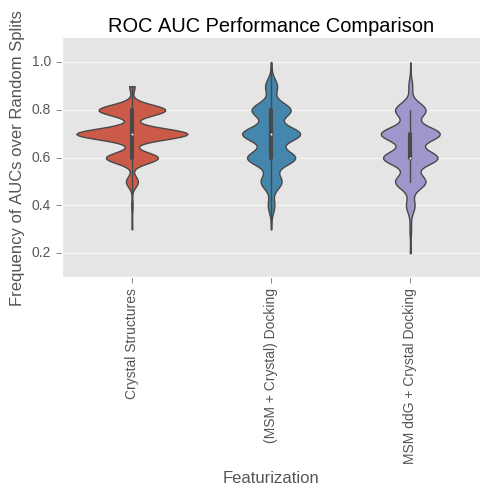

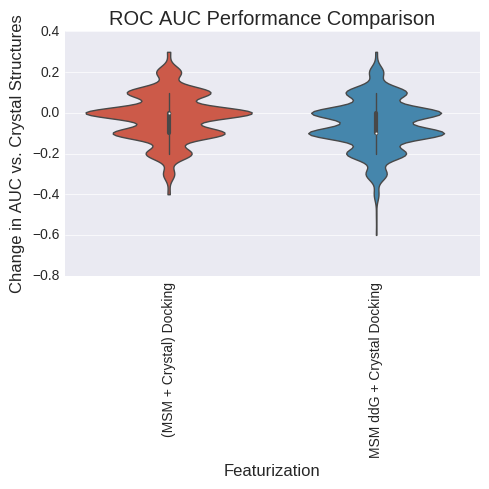

analyzing Recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures              0.889             0.000   
(MSM + Crystal) Docking         0.736            -0.153   
MSM ddG + Crystal Docking       0.757            -0.132   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.0631827343497, 0.10831429718)  
MSM ddG + Crystal Docking  (0.111374660775, 0.167410524944)  


ValueError: list.remove(x): x not in list

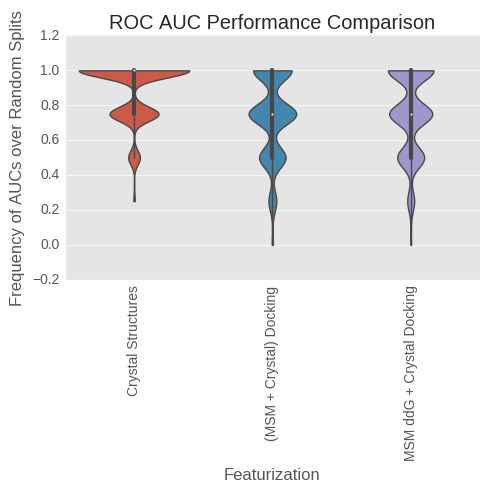

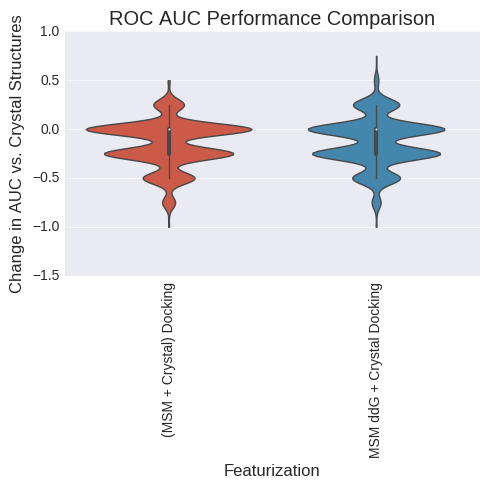

analyzing precision:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.623064          0.000000   
(MSM + Crystal) Docking      0.688956          0.065892   
MSM ddG + Crystal Docking    0.612836         -0.010229   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.519302924323, 0.599906135888)  
MSM ddG + Crystal Docking  (0.329707504133, 0.408032563401)  


ValueError: list.remove(x): x not in list

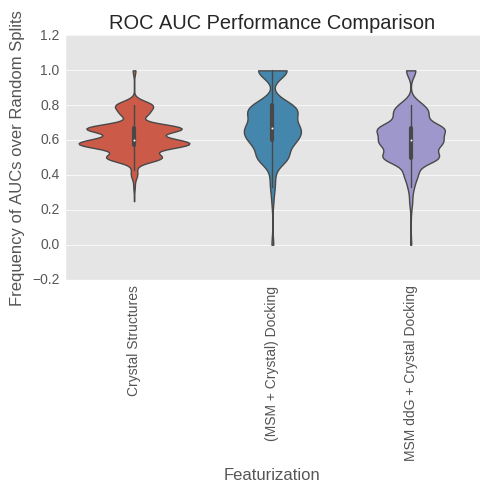

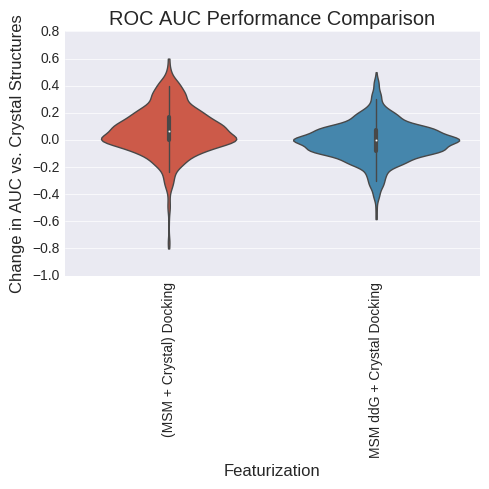

analyzing fdr:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.376936          0.000000   
(MSM + Crystal) Docking      0.311044         -0.065892   
MSM ddG + Crystal Docking    0.387164          0.010229   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.202279609404, 0.271213707995)  
MSM ddG + Crystal Docking  (0.373595543431, 0.453551319262)  


ValueError: list.remove(x): x not in list

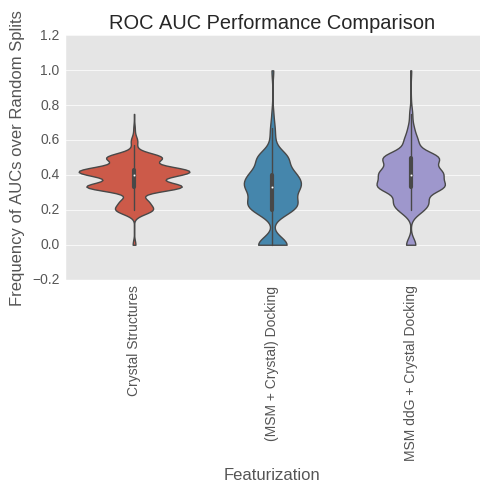

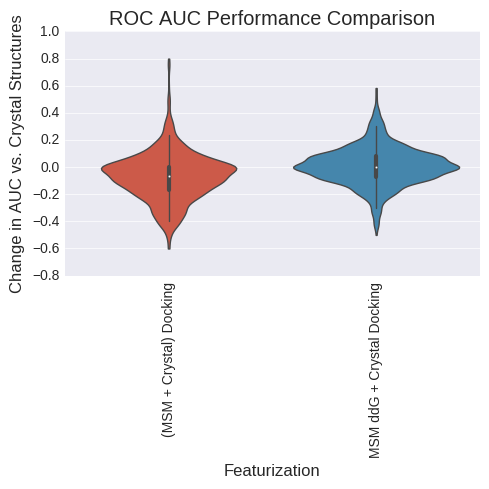

analyzing Recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures             0.6984            0.0000   
(MSM + Crystal) Docking        0.6753           -0.0231   
MSM ddG + Crystal Docking      0.6407           -0.0577   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.214561333629, 0.284760613482)  
MSM ddG + Crystal Docking  (0.149921093555, 0.212310434313)  


ValueError: list.remove(x): x not in list

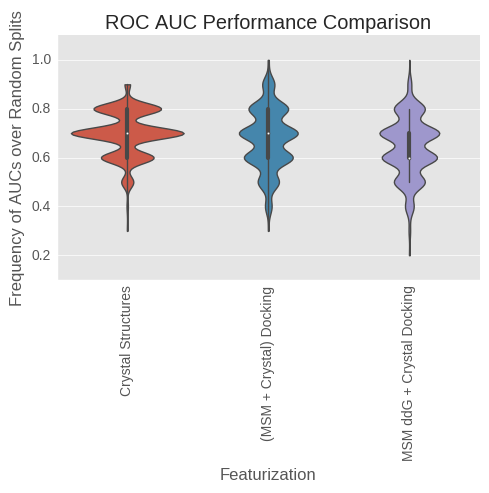

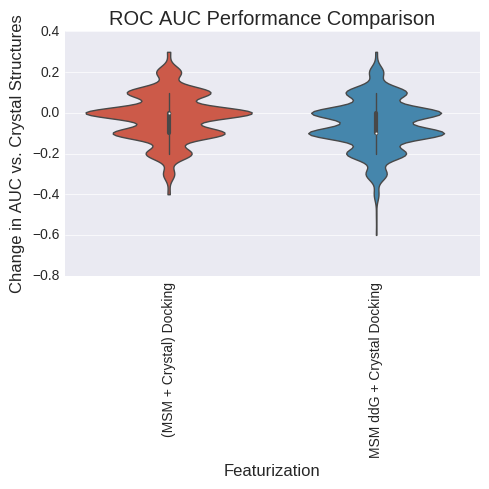

analyzing precision:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.634924          0.000000   
(MSM + Crystal) Docking      0.675754          0.040830   
MSM ddG + Crystal Docking    0.617061         -0.017863   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking     (0.50227298352, 0.583160176298)  
MSM ddG + Crystal Docking  (0.329707504133, 0.408032563401)  


ValueError: list.remove(x): x not in list

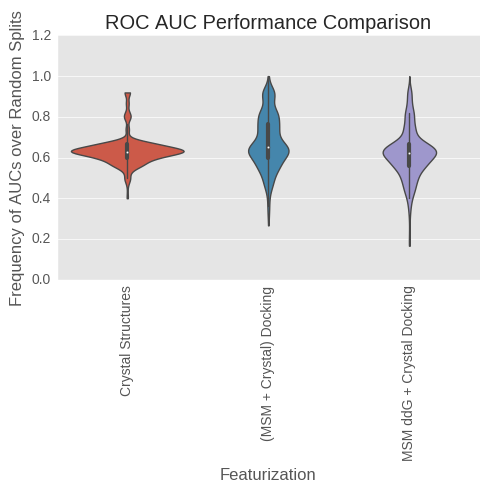

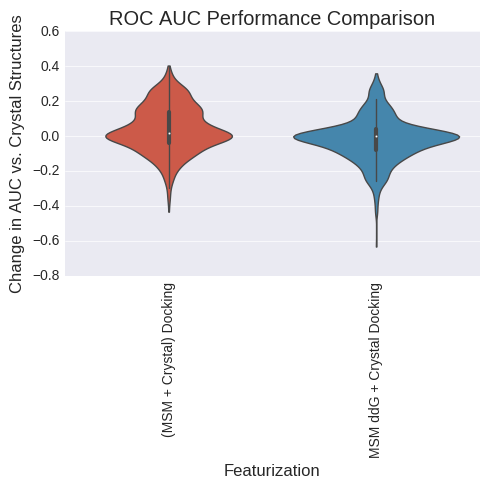

analyzing fdr:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.365076          0.000000   
(MSM + Crystal) Docking      0.324246         -0.040830   
MSM ddG + Crystal Docking    0.382939          0.017863   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking     (0.299683933798, 0.37646478596)  
MSM ddG + Crystal Docking  (0.450472858943, 0.531645782025)  


ValueError: list.remove(x): x not in list

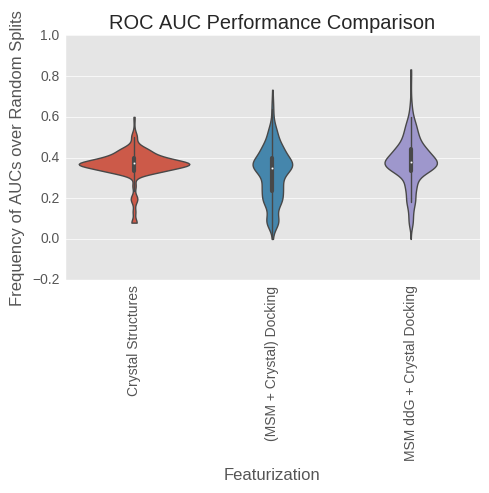

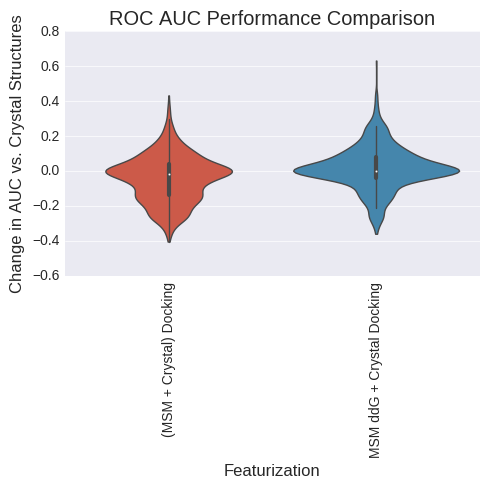

analyzing class B ROC AUC:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.778458          0.000000   
(MSM + Crystal) Docking      0.839562          0.061104   
MSM ddG + Crystal Docking    0.801562          0.023104   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.597047080293, 0.675146940523)  
MSM ddG + Crystal Docking  (0.473330539555, 0.554484907828)  


ValueError: list.remove(x): x not in list

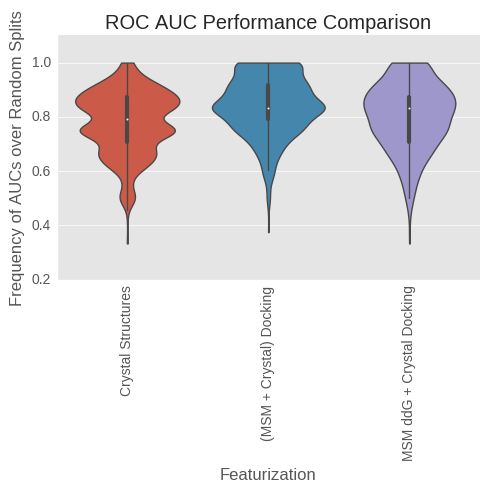

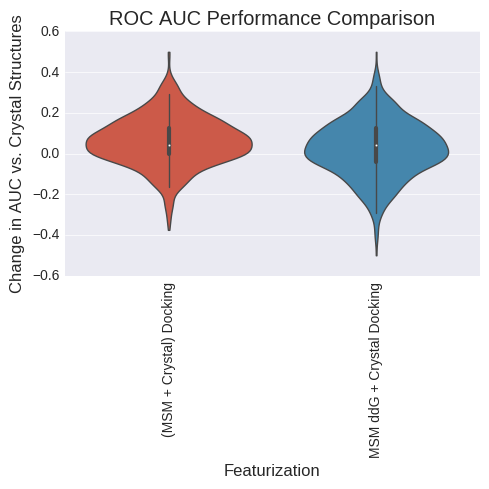

analyzing ROC AUC:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.716319          0.000000   
(MSM + Crystal) Docking      0.808927          0.092608   
MSM ddG + Crystal Docking    0.776250          0.059931   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.699660634942, 0.771215152893)  
MSM ddG + Crystal Docking  (0.605183949356, 0.682904612822)  


ValueError: list.remove(x): x not in list

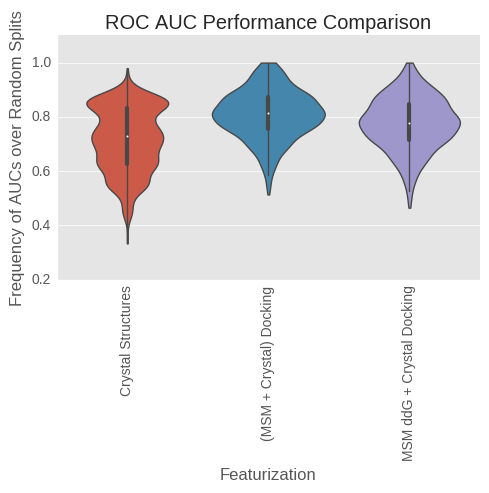

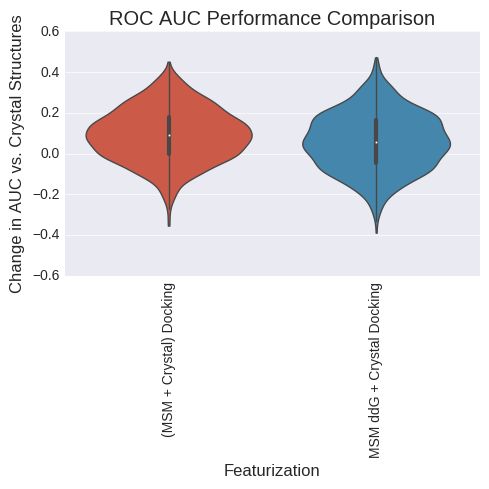

analyzing BedROC
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.968278          0.000000   
(MSM + Crystal) Docking      0.983676          0.015398   
MSM ddG + Crystal Docking    0.974416          0.006138   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.297753099349, 0.374421985069)  
MSM ddG + Crystal Docking  (0.259302258565, 0.333400119046)  


ValueError: list.remove(x): x not in list

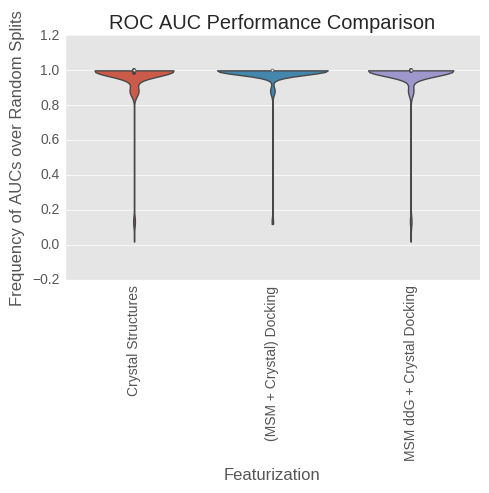

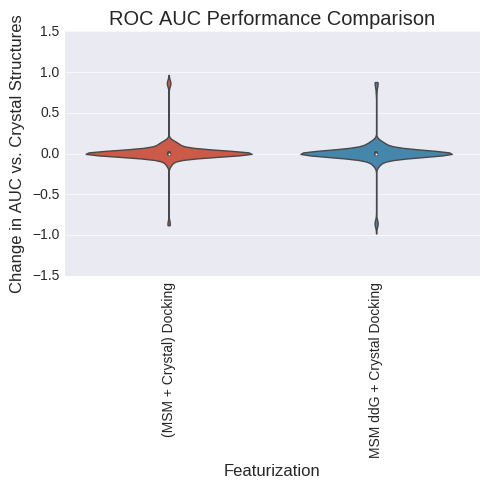

analyzing LogAUC
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures                0.0               0.0   
(MSM + Crystal) Docking           0.0               0.0   
MSM ddG + Crystal Docking         0.0               0.0   

                                                 Sign Test 99% CI  
Crystal Structures                                       (0, 0.0)  
(MSM + Crystal) Docking    (-4.33680868994e-19, 0.00659116490341)  
MSM ddG + Crystal Docking  (-4.33680868994e-19, 0.00659116490341)  


ValueError: list.remove(x): x not in list

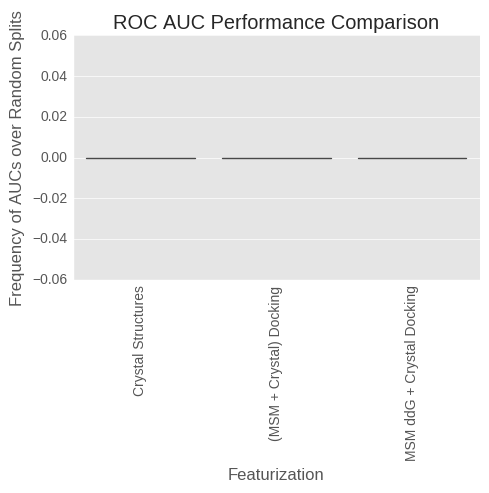

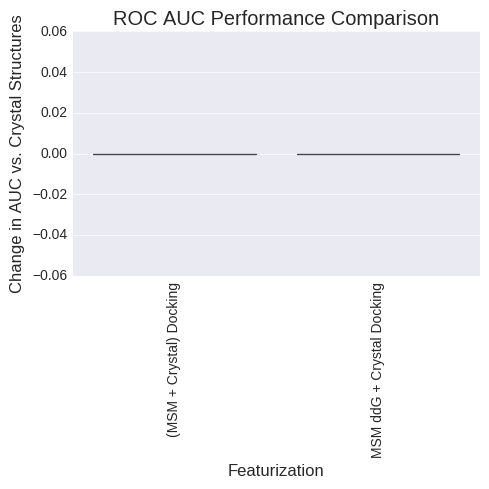

(3, 1)
(3, 1)


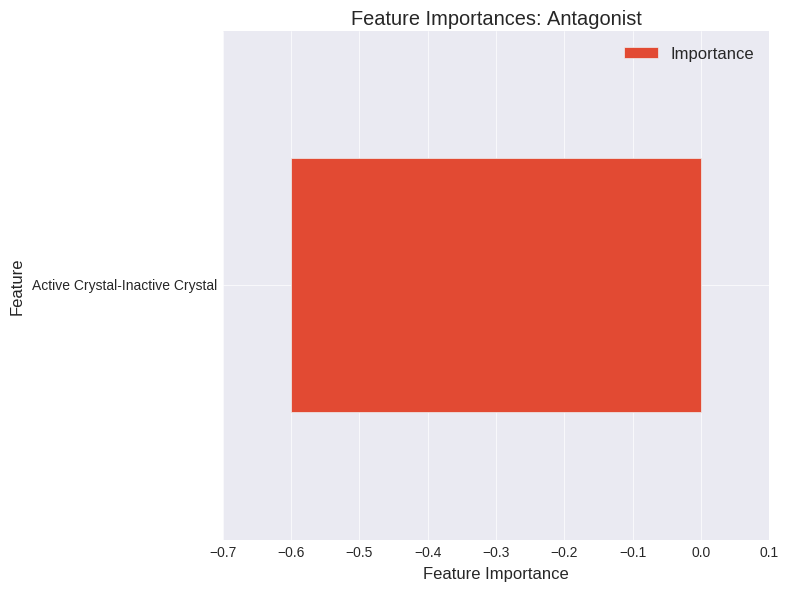

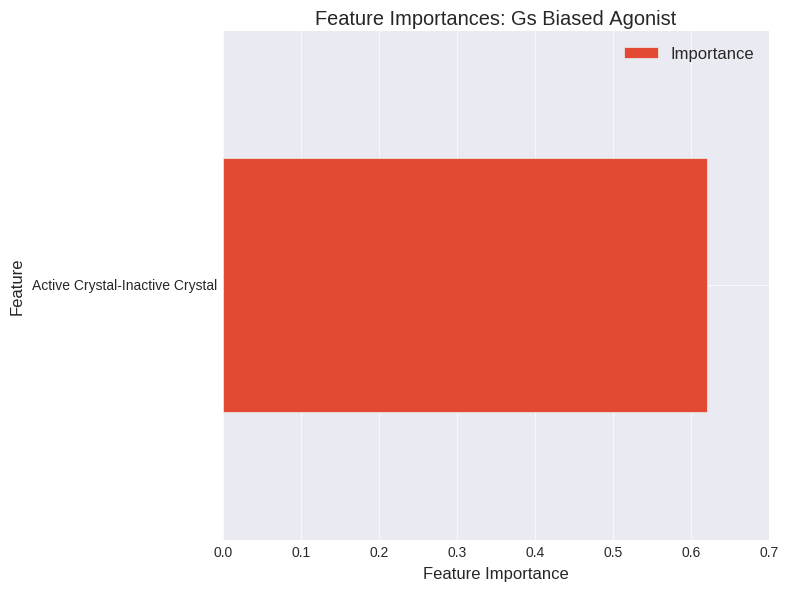

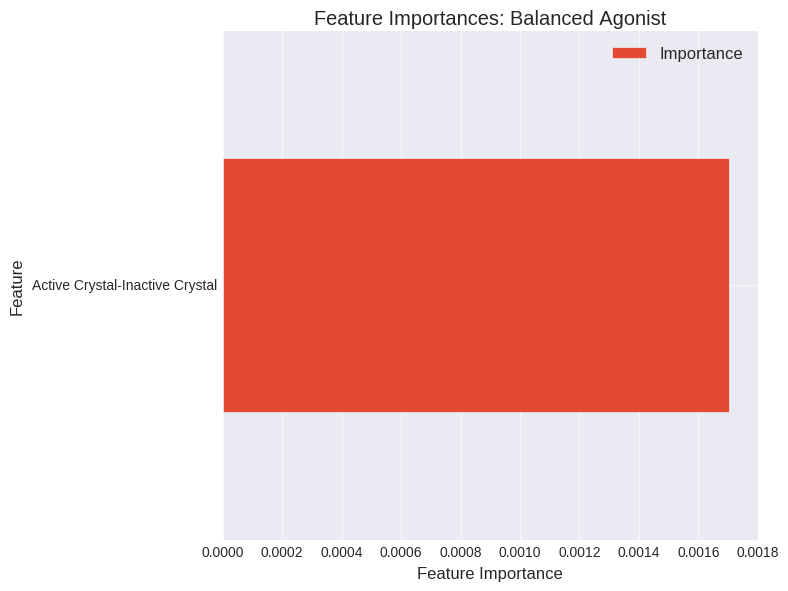

(3, 56)
(3, 56)


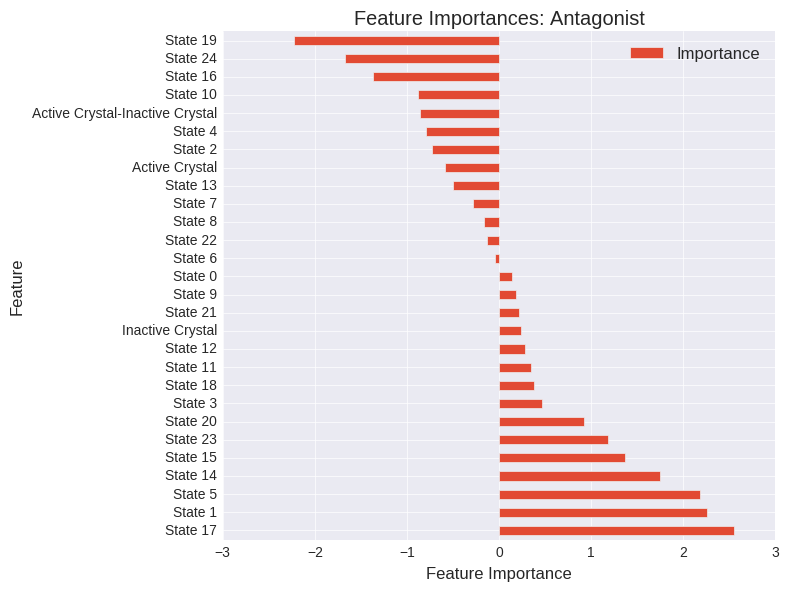

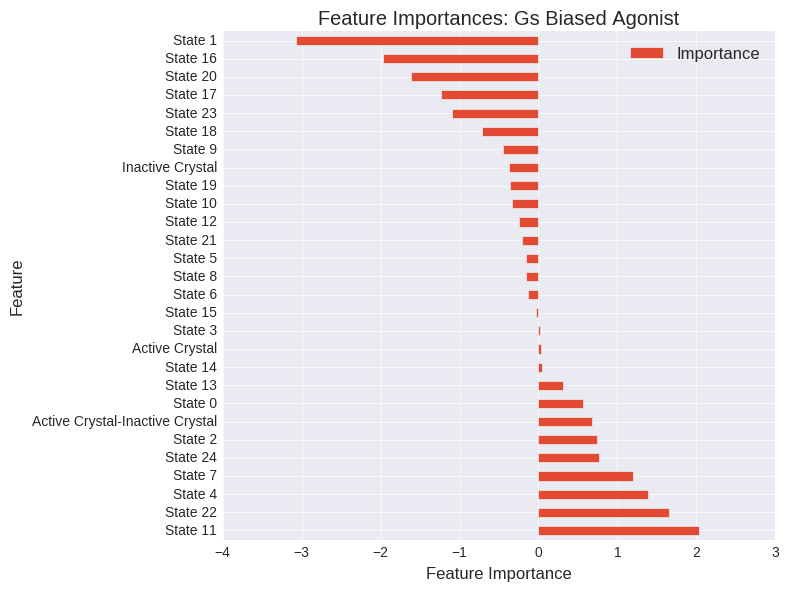

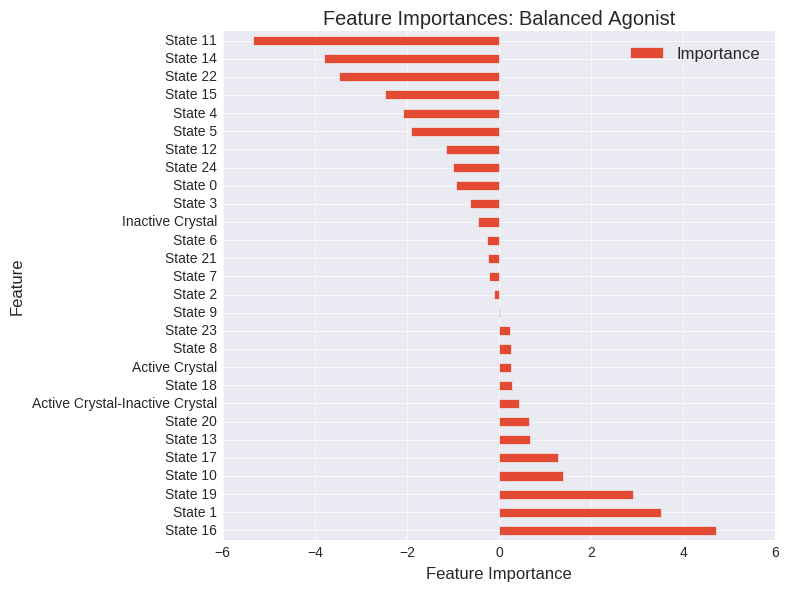

(3, 351)
(3, 351)


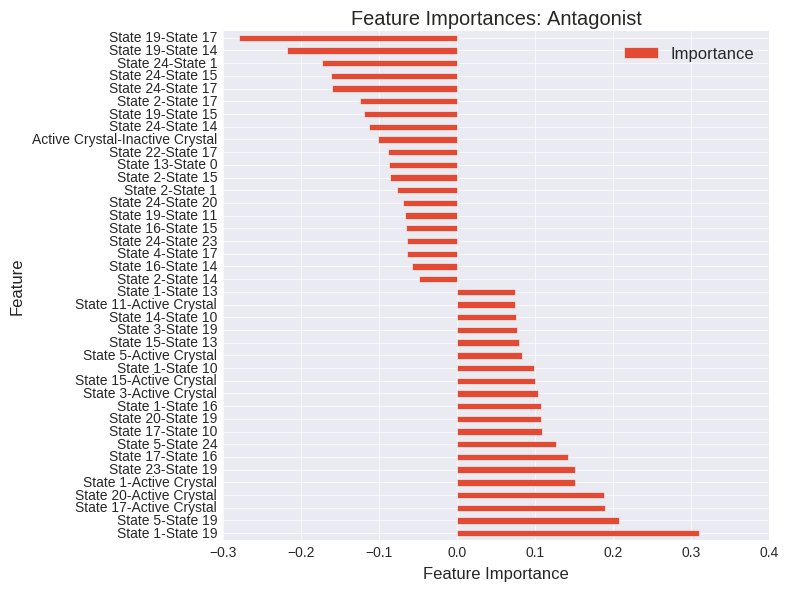

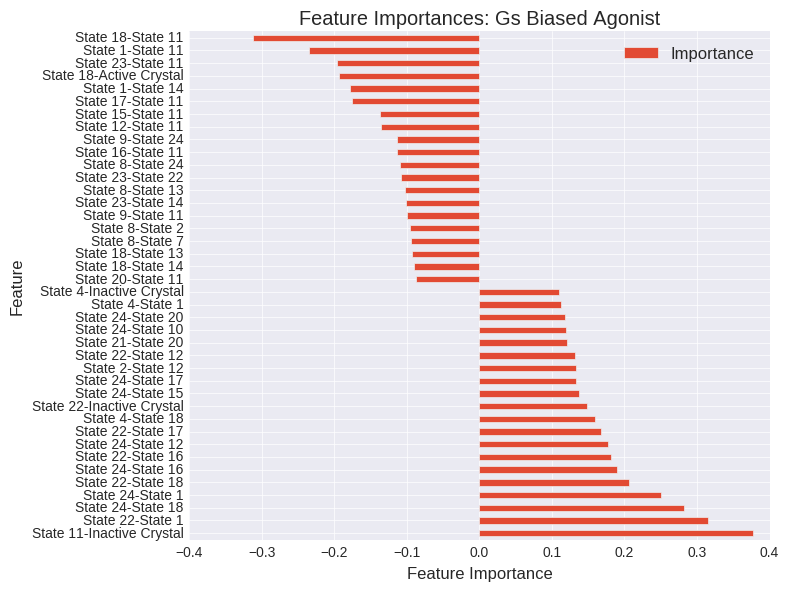

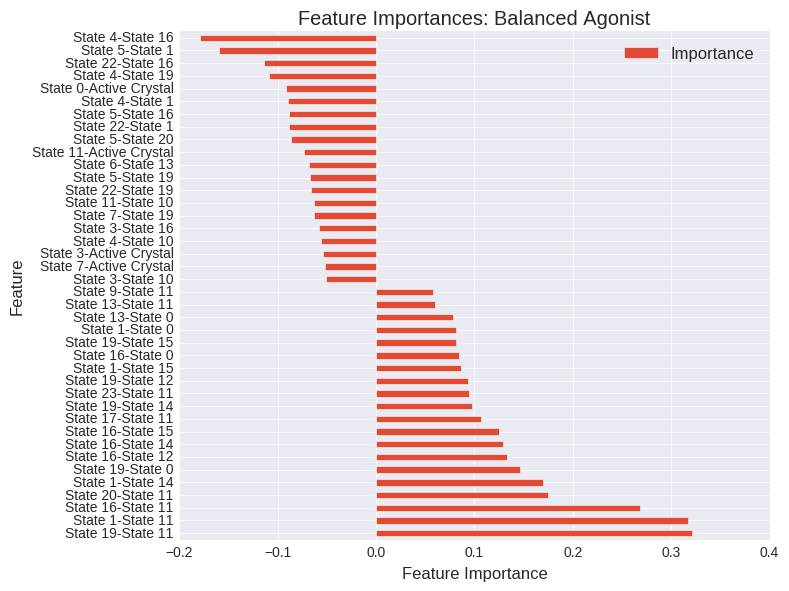

In [162]:
#SP, All ligands, Four class, 32 stereoisomers; new crystal grids; 25 clusters
#max_features = 10

importance_dfs = analyze_multiclass_experiment(results_dict[save_name], 
                                                                feature_names,
                                                                [f.columns.values.tolist() for f in features], model_agonists, analysis_dir,
                                                                ["Antagonist", "Gs Biased Agonist", "Balanced Agonist"], 
                                                                #["Gs Inactive", "Gs Active"], 
                                                               #["Arr Inactive", "Arr Active"],
                                               np.hstack([X_df.loc[model_agonists].values]),
                                                               #["Gs Inactive", "Gs Partial Active", "Gs Full Active"], 
                                              remake=False, fxn=np.mean)


#TRY LOOCV
#crystal structures might just have bigger boxes




analyzing precision at full recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.660314          0.000000   
(MSM + Crystal) Docking      0.791004          0.130689   
MSM ddG + Crystal Docking    0.732432          0.072118   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.515291614016, 0.595970175515)  
MSM ddG + Crystal Docking  (0.380453788122, 0.460600798262)  


ValueError: list.remove(x): x not in list

analyzing threshold at full recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.449632          0.000000   
(MSM + Crystal) Docking      0.497313          0.047681   
MSM ddG + Crystal Docking    0.505417          0.055785   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.642973109636, 0.718627706339)  
MSM ddG + Crystal Docking  (0.665570348092, 0.739740456628)  


ValueError: list.remove(x): x not in list

analyzing Accuracy:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.650111          0.000000   
(MSM + Crystal) Docking      0.741333          0.091222   
MSM ddG + Crystal Docking    0.724444          0.074333   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.554515364203, 0.634232314465)  
MSM ddG + Crystal Docking  (0.483295298773, 0.564388325312)  


ValueError: list.remove(x): x not in list

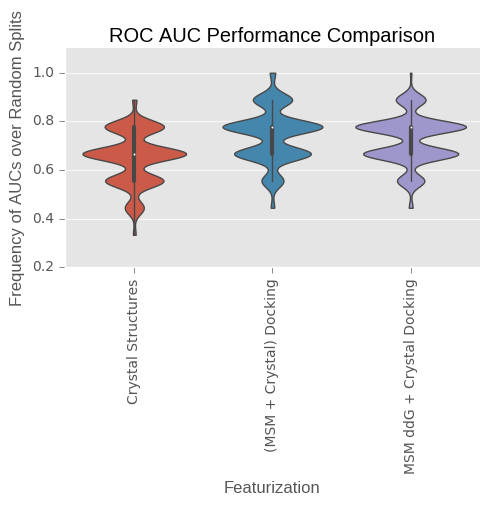

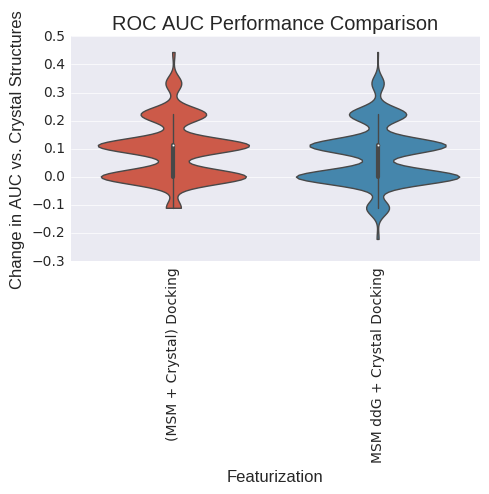

analyzing Recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.801000          0.000000   
(MSM + Crystal) Docking      0.917667          0.116667   
MSM ddG + Crystal Docking    0.903000          0.102000   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking     (0.27656526821, 0.351899827464)  
MSM ddG + Crystal Docking  (0.272723278764, 0.347794546229)  


ValueError: list.remove(x): x not in list

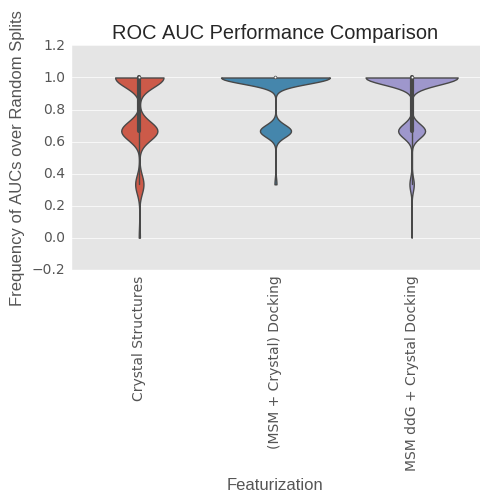

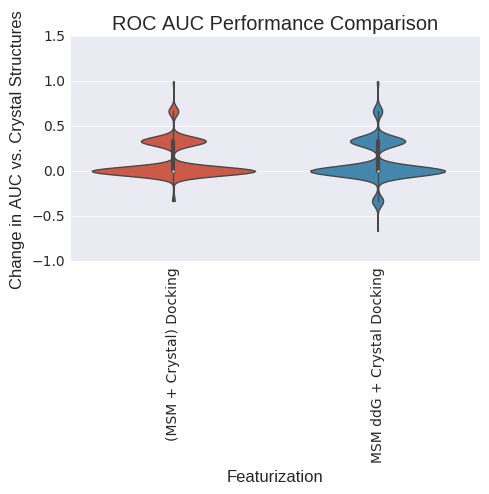

analyzing precision:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.581845          0.000000   
(MSM + Crystal) Docking      0.676521          0.094676   
MSM ddG + Crystal Docking    0.630555          0.048710   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.516294194763, 0.596954412438)  
MSM ddG + Crystal Docking   (0.39419487087, 0.474675162898)  


ValueError: list.remove(x): x not in list

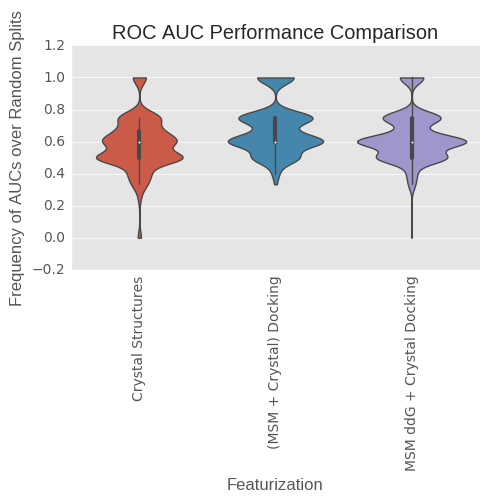

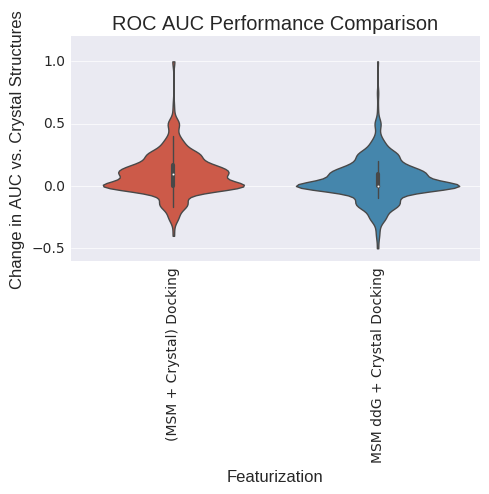

analyzing fdr:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.418155          0.000000   
(MSM + Crystal) Docking      0.323479         -0.094676   
MSM ddG + Crystal Docking    0.369445         -0.048710   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking     (0.09330777041, 0.145741061906)  
MSM ddG + Crystal Docking  (0.166645129714, 0.231349116218)  


ValueError: list.remove(x): x not in list

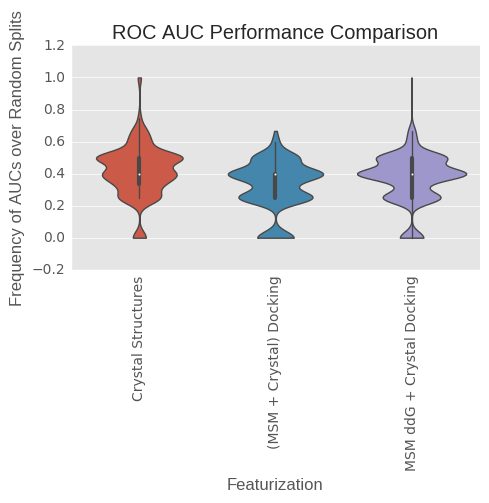

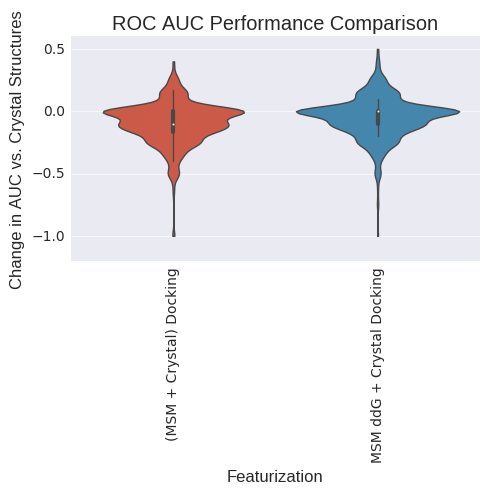

analyzing Recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.650111          0.000000   
(MSM + Crystal) Docking      0.741333          0.091222   
MSM ddG + Crystal Docking    0.724444          0.074333   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.554515364203, 0.634232314465)  
MSM ddG + Crystal Docking  (0.483295298773, 0.564388325312)  


ValueError: list.remove(x): x not in list

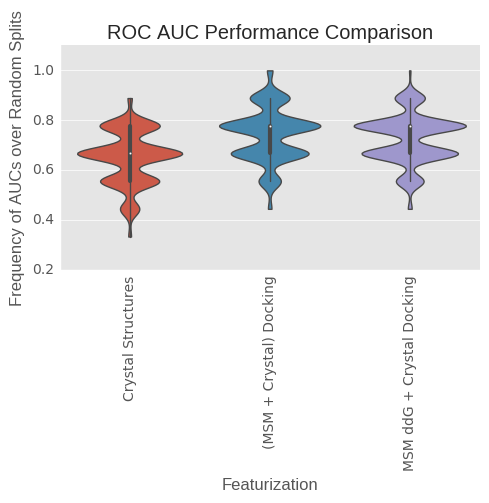

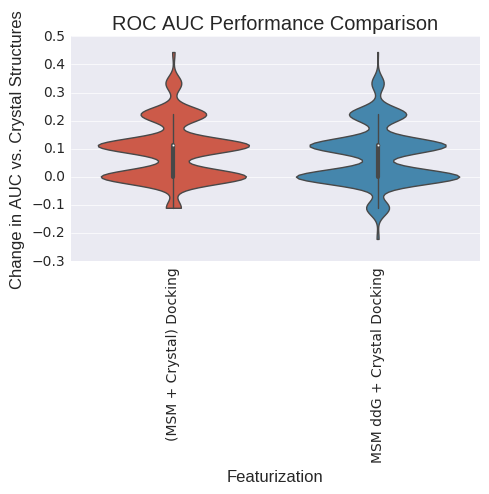

analyzing precision:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.583505          0.000000   
(MSM + Crystal) Docking      0.683721          0.100216   
MSM ddG + Crystal Docking    0.660760          0.077254   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.602131253881, 0.679996855286)  
MSM ddG + Crystal Docking  (0.553506434472, 0.633254426526)  


ValueError: list.remove(x): x not in list

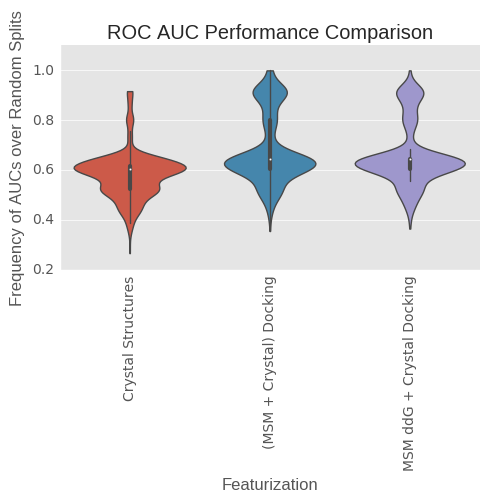

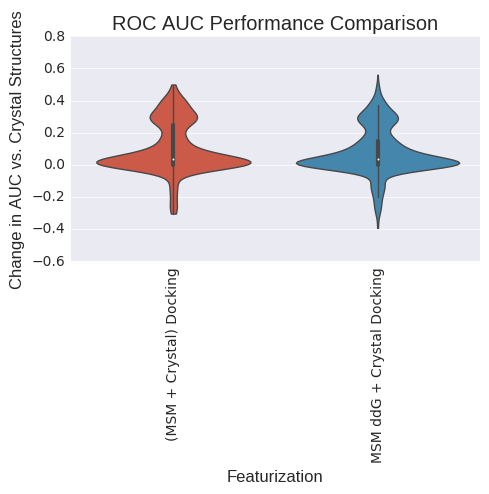

analyzing fdr:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.416495          0.000000   
(MSM + Crystal) Docking      0.316279         -0.100216   
MSM ddG + Crystal Docking    0.339240         -0.077254   

                                            Sign Test 99% CI  
Crystal Structures                                  (0, 0.0)  
(MSM + Crystal) Docking     (0.075482238275, 0.123830240637)  
MSM ddG + Crystal Docking  (0.0906172360929, 0.142471143213)  


ValueError: list.remove(x): x not in list

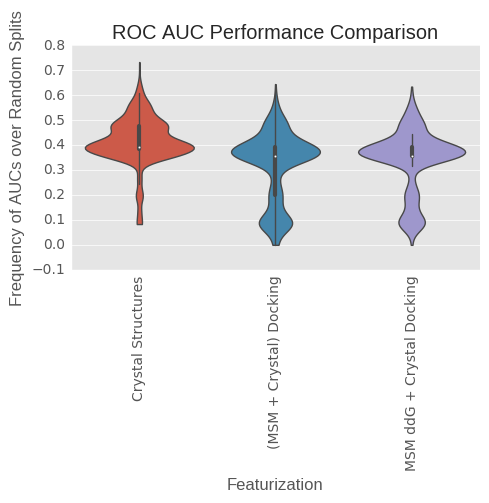

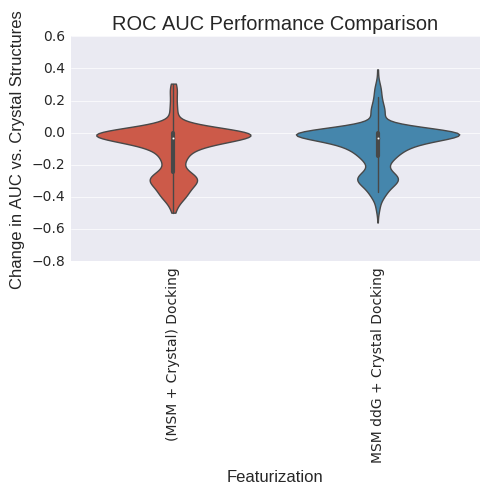

analyzing class B ROC AUC:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.809611          0.000000   
(MSM + Crystal) Docking      0.897667          0.088056   
MSM ddG + Crystal Docking    0.872333          0.062722   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.656313999351, 0.731115446336)  
MSM ddG + Crystal Docking  (0.570681555237, 0.649855206154)  


ValueError: list.remove(x): x not in list

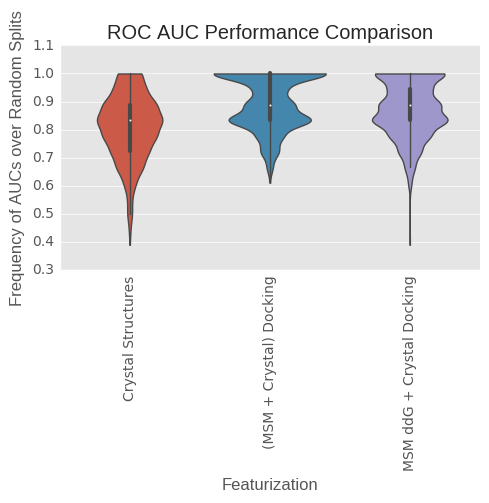

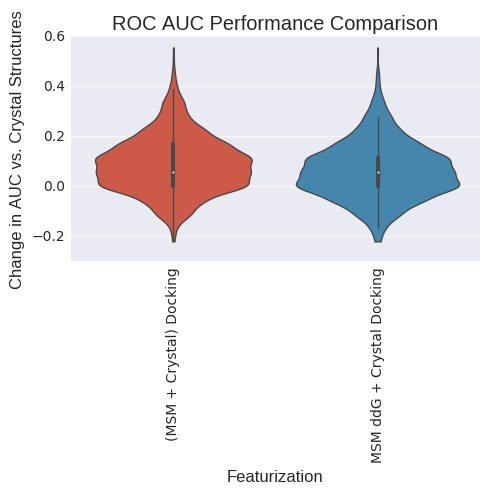

analyzing ROC AUC:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.776885          0.000000   
(MSM + Crystal) Docking      0.870784          0.093899   
MSM ddG + Crystal Docking    0.840908          0.064023   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.823978877242, 0.881341395677)  
MSM ddG + Crystal Docking  (0.717320724077, 0.787330964152)  


ValueError: list.remove(x): x not in list

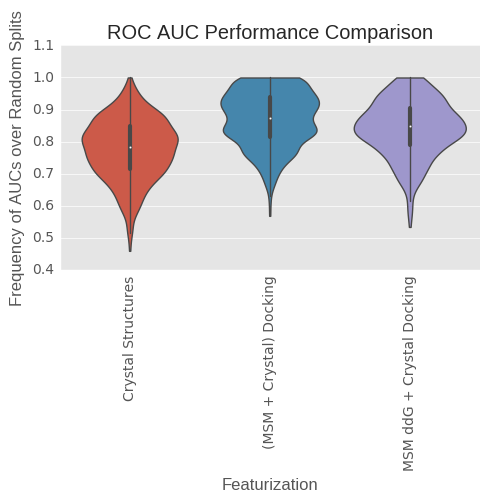

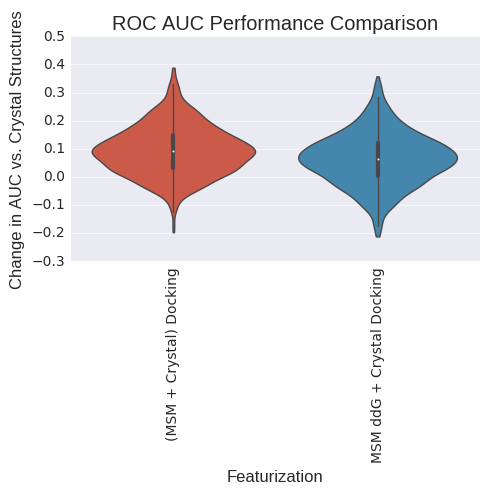

analyzing BedROC
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.962384          0.000000   
(MSM + Crystal) Docking      0.999724          0.037341   
MSM ddG + Crystal Docking    0.994946          0.032562   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking      (0.3677236316, 0.447502325072)  
MSM ddG + Crystal Docking  (0.313220952757, 0.390743214384)  


ValueError: list.remove(x): x not in list

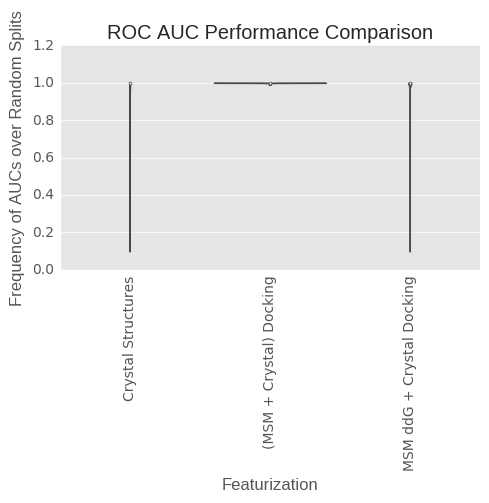

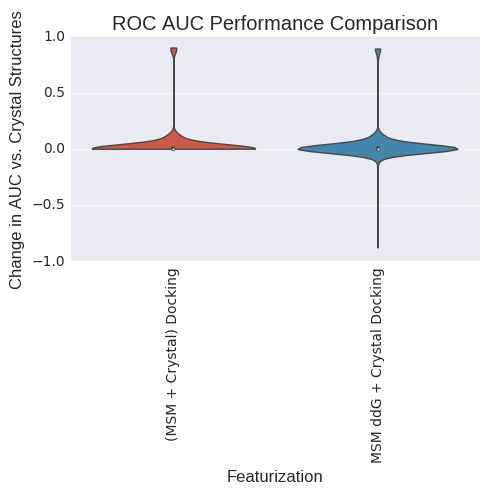

analyzing LogAUC
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures                0.0               0.0   
(MSM + Crystal) Docking           0.0               0.0   
MSM ddG + Crystal Docking         0.0               0.0   

                                                 Sign Test 99% CI  
Crystal Structures                                       (0, 0.0)  
(MSM + Crystal) Docking    (-4.33680868994e-19, 0.00659116490341)  
MSM ddG + Crystal Docking  (-4.33680868994e-19, 0.00659116490341)  


ValueError: list.remove(x): x not in list

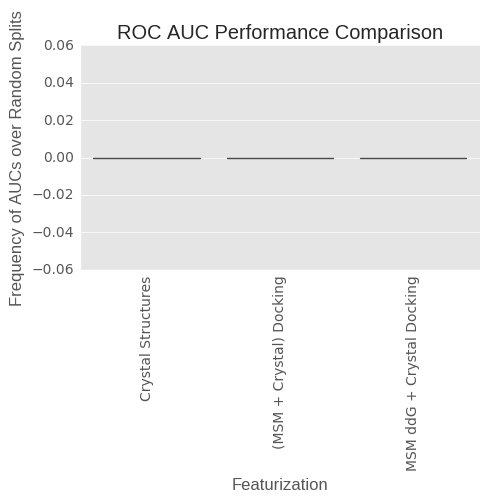

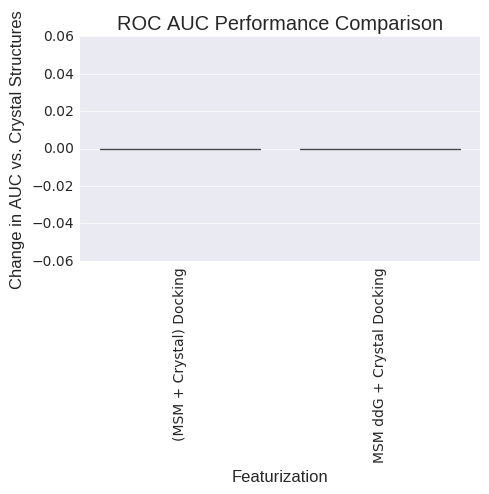

(3,)
(1, 3)


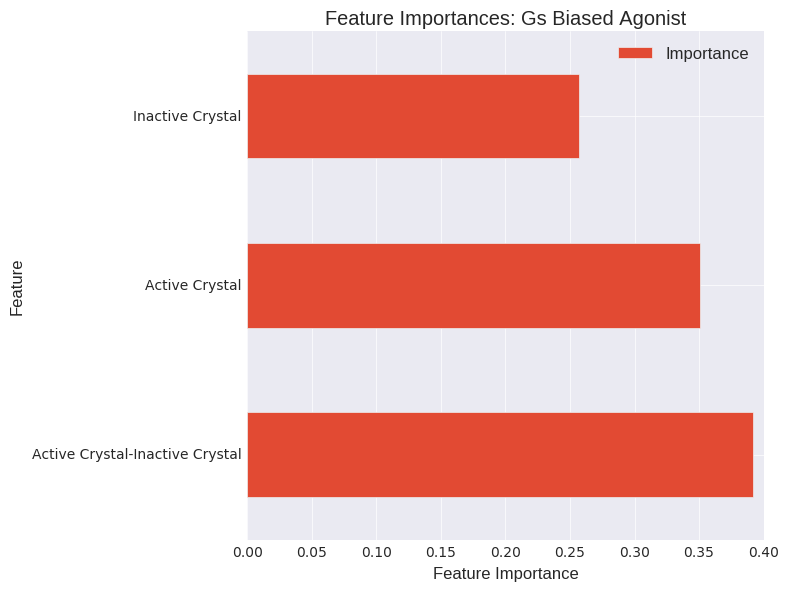

(56,)
(1, 56)


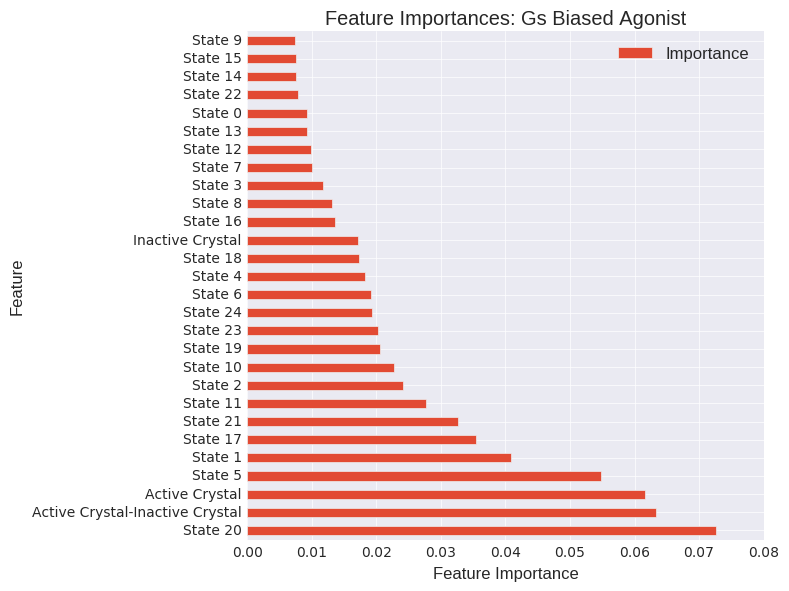

(53,)
(1, 53)


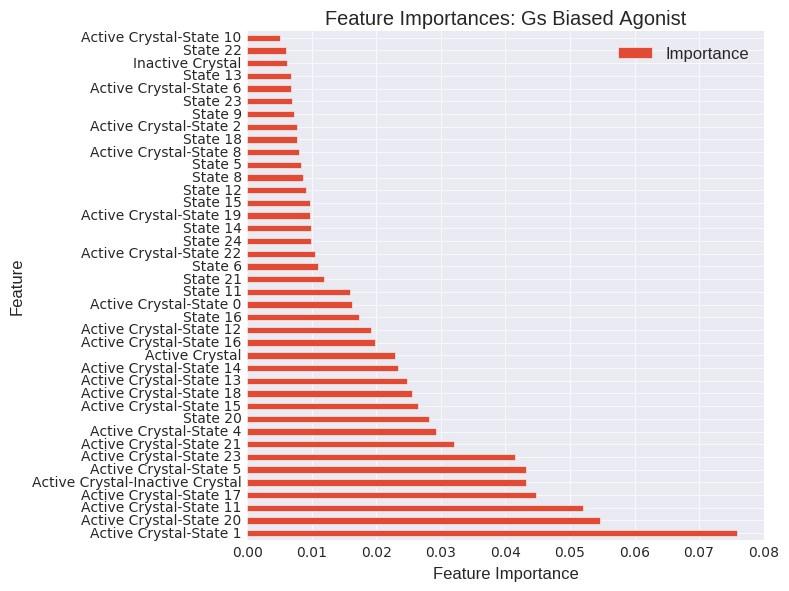

In [387]:
#SP, All ligands, Four class, 32 stereoisomers; new crystal grids; 25 clusters
#loocv 5 rfr
importance_dfs = analyze_multiclass_experiment(results_dict[save_name], 
                                                                feature_names,
                                                                [f.columns.values.tolist() for f in features], model_agonists, analysis_dir,
                                                                ["Antagonist", "Gs Biased Agonist", "Balanced Agonist"], 
                                                                #["Gs Inactive", "Gs Active"], 
                                                               #["Arr Inactive", "Arr Active"],
                                               np.hstack([X_df.loc[model_agonists].values]),
                                                               #["Gs Inactive", "Gs Partial Active", "Gs Full Active"], 
                                              remake=False, fxn=np.mean)


#TRY LOOCV
#crystal structures might just have bigger boxes

analyzing precision at full recall:
(26, 3)
                           Median AUC  Median delta AUC       Sign Test 99% CI
Crystal Structures           0.538462               0.0               (0, 0.0)
(MSM + Crystal) Docking      0.538462               0.0  (0.0, 0.203306806274)
MSM ddG + Crystal Docking    0.538462               0.0  (0.0, 0.203306806274)


ValueError: list.remove(x): x not in list

analyzing threshold at full recall:
(26, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.379769          0.000000   
(MSM + Crystal) Docking      0.349654         -0.030115   
MSM ddG + Crystal Docking    0.343462         -0.036308   

                                            Sign Test 99% CI  
Crystal Structures                                  (0, 0.0)  
(MSM + Crystal) Docking    (0.0878037708491, 0.483207586375)  
MSM ddG + Crystal Docking  (0.0878037708491, 0.483207586375)  


ValueError: list.remove(x): x not in list

analyzing Accuracy:
(26, 3)
                           Median AUC  Median delta AUC       Sign Test 99% CI
Crystal Structures           0.846154          0.000000               (0, 0.0)
(MSM + Crystal) Docking      0.692308         -0.153846  (0.0, 0.203306806274)
MSM ddG + Crystal Docking    0.653846         -0.192308  (0.0, 0.203306806274)


ValueError: list.remove(x): x not in list

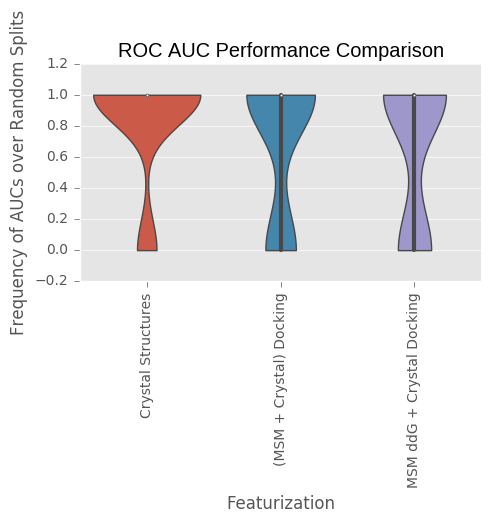

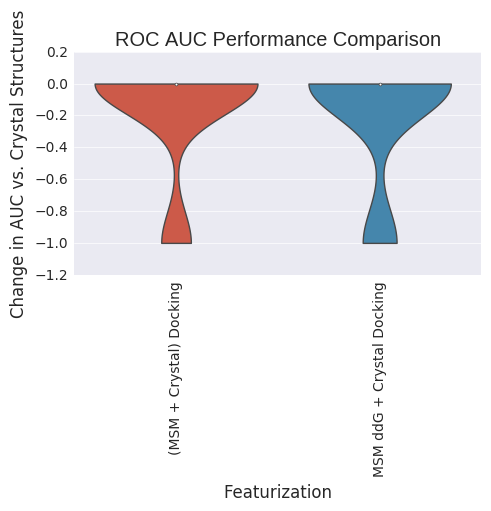

analyzing Recall:
(26, 3)
                           Median AUC  Median delta AUC       Sign Test 99% CI
Crystal Structures                0.0               0.0               (0, 0.0)
(MSM + Crystal) Docking           0.0               0.0  (0.0, 0.203306806274)
MSM ddG + Crystal Docking         0.0               0.0  (0.0, 0.203306806274)


ValueError: list.remove(x): x not in list

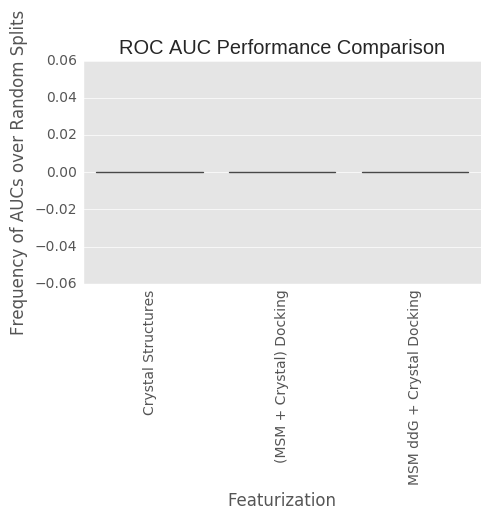

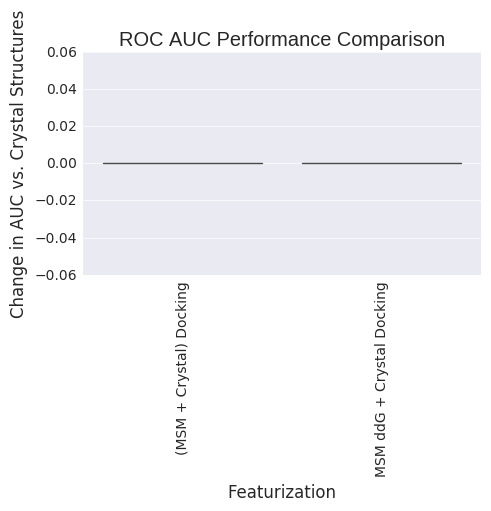

analyzing precision:
(26, 3)
                           Median AUC  Median delta AUC       Sign Test 99% CI
Crystal Structures                0.0               0.0               (0, 0.0)
(MSM + Crystal) Docking           0.0               0.0  (0.0, 0.203306806274)
MSM ddG + Crystal Docking         0.0               0.0  (0.0, 0.203306806274)


ValueError: list.remove(x): x not in list

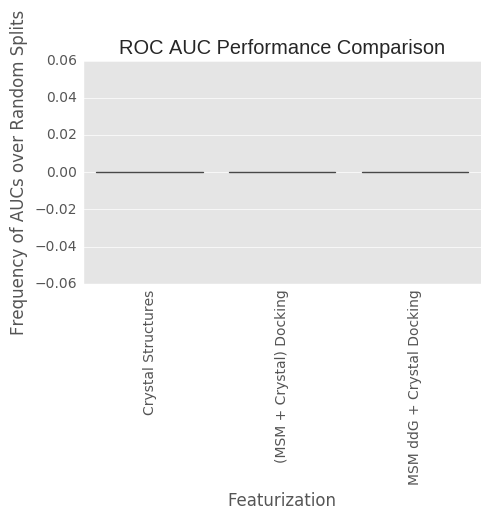

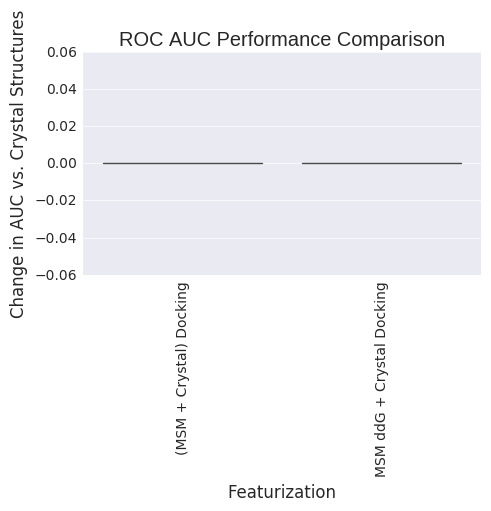

analyzing fdr:
(26, 3)
                           Median AUC  Median delta AUC       Sign Test 99% CI
Crystal Structures                1.0               0.0               (0, 0.0)
(MSM + Crystal) Docking           1.0               0.0  (0.0, 0.203306806274)
MSM ddG + Crystal Docking         1.0               0.0  (0.0, 0.203306806274)


ValueError: list.remove(x): x not in list

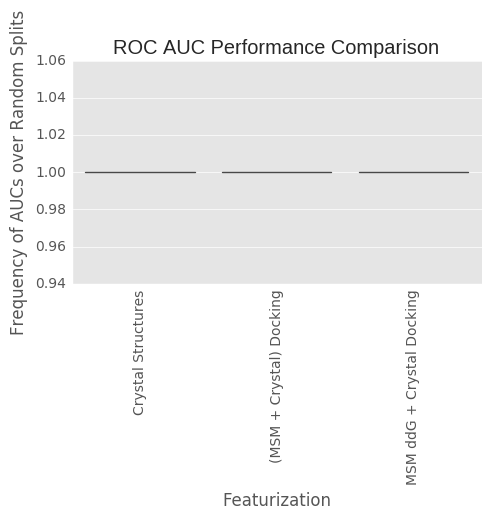

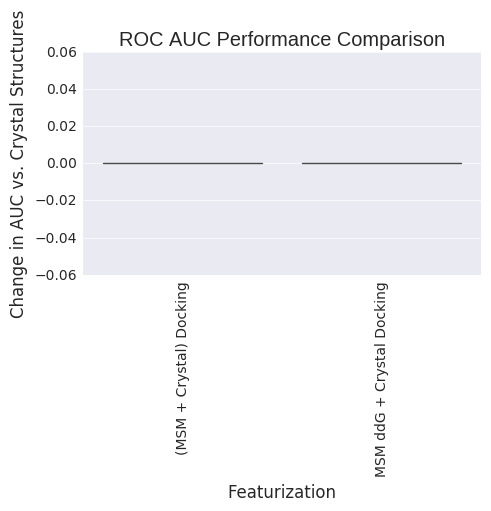

analyzing Recall:
(26, 3)
                           Median AUC  Median delta AUC       Sign Test 99% CI
Crystal Structures                0.0               0.0               (0, 0.0)
(MSM + Crystal) Docking           0.0               0.0  (0.0, 0.203306806274)
MSM ddG + Crystal Docking         0.0               0.0  (0.0, 0.203306806274)


ValueError: list.remove(x): x not in list

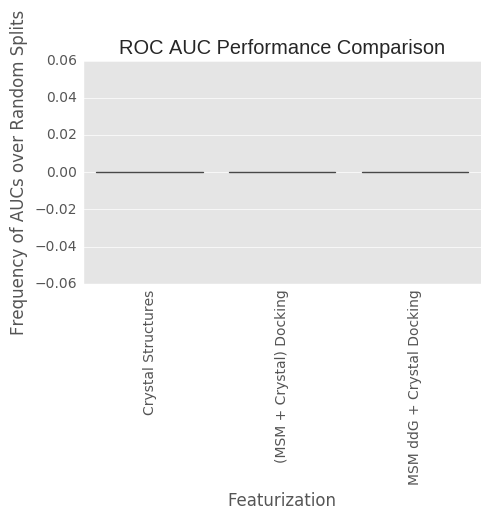

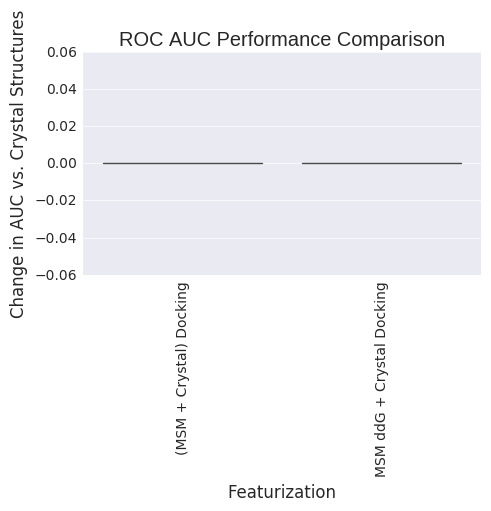

analyzing precision:


ValueError: all the input array dimensions except for the concatenation axis must match exactly

In [208]:
#SP, All ligands, Four class, 32 stereoisomers; new crystal grids; 25 clusters
#max_features = 10 loocv
importance_dfs = analyze_multiclass_experiment(results_dict[save_name], 
                                                                feature_names,
                                                                [f.columns.values.tolist() for f in features], model_agonists, analysis_dir,
                                                                ["Antagonist", "Gs Biased Agonist", "Balanced Agonist"], 
                                                                #["Gs Inactive", "Gs Active"], 
                                                               #["Arr Inactive", "Arr Active"],
                                               np.hstack([X_df.loc[model_agonists].values]),
                                                               #["Gs Inactive", "Gs Partial Active", "Gs Full Active"], 
                                              remake=False, fxn=np.mean)


#TRY LOOCV
#crystal structures might just have bigger boxes

analyzing precision at full recall:
(26, 3)
                           Median AUC  Median delta AUC       Sign Test 99% CI
Crystal Structures           0.538462               0.0               (0, 0.0)
(MSM + Crystal) Docking      0.538462               0.0  (0.0, 0.203306806274)
MSM ddG + Crystal Docking    0.538462               0.0  (0.0, 0.203306806274)


ValueError: list.remove(x): x not in list

analyzing threshold at full recall:
(26, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.380192          0.000000   
(MSM + Crystal) Docking      0.319269         -0.060923   
MSM ddG + Crystal Docking    0.332769         -0.047423   

                                            Sign Test 99% CI  
Crystal Structures                                  (0, 0.0)  
(MSM + Crystal) Docking    (0.0296704910983, 0.357488590651)  
MSM ddG + Crystal Docking   (0.0469684448042, 0.40147472877)  


ValueError: list.remove(x): x not in list

analyzing Accuracy:
(26, 3)
                           Median AUC  Median delta AUC       Sign Test 99% CI
Crystal Structures           0.846154          0.000000               (0, 0.0)
(MSM + Crystal) Docking      0.730769         -0.115385  (0.0, 0.203306806274)
MSM ddG + Crystal Docking    0.692308         -0.153846  (0.0, 0.203306806274)


ValueError: list.remove(x): x not in list

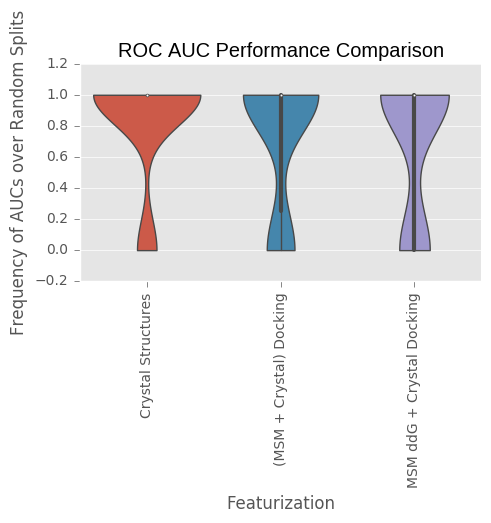

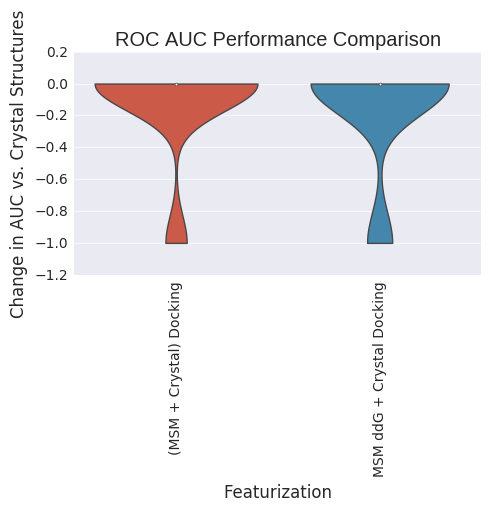

analyzing Recall:
(26, 3)
                           Median AUC  Median delta AUC       Sign Test 99% CI
Crystal Structures                0.0               0.0               (0, 0.0)
(MSM + Crystal) Docking           0.0               0.0  (0.0, 0.203306806274)
MSM ddG + Crystal Docking         0.0               0.0  (0.0, 0.203306806274)


ValueError: list.remove(x): x not in list

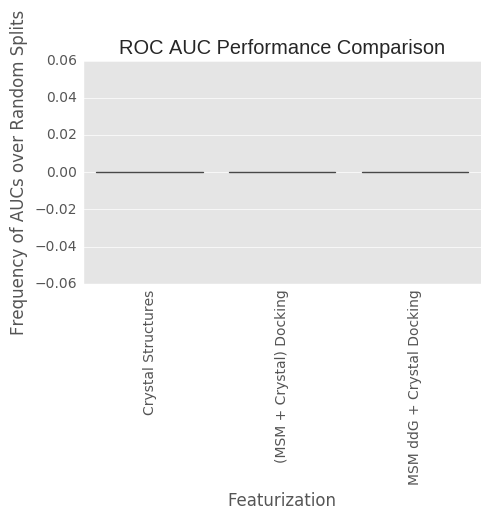

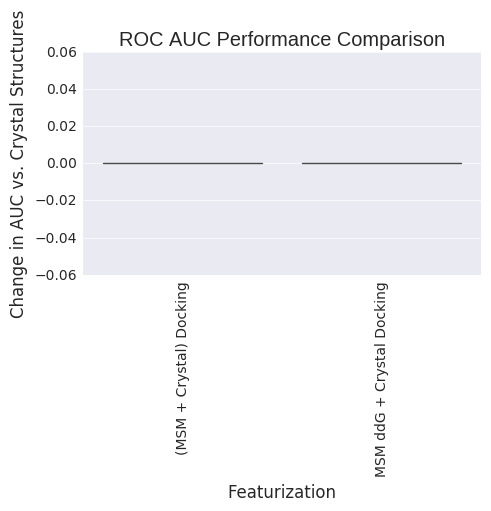

analyzing precision:
(26, 3)
                           Median AUC  Median delta AUC       Sign Test 99% CI
Crystal Structures                0.0               0.0               (0, 0.0)
(MSM + Crystal) Docking           0.0               0.0  (0.0, 0.203306806274)
MSM ddG + Crystal Docking         0.0               0.0  (0.0, 0.203306806274)


ValueError: list.remove(x): x not in list

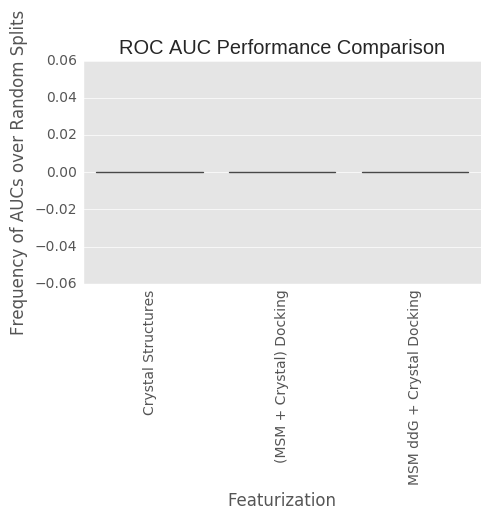

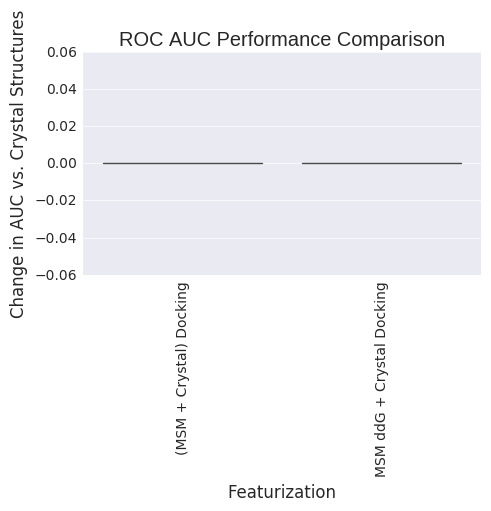

analyzing fdr:
(26, 3)
                           Median AUC  Median delta AUC       Sign Test 99% CI
Crystal Structures                1.0               0.0               (0, 0.0)
(MSM + Crystal) Docking           1.0               0.0  (0.0, 0.203306806274)
MSM ddG + Crystal Docking         1.0               0.0  (0.0, 0.203306806274)


ValueError: list.remove(x): x not in list

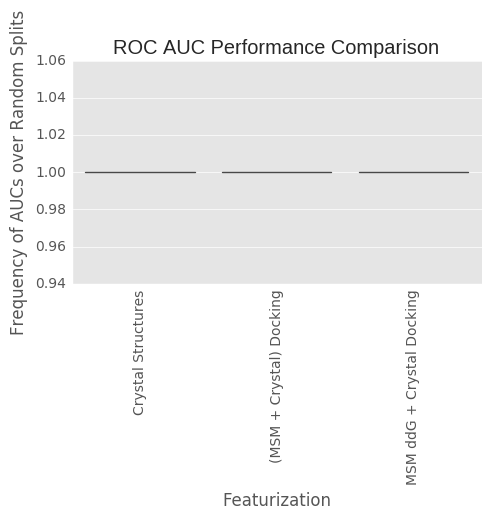

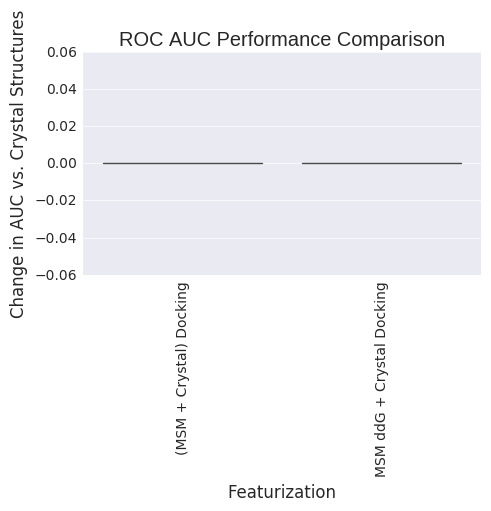

analyzing Recall:
(26, 3)
                           Median AUC  Median delta AUC       Sign Test 99% CI
Crystal Structures                0.0               0.0               (0, 0.0)
(MSM + Crystal) Docking           0.0               0.0  (0.0, 0.203306806274)
MSM ddG + Crystal Docking         0.0               0.0  (0.0, 0.203306806274)


ValueError: list.remove(x): x not in list

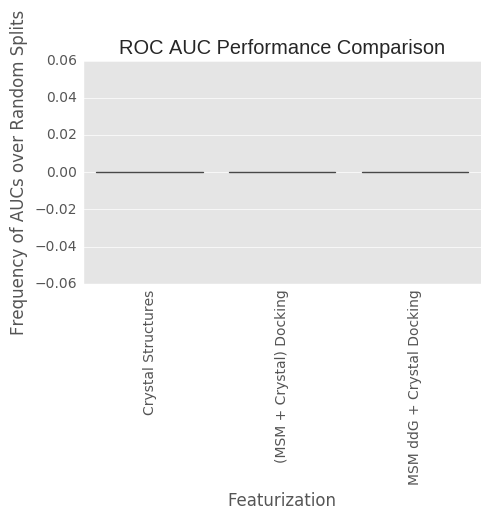

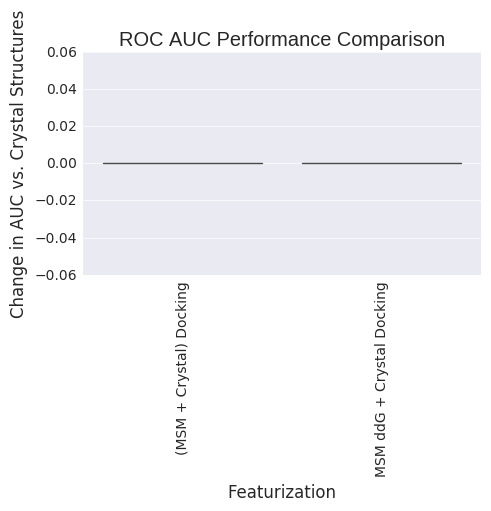

analyzing precision:


ValueError: all the input array dimensions except for the concatenation axis must match exactly

In [210]:
#SP, All ligands, Four class, 32 stereoisomers; new crystal grids; 25 clusters
#loocv all features
importance_dfs = analyze_multiclass_experiment(results_dict[save_name], 
                                                                feature_names,
                                                                [f.columns.values.tolist() for f in features], model_agonists, analysis_dir,
                                                                ["Gs Biased Agonist", "Balanced Agonist"], 
                                                                #["Gs Inactive", "Gs Active"], 
                                                               #["Arr Inactive", "Arr Active"],
                                               np.hstack([X_df.loc[model_agonists].values]),
                                                               #["Gs Inactive", "Gs Partial Active", "Gs Full Active"], 
                                              remake=False, fxn=np.mean)


#TRY LOOCV
#crystal structures might just have bigger boxes


analyzing precision at full recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.826825          0.000000   
(MSM + Crystal) Docking      0.734775         -0.092050   
MSM ddG + Crystal Docking    0.815704         -0.011121   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.130556644251, 0.189951712543)  
MSM ddG + Crystal Docking  (0.190982125408, 0.258669379949)  


ValueError: list.remove(x): x not in list

analyzing threshold at full recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.483587          0.000000   
(MSM + Crystal) Docking      0.382404         -0.101183   
MSM ddG + Crystal Docking    0.444896         -0.038691   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.251651671235, 0.325156165014)  
MSM ddG + Crystal Docking  (0.390265518687, 0.470657244399)  


ValueError: list.remove(x): x not in list

analyzing Accuracy:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures             0.7885            0.0000   
(MSM + Crystal) Docking        0.7805           -0.0080   
MSM ddG + Crystal Docking      0.8104            0.0219   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.221192183808, 0.292037486995)  
MSM ddG + Crystal Docking  (0.313220952757, 0.390743214384)  


ValueError: list.remove(x): x not in list

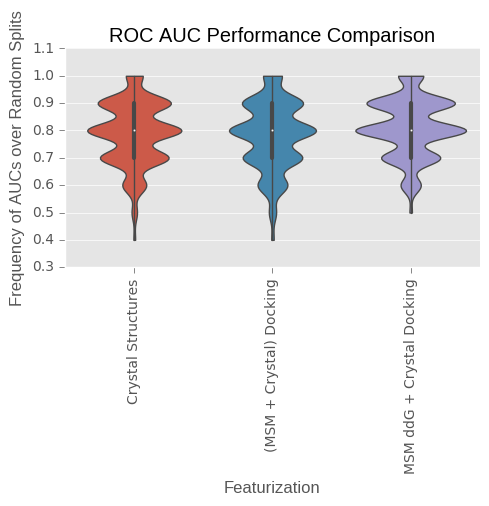

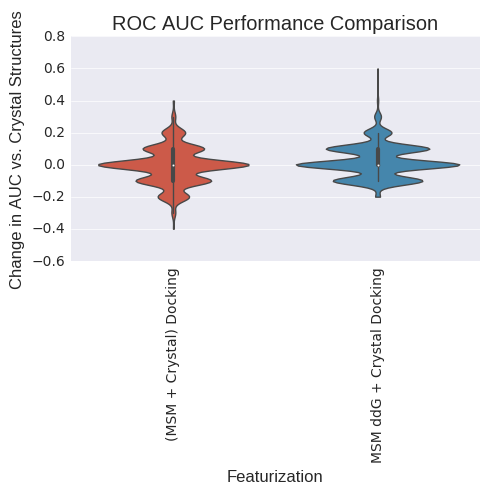

analyzing Recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.826000          0.000000   
(MSM + Crystal) Docking      0.761667         -0.064333   
MSM ddG + Crystal Docking    0.799667         -0.026333   

                                             Sign Test 99% CI  
Crystal Structures                                   (0, 0.0)  
(MSM + Crystal) Docking    (0.0527861738913, 0.0948690455958)  
MSM ddG + Crystal Docking    (0.187225095576, 0.254479139099)  


ValueError: list.remove(x): x not in list

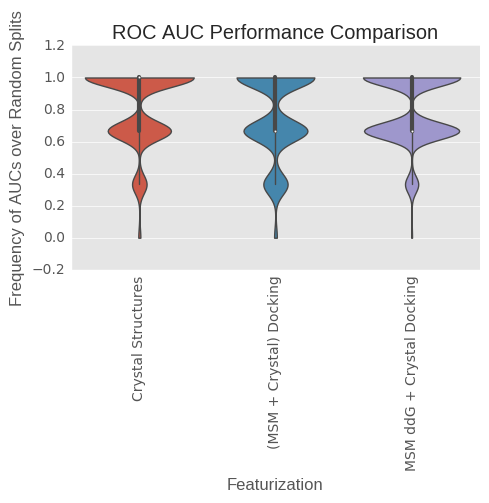

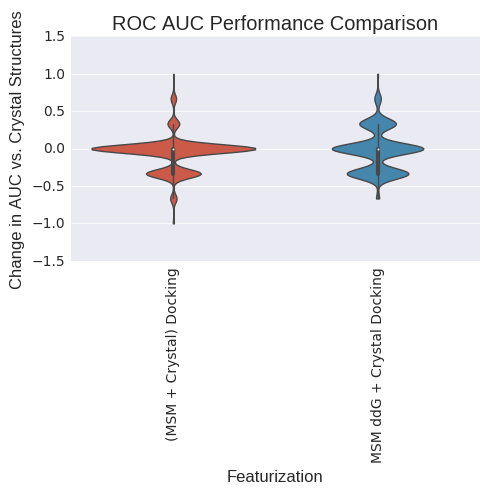

analyzing precision:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.824162          0.000000   
(MSM + Crystal) Docking      0.771325         -0.052837   
MSM ddG + Crystal Docking    0.771169         -0.052993   

                                          Sign Test 99% CI  
Crystal Structures                                (0, 0.0)  
(MSM + Crystal) Docking    (0.16105842369, 0.225014916221)  
MSM ddG + Crystal Docking  (0.161988727721, 0.22607142986)  


ValueError: list.remove(x): x not in list

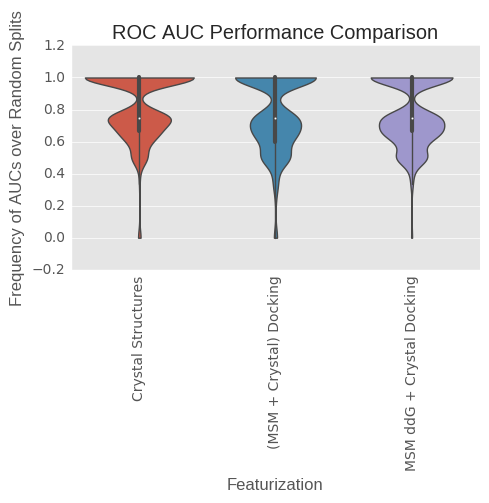

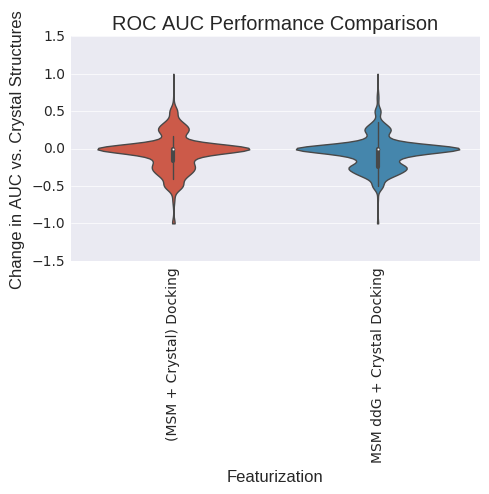

analyzing fdr:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.175838          0.000000   
(MSM + Crystal) Docking      0.228675          0.052837   
MSM ddG + Crystal Docking    0.228831          0.052993   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.316126501916, 0.393798118236)  
MSM ddG + Crystal Docking  (0.359903943115, 0.439427472195)  


ValueError: list.remove(x): x not in list

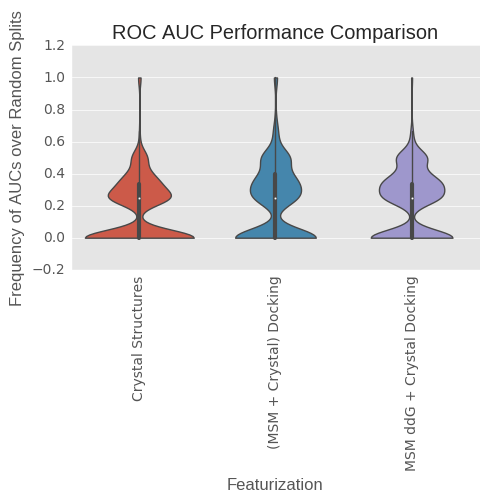

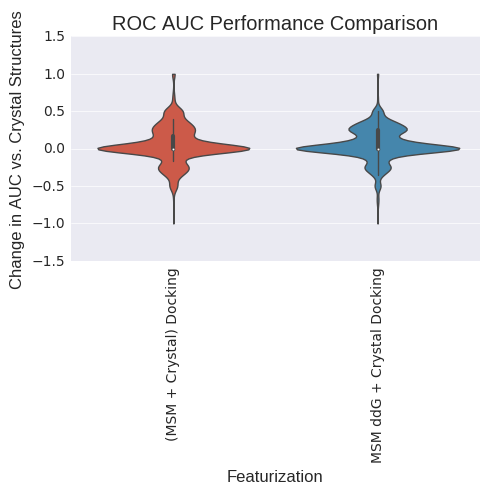

analyzing Recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures             0.7885            0.0000   
(MSM + Crystal) Docking        0.7805           -0.0080   
MSM ddG + Crystal Docking      0.8104            0.0219   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.221192183808, 0.292037486995)  
MSM ddG + Crystal Docking  (0.313220952757, 0.390743214384)  


ValueError: list.remove(x): x not in list

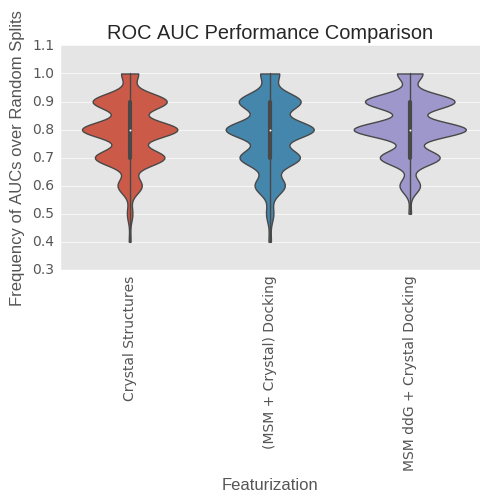

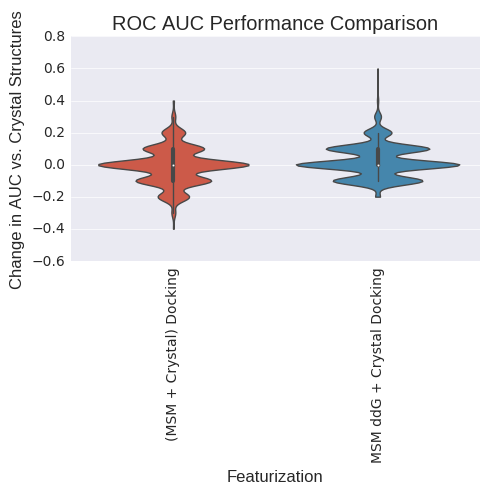

analyzing precision:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.817002          0.000000   
(MSM + Crystal) Docking      0.807955         -0.009047   
MSM ddG + Crystal Docking    0.843243          0.026241   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.292929372415, 0.369311623652)  
MSM ddG + Crystal Docking  (0.435611674688, 0.516704701227)  


ValueError: list.remove(x): x not in list

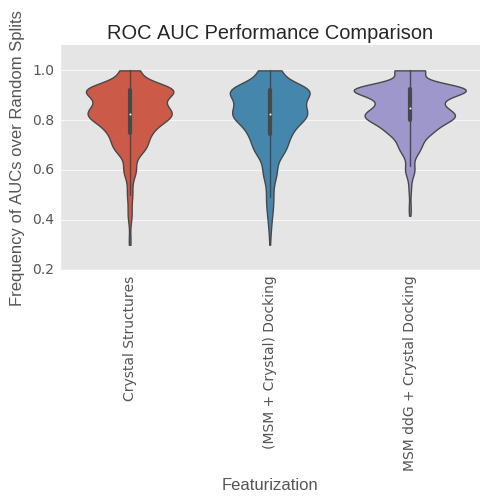

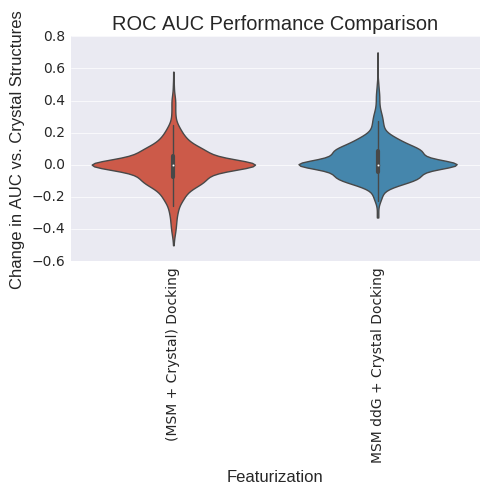

analyzing fdr:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.182998          0.000000   
(MSM + Crystal) Docking      0.192045          0.009047   
MSM ddG + Crystal Docking    0.156757         -0.026241   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.334566439718, 0.413107716168)  
MSM ddG + Crystal Docking  (0.283296502703, 0.359076316662)  


ValueError: list.remove(x): x not in list

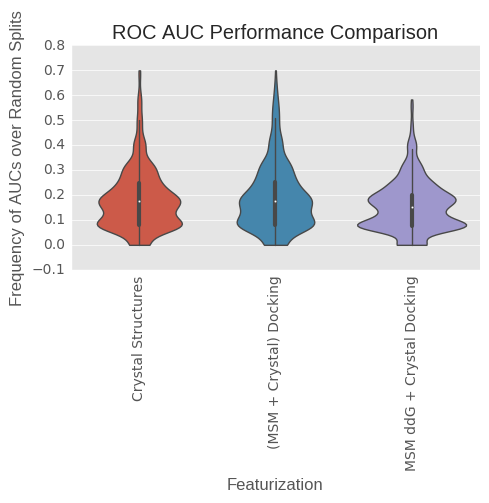

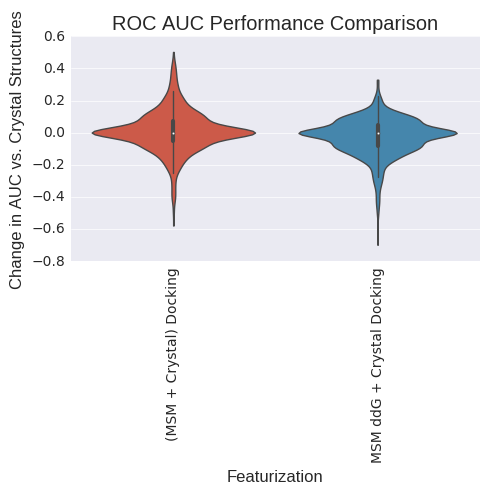

analyzing class B ROC AUC:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.936190          0.000000   
(MSM + Crystal) Docking      0.901714         -0.034476   
MSM ddG + Crystal Docking    0.935333         -0.000857   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking      (0.20794271148, 0.27747151194)  
MSM ddG + Crystal Docking  (0.272723278764, 0.347794546229)  


ValueError: list.remove(x): x not in list

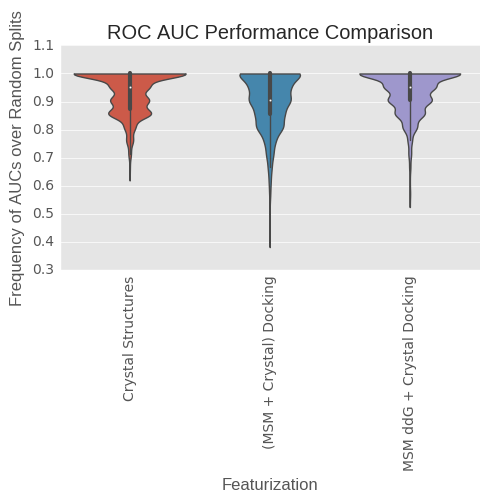

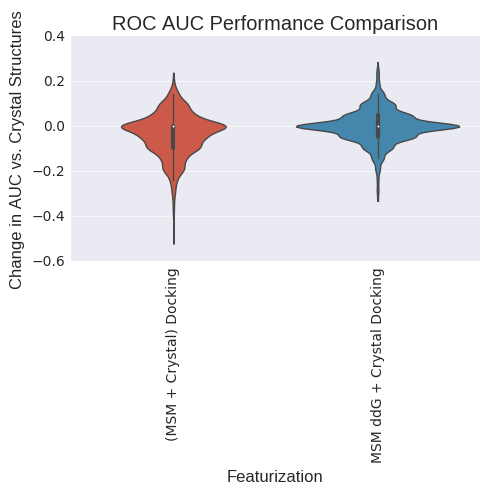

analyzing ROC AUC:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.908348          0.000000   
(MSM + Crystal) Docking      0.918113          0.009765   
MSM ddG + Crystal Docking    0.924999          0.016651   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.461394145487, 0.542579489853)  
MSM ddG + Crystal Docking   (0.548464334717, 0.62836243793)  


ValueError: list.remove(x): x not in list

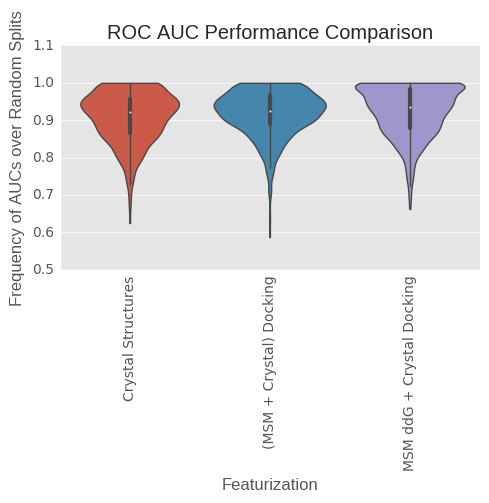

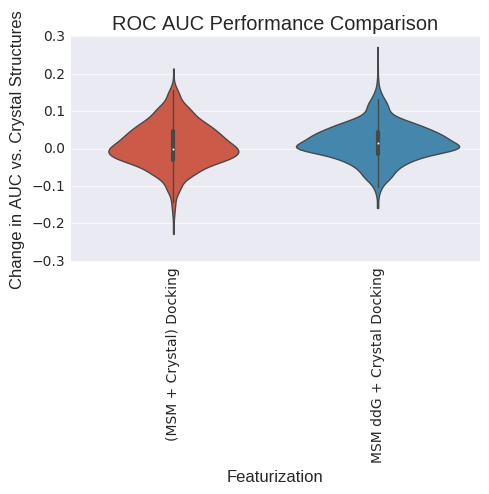

analyzing BedROC
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.957256          0.000000   
(MSM + Crystal) Docking      0.991642          0.034386   
MSM ddG + Crystal Docking    0.983102          0.025847   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.712119249029, 0.782598350849)  
MSM ddG + Crystal Docking  (0.511282933585, 0.592031585265)  


ValueError: list.remove(x): x not in list

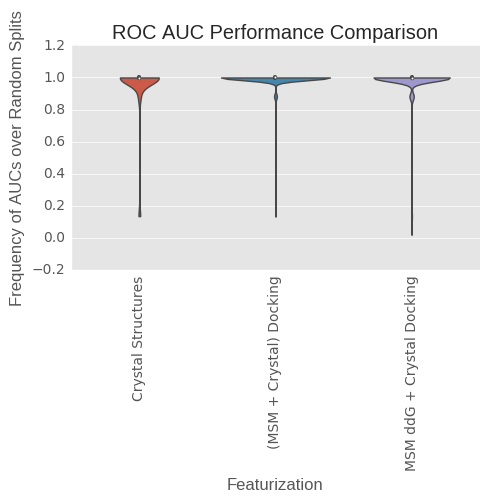

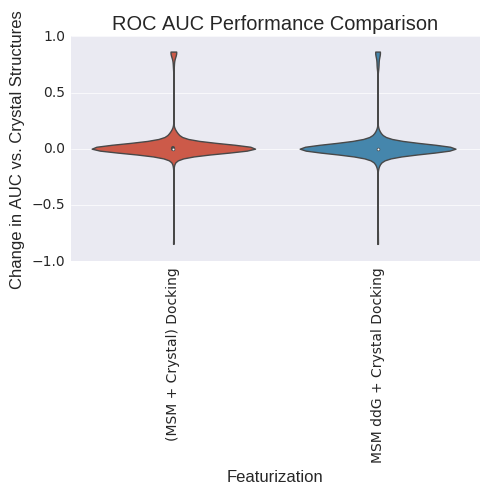

analyzing LogAUC
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures                0.0               0.0   
(MSM + Crystal) Docking           0.0               0.0   
MSM ddG + Crystal Docking         0.0               0.0   

                                                 Sign Test 99% CI  
Crystal Structures                                       (0, 0.0)  
(MSM + Crystal) Docking    (-4.33680868994e-19, 0.00659116490341)  
MSM ddG + Crystal Docking  (-4.33680868994e-19, 0.00659116490341)  


ValueError: list.remove(x): x not in list

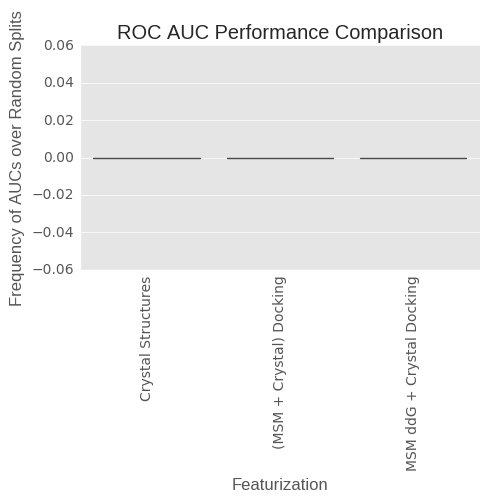

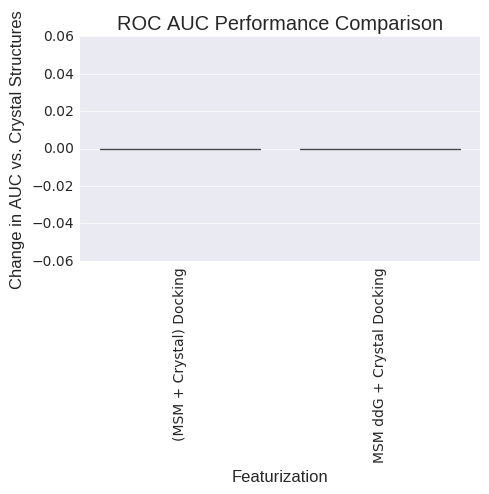

(3,)
(1, 3)


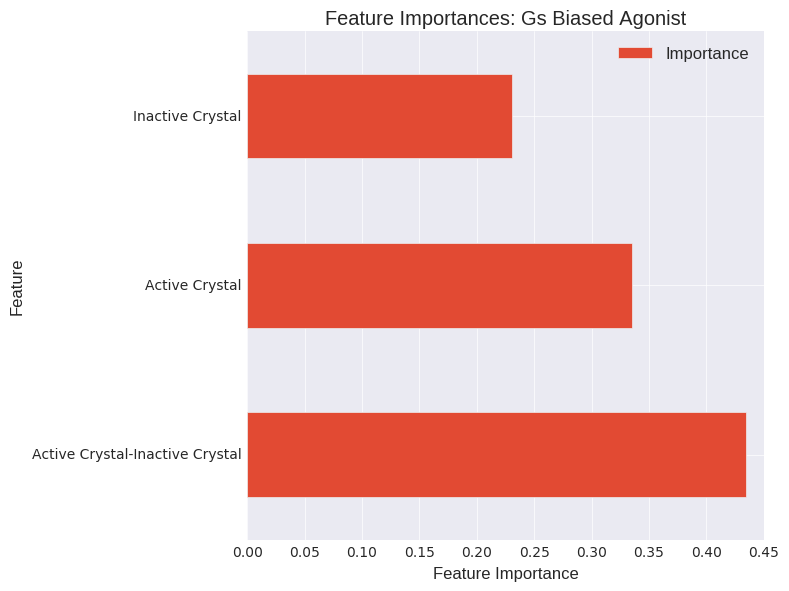

(56,)
(1, 56)


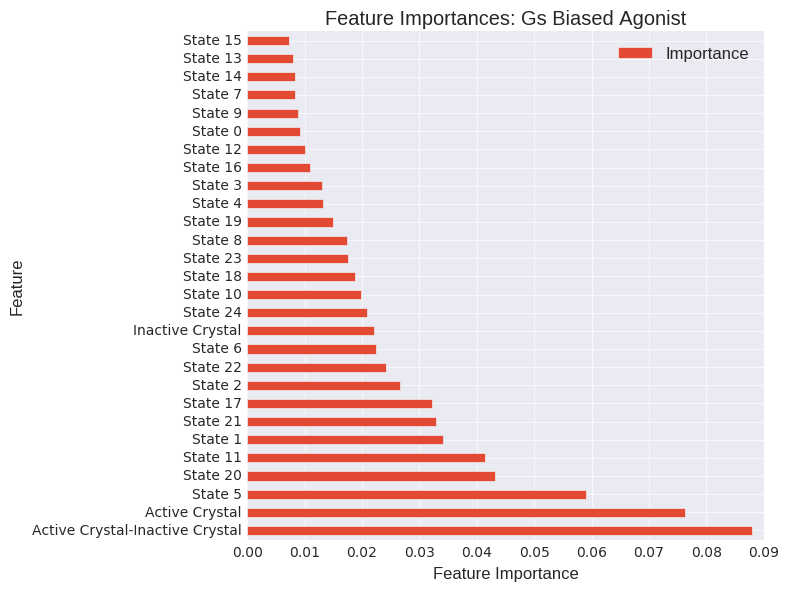

(53,)
(1, 53)


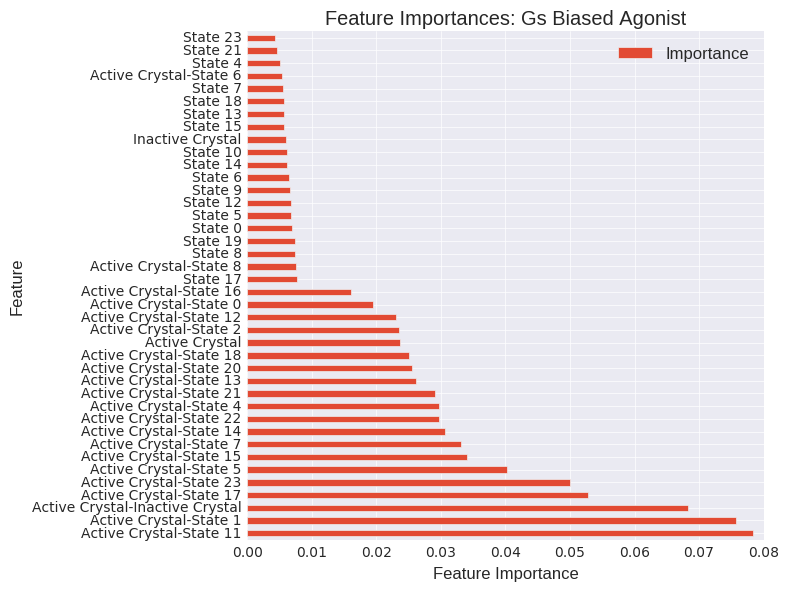

In [402]:
#SP, All ligands, Four class, 32 stereoisomers; new crystal grids; 25 clusters

importance_dfs = analyze_multiclass_experiment(results_dict[save_name], 
                                                                feature_names,
                                                                [f.columns.values.tolist() for f in features], model_agonists, analysis_dir,
                                                                ["Antagonist", "Gs Biased Agonist", "Balanced Agonist"], 
                                                                #["Gs Inactive", "Gs Active"], 
                                                               #["Arr Inactive", "Arr Active"],
                                               np.hstack([X_df.loc[model_agonists].values]),
                                                               #["Gs Inactive", "Gs Partial Active", "Gs Full Active"], 
                                              remake=False, fxn=np.mean)


#TRY LOOCV
#crystal structures might just have bigger boxes



(array([    2.,     3.,     3.,    15.,    11.,    16.,    26.,    22.,
           36.,    38.,    39.,    54.,    50.,    46.,    88.,   151.,
          181.,   184.,   173.,   162.,   210.,   365.,   642.,  1155.,
         1594.,  1799.,  1883.,  1882.,  1601.,  1303.,  1109.,   970.,
          792.,   655.,   506.,   373.,   295.,   237.,   224.,   240.,
          237.,   211.,   157.,   123.,    60.,    24.,    18.,    18.,
           12.,     6.]),
 array([  9.96617603,  10.56164423,  11.15711243,  11.75258062,
         12.34804882,  12.94351702,  13.53898521,  14.13445341,
         14.72992161,  15.3253898 ,  15.920858  ,  16.5163262 ,
         17.1117944 ,  17.70726259,  18.30273079,  18.89819899,
         19.49366718,  20.08913538,  20.68460358,  21.28007177,
         21.87553997,  22.47100817,  23.06647636,  23.66194456,
         24.25741276,  24.85288095,  25.44834915,  26.04381735,
         26.63928555,  27.23475374,  27.83022194,  28.42569014,
         29.02115833,  29.6166

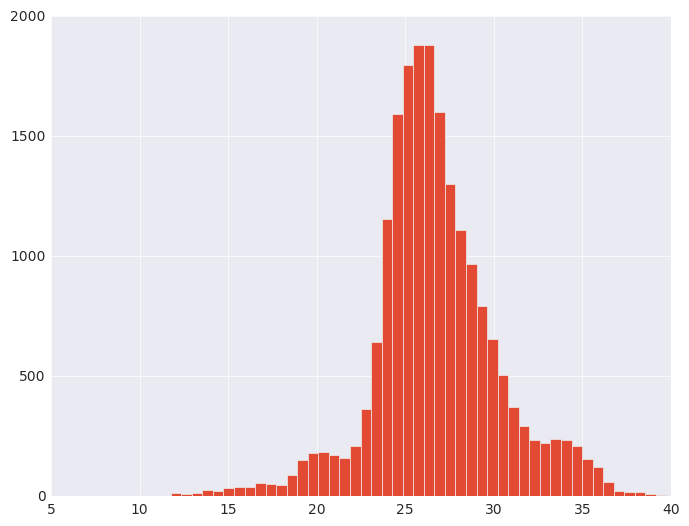

In [228]:
plt.hist(lig_features_eq["msm"]["Asn148-Leu266_closest_dist"], bins=50)

analyzing precision at full recall:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.790000          0.000000   
(MSM + Crystal) Docking      0.736667         -0.053333   
MSM ddG + Crystal Docking    0.720667         -0.069333   

                                            Sign Test 99% CI  
Crystal Structures                                  (0, 0.0)  
(MSM + Crystal) Docking    (0.0592072768353, 0.228080445829)  
MSM ddG + Crystal Docking  (0.0335905628591, 0.178674814822)  


ValueError: list.remove(x): x not in list

analyzing threshold at full recall:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.327357          0.000000   
(MSM + Crystal) Docking      0.189343         -0.138013   
MSM ddG + Crystal Docking    0.212621         -0.114735   

                                            Sign Test 99% CI  
Crystal Structures                                  (0, 0.0)  
(MSM + Crystal) Docking    (0.0946113172672, 0.286454336625)  
MSM ddG + Crystal Docking   (0.164505369942, 0.385360560162)  


ValueError: list.remove(x): x not in list

analyzing Accuracy:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.655000          0.000000   
(MSM + Crystal) Docking      0.640000         -0.015000   
MSM ddG + Crystal Docking    0.646667         -0.008333   

                                            Sign Test 99% CI  
Crystal Structures                                  (0, 0.0)  
(MSM + Crystal) Docking    (0.0729952751204, 0.251803620035)  
MSM ddG + Crystal Docking  (0.0800854422871, 0.263469039114)  


ValueError: list.remove(x): x not in list

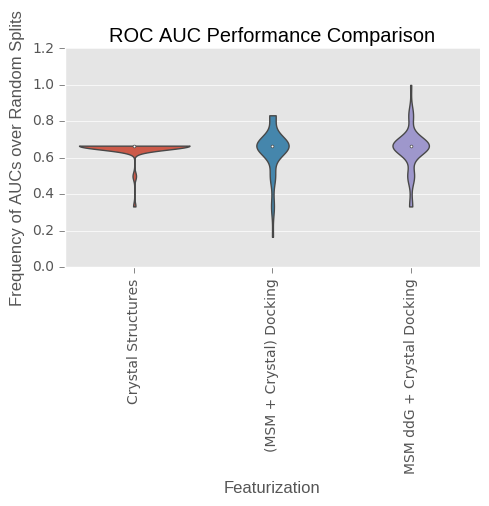

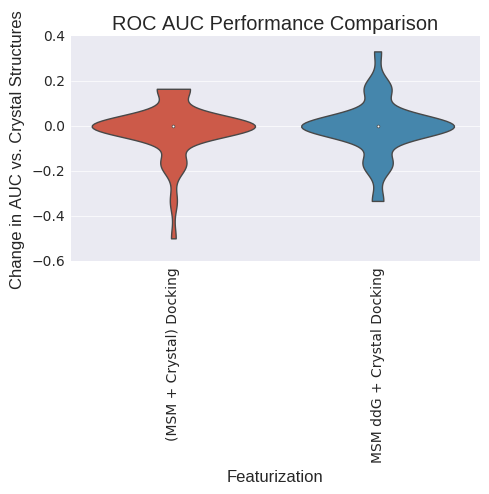

analyzing Recall:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures              0.000             0.000   
(MSM + Crystal) Docking         0.175             0.175   
MSM ddG + Crystal Docking       0.200             0.200   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.205853128193, 0.437790733139)  
MSM ddG + Crystal Docking  (0.214303806581, 0.448095640997)  


ValueError: list.remove(x): x not in list

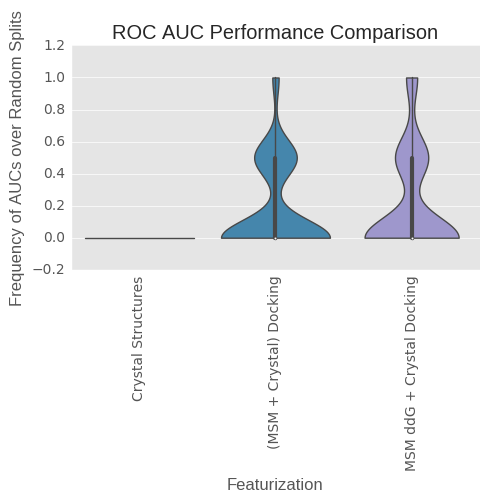

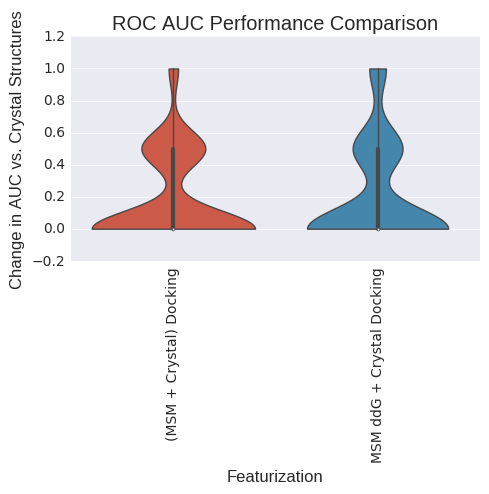

analyzing precision:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.000000          0.000000   
(MSM + Crystal) Docking      0.204167          0.204167   
MSM ddG + Crystal Docking    0.190667          0.190667   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.205853128193, 0.437790733139)  
MSM ddG + Crystal Docking  (0.214303806581, 0.448095640997)  


ValueError: list.remove(x): x not in list

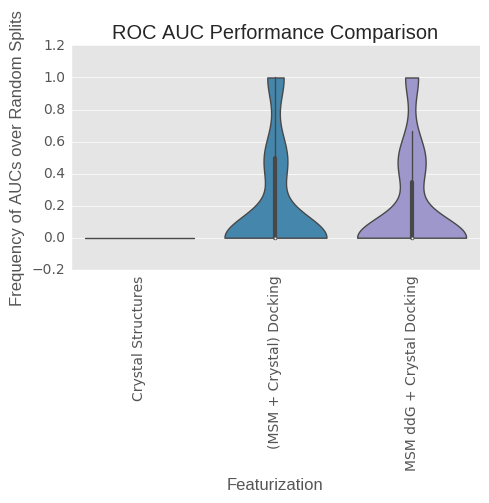

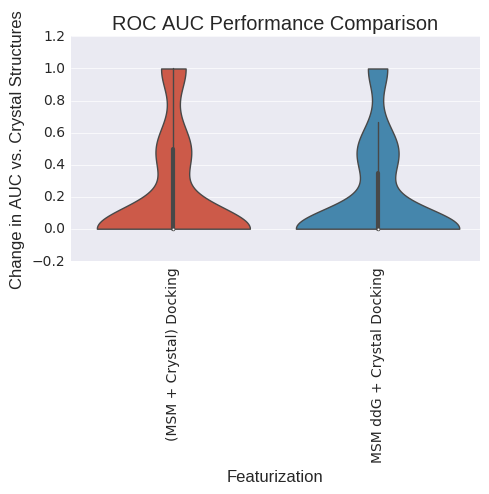

analyzing fdr:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           1.000000          0.000000   
(MSM + Crystal) Docking      0.795833         -0.204167   
MSM ddG + Crystal Docking    0.809333         -0.190667   

                                 Sign Test 99% CI  
Crystal Structures                       (0, 0.0)  
(MSM + Crystal) Docking    (0.0, 0.0622206877158)  
MSM ddG + Crystal Docking  (0.0, 0.0622206877158)  


ValueError: list.remove(x): x not in list

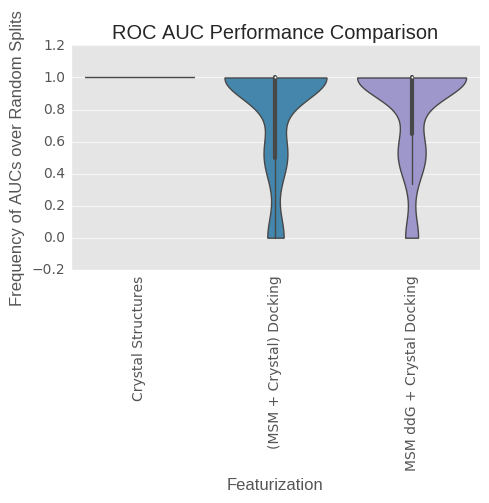

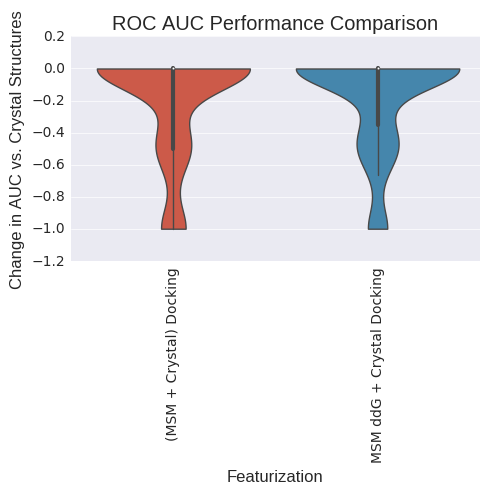

analyzing Recall:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures             0.9825            0.0000   
(MSM + Crystal) Docking        0.8725           -0.1100   
MSM ddG + Crystal Docking      0.8700           -0.1125   

                                             Sign Test 99% CI  
Crystal Structures                                   (0, 0.0)  
(MSM + Crystal) Docking    (0.00117514542651, 0.079801128535)  
MSM ddG + Crystal Docking   (0.0119781971808, 0.125264835518)  


ValueError: list.remove(x): x not in list

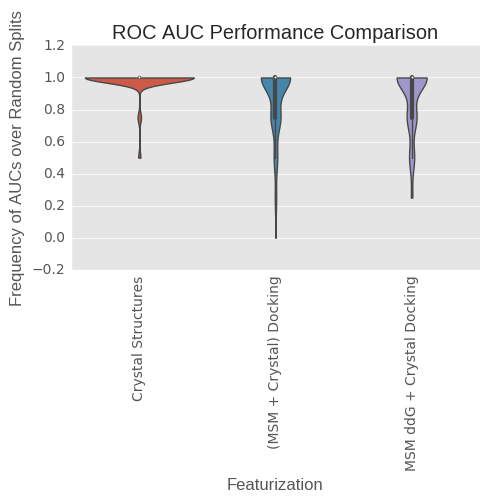

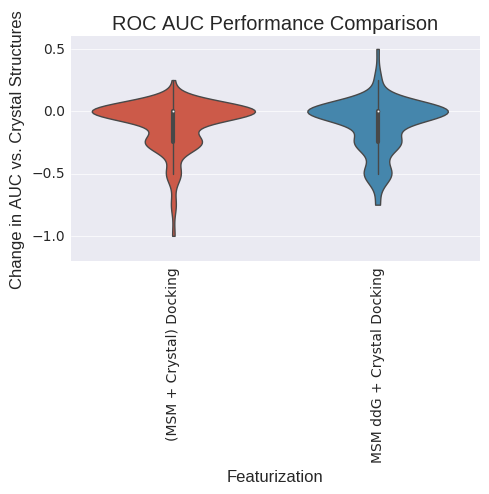

analyzing precision:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.661333            0.0000   
(MSM + Crystal) Docking      0.674333            0.0130   
MSM ddG + Crystal Docking    0.695833            0.0345   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.172648341273, 0.395973175076)  
MSM ddG + Crystal Docking   (0.189127900701, 0.41700478814)  


ValueError: list.remove(x): x not in list

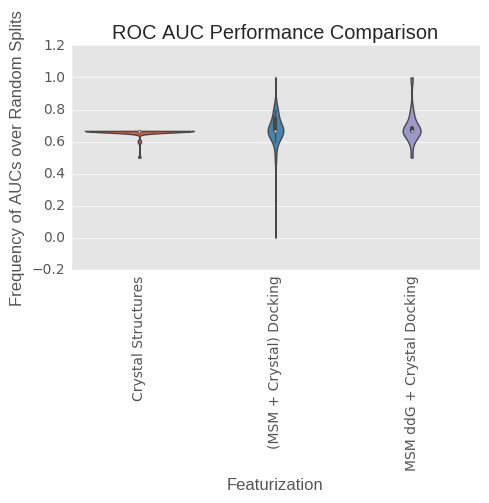

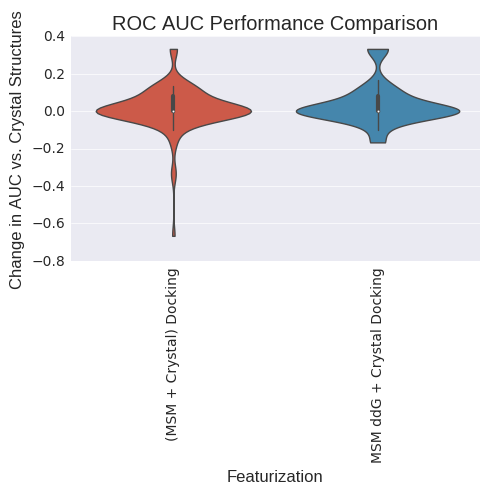

analyzing fdr:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.338667            0.0000   
(MSM + Crystal) Docking      0.325667           -0.0130   
MSM ddG + Crystal Docking    0.304167           -0.0345   

                                            Sign Test 99% CI  
Crystal Structures                                  (0, 0.0)  
(MSM + Crystal) Docking     (0.066032250764, 0.240011058146)  
MSM ddG + Crystal Docking  (0.0592072768353, 0.228080445829)  


ValueError: list.remove(x): x not in list

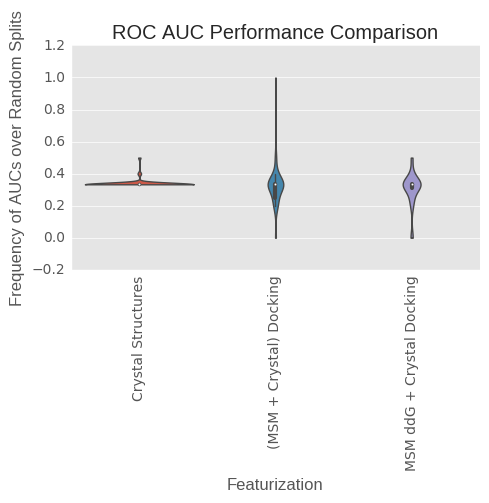

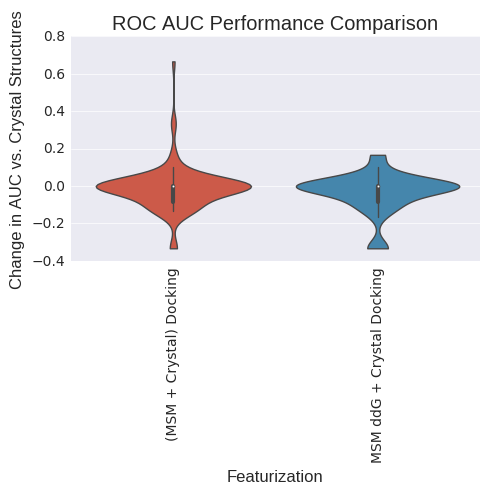

analyzing class B ROC AUC:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures                0.0               0.0   
(MSM + Crystal) Docking           0.0               0.0   
MSM ddG + Crystal Docking         0.0               0.0   

                                 Sign Test 99% CI  
Crystal Structures                       (0, 0.0)  
(MSM + Crystal) Docking    (0.0, 0.0622206877158)  
MSM ddG + Crystal Docking  (0.0, 0.0622206877158)  


ValueError: list.remove(x): x not in list

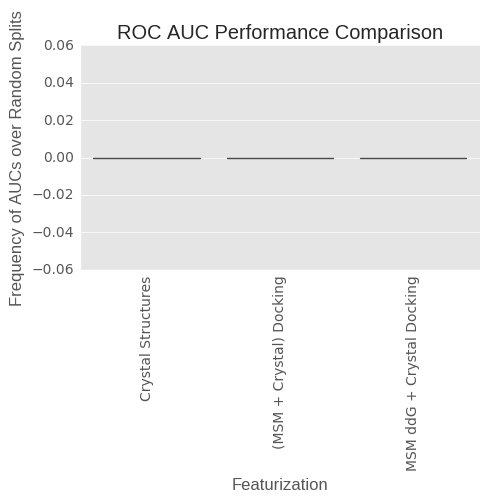

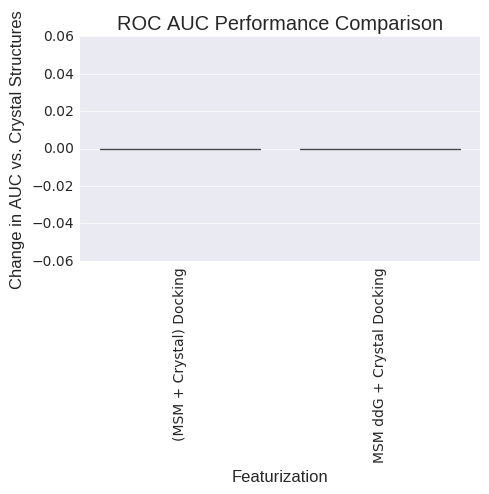

analyzing ROC AUC:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures                0.0               0.0   
(MSM + Crystal) Docking           0.0               0.0   
MSM ddG + Crystal Docking         0.0               0.0   

                                 Sign Test 99% CI  
Crystal Structures                       (0, 0.0)  
(MSM + Crystal) Docking    (0.0, 0.0622206877158)  
MSM ddG + Crystal Docking  (0.0, 0.0622206877158)  


ValueError: list.remove(x): x not in list

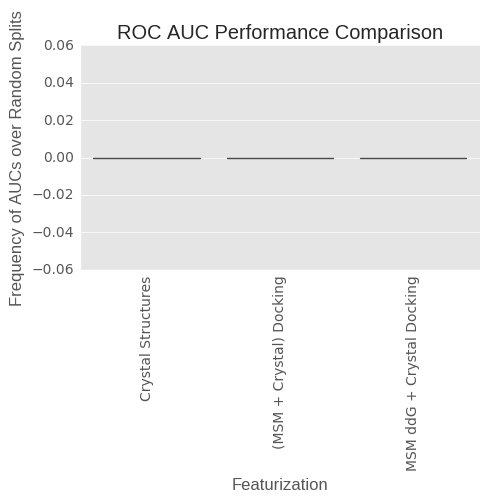

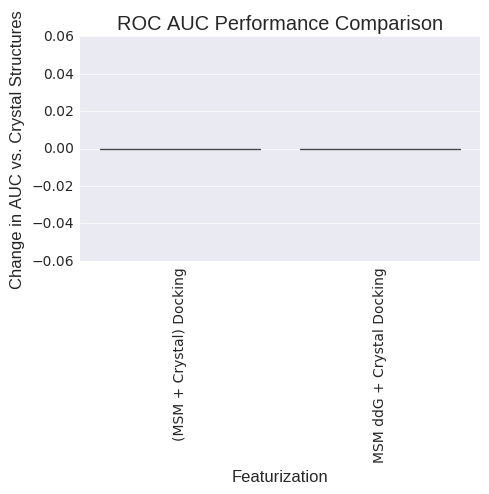

analyzing BedROC
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures                1.0               0.0   
(MSM + Crystal) Docking           1.0               0.0   
MSM ddG + Crystal Docking         1.0               0.0   

                                 Sign Test 99% CI  
Crystal Structures                       (0, 0.0)  
(MSM + Crystal) Docking    (0.0, 0.0622206877158)  
MSM ddG + Crystal Docking  (0.0, 0.0622206877158)  


ValueError: list.remove(x): x not in list

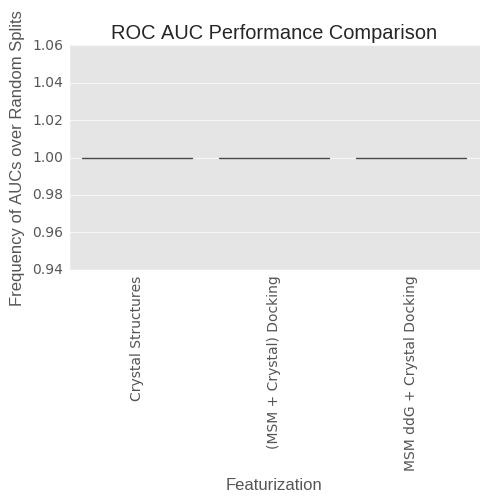

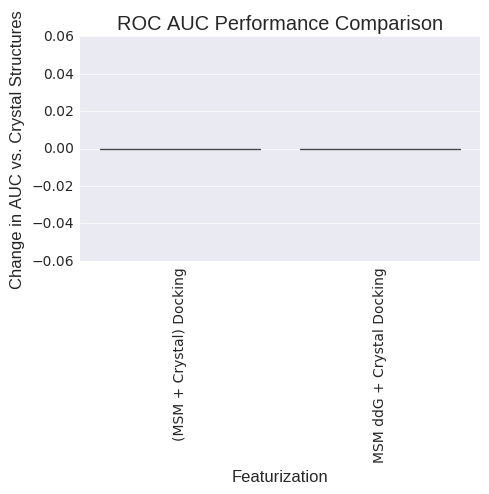

analyzing LogAUC
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures                0.0               0.0   
(MSM + Crystal) Docking           0.0               0.0   
MSM ddG + Crystal Docking         0.0               0.0   

                                 Sign Test 99% CI  
Crystal Structures                       (0, 0.0)  
(MSM + Crystal) Docking    (0.0, 0.0622206877158)  
MSM ddG + Crystal Docking  (0.0, 0.0622206877158)  


ValueError: list.remove(x): x not in list

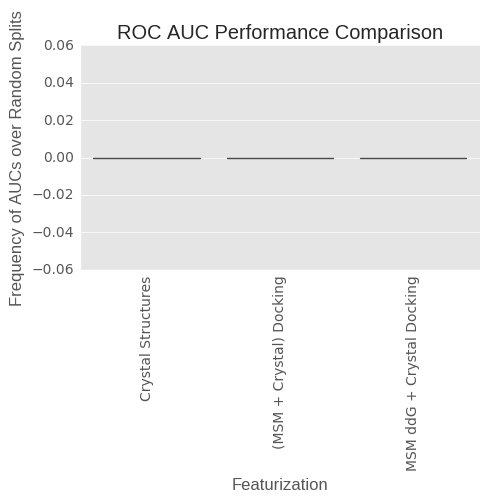

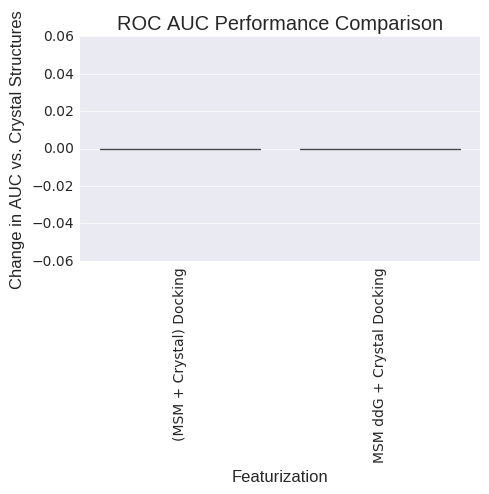

(1, 3)
(1, 3)


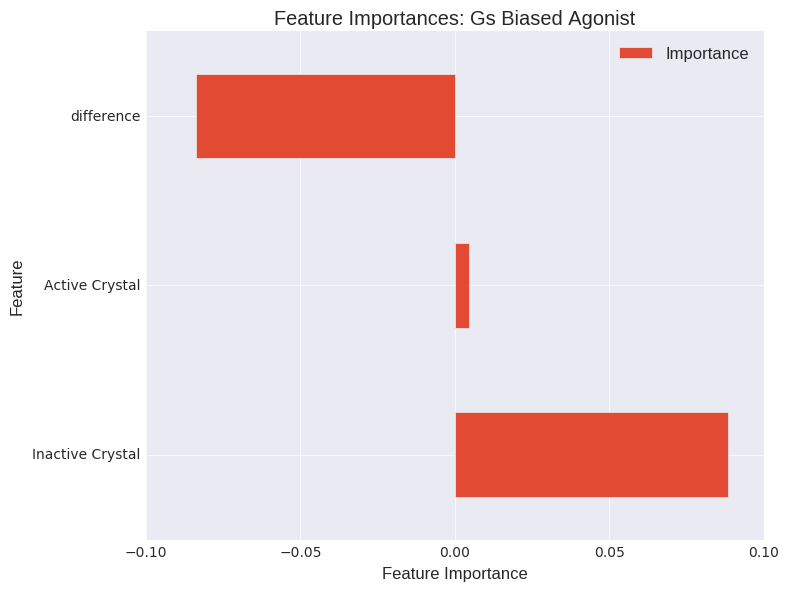

(1, 55)
(1, 55)


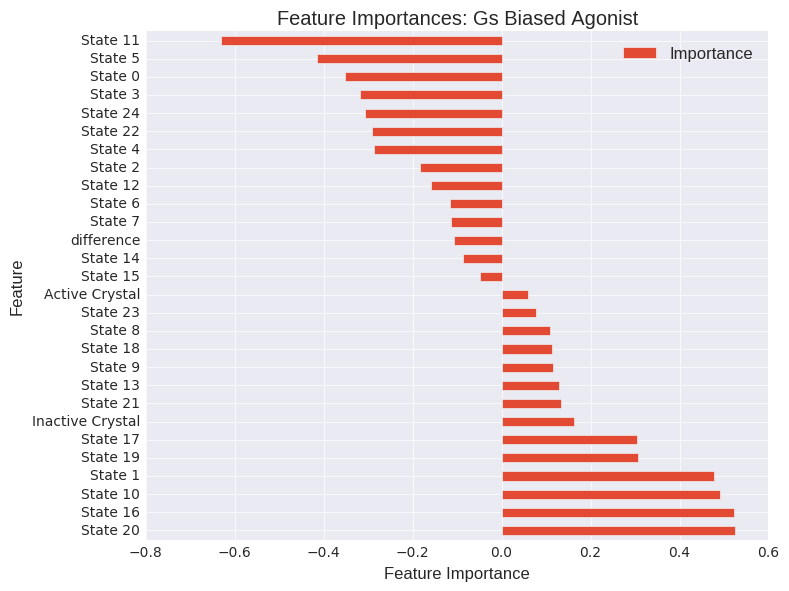

(1, 33)
(1, 33)


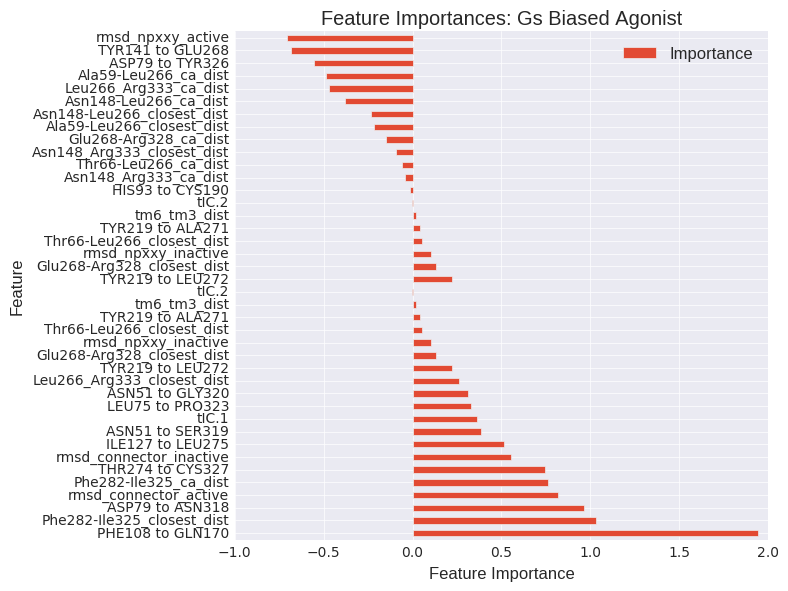

In [173]:
import efficacy_scripts
reload(efficacy_scripts)
from efficacy_scripts import *

#SP, All ligands, Four class, 32 stereoisomers; new crystal grids; 25 clusters

importance_dfs = analyze_multiclass_experiment(results_dict[save_name], 
                                                                feature_names,
                                                                [f.columns.values.tolist() for f in features], model_agonists, analysis_dir,
                                                                ["Antagonist", "Gs Biased Agonist", "Balanced Agonist"], 
     
                                               #["Gs Inactive", "Gs Active"], 
                                                               #["Arr Inactive", "Arr Active"],
                                               np.hstack([X_df.loc[model_agonists].values]),
                                                               #["Gs Inactive", "Gs Partial Active", "Gs Full Active"], 
                                              remake=False, fxn=np.mean)


#TRY LOOCV
#crystal structures might just have bigger boxes





In [229]:
obs_df.loc[["CID_3779", "CID_2585", "CID_838", "CID_2083", ]]

,ASN51 to GLY320_mean5.04,ASN51 to GLY320_mean3.04,ASN51 to GLY320_mean6.05,ASN51 to GLY320_mean4.95,ASN51 to SER319_mean3.07,ASN51 to SER319_mean5.74,ASN51 to SER319_mean5.82,ASN51 to SER319_mean3.63,ASP79 to ASN318_mean8.25,ASP79 to ASN318_mean5.11,ASP79 to ASN318_mean7.33,ASP79 to ASN318_mean8.88,ASP79 to TYR326_mean6.20,ASP79 to TYR326_mean12.55,ASP79 to TYR326_mean9.35,ASP79 to TYR326_mean7.69,Ala59-Leu266_ca_dist_mean25.24,Ala59-Leu266_ca_dist_mean29.74,Ala59-Leu266_ca_dist_mean26.60,Ala59-Leu266_ca_dist_mean33.25,Ala59-Leu266_closest_dist_mean26.06,Ala59-Leu266_closest_dist_mean22.69,Ala59-Leu266_closest_dist_mean29.88,Ala59-Leu266_closest_dist_mean23.88,Asn148-Leu266_ca_dist_mean28.23,Asn148-Leu266_ca_dist_mean30.08,Asn148-Leu266_ca_dist_mean26.50,Asn148-Leu266_ca_dist_mean34.96,Asn148-Leu266_closest_dist_mean26.06,Asn148-Leu266_closest_dist_mean27.37,Asn148-Leu266_closest_dist_mean31.59,Asn148-Leu266_closest_dist_mean22.65,Asn148_Arg333_ca_dist_mean26.77,Asn148_Arg333_ca_dist_mean27.16,Asn148_Arg333_ca_dist_mean28.15,Asn148_Arg333_ca_dist_mean26.21,Asn148_Arg333_closest_dist_mean24.88,Asn148_Arg333_closest_dist_mean23.90,Asn148_Arg333_closest_dist_mean26.21,Asn148_Arg333_closest_dist_mean24.41,Glu268-Arg328_ca_dist_mean18.94,Glu268-Arg328_ca_dist_mean15.78,Glu268-Arg328_ca_dist_mean20.74,Glu268-Arg328_ca_dist_mean13.29,Glu268-Arg328_closest_dist_mean11.22,Glu268-Arg328_closest_dist_mean14.39,Glu268-Arg328_closest_dist_mean17.00,Glu268-Arg328_closest_dist_mean6.90,HIS93 to CYS190_mean6.11,HIS93 to CYS190_mean9.76,HIS93 to CYS190_mean5.69,HIS93 to CYS190_mean9.45,ILE127 to LEU275_mean9.56,ILE127 to LEU275_mean3.84,ILE127 to LEU275_mean10.00,ILE127 to LEU275_mean7.85,LEU75 to PRO323_mean8.39,LEU75 to PRO323_mean4.09,LEU75 to PRO323_mean7.01,LEU75 to PRO323_mean8.32,Leu266_Arg333_ca_dist_mean21.42,Leu266_Arg333_ca_dist_mean16.95,Leu266_Arg333_ca_dist_mean24.12,Leu266_Arg333_ca_dist_mean18.67,Leu266_Arg333_closest_dist_mean20.98,Leu266_Arg333_closest_dist_mean15.40,Leu266_Arg333_closest_dist_mean13.78,Leu266_Arg333_closest_dist_mean17.34,PHE108 to GLN170_mean4.18,PHE108 to GLN170_mean15.25,PHE108 to GLN170_mean9.18,PHE108 to GLN170_mean11.85,Phe282-Ile325_ca_dist_mean11.69,Phe282-Ile325_ca_dist_mean12.34,Phe282-Ile325_ca_dist_mean11.35,Phe282-Ile325_ca_dist_mean15.03,Phe282-Ile325_closest_dist_mean7.09,Phe282-Ile325_closest_dist_mean8.12,Phe282-Ile325_closest_dist_mean7.23,Phe282-Ile325_closest_dist_mean9.59,THR274 to CYS327_mean14.06,THR274 to CYS327_mean5.68,THR274 to CYS327_mean7.99,THR274 to CYS327_mean12.64,TYR141 to GLU268_mean9.03,TYR141 to GLU268_mean17.98,TYR141 to GLU268_mean7.54,TYR141 to GLU268_mean17.21,TYR219 to ALA271_mean6.30,TYR219 to ALA271_mean4.69,TYR219 to ALA271_mean9.24,TYR219 to ALA271_mean7.15,TYR219 to LEU272_mean2.78,TYR219 to LEU272_mean6.71,TYR219 to LEU272_mean7.96,TYR219 to LEU272_mean5.51,Thr66-Leu266_ca_dist_mean19.39,Thr66-Leu266_ca_dist_mean25.95,Thr66-Leu266_ca_dist_mean21.39,Thr66-Leu266_ca_dist_mean17.70,Thr66-Leu266_closest_dist_mean15.41,Thr66-Leu266_closest_dist_mean21.72,Thr66-Leu266_closest_dist_mean17.49,Thr66-Leu266_closest_dist_mean14.46,rmsd_connector_active_mean1.05,rmsd_connector_active_mean1.49,rmsd_connector_active_mean1.43,rmsd_connector_active_mean2.95,rmsd_connector_inactive_mean0.34,rmsd_connector_inactive_mean1.55,rmsd_connector_inactive_mean3.11,rmsd_connector_inactive_mean0.51,rmsd_npxxy_active_mean0.60,rmsd_npxxy_active_mean0.45,rmsd_npxxy_active_mean0.55,rmsd_npxxy_active_mean0.76,rmsd_npxxy_inactive_mean0.25,rmsd_npxxy_inactive_mean0.45,rmsd_npxxy_inactive_mean0.30,rmsd_npxxy_inactive_mean0.55,tIC.1_mean-0.50,tIC.1_mean1.23,tIC.1_mean-0.97,tIC.1_mean0.81,tIC.2_mean-1.02,tIC.2_mean0.19,tIC.2_mean-0.21,tIC.2_mean0.95,tm6_tm3_dist_mean12.74,tm6_tm3_dist_mean7.76,tm6_tm3_dist_mean13.08,tm6_tm3_dist_mean7.97
CID_3779,0.459995,0.359236,0.057446,0.123324,0.452859,0.390417,0.057792,0.098932,0.108968,0.251552,0.325978,0.313502,0.280034,0.359236,0.204760,0.155970,0.502728,

analyzing precision at full recall:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.633786          0.000000   
(MSM + Crystal) Docking      0.666690          0.032905   
MSM ddG + Crystal Docking    0.614810         -0.018976   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.231374407182, 0.468536212887)  
MSM ddG + Crystal Docking   (0.148424137442, 0.36393062017)  


ValueError: list.remove(x): x not in list

analyzing threshold at full recall:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.475395          0.000000   
(MSM + Crystal) Docking      0.482339          0.006943   
MSM ddG + Crystal Docking    0.320707         -0.154689   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking      (0.44207570268, 0.68921340104)  
MSM ddG + Crystal Docking  (0.214303806581, 0.448095640997)  


ValueError: list.remove(x): x not in list

analyzing Accuracy:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.706667          0.000000   
(MSM + Crystal) Docking      0.691111         -0.015556   
MSM ddG + Crystal Docking    0.671111         -0.035556   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.109549720986, 0.309027105398)  
MSM ddG + Crystal Docking   (0.189127900701, 0.41700478814)  


ValueError: list.remove(x): x not in list

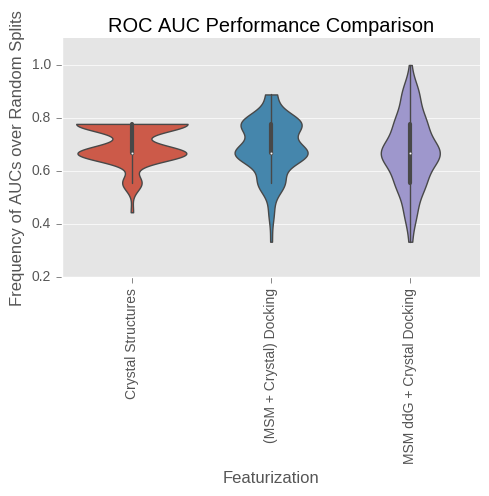

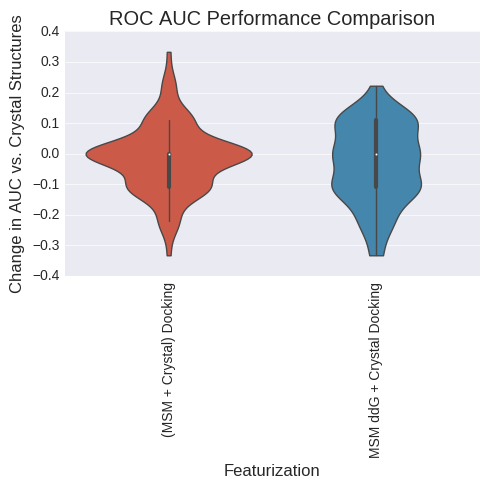

analyzing Recall:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.936667          0.000000   
(MSM + Crystal) Docking      0.850000         -0.086667   
MSM ddG + Crystal Docking    0.710000         -0.226667   

                                             Sign Test 99% CI  
Crystal Structures                                   (0, 0.0)  
(MSM + Crystal) Docking     (0.0397037605337, 0.191317203393)  
MSM ddG + Crystal Docking  (0.0039148772301, 0.0958169829771)  


ValueError: list.remove(x): x not in list

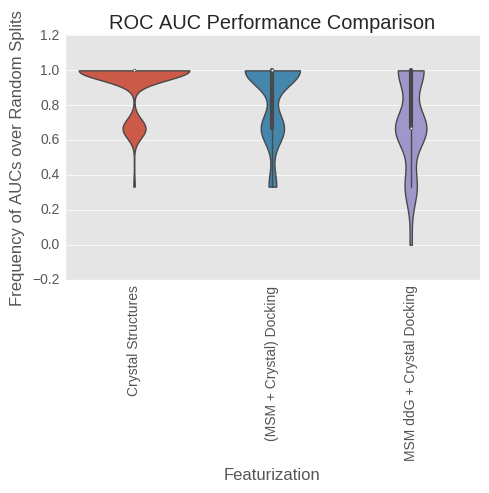

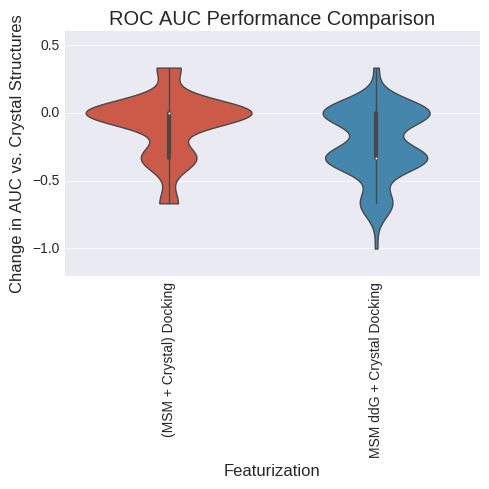

analyzing precision:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.586071          0.000000   
(MSM + Crystal) Docking      0.577238         -0.008833   
MSM ddG + Crystal Docking    0.590083          0.004012   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.172648341273, 0.395973175076)  
MSM ddG + Crystal Docking  (0.222811316676, 0.458343717148)  


ValueError: list.remove(x): x not in list

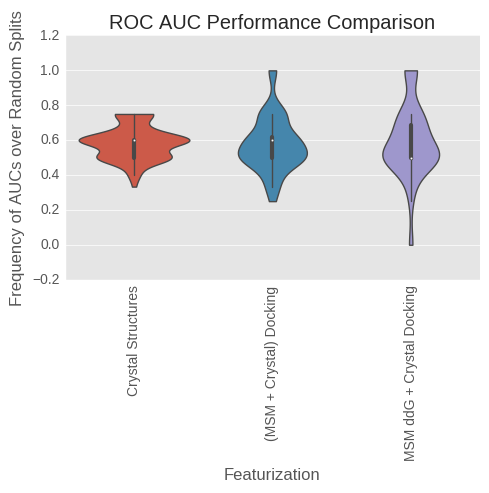

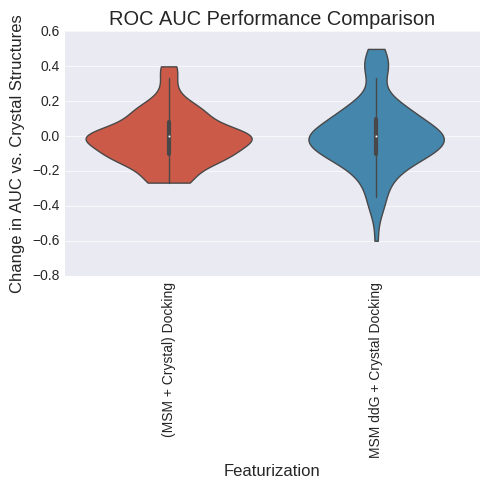

analyzing fdr:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.413929          0.000000   
(MSM + Crystal) Docking      0.422762          0.008833   
MSM ddG + Crystal Docking    0.409917         -0.004012   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.274987204796, 0.518701346501)  
MSM ddG + Crystal Docking   (0.266161320281, 0.50877164477)  


ValueError: list.remove(x): x not in list

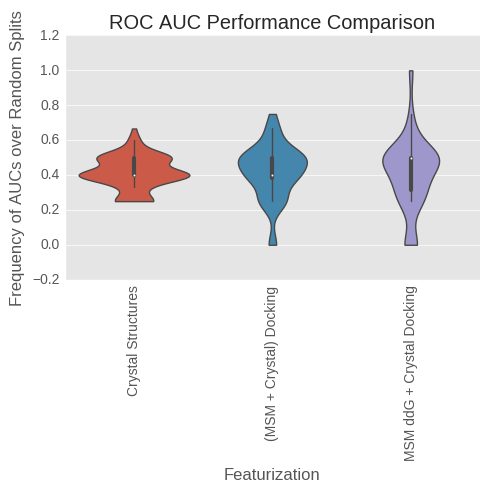

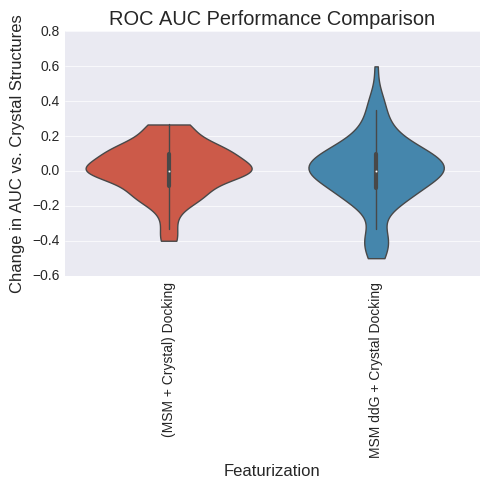

analyzing Recall:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.706667          0.000000   
(MSM + Crystal) Docking      0.691111         -0.015556   
MSM ddG + Crystal Docking    0.671111         -0.035556   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.109549720986, 0.309027105398)  
MSM ddG + Crystal Docking   (0.189127900701, 0.41700478814)  


ValueError: list.remove(x): x not in list

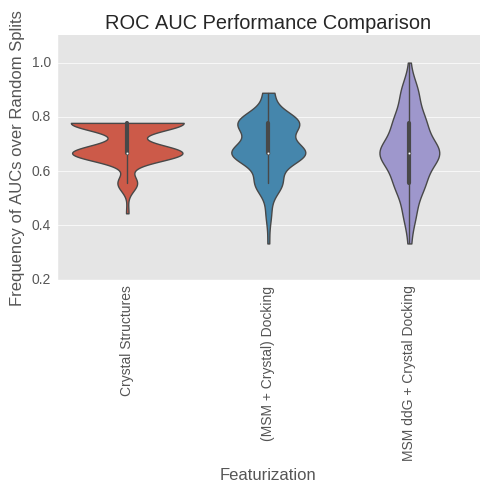

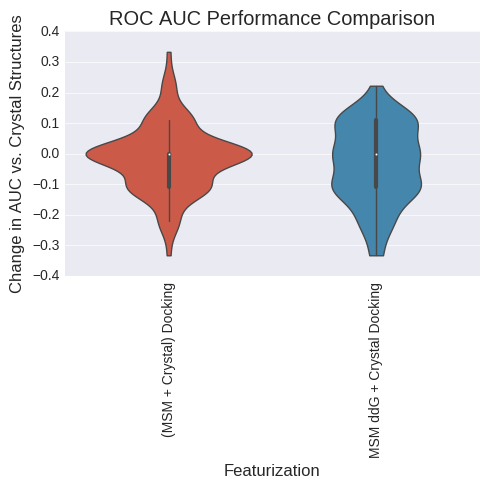

analyzing precision:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.587357          0.000000   
(MSM + Crystal) Docking      0.615228          0.027870   
MSM ddG + Crystal Docking    0.675991          0.088634   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.301763465181, 0.548191844854)  
MSM ddG + Crystal Docking  (0.471419117931, 0.716136744526)  


ValueError: list.remove(x): x not in list

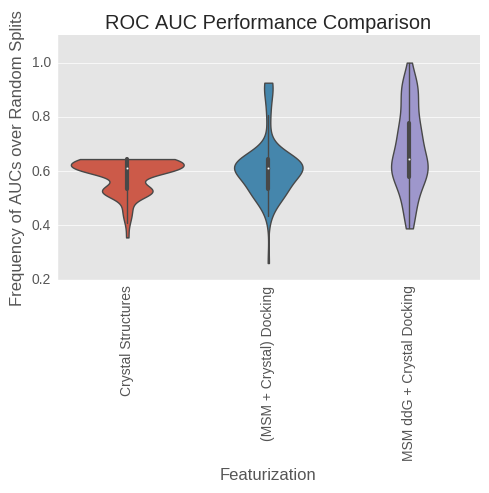

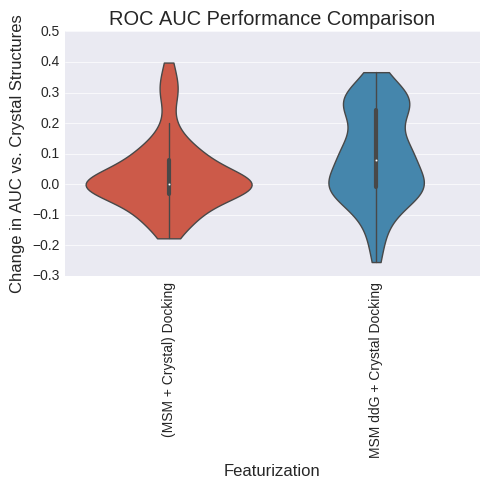

analyzing fdr:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.412643          0.000000   
(MSM + Crystal) Docking      0.384772         -0.027870   
MSM ddG + Crystal Docking    0.324009         -0.088634   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.205853128193, 0.437790733139)  
MSM ddG + Crystal Docking  (0.172648341273, 0.395973175076)  


ValueError: list.remove(x): x not in list

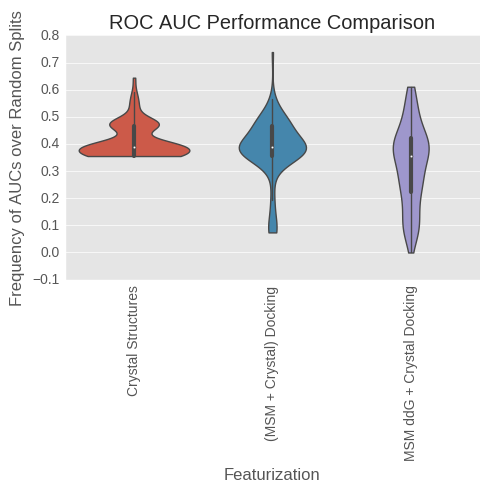

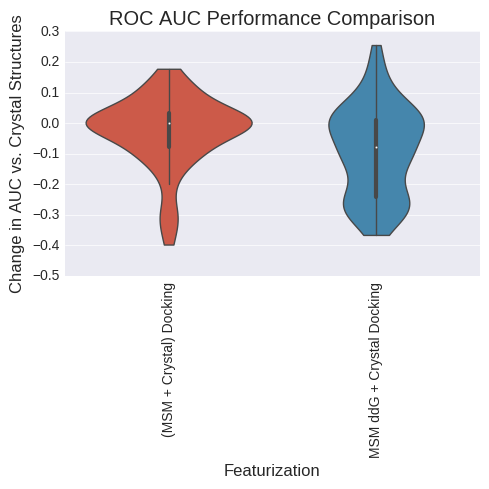

analyzing class B ROC AUC:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.774444          0.000000   
(MSM + Crystal) Docking      0.815278          0.040833   
MSM ddG + Crystal Docking    0.787778          0.013333   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking      (0.44207570268, 0.68921340104)  
MSM ddG + Crystal Docking  (0.403623710738, 0.652643047999)  


ValueError: list.remove(x): x not in list

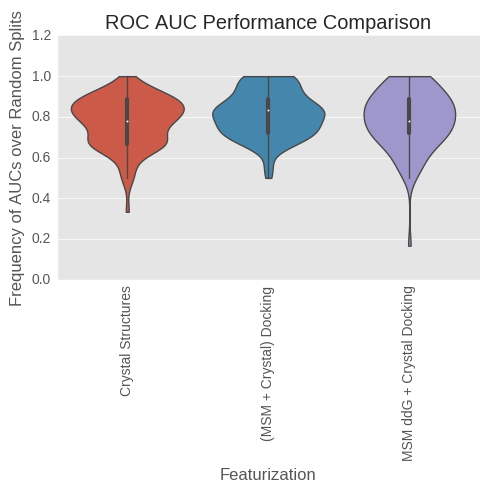

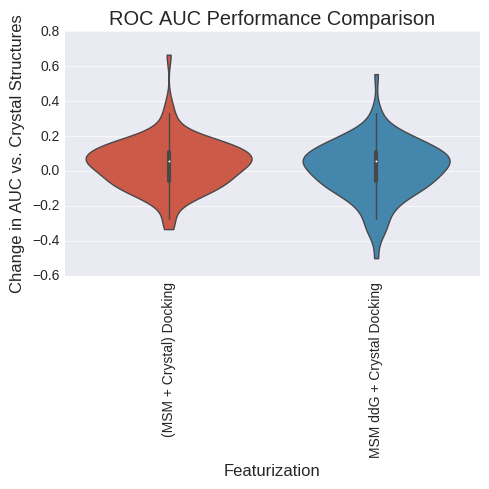

analyzing ROC AUC:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.718291          0.000000   
(MSM + Crystal) Docking      0.816307          0.098016   
MSM ddG + Crystal Docking    0.828759          0.110468   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.614639439838, 0.835494630058)  
MSM ddG + Crystal Docking  (0.679826467385, 0.882841119986)  


ValueError: list.remove(x): x not in list

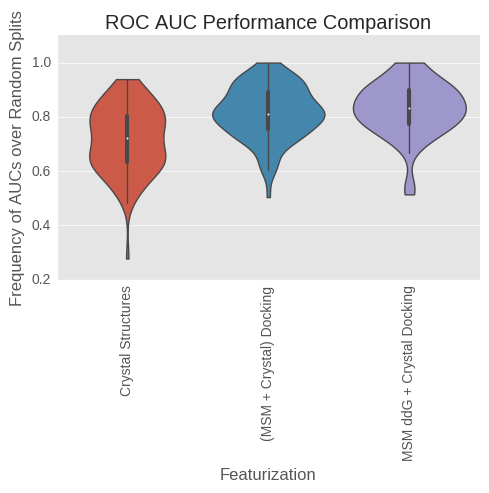

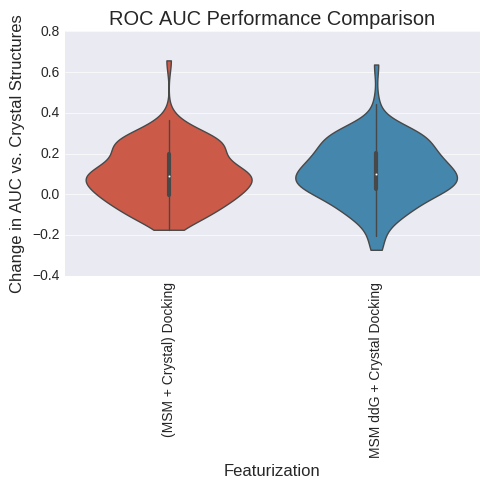

analyzing BedROC
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.892837          0.000000   
(MSM + Crystal) Docking      0.970213          0.077376   
MSM ddG + Crystal Docking    0.912050          0.019213   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.239991939807, 0.478674266508)  
MSM ddG + Crystal Docking  (0.140491025945, 0.353108145421)  


ValueError: list.remove(x): x not in list

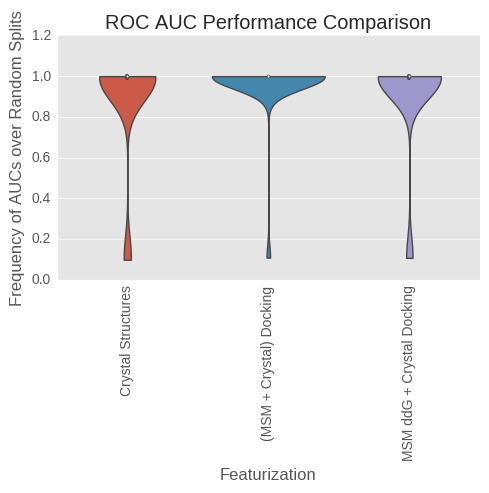

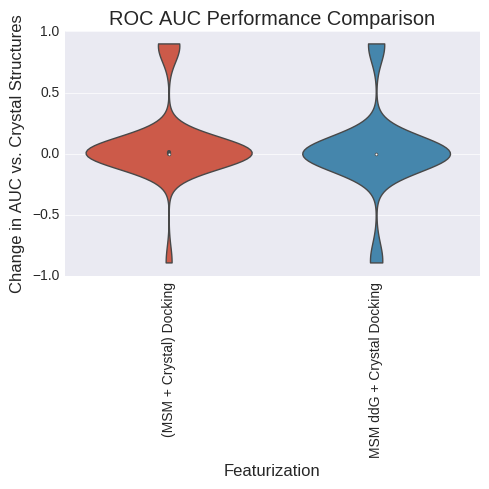

analyzing LogAUC
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures                0.0               0.0   
(MSM + Crystal) Docking           0.0               0.0   
MSM ddG + Crystal Docking         0.0               0.0   

                                 Sign Test 99% CI  
Crystal Structures                       (0, 0.0)  
(MSM + Crystal) Docking    (0.0, 0.0622206877158)  
MSM ddG + Crystal Docking  (0.0, 0.0622206877158)  


ValueError: list.remove(x): x not in list

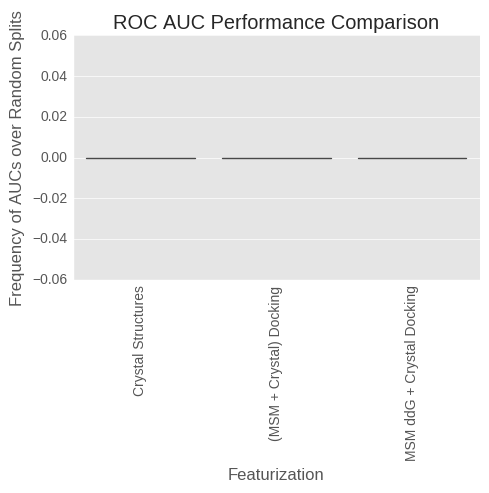

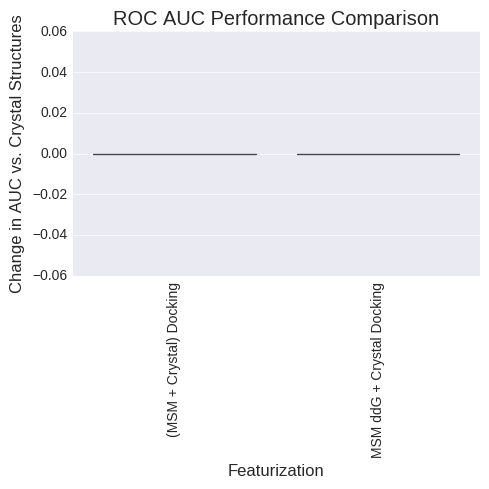

(3, 3)
(3, 3)


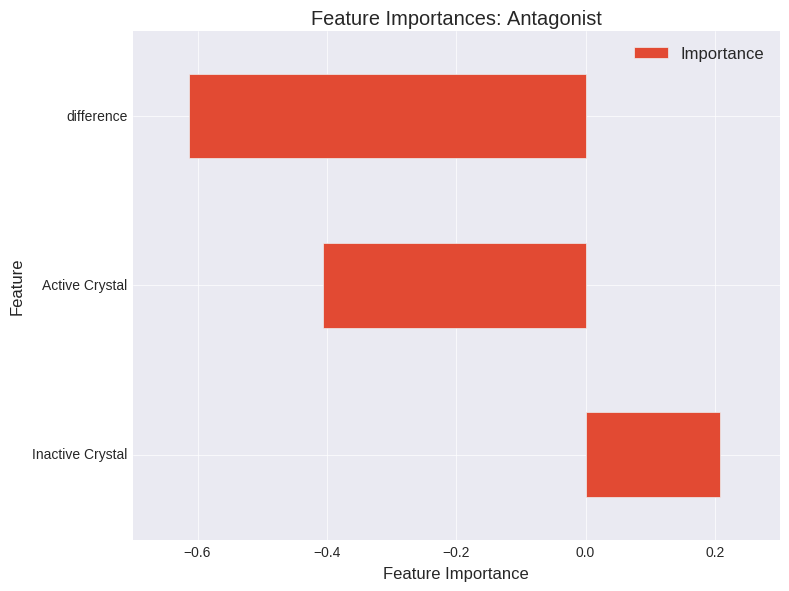

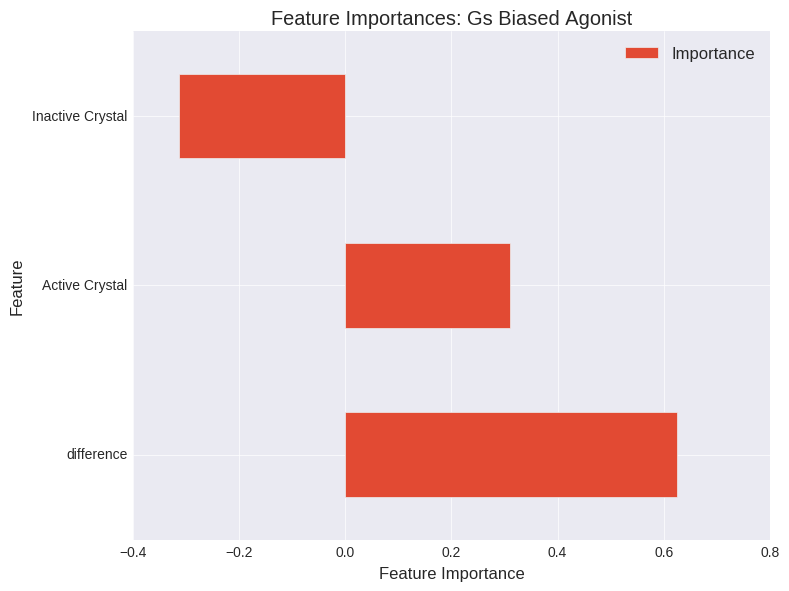

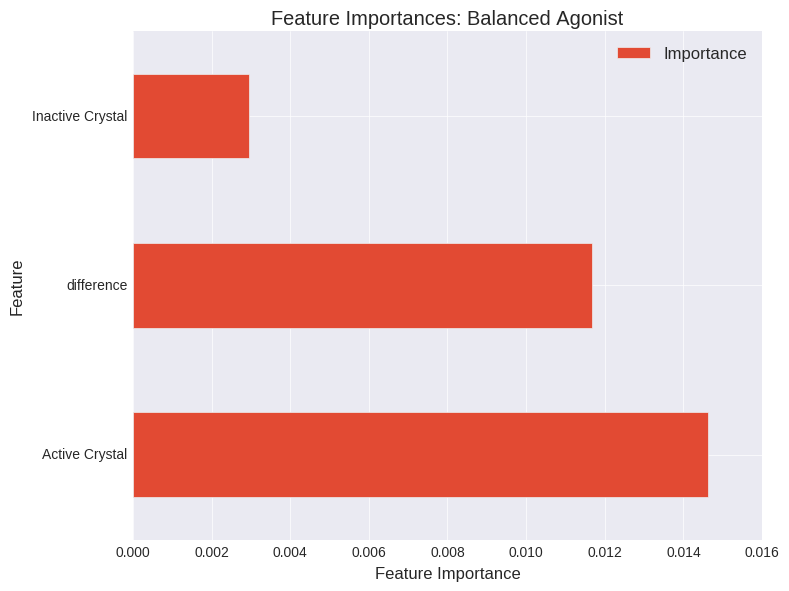

(3, 55)
(3, 55)


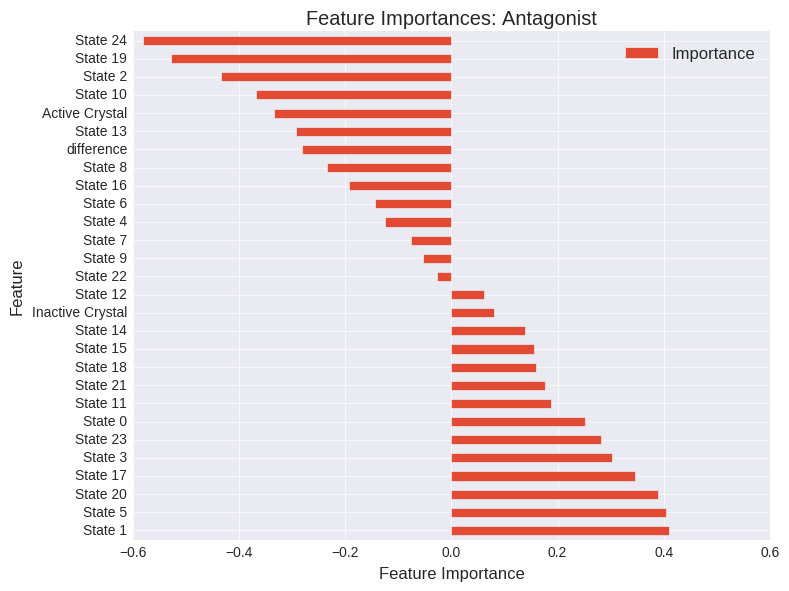

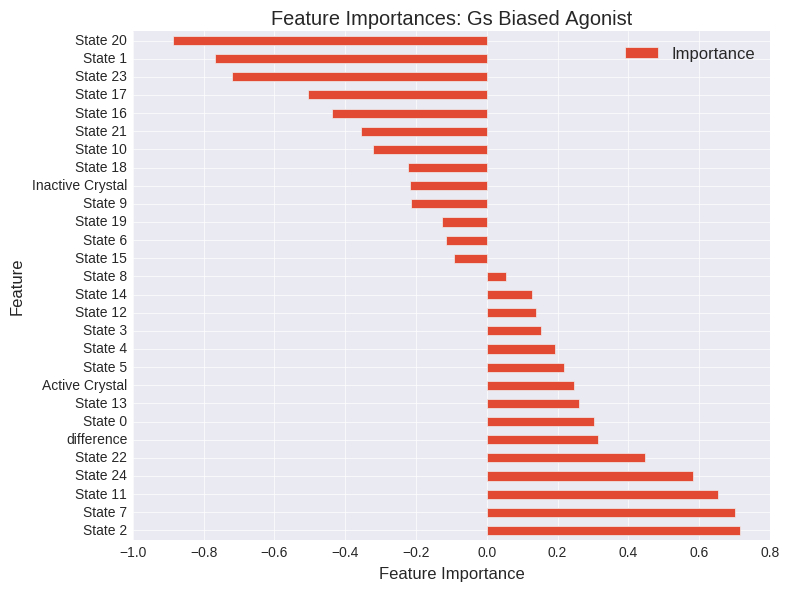

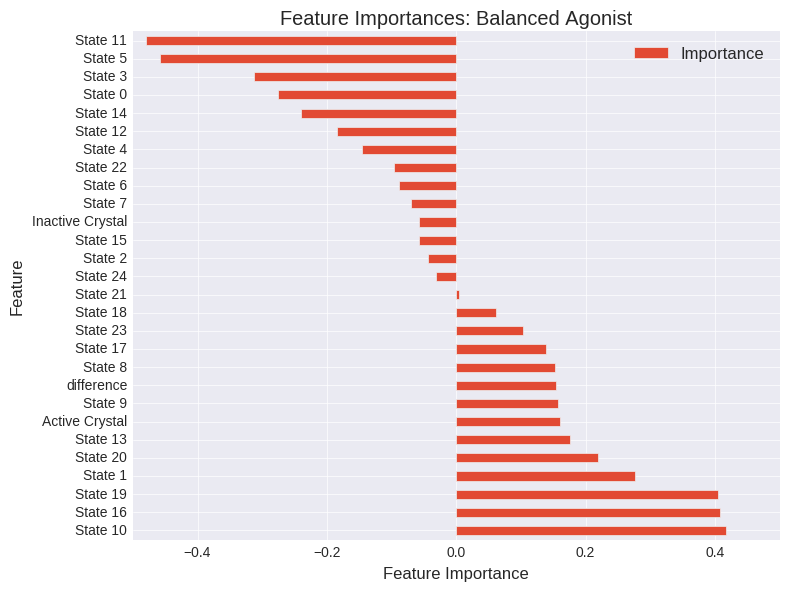

(3, 103)
(3, 103)


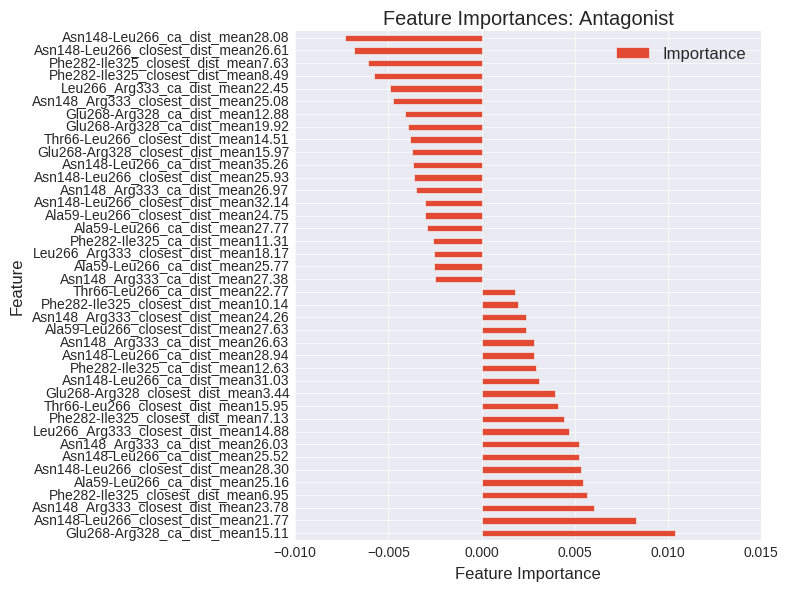

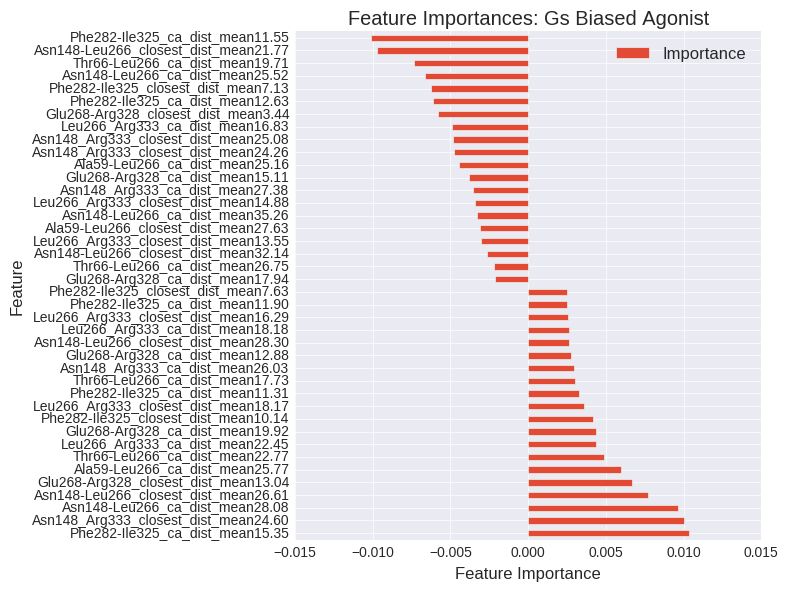

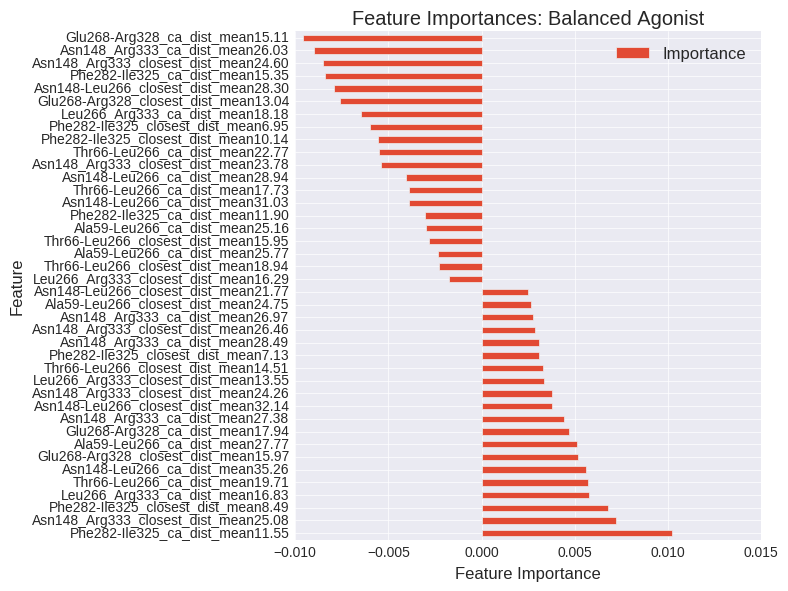

In [976]:
import efficacy_scripts
reload(efficacy_scripts)
from efficacy_scripts import *

#SP, All ligands, Four class, 32 stereoisomers; new crystal grids; 25 clusters

importance_dfs = analyze_multiclass_experiment(results_dict[save_name], 
                                                                feature_names,
                                                                [f.columns.values.tolist() for f in features], model_agonists, analysis_dir,
                                                                ["Antagonist", "Gs Biased Agonist", "Balanced Agonist"], 
     
                                               #["Gs Inactive", "Gs Active"], 
                                                               #["Arr Inactive", "Arr Active"],
                                               np.hstack([X_df.loc[model_agonists].values]),
                                                               #["Gs Inactive", "Gs Partial Active", "Gs Full Active"], 
                                              remake=False, fxn=np.mean)


#TRY LOOCV
#crystal structures might just have bigger boxes




analyzing precision at full recall:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.631071          0.000000   
(MSM + Crystal) Docking      0.684286          0.053214   
MSM ddG + Crystal Docking    0.607548         -0.023524   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.257386290078, 0.498791088728)  
MSM ddG + Crystal Docking   (0.148424137442, 0.36393062017)  


ValueError: list.remove(x): x not in list

analyzing threshold at full recall:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.482726          0.000000   
(MSM + Crystal) Docking      0.452256         -0.030470   
MSM ddG + Crystal Docking    0.399687         -0.083039   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.347356952001, 0.596376289262)  
MSM ddG + Crystal Docking  (0.283863255474, 0.528580882069)  


ValueError: list.remove(x): x not in list

analyzing Accuracy:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.700000          0.000000   
(MSM + Crystal) Docking      0.684444         -0.015556   
MSM ddG + Crystal Docking    0.655556         -0.044444   

                                            Sign Test 99% CI  
Crystal Structures                                  (0, 0.0)  
(MSM + Crystal) Docking    (0.0800854422871, 0.263469039114)  
MSM ddG + Crystal Docking  (0.0729952751204, 0.251803620035)  


ValueError: list.remove(x): x not in list

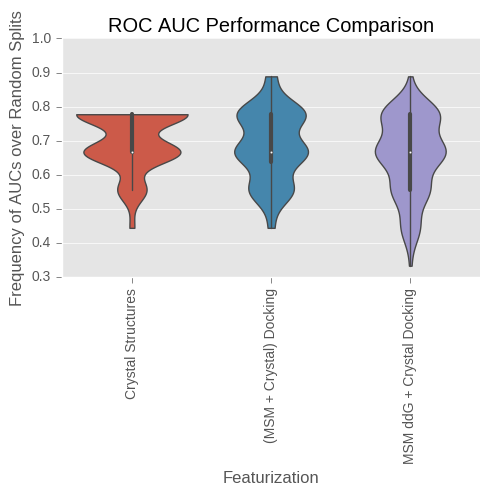

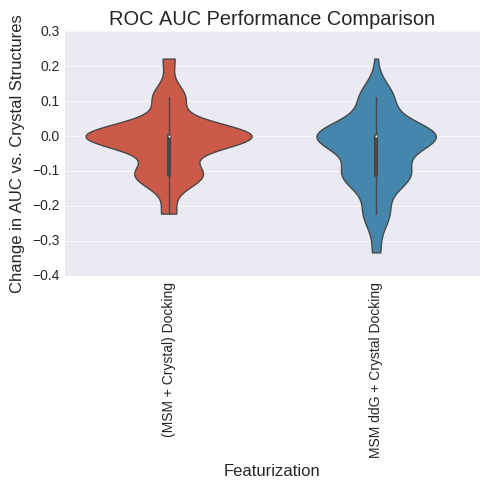

analyzing Recall:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.936667          0.000000   
(MSM + Crystal) Docking      0.830000         -0.106667   
MSM ddG + Crystal Docking    0.793333         -0.143333   

                                             Sign Test 99% CI  
Crystal Structures                                   (0, 0.0)  
(MSM + Crystal) Docking    (0.00761216930178, 0.110875277151)  
MSM ddG + Crystal Docking    (0.0221179842002, 0.15263622099)  


ValueError: list.remove(x): x not in list

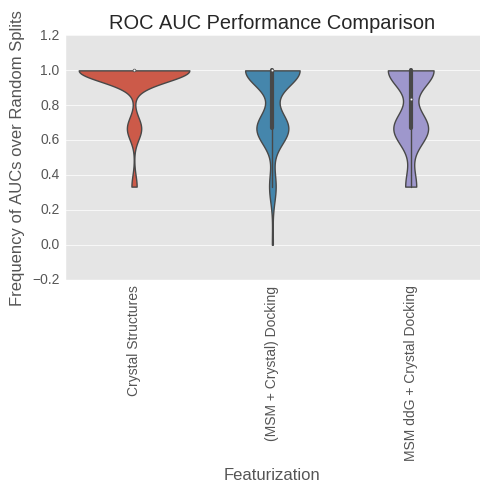

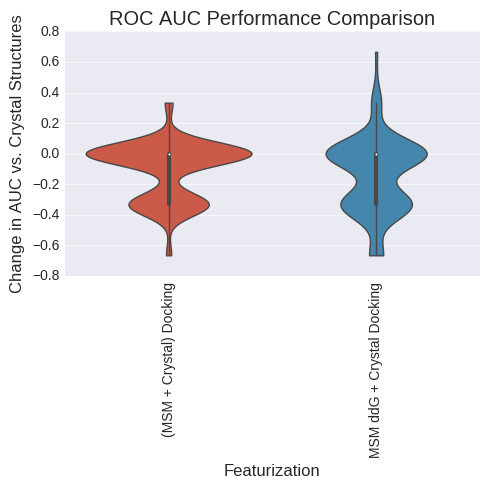

analyzing precision:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.591786          0.000000   
(MSM + Crystal) Docking      0.585952         -0.005833   
MSM ddG + Crystal Docking    0.552238         -0.039548   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.140491025945, 0.353108145421)  
MSM ddG + Crystal Docking  (0.109549720986, 0.309027105398)  


ValueError: list.remove(x): x not in list

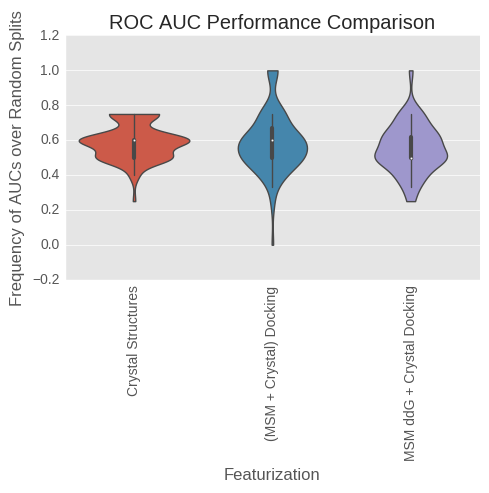

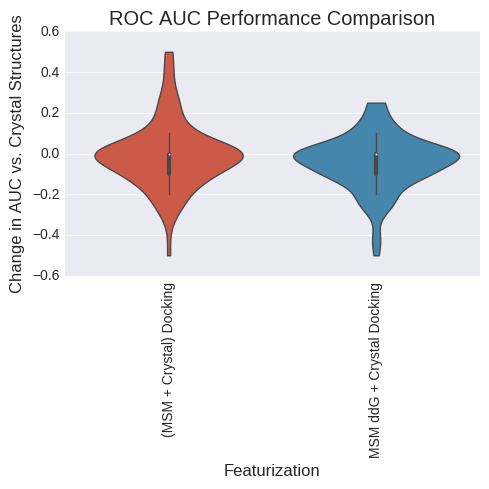

analyzing fdr:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.408214          0.000000   
(MSM + Crystal) Docking      0.414048          0.005833   
MSM ddG + Crystal Docking    0.447762          0.039548   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.231374407182, 0.468536212887)  
MSM ddG + Crystal Docking  (0.301763465181, 0.548191844854)  


ValueError: list.remove(x): x not in list

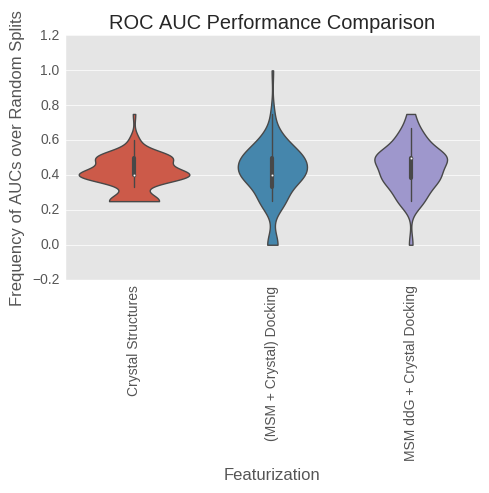

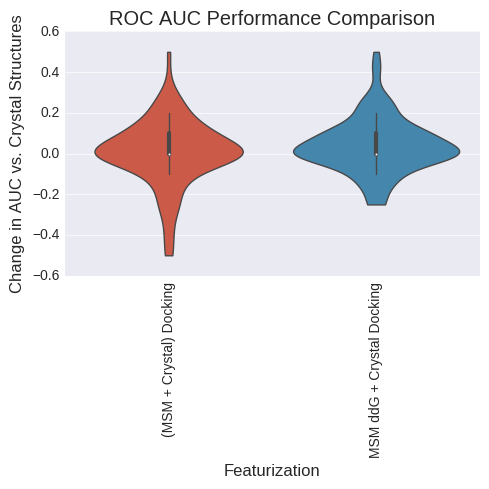

analyzing Recall:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.700000          0.000000   
(MSM + Crystal) Docking      0.684444         -0.015556   
MSM ddG + Crystal Docking    0.655556         -0.044444   

                                            Sign Test 99% CI  
Crystal Structures                                  (0, 0.0)  
(MSM + Crystal) Docking    (0.0800854422871, 0.263469039114)  
MSM ddG + Crystal Docking  (0.0729952751204, 0.251803620035)  


ValueError: list.remove(x): x not in list

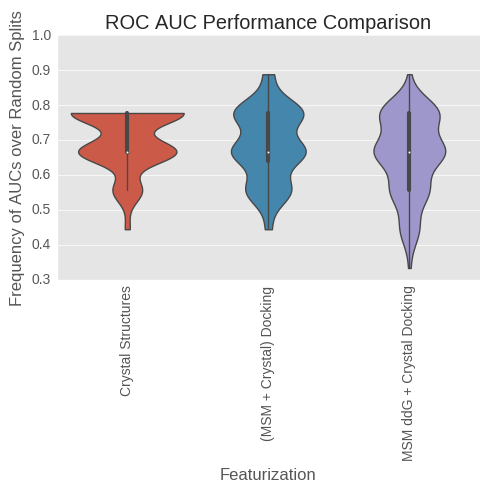

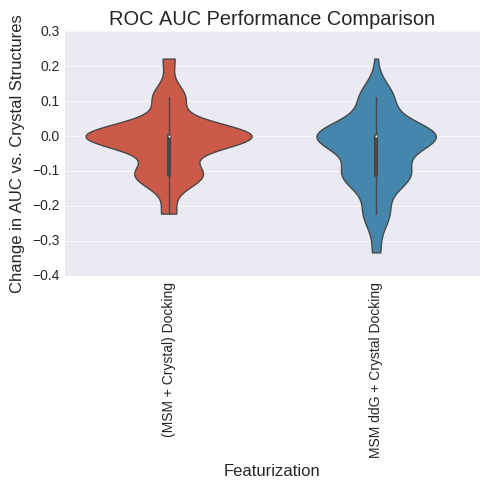

analyzing precision:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.576511          0.000000   
(MSM + Crystal) Docking      0.603042          0.026532   
MSM ddG + Crystal Docking    0.599915          0.023405   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.231374407182, 0.468536212887)  
MSM ddG + Crystal Docking  (0.292788857454, 0.538410866335)  


ValueError: list.remove(x): x not in list

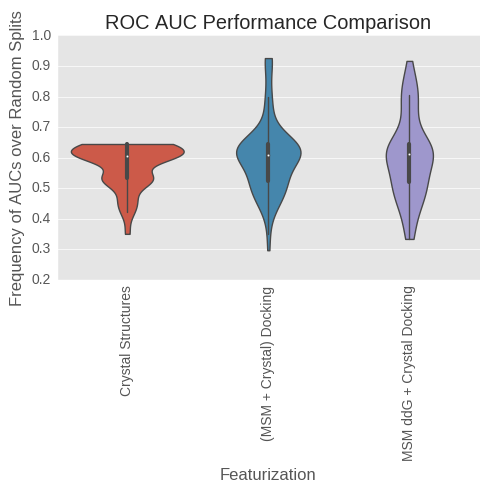

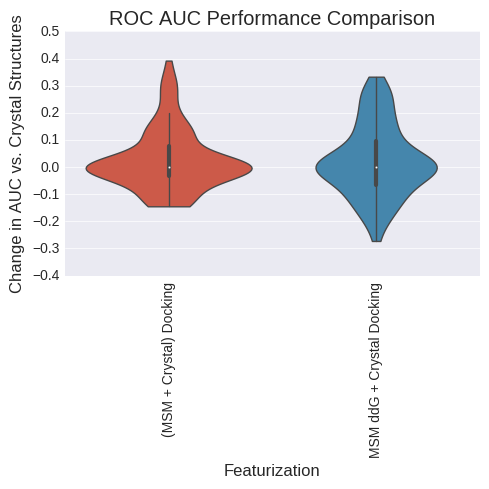

analyzing fdr:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.423489          0.000000   
(MSM + Crystal) Docking      0.396958         -0.026532   
MSM ddG + Crystal Docking    0.400085         -0.023405   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.205853128193, 0.437790733139)  
MSM ddG + Crystal Docking  (0.214303806581, 0.448095640997)  


ValueError: list.remove(x): x not in list

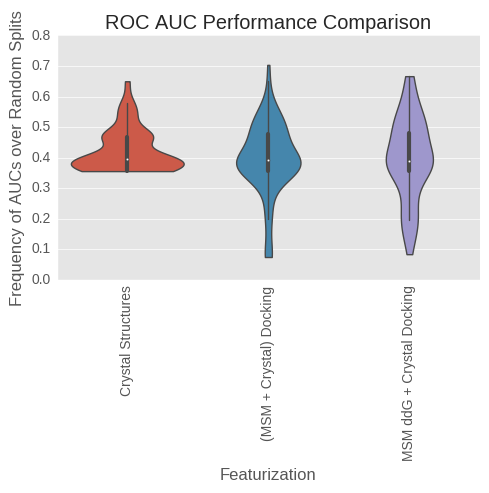

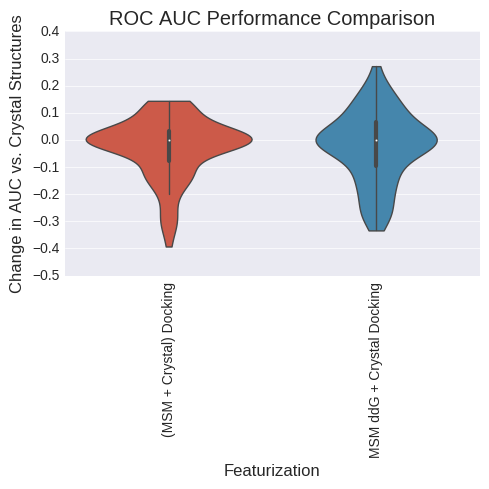

analyzing class B ROC AUC:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.778889          0.000000   
(MSM + Crystal) Docking      0.837222          0.058333   
MSM ddG + Crystal Docking    0.806944          0.028056   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.403623710738, 0.652643047999)  
MSM ddG + Crystal Docking  (0.375279625045, 0.624720374955)  


ValueError: list.remove(x): x not in list

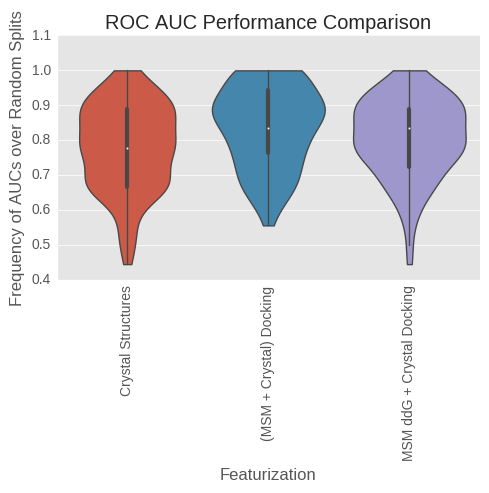

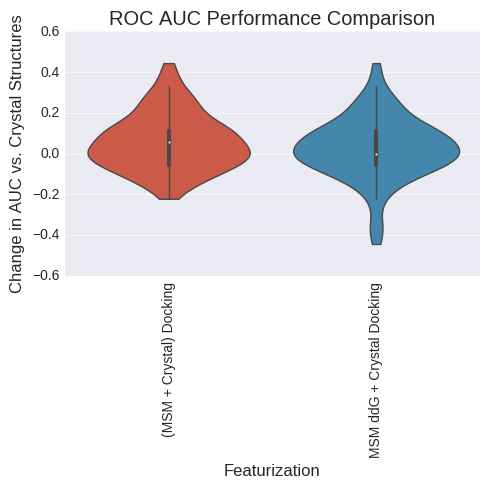

analyzing ROC AUC:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.733772          0.000000   
(MSM + Crystal) Docking      0.826812          0.093040   
MSM ddG + Crystal Docking    0.825291          0.091519   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.679826467385, 0.882841119986)  
MSM ddG + Crystal Docking  (0.614639439838, 0.835494630058)  


ValueError: list.remove(x): x not in list

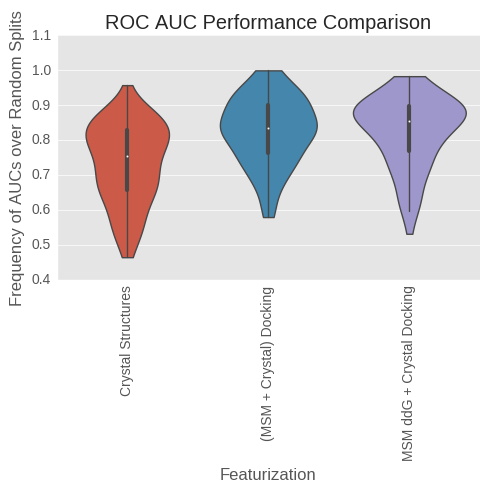

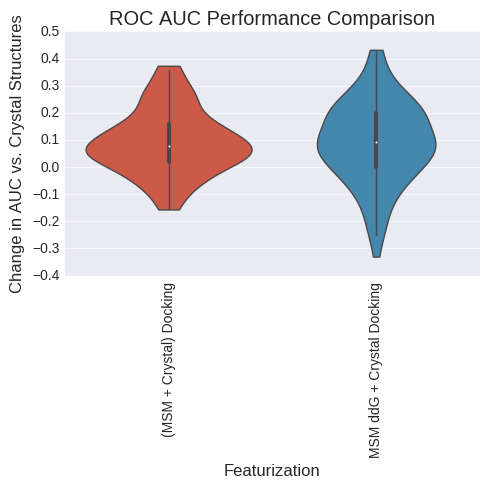

analyzing BedROC
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.903909          0.000000   
(MSM + Crystal) Docking      0.995750          0.091841   
MSM ddG + Crystal Docking    0.863433         -0.040476   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.274987204796, 0.518701346501)  
MSM ddG + Crystal Docking   (0.148424137442, 0.36393062017)  


ValueError: list.remove(x): x not in list

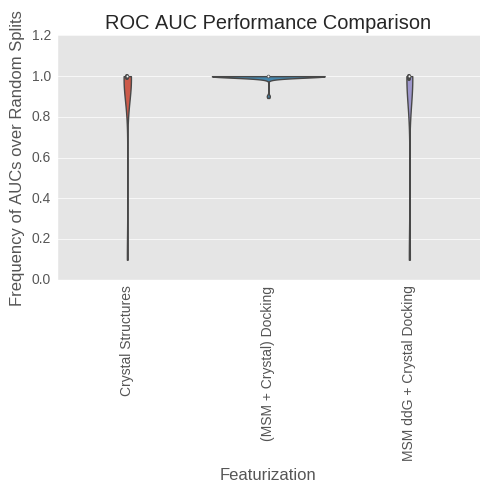

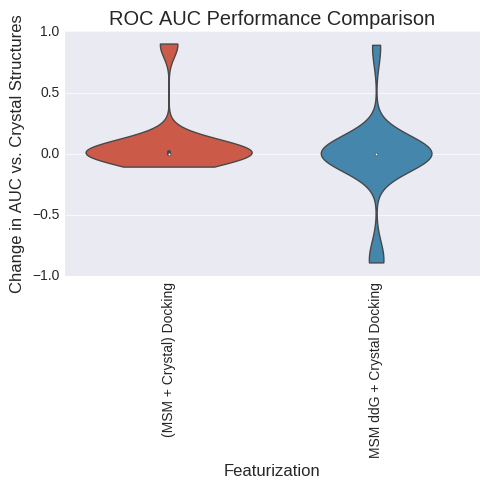

analyzing LogAUC
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures                0.0               0.0   
(MSM + Crystal) Docking           0.0               0.0   
MSM ddG + Crystal Docking         0.0               0.0   

                                 Sign Test 99% CI  
Crystal Structures                       (0, 0.0)  
(MSM + Crystal) Docking    (0.0, 0.0622206877158)  
MSM ddG + Crystal Docking  (0.0, 0.0622206877158)  


ValueError: list.remove(x): x not in list

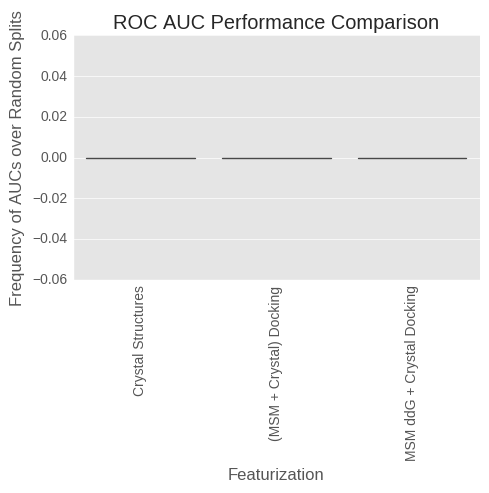

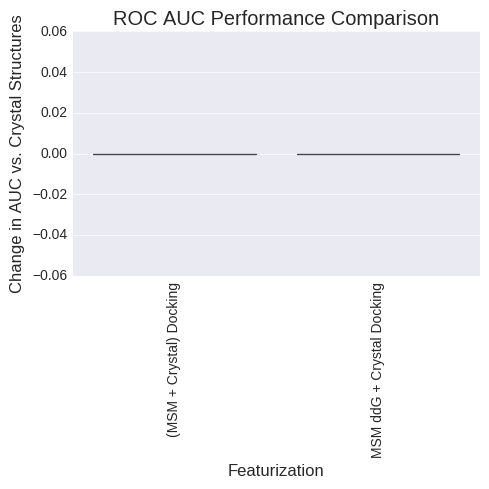

(3, 3)
(3, 3)


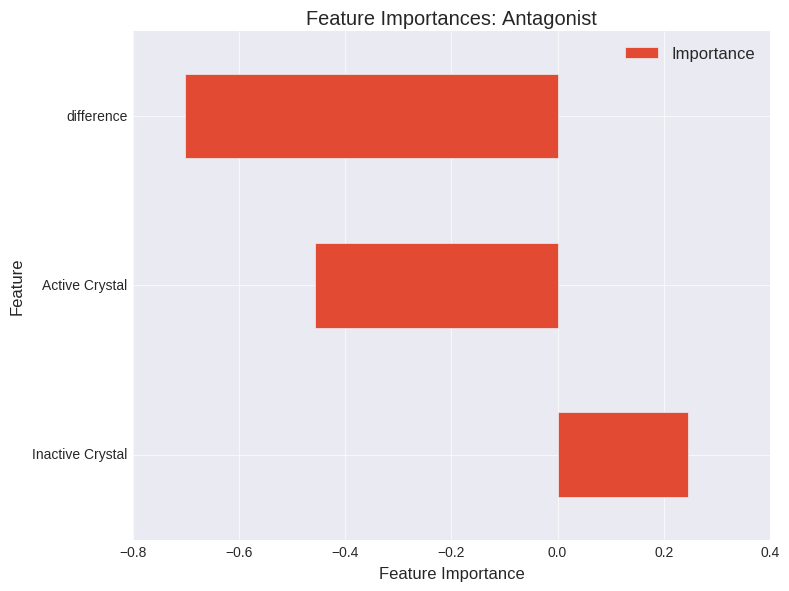

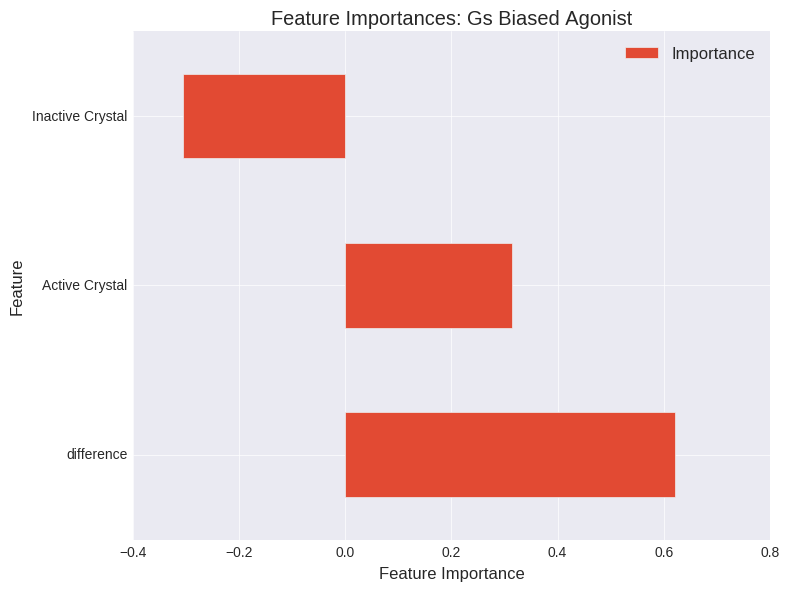

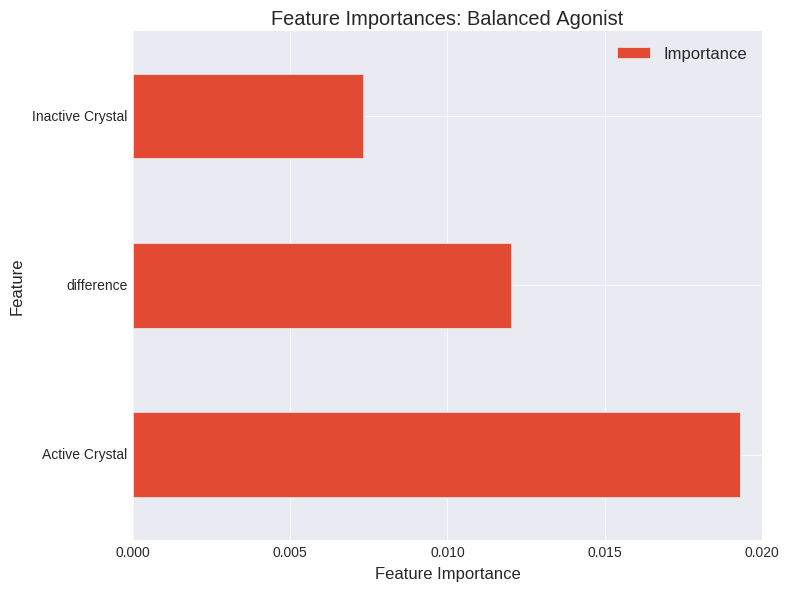

(3, 55)
(3, 55)


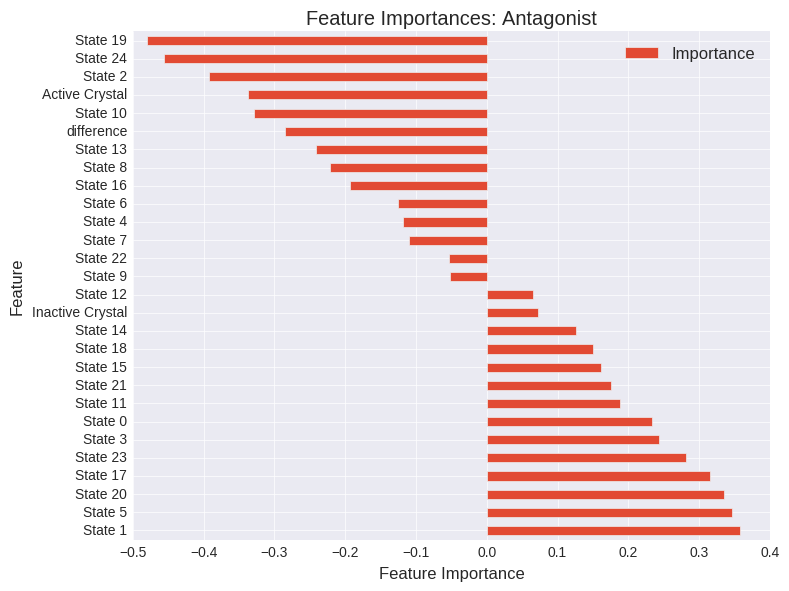

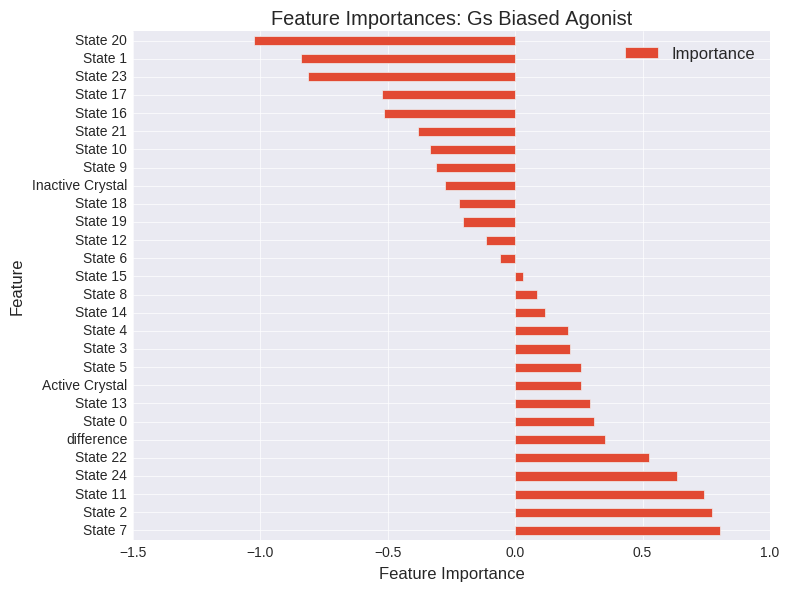

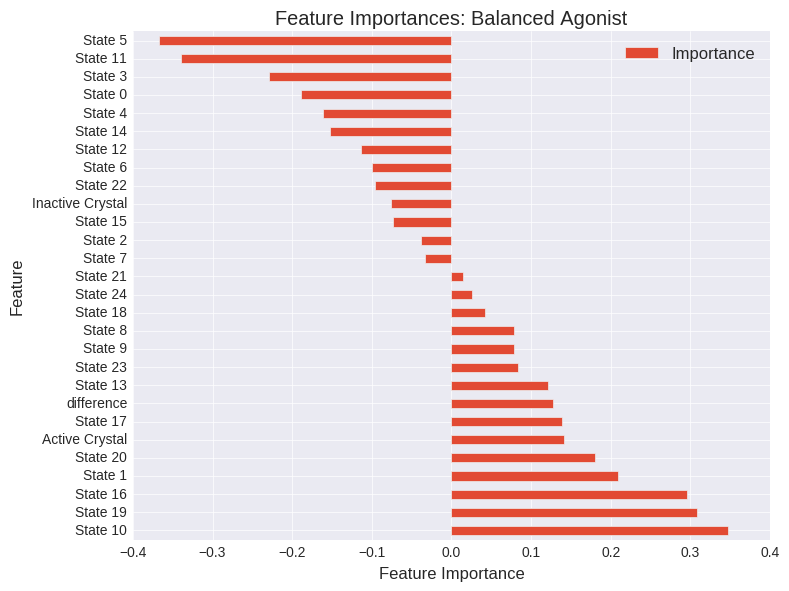

(3, 25)
(3, 25)


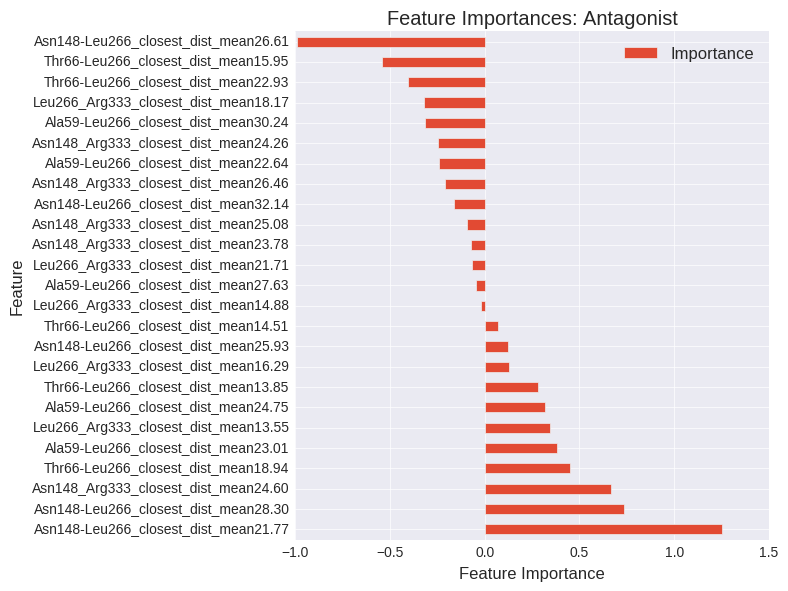

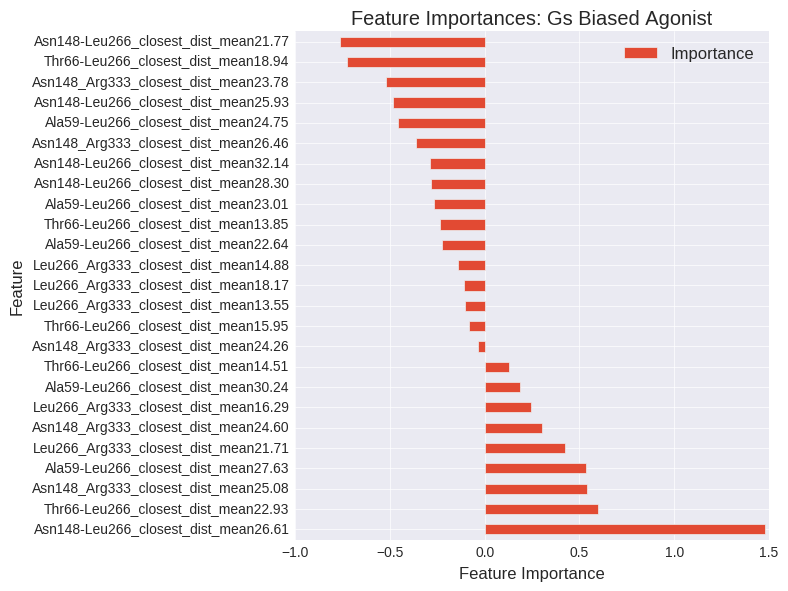

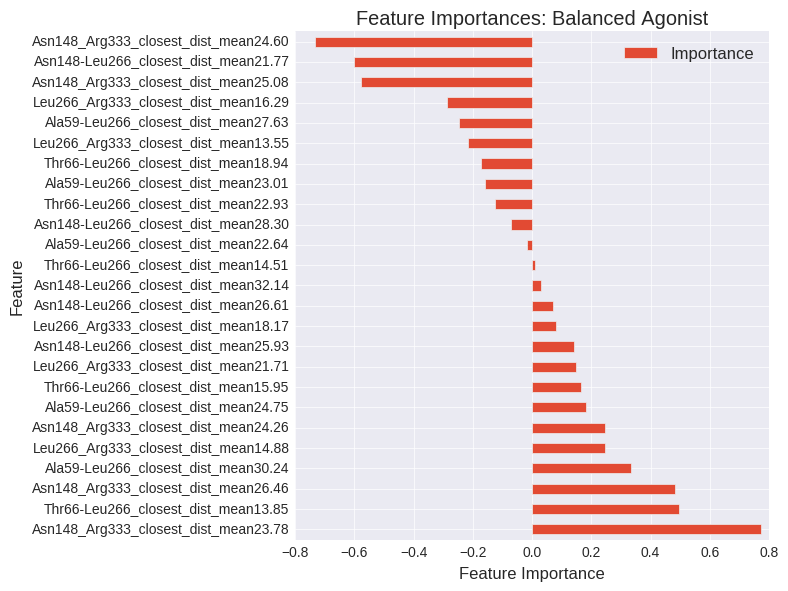

In [868]:
import efficacy_scripts
reload(efficacy_scripts)
from efficacy_scripts import *

#SP, All ligands, Four class, 32 stereoisomers; new crystal grids; 25 clusters

importance_dfs = analyze_multiclass_experiment(results_dict[save_name], 
                                                                feature_names,
                                                                [f.columns.values.tolist() for f in features], model_agonists, analysis_dir,
                                                                ["Antagonist", "Gs Biased Agonist", "Balanced Agonist"], 
     
                                               #["Gs Inactive", "Gs Active"], 
                                                               #["Arr Inactive", "Arr Active"],
                                               np.hstack([X_df.loc[model_agonists].values]),
                                                               #["Gs Inactive", "Gs Partial Active", "Gs Full Active"], 
                                              remake=False, fxn=np.mean)


#TRY LOOCV
#crystal structures might just have bigger boxes

(array([  1.00000000e+00,   0.00000000e+00,   0.00000000e+00,
          0.00000000e+00,   0.00000000e+00,   0.00000000e+00,
          0.00000000e+00,   0.00000000e+00,   0.00000000e+00,
          0.00000000e+00,   2.00000000e+00,   1.00000000e+00,
          0.00000000e+00,   0.00000000e+00,   1.00000000e+00,
          1.00000000e+00,   0.00000000e+00,   1.00000000e+00,
          2.00000000e+00,   1.00000000e+00,   0.00000000e+00,
          3.00000000e+00,   7.00000000e+00,   9.00000000e+00,
          7.00000000e+00,   3.00000000e+00,   1.30000000e+01,
          1.70000000e+01,   1.60000000e+01,   3.50000000e+01,
          4.20000000e+01,   6.60000000e+01,   7.40000000e+01,
          1.22000000e+02,   1.53000000e+02,   2.29000000e+02,
          2.58000000e+02,   3.38000000e+02,   4.99000000e+02,
          5.52000000e+02,   7.11000000e+02,   7.70000000e+02,
          9.82000000e+02,   1.00600000e+03,   1.07500000e+03,
          1.18200000e+03,   1.26900000e+03,   1.18200000e+03,
        

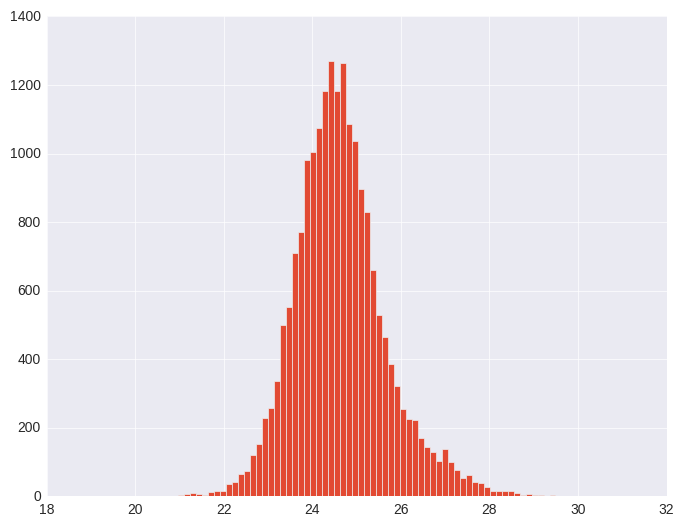

In [955]:
#plt.hist(pd.concat(all_feature_dfs)["Ala59-Leu266_closest_dist"].values, bins=100)
plt.hist(lig_features_eq["msm"]["Asn148_Arg333_closest_dist"].values, bins=100)


analyzing precision at full recall:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.631714          0.000000   
(MSM + Crystal) Docking      0.652679          0.020964   
MSM ddG + Crystal Docking    0.551762         -0.079952   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.231374407182, 0.468536212887)  
MSM ddG + Crystal Docking  (0.140491025945, 0.353108145421)  


ValueError: list.remove(x): x not in list

analyzing threshold at full recall:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.466968          0.000000   
(MSM + Crystal) Docking      0.463717         -0.003252   
MSM ddG + Crystal Docking    0.346604         -0.120365   

                                          Sign Test 99% CI  
Crystal Structures                                (0, 0.0)  
(MSM + Crystal) Docking    (0.43239135947, 0.680142158004)  
MSM ddG + Crystal Docking  (0.19746065621, 0.427427618876)  


ValueError: list.remove(x): x not in list

analyzing Accuracy:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.686667          0.000000   
(MSM + Crystal) Docking      0.667778         -0.018889   
MSM ddG + Crystal Docking    0.644444         -0.042222   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.109549720986, 0.309027105398)  
MSM ddG + Crystal Docking    (0.124854862375, 0.3312331365)  


ValueError: list.remove(x): x not in list

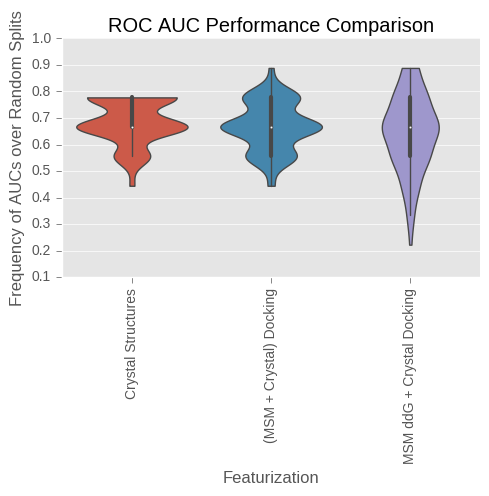

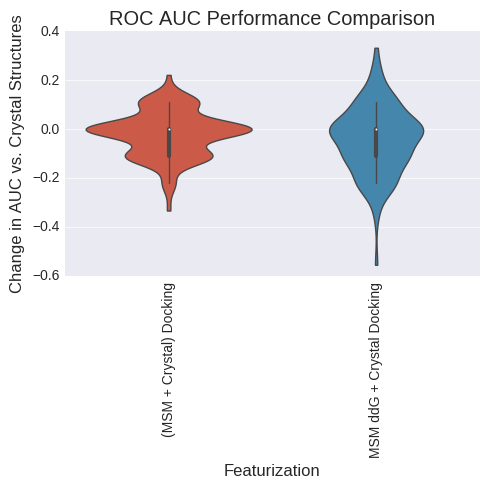

analyzing Recall:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.900000          0.000000   
(MSM + Crystal) Docking      0.866667         -0.033333   
MSM ddG + Crystal Docking    0.703333         -0.196667   

                                            Sign Test 99% CI  
Crystal Structures                                  (0, 0.0)  
(MSM + Crystal) Docking    (0.0800854422871, 0.263469039114)  
MSM ddG + Crystal Docking   (0.046025811701, 0.203750738472)  


ValueError: list.remove(x): x not in list

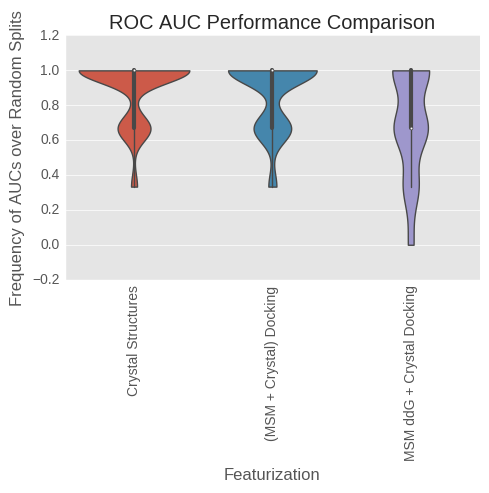

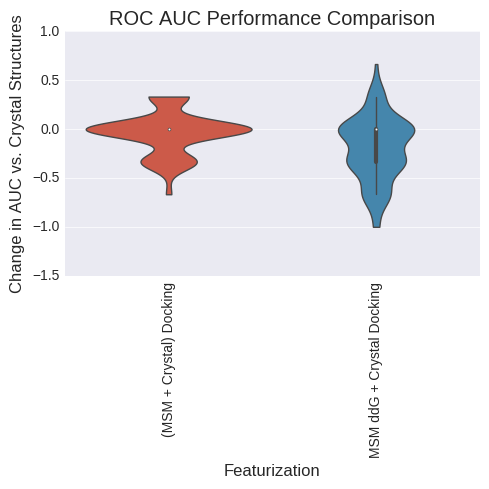

analyzing precision:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.568905          0.000000   
(MSM + Crystal) Docking      0.574310          0.005405   
MSM ddG + Crystal Docking    0.506119         -0.062786   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.205853128193, 0.437790733139)  
MSM ddG + Crystal Docking  (0.156429820518, 0.374680523339)  


ValueError: list.remove(x): x not in list

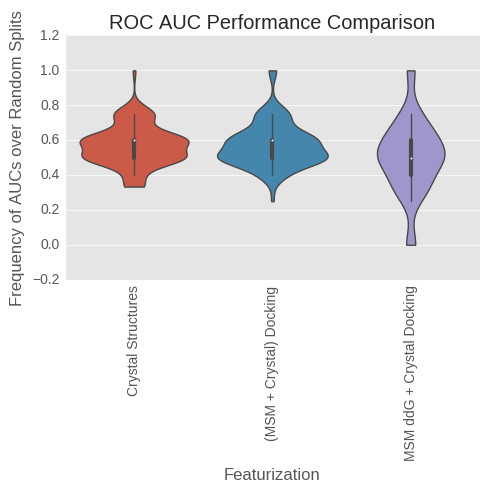

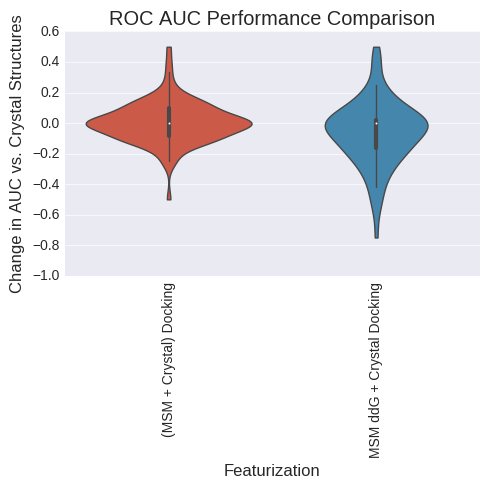

analyzing fdr:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.431095          0.000000   
(MSM + Crystal) Docking      0.425690         -0.005405   
MSM ddG + Crystal Docking    0.493881          0.062786   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.205853128193, 0.437790733139)  
MSM ddG + Crystal Docking  (0.347356952001, 0.596376289262)  


ValueError: list.remove(x): x not in list

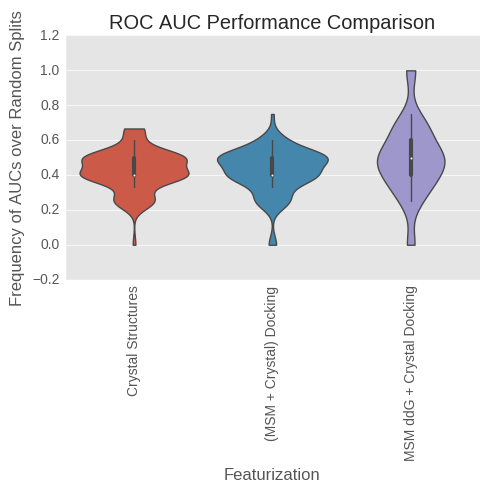

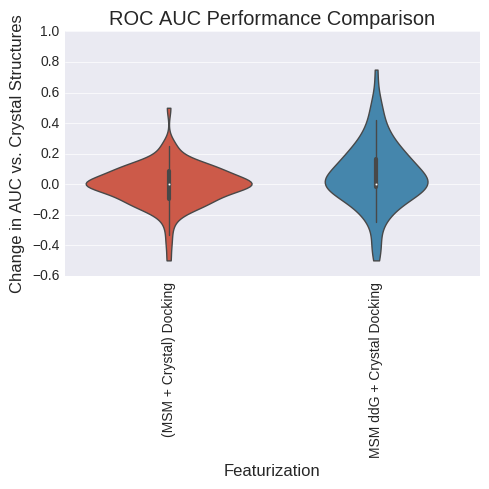

analyzing Recall:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.686667          0.000000   
(MSM + Crystal) Docking      0.667778         -0.018889   
MSM ddG + Crystal Docking    0.644444         -0.042222   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.109549720986, 0.309027105398)  
MSM ddG + Crystal Docking    (0.124854862375, 0.3312331365)  


ValueError: list.remove(x): x not in list

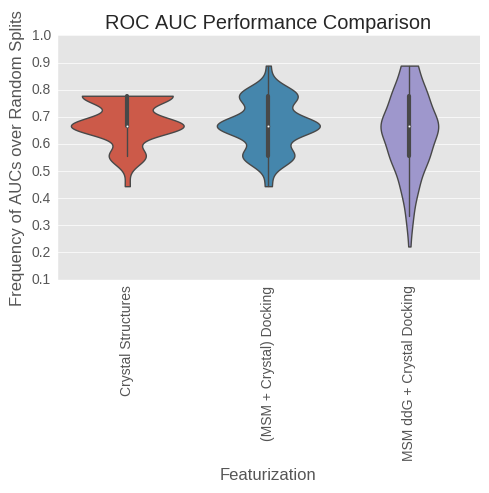

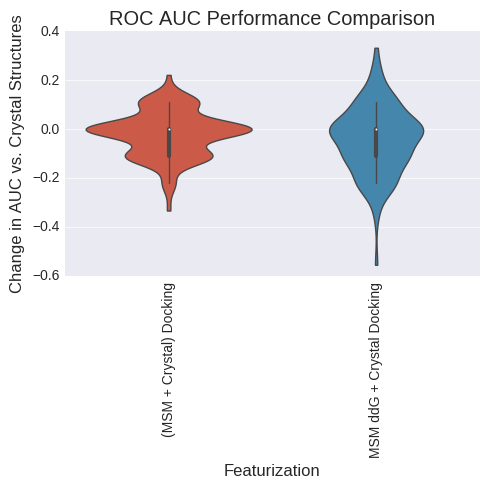

analyzing precision:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.570693          0.000000   
(MSM + Crystal) Docking      0.595288          0.024595   
MSM ddG + Crystal Docking    0.622172          0.051479   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.274987204796, 0.518701346501)  
MSM ddG + Crystal Docking  (0.384680812399, 0.634074773846)  


ValueError: list.remove(x): x not in list

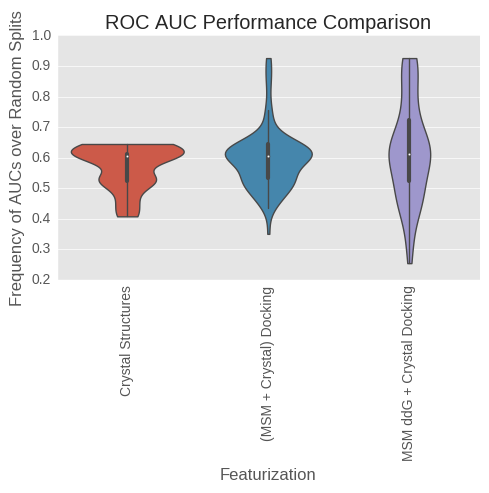

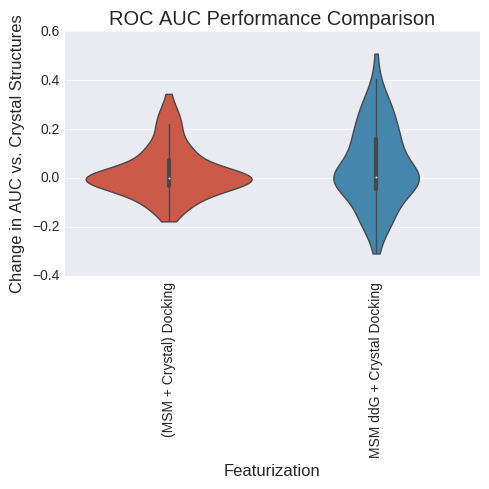

analyzing fdr:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.429307          0.000000   
(MSM + Crystal) Docking      0.404712         -0.024595   
MSM ddG + Crystal Docking    0.377828         -0.051479   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.214303806581, 0.448095640997)  
MSM ddG + Crystal Docking  (0.231374407182, 0.468536212887)  


ValueError: list.remove(x): x not in list

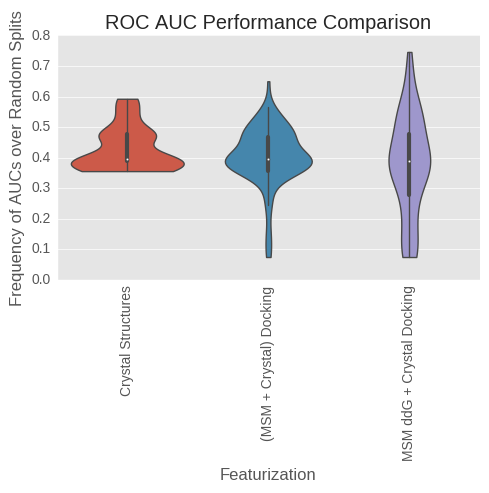

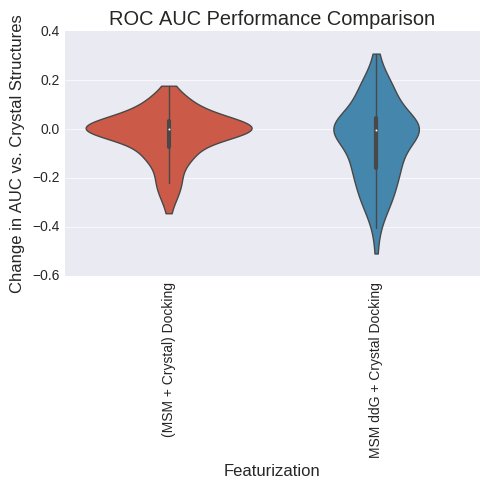

analyzing class B ROC AUC:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.768889          0.000000   
(MSM + Crystal) Docking      0.825000          0.056111   
MSM ddG + Crystal Docking    0.754722         -0.014167   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.451808155146, 0.698236534819)  
MSM ddG + Crystal Docking    (0.31078659896, 0.55792429732)  


ValueError: list.remove(x): x not in list

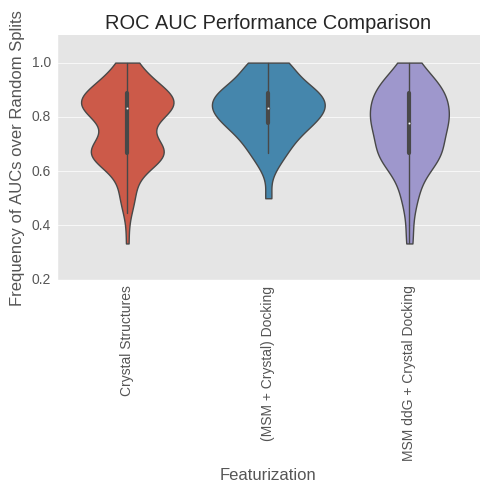

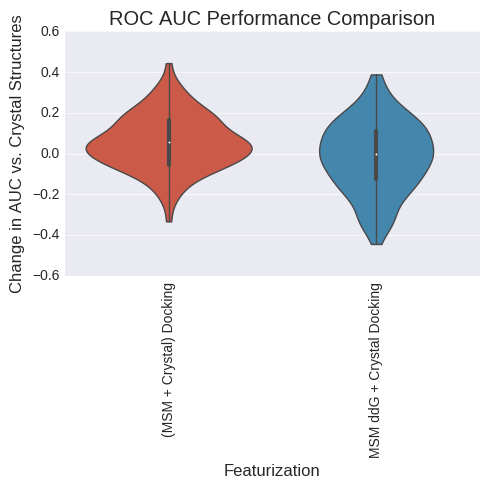

analyzing ROC AUC:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.724463          0.000000   
(MSM + Crystal) Docking      0.810000          0.085537   
MSM ddG + Crystal Docking    0.833836          0.109373   

                                          Sign Test 99% CI  
Crystal Structures                                (0, 0.0)  
(MSM + Crystal) Docking    (0.572572381124, 0.80253934379)  
MSM ddG + Crystal Docking  (0.59347941832, 0.819143479085)  


ValueError: list.remove(x): x not in list

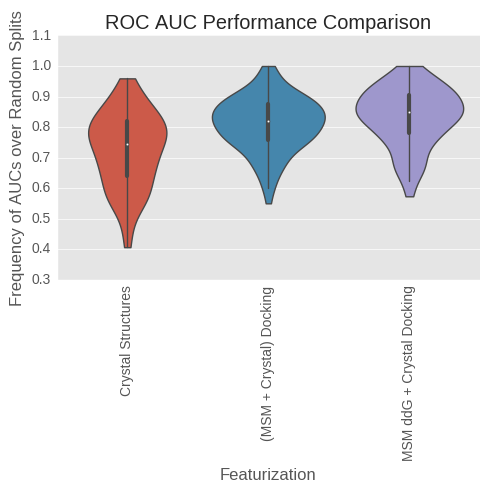

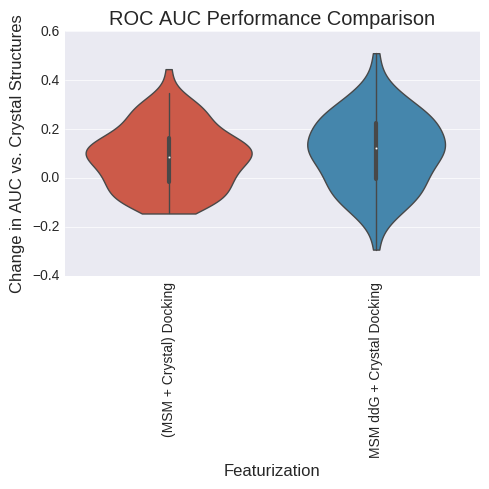

analyzing BedROC
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.844838          0.000000   
(MSM + Crystal) Docking      0.987030          0.142192   
MSM ddG + Crystal Docking    0.802129         -0.042709   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.338143288421, 0.586834366596)  
MSM ddG + Crystal Docking  (0.164505369942, 0.385360560162)  


ValueError: list.remove(x): x not in list

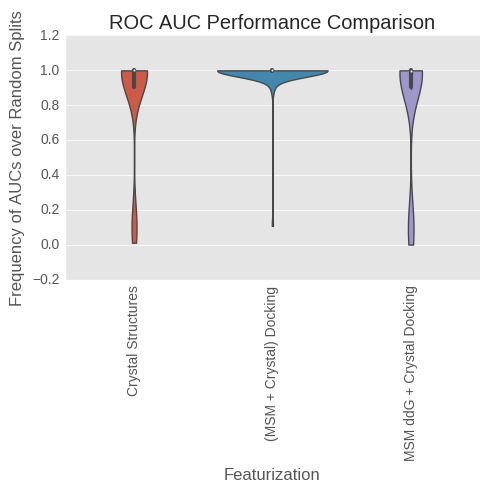

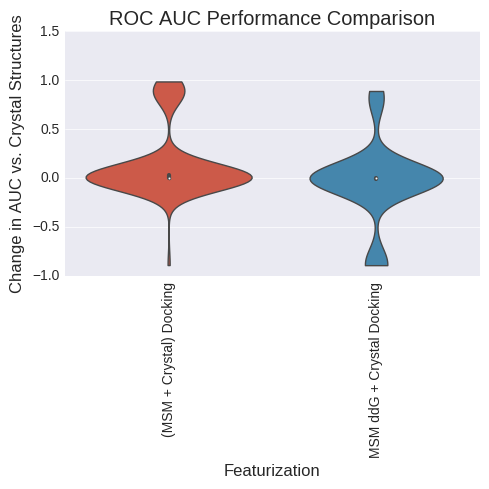

analyzing LogAUC
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures                0.0               0.0   
(MSM + Crystal) Docking           0.0               0.0   
MSM ddG + Crystal Docking         0.0               0.0   

                                 Sign Test 99% CI  
Crystal Structures                       (0, 0.0)  
(MSM + Crystal) Docking    (0.0, 0.0622206877158)  
MSM ddG + Crystal Docking  (0.0, 0.0622206877158)  


ValueError: list.remove(x): x not in list

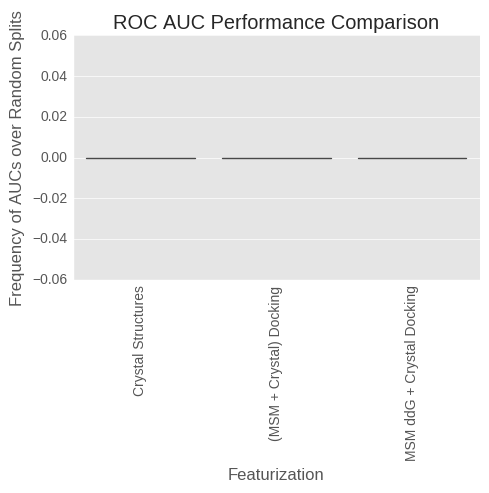

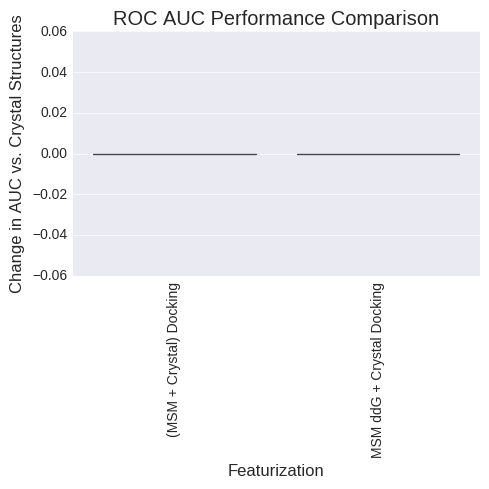

(3, 3)
(3, 3)


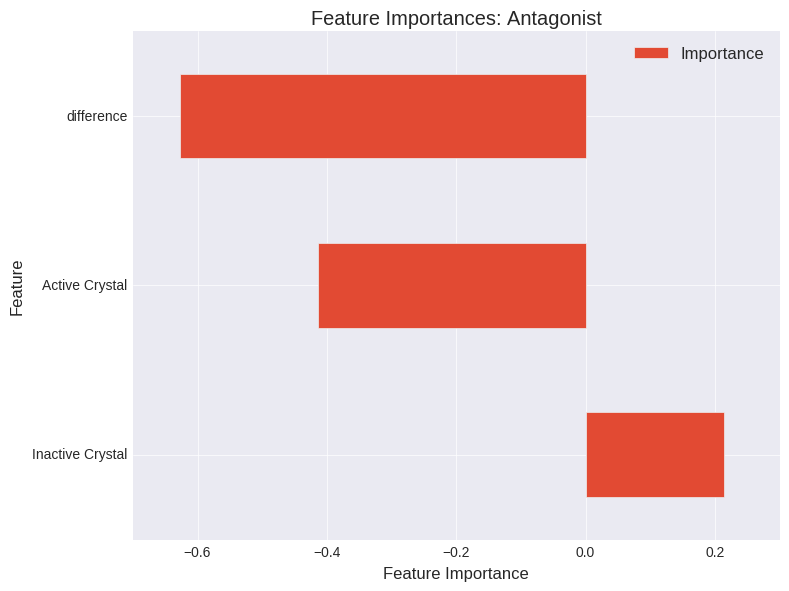

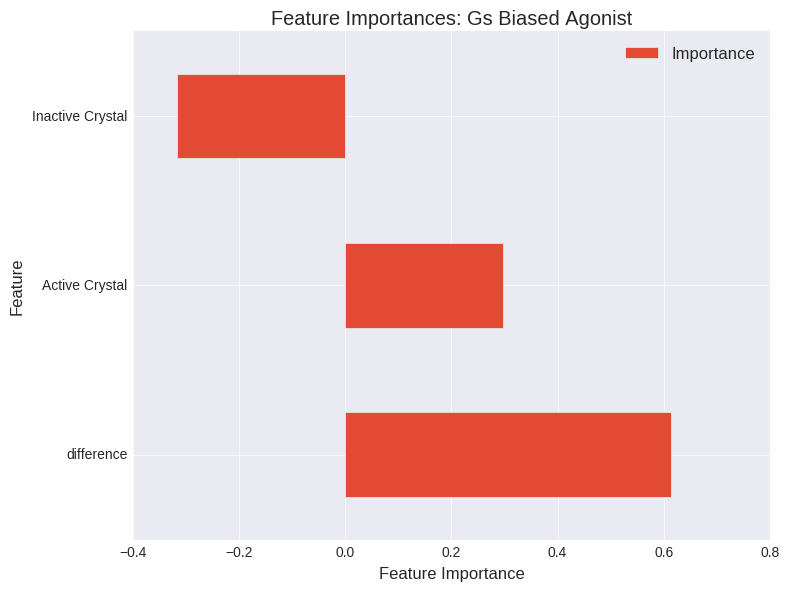

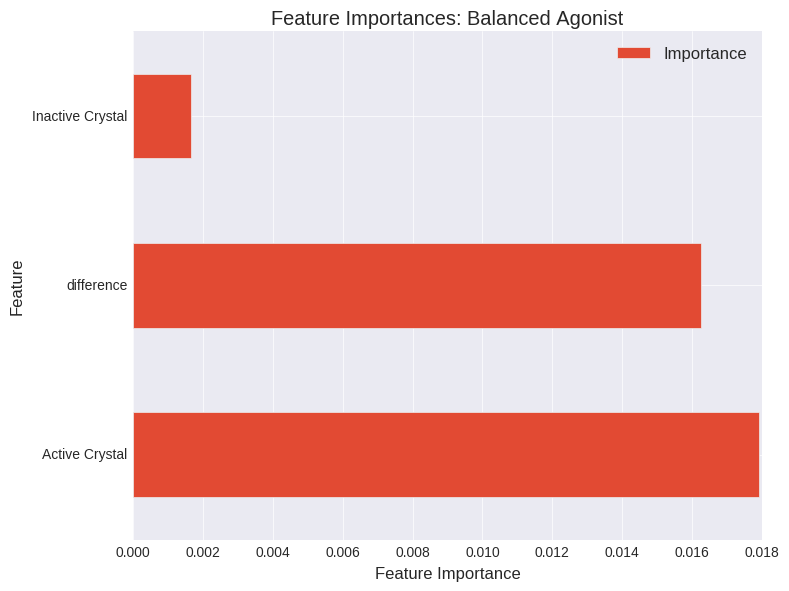

(3, 55)
(3, 55)


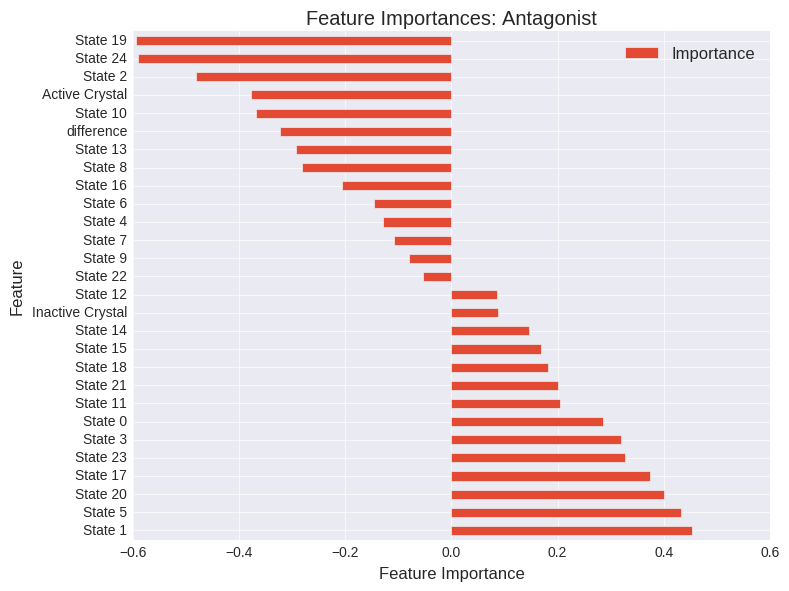

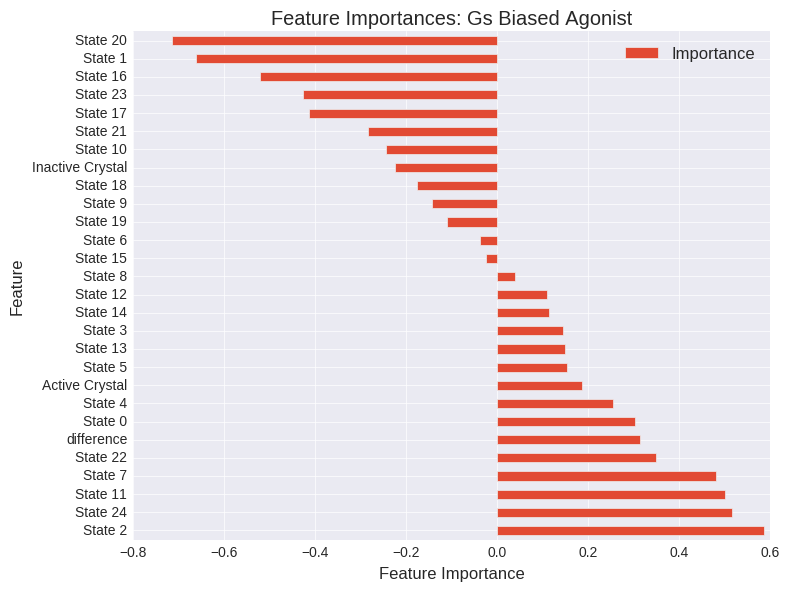

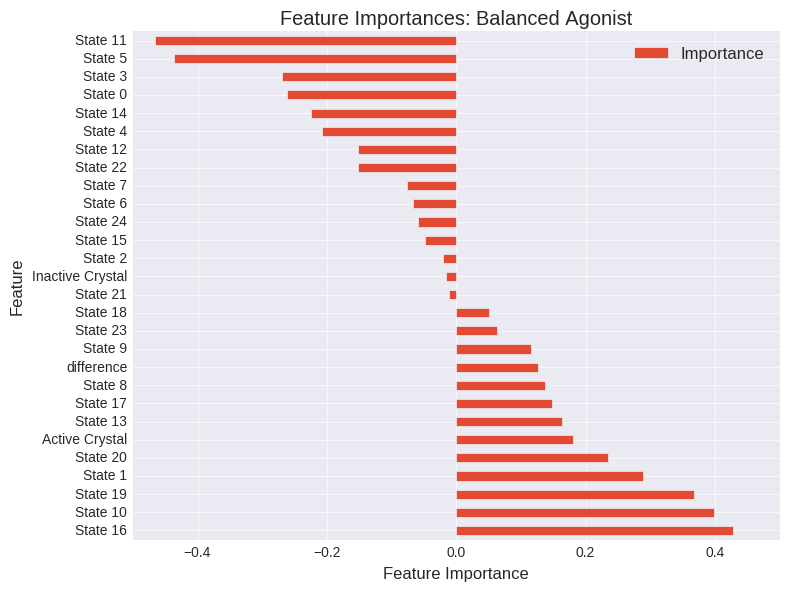

(3, 50)
(3, 50)


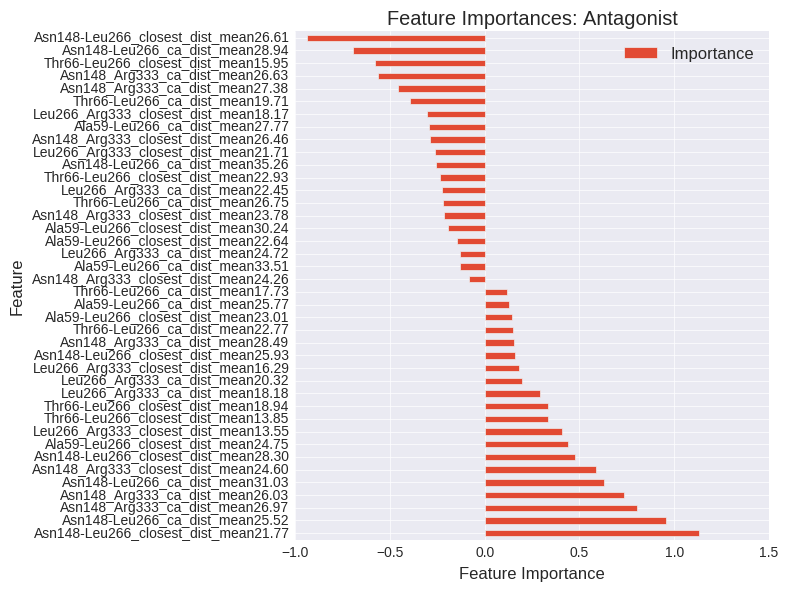

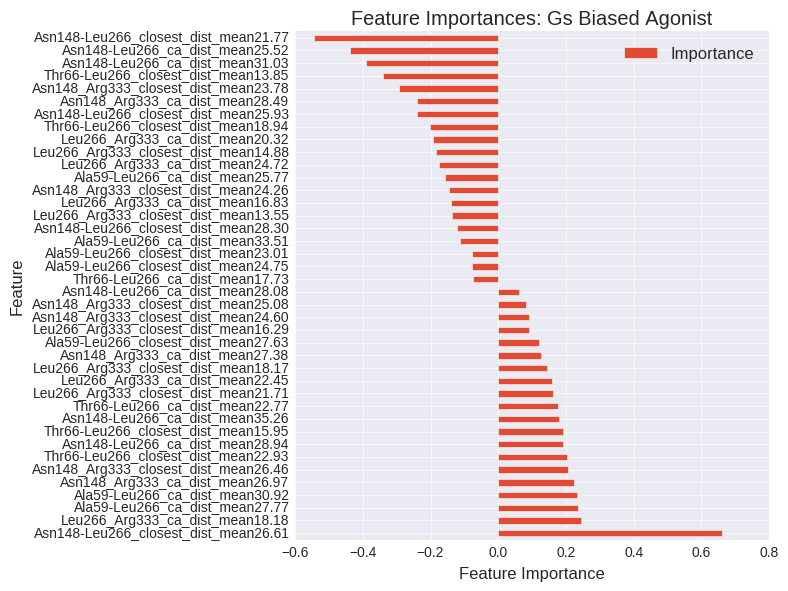

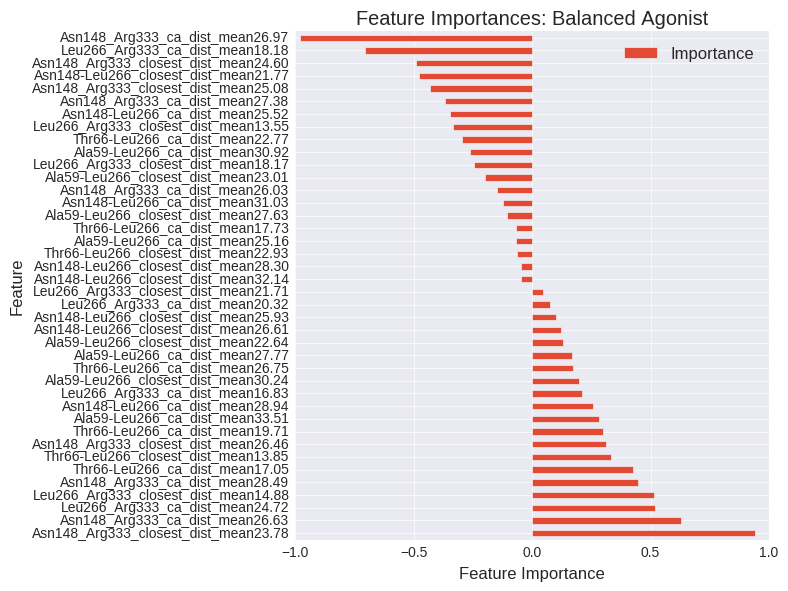

In [952]:
import efficacy_scripts
reload(efficacy_scripts)
from efficacy_scripts import *

#SP, All ligands, Four class, 32 stereoisomers; new crystal grids; 25 clusters

importance_dfs = analyze_multiclass_experiment(results_dict[save_name], 
                                                                feature_names,
                                                                [f.columns.values.tolist() for f in features], model_agonists, analysis_dir,
                                                                ["Antagonist", "Gs Biased Agonist", "Balanced Agonist"], 
     
                                               #["Gs Inactive", "Gs Active"], 
                                                               #["Arr Inactive", "Arr Active"],
                                               np.hstack([X_df.loc[model_agonists].values]),
                                                               #["Gs Inactive", "Gs Partial Active", "Gs Full Active"], 
                                              remake=False, fxn=np.mean)


#TRY LOOCV
#crystal structures might just have bigger boxes





In [860]:
deer_continuous_names

['Asn148-Leu266_ca_dist',
 'Asn148-Leu266_closest_dist',
 'Thr66-Leu266_ca_dist',
 'Leu266_Arg333_ca_dist']

analyzing precision at full recall:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.643857          0.000000   
(MSM + Crystal) Docking      0.656357          0.012500   
MSM ddG + Crystal Docking    0.587762         -0.056095   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.172648341273, 0.395973175076)  
MSM ddG + Crystal Docking  (0.117158880014, 0.320173532615)  


ValueError: list.remove(x): x not in list

analyzing threshold at full recall:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.490073          0.000000   
(MSM + Crystal) Docking      0.449358         -0.040715   
MSM ddG + Crystal Docking    0.401078         -0.088995   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.356617642074, 0.605871185435)  
MSM ddG + Crystal Docking   (0.266161320281, 0.50877164477)  


ValueError: list.remove(x): x not in list

analyzing Accuracy:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.694444          0.000000   
(MSM + Crystal) Docking      0.675556         -0.018889   
MSM ddG + Crystal Docking    0.656667         -0.037778   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking     (0.102032091788, 0.29778914835)  
MSM ddG + Crystal Docking  (0.164505369942, 0.385360560162)  


ValueError: list.remove(x): x not in list

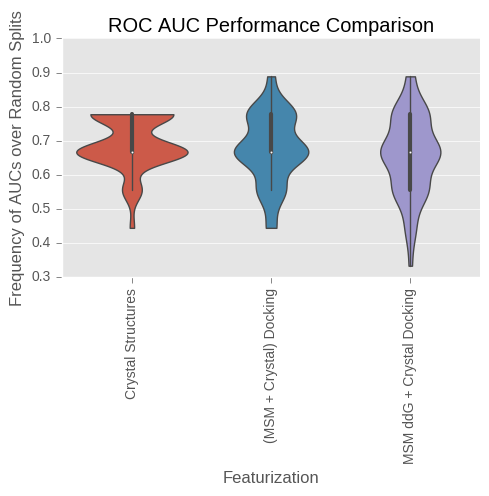

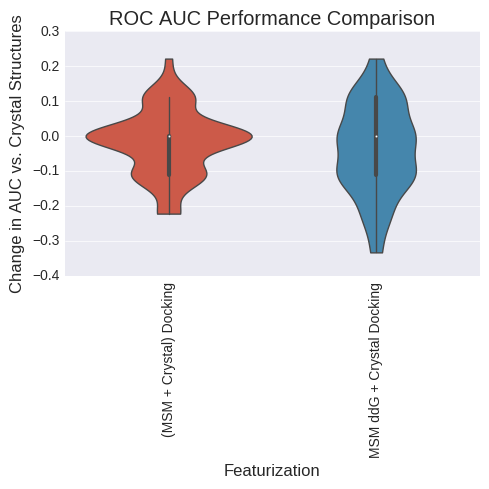

analyzing Recall:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.936667          0.000000   
(MSM + Crystal) Docking      0.830000         -0.106667   
MSM ddG + Crystal Docking    0.763333         -0.173333   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.0221179842002, 0.15263622099)  
MSM ddG + Crystal Docking  (0.046025811701, 0.203750738472)  


ValueError: list.remove(x): x not in list

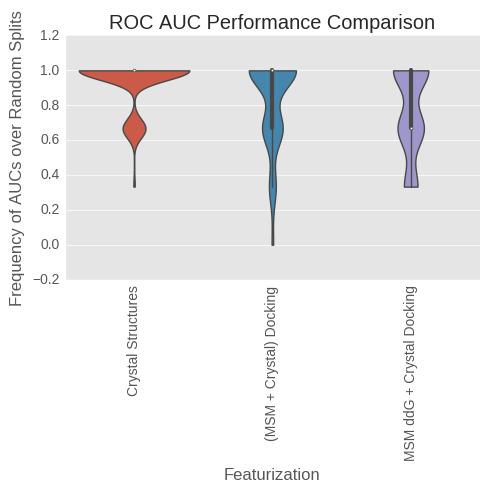

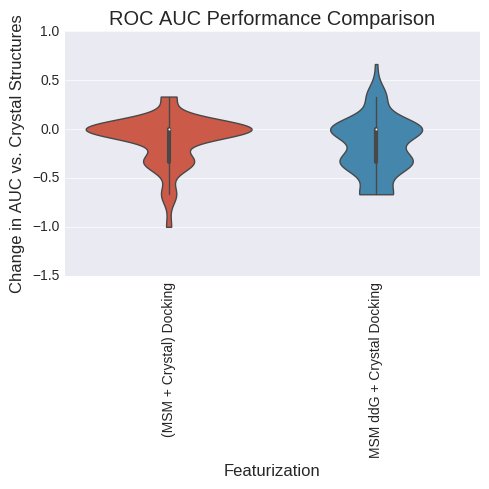

analyzing precision:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.578107          0.000000   
(MSM + Crystal) Docking      0.566238         -0.011869   
MSM ddG + Crystal Docking    0.536286         -0.041821   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking     (0.189127900701, 0.41700478814)  
MSM ddG + Crystal Docking  (0.172648341273, 0.395973175076)  


ValueError: list.remove(x): x not in list

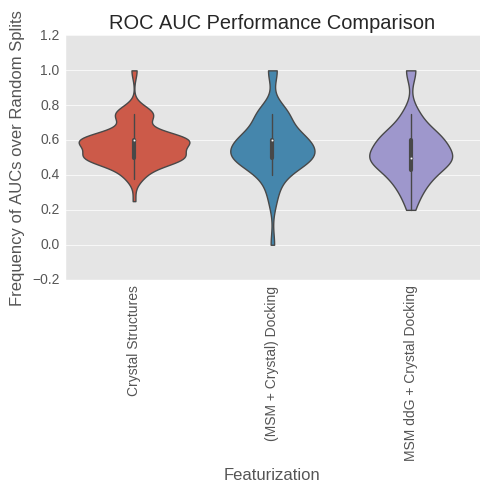

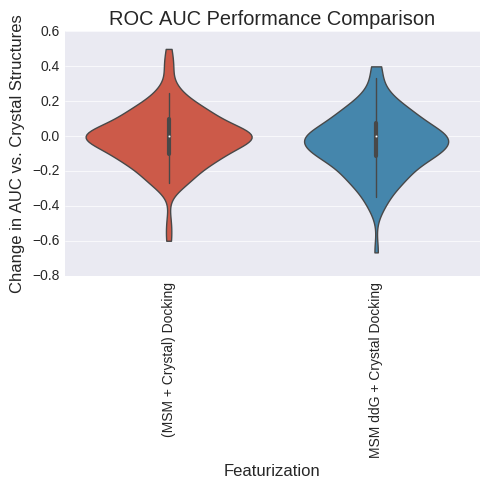

analyzing fdr:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.421893          0.000000   
(MSM + Crystal) Docking      0.433762          0.011869   
MSM ddG + Crystal Docking    0.463714          0.041821   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.239991939807, 0.478674266508)  
MSM ddG + Crystal Docking  (0.347356952001, 0.596376289262)  


ValueError: list.remove(x): x not in list

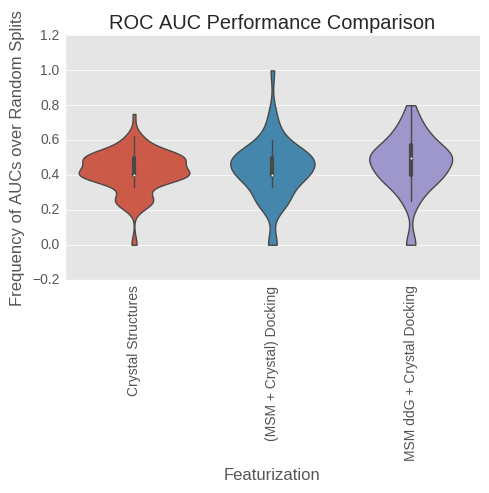

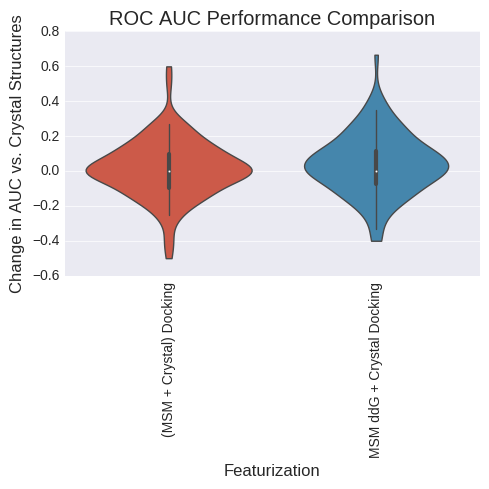

analyzing Recall:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.694444          0.000000   
(MSM + Crystal) Docking      0.675556         -0.018889   
MSM ddG + Crystal Docking    0.656667         -0.037778   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking     (0.102032091788, 0.29778914835)  
MSM ddG + Crystal Docking  (0.164505369942, 0.385360560162)  


ValueError: list.remove(x): x not in list

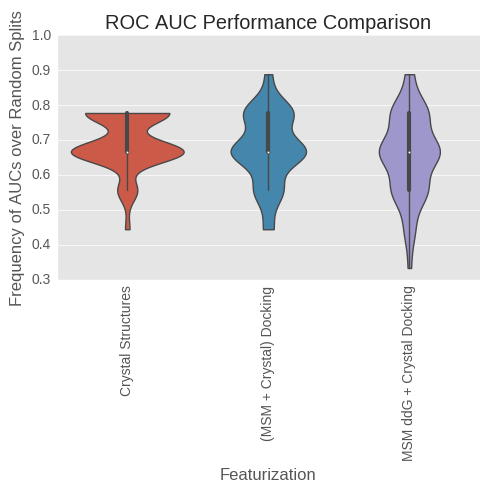

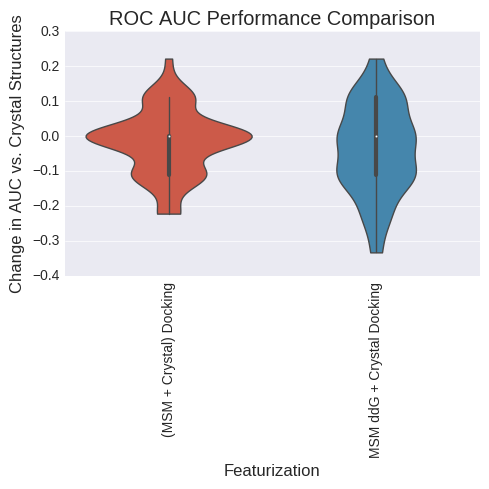

analyzing precision:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.584131          0.000000   
(MSM + Crystal) Docking      0.609492          0.025361   
MSM ddG + Crystal Docking    0.635524          0.051393   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking     (0.266161320281, 0.50877164477)  
MSM ddG + Crystal Docking  (0.384680812399, 0.634074773846)  


ValueError: list.remove(x): x not in list

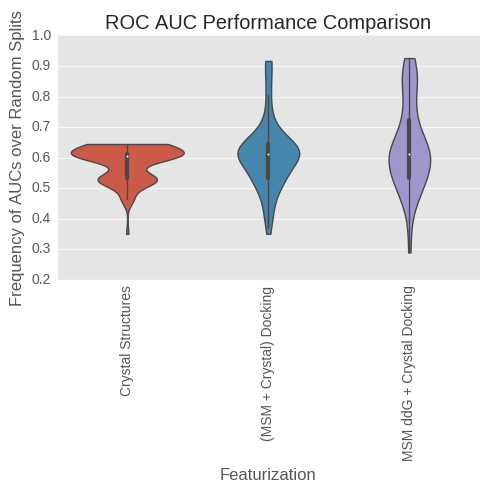

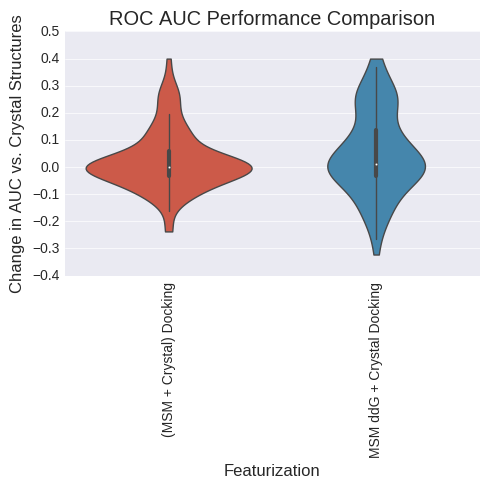

analyzing fdr:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.415869          0.000000   
(MSM + Crystal) Docking      0.390508         -0.025361   
MSM ddG + Crystal Docking    0.364476         -0.051393   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.205853128193, 0.437790733139)  
MSM ddG + Crystal Docking  (0.222811316676, 0.458343717148)  


ValueError: list.remove(x): x not in list

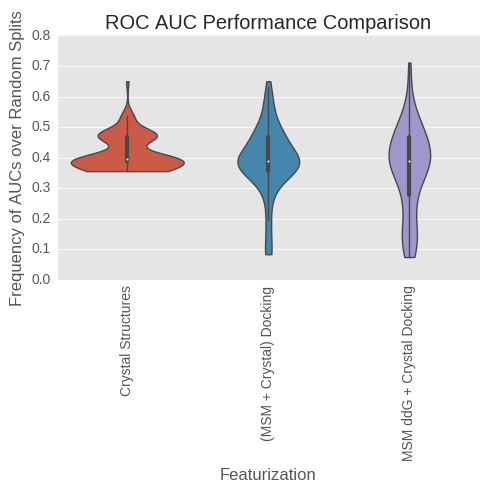

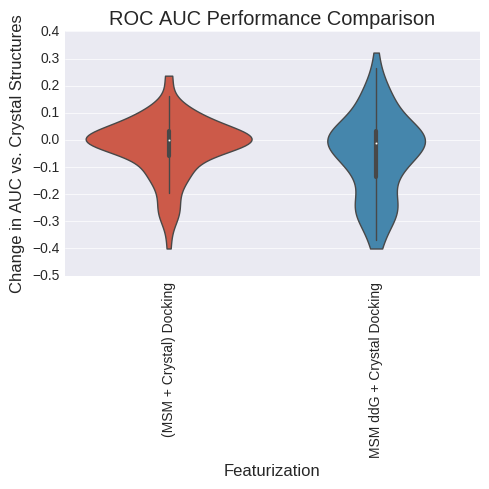

analyzing class B ROC AUC:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.771111          0.000000   
(MSM + Crystal) Docking      0.827778          0.056667   
MSM ddG + Crystal Docking    0.781667          0.010556   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.461589133665, 0.707211142546)  
MSM ddG + Crystal Docking   (0.32897683787, 0.577245230902)  


ValueError: list.remove(x): x not in list

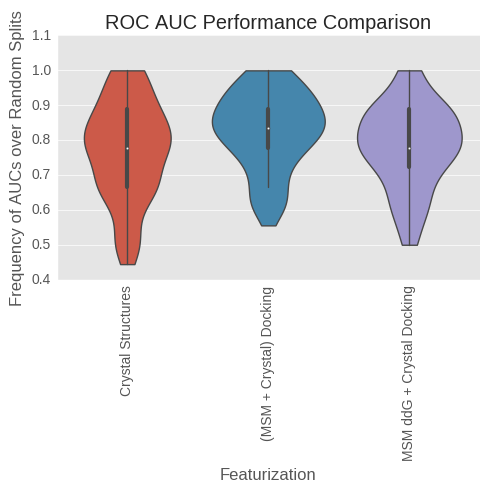

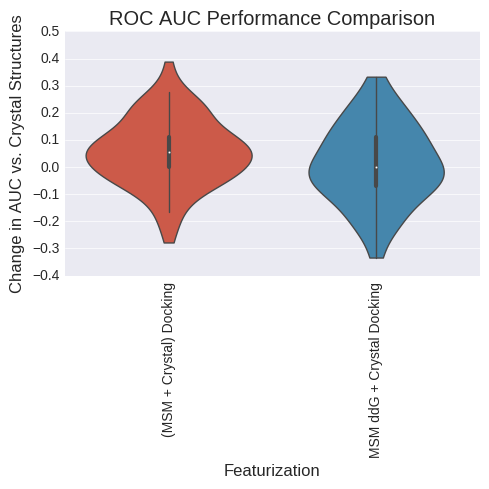

analyzing ROC AUC:
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.720108          0.000000   
(MSM + Crystal) Docking      0.805926          0.085817   
MSM ddG + Crystal Docking    0.855437          0.135328   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.657789902424, 0.867366512455)  
MSM ddG + Crystal Docking  (0.771919554171, 0.940792723165)  


ValueError: list.remove(x): x not in list

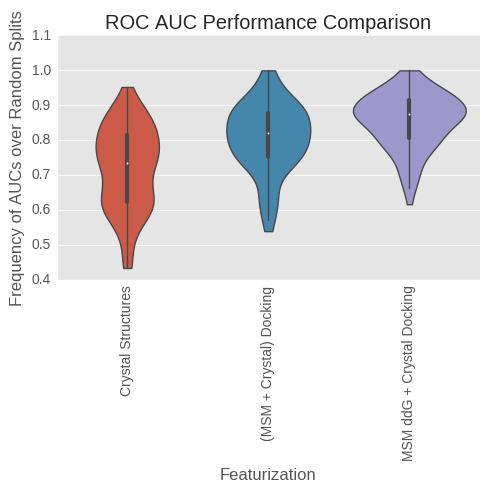

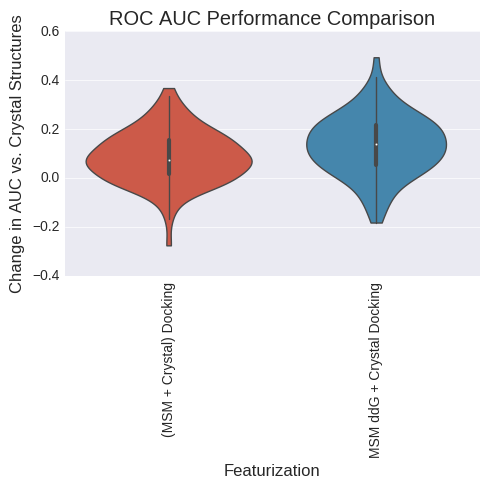

analyzing BedROC
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.879567          0.000000   
(MSM + Crystal) Docking      0.984773          0.105206   
MSM ddG + Crystal Docking    0.781113         -0.098454   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.257386290078, 0.498791088728)  
MSM ddG + Crystal Docking   (0.102032091788, 0.29778914835)  


ValueError: list.remove(x): x not in list

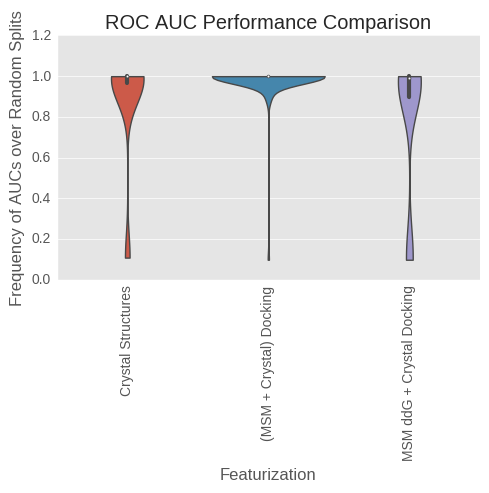

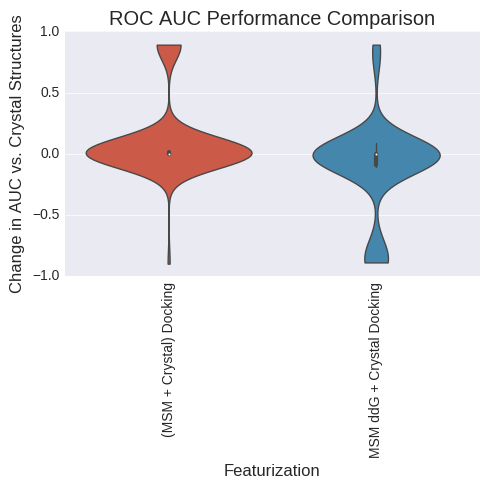

analyzing LogAUC
(100, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures                0.0               0.0   
(MSM + Crystal) Docking           0.0               0.0   
MSM ddG + Crystal Docking         0.0               0.0   

                                 Sign Test 99% CI  
Crystal Structures                       (0, 0.0)  
(MSM + Crystal) Docking    (0.0, 0.0622206877158)  
MSM ddG + Crystal Docking  (0.0, 0.0622206877158)  


ValueError: list.remove(x): x not in list

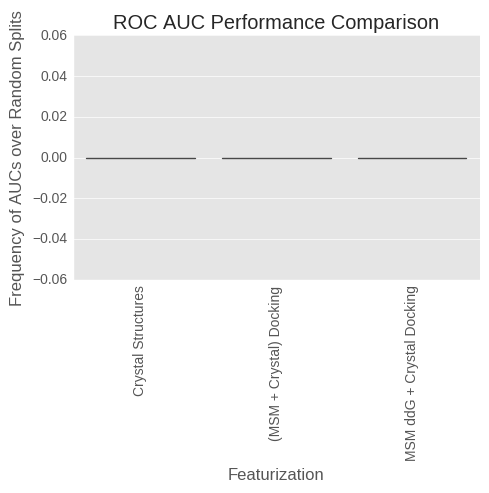

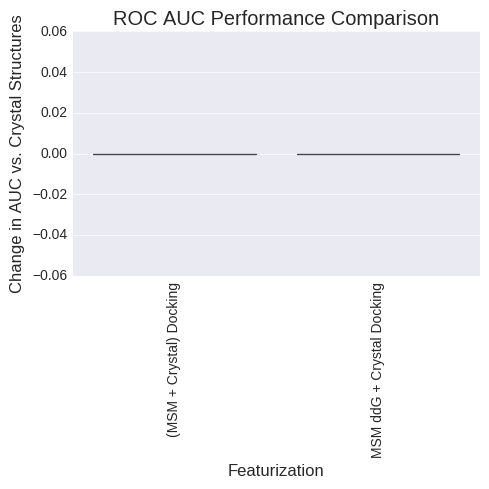

(3, 3)
(3, 3)


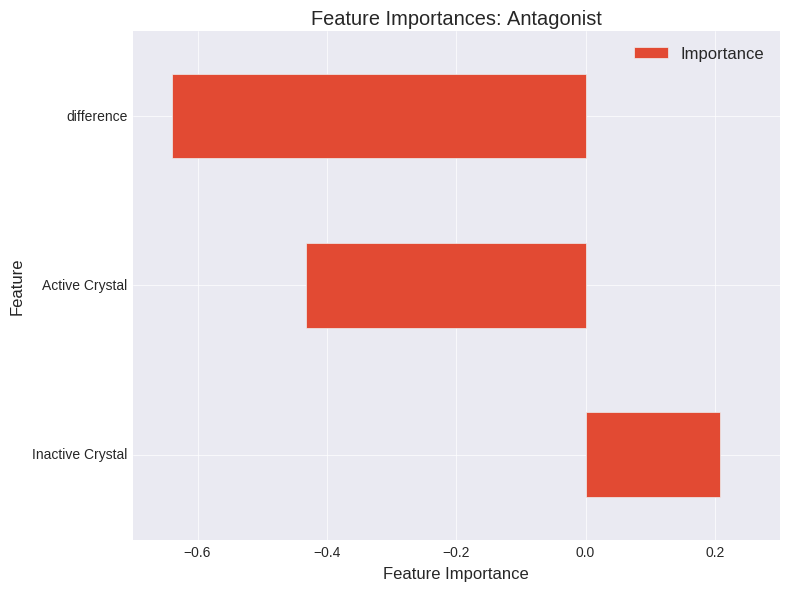

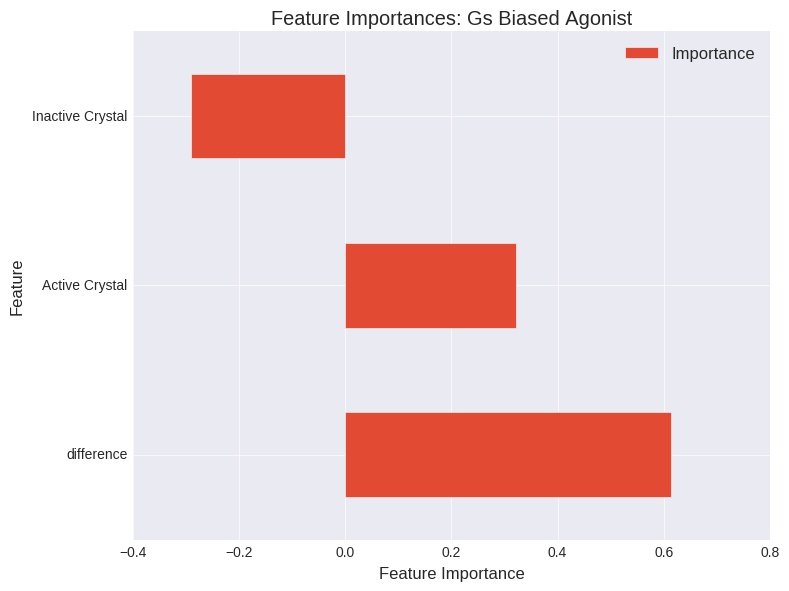

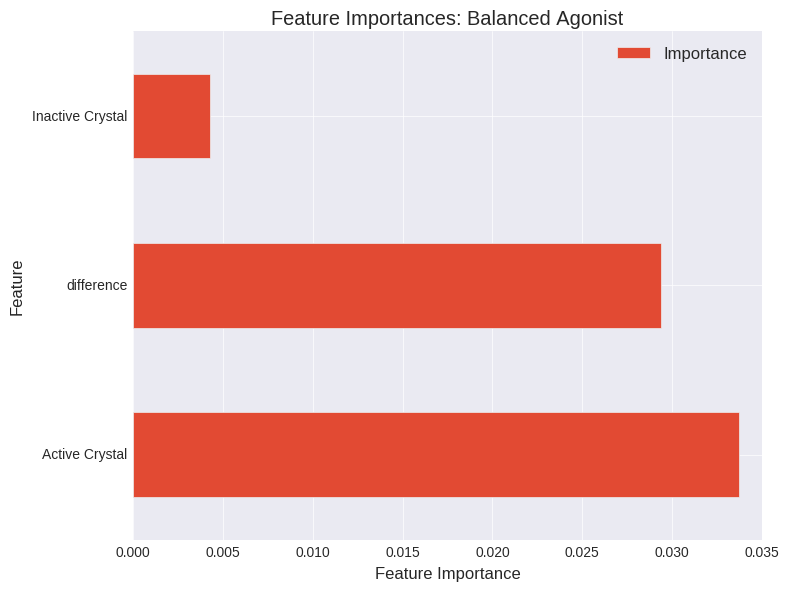

(3, 55)
(3, 55)


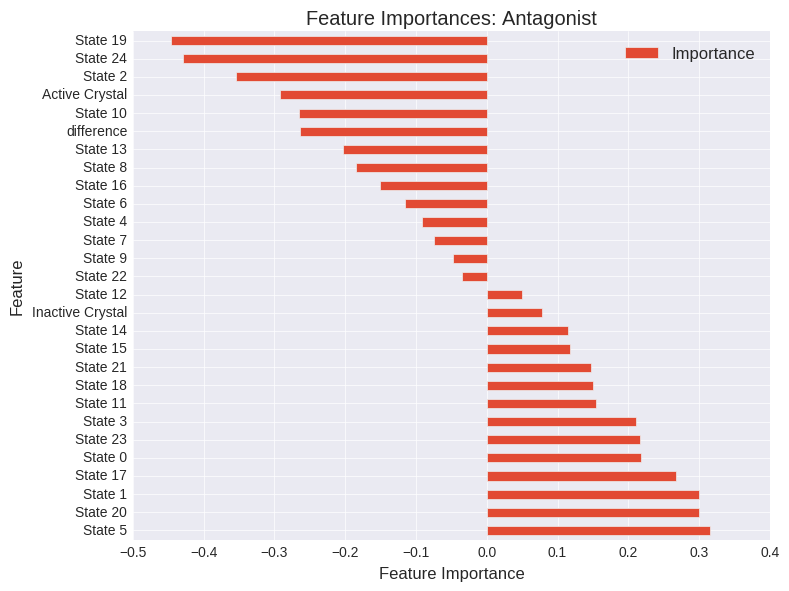

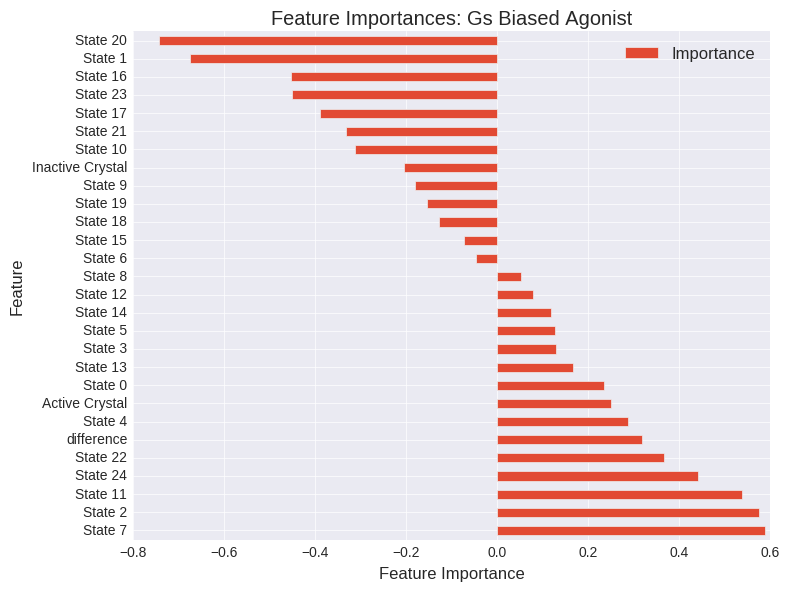

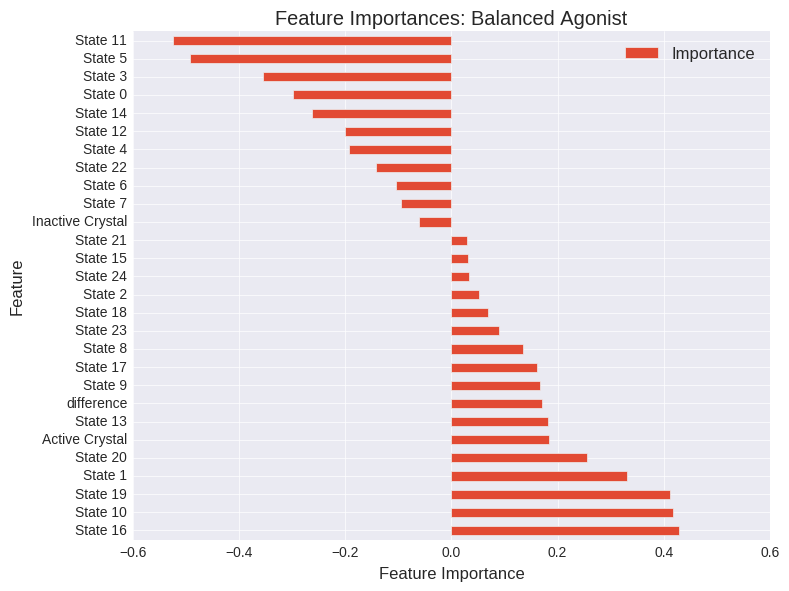

(3, 50)
(3, 50)


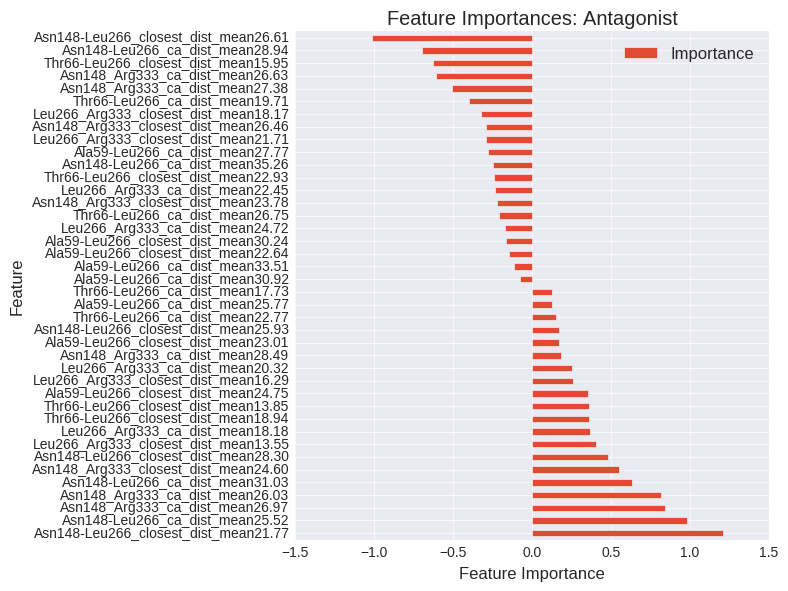

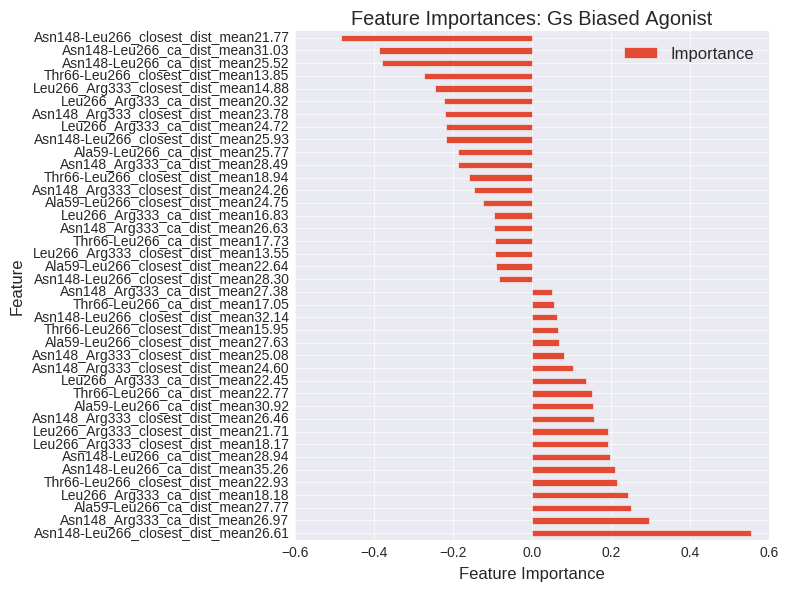

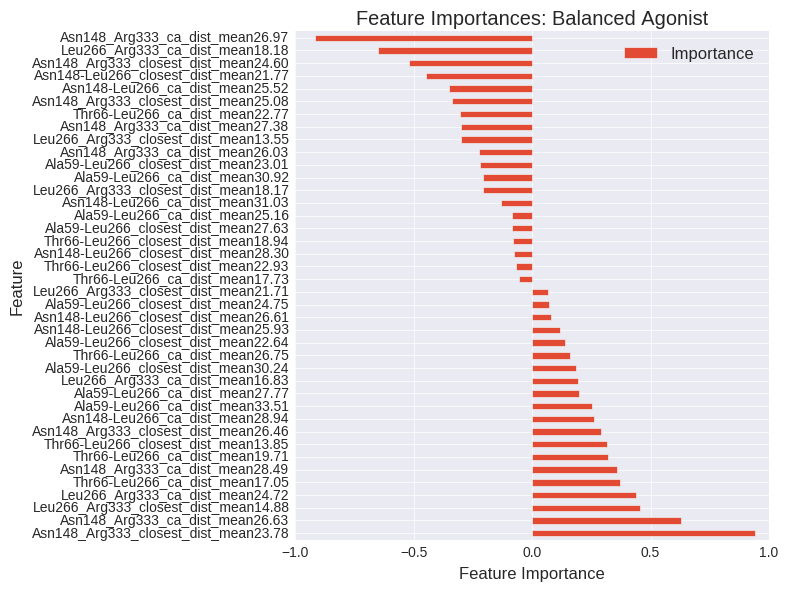

In [835]:
import efficacy_scripts
reload(efficacy_scripts)
from efficacy_scripts import *

#SP, All ligands, two class gpr, 32 stereoisomers; new crystal grids; 25 clusters

importance_dfs = analyze_multiclass_experiment(results_dict[save_name], 
                                                                feature_names,
                                                                [f.columns.values.tolist() for f in features], model_agonists, analysis_dir,
                                                                ["Antagonist", "Gs Biased Agonist", "Balanced Agonist"], 
     
                                               #["Gs Inactive", "Gs Active"], 
                                                               #["Arr Inactive", "Arr Active"],
                                               np.hstack([X_df.loc[model_agonists].values]),
                                                               #["Gs Inactive", "Gs Partial Active", "Gs Full Active"], 
                                              remake=False, fxn=np.mean)


#TRY LOOCV
#crystal structures might just have bigger boxes





In [836]:
cluster_features_averages["Asn148-Leu266_closest_dist"].sort(inplace=False)

cluster21    23.434880
cluster9     24.304536
cluster5     24.388092
cluster17    24.625469
cluster1     24.663571
cluster22    24.669106
cluster19    25.094862
cluster20    25.120183
cluster6     25.286552
cluster13    25.802903
cluster14    26.017824
cluster11    26.027508
cluster0     26.246872
cluster10    26.369958
cluster18    26.423094
cluster12    27.768868
cluster7     28.448814
cluster24    28.889854
cluster8     29.190712
cluster15    29.580700
cluster23    30.124905
cluster2     30.686968
cluster16    31.485300
cluster3     31.648698
cluster4     31.895664
Name: Asn148-Leu266_closest_dist, dtype: float64

In [949]:
cluster_features_averages["Asn148_Arg333_closest_dist"].sort(inplace=False)

cluster20    23.975872
cluster23    24.170680
cluster24    24.278682
cluster3     24.298657
cluster12    24.304057
cluster15    24.323910
cluster14    24.330691
cluster16    24.366313
cluster2     24.413935
cluster1     24.482781
cluster7     24.485682
cluster8     24.528460
cluster4     24.548535
cluster11    24.568634
cluster13    24.612657
cluster22    24.620244
cluster17    24.660997
cluster5     24.699197
cluster10    24.740489
cluster19    24.759358
cluster21    24.772636
cluster9     24.794735
cluster6     24.923350
cluster0     24.928747
cluster18    25.019202
Name: Asn148_Arg333_closest_dist, dtype: float64

analyzing precision at full recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.532540          0.000000   
(MSM + Crystal) Docking      0.619489          0.086950   
MSM ddG + Crystal Docking    0.600992          0.068452   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.636827207033, 0.712852702921)  
MSM ddG + Crystal Docking  (0.596030790439, 0.674176412707)  


ValueError: list.remove(x): x not in list

analyzing threshold at full recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.113789          0.000000   
(MSM + Crystal) Docking      0.220793          0.107004   
MSM ddG + Crystal Docking    0.217840          0.104051   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.783449239579, 0.846371961872)  
MSM ddG + Crystal Docking  (0.779214457552, 0.842659473219)  


ValueError: list.remove(x): x not in list

analyzing Accuracy:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.818387          0.000000   
(MSM + Crystal) Docking      0.872871          0.054484   
MSM ddG + Crystal Docking    0.872000          0.053613   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.739237174994, 0.807137684309)  
MSM ddG + Crystal Docking  (0.717320724077, 0.787330964152)  


ValueError: list.remove(x): x not in list

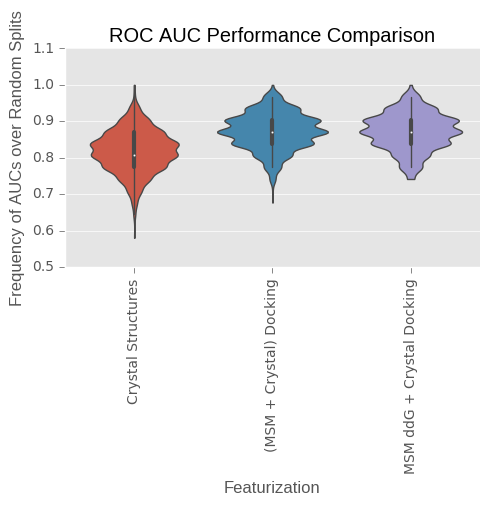

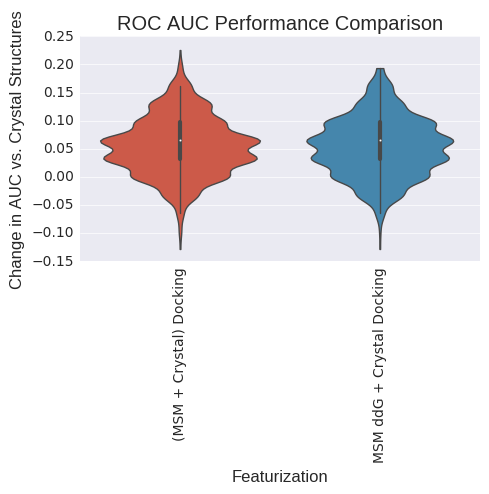

analyzing Recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.619889          0.000000   
(MSM + Crystal) Docking      0.675333          0.055444   
MSM ddG + Crystal Docking    0.676556          0.056667   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.438581002308, 0.519695826618)  
MSM ddG + Crystal Docking  (0.446506322643, 0.527665047644)  


ValueError: list.remove(x): x not in list

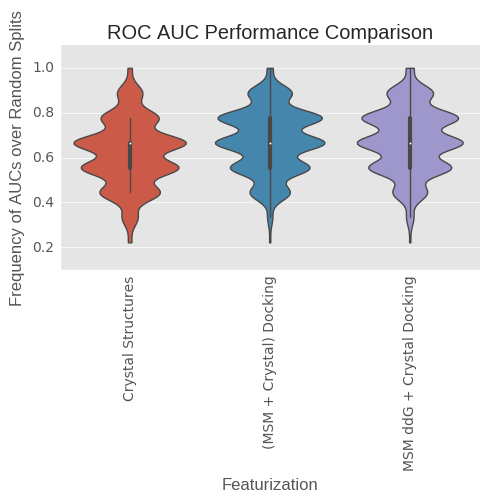

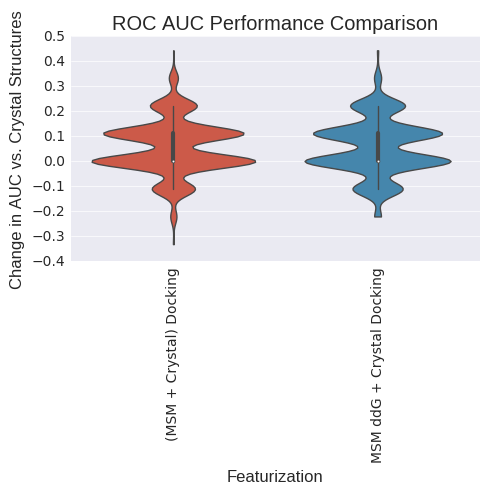

analyzing precision:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.735598          0.000000   
(MSM + Crystal) Docking      0.870321          0.134723   
MSM ddG + Crystal Docking    0.865463          0.129866   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.734008365187, 0.802432405765)  
MSM ddG + Crystal Docking  (0.726699315456, 0.795833731805)  


ValueError: list.remove(x): x not in list

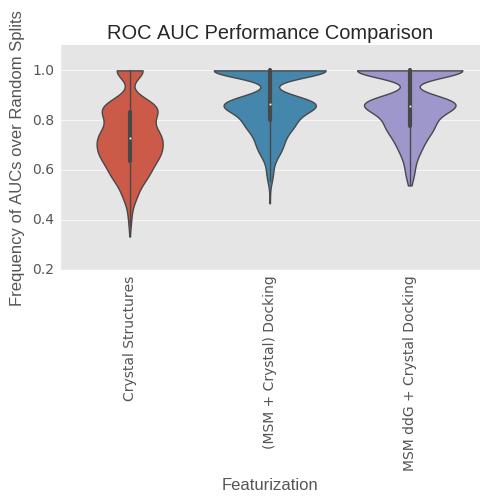

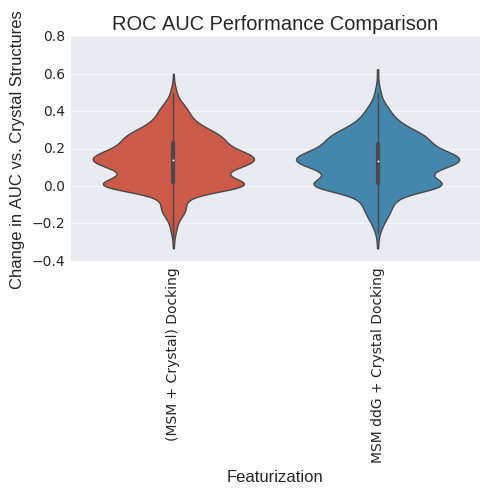

analyzing fdr:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.264402          0.000000   
(MSM + Crystal) Docking      0.129679         -0.134723   
MSM ddG + Crystal Docking    0.134537         -0.129866   

                                            Sign Test 99% CI  
Crystal Structures                                  (0, 0.0)  
(MSM + Crystal) Docking    (0.0701908543204, 0.117200718571)  
MSM ddG + Crystal Docking   (0.0942058216261, 0.14682982836)  


ValueError: list.remove(x): x not in list

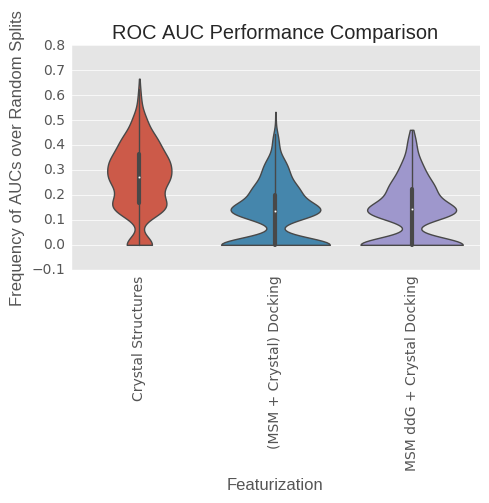

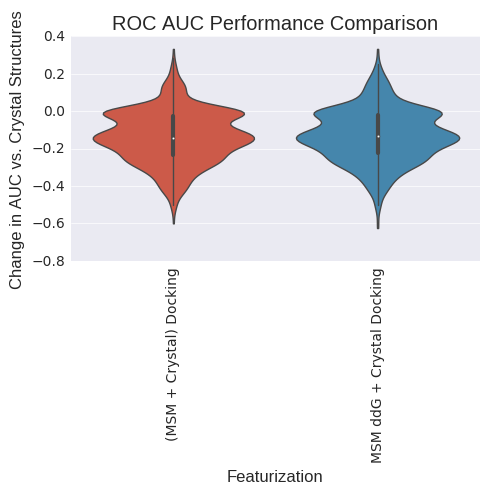

analyzing Recall:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.619889          0.000000   
(MSM + Crystal) Docking      0.675333          0.055444   
MSM ddG + Crystal Docking    0.676556          0.056667   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.438581002308, 0.519695826618)  
MSM ddG + Crystal Docking  (0.446506322643, 0.527665047644)  


ValueError: list.remove(x): x not in list

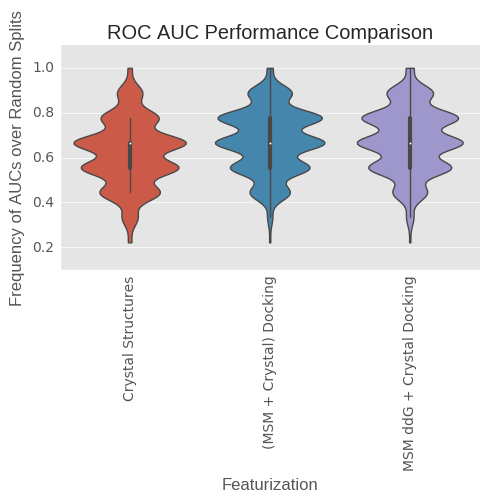

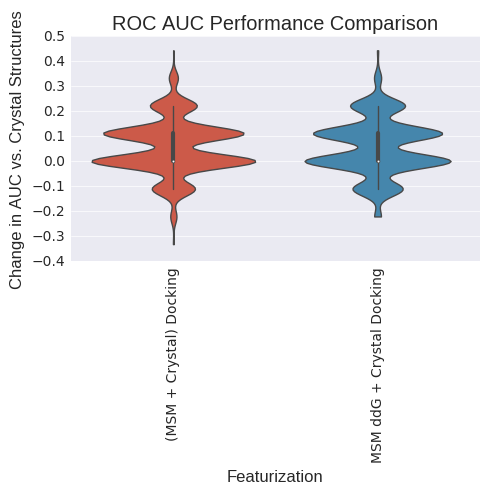

analyzing precision:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.735598          0.000000   
(MSM + Crystal) Docking      0.870321          0.134723   
MSM ddG + Crystal Docking    0.865463          0.129866   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.734008365187, 0.802432405765)  
MSM ddG + Crystal Docking  (0.726699315456, 0.795833731805)  


ValueError: list.remove(x): x not in list

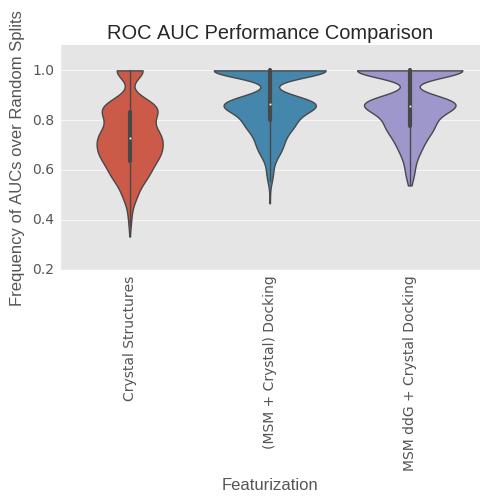

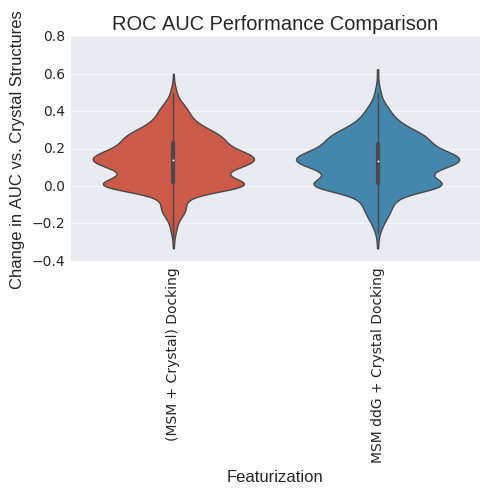

analyzing fdr:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.264402          0.000000   
(MSM + Crystal) Docking      0.129679         -0.134723   
MSM ddG + Crystal Docking    0.134537         -0.129866   

                                            Sign Test 99% CI  
Crystal Structures                                  (0, 0.0)  
(MSM + Crystal) Docking    (0.0701908543204, 0.117200718571)  
MSM ddG + Crystal Docking   (0.0942058216261, 0.14682982836)  


ValueError: list.remove(x): x not in list

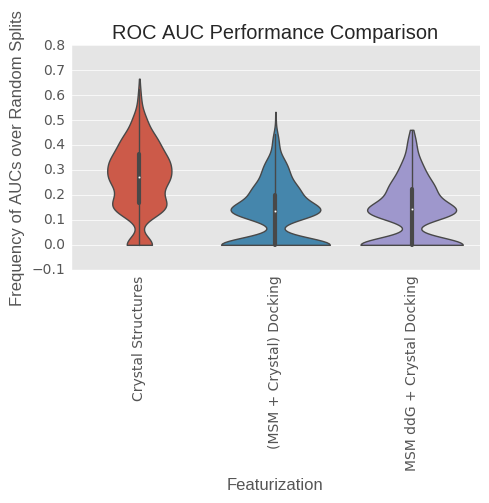

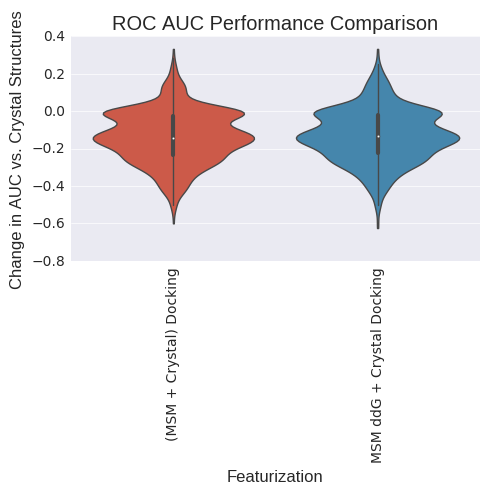

analyzing class B ROC AUC:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.883341          0.000000   
(MSM + Crystal) Docking      0.932462          0.049121   
MSM ddG + Crystal Docking    0.928030          0.044689   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.823978877242, 0.881341395677)  
MSM ddG + Crystal Docking   (0.80791148098, 0.867606526885)  


ValueError: list.remove(x): x not in list

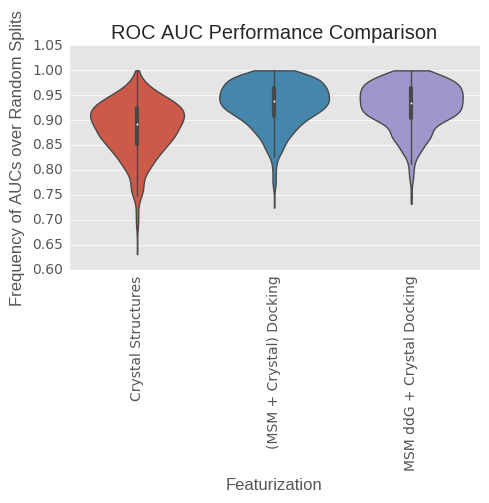

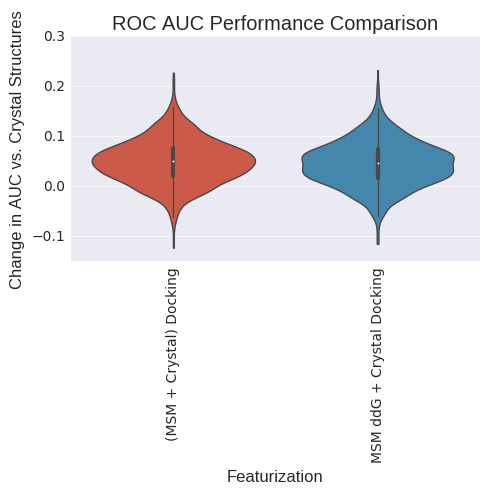

analyzing ROC AUC:
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.883341          0.000000   
(MSM + Crystal) Docking      0.932462          0.049121   
MSM ddG + Crystal Docking    0.928030          0.044689   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.822904652511, 0.880428802737)  
MSM ddG + Crystal Docking  (0.808979679805, 0.868525145731)  


ValueError: list.remove(x): x not in list

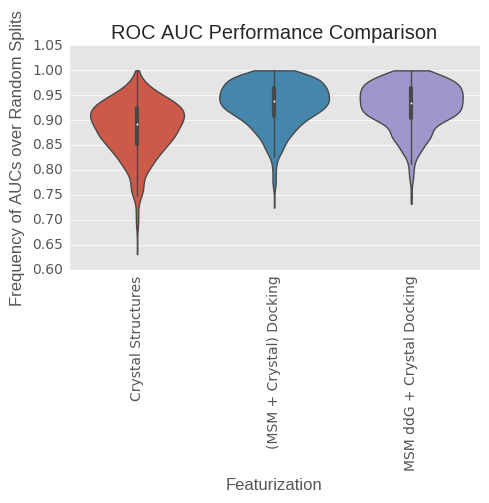

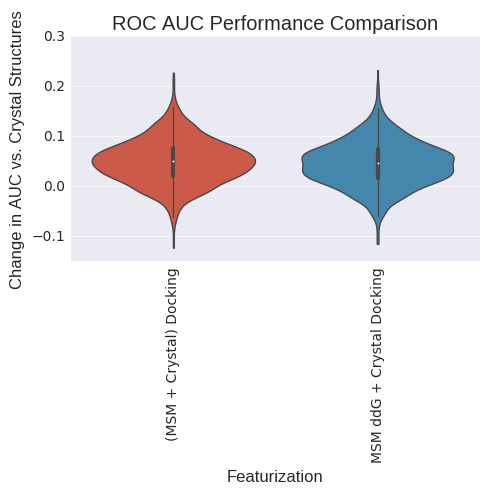

analyzing BedROC
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.885365          0.000000   
(MSM + Crystal) Docking      0.948389          0.063024   
MSM ddG + Crystal Docking    0.957403          0.072038   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.850994409266, 0.903996305408)  
MSM ddG + Crystal Docking  (0.855348303331, 0.907589682023)  


ValueError: list.remove(x): x not in list

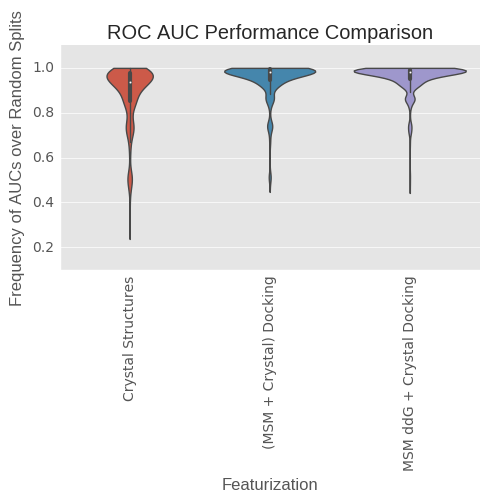

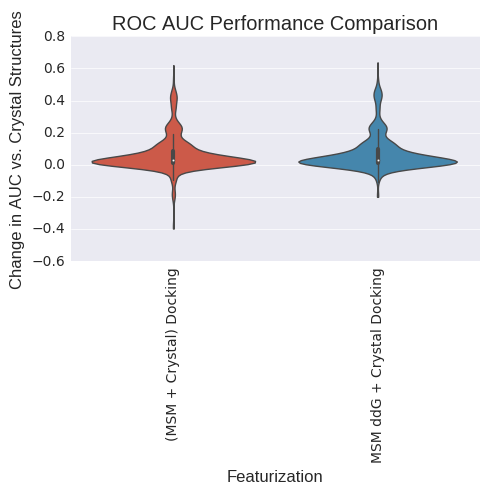

analyzing LogAUC
(1000, 3)
                           Median AUC  Median delta AUC  \
Crystal Structures           0.318623          0.000000   
(MSM + Crystal) Docking      0.345754          0.027131   
MSM ddG + Crystal Docking    0.340120          0.021497   

                                           Sign Test 99% CI  
Crystal Structures                                 (0, 0.0)  
(MSM + Crystal) Docking    (0.667629625978, 0.741654814082)  
MSM ddG + Crystal Docking  (0.641948297069, 0.717665701236)  


ValueError: list.remove(x): x not in list

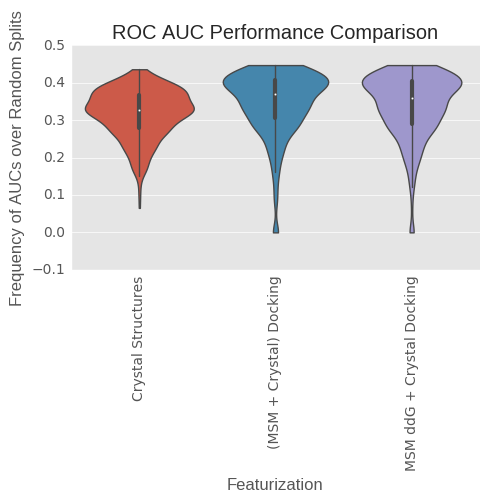

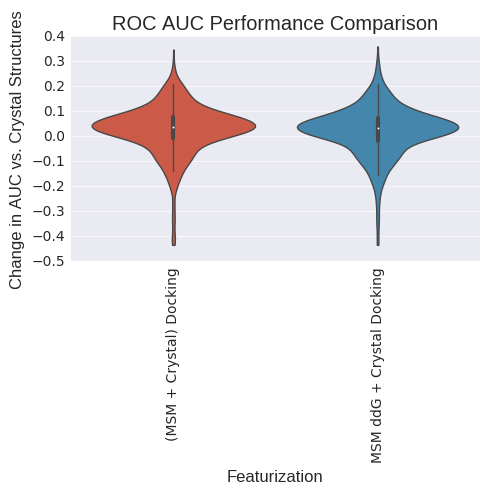

(3,)
(1, 3)


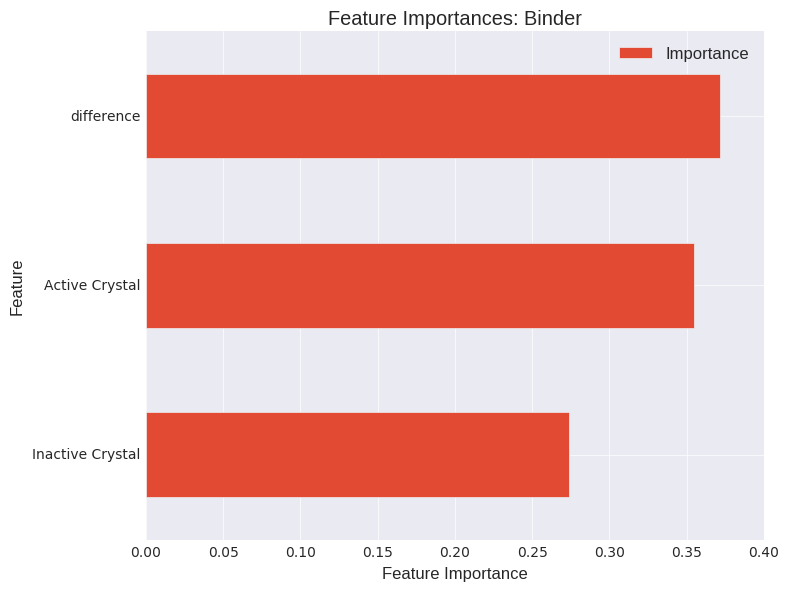

(55,)
(1, 55)


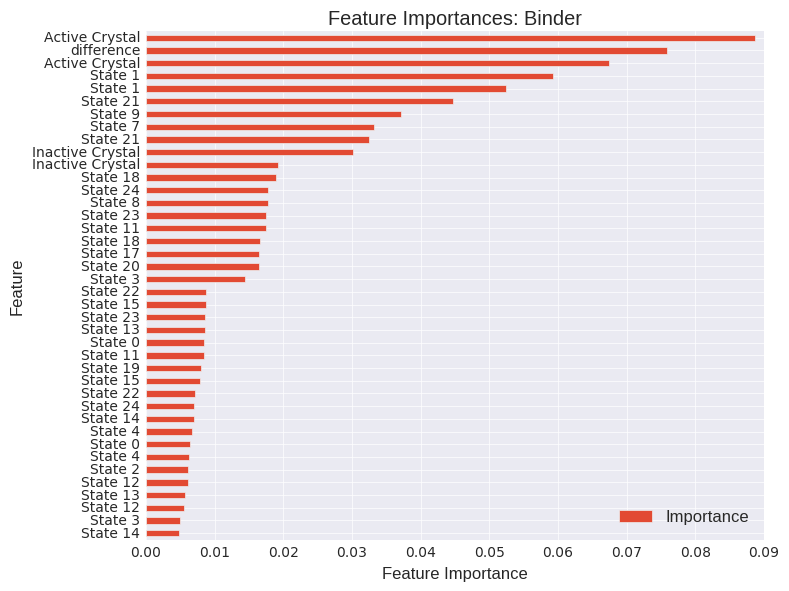

(105,)
(1, 105)


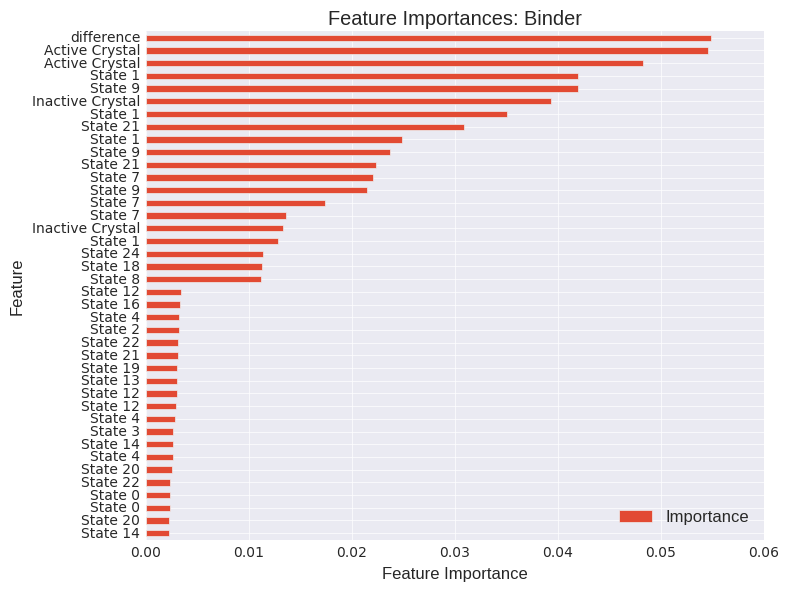

In [240]:
#SP, All ligands, Four class, 32 stereoisomers; new crystal grids; 25 clusters

importance_dfs = analyze_multiclass_experiment(results_dict[save_name], 
                                                                feature_names,
                                                                [f.columns.values.tolist() for f in features], model_agonists, analysis_dir,
                                                                ["Non-binder", "Binder"], 
                                                                #["Gs Inactive", "Gs Active"], 
                                                               #["Arr Inactive", "Arr Active"],
                                               np.hstack([X_df.loc[model_agonists].values]),
                                                               #["Gs Inactive", "Gs Partial Active", "Gs Full Active"], 
                                              remake=False, fxn=np.mean)


#TRY LOOCV
#crystal structures might just have bigger boxes




In [ ]:
all_ligands_dir = "/home/enf/b2ar_analysis/all_ligands"

from importlib import reload
import grids
reload(grids)
from grids import *

grid_center = "64.4, 16.9, 11.99"


#reimaged_dir = samples_dir
#mae_dir = reimaged_dir
#remove_ter(reimaged_dir)
#reorder(reimaged_dir)


#agonist_ligands = [a for a in agonist_ligands if "TA" not in a]

#pprep(mae_dir, ref = active_ref_dir, chosen_receptors = chosen_receptors, worker_pool=None, parallel=True)
#generate_grids(mae_dir, grid_center, grid_dir, remove_lig = "BIA", chosen_receptors = chosen_receptors, worker_pool=None, outer_box=25.)

precision = "SP"
htbc_dir = "/home/enf/htbc/sdfs"
lig_dir = "/home/enf/b2ar_analysis/all_ligands/32-stereoisomers_6-ring-conf"
docking_dir = "/home/enf/htbc/b2ar/docking_SP_32-stereoisomer_6-ring-conf"
#docking_dir = "/home/enf/htbc/b2ar/docking_xp/32-stereoisomers_6-ring-conf"
grid_dir = "/home/enf/htbc/b2ar/grids"

#df = prepare_ligands(all_ligands_dir, exts = [".sdf"],
#                n_ring_conf=6, n_stereoisomers=32,
#               force_field=16, worker_pool=None,
#               parallel=True, redo=False,
#              smiles_df=None, cid_df=None,
#             binding_db=None,
#             return_df=True)

if not os.path.exists(docking_dir):
    os.makedirs(docking_dir)
if not os.path.exists(grid_dir):
    os.makedirs(grid_dir)

#chosen_ligands = df.index.values.tolist()[:2000]
chosen_ligands = [n for n in get_ligands(lig_dir, ".mae") if "mjg" in n.lower()]
print(chosen_ligands)
print(len(chosen_ligands))
dock_ligands_and_receptors(grid_dir, docking_dir, lig_dir,
                           precision = precision, ext = "-out.maegz", 
                           chosen_ligands=chosen_ligands, chosen_receptors = None, 
                           parallel = False, grid_ext = ".zip", worker_pool=dview, 
                           retry_after_failed=True, timeout=60*60*4)
#dock_ligands_and_receptors(grid_dir, docking_dir, lig_dir, precision = precision, ext = "-out.maegz", chosen_ligands=chosen_ligands, chosen_receptors = None, parallel = False, grid_ext = ".zip", worker_pool=dview, retry_after_failed=True, timeout=60*1200)


#dock_ligands_and_receptors(grid_dir, docking_dir,  biased_agonist_dir, precision = precision, ext = "-out.maegz", chosen_ligands = biased_ligands, chosen_receptors = chosen_receptors, parallel = None, grid_ext = ".grd", worker_pool=dview)
#dock_ligands_and_receptors(grid_dir, docking_dir, agonist_dir, precision = precision, ext = "-out.maegz", chosen_ligands = agonist_ligands, chosen_receptors = chosen_receptors, parallel = None, grid_ext = ".grd", worker_pool=dview)





['MJG-01', 'MJG-02', 'MJG-03', 'MJG-04', 'MJG-05', 'MJG-06', 'MJG-07', 'MJG-08', 'MJG-09', 'MJG-10', 'MJG-11', 'MJG-12', 'MJG-13', 'MJG-14', 'MJG-15', 'MJG-16', 'MJG-17', 'MJG-18', 'MJG-19', 'MJG-20', 'MJG-21', 'MJG-22', 'MJG-23', 'MJG-24', 'MJG-25', 'MJG-26', 'MJG-27', 'MJG-28', 'MJG-29', 'MJG-30', 'MJG-31', 'MJG-32', 'MJG-33', 'MJG-34', 'MJG-35', 'MJG-36', 'MJG-37', 'MJG-38', 'MJG-39', 'MJG-40', 'MJG-41', 'MJG-42', 'MJG-43', 'MJG-44', 'MJG-45', 'MJG-46', 'MJG-47', 'MJG-48', 'MJG-49', 'MJG-50', 'MJG-51', 'MJG-52', 'MJG-53', 'MJG-54', 'MJG-55', 'MJG-56', 'MJG-57', 'MJG-58', 'MJG-59', 'MJG-60', 'MJG-61', 'MJG-62', 'MJG-63']
63
Creating new directories for each ligand.
Done creating directories. Determining which docking jobs to conduct.
12
0.5000581741333008
62
About to do 1798 Docking computations.
Completed docking.


In [7]:
docking_dir

'docking_SP_32-stereoisomer_6-ring-conf'

In [681]:
import efficacy_scripts
reload(efficacy_scripts)
from efficacy_scripts import *

y = bret[gprot_col].pow(-1).multiply(bret[arr_col]).loc[bret.loc[bret[gprot_col] > 0.2].index]
y_df = pd.DataFrame(y, bret.loc[bret[gprot_col] > 0.2].index)
diff_results_t100_0pt8 = do_regression_experiment([C_df.loc[y_df.index.values.tolist()], ddg_df.loc[y_df.index.values.tolist()]], y, feature_names, 8, 0.95, regularize=5, model="rfr", parallel=True)

Exception ignored in: <Finalize object, dead>
Traceback (most recent call last):
  File "/home/enf/anaconda3/lib/python3.5/multiprocessing/util.py", line 186, in __call__
    res = self._callback(*self._args, **self._kwargs)
  File "/home/enf/anaconda3/lib/python3.5/multiprocessing/pool.py", line 553, in _terminate_pool
    p.terminate()
  File "/home/enf/anaconda3/lib/python3.5/multiprocessing/process.py", line 113, in terminate
    self._popen.terminate()
AttributeError: 'NoneType' object has no attribute 'terminate'


Finished fitting models


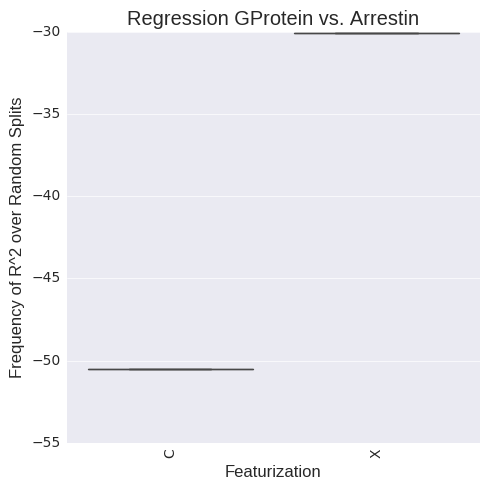

IndexError: list index out of range

In [682]:
analyze_regression_experiment(diff_results_t100_0pt8, ["C", "X"],
                                  ddg_df.columns.values, common_ligands, "Regression GProtein vs. Arrestin", analysis_dir)

In [531]:
save_name

'antagonist_vs_agonist_vs_dud-0.3_rfr_trials1000_split0.9_normalizeFalse_normalize-axis0False_n-estimators1000_precisionSP'

In [292]:
eff_test_df.loc[[n for n in eff_test_df.index.values if "ks" in n or "std" in n or (n in all_active_ligands and n not in model_agonists)]].sort("P(Gs Biased Agonist)", inplace=False)

KeyError: 'P(Gs Biased Agonist)'

In [244]:
eff_test_df.loc[[n for n in eff_test_df.index.values if "ks" in n or "std" in n] + ["CID_71301", "CID_73417071", "CID_73416654"]].sort("P(Gs Agonist)", inplace=False, ascending=False)

,P(Antagonist),P(Gs Agonist)
CID_73416654,0.053,0.947
CID_73417071,0.065,0.935
std101d1,0.703,0.297
std101c4,0.774,0.226
ksn010118,0.785,0.215
ks01505,0.796,0.204
CID_71301,0.816,0.184
ks01506,0.823,0.177
std101d4,0.827,0.173
ksn010115,0.926,0.074


In [199]:
#model = results_dict[save_name]['Crystal Structures'][0]
#model = results_dict[save_name]['(MSM + Crystal) Docking'][0]
#model = results_dict[save_name]['MSM ddG + Crystal Docking'][0]


y_proba =model.predict_proba(C_df.values)
#bias_test_df = pd.DataFrame(y_proba, index=X_df.index, columns=["class A", "class B", "class C"]).sort("class B", ascending=False, inplace=False)
#test_df = pd.DataFrame(y_proba, index=X_df.index, columns=["P(Non-binder)", "P(G Protein Biased)", "P(Balanced Agonist)", "P(Antagonist)"]).sort("P(G Protein Biased)", ascending=False, inplace=False)
aff_test_df_old = pd.DataFrame(y_proba, index=X_df.index, columns=["P(Non-binder)", "P(Binder)"]).sort("P(Binder)", ascending=False, inplace=False)




#y_proba =model.predict_proba(C_df.values)
#bias_test_df = pd.DataFrame(y_proba, index=C_df.index, columns=["class A", "class B"]).sort("class B", ascending=False, inplace=False)

In [460]:
C_df.loc[list(set([n for n in aff_test_df.index.values if "ks" in n or "std" in n]))]

,Inactive Crystal,Active Crystal,difference
ks01506,9.43,7.18,-2.25
std101d4,8.63,7.09,-1.54
ksn010118,8.20,7.00,-1.20
std101d1,7.16,5.66,-1.50
ks01505,9.10,6.27,-2.83
std101c4,10.05,7.86,-2.19
ksn010115,8.41,6.04,-2.37


In [529]:
roc_auc_score(np.array([1., 1., 1., 0., 0., 1., 1.]).reshape((-1,1)), aff_test_df.loc[list(set([n for n in aff_test_df.index.values if "ks" in n or "std" in n]))].values[:,1])

0.5

In [282]:
aff_test_df.loc[[n.lower() for n in all_inactive_ligands[851:]]]

,P(Non-binder),P(Binder),action


In [274]:
action_df.loc[aff_test_df.index.values]

,action
CID_37989,1.0
CID_11368,1.0
CID_3783,1.0
CID_656601,1.0
CID_657230,1.0
CID_4916,1.0
CID_37990,1.0
CID_6917801,1.0
CID_5816,1.0
CID_73416846,1.0


In [202]:
aff_test_df.loc["CID_13320"]

P(Non-binder)    0.002
P(Binder)        0.998
Name: CID_13320, dtype: float64

In [293]:
aff_test_df.loc[[n for n in aff_test_df.index.values if "ks" in n or "std" in n]].sort("P(Non-binder)", inplace=False)

,P(Non-binder),P(Binder)
std101d4,0.260,0.740
std101c4,0.324,0.676
ks01506,0.352,0.648
std101d1,0.361,0.639
ksn010118,0.458,0.542
ksn010115,0.505,0.495
ks01505,0.572,0.428


In [176]:
full_docking_df.loc["s-carvedilol"]

Inactive Crystal    0.0
Active Crystal     -0.0
State 0             0.0
State 10            0.0
State 11            0.0
State 12            0.0
State 13            0.0
State 14            0.0
State 15            0.0
State 16            0.0
State 17            0.0
State 18            0.0
State 19            0.0
State 1             0.0
State 20            0.0
State 21            0.0
State 22            0.0
State 23            0.0
State 24            0.0
State 2             0.0
State 3             0.0
State 4             0.0
State 5             0.0
State 6             0.0
State 7             0.0
State 8             0.0
State 9             0.0
difference         -0.0
Name: s-carvedilol, dtype: float64

In [231]:
test_df.loc["CID_3306"]

P(Non-binder)          0.041
P(G Protein Biased)    0.590
P(Balanced Agonist)    0.334
P(Antagonist)          0.035
Name: CID_3306, dtype: float64

In [233]:
full_docking_df.loc[[n for n in test_df.index.values if "ks" in n or "std" in n or "CID_913" in n]]

,Inactive Crystal,Active Crystal,State 0,State 10,State 11,State 12,State 13,State 14,State 15,State 16,State 17,State 18,State 19,State 1,State 20,State 21,State 22,State 23,State 24,State 2,State 3,State 4,State 5,State 6,State 7,State 8,State 9,difference
CID_913,7.23,7.35,8.25,7.61,7.48,7.25,7.30,6.23,7.65,7.16,7.08,7.21,7.14,6.60,6.94,5.78,7.36,6.38,7.02,7.97,7.62,7.27,6.63,7.43,8.48,7.95,7.77,0.12
std101d1,7.16,5.66,9.65,7.86,9.61,6.89,8.74,8.39,9.51,7.28,8.09,8.76,8.07,7.49,6.95,6.76,7.68,8.90,6.90,8.87,6.97,8.30,7.10,8.18,9.99,8.37,8.34,-1.50
std101d4,8.63,7.09,9.01,7.67,8.93,8.38,7.67,7.72,8.49,6.57,8.24,8.33,6.22,7.78,6.47,5.87,6.46,8.20,7.40,8.37,7.98,7.95,7.54,7.87,9.34,8.62,7.20,-1.54
ksn010118,8.20,7.00,9.48,7.49,7.39,8.39,9.44,7.80,7.19,7.46,7.89,10.01,7.22,8.60,6.89,8.02,8.69,7.78,7.14,7.65,7.62,9.21,8.39,9.42,8.59,9.95,8.09,-1.20
std101c4,10.05,7.86,9.37,8.47,9.11,8.19,9.35,7.71,8.77,8.41,8.19,10.90,7.61,9.10,7.26,8.90,7.44,8.82,7.55,8.96,8.38,8.96,8.04,9.65,10.15,10.23,8.66,-2.19
ksn010115,8.41,6.04,8.15,7.15,7.98,6.52,7.56,6.78,7.03,7.36,8.34,9.69,7.61,7.88,7.29,7.71,7.98,7.10,6.22,6.94,6.63,7.84,8.28,7.71,9.01,7.99,7.94,-2.37
ks01505,9.10,6.27,10.67,7.99,8.47,8.34,9.53,8.53,8.46,8.73,7.97,11.34,8.02,10.62,11.13,7.23,9.05,9.22,7.64,8.59,9.14,8.72,8.46,9.50,9.85,8.70,8.43,-2.83
ks01506,9.43,7.18,11.06,8.88,8.83,8.84,10.14,8.47,8.51,9.25,8.87,11.36,8.27,10.43,8.61,7.64,7.95,9.01,7.71,8.34,8.72,9.40,8.79,9.10,9.50,10.56,9.51,-2.25


In [234]:
X_df.loc[[n for n in test_df.index.values if "ks" in n or "std" in n or "CID_913" in n]]

,Inactive Crystal,Active Crystal,State 0,State 10,State 11,State 12,State 13,State 14,State 15,State 16,State 17,State 18,State 19,State 1,State 20,State 21,State 22,State 23,State 24,State 2,State 3,State 4,State 5,State 6,State 7,State 8,State 9,difference,Inactive Crystal,Active Crystal,State 0,State 10,State 11,State 12,State 13,State 14,State 15,State 16,State 17,State 18,State 19,State 1,State 20,State 21,State 22,State 23,State 24,State 2,State 3,State 4,State 5,State 6,State 7,State 8,State 9
CID_913,7.23,7.35,8.25,7.61,7.48,7.25,7.30,6.23,7.65,7.16,7.08,7.21,7.14,6.60,6.94,5.78,7.36,6.38,7.02,7.97,7.62,7.27,6.63,7.43,8.48,7.95,7.77,0.12,-0.058727,0.145870,1.680352,0.589165,0.367518,-0.024627,0.060622,-1.763707,0.657364,-0.178076,-0.314474,-0.092827,-0.212175,-1.132864,-0.553171,-2.530948,0.162920,-1.507960,-0.416773,1.202958,0.606215,0.009472,-1.081715,0.282269,2.072498,1.168858,0.861962
std101d1,7.16,5.66,9.65,7.86,9.61,6.89,8.74,8.39,9.51,7.28,8.09,8.76,8.07,7.49,6.95,6.76,7.68,8.90,6.90,8.87,6.97,8.30,7.10,8.18,9.99,8.37,8.34,-1.50,-0.829986,-2.282014,1.580380,-0.152373,1.541659,-1.091351,0.699483,0.360677,1.444858,-0.713824,0.070271,0.718843,0.050911,-0.510540,-1.033270,-1.217194,-0.326617,0.854366,-1.081671,0.825326,-1.013910,0.273555,-0.888068,0.157393,1.909506,0.341316,0.312276
std101d4,8.63,7.09,9.01,7.67,8.93,8.38,7.67,7.72,8.49,6.57,8.24,8.33,6.22,7.78,6.47,5.87,6.46,8.20,7.40,8.37,7.98,7.95,7.54,7.87,9.34,8.62,7.20,-1.54,0.972760,-0.785057,1.406507,-0.123022,1.315192,0.687400,-0.123022,-0.065950,0.812958,-1.378605,0.527599,0.630328,-1.778109,0.002537,-1.492749,-2.177612,-1.504163,0.481941,-0.431210,0.675986,0.230824,0.196581,-0.271409,0.105266,1.783182,0.961345,-0.659498
ksn010118,8.20,7.00,9.48,7.49,7.39,8.39,9.44,7.80,7.19,7.46,7.89,10.01,7.22,8.60,6.89,8.02,8.69,7.78,7.14,7.65,7.62,9.21,8.39,9.42,8.59,9.95,8.09,-1.20,0.016516,-1.321245,1.443461,-0.774993,-0.886473,0.228328,1.398868,-0.429405,-1.109433,-0.808437,-0.329073,2.034305,-1.075989,0.462436,-1.443873,-0.184149,0.562768,-0.451701,-1.165173,-0.596625,-0.630069,1.142464,0.228328,1.376572,0.451288,1.967417,-0.106113
std101c4,10.05,7.86,9.37,8.47,9.11,8.19,9.35,7.71,8.77,8.41,8.19,10.90,7.61,9.10,7.26,8.90,7.44,8.82,7.55,8.96,8.38,8.96,8.04,9.65,10.15,10.23,8.66,-2.19,1.433624,-0.970522,0.687131,-0.300874,0.401707,-0.608253,0.665175,-1.135189,0.028461,-0.366741,-0.608253,2.366740,-1.244968,0.390730,-1.629192,0.171173,-1.431591,0.083350,-1.310835,0.237040,-0.399674,0.237040,-0.772921,0.994510,1.543402,1.631225,-0.092295
ksn010115,8.41,6.04,8.15,7.15,7.98,6.52,7.56,6.78,7.03,7.36,8.34,9.69,7.61,7.88,7.29,7.71,7.98,7.10,6.22,6.94,6.63,7.84,8.28,7.71,9.01,7.99,7.94,-2.37,1.008085,-1.933427,0.685388,-0.555757,0.474393,-1.337678,-0.046888,-1.014980,-0.704694,-0.295117,0.921205,2.596750,0.015170,0.350279,-0.381997,0.139284,0.474393,-0.617814,-1.710021,-0.816397,-1.201152,0.300633,0.846736,0.139284,1.752772,0.486804,0.424747
ks01505,9.10,6.27,10.67,7.99,8.47,8.34,9.53,8.53,8.46,8.73,7.97,11.34,8.02,10.62,11.13,7.23,9.05,9.22,7.64,8.59,9.14,8.72,8.46,9.50,9.85,8.70,8.43,-2.83,0.197774,-2.320872,1.595044,-0.790105,-0.362914,-0.478612,0.580465,-0.309516,-0.371814,-0.131519,-0.807905,2.191331,-0.763406,1.550545,2.004435,-1.466491,0.153274,0.304571,-1.101599,-0.256117,0.233373,-0.140419,-0.371814,0.553766,0.865259,-0.158219,-0.398514
ks01506,9.43,7.18,11.06,8.88,8.83,8.84,10.14,8.47,8.51,9.25,8.87,11.36,8.27,10.43,8.61,7.64,7.95,9.01,7.71,8.34,8.72,9.40,8.79,9.10,9.50,10.56,9.51,-2.25,0.385170,-1.897665,2.038956,-0.172857,-0.223586,-0.213440,1.105531,-0.588840,-0.548256,0.202543,-0.183003,2.343334,-0.791758,1.399763,-0.446797,-1.430952,-1.116428,-0.040959,-1.359930,-0.720737,-0.335191,0.354732,-0.264170,0.050354,0.456191,1.531660,0.466337


In [ ]:
#model = results_dict[save_name]['Crystal Structures'][0]
#model = results_dict[save_name]['(MSM + Crystal) Docking'][0]
gpr_0pt6_model = results_dict['gprot-cutoff0pt6_rfr_trials1_split0.8']['MSM ddG + Crystal Docking'][0]
arr_0pt6_model = results_dict['arr-cutoff0pt6_rfr_trials1_split0.8']['MSM ddG + Crystal Docking'][0]

gpr_0pt3_model = results_dict['gprot-cutoff0pt6_rfr_trials1_split0.8']['MSM ddG + Crystal Docking'][0]
arr_0pt3_model = results_dict['arr-cutoff0pt6_rfr_trials1_split0.8']['MSM ddG + Crystal Docking'][0]

gpr_0pt6_proba = gpr_0pt6_model.predict_proba(ddg_df.values)
arr_0pt6_proba = arr_0pt6_model.predict_proba(ddg_df.values)

gpr_0pt3_proba = gpr_0pt3_model.predict_proba(ddg_df.values)
arr_0pt3_proba = arr_0pt3_model.predict_proba(ddg_df.values)

mm = preprocessing.MinMaxScaler()

balanced_prob = gpr_0pt6_proba[:,1] * arr_0pt6_proba[:,1]
gprot_biased_prob = gpr_0pt6_proba[:,1] * arr_0pt3_proba[:,0]
arr_biased_prob = gpr_0pt3_proba[:,0] * arr_0pt6_proba[:,1]

balanced_df = pd.DataFrame(balanced_prob, index=ddg_df.index, columns=["class B"]).sort("class B", ascending=False, inplace=False)
arr_biased_df = pd.DataFrame(arr_biased_prob, index=ddg_df.index, columns=["class B"]).sort("class B", ascending=False, inplace=False)
gprot_biased_df = pd.DataFrame(gprot_biased_prob, index=ddg_df.index, columns=["class B"]).sort("class B", ascending=False, inplace=False)

In [50]:
list(results_dict.keys())

['a_vs_g-all-0.3_rfr_trials1000_split0.8_normalizeFalse_normalize-axis0True_n-estimators1000_precisionSP',
 'a_vs_g-all-0.3_rfr_trials1_split0.8_normalizeFalse_normalize-axis0True_n-estimators1000_precisionSP']

In [345]:
#p_bias_df = pd.DataFrame(gprot_test_df["class B"].multiply(arr_test_df.loc[gprot_test_df.index]["class A"]), index=gprot_test_df.index, columns=["p_gprot_biased"]).sort("p_gprot_biased", inplace=False, ascending=False)
p_bias_df = bias_test_df.iloc[:1000]
p_bias_df.loc[[n for n in p_bias_df.index.values.tolist() if "_" != n[0]]]

,class A,class B,class C
CID_2083,0.051,0.937,0.012
CID_171674,0.057,0.907,0.036
CID_5403,0.081,0.904,0.015
CID_23843,0.097,0.894,0.009
CID_2755,0.061,0.891,0.048
CID_217246,0.055,0.888,0.057
CID_5702273,0.046,0.888,0.066
CID_2783,0.046,0.888,0.066
CID_23844,0.107,0.884,0.009
CID_10353067,0.084,0.870,0.046


In [346]:
p_bias_df.loc[[n for n in p_bias_df.index.values.tolist() if n not in common_ligands]]

,class A,class B,class C
CID_171674,0.057,0.907,0.036
CID_5702273,0.046,0.888,0.066
CID_68658,0.077,0.860,0.063
CID_657301,0.119,0.860,0.021
CID_9884233,0.083,0.857,0.060
CID_39859,0.083,0.857,0.060
CID_4845,0.071,0.821,0.108
CID_73416654,0.135,0.816,0.049
CID_73416983,0.118,0.806,0.076
CID_65324,0.082,0.805,0.113


In [350]:
compound_names_df = pd.DataFrame(list(zip(names, cids)), index=p_bias_df.index, columns=["name", "cid"])

In [65]:
import efficacy_scripts
reload(efficacy_scripts)
from efficacy_scripts import *
smiles_list, compound_names, pc_smiles, pc_names = convert_sdfs_to_compounds(["/home/enf/htbc/sdfs/%s.sdf" %f for f in p_bias_df.index.values], parallel=True, worker_pool=dview)
smiles_list = [s.strip() for s in smiles_list]
pc_smiles = [s.strip() for s in pc_smiles]
compound_names_df = pd.DataFrame(list(zip(smiles_list, compound_names, pc_smiles, pc_names)), index=p_bias_df.index, columns=["smiles", "pubchem_name", "pubchem_smiles", "alternate_name"])
#for lig in p_bias_df.loc[[n for n in p_bias_df.index.values.tolist() if "_" == n[0]]].index.values[:100]:
#    for mol in pb.readfile("sdf", "/home/enf/htbc/sdfs/%s.sdf" %lig):
#        a = str(mol)
#        break
#    c = get_compounds(a, namespace='smiles')
    #print(c[0].synonyms)

Getting SMILES from SDFs...
Done. Now getting compound names from SMILES...
Done. returning compound names.


In [ ]:
import pybel as pb
save_file = "%s/top_gprot_biased_scl.sdf" %analysis_dir
save_dir = "%s/top_gprot_biased_scl" %analysis_dir
if not os.path.exists(save_dir):
    os.makedirs(save_dir)
filewriter = pb.Outputfile("sdf", save_file, overwrite=True)
for lig in p_bias_df.loc[[n for n in p_bias_df.index.values.tolist() if "_" == n[0]]].index.values[:20]:
    for mol in pb.readfile("sdf", "/home/enf/htbc/sdfs/%s.sdf" %lig):
        print(mol)
        filewriter.write(mol)
        subprocess.call("cp /home/enf/htbc/sdfs/%s.sdf %s/%s.sdf" %(lig, save_dir, lig), shell=True)
filewriter.close()

In [351]:
p_bias_df = pd.concat([p_bias_df, compound_names_df.loc[p_bias_df.index]], axis=1)# [["pubchem_name", "smiles", "pubchem_smiles", "alternate_name"]]
bret_pred_df = p_bias_df.loc[[n for n in p_bias_df.index.values if n in common_ligands]]
bret_pred_df["label"] = 0.
#bret_pred_df["label"].loc[common_ligands] = y
from rdkit.ML.Scoring.Scoring import CalcAUC
CalcAUC(bret_pred_df.values[:,(0,1,2)], col=1)#, alpha=10)

0.0

In [352]:
bret_pred_df

,class A,class B,class C,name,cid,label
CID_2083,0.051,0.937,0.012,Salbutamol,2083,0.0
CID_5403,0.081,0.904,0.015,terbutaline,5403,0.0
CID_23843,0.097,0.894,0.009,Deterenol,23843,0.0
CID_2755,0.061,0.891,0.048,cimaterol,2755,0.0
CID_217246,0.055,0.888,0.057,Clenproperol,217246,0.0
CID_2783,0.046,0.888,0.066,clenbuterol,2783,0.0
CID_23844,0.107,0.884,0.009,CHEMBL1159887,23844,0.0
CID_10353067,0.084,0.870,0.046,CHEMBL1159719,10353067,0.0
CID_10443654,0.075,0.865,0.060,CHEMBL321468,10443654,0.0
CID_10087493,0.113,0.863,0.024,CHEMBL1159710,10087493,0.0


In [62]:
test_df= p_bias_df.loc[[n for n in p_bias_df.index.values if n not in common_ligands]].sort("class B", ascending=False,inplace=False)

In [97]:
print(bret.loc[y_df.loc[y_df["class"] == 1.].index].PaperName.tolist(), end="")

['AH 3021', 'Albuterol (Salbutamol)', 'C78 (Tulobuterol)', 'Cimeterol', 'Clenbuterol', 'Dobutamine', 'Dopamine', 'Du 21117', 'Du 28663', 'Isopropylnorsynephrine', 'MAPE [2-(methylamino)-1-\nphenylethanol]\nhalostachine', 'NAB 277 (clenproperol)', 'Orciprenaline (alupent)', 'Ritodrine', 'Sulfonterol', 'Terbutaline', 'Tertbutylnorsynephrine']

In [63]:
print(calc_expected_positives(0.69, 0.11, 0.02, 10))
print(calc_expected_positives(0.67, 0.1, 0.02, 10))

NameError: name 'calc_expected_positives' is not defined

enf@vsp-compute.stanford.edu:/home/enf/b2ar_analysis/sparse-tICA_t5_n_components2all_residues_2rh1_3sn6_under_cutoff6A_regularization_wolf_autoShrinkage_rho0pt01/analysis_n_clusters25_random/exp_pos.pdf


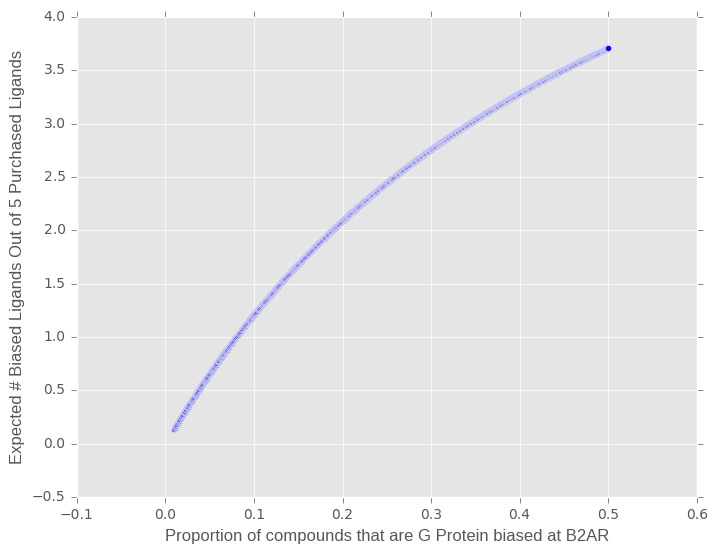

In [207]:
def calc_expected_positives(recall, fdr, rho, n_test):
    return(n_test*(recall * rho) / (recall * rho + fdr * (1.-rho)))
exp_pos = []
rhos = np.linspace(0.01,0.5,1000,1)
for rho in rhos:
    exp_pos.append(calc_expected_positives(0.92, .32, rho, 5))
plt.scatter(rhos, exp_pos)
plt.xlabel("Proportion of compounds that are G Protein biased at B2AR")
plt.ylabel("Expected # Biased Ligands Out of 5 Purchased Ligands")
plt.savefig("%s/exp_pos.pdf" %analysis_dir)
print("enf@vsp-compute.stanford.edu:%s" %("%s/exp_pos.pdf" %analysis_dir))

In [ ]:
def calc_biased(recall_e, fdr, rho_a, rho_b, n_test):
    return(n_test*(recall * rho) / (recall * rho + fdr * (1.-rho)))

In [ ]:
import pubchempy as pcp
c = pcp.get_compounds("CC(NC([C@@H](c1ccc(cc1)O)O)C)COc1ccccc1", "smiles")[0]

In [ ]:
c.canonical_smiles

In [353]:
p_bias_df.loc[[n for n in p_bias_df.index.values if n not in common_ligands]].sort("class B", ascending=False,inplace=False).iloc[:1000]

/home/enf/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:1: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  if __name__ == '__main__':


,class A,class B,class C,name,cid
CID_171674,0.057,0.907,0.036,Pirbuterol acetate,171674
CID_5702273,0.046,0.888,0.066,Clenbuterol hydrochloride,5702273
CID_68658,0.077,0.860,0.063,Exirel,68658
CID_657301,0.119,0.860,0.021,Terbutaline sulfate,657301
CID_9884233,0.083,0.857,0.060,Salbutamol sulfate,9884233
CID_39859,0.083,0.857,0.060,ALBUTEROL SULFATE,39859
CID_4845,0.071,0.821,0.108,PIRBUTEROL,4845
CID_73416654,0.135,0.816,0.049,,
CID_73416983,0.118,0.806,0.076,XTZ6AXU7KN,73416983
CID_65324,0.082,0.805,0.113,Dobutamine hydrochloride,65324


In [ ]:
from importlib import reload
import grids
reload(grids)
from grids import *

grid_center = "64.4, 16.9, 11.99"


#reimaged_dir = samples_dir
#mae_dir = reimaged_dir
#remove_ter(reimaged_dir)
#reorder(reimaged_dir)


#agonist_ligands = [a for a in agonist_ligands if "TA" not in a]

#pprep(mae_dir, ref = active_ref_dir, chosen_receptors = chosen_receptors, worker_pool=None, parallel=True)
#generate_grids(mae_dir, grid_center, grid_dir, remove_lig = "BIA", chosen_receptors = chosen_receptors, worker_pool=None, outer_box=25.)

precision = "XP"
htbc_dir = "/home/enf/htbc/sdfs/32_stereoisomers"
docking_dir = "/home/enf/htbc/b2ar/docking_xp/32-stereoisomers_6-ring-conf"
grid_dir = "/home/enf/htbc/b2ar/grids"

#df = prepare_ligands(htbc_dir, exts = [".sdf"],
#                n_ring_conf=6, n_stereoisomers=32,
#               force_field=16, worker_pool=dview,
#               parallel=None, redo=False,
#              smiles_df=None, cid_df=None,
#             binding_db=None,
#             return_df=True)

if not os.path.exists(docking_dir):
    os.makedirs(docking_dir)
if not os.path.exists(grid_dir):
    os.makedirs(grid_dir)

chosen_ligands = p_bias_df.loc[[n for n in p_bias_df.index.values if "_" == n[0] and n not in common_ligands]].sort("class B", ascending=False,inplace=False).index.values[:100]

lig_dir = htbc_dir
dock_ligands_and_receptors(grid_dir, docking_dir, lig_dir, precision = precision, ext = "-out.maegz", chosen_ligands=chosen_ligands, chosen_receptors = None, parallel = False, grid_ext = ".zip", worker_pool=dview, retry_after_failed=True, timeout=60*60*24)

#dock_ligands_and_receptors(grid_dir, docking_dir,  biased_agonist_dir, precision = precision, ext = "-out.maegz", chosen_ligands = biased_ligands, chosen_receptors = chosen_receptors, parallel = None, grid_ext = ".grd", worker_pool=dview)
#dock_ligands_and_receptors(grid_dir, docking_dir, agonist_dir, precision = precision, ext = "-out.maegz", chosen_ligands = agonist_ligands, chosen_receptors = chosen_receptors, parallel = None, grid_ext = ".grd", worker_pool=dview)






About to do 2700 Docking computations.


In [215]:
chosen_ligands

array(['_113986', '_70638', '_122949', '_114015', '_120259', '_120889',
       '_21903', '_120748', '_34068', '_120116', '_112272', '_84867',
       '_58367', '_113955', '_120850', '_931', '_49767', '_74752',
       '_33987', '_5427', '_124773', '_124756', '_1730', '_11472',
       '_14450', '_52461', '_76853', '_12432', '_22849', '_64812',
       '_134045', '_134043', '_121007', '_18608', '_20037', '_122857',
       '_24493', '_35479', '_62911', '_25480', '_97162', '_29311',
       '_104314', '_113737', '_22315', '_119929', '_26403', '_85720',
       '_63114', '_133151', '_48348', '_24452', '_24583', '_120027',
       '_45621', '_84989', '_38003', '_10441', '_28469', '_122576',
       '_91417', '_11753', '_75835', '_121937', '_76094', '_71827',
       '_3443', '_48706', '_66002', '_19332', '_45085', '_34692', '_16631',
       '_18210', '_97170', '_47990', '_63684', '_130104', '_86957',
       '_79500', '_8882', '_119879', '_131852', '_98783', '_123796',
       '_134024', '_119803', '_

Exception in thread Thread-922:
Traceback (most recent call last):
  File "/home/enf/anaconda3/lib/python3.5/threading.py", line 914, in _bootstrap_inner
    self.run()
  File "/home/enf/anaconda3/lib/python3.5/threading.py", line 862, in run
    self._target(*self._args, **self._kwargs)
  File "/home/enf/anaconda3/lib/python3.5/multiprocessing/pool.py", line 366, in _handle_workers
    pool._maintain_pool()
  File "/home/enf/anaconda3/lib/python3.5/multiprocessing/pool.py", line 240, in _maintain_pool
    self._repopulate_pool()
  File "/home/enf/anaconda3/lib/python3.5/multiprocessing/pool.py", line 233, in _repopulate_pool
    w.start()
  File "/home/enf/anaconda3/lib/python3.5/multiprocessing/process.py", line 105, in start
    self._popen = self._Popen(self)
  File "/home/enf/anaconda3/lib/python3.5/multiprocessing/context.py", line 267, in _Popen
    return Popen(process_obj)
  File "/home/enf/anaconda3/lib/python3.5/multiprocessing/popen_fork.py", line 20, in __init__
    self._

In [ ]:
len(dview)

p_bias_df.loc[[n for n in p_bias_df.index.values if "_" == n[0] and n not in common_ligands]].sort("class B", ascending=False,inplace=False)

In [ ]:
from pubchempy import get_compounds
c = get_compounds(a, namespace='smiles')

In [ ]:
c[0].synonyms

In [ ]:
bias_test_df#.loc["3p0g_lig"]#.loc[bias_test_df.index.str.contains("pentyl")]

In [ ]:
[n for n in gprot_test_df.loc[[n for n in gprot_test_df.index.values if n[0] == n[0]]].index.values[:100] if n in arr_test_df.loc[[n for n in arr_test_df.index.values if n[0] == n[0]]].index.values[:100]]  



In [ ]:
sorted([n.lower() for n in common_ligands])



In [ ]:
top_clusters

In [ ]:
def get_top_measurable_features(samples_normalized_features_avg_df, cluster_name):
    import re
    top_features_cluster = []
    #top_features_cluster = samples_normalized_features_avg_df.loc["cluster_name"].loc[samples_normalized_features_avg_df.loc["cluster_name"].abs() > .75].index.values
    #print(top_features_cluster)
    #print(len(top_features_cluster))
    [top_features_cluster.append(pair) for pair in samples_normalized_features_avg_df.loc[cluster_name].abs().sort(inplace=False, ascending=False).index.values[:10]]
    all_features = []
    features = []
    for f in top_features_cluster:
        fs = f.split(",")
        for i in range(0, len(fs)):
            res = int(re.findall(r'\d+', fs[i])[0])
            all_features.append(res)
            if "TRP" in fs[i] or "CYS" in fs[i] or "TYR" in fs[i] or "LYS" in fs[i]:
                features.append(res)
            
    top_features_cluster = sorted(list(set(features)))
    #print(sorted(list(set([int(re.findall(r'\d+', r)[0]) for r in all_features]))))
    #print(top_features_cluster)
    return top_features_cluster, all_features
a, b = get_top_measurable_features(samples_normalized_features_averages_df, 6)